In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
from random import seed

from scipy.stats import zscore
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import  MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import Imputer
from sklearn.metrics import mean_absolute_error

from keras.models import Sequential
from keras.layers import Dense, Activation, Dropout, LSTM, BatchNormalization
from keras import layers
from keras import optimizers
from keras import callbacks
from keras import models
from keras.utils import to_categorical

Using TensorFlow backend.


In [2]:
#Generate Dataset
#Airfoil Self-Noise
df_airfoil=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Airfoil_self_noise.csv')

#Automobile
df_automobile=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Automobile_data.txt')

#Autompg
df_autompg=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Auto-mpg.csv')

#ChallengerUSA
df_challenger=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Challenger USA Space Shuttle O-Ring.csv')

#Combine Cycle Power
df_combine=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Combine Cycle Power Plant.csv')

#Computer Hardware
df_computer=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Computer Hardware.csv')

#Concrete Compressive Strength
df_concrete_compressive_strength=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Compressive Strength.csv')

#Concrete Slump Test
df_concrete1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')
df_concrete3=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Concrete Slump Test.csv')

#Energy Efficiency
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')

#Fertility Diagnosis
df_fertility=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\fertility_Diagnosis.csv')

#Forest Fires
df_forest=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\forestfires.csv')

#Housing
df_housing=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Housing.csv')

#Istanbul Stock Exchange
df_istanbul=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Istanbul Stock Exchange.csv')

#WDBC
df_wdbc=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\wdbc.csv')

In [3]:
#remove Nan columns of df_energy1
df_energy1=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy1.drop(df_energy1.columns[11],inplace=True, axis = 1)
df_energy1.drop(df_energy1.columns[10],inplace=True, axis = 1)

#remove Nan columns of df_energy2
df_energy2=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\Datasets\\Energy Efficiency.csv')
df_energy2.drop(df_energy2.columns[11],inplace=True, axis = 1)
df_energy2.drop(df_energy2.columns[10],inplace=True, axis = 1)

#remove question marks
#df_automobile
imp= Imputer(missing_values="NaN", strategy="mean")
df_automobile=df_automobile.replace("?", np.NaN)
df_automobile['num-of-doors'] = df_automobile['num-of-doors'].fillna("four")
for i in df_automobile.columns:
    if df_automobile[i].isnull().sum()>0:
        df_automobile[i]=imp.fit_transform(df_automobile[[i]])
#df_automobile = df_automobile[(df_automobile.astype(str) != '?').all(axis=1)]
#df_automobile.reset_index(drop=True, inplace=True)
df_automobile = df_automobile.drop(['engine-location'], axis=1)
#df_autompg
df_autompg = df_autompg[(df_autompg.astype(str) != '?').all(axis=1)]
df_autompg.reset_index(drop=True, inplace=True)

#convert string to number
le=LabelEncoder()
#df_automobile
string_automobile=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=string_automobile.apply(le.fit_transform)
encoder=df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']].astype(np.int64)
df_automobile[['make','fuel-type','aspiration','num-of-doors', 'body-style', 'drive-wheels', 'engine-type', 'num-of-cylinders', 'fuel-system']]=encoder
a=df_automobile[['normalized-losses','horsepower','price']].astype(np.int64)
b=df_automobile[['bore','stroke','peak-rpm']].astype(float)
df_automobile[['normalized-losses','horsepower','price']]=a
df_automobile[['bore','stroke','peak-rpm']]=b

#df_challenger
#category1=[]
#for i in range(len(df_challenger)):
    #if df_challenger['Leak-Check Pressure'].iloc[i]==50:
        #category1.append(0)
    #if df_challenger['Leak-Check Pressure'].iloc[i]==100:
        #category1.append(1)
    #if df_challenger['Leak-Check Pressure'].iloc[i]==200:
        #category1.append(2)
#df_challenger['category']=category1

#df_computer
string_computer=df_computer[['Vendor','Model']]
df_computer[['Vendor','Model']]=string_computer.apply(le.fit_transform)
df_computer[['Vendor','Model']]=df_computer[['Vendor','Model']].astype(np.int64)

#dropna spesific column & special preprocessing
#df_forest
df_forest=df_forest[(df_forest['area'].astype(int) != 0)] 
df_forest.reset_index(drop=True, inplace=True)
num_features=10
dimension=(num_features+1)*9+10
population_size=(2*dimension+1)*2
df_forest=df_forest[:population_size]

C:\Users\user\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:66: DeprecationWarning: Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.
  warnings.warn(msg, category=DeprecationWarning)


In [4]:
def preprocessing_data1(df,num_features):
    dimension=(num_features+1)*9+10
    population_size=(2*dimension+1)*2
    df=df.dropna()
    df=df[:population_size]
    df
    return df

In [5]:
def feature_selection(df):
    cor=df.corr()
    plt.figure(figsize=(100,50))
    sns.set(font_scale=3)
    sns.heatmap(cor, annot=True, cmap=plt.cm.Blues)
    plt.show()
    return cor

In [6]:
def train_test_split1(x, y):
    x_train, x_test, y_train, y_test= train_test_split(x, y, test_size=0.15, random_state=42)
    return x_train, x_test, y_train, y_test

In [7]:
#df_airfoil=preprocessing_data1(df_airfoil,5)
#df_automobile=preprocessing_data1(df_automobile,22)
#df_autompg=preprocessing_data1(df_autompg,7)
#df_challenger=preprocessing_data1(df_challenger,3)
#df_combine=preprocessing_data1(df_combine,4)
#df_computer=preprocessing_data1(df_computer,9)
#df_concrete_compressive_strength=preprocessing_data1(df_concrete_compressive_strength,8)
#df_concrete1=preprocessing_data1(df_concrete1,7)
#df_concrete2=preprocessing_data1(df_concrete2,7)
#df_concrete3=preprocessing_data1(df_concrete3,7)
#df_energy1=preprocessing_data1(df_energy1,8)
#df_energy2=preprocessing_data1(df_energy2,8)

#df_fertility=preprocessing_data1(df_fertility,9)
for i in df_fertility:
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'N'] = 1
    df_fertility.Diagnosis[df_fertility.Diagnosis == 'O'] = 2
df_fertility['Diagnosis']=df_fertility['Diagnosis'].astype(np.int64)

#df_forest=preprocessing_data1(df_forest,10)
#df_housing=preprocessing_data1(df_housing,13)

#df_istanbul=preprocessing_data1(df_istanbul,7)
new_header = df_istanbul.iloc[0]
df_istanbul = df_istanbul[1:]
df_istanbul.columns = new_header
df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']]=df_istanbul[['ISE1','ISE2','SP','DAX','FTSE','NIKKEI','BOVESPA','EU','EM']].astype(np.float64)


#df_wdbc=preprocessing_data1(df_wdbc,10)
df_wdbc.drop(df_wdbc.columns[0], axis=1, inplace = True)
df_wdbc.columns=['id','diagnosis','radius_mean','texture_mean','perimeter_mean','area_mean','smoothness_mean','compactness_mean','concavity_mean','concave points_mean','symmetry_mean','fractal_dimension_mean','radius_se','texture_se','perimeter_se','area_se','smoothness_se','compactness_se','concavity_se','concave points_se','symmetry_se','fractal_dimension_se','radius_worst','texture_worst','perimeter_worst','area_worst','smoothness_worst','compactness_worst','concavity_worst','concave points_worst','symmetry_worst','fractal_dimension_worst']
for i in df_wdbc:
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'M'] = 1
    df_wdbc.diagnosis[df_wdbc.diagnosis == 'B'] = 2
df_wdbc['diagnosis']=df_wdbc['diagnosis'].astype(np.object)

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: SettingWithCopyWarning: 
A value is trying to be set on a 

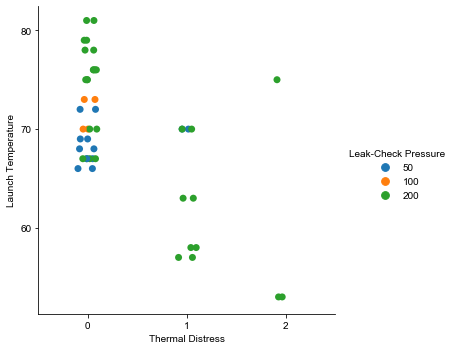

In [8]:
ax = sns.catplot(x='Thermal Distress', y='Launch Temperature', hue='Leak-Check Pressure', data=df_challenger, s=7)
sns.set(font_scale=2)
ax.savefig('challenger_plotting_result.jpg')

In [9]:
#Train and Test 17 datasets
#Airfoil
x_airfoil1 = df_airfoil.drop(['Frequency'], axis = 1)
y_airfoil1 = df_airfoil['Frequency']
y_airfoil1 = np.reshape(y_airfoil1.values, (-1,1))
x_airfoil2 = df_airfoil.drop(['Angle of Attack'], axis = 1)
y_airfoil2 = df_airfoil['Angle of Attack']
#x_airfoil2 = df_airfoil.drop(['Free-stream velocity','category'], axis = 1)
#y_airfoil2 = df_airfoil['category']
#y_airfoil2=to_categorical(y_airfoil2)
#Wdbc
#x_wdbc = df_wdbc[['radius_mean','perimeter_mean','area_mean','concavity_mean','concave points_mean','radius_worst','perimeter_worst','area_worst','concave points_worst']]
#y_wdbc = df_wdbc['diagnosis']
#labelencoder_Y = LabelEncoder()
#y_wdbc = labelencoder_Y.fit_transform(y_wdbc)
#Automobile
x_automobile1 = df_automobile.drop(['bore','make','body-style'], axis = 1)
y_automobile1 = df_automobile['bore']
x_automobile2 = df_automobile.drop(['horsepower','make','body-style'], axis = 1)
y_automobile2 = df_automobile['horsepower']
y_automobile2 = np.reshape(y_automobile2.values, (-1,1))
#Autompg
x_autompg1 = df_autompg.drop(['Displacement','Car Name'], axis = 1)
y_autompg1 = df_autompg['Displacement']
y_autompg1 = np.reshape(y_autompg1.values, (-1,1))
x_autompg2 = df_autompg.drop(['Acceleration','Car Name'], axis = 1)
y_autompg2 = df_autompg['Acceleration']
#Challenger
x_challenger1 = df_challenger.drop(['Number of O-rings','Launch Temperature'], axis = 1)
y_challenger1 = df_challenger['Launch Temperature']
x_challenger2 = df_challenger.drop(['Number of O-rings','Leak-Check Pressure'], axis = 1)
y_challenger2 = df_challenger['Leak-Check Pressure']
#y_challenger2=to_categorical(y_challenger2)
#Combine
#x_combine = df_combine.drop(['PE'], axis = 1)
#y_combine = df_combine['PE']
#y_combine = np.reshape(y_combine.values, (-1,1))
#Computer
#x_computer = df_computer.drop(['ERP'], axis = 1)
#y_computer = df_computer['ERP']
#y_computer = np.reshape(y_computer.values, (-1,1))
#Concrete_compressive_strength
#x_concrete_compressive_strength = df_concrete_compressive_strength.drop(['CCS'], axis = 1)
#y_concrete_compressive_strength = df_concrete_compressive_strength['CCS']
#y_concrete_compressive_strength = np.reshape(y_concrete_compressive_strength.values, (-1,1))
#Concrete1
#x_concrete1 = df_concrete1.drop(['No','Compressive Strength (28-day)(Mpa)'], axis = 1)
#y_concrete1 = df_concrete1['Compressive Strength (28-day)(Mpa)']
#Concrete2
#x_concrete2 = df_concrete2.drop(['No','SLUMP(cm)'], axis = 1)
#y_concrete2 = df_concrete2['SLUMP(cm)']
#y_concrete2 = np.reshape(y_concrete2.values, (-1,1))
#Concrete3
#x_concrete3 = df_concrete3.drop(['No','FLOW(cm)'], axis = 1)
#y_concrete3 = df_concrete3['FLOW(cm)']
#y_concrete3 = np.reshape(y_concrete3.values, (-1,1))
#Energy1
#x_energy1 = df_energy1.drop(['Y1'], axis = 1)
#y_energy1 = df_energy1['Y1']
#Energy2
#x_energy2 = df_energy2.drop(['Y2'], axis = 1)
#y_energy2 = df_energy2['Y2']
#Fertility
#x_fertility = df_fertility.drop(['Diagnosis'], axis = 1)
#y_fertility = df_fertility['Diagnosis']
#Forest
#x_forest = df_forest.drop(['month','day','area'], axis = 1)
#y_forest = df_forest['area']
#y_forest = np.reshape(y_forest.values, (-1,1))
#Housing
#x_housing = df_housing.drop(['MEDV'], axis = 1)
#y_housing = df_housing['MEDV']
#Istanbul
#x_istanbul = df_istanbul.drop(['date','ISE1','ISE2'], axis = 1)
#y_istanbul = df_istanbul[['ISE1','ISE2']]
#y_istanbul['mean'] = y_istanbul.mean(axis=1)
#y_istanbul = y_istanbul['mean']

In [10]:
x_train_airfoil1, x_test_airfoil1, y_train_airfoil1, y_test_airfoil1 = train_test_split1(x_airfoil1, y_airfoil1)
x_train_airfoil2, x_test_airfoil2, y_train_airfoil2, y_test_airfoil2 = train_test_split1(x_airfoil2, y_airfoil2)
x_train_automobile1, x_test_automobile1, y_train_automobile1, y_test_automobile1 = train_test_split1(x_automobile1, y_automobile1)
x_train_automobile2, x_test_automobile2, y_train_automobile2, y_test_automobile2 = train_test_split1(x_automobile2, y_automobile2)
x_train_autompg1, x_test_autompg1, y_train_autompg1, y_test_autompg1 = train_test_split1(x_autompg1, y_autompg1)
x_train_autompg2, x_test_autompg2, y_train_autompg2, y_test_autompg2 = train_test_split1(x_autompg2, y_autompg2)
x_train_challenger1, x_test_challenger1, y_train_challenger1, y_test_challenger1 = train_test_split1(x_challenger1, y_challenger1)
x_train_challenger2, x_test_challenger2, y_train_challenger2, y_test_challenger2 = train_test_split1(x_challenger2, y_challenger2)
#x_train_combine, x_test_combine, y_train_combine, y_test_combine = train_test_split1(x_combine, y_combine)
#x_train_computer, x_test_computer, y_train_computer, y_test_computer = train_test_split1(x_computer, y_computer)
#x_train_concrete_compressive_strength, x_test_concrete_compressive_strength, y_train_concrete_compressive_strength, y_test_concrete_compressive_strength = train_test_split1(x_concrete_compressive_strength, y_concrete_compressive_strength)
#x_train_concrete1, x_test_concrete1, y_train_concrete1, y_test_concrete1 = train_test_split1(x_concrete1, y_concrete1)
#x_train_concrete2, x_test_concrete2, y_train_concrete2, y_test_concrete2 = train_test_split1(x_concrete2, y_concrete2)
#x_train_concrete3, x_test_concrete3, y_train_concrete3, y_test_concrete3 = train_test_split1(x_concrete3, y_concrete3)
#x_train_energy1, x_test_energy1, y_train_energy1, y_test_energy1 = train_test_split1(x_energy1, y_energy1)
#x_train_energy2, x_test_energy2, y_train_energy2, y_test_energy2 = train_test_split1(x_energy2, y_energy2)
#x_train_fertility, x_test_fertility, y_train_fertility, y_test_fertility = train_test_split1(x_fertility, y_fertility)
#x_train_forest, x_test_forest, y_train_forest, y_test_forest = train_test_split1(x_forest, y_forest)
#x_train_housing, x_test_housing, y_train_housing, y_test_housing = train_test_split1(x_housing, y_housing)
#x_train_istanbul, x_test_istanbul, y_train_istanbul, y_test_istanbul = train_test_split1(x_istanbul, y_istanbul)
#x_train_wdbc, x_test_wdbc, y_train_wdbc, y_test_wdbc = train_test_split1(x_wdbc, y_wdbc)

In [11]:
def train_val_split(x_train, y_train):
    X_train, X_val, Y_train, Y_val= train_test_split(x_train, y_train, test_size=0.176, random_state=42)
    return X_train, X_val, Y_train, Y_val

In [12]:
def standard_scaler(X_train, X_val, x_test):
    sc=StandardScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=sc.fit(X_train)
    #X_scale_val=sc.fit(X_val)
    #x_scale_test=sc.fit(x_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    return X_train, X_val, x_test, X_scale_train

In [13]:
def min_max_scaler(X_train, X_val, x_test, Y_train, Y_val, y_test):
    min_max_x=MinMaxScaler()
    min_max_y=MinMaxScaler()
    X_train=X_train.values
    X_val=X_val.values
    x_test=x_test.values
    X_scale_train=min_max_x.fit(X_train)
    #X_scale_val=min_max_x.fit(X_val)
    #x_scale_test=min_max_x.fit(x_test)
    Y_scale_train=min_max_y.fit(Y_train)
    #Y_scale_val=min_max_y.fit(Y_val)
    #y_scale_test=min_max_y.fit(y_test)
    X_train=X_scale_train.transform(X_train)
    X_val=X_scale_train.transform(X_val)
    x_test=X_scale_train.transform(x_test)
    Y_train=Y_scale_train.transform(Y_train)
    Y_val=Y_scale_train.transform(Y_val)
    y_test=Y_scale_train.transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test, X_scale_train, Y_scale_train

In [14]:
def normalization(X_train, X_val, x_test, Y_train, Y_val, y_test):
    normalizer=Normalizer()
    X_train=normalizer.fit_transform(X_train)
    X_val=normalizer.fit_transform(X_val)
    x_test=normalizer.fit_transform(x_test)
    Y_train=normalizer.fit_transform(Y_train)
    Y_val=normalizer.fit_transform(Y_val)
    y_test=normalizer.fit_transform(y_test)
    return X_train, X_val, x_test, Y_train, Y_val, y_test

In [15]:
#Optimizer list
adam0 = 'adam'
adam1 = optimizers.Adam(lr=0.001)
adam2 = optimizers.Adam(lr=0.01)
adam3 = optimizers.Adam(lr=0.0001)
adam4 = optimizers.Adam(lr=0.00001)
sgd = optimizers.SGD(lr=0.005, decay=1e-4, momentum=0.9, nesterov=True)
RMSprop= optimizers.RMSprop(lr=0.001,rho=0.9)
adagrad = optimizers.Adagrad(lr=0.01)
adadelta = optimizers.Adadelta(lr=1.0)

In [16]:
def NN_model_structure_classification(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test, classes):
    model = Sequential()
    model.add(Dense(units = 5, kernel_initializer='uniform', input_dim = (X_train.shape[1])))
    model.add(Activation('relu'))
    model.add(Dense(units = 10, kernel_initializer='uniform'))
    model.add(Activation('relu'))
    model.add(Dense(units = 20, kernel_initializer='uniform'))
    model.add(Dense(units = classes, activation='softmax'))
    model.compile(optimizer = adam , loss = 'categorical_crossentropy', metrics=['acc'])
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [17]:
def NN_model_structure_regression(X_train, X_val, Y_train, Y_val, adam, size, epochs, x_test, y_test):
    model = Sequential()
    model.add(Dense(units = 5, input_dim = (X_train.shape[1])))
    model.add(Activation('tanh'))
    model.add(Dense(units = 10))
    model.add(Activation('linear'))
    model.add(Dense(units = 1))
    model.compile(optimizer = adam , loss = 'mse')
    model.summary()
    history=model.fit(X_train,Y_train, batch_size=size,epochs=epochs, validation_data=(X_val, Y_val), shuffle=True)
    evaluate = model.evaluate(x_test, y_test, verbose=2, batch_size=size)
    print(evaluate)
    return model, history, evaluate

In [18]:
X_train_airfoil1, X_val_airfoil1, Y_train_airfoil1, Y_val_airfoil1 = train_val_split(x_train_airfoil1, y_train_airfoil1)
X_train_airfoil2, X_val_airfoil2, Y_train_airfoil2, Y_val_airfoil2 = train_val_split(x_train_airfoil2, y_train_airfoil2)
X_train_automobile1, X_val_automobile1, Y_train_automobile1, Y_val_automobile1 = train_val_split(x_train_automobile1, y_train_automobile1)
X_train_automobile2, X_val_automobile2, Y_train_automobile2, Y_val_automobile2 = train_val_split(x_train_automobile2, y_train_automobile2)
X_train_autompg1, X_val_autompg1, Y_train_autompg1, Y_val_autompg1 = train_val_split(x_train_autompg1, y_train_autompg1)
X_train_autompg2, X_val_autompg2, Y_train_autompg2, Y_val_autompg2 = train_val_split(x_train_autompg2, y_train_autompg2)
X_train_challenger1, X_val_challenger1, Y_train_challenger1, Y_val_challenger1 = train_val_split(x_train_challenger1, y_train_challenger1)
X_train_challenger2, X_val_challenger2, Y_train_challenger2, Y_val_challenger2 = train_val_split(x_train_challenger2, y_train_challenger2)
#X_train_combine, X_val_combine, Y_train_combine, Y_val_combine = train_val_split(x_train_combine, y_train_combine)
#X_train_computer, X_val_computer, Y_train_computer, Y_val_computer = train_val_split(x_train_computer, y_train_computer)
#X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength = train_val_split(x_train_concrete_compressive_strength, y_train_concrete_compressive_strength)
#X_train_concrete1, X_val_concrete1, Y_train_concrete1, Y_val_concrete1 = train_val_split(x_train_concrete1, y_train_concrete1)
#X_train_concrete2, X_val_concrete2, Y_train_concrete2, Y_val_concrete2 = train_val_split(x_train_concrete2, y_train_concrete2)
#X_train_concrete3, X_val_concrete3, Y_train_concrete3, Y_val_concrete3 = train_val_split(x_train_concrete3, y_train_concrete3)
#X_train_energy1, X_val_energy1, Y_train_energy1, Y_val_energy1 = train_val_split(x_train_energy1, y_train_energy1)
#X_train_energy2, X_val_energy2, Y_train_energy2, Y_val_energy2 = train_val_split(x_train_energy2, y_train_energy2)
#X_train_fertility, X_val_fertility, Y_train_fertility, Y_val_fertility = train_val_split(x_train_fertility, y_train_fertility)
#X_train_forest, X_val_forest, Y_train_forest, Y_val_forest = train_val_split(x_train_forest, y_train_forest)
#X_train_housing, X_val_housing, Y_train_housing, Y_val_housing = train_val_split(x_train_housing, y_train_housing)
#X_train_istanbul, X_val_istanbul, Y_train_istanbul, Y_val_istanbul = train_val_split(x_train_istanbul, y_train_istanbul)
#X_train_wdbc, X_val_wdbc, Y_train_wdbc, Y_val_wdbc = train_val_split(x_train_wdbc, y_train_wdbc)

In [19]:
X_train_airfoil1, X_val_airfoil1, x_test_airfoil1, Y_train_airfoil1, Y_val_airfoil1, y_test_airfoil1, X_scale_train_airfoil1, Y_scale_train_airfoil1 =min_max_scaler(X_train_airfoil1, X_val_airfoil1, x_test_airfoil1, Y_train_airfoil1, Y_val_airfoil1, y_test_airfoil1)
X_train_airfoil2, X_val_airfoil2, x_test_airfoil2, X_scale_train_airfoil2=standard_scaler(X_train_airfoil2, X_val_airfoil2, x_test_airfoil2)
X_train_automobile1, X_val_automobile1, x_test_automobile1, X_scale_train_automobile1=standard_scaler(X_train_automobile1, X_val_automobile1, x_test_automobile1)
X_train_automobile2, X_val_automobile2, x_test_automobile2, Y_train_automobile2, Y_val_automobile2, y_test_automobile2, X_scale_train_automobile2, Y_scale_train_automobile2=min_max_scaler(X_train_automobile2, X_val_automobile2, x_test_automobile2, Y_train_automobile2, Y_val_automobile2, y_test_automobile2)
X_train_autompg1, X_val_autompg1, x_test_autompg1, Y_train_autompg1, Y_val_autompg1, y_test_autompg1, X_scale_train_autompg1, Y_scale_train_autompg1=min_max_scaler(X_train_autompg1, X_val_autompg1, x_test_autompg1, Y_train_autompg1, Y_val_autompg1, y_test_autompg1)
X_train_autompg2, X_val_autompg2, x_test_autompg2, X_scale_train_autompg2=standard_scaler(X_train_autompg2, X_val_autompg2, x_test_autompg2)
X_train_challenger1, X_val_challenger1, x_test_challenger1, X_scale_train_challenger1=standard_scaler(X_train_challenger1, X_val_challenger1, x_test_challenger1)
X_train_challenger2, X_val_challenger2, x_test_challenger2, X_scale_train_challenger2=standard_scaler(X_train_challenger2, X_val_challenger2, x_test_challenger2)
#X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine, min_max_combine=min_max_scaler(X_train_combine, X_val_combine, x_test_combine, Y_train_combine, Y_val_combine, y_test_combine)
#X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer, min_max_computer=min_max_scaler(X_train_computer, X_val_computer, x_test_computer, Y_train_computer, Y_val_computer, y_test_computer)
#X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength, min_max_concrete_compressive_strength=min_max_scaler(X_train_concrete_compressive_strength, X_val_concrete_compressive_strength, x_test_concrete_compressive_strength, Y_train_concrete_compressive_strength, Y_val_concrete_compressive_strength, y_test_concrete_compressive_strength)
#X_train_concrete1, X_val_concrete1, x_test_concrete1, X_scale_train_concrete1=standard_scaler(X_train_concrete1, X_val_concrete1, x_test_concrete1)
#X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2, min_max_concrete2=min_max_scaler(X_train_concrete2, X_val_concrete2, x_test_concrete2, Y_train_concrete2, Y_val_concrete2, y_test_concrete2)
#X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3, min_max_concrete3=min_max_scaler(X_train_concrete3, X_val_concrete3, x_test_concrete3, Y_train_concrete3, Y_val_concrete3, y_test_concrete3)
#X_train_energy1, X_val_energy1, x_test_energy1, X_scale_train_energy1=standard_scaler(X_train_energy1, X_val_energy1, x_test_energy1)
#X_train_energy2, X_val_energy2, x_test_energy2, X_scale_train_energy2=standard_scaler(X_train_energy2, X_val_energy2, x_test_energy2)
#X_train_fertility, X_val_fertility, x_test_fertility, X_scale_train_fertility=standard_scaler(X_train_fertility, X_val_fertility, x_test_fertility)
#X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest, min_max_forest=min_max_scaler(X_train_forest, X_val_forest, x_test_forest, Y_train_forest, Y_val_forest, y_test_forest)
#X_train_housing, X_val_housing, x_test_housing, X_scale_train_housing=standard_scaler(X_train_housing, X_val_housing, x_test_housing)
#X_train_istanbul, X_val_istanbul, x_test_istanbul, X_scale_train_istanbul=standard_scaler(X_train_istanbul, X_val_istanbul, x_test_istanbul)

In [20]:
model_automobile2, history_automobile2, evaluate_automobile2=NN_model_structure_regression(X_train_automobile2, X_val_automobile2, Y_train_automobile2, Y_val_automobile2, adam2, 64, 100, x_test_automobile2, y_test_automobile2)
model_automobile2.get_weights()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 5)                 115       
_________________________________________________________________
activation_1 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_2 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 11        
Total params: 186
Trainable params: 186
Non-trainable params: 0
_________________________________________________________________

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 3ms/step - loss: 0

[array([[ 0.01446655, -0.3500953 ,  0.00739779,  0.17505369,  0.10277558],
        [ 0.28517893,  0.4451219 ,  0.20825887, -0.41871798, -0.29882753],
        [ 0.16419804,  0.13996792,  0.0207891 , -0.4889476 ,  0.06720209],
        [ 0.2533601 ,  0.2083465 , -0.09017877,  0.17977104, -0.28656927],
        [ 0.3876511 , -0.02914505,  0.11751752,  0.21038954,  0.5436909 ],
        [ 0.15651417,  0.21972355, -0.32904392,  0.14110716, -0.26041394],
        [ 0.0277363 ,  0.14415085,  0.18942301, -0.29907826,  0.27355704],
        [-0.35218176,  0.15909263,  0.2137082 ,  0.1573663 ,  0.31120998],
        [-0.19390038,  0.11373552,  0.02155897,  0.24756743,  0.26153186],
        [-0.22181574,  0.02437051, -0.33337036, -0.12483093, -0.2916273 ],
        [ 0.28010535, -0.24798822,  0.07279037,  0.10152141,  0.46960396],
        [-0.10710122,  0.0153725 , -0.51602066,  0.04417679, -0.04475681],
        [-0.39310533,  0.33442768, -0.33654693,  0.29345477, -0.11464432],
        [-0.3501373 ,  0.

In [21]:
model_autompg1, history_autompg1, evaluate_autompg1=NN_model_structure_regression(X_train_autompg1, X_val_autompg1, Y_train_autompg1, Y_val_autompg1, adam2, 64, 100, x_test_autompg1, y_test_autompg1)
model_autompg1.get_weights()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 5)                 40        
_________________________________________________________________
activation_3 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_5 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_4 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_6 (Dense)              (None, 1)                 11        
Total params: 111
Trainable params: 111
Non-trainable params: 0
_________________________________________________________________
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 494us/step - loss: 

[array([[ 0.43632728, -0.6296632 , -0.4978076 , -0.28393728, -0.3144099 ],
        [ 0.02207274,  0.07442008, -0.3314982 ,  0.5535791 , -0.057891  ],
        [ 0.23478891,  0.2108203 , -0.54030806, -0.24082631, -0.30428687],
        [ 0.42256355,  0.40069088,  0.53154355,  0.58374363,  0.61202484],
        [-0.44917414, -0.7840197 ,  0.23376602,  0.37057036,  0.48787242],
        [ 0.22321843, -0.4771578 , -0.3901106 , -0.14552344,  0.11010308],
        [-0.69932437, -0.05285244, -0.07789212,  0.17950271, -0.5320049 ]],
       dtype=float32),
 array([-0.19234051, -0.3162169 ,  0.21562707, -0.16678368,  0.07509635],
       dtype=float32),
 array([[-0.1985371 ,  0.01940937,  0.25640598, -0.22689126,  0.48222178,
          0.13691959, -0.25513247,  0.6027939 , -0.48185578,  0.01625357],
        [-0.08275305,  0.6785659 , -0.40213665, -0.5113598 , -0.17786384,
          0.12845114, -0.0855784 ,  0.64183354, -0.6957767 , -0.07577723],
        [-0.24035731, -0.41363657, -0.00683634, -0.01359

In [22]:
model_autompg2, history_autompg2, evaluate_autompg2=NN_model_structure_regression(X_train_autompg2, X_val_autompg2, Y_train_autompg2, Y_val_autompg2, adam2, 64, 100, x_test_autompg2, y_test_autompg2)
model_autompg2.get_weights()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 5)                 40        
_________________________________________________________________
activation_5 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_8 (Dense)              (None, 10)                60        
_________________________________________________________________
activation_6 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 11        
Total params: 111
Trainable params: 111
Non-trainable params: 0
_________________________________________________________________
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 535us/step - loss: 

[array([[ 0.3247941 , -0.23259094, -0.3061804 ,  0.25674647, -0.06094854],
        [ 0.09734061, -0.0745503 ,  0.10404176, -0.02002373,  0.01720571],
        [ 0.52731717, -0.3261061 , -0.2326088 , -0.4458885 ,  0.1901864 ],
        [ 0.3475029 ,  0.5356527 , -0.08710292,  0.31361705, -1.3125186 ],
        [-0.5569341 , -0.5922147 ,  0.0722937 ,  0.05280562,  0.3402468 ],
        [-0.11587895,  0.49347138,  0.12717976,  0.02330711,  0.22036982],
        [-0.30582687,  0.21435422,  0.30918476, -0.09752249,  0.08519529]],
       dtype=float32),
 array([-0.61720526, -0.77808094,  0.83515584,  0.8615404 , -0.46845612],
       dtype=float32),
 array([[-0.46122485,  0.07021863, -0.3479013 , -0.23383652, -0.14340857,
         -0.35353675,  0.11016293, -0.87857187, -0.64887935, -0.23590744],
        [ 0.4598297 ,  0.41271907, -0.6526521 , -0.63805836, -0.2394698 ,
          0.05294382,  0.6498259 , -0.1931521 , -0.4810463 ,  0.7295432 ],
        [ 0.5724739 ,  0.06234728, -0.38837153,  0.48680

In [23]:
model_challenger1, history_challenger1, evaluate_challenger1=NN_model_structure_regression(X_train_challenger1, X_val_challenger1, Y_train_challenger1, Y_val_challenger1, adam2, 64, 100, x_test_challenger1, y_test_challenger1)
model_challenger1.get_weights()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 5)                 20        
_________________________________________________________________
activation_7 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_11 (Dense)             (None, 10)                60        
_________________________________________________________________
activation_8 (Activation)    (None, 10)                0         
_________________________________________________________________
dense_12 (Dense)             (None, 1)                 11        
Total params: 91
Trainable params: 91
Non-trainable params: 0
_________________________________________________________________
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 5ms/step - loss: 4831.498

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 23.4387 - val_loss: 26.6841
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 23.4754 - val_loss: 26.4995
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 23.4269 - val_loss: 26.5064
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 23.2979 - val_loss: 26.6761
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 23.1041 - val_loss: 26.9899
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 22.8682 - val_loss: 27.4334
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 22.6149 - val_loss: 27.9923
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 22.3678 - val_loss: 28.6487
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 22.1456 - val_loss: 29.3796
Epoch 78/100
32/32 [==============================] - 0s 187us/s

[array([[-0.1537717 ,  0.31243905, -0.9064951 , -0.01960337, -0.05083429],
        [ 0.4423526 ,  0.16948377, -0.8728106 , -0.36431724,  0.01815635],
        [-0.6074533 ,  0.12622131, -0.11642978,  0.07473236,  0.23704416]],
       dtype=float32),
 array([-1.230039 ,  1.3322202,  1.0708493, -1.3060879,  1.3130984],
       dtype=float32),
 array([[ 1.052583  ,  1.2653601 ,  1.2206459 ,  0.94775456, -0.6056977 ,
          1.3737122 ,  1.1150193 ,  1.2354579 ,  1.0651146 , -0.62690914],
        [-1.4137702 , -0.9062095 , -1.056436  , -1.5055357 ,  1.0791366 ,
         -1.3938917 , -0.55756086, -1.112446  , -1.212492  ,  1.3701555 ],
        [-1.3490845 , -1.1793362 , -0.67122453, -0.13286619,  0.73147887,
         -1.2491244 , -0.78088033, -0.60380393, -0.40619683,  0.7548337 ],
        [ 1.4981182 ,  0.8727579 ,  1.2745854 ,  0.57637215, -1.3854665 ,
          0.28478697,  1.2896196 ,  1.4209855 ,  1.2430342 , -0.5429478 ],
        [-1.3551161 , -1.3827128 , -1.5054789 , -1.155708  ,  0

In [24]:
model_challenger2, history_challenger2, evaluate_challenger2=NN_model_structure_regression(X_train_challenger2, X_val_challenger2, Y_train_challenger2, Y_val_challenger2, adam2, 64, 100, x_test_challenger2, y_test_challenger2)
model_challenger2.get_weights()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_13 (Dense)             (None, 5)                 20        
_________________________________________________________________
activation_9 (Activation)    (None, 5)                 0         
_________________________________________________________________
dense_14 (Dense)             (None, 10)                60        
_________________________________________________________________
activation_10 (Activation)   (None, 10)                0         
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 11        
Total params: 91
Trainable params: 91
Non-trainable params: 0
_________________________________________________________________
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 6ms/step - loss: 26835.28

Epoch 68/100
32/32 [==============================] - 0s 94us/step - loss: 217.2910 - val_loss: 180.6456
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 206.4357 - val_loss: 163.2496
Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 195.7744 - val_loss: 148.5527
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 185.7050 - val_loss: 136.8005
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 176.5289 - val_loss: 128.0562
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 168.4356 - val_loss: 122.2171
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 161.5030 - val_loss: 119.0409
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 155.7087 - val_loss: 118.1825
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 150.9516 - val_loss: 119.2317
Epoch 77/100
32/32 [===========================

[array([[ 0.1973759 ,  0.8308796 ,  0.0329942 ,  0.5344473 , -0.14576696],
        [-0.422021  ,  0.10988053,  0.4106478 , -0.04541354, -0.3368041 ],
        [ 0.62906057,  1.9387633 , -0.509898  ,  1.4666721 ,  0.48930898]],
       dtype=float32),
 array([ 1.6578254,  1.0539485, -1.7112757,  1.1428232,  1.7697189],
       dtype=float32),
 array([[-1.1329633, -1.5758239,  1.1784636,  2.0822113,  0.9777905,
          1.9569435, -2.0489364, -1.3411465, -1.7979822, -1.698652 ],
        [-2.4248214, -1.8619992,  2.3241153,  1.3844398,  1.5278476,
          1.7726572, -1.6362157, -2.1984603, -2.281793 , -1.7301214],
        [ 1.1585127,  1.2396551, -2.0751016, -2.2899196, -1.6005465,
         -1.6910483,  1.7603958,  1.9497018,  1.6864516,  1.1112645],
        [-1.5796136, -2.1794355,  1.8759712,  1.8560208,  2.0026994,
          2.0860538, -1.4096326, -1.7083777, -1.2969989, -1.8340206],
        [-1.7415423, -1.0839527,  2.041397 ,  1.8005908,  1.6985137,
          1.35547  , -2.2854192, -

In [25]:
from random import seed
def initial_sol(particles, model, limit):
    np.random.seed(7)
    weights_list=[]
    for j in range(particles):
        print('particle',j)
        #np.random.seed(j+12)
        weight = [np.random.uniform(low = -limit, high = limit, size=(w.shape)) for w in model.get_weights()]
        weights_list.append(weight)
    return weights_list 

In [26]:
def particle_list_generate(particles, model, weights, X_train, Y_train, X_val, Y_val, x_test, y_test, epoch):
    particle_list=[]
    evaluate_list=[]
    train_val_test=[]
    for j in range(particles):
        model.set_weights(weights[j])
        model_training= model.fit(X_train,Y_train, batch_size=32,epochs=epoch, validation_data=(X_val, Y_val))
        model_history= model_training.history
        train_list=list(model_history['loss'])
        train_val_test.append(train_list[epoch-1])
        val_list=list(model_history['val_loss'])
        train_val_test.append(val_list[epoch-1])
        model_evaluation=model.evaluate(x_test, y_test, verbose=0)
        train_val_test.append(model_evaluation)
        weight = model.get_weights()
        particle_list.append(weight)
        evaluate_list.append(train_val_test)
        train_val_test=[]
    return particle_list, evaluate_list

In [27]:
def best_nest(nest_list_result, nest_list):
    #list_score=pd.read_csv('C:\\Users\\user\\Desktop\\Thesis\\particle_best_list.csv')
    result_best_nest=[]
    compare_val=math.inf
    compare_test=math.inf
    for i in range(len(nest_list_result)):
        if nest_list_result[i][1]<compare_val:
            if nest_list_result[i][2]<compare_test:
                compare_val=nest_list_result[i][1]
                compare_test=nest_list_result[i][2]
                best_nest_train=nest_list_result[i][0]
                best_nest_val=compare_val
                best_nest_test=compare_test
                best_nest=nest_list[i]
    result_best_nest.append(best_nest_train)
    result_best_nest.append(best_nest_val)
    result_best_nest.append(best_nest_test)
    return result_best_nest, best_nest

In [28]:
def update_nest(alpha0, random_nest_i, nest_list, limit):
    random_nest_j=nest_list[np.random.choice(len(nest_list),replace=False)]
    
    alpha=np.kron(alpha0,(np.array(random_nest_j)-np.array(random_nest_i)))
    λ=np.random.uniform(1,3)
    Γλ=math.gamma(λ)
    π=math.pi
    σ_square=((math.gamma(1+λ)*math.sin((π*λ)/2))/(math.gamma((1+λ)/2)*λ*2**((λ-1)/2)))**1/λ
    u=np.random.uniform(0, σ_square)
    v=np.random.uniform(0,1)
    s=u*(abs(v)**(-1/λ))
    Lévy_λ=((λ*Γλ*math.sin((π*λ)/2))/π)*(1/(s**(1+λ)))
    new_nest=np.array(random_nest_i)+np.kron(alpha,Lévy_λ)
    for array in range(len(new_nest)):
            new_nest[array][new_nest[array]<-limit]=-limit
            new_nest[array][new_nest[array]>limit]=limit
    return new_nest

In [29]:
def fitness_of_new_nest(model, new_nest, X_train, Y_train, epoch, X_val, Y_val, x_test, y_test):
    nest_list_result=[]
    
    model.set_weights(new_nest)
    model_training= model.fit(X_train,Y_train, batch_size=32,epochs=epoch, validation_data=(X_val, Y_val))
    model_history= model_training.history
    train_list=list(model_history['loss'])
    nest_list_result.append(train_list[epoch-1])
    val_list=list(model_history['val_loss'])
    nest_list_result.append(val_list[epoch-1])
    model_evaluation=model.evaluate(x_test, y_test, verbose=0)
    nest_list_result.append(model_evaluation)
    nest_list = model.get_weights()
    
    return nest_list, nest_list_result

In [30]:
def fraction_Pa_nest(Pa, alpha0, random_nest_i, nest_list, limit):
    random_nest_j=nest_list[np.random.choice(len(nest_list),replace=False)]
    random_nest_k=nest_list[np.random.choice(len(nest_list),replace=False)]
    r=np.random.normal(0,1)
    H=np.heaviside(Pa,r)
    new_nest_Pa=np.array(random_nest_i)+np.kron(np.kron(alpha0,H),(np.array(random_nest_j)-np.array(random_nest_k)))
    for array in range(len(new_nest_Pa)):
            new_nest_Pa[array][new_nest_Pa[array]<-limit]=-limit
            new_nest_Pa[array][new_nest_Pa[array]>limit]=limit
    return new_nest_Pa

In [31]:
def CS_Algorithm(nest_list, nest_list_result, model, X_train, Y_train, epochs, X_val, Y_val, x_test, y_test, best_nest_result, best_nest, limit):
    #CS Algorithm
    iteration=100
    alpha0=0.01
    Pa=0.5
    new_nests=int(Pa*10)
    value=math.inf
    Fnew_result=[value,value,value]
    
    best_nest_result_list=[]
    
    for i in range(iteration):
        print('Generate new nest')
        random_nest_i=nest_list[np.random.choice(len(nest_list),replace=False)]
        updated_nest=update_nest(alpha0, random_nest_i, nest_list, limit)
        new_nest_i, new_nest_result_i=fitness_of_new_nest(model, updated_nest, X_train, Y_train, epochs, X_val, Y_val, x_test, y_test)
    
        print('Choose randomly nest')
        random_nest_j=nest_list[np.random.choice(len(nest_list),replace=False)]
        model.set_weights(random_nest_j)
        val_j=model.evaluate(X_val,Y_val)
        test_j=model.evaluate(x_test, y_test)
    
        print('Replace current nest')
        if new_nest_result_i[1]<val_j:
            if new_nest_result_i[2]<test_j:
                for j in range(len(nest_list)):
                    if np.array(random_nest_j)==np.array(nest_list[j]):
                        nest_list_result[j]=new_nest_result_i
                        nest_list[j]=new_nest_i
    
        print('sort cuckoo nest')
        ab=np.concatenate((nest_list_result,nest_list), axis=1)
        sort=ab[np.argsort(ab[:,1])]
        nest_list_result=sort[:, [0, 1, 2]]
        nest_list=sort[:,3:]
    
        print('delete cuckoo nest according Pa')
        nest_list_result=np.delete(nest_list_result,[5,6,7,8,9],axis=0) 
        nest_list=np.delete(nest_list,[5,6,7,8,9],axis=0) 
    
        print('generate new nest according Pa')
        new_nests_Pa=[]
        new_nests_result_Pa=[]
        for i in range(new_nests):
            print('new nest for Pa',i)
            updated_nest_Pa=fraction_Pa_nest(Pa, alpha0, random_nest_i, nest_list, limit)
            new_nest_Pa, new_nest_result_Pa=fitness_of_new_nest(model, updated_nest_Pa, X_train, Y_train, epochs, X_val, Y_val, x_test, y_test)
            new_nests_Pa.append(new_nest_Pa)
            new_nests_result_Pa.append(new_nest_result_Pa)
    
        print('add new nests')
        nest_list_result=np.concatenate((nest_list_result,new_nests_result_Pa), axis=0)
        nest_list=np.concatenate((nest_list,new_nests_Pa), axis=0)
    
        print('finding Fnew')
        for i in range(len(nest_list_result)):
            if nest_list_result[i][1]<Fnew_result[1]:
                if nest_list_result[i][2]<Fnew_result[2]:
                    Fnew_result=nest_list_result[i]
                    Fnew_weights=nest_list[i]
            if Fnew_result[1]<best_nest_result[1]:
                if Fnew_result[2]<best_nest_result[2]:
                    best_nest_result=Fnew_result
                    best_nest=Fnew_weights
        
            best_nest_result_list.append(best_nest_result)
        
    return best_nest_result, best_nest, best_nest_result_list

In [32]:
#Automobile2
weights_automobile2=initial_sol(10, model_automobile2, 1)
nest_list_automobile2, nest_list_result_automobile2=particle_list_generate(10, model_automobile2, weights_automobile2, X_train_automobile2, Y_train_automobile2, X_val_automobile2, Y_val_automobile2, x_test_automobile2, y_test_automobile2, 100)
best_nest_result_automobile2, best_nest_automobile2=best_nest(nest_list_result_automobile2, nest_list_automobile2)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 105us/step - loss: 0.9177 - val_loss: 0.1474
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 0.2131 - val_loss: 0.0775
Epoch 3/100
143/143 [==============================] - 0s 105us/step - loss: 0.0940 - val_loss: 0.0416
Epoch 4/100
143/143 [==============================] - 0s 118us/step - loss: 0.0345 - val_loss: 0.0125
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0361 - val_loss: 0.0311
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.0366 - val_loss: 0.0201
Epoch 7/100
143/143 [==============================] - 0s 112us/step - loss: 0.0300 - val_loss: 0.0120
Epoch 8/100
143/143 [==============================] - 0s 119us/step - loss: 0.0316 - val_loss: 0.0208
Epoch 9/100
143/143 [

143/143 [==============================] - 0s 104us/step - loss: 0.0069 - val_loss: 0.0092
Epoch 57/100
143/143 [==============================] - 0s 105us/step - loss: 0.0069 - val_loss: 0.0092
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 0.0068 - val_loss: 0.0093
Epoch 59/100
143/143 [==============================] - 0s 111us/step - loss: 0.0068 - val_loss: 0.0093
Epoch 60/100
143/143 [==============================] - 0s 111us/step - loss: 0.0068 - val_loss: 0.0087
Epoch 61/100
143/143 [==============================] - 0s 112us/step - loss: 0.0070 - val_loss: 0.0093
Epoch 62/100
143/143 [==============================] - 0s 104us/step - loss: 0.0066 - val_loss: 0.0086
Epoch 63/100
143/143 [==============================] - 0s 112us/step - loss: 0.0068 - val_loss: 0.0083
Epoch 64/100
143/143 [==============================] - 0s 105us/step - loss: 0.0066 - val_loss: 0.0092
Epoch 65/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0140 - val_loss: 0.0098
Epoch 13/100
143/143 [==============================] - 0s 112us/step - loss: 0.0132 - val_loss: 0.0088
Epoch 14/100
143/143 [==============================] - 0s 112us/step - loss: 0.0131 - val_loss: 0.0094
Epoch 15/100
143/143 [==============================] - 0s 119us/step - loss: 0.0128 - val_loss: 0.0078
Epoch 16/100
143/143 [==============================] - 0s 98us/step - loss: 0.0123 - val_loss: 0.0103
Epoch 17/100
143/143 [==============================] - 0s 119us/step - loss: 0.0120 - val_loss: 0.0071
Epoch 18/100
143/143 [==============================] - 0s 112us/step - loss: 0.0126 - val_loss: 0.0097
Epoch 19/100
143/143 [==============================] - 0s 103us/step - loss: 0.0108 - val_loss: 0.0069
Epoch 20/100
143/143 [==============================] - 0s 114us/step - loss: 0.0111 - val_loss: 0.0085
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0

143/143 [==============================] - 0s 223us/step - loss: 0.0143 - val_loss: 0.0072
Epoch 69/100
143/143 [==============================] - 0s 112us/step - loss: 0.0141 - val_loss: 0.0070
Epoch 70/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0083
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0142 - val_loss: 0.0069
Epoch 72/100
143/143 [==============================] - 0s 104us/step - loss: 0.0141 - val_loss: 0.0070
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 0.0139 - val_loss: 0.0086
Epoch 74/100
143/143 [==============================] - 0s 112us/step - loss: 0.0140 - val_loss: 0.0064
Epoch 75/100
143/143 [==============================] - 0s 111us/step - loss: 0.0146 - val_loss: 0.0077
Epoch 76/100
143/143 [==============================] - 0s 105us/step - loss: 0.0136 - val_loss: 0.0064
Epoch 77/100
143/143 [==============================] - 0s 104us/step - loss:

143/143 [==============================] - 0s 119us/step - loss: 0.0137 - val_loss: 0.0095
Epoch 25/100
143/143 [==============================] - 0s 112us/step - loss: 0.0135 - val_loss: 0.0086
Epoch 26/100
143/143 [==============================] - 0s 111us/step - loss: 0.0128 - val_loss: 0.0084
Epoch 27/100
143/143 [==============================] - 0s 112us/step - loss: 0.0132 - val_loss: 0.0078
Epoch 28/100
143/143 [==============================] - 0s 105us/step - loss: 0.0123 - val_loss: 0.0075
Epoch 29/100
143/143 [==============================] - 0s 119us/step - loss: 0.0122 - val_loss: 0.0082
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0120 - val_loss: 0.0061
Epoch 31/100
143/143 [==============================] - 0s 119us/step - loss: 0.0112 - val_loss: 0.0067
Epoch 32/100
143/143 [==============================] - 0s 104us/step - loss: 0.0106 - val_loss: 0.0056
Epoch 33/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0021
Epoch 82/100
143/143 [==============================] - 0s 104us/step - loss: 0.0072 - val_loss: 0.0039
Epoch 83/100
143/143 [==============================] - 0s 112us/step - loss: 0.0067 - val_loss: 0.0027
Epoch 84/100
143/143 [==============================] - 0s 118us/step - loss: 0.0072 - val_loss: 0.0045
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 0.0073 - val_loss: 0.0021
Epoch 86/100
143/143 [==============================] - 0s 112us/step - loss: 0.0069 - val_loss: 0.0024
Epoch 87/100
143/143 [==============================] - 0s 119us/step - loss: 0.0067 - val_loss: 0.0026
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 0.0063 - val_loss: 0.0023
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 0.0062 - val_loss: 0.0022
Epoch 90/100
143/143 [==============================] - 0s 112us/step - loss:

143/143 [==============================] - 0s 68us/step - loss: 0.0064 - val_loss: 0.0034
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0063 - val_loss: 0.0045
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0062 - val_loss: 0.0034
Epoch 40/100
143/143 [==============================] - 0s 69us/step - loss: 0.0060 - val_loss: 0.0037
Epoch 41/100
143/143 [==============================] - 0s 142us/step - loss: 0.0061 - val_loss: 0.0039
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0059 - val_loss: 0.0035
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 0.0059 - val_loss: 0.0042
Epoch 44/100
143/143 [==============================] - 0s 72us/step - loss: 0.0059 - val_loss: 0.0035
Epoch 45/100
143/143 [==============================] - 0s 138us/step - loss: 0.0059 - val_loss: 0.0042
Epoch 46/100
143/143 [==============================] - 0s 71us/step - loss: 0.005

In [33]:
current_best_result_automobile2, current_best_automobile2, current_best_list_automobile2=CS_Algorithm(nest_list_automobile2, nest_list_result_automobile2, model_automobile2, X_train_automobile2, Y_train_automobile2, 100, X_val_automobile2, Y_val_automobile2, x_test_automobile2, y_test_automobile2, best_nest_result_automobile2, best_nest_automobile2, 1)

Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0507 - val_loss: 0.0409
Epoch 2/100
143/143 [==============================] - 0s 126us/step - loss: 0.0404 - val_loss: 0.0090
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 0.0200 - val_loss: 0.0109
Epoch 4/100
143/143 [==============================] - 0s 138us/step - loss: 0.0159 - val_loss: 0.0171
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0185 - val_loss: 0.0067
Epoch 6/100
143/143 [==============================] - 0s 140us/step - loss: 0.0155 - val_loss: 0.0059
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0132 - val_loss: 0.0098
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0138 - val_loss: 0.0058
Epoch 9/100
143/143 [==============================] - 0s 141us/step - loss: 0.0126 - val_loss: 0.0054
Epoch 10/100
1

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


143/143 [==============================] - 0s 105us/step - loss: 0.0125 - val_loss: 0.0058
Epoch 13/100
143/143 [==============================] - 0s 106us/step - loss: 0.0123 - val_loss: 0.0070
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0124 - val_loss: 0.0054
Epoch 15/100
143/143 [==============================] - 0s 116us/step - loss: 0.0123 - val_loss: 0.0061
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0118 - val_loss: 0.0050
Epoch 17/100
143/143 [==============================] - 0s 104us/step - loss: 0.0146 - val_loss: 0.0091
Epoch 18/100
143/143 [==============================] - 0s 74us/step - loss: 0.0130 - val_loss: 0.0045
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0117 - val_loss: 0.0067
Epoch 20/100
143/143 [==============================] - 0s 68us/step - loss: 0.0120 - val_loss: 0.0055
Epoch 21/100
143/143 [==============================] - 0s 142us/step - loss: 0.

Epoch 70/100
143/143 [==============================] - 0s 142us/step - loss: 0.0049 - val_loss: 0.0022
Epoch 71/100
143/143 [==============================] - 0s 69us/step - loss: 0.0058 - val_loss: 0.0040
Epoch 72/100
143/143 [==============================] - 0s 141us/step - loss: 0.0057 - val_loss: 0.0023
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 0.0050 - val_loss: 0.0022
Epoch 74/100
143/143 [==============================] - 0s 138us/step - loss: 0.0048 - val_loss: 0.0029
Epoch 75/100
143/143 [==============================] - 0s 87us/step - loss: 0.0047 - val_loss: 0.0025
Epoch 76/100
143/143 [==============================] - 0s 124us/step - loss: 0.0047 - val_loss: 0.0033
Epoch 77/100
143/143 [==============================] - 0s 69us/step - loss: 0.0048 - val_loss: 0.0024
Epoch 78/100
143/143 [==============================] - 0s 143us/step - loss: 0.0044 - val_loss: 0.0034
Epoch 79/100
143/143 [==============================] - 0s 70us/step

143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0036
Epoch 27/100
143/143 [==============================] - 0s 105us/step - loss: 0.0079 - val_loss: 0.0046
Epoch 28/100
143/143 [==============================] - 0s 98us/step - loss: 0.0081 - val_loss: 0.0032
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 0.0074 - val_loss: 0.0026
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 0.0076 - val_loss: 0.0069
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0074 - val_loss: 0.0032
Epoch 32/100
143/143 [==============================] - 0s 78us/step - loss: 0.0086 - val_loss: 0.0050
Epoch 33/100
143/143 [==============================] - 0s 142us/step - loss: 0.0079 - val_loss: 0.0047
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.0074 - val_loss: 0.0027
Epoch 35/100
143/143 [==============================] - 0s 137us/step - loss: 0.0

143/143 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0029
Epoch 84/100
143/143 [==============================] - 0s 136us/step - loss: 0.0028 - val_loss: 0.0029
Epoch 85/100
143/143 [==============================] - 0s 143us/step - loss: 0.0037 - val_loss: 0.0056
Epoch 86/100
143/143 [==============================] - 0s 67us/step - loss: 0.0036 - val_loss: 0.0027
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 88/100
143/143 [==============================] - 0s 72us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0028 - val_loss: 0.0041
Epoch 90/100
143/143 [==============================] - 0s 114us/step - loss: 0.0036 - val_loss: 0.0027
Epoch 91/100
143/143 [==============================] - 0s 95us/step - loss: 0.0033 - val_loss: 0.0031
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 68us/step - loss: 0.0035 - val_loss: 0.0028
Epoch 38/100
143/143 [==============================] - 0s 146us/step - loss: 0.0037 - val_loss: 0.0044
Epoch 39/100
143/143 [==============================] - 0s 66us/step - loss: 0.0035 - val_loss: 0.0039
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0033 - val_loss: 0.0032
Epoch 41/100
143/143 [==============================] - 0s 137us/step - loss: 0.0032 - val_loss: 0.0031
Epoch 42/100
143/143 [==============================] - 0s 104us/step - loss: 0.0032 - val_loss: 0.0052
Epoch 43/100
143/143 [==============================] - 0s 103us/step - loss: 0.0039 - val_loss: 0.0038
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 0.0038 - val_loss: 0.0033
Epoch 45/100
143/143 [==============================] - 0s 95us/step - loss: 0.0040 - val_loss: 0.0031
Epoch 46/100
143/143 [==============================] - 0s 71us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0020 - val_loss: 0.0047
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 97/100
143/143 [==============================] - 0s 151us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 98/100
143/143 [==============================] - 0s 60us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 0.0020 - val_loss: 0.0029
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 69us/step - loss: 0.0059 - val_loss: 0.0019
Epoch 2/100
143/143 [==============================] - 0s 68us/step - loss: 0.0070 - val_loss: 0.0031
Epoch 3/100
143/143 [

Epoch 73/100
143/143 [==============================] - 0s 139us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 74/100
143/143 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0031
Epoch 75/100
143/143 [==============================] - 0s 115us/step - loss: 0.0026 - val_loss: 0.0034
Epoch 76/100
143/143 [==============================] - 0s 138us/step - loss: 0.0029 - val_loss: 0.0027
Epoch 77/100
143/143 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 79/100
143/143 [==============================] - 0s 69us/step - loss: 0.0027 - val_loss: 0.0030
Epoch 80/100
143/143 [==============================] - 0s 163us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 81/100
143/143 [==============================] - 0s 46us/step - loss: 0.0022 - val_loss: 0.0030
Epoch 82/100
143/143 [==============================] - 0s 140us/ste

143/143 [==============================] - 0s 137us/step - loss: 0.0055 - val_loss: 0.0035
Epoch 30/100
143/143 [==============================] - 0s 72us/step - loss: 0.0038 - val_loss: 0.0032
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 0.0043 - val_loss: 0.0038
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0037 - val_loss: 0.0051
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 0.0034 - val_loss: 0.0031
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0030 - val_loss: 0.0031
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 0.0030 - val_loss: 0.0038
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0031 - val_loss: 0.0029
Epoch 38/100
143/143 [==============================] - 0s 69us/step - loss: 0.00

C:\Users\user\Anaconda3\lib\site-packages\numpy\core\numeric.py:538: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 0.0255 - val_loss: 0.0132
Epoch 14/100
143/143 [==============================] - 0s 71us/step - loss: 0.0263 - val_loss: 0.0176
Epoch 15/100
143/143 [==============================] - 0s 137us/step - loss: 0.0243 - val_loss: 0.0185
Epoch 16/100
143/143 [==============================] - 0s 117us/step - loss: 0.0244 - val_loss: 0.0150
Epoch 17/100
143/143 [==============================] - 0s 92us/step - loss: 0.0255 - val_loss: 0.0156
Epoch 18/100
143/143 [==============================] - 0s 141us/step - loss: 0.0246 - val_loss: 0.0195
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 0.0241 - val_loss: 0.0151
Epoch 20/100
143/143 [==============================] - 0s 140us/step - loss: 0.0244 - val_loss: 0.0154
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 0.0240 - val_loss: 0.0179
Epoch 22/100
143/143 [==============================] - 0s 139us/ste

143/143 [==============================] - 0s 142us/step - loss: 0.0218 - val_loss: 0.0179
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0221 - val_loss: 0.0151
Epoch 94/100
143/143 [==============================] - 0s 85us/step - loss: 0.0219 - val_loss: 0.0160
Epoch 95/100
143/143 [==============================] - 0s 68us/step - loss: 0.0215 - val_loss: 0.0148
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0221 - val_loss: 0.0161
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 0.0219 - val_loss: 0.0144
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 0.0219 - val_loss: 0.0176
Epoch 99/100
143/143 [==============================] - 0s 68us/step - loss: 0.0216 - val_loss: 0.0143
Epoch 100/100
143/143 [==============================] - 0s 142us/step - loss: 0.0213 - val_loss: 0.0163
Choose randomly nest
31/31 [==============================] - 0s 320us/step
Replac

143/143 [==============================] - 0s 137us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 47/100
143/143 [==============================] - 0s 88us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 48/100
143/143 [==============================] - 0s 124us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 49/100
143/143 [==============================] - 0s 69us/step - loss: 0.0018 - val_loss: 0.0024
Epoch 50/100
143/143 [==============================] - 0s 141us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 51/100
143/143 [==============================] - 0s 68us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 52/100
143/143 [==============================] - 0s 66us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 53/100
143/143 [==============================] - 0s 143us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 0.00

143/143 [==============================] - 0s 142us/step - loss: 0.0029 - val_loss: 0.0027
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 5/100
143/143 [==============================] - 0s 67us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 8/100
143/143 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 9/100
143/143 [==============================] - 0s 138us/step - loss: 0.0025 - val_loss: 0.0032
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 11/100
143/143 [==============================] - 0s 141us/step - loss: 0.0022 - va

143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0024
Epoch 60/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 61/100
143/143 [==============================] - 0s 98us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 62/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0031
Epoch 63/100
143/143 [==============================] - 0s 101us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 64/100
143/143 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0022
Epoch 65/100
143/143 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0038
Epoch 66/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 67/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 68/100
143/143 [==============================] - 0s 88us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0051 - val_loss: 0.0019
Epoch 14/100
143/143 [==============================] - 0s 138us/step - loss: 0.0048 - val_loss: 0.0021
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0050 - val_loss: 0.0035
Epoch 16/100
143/143 [==============================] - 0s 138us/step - loss: 0.0048 - val_loss: 0.0024
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 0.0048 - val_loss: 0.0022
Epoch 18/100
143/143 [==============================] - 0s 138us/step - loss: 0.0054 - val_loss: 0.0027
Epoch 19/100
143/143 [==============================] - 0s 73us/step - loss: 0.0047 - val_loss: 0.0038
Epoch 20/100
143/143 [==============================] - 0s 137us/step - loss: 0.0046 - val_loss: 0.0023
Epoch 21/100
143/143 [==============================] - 0s 128us/step - loss: 0.0047 - val_loss: 0.0029
Epoch 22/100
143/143 [==============================] - 0s 84us/step - loss: 0.00

143/143 [==============================] - 0s 136us/step - loss: 0.0041 - val_loss: 0.0070
Epoch 71/100
143/143 [==============================] - 0s 67us/step - loss: 0.0036 - val_loss: 0.0036
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0033
Epoch 73/100
143/143 [==============================] - 0s 97us/step - loss: 0.0028 - val_loss: 0.0035
Epoch 74/100
143/143 [==============================] - 0s 71us/step - loss: 0.0027 - val_loss: 0.0042
Epoch 75/100
143/143 [==============================] - 0s 145us/step - loss: 0.0030 - val_loss: 0.0036
Epoch 76/100
143/143 [==============================] - 0s 63us/step - loss: 0.0028 - val_loss: 0.0055
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 0.0029 - val_loss: 0.0038
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0033 - val_loss: 0.0060
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 0.00

143/143 [==============================] - 0s 143us/step - loss: 0.0058 - val_loss: 0.0079
Epoch 27/100
143/143 [==============================] - 0s 68us/step - loss: 0.0080 - val_loss: 0.0028
Epoch 28/100
143/143 [==============================] - 0s 141us/step - loss: 0.0067 - val_loss: 0.0030
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.0045 - val_loss: 0.0045
Epoch 30/100
143/143 [==============================] - 0s 138us/step - loss: 0.0050 - val_loss: 0.0040
Epoch 31/100
143/143 [==============================] - 0s 72us/step - loss: 0.0046 - val_loss: 0.0028
Epoch 32/100
143/143 [==============================] - 0s 140us/step - loss: 0.0047 - val_loss: 0.0034
Epoch 33/100
143/143 [==============================] - 0s 68us/step - loss: 0.0044 - val_loss: 0.0028
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0040 - val_loss: 0.0047
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0033
Epoch 84/100
143/143 [==============================] - 0s 138us/step - loss: 0.0024 - val_loss: 0.0034
Epoch 85/100
143/143 [==============================] - 0s 69us/step - loss: 0.0024 - val_loss: 0.0052
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 0.0028 - val_loss: 0.0037
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 0.0027 - val_loss: 0.0037
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 0.0027 - val_loss: 0.0040
Epoch 89/100
143/143 [==============================] - 0s 142us/step - loss: 0.0024 - val_loss: 0.0045
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0027 - val_loss: 0.0046
Epoch 91/100
143/143 [==============================] - 0s 143us/step - loss: 0.0028 - val_loss: 0.0041
Epoch 92/100
143/143 [==============================] - 0s 110us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0021 - val_loss: 0.0038
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0021 - val_loss: 0.0040
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0022 - val_loss: 0.0041
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.0024 - val_loss: 0.0040
Epoch 41/100
143/143 [==============================] - 0s 131us/step - loss: 0.0023 - val_loss: 0.0039
Epoch 42/100
143/143 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0038
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 0.0024 - val_loss: 0.0038
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 0.0022 - val_loss: 0.0041
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0022 - val_loss: 0.0038
Epoch 46/100
143/143 [==============================] - 0s 73us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0019 - val_loss: 0.0034
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0020 - val_loss: 0.0033
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0020 - val_loss: 0.0034
Epoch 97/100
143/143 [==============================] - 0s 138us/step - loss: 0.0019 - val_loss: 0.0033
Epoch 98/100
143/143 [==============================] - 0s 70us/step - loss: 0.0020 - val_loss: 0.0034
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 0.0019 - val_loss: 0.0035
Epoch 100/100
143/143 [==============================] - 0s 69us/step - loss: 0.0021 - val_loss: 0.0034
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 70us/step - loss: 0.0043 - val_loss: 0.0056
Epoch 2/100
143/143 [==============================] - ETA: 0s - loss: 0.003 - 0s 70us/step - loss: 0.0034 - val_loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0042
Epoch 51/100
143/143 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0040
Epoch 52/100
143/143 [==============================] - 0s 107us/step - loss: 0.0023 - val_loss: 0.0036
Epoch 53/100
143/143 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0037
Epoch 54/100
143/143 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0040
Epoch 55/100
143/143 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0038
Epoch 56/100
143/143 [==============================] - 0s 118us/step - loss: 0.0022 - val_loss: 0.0036
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0040
Epoch 58/100
143/143 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0039
Epoch 59/100
143/143 [==============================] - 0s 81us/step - loss: 

143/143 [==============================] - 0s 70us/step - loss: 0.0024 - val_loss: 0.0038
Epoch 7/100
143/143 [==============================] - 0s 67us/step - loss: 0.0025 - val_loss: 0.0048
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0024 - val_loss: 0.0046
Epoch 9/100
143/143 [==============================] - 0s 138us/step - loss: 0.0026 - val_loss: 0.0036
Epoch 10/100
143/143 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0037
Epoch 11/100
143/143 [==============================] - 0s 138us/step - loss: 0.0021 - val_loss: 0.0037
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0036
Epoch 13/100
143/143 [==============================] - 0s 139us/step - loss: 0.0020 - val_loss: 0.0038
Epoch 14/100
143/143 [==============================] - 0s 141us/step - loss: 0.0020 - val_loss: 0.0039
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0020 

143/143 [==============================] - 0s 71us/step - loss: 0.0018 - val_loss: 0.0037
Epoch 86/100
143/143 [==============================] - 0s 141us/step - loss: 0.0020 - val_loss: 0.0037
Epoch 87/100
143/143 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0035
Epoch 88/100
143/143 [==============================] - 0s 137us/step - loss: 0.0020 - val_loss: 0.0037
Epoch 89/100
143/143 [==============================] - 0s 71us/step - loss: 0.0021 - val_loss: 0.0032
Epoch 90/100
143/143 [==============================] - 0s 81us/step - loss: 0.0020 - val_loss: 0.0038
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 0.0023 - val_loss: 0.0032
Epoch 92/100
143/143 [==============================] - 0s 141us/step - loss: 0.0024 - val_loss: 0.0036
Epoch 93/100
143/143 [==============================] - 0s 67us/step - loss: 0.0019 - val_loss: 0.0033
Epoch 94/100
143/143 [==============================] - 0s 71us/step - loss: 0.0019

Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0020 - val_loss: 0.0035
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0033
Epoch 42/100
143/143 [==============================] - 0s 148us/step - loss: 0.0021 - val_loss: 0.0032
Epoch 43/100
143/143 [==============================] - 0s 60us/step - loss: 0.0018 - val_loss: 0.0033
Epoch 44/100
143/143 [==============================] - 0s 141us/step - loss: 0.0018 - val_loss: 0.0035
Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 0.0019 - val_loss: 0.0035
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 0.0018 - val_loss: 0.0033
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 0.0020 - val_loss: 0.0034
Epoch 48/100
143/143 [==============================] - 0s 69us/step - loss: 0.0020 - val_loss: 0.0031
Epoch 49/100
143/143 [==============================] - 0s 140us/ste

143/143 [==============================] - 0s 171us/step - loss: 0.0018 - val_loss: 0.0032
Epoch 98/100
143/143 [==============================] - 0s 111us/step - loss: 0.0017 - val_loss: 0.0034
Epoch 99/100
143/143 [==============================] - 0s 71us/step - loss: 0.0017 - val_loss: 0.0032
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0032
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 141us/step - loss: 0.0029 - val_loss: 0.0039
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0024 - val_loss: 0.0037
Epoch 3/100
143/143 [==============================] - 0s 138us/step - loss: 0.0022 - val_loss: 0.0034
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0023 - val_loss: 0.0035
Epoch 5/100
143/143 [==============================] - 0s 152us/step - loss: 0.0021 - val_loss: 0.0036
Epoch 6/100
143/143 [

143/143 [==============================] - 0s 72us/step - loss: 0.0018 - val_loss: 0.0034
Epoch 54/100
143/143 [==============================] - 0s 138us/step - loss: 0.0019 - val_loss: 0.0062
Epoch 55/100
143/143 [==============================] - 0s 72us/step - loss: 0.0034 - val_loss: 0.0052
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0032 - val_loss: 0.0048
Epoch 57/100
143/143 [==============================] - 0s 67us/step - loss: 0.0039 - val_loss: 0.0037
Epoch 58/100
143/143 [==============================] - 0s 143us/step - loss: 0.0025 - val_loss: 0.0051
Epoch 59/100
143/143 [==============================] - 0s 68us/step - loss: 0.0024 - val_loss: 0.0037
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 0.0019 - val_loss: 0.0028
Epoch 61/100
143/143 [==============================] - 0s 123us/step - loss: 0.0018 - val_loss: 0.0035
Epoch 62/100
143/143 [==============================] - 0s 81us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0028 - val_loss: 0.0041
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0026 - val_loss: 0.0036
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0023 - val_loss: 0.0037
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0024 - val_loss: 0.0038
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 0.0023 - val_loss: 0.0046
Epoch 12/100
143/143 [==============================] - 0s 90us/step - loss: 0.0026 - val_loss: 0.0039
Epoch 13/100
143/143 [==============================] - 0s 141us/step - loss: 0.0023 - val_loss: 0.0033
Epoch 14/100
143/143 [==============================] - 0s 71us/step - loss: 0.0017 - val_loss: 0.0038
Epoch 15/100
143/143 [==============================] - 0s 138us/step - loss: 0.0017 - val_loss: 0.0037
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 0.0018

143/143 [==============================] - 0s 137us/step - loss: 0.0019 - val_loss: 0.0041
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0033
Epoch 66/100
143/143 [==============================] - 0s 142us/step - loss: 0.0017 - val_loss: 0.0041
Epoch 67/100
143/143 [==============================] - 0s 139us/step - loss: 0.0021 - val_loss: 0.0037
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0021 - val_loss: 0.0031
Epoch 69/100
143/143 [==============================] - 0s 71us/step - loss: 0.0017 - val_loss: 0.0032
Epoch 70/100
143/143 [==============================] - 0s 138us/step - loss: 0.0016 - val_loss: 0.0030
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0029
Epoch 72/100
143/143 [==============================] - 0s 143us/step - loss: 0.0019 - val_loss: 0.0038
Epoch 73/100
143/143 [==============================] - 0s 68us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0033 - val_loss: 0.0055
Epoch 21/100
143/143 [==============================] - 0s 140us/step - loss: 0.0028 - val_loss: 0.0034
Epoch 22/100
143/143 [==============================] - 0s 69us/step - loss: 0.0018 - val_loss: 0.0031
Epoch 23/100
143/143 [==============================] - 0s 142us/step - loss: 0.0023 - val_loss: 0.0035
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 0.0023 - val_loss: 0.0053
Epoch 25/100
143/143 [==============================] - 0s 138us/step - loss: 0.0024 - val_loss: 0.0032
Epoch 26/100
143/143 [==============================] - 0s 69us/step - loss: 0.0016 - val_loss: 0.0033
Epoch 27/100
143/143 [==============================] - 0s 142us/step - loss: 0.0017 - val_loss: 0.0034
Epoch 28/100
143/143 [==============================] - 0s 69us/step - loss: 0.0022 - val_loss: 0.0074
Epoch 29/100
143/143 [==============================] - 0s 140us/step - loss: 0.00

143/143 [==============================] - 0s 104us/step - loss: 0.0030 - val_loss: 0.0030
Epoch 78/100
143/143 [==============================] - 0s 101us/step - loss: 0.0031 - val_loss: 0.0041
Epoch 79/100
143/143 [==============================] - 0s 103us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 80/100
143/143 [==============================] - 0s 105us/step - loss: 0.0019 - val_loss: 0.0023
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0035
Epoch 82/100
143/143 [==============================] - 0s 106us/step - loss: 0.0018 - val_loss: 0.0028
Epoch 83/100
143/143 [==============================] - 0s 107us/step - loss: 0.0025 - val_loss: 0.0034
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 0.0018 - val_loss: 0.0042
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 0.0022 - val_loss: 0.0029
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 95us/step - loss: 0.0012 - val_loss: 0.0027
Epoch 32/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 33/100
143/143 [==============================] - 0s 107us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0026
Epoch 35/100
143/143 [==============================] - 0s 142us/step - loss: 0.0012 - val_loss: 0.0024
Epoch 36/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0024
Epoch 38/100
143/143 [==============================] - 0s 67us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.001

143/143 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0022
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0023
Epoch 90/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0022
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0021
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 94/100
143/143 [==============================] - 0s 143us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 97/100
143/143 [==============================] - 0s 106us/step - loss: 0.00

143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 46/100
143/143 [==============================] - 0s 142us/step - loss: 0.0012 - val_loss: 0.0025
Epoch 47/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0026
Epoch 48/100
143/143 [==============================] - 0s 143us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 49/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0026
Epoch 50/100
143/143 [==============================] - 0s 141us/step - loss: 0.0016 - val_loss: 0.0027
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0030
Epoch 52/100
143/143 [==============================] - 0s 142us/step - loss: 0.0012 - val_loss: 0.0024
Epoch 53/100
143/143 [==============================] - 0s 67us/step - loss: 0.001

143/143 [==============================] - 0s 72us/step - loss: 4.3342 - val_loss: 1.8146
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.8734 - val_loss: 0.7091
Epoch 3/100
143/143 [==============================] - 0s 141us/step - loss: 0.7959 - val_loss: 0.6552
Epoch 4/100
143/143 [==============================] - 0s 62us/step - loss: 0.6263 - val_loss: 0.3407
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 0.1814 - val_loss: 0.0189
Epoch 6/100
143/143 [==============================] - 0s 73us/step - loss: 0.1040 - val_loss: 0.0373
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0693 - val_loss: 0.0894
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 0.0461 - val_loss: 0.0212
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0368 - val_loss: 0.0326
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0282 - val_

143/143 [==============================] - 0s 71us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 57/100
143/143 [==============================] - 0s 137us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 58/100
143/143 [==============================] - 0s 72us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 61/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 62/100
143/143 [==============================] - 0s 67us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 63/100
143/143 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 64/100
143/143 [==============================] - 0s 136us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 65/100
143/143 [==============================] - 0s 72us/step - loss: 0.001

Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 36/100
143/143 [==============================] - 0s 56us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 37/100
143/143 [==============================] - 0s 141us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 38/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 41/100
143/143 [==============================] - 0s 68us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 44/100
143/143 [==============================] - 0s 141us/step

143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 94/100
143/143 [==============================] - 0s 71us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 99/100
143/143 [==============================] - 0s 72us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 100/100
143/143 [==============================] - 0s 138us/step - loss: 0.0015 - val_loss: 0.0016
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/1

143/143 [==============================] - 0s 140us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 49/100
143/143 [==============================] - 0s 211us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0027
Epoch 51/100
143/143 [==============================] - 0s 68us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 52/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 53/100
143/143 [==============================] - 0s 131us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 54/100
143/143 [==============================] - 0s 78us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 55/100
143/143 [==============================] - 0s 73us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 56/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 57/100
143/143 [==============================] - 0s 142us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 0.0019 - val_loss: 0.0029
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 5/100
143/143 [==============================] - 0s 67us/step - loss: 0.0020 - val_loss: 0.0031
Epoch 6/100
143/143 [==============================] - 0s 142us/step - loss: 0.0031 - val_loss: 0.0017
Epoch 7/100
143/143 [==============================] - 0s 76us/step - loss: 0.0021 - val_loss: 0.0044
Epoch 8/100
143/143 [==============================] - 0s 131us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 9/100
143/143 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_

Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.0018 - val_loss: 0.0025
Epoch 61/100
143/143 [==============================] - 0s 92us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 62/100
143/143 [==============================] - 0s 71us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 63/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0023
Epoch 64/100
143/143 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0015 - val_loss: 0.0022
Epoch 67/100
143/143 [==============================] - 0s 137us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 69/100
143/143 [==============================] - 0s 143us/step 

143/143 [==============================] - 0s 150us/step - loss: 0.0017 - val_loss: 0.0031
Epoch 17/100
143/143 [==============================] - 0s 102us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 18/100
143/143 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 19/100
143/143 [==============================] - 0s 109us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 20/100
143/143 [==============================] - 0s 103us/step - loss: 0.0016 - val_loss: 0.0024
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 22/100
143/143 [==============================] - 0s 104us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 24/100
143/143 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 25/100
143/143 [==============================] - 0s 160us/step - loss: 0

143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0022
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0026
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 77/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 78/100
143/143 [==============================] - 0s 67us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 79/100
143/143 [==============================] - 0s 143us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 80/100
143/143 [==============================] - 0s 68us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 81/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0022
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 69us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 28/100
143/143 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0022
Epoch 29/100
143/143 [==============================] - 0s 148us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 30/100
143/143 [==============================] - 0s 106us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 31/100
143/143 [==============================] - 0s 107us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 32/100
143/143 [==============================] - 0s 106us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 33/100
143/143 [==============================] - 0s 101us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 35/100
143/143 [==============================] - 0s 102us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 36/100
143/143 [==============================] - 0s 99us/step - loss: 0.

143/143 [==============================] - 0s 130us/step - loss: 0.0020 - val_loss: 0.0028
Epoch 85/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 88/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 91/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 92/100
143/143 [==============================] - 0s 69us/step - loss: 0.0016 - val_loss: 0.0028
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0032
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0018 - val_loss: 0.0024
Epoch 44/100
143/143 [==============================] - 0s 73us/step - loss: 0.0016 - val_loss: 0.0023
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 46/100
143/143 [==============================] - 0s 129us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 47/100
143/143 [==============================] - 0s 111us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 48/100
143/143 [==============================] - 0s 108us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 49/100
143/143 [==============================] - 0s 50us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 98/100
143/143 [==============================] - 0s 68us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 99/100
143/143 [==============================] - 0s 142us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 100/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0018
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 127us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 2/100
143/143 [==============================] - 0s 82us/step - loss: 0.0022 - val_loss: 0.0066
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 0.0039 - val_loss: 0.0038
Epoch 4/100
143/143 [==============================] - 0s 142us/step - loss: 0.0037 - val_loss: 0.0016
Epoch 5/100
143/143 [==============================] - 0s 69us/step - loss: 0.0029 - val_loss: 0.0

143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 52/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0023
Epoch 54/100
143/143 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0025
Epoch 55/100
143/143 [==============================] - 0s 141us/step - loss: 0.0019 - val_loss: 0.0050
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 0.0029 - val_loss: 0.0044
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0028 - val_loss: 0.0027
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 142us/step - loss: 0.0034 - val_loss: 0.0020
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0031 - val_loss: 0.0018
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0033 - val_loss: 0.0021
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0033 - val_loss: 0.0018
Epoch 11/100
143/143 [==============================] - 0s 142us/step - loss: 0.0034 - val_loss: 0.0018
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 0.0043 - val_loss: 0.0028
Epoch 13/100
143/143 [==============================] - 0s 106us/step - loss: 0.0059 - val_loss: 0.0045
Epoch 14/100
143/143 [==============================] - 0s 139us/step - loss: 0.0056 - val_loss: 0.0037
Epoch 15/100
143/143 [==============================] - 0s 69us/step - loss: 0.0037 - val_loss: 0.0136
Epoch 16/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

143/143 [==============================] - 0s 68us/step - loss: 0.0022 - val_loss: 0.0027
Epoch 64/100
143/143 [==============================] - 0s 142us/step - loss: 0.0018 - val_loss: 0.0032
Epoch 65/100
143/143 [==============================] - 0s 70us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 66/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0014
Epoch 67/100
143/143 [==============================] - 0s 87us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 68/100
143/143 [==============================] - 0s 122us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 69/100
143/143 [==============================] - 0s 138us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 70/100
143/143 [==============================] - 0s 71us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 72/100
143/143 [==============================] - 0s 73us/step - loss: 0.00

143/143 [==============================] - 0s 105us/step - loss: 0.0233 - val_loss: 0.0170
Epoch 20/100
143/143 [==============================] - 0s 102us/step - loss: 0.0209 - val_loss: 0.0115
Epoch 21/100
143/143 [==============================] - 0s 98us/step - loss: 0.0204 - val_loss: 0.0163
Epoch 22/100
143/143 [==============================] - 0s 101us/step - loss: 0.0198 - val_loss: 0.0118
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0183 - val_loss: 0.0132
Epoch 24/100
143/143 [==============================] - 0s 115us/step - loss: 0.0185 - val_loss: 0.0123
Epoch 25/100
143/143 [==============================] - 0s 73us/step - loss: 0.0177 - val_loss: 0.0130
Epoch 26/100
143/143 [==============================] - 0s 137us/step - loss: 0.0173 - val_loss: 0.0113
Epoch 27/100
143/143 [==============================] - 0s 141us/step - loss: 0.0180 - val_loss: 0.0127
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0024
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 76/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0028
Epoch 77/100
143/143 [==============================] - 0s 72us/step - loss: 0.0013 - val_loss: 0.0022
Epoch 78/100
143/143 [==============================] - 0s 138us/step - loss: 0.0015 - val_loss: 0.0023
Epoch 79/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0024
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0025
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0022
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0028
Epoch 83/100
143/143 [==============================] - 0s 72us/step - loss: 0.001

143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 31/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 34/100
143/143 [==============================] - 0s 102us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 35/100
143/143 [==============================] - 0s 106us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 36/100
143/143 [==============================] - 0s 95us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 38/100
143/143 [==============================] - 0s 85us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 137us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 88/100
143/143 [==============================] - 0s 72us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 89/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0027
Epoch 90/100
143/143 [==============================] - 0s 107us/step - loss: 0.0016 - val_loss: 0.0024
Epoch 91/100
143/143 [==============================] - 0s 103us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 94/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0023
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0

143/143 [==============================] - 0s 138us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0024
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 46/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 47/100
143/143 [==============================] - 0s 143us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 49/100
143/143 [==============================] - 0s 102us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 50/100
143/143 [==============================] - 0s 103us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 51/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.

143/143 [==============================] - 0s 68us/step - loss: 0.0014 - val_loss: 0.0023
Epoch 99/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 100/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0020
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 70us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 3/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 4/100
143/143 [==============================] - 0s 142us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 5/100
143/143 [==============================] - 0s 82us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 6/100
143/143 [==============================] - 0s 127us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 7/100
143/143 [===

143/143 [==============================] - 0s 142us/step - loss: 0.0013 - val_loss: 0.0022
Epoch 55/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 56/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0022
Epoch 57/100
143/143 [==============================] - 0s 68us/step - loss: 0.0018 - val_loss: 0.0022
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 61/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 62/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 0.0024
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.00

Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 12/100
143/143 [==============================] - 0s 94us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 13/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 14/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 16/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 17/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 18/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0024
Epoch 20/100
143/143 [==============================] - 0s 68us/step 

143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0029
Epoch 69/100
143/143 [==============================] - 0s 139us/step - loss: 9.9488e-04 - val_loss: 0.0026
Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0029
Epoch 71/100
143/143 [==============================] - 0s 68us/step - loss: 9.7109e-04 - val_loss: 0.0027
Epoch 72/100
143/143 [==============================] - 0s 143us/step - loss: 0.0011 - val_loss: 0.0027
Epoch 73/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 74/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0029
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0037
Epoch 76/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 77/100
143/143 [==============================] - 0s 68us/step - lo

Epoch 44/100
143/143 [==============================] - 0s 171us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0032
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 49/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0026
Epoch 51/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0025
Epoch 52/100
143/143 [==============================] - 0s 98us/step - loss: 9.8512e-04 - val_loss: 0.0027
Epoch 53/100
143/143 [==============================] - 0s 105us/s

Epoch 100/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0020
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 96us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 2/100
143/143 [==============================] - 0s 115us/step - loss: 0.0016 - val_loss: 0.0038
Epoch 3/100
143/143 [==============================] - 0s 69us/step - loss: 0.0016 - val_loss: 0.0024
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 5/100
143/143 [==============================] - 0s 137us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 6/100
143/143 [==============================] - 0s 73us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0034
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0032
Epoch 9/100
143

143/143 [==============================] - 0s 110us/step - loss: 0.0013 - val_loss: 0.0028
Epoch 57/100
143/143 [==============================] - 0s 99us/step - loss: 9.6865e-04 - val_loss: 0.0025
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0027
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0030
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0028
Epoch 61/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 62/100
143/143 [==============================] - 0s 141us/step - loss: 9.4045e-04 - val_loss: 0.0022
Epoch 63/100
143/143 [==============================] - 0s 71us/step - loss: 9.9904e-04 - val_loss: 0.0029
Epoch 64/100
143/143 [==============================] - 0s 139us/step - loss: 9.7157e-04 - val_loss: 0.0030
Epoch 65/100
143/143 [==============================] - 0s 135us/

143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0026
Epoch 35/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 36/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0027
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0027
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 39/100
143/143 [==============================] - 0s 137us/step - loss: 0.0010 - val_loss: 0.0024
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 41/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0027
Epoch 42/100
143/143 [==============================] - 0s 68us/step - loss: 0.0010 - val_loss: 0.0029
Epoch 43/100
143/143 [==============================] - 0s 70us/step - loss: 0.001

Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 5.8343e-04 - val_loss: 0.0022
Epoch 89/100
143/143 [==============================] - 0s 71us/step - loss: 6.8988e-04 - val_loss: 0.0024
Epoch 90/100
143/143 [==============================] - 0s 136us/step - loss: 7.5198e-04 - val_loss: 0.0031
Epoch 91/100
143/143 [==============================] - 0s 72us/step - loss: 7.8574e-04 - val_loss: 0.0026
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 6.6382e-04 - val_loss: 0.0033
Epoch 93/100
143/143 [==============================] - 0s 78us/step - loss: 9.5174e-04 - val_loss: 0.0033
Epoch 94/100
143/143 [==============================] - 0s 131us/step - loss: 8.5668e-04 - val_loss: 0.0030
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 6.8589e-04 - val_loss: 0.0045
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0029
Epoch 97/100
143/143 [==============

Epoch 39/100
143/143 [==============================] - 0s 102us/step - loss: 7.8541e-04 - val_loss: 0.0029
Epoch 40/100
143/143 [==============================] - 0s 110us/step - loss: 7.4746e-04 - val_loss: 0.0029
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 7.6658e-04 - val_loss: 0.0027
Epoch 42/100
143/143 [==============================] - 0s 158us/step - loss: 0.0010 - val_loss: 0.0027
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 8.4371e-04 - val_loss: 0.0030
Epoch 44/100
143/143 [==============================] - 0s 107us/step - loss: 7.9650e-04 - val_loss: 0.0023
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 7.3128e-04 - val_loss: 0.0032
Epoch 46/100
143/143 [==============================] - 0s 104us/step - loss: 9.3148e-04 - val_loss: 0.0034
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0033
Epoch 48/100
143/143 [================

Epoch 16/100
143/143 [==============================] - 0s 85us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0023
Epoch 18/100
143/143 [==============================] - 0s 139us/step - loss: 9.9488e-04 - val_loss: 0.0036
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0040
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 0.0019 - val_loss: 0.0035
Epoch 21/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0039
Epoch 22/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0028
Epoch 23/100
143/143 [==============================] - 0s 101us/step - loss: 0.0013 - val_loss: 0.0025
Epoch 24/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0022
Epoch 25/100
143/143 [==============================] - 0s 142us

143/143 [==============================] - 0s 69us/step - loss: 7.4852e-04 - val_loss: 0.0030
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 9.5007e-04 - val_loss: 0.0030
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 8.1157e-04 - val_loss: 0.0026
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 7.4376e-04 - val_loss: 0.0028
Epoch 74/100
143/143 [==============================] - 0s 68us/step - loss: 6.8918e-04 - val_loss: 0.0028
Epoch 75/100
143/143 [==============================] - 0s 143us/step - loss: 6.9062e-04 - val_loss: 0.0029
Epoch 76/100
143/143 [==============================] - 0s 68us/step - loss: 6.8142e-04 - val_loss: 0.0025
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 7.0250e-04 - val_loss: 0.0034
Epoch 78/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0031
Epoch 79/100
143/143 [============================

143/143 [==============================] - 0s 139us/step - loss: 7.7101e-04 - val_loss: 0.0025
Epoch 24/100
143/143 [==============================] - 0s 133us/step - loss: 8.2638e-04 - val_loss: 0.0023
Epoch 25/100
143/143 [==============================] - 0s 105us/step - loss: 8.7857e-04 - val_loss: 0.0023
Epoch 26/100
143/143 [==============================] - 0s 105us/step - loss: 8.6139e-04 - val_loss: 0.0025
Epoch 27/100
143/143 [==============================] - 0s 104us/step - loss: 0.0010 - val_loss: 0.0037
Epoch 28/100
143/143 [==============================] - 0s 109us/step - loss: 0.0012 - val_loss: 0.0025
Epoch 29/100
143/143 [==============================] - 0s 60us/step - loss: 7.7392e-04 - val_loss: 0.0024
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 7.9538e-04 - val_loss: 0.0026
Epoch 31/100
143/143 [==============================] - 0s 69us/step - loss: 8.6120e-04 - val_loss: 0.0026
Epoch 32/100
143/143 [=============================

Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 7.4969e-04 - val_loss: 0.0022
Epoch 74/100
143/143 [==============================] - 0s 142us/step - loss: 6.8925e-04 - val_loss: 0.0026
Epoch 75/100
143/143 [==============================] - 0s 68us/step - loss: 5.5198e-04 - val_loss: 0.0026
Epoch 76/100
143/143 [==============================] - 0s 156us/step - loss: 5.4900e-04 - val_loss: 0.0024
Epoch 77/100
143/143 [==============================] - 0s 56us/step - loss: 5.7900e-04 - val_loss: 0.0023
Epoch 78/100
143/143 [==============================] - 0s 141us/step - loss: 6.0916e-04 - val_loss: 0.0026
Epoch 79/100
143/143 [==============================] - 0s 66us/step - loss: 5.3935e-04 - val_loss: 0.0029
Epoch 80/100
143/143 [==============================] - 0s 68us/step - loss: 6.5922e-04 - val_loss: 0.0025
Epoch 81/100
143/143 [==============================] - 0s 141us/step - loss: 6.0053e-04 - val_loss: 0.0024
Epoch 82/100
143/143 [===========

Epoch 49/100
143/143 [==============================] - 0s 137us/step - loss: 6.6994e-04 - val_loss: 0.0030
Epoch 50/100
143/143 [==============================] - 0s 71us/step - loss: 7.6559e-04 - val_loss: 0.0027
Epoch 51/100
143/143 [==============================] - 0s 144us/step - loss: 6.3749e-04 - val_loss: 0.0028
Epoch 52/100
143/143 [==============================] - 0s 49us/step - loss: 7.4885e-04 - val_loss: 0.0021
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 7.9431e-04 - val_loss: 0.0023
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 6.3942e-04 - val_loss: 0.0027
Epoch 55/100
143/143 [==============================] - 0s 72us/step - loss: 6.6226e-04 - val_loss: 0.0024
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 5.5222e-04 - val_loss: 0.0022
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 5.7703e-04 - val_loss: 0.0024
Epoch 58/100
143/143 [============

Epoch 25/100
143/143 [==============================] - 0s 72us/step - loss: 0.0010 - val_loss: 0.0021
Epoch 26/100
143/143 [==============================] - 0s 140us/step - loss: 6.3545e-04 - val_loss: 0.0029
Epoch 27/100
143/143 [==============================] - 0s 67us/step - loss: 6.7813e-04 - val_loss: 0.0027
Epoch 28/100
143/143 [==============================] - 0s 140us/step - loss: 6.5127e-04 - val_loss: 0.0024
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 6.8897e-04 - val_loss: 0.0025
Epoch 30/100
143/143 [==============================] - 0s 71us/step - loss: 6.6245e-04 - val_loss: 0.0024
Epoch 31/100
143/143 [==============================] - 0s 70us/step - loss: 5.8329e-04 - val_loss: 0.0025
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 5.8204e-04 - val_loss: 0.0024
Epoch 33/100
143/143 [==============================] - 0s 69us/step - loss: 6.8179e-04 - val_loss: 0.0027
Epoch 34/100
143/143 [=================

new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 103us/step - loss: 9.5401e-04 - val_loss: 0.0028
Epoch 2/100
143/143 [==============================] - 0s 146us/step - loss: 9.7967e-04 - val_loss: 0.0030
Epoch 3/100
143/143 [==============================] - 0s 89us/step - loss: 8.7928e-04 - val_loss: 0.0024
Epoch 4/100
143/143 [==============================] - 0s 108us/step - loss: 9.0536e-04 - val_loss: 0.0024
Epoch 5/100
143/143 [==============================] - 0s 138us/step - loss: 8.1939e-04 - val_loss: 0.0032
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 8.5399e-04 - val_loss: 0.0028
Epoch 7/100
143/143 [==============================] - 0s 68us/step - loss: 7.7396e-04 - val_loss: 0.0025
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 6.6216e-04 - val_loss: 0.0023
Epoch 9/100
143/143 [==============================] - 0s 69us/step - loss: 7.2900e-0

Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 5.9298e-04 - val_loss: 0.0024
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 5.6926e-04 - val_loss: 0.0024
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 4.9060e-04 - val_loss: 0.0026
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 5.4866e-04 - val_loss: 0.0024
Epoch 81/100
143/143 [==============================] - 0s 138us/step - loss: 4.9331e-04 - val_loss: 0.0027
Epoch 82/100
143/143 [==============================] - 0s 72us/step - loss: 5.4196e-04 - val_loss: 0.0029
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 6.4809e-04 - val_loss: 0.0033
Epoch 84/100
143/143 [==============================] - 0s 69us/step - loss: 6.2205e-04 - val_loss: 0.0028
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 6.1665e-04 - val_loss: 0.0025
Epoch 86/100
143/143 [==========

143/143 [==============================] - 0s 141us/step - loss: 5.6668e-04 - val_loss: 0.0027
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 5.3889e-04 - val_loss: 0.0023
Epoch 55/100
143/143 [==============================] - 0s 138us/step - loss: 5.5595e-04 - val_loss: 0.0033
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 7.6141e-04 - val_loss: 0.0026
Epoch 57/100
143/143 [==============================] - 0s 142us/step - loss: 6.7756e-04 - val_loss: 0.0025
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 6.8732e-04 - val_loss: 0.0024
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 5.6987e-04 - val_loss: 0.0022
Epoch 60/100
143/143 [==============================] - 0s 139us/step - loss: 5.6242e-04 - val_loss: 0.0025
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 6.7222e-04 - val_loss: 0.0026
Epoch 62/100
143/143 [=======================

143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 7/100
143/143 [==============================] - 0s 142us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 8/100
143/143 [==============================] - 0s 84us/step - loss: 0.0018 - val_loss: 0.0026
Epoch 9/100
143/143 [==============================] - 0s 124us/step - loss: 0.0021 - val_loss: 0.0023
Epoch 10/100
143/143 [==============================] - 0s 71us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 11/100
143/143 [==============================] - 0s 137us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0030
Epoch 13/100
143/143 [==============================] - 0s 141us/step - loss: 0.0024 - val_loss: 0.0034
Epoch 14/100
143/143 [==============================] - 0s 155us/step - loss: 0.0021 

143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 63/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 64/100
143/143 [==============================] - 0s 141us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.0022 - val_loss: 0.0028
Epoch 66/100
143/143 [==============================] - 0s 138us/step - loss: 0.0017 - val_loss: 0.0023
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.0018 - val_loss: 0.0032
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 69/100
143/143 [==============================] - 0s 71us/step - loss: 0.0019 - val_loss: 0.0026
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 0.0019 - val_loss: 0.0034
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 0.001

Epoch 41/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 42/100
143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 45/100
143/143 [==============================] - 0s 110us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 46/100
143/143 [==============================] - 0s 100us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 47/100
143/143 [==============================] - 0s 67us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0024
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 50/100
143/143 [==============================] - 0s 140us/st

143/143 [==============================] - 0s 68us/step - loss: 0.0016 - val_loss: 0.0024
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0028
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0018 - val_loss: 0.0022
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0019 - val_loss: 0.0025
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0017 - val_loss: 0.0023
Epoch 5/100
143/143 [==============================] - 0s 134us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 7/100
143/143 [===

Epoch 77/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 78/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 79/100
143/143 [==============================] - 0s 108us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 80/100
143/143 [==============================] - 0s 101us/step - loss: 0.0016 - val_loss: 0.0027
Epoch 81/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0028
Epoch 82/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 83/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 84/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 86/100
143/143 [==============================] - 0s 63us/s

143/143 [==============================] - 0s 71us/step - loss: 0.0016 - val_loss: 0.0023
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0027
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 58/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 59/100
143/143 [==============================] - 0s 137us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 60/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 61/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 62/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 96us/step - loss: 0.0042 - val_loss: 0.0064
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0046 - val_loss: 0.0021
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0044 - val_loss: 0.0021
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 13/100
143/143 [==============================] - 0s 68us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 14/100
143/143 [==============================] - 0s 139us/step - loss: 0.0022 - val_loss: 0.0013
Epoch 15/100
143/143 [==============================] - 0s 142us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0018 - val_loss: 0.0042
Epoch 17/100
143/143 [==============================] - 0s 142us/step - loss: 0.0029 - val_loss: 0.0048
Epoch 18/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 67/100
143/143 [==============================] - 0s 72us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 70/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 0.0017 - val_loss: 0.0026
Epoch 74/100
143/143 [==============================] - 0s 69us/step - loss: 0.0017 - val_loss: 0.0033
Epoch 75/100
143/143 [==============================] - 0s 142us/step - loss: 0.0

Epoch 45/100
143/143 [==============================] - 0s 69us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 47/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 48/100
143/143 [==============================] - 0s 72us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 49/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 51/100
143/143 [==============================] - 0s 142us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0031
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 54/100
143/143 [==============================] - 0s 70us/step

143/143 [==============================] - 0s 140us/step - loss: 17.7534 - val_loss: 4.9114
Epoch 2/100
143/143 [==============================] - 0s 138us/step - loss: 3.7125 - val_loss: 0.3596
Epoch 3/100
143/143 [==============================] - 0s 103us/step - loss: 0.9034 - val_loss: 0.0975
Epoch 4/100
143/143 [==============================] - 0s 96us/step - loss: 0.3113 - val_loss: 0.2564
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 0.1471 - val_loss: 0.2558
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 0.1411 - val_loss: 0.0152
Epoch 7/100
143/143 [==============================] - 0s 60us/step - loss: 0.0768 - val_loss: 0.0260
Epoch 8/100
143/143 [==============================] - 0s 138us/step - loss: 0.0381 - val_loss: 0.0675
Epoch 9/100
143/143 [==============================] - 0s 78us/step - loss: 0.0470 - val_loss: 0.0149
Epoch 10/100
143/143 [==============================] - 0s 134us/step - loss: 0.0324 - 

143/143 [==============================] - 0s 72us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 57/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 61/100
143/143 [==============================] - 0s 137us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 64/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 65/100
143/143 [==============================] - 0s 138us/step - loss: 0.001

143/143 [==============================] - 0s 103us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 13/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 15/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 19/100
143/143 [==============================] - 0s 151us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 20/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 71/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 73/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 74/100
143/143 [==============================] - 0s 68us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 75/100
143/143 [==============================] - 0s 143us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 76/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 77/100
143/143 [==============================] - 0s 138us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 78/100
143/143 [==============================] - 0s 73us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 79/100
143/143 [==============================] - 0s 138us/step

143/143 [==============================] - 0s 138us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 29/100
143/143 [==============================] - 0s 143us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 30/100
143/143 [==============================] - 0s 65us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 31/100
143/143 [==============================] - 0s 176us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 34/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 35/100
143/143 [==============================] - 0s 140us/step - loss: 0.0

143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 82/100
143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 84/100
143/143 [==============================] - 0s 142us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 85/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 87/100
143/143 [==============================] - 0s 78us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013

Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 61/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 62/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 63/100
143/143 [==============================] - 0s 163us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 64/100
143/143 [==============================] - 0s 49us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 67/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 68/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 69/100
143/143 [==============================] - 0s 139us/step 

Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 18/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 19/100
143/143 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 20/100
143/143 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0031
Epoch 21/100
143/143 [==============================] - 0s 112us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 22/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 23/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 24/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 25/100
143/143 [==============================] - 0s 50us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 26/100
143/143 [==============================] - 0s 139us/s

Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 0.0017 - val_loss: 0.0018
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0024
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 138us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 2/100
143/143 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0023
Epoch 5/

143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 53/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 54/100
143/143 [==============================] - 0s 137us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 55/100
143/143 [==============================] - 0s 73us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 56/100
143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 57/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 58/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 59/100
143/143 [==============================] - 0s 142us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 61/100
143/143 [==============================] - 0s 138us/step - loss: 0.0

143/143 [==============================] - 0s 69us/step - loss: 0.0020 - val_loss: 0.0032
Epoch 7/100
143/143 [==============================] - 0s 143us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 8/100
143/143 [==============================] - 0s 83us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 9/100
143/143 [==============================] - 0s 126us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 12/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 13/100
143/143 [==============================] - 0s 138us/step - loss: 0.0015 - val_loss: 0.0025
Epoch 14/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 15/100
143/143 [==============================] - 0s 142us/step - loss: 0.0014 

143/143 [==============================] - 0s 89us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 87/100
143/143 [==============================] - 0s 137us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 90/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0022
Epoch 91/100
143/143 [==============================] - 0s 159us/step - loss: 0.0015 - val_loss: 0.0030
Epoch 92/100
143/143 [==============================] - 0s 53us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 93/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 0.00

143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 43/100
143/143 [==============================] - 0s 158us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 44/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 45/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 46/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 47/100
143/143 [==============================] - 0s 133us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 48/100
143/143 [==============================] - 0s 153us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 49/100
143/143 [==============================] - 0s 146us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 50/100
143/143 [==============================] - 0s 119us/step - loss: 

Epoch 98/100
143/143 [==============================] - 0s 143us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 99/100
143/143 [==============================] - 0s 68us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0024
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 141us/step - loss: 0.0018 - val_loss: 0.0037
Epoch 2/100
143/143 [==============================] - 0s 68us/step - loss: 0.0030 - val_loss: 0.0085
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.0038 - val_loss: 0.0055
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0032 - val_loss: 0.0025
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0019 - val_loss: 0.0025
Epoch 6/100
143/143 [==============================] - 0s 68us/step - loss: 0.0016 - 

Epoch 76/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 77/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 79/100
143/143 [==============================] - 0s 72us/step - loss: 0.0015 - val_loss: 0.0028
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 82/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 84/100
143/143 [==============================] - 0s 143us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 85/100
143/143 [==============================] - 0s 123us/ste

143/143 [==============================] - 0s 105us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 31/100
143/143 [==============================] - 0s 101us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 32/100
143/143 [==============================] - 0s 100us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 33/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 34/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 37/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 

143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 89/100
143/143 [==============================] - 0s 67us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 90/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0038
Epoch 91/100
143/143 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0023
Epoch 92/100
143/143 [==============================] - 0s 102us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 9.6327e-04 - val_loss: 0.0020
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0023
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 96/100
143/143 [==============================] - 0s 71us/step - loss:

143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 45/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 46/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 47/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 48/100
143/143 [==============================] - 0s 97us/step - loss: 0.0014 - val_loss: 0.0027
Epoch 49/100
143/143 [==============================] - 0s 112us/step - loss: 0.0016 - val_loss: 0.0035
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0027 - val_loss: 0.0031
Epoch 51/100
143/143 [==============================] - 0s 100us/step - loss: 0.0020 - val_loss: 0.0047
Epoch 52/100
143/143 [==============================] - 0s 110us/step - loss: 0

Epoch 21/100
143/143 [==============================] - 0s 74us/step - loss: 0.0127 - val_loss: 0.0057
Epoch 22/100
143/143 [==============================] - 0s 134us/step - loss: 0.0121 - val_loss: 0.0055
Epoch 23/100
143/143 [==============================] - 0s 72us/step - loss: 0.0118 - val_loss: 0.0052
Epoch 24/100
143/143 [==============================] - 0s 137us/step - loss: 0.0114 - val_loss: 0.0049
Epoch 25/100
143/143 [==============================] - 0s 72us/step - loss: 0.0110 - val_loss: 0.0047
Epoch 26/100
143/143 [==============================] - 0s 140us/step - loss: 0.0107 - val_loss: 0.0044
Epoch 27/100
143/143 [==============================] - 0s 69us/step - loss: 0.0107 - val_loss: 0.0044
Epoch 28/100
143/143 [==============================] - 0s 141us/step - loss: 0.0100 - val_loss: 0.0041
Epoch 29/100
143/143 [==============================] - 0s 138us/step - loss: 0.0098 - val_loss: 0.0041
Epoch 30/100
143/143 [==============================] - 0s 71us/step

143/143 [==============================] - 0s 139us/step - loss: 8.9566e-04 - val_loss: 0.0017
Epoch 76/100
143/143 [==============================] - 0s 69us/step - loss: 9.4541e-04 - val_loss: 0.0026
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0029
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 79/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 80/100
143/143 [==============================] - 0s 68us/step - loss: 8.4059e-04 - val_loss: 0.0017
Epoch 81/100
143/143 [==============================] - 0s 163us/step - loss: 9.6054e-04 - val_loss: 0.0018
Epoch 82/100
143/143 [==============================] - 0s 49us/step - loss: 9.6007e-04 - val_loss: 0.0015
Epoch 83/100
143/143 [==============================] - 0s 137us/step - loss: 8.6281e-04 - val_loss: 0.0016
Epoch 84/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 101us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 53/100
143/143 [==============================] - 0s 110us/step - loss: 9.3267e-04 - val_loss: 0.0017
Epoch 54/100
143/143 [==============================] - 0s 139us/step - loss: 8.9089e-04 - val_loss: 0.0017
Epoch 55/100
143/143 [==============================] - 0s 155us/step - loss: 8.4860e-04 - val_loss: 0.0017
Epoch 56/100
143/143 [==============================] - 0s 119us/step - loss: 9.3822e-04 - val_loss: 0.0016
Epoch 57/100
143/143 [==============================] - 0s 119us/step - loss: 9.4564e-04 - val_loss: 0.0017
Epoch 58/100
143/143 [==============================] - 0s 119us/step - loss: 9.0141e-04 - val_loss: 0.0016
Epoch 59/100
143/143 [==============================] - 0s 99us/step - loss: 9.1008e-04 - val_loss: 0.0019
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 61/100
143/143 [=============================

Epoch 29/100
143/143 [==============================] - 0s 137us/step - loss: 9.4145e-04 - val_loss: 0.0018
Epoch 30/100
143/143 [==============================] - 0s 72us/step - loss: 9.5868e-04 - val_loss: 0.0016
Epoch 31/100
143/143 [==============================] - 0s 141us/step - loss: 9.1186e-04 - val_loss: 0.0017
Epoch 32/100
143/143 [==============================] - 0s 140us/step - loss: 9.1135e-04 - val_loss: 0.0017
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 9.8048e-04 - val_loss: 0.0019
Epoch 34/100
143/143 [==============================] - 0s 131us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 35/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 36/100
143/143 [==============================] - 0s 72us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 38/100
143/143 [==========================

Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 9.1036e-04 - val_loss: 0.0023
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 85/100
143/143 [==============================] - 0s 138us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 86/100
143/143 [==============================] - 0s 72us/step - loss: 9.3810e-04 - val_loss: 0.0022
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 9.6819e-04 - val_loss: 0.0019
Epoch 90/100
143/143 [==============================] - 0s 141us/step - loss: 9.8257e-04 - val_loss: 0.0022
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 9.2485e-04 - val_loss: 0.0022
Epoch 92/100
143/143 [===========================

Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 9.5912e-04 - val_loss: 0.0022
Epoch 38/100
143/143 [==============================] - 0s 142us/step - loss: 7.6476e-04 - val_loss: 0.0020
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 8.7679e-04 - val_loss: 0.0021
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0024
Epoch 41/100
143/143 [==============================] - 0s 68us/step - loss: 8.2095e-04 - val_loss: 0.0023
Epoch 42/100
143/143 [==============================] - 0s 141us/step - loss: 8.6931e-04 - val_loss: 0.0018
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 9.3822e-04 - val_loss: 0.0020
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 8.5066e-04 - val_loss: 0.0027
Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 46/100
143/143 [===================

143/143 [==============================] - 0s 149us/step - loss: 0.0010 - val_loss: 0.0023
Epoch 89/100
143/143 [==============================] - 0s 60us/step - loss: 8.1770e-04 - val_loss: 0.0021
Epoch 90/100
143/143 [==============================] - 0s 141us/step - loss: 8.4768e-04 - val_loss: 0.0021
Epoch 91/100
143/143 [==============================] - 0s 139us/step - loss: 6.9435e-04 - val_loss: 0.0023
Epoch 92/100
143/143 [==============================] - 0s 69us/step - loss: 9.2406e-04 - val_loss: 0.0025
Epoch 93/100
143/143 [==============================] - 0s 141us/step - loss: 0.0010 - val_loss: 0.0023
Epoch 94/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0024
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 7.8458e-04 - val_loss: 0.0023
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 9.2150e-04 - val_loss: 0.0024
Epoch 97/100
143/143 [==============================] - 0

Epoch 65/100
143/143 [==============================] - 0s 142us/step - loss: 9.9094e-04 - val_loss: 0.0024
Epoch 66/100
143/143 [==============================] - 0s 68us/step - loss: 7.6717e-04 - val_loss: 0.0021
Epoch 67/100
143/143 [==============================] - 0s 139us/step - loss: 8.9023e-04 - val_loss: 0.0020
Epoch 68/100
143/143 [==============================] - 0s 73us/step - loss: 7.9977e-04 - val_loss: 0.0022
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 8.0278e-04 - val_loss: 0.0028
Epoch 70/100
143/143 [==============================] - 0s 138us/step - loss: 8.5465e-04 - val_loss: 0.0021
Epoch 71/100
143/143 [==============================] - 0s 88us/step - loss: 8.2870e-04 - val_loss: 0.0021
Epoch 72/100
143/143 [==============================] - 0s 124us/step - loss: 7.8155e-04 - val_loss: 0.0028
Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 7.5505e-04 - val_loss: 0.0024
Epoch 74/100
143/143 [===========

Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 8.8192e-04 - val_loss: 0.0023
Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 8.5976e-04 - val_loss: 0.0022
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 8.2046e-04 - val_loss: 0.0025
Epoch 45/100
143/143 [==============================] - 0s 143us/step - loss: 8.6185e-04 - val_loss: 0.0023
Epoch 46/100
143/143 [==============================] - 0s 68us/step - loss: 7.9317e-04 - val_loss: 0.0023
Epoch 47/100
143/143 [==============================] - 0s 91us/step - loss: 0.0010 - val_loss: 0.0023
Epoch 48/100
143/143 [==============================] - 0s 116us/step - loss: 9.9464e-04 - val_loss: 0.0021
Epoch 49/100
143/143 [==============================] - 0s 71us/step - loss: 8.3214e-04 - val_loss: 0.0022
Epoch 50/100
143/143 [==============================] - 0s 150us/step - loss: 8.3795e-04 - val_loss: 0.0022
Epoch 51/100
143/143 [===============

143/143 [==============================] - 0s 139us/step - loss: 7.1076e-04 - val_loss: 0.0020
Epoch 96/100
143/143 [==============================] - 0s 73us/step - loss: 7.8216e-04 - val_loss: 0.0024
Epoch 97/100
143/143 [==============================] - 0s 68us/step - loss: 8.7991e-04 - val_loss: 0.0023
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 7.8767e-04 - val_loss: 0.0025
Epoch 99/100
143/143 [==============================] - 0s 72us/step - loss: 8.4274e-04 - val_loss: 0.0025
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 9.0521e-04 - val_loss: 0.0024
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 141us/step - loss: 0.0019 - val_loss: 0.0024
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0028
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0

143/143 [==============================] - 0s 126us/step - loss: 0.0010 - val_loss: 0.0021
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 50/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0027
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 54/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0025
Epoch 55/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0026
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 57/100
143/143 [==============================] - 0s 104us/step - loss: 

143/143 [==============================] - 0s 91us/step - loss: 7.9102e-04 - val_loss: 0.0027
Epoch 99/100
143/143 [==============================] - 0s 81us/step - loss: 6.3909e-04 - val_loss: 0.0025
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 6.1823e-04 - val_loss: 0.0022
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 138us/step - loss: 0.0021 - val_loss: 0.0033
Epoch 2/100
143/143 [==============================] - 0s 71us/step - loss: 0.0026 - val_loss: 0.0042
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0022 - val_loss: 0.0056
Epoch 4/100
143/143 [==============================] - 0s 72us/step - loss: 0.0039 - val_loss: 0.0053
Epoch 5/100
143/143 [==============================] - 0s 138us/step - loss: 0.0042 - val_loss: 0.0035
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0017 - val_loss: 0.0051
Epoch 7/100
1

Epoch 50/100
143/143 [==============================] - 0s 86us/step - loss: 5.9579e-04 - val_loss: 0.0031
Epoch 51/100
143/143 [==============================] - 0s 122us/step - loss: 8.0117e-04 - val_loss: 0.0030
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 9.5042e-04 - val_loss: 0.0026
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 5.6815e-04 - val_loss: 0.0027
Epoch 54/100
143/143 [==============================] - 0s 139us/step - loss: 8.6820e-04 - val_loss: 0.0023
Epoch 55/100
143/143 [==============================] - 0s 69us/step - loss: 6.2639e-04 - val_loss: 0.0024
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 5.5209e-04 - val_loss: 0.0028
Epoch 57/100
143/143 [==============================] - 0s 53us/step - loss: 8.4594e-04 - val_loss: 0.0030
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 9.5416e-04 - val_loss: 0.0030
Epoch 59/100
143/143 [==========

Epoch 2/100
143/143 [==============================] - 0s 97us/step - loss: 0.0016 - val_loss: 0.0039
Epoch 3/100
143/143 [==============================] - 0s 104us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 4/100
143/143 [==============================] - 0s 101us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 5/100
143/143 [==============================] - 0s 103us/step - loss: 0.0017 - val_loss: 0.0038
Epoch 6/100
143/143 [==============================] - 0s 107us/step - loss: 0.0024 - val_loss: 0.0032
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 0.0020 - val_loss: 0.0045
Epoch 8/100
143/143 [==============================] - 0s 85us/step - loss: 0.0024 - val_loss: 0.0034
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 10/100
143/143 [==============================] - 0s 139us/step - loss: 8.9757e-04 - val_loss: 0.0019
Epoch 11/100
143/143 [==============================] - 0s 71us/step - 

Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 5.7440e-04 - val_loss: 0.0021
Epoch 80/100
143/143 [==============================] - 0s 69us/step - loss: 5.4055e-04 - val_loss: 0.0021
Epoch 81/100
143/143 [==============================] - 0s 141us/step - loss: 8.1873e-04 - val_loss: 0.0020
Epoch 82/100
143/143 [==============================] - 0s 138us/step - loss: 7.7868e-04 - val_loss: 0.0023
Epoch 83/100
143/143 [==============================] - 0s 73us/step - loss: 6.4656e-04 - val_loss: 0.0028
Epoch 84/100
143/143 [==============================] - 0s 138us/step - loss: 6.3326e-04 - val_loss: 0.0028
Epoch 85/100
143/143 [==============================] - 0s 72us/step - loss: 6.0892e-04 - val_loss: 0.0032
Epoch 86/100
143/143 [==============================] - 0s 137us/step - loss: 7.3676e-04 - val_loss: 0.0020
Epoch 87/100
143/143 [==============================] - 0s 72us/step - loss: 5.6145e-04 - val_loss: 0.0027
Epoch 88/100
143/143 [==========

143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 33/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 34/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 35/100
143/143 [==============================] - 0s 69us/step - loss: 0.0014 - val_loss: 0.0037
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 37/100
143/143 [==============================] - 0s 73us/step - loss: 0.0035 - val_loss: 0.0015
Epoch 38/100
143/143 [==============================] - 0s 139us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 39/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 41/100
143/143 [==============================] - 0s 138us/step - loss: 0.0

Epoch 11/100
143/143 [==============================] - 0s 141us/step - loss: 0.0019 - val_loss: 0.0014
Epoch 12/100
143/143 [==============================] - 0s 68us/step - loss: 0.0017 - val_loss: 0.0030
Epoch 13/100
143/143 [==============================] - 0s 141us/step - loss: 0.0021 - val_loss: 0.0030
Epoch 14/100
143/143 [==============================] - 0s 140us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 15/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 17/100
143/143 [==============================] - 0s 72us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 18/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 20/100
143/143 [==============================] - 0s 145us/ste

143/143 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 91/100
143/143 [==============================] - 0s 120us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 92/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 94/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 95/100
143/143 [==============================] - 0s 137us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 9.9129e-04 - val_loss: 0.0016
Epoch 97/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 

143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 48/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 49/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 51/100
143/143 [==============================] - 0s 143us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 52/100
143/143 [==============================] - 0s 103us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 53/100
143/143 [==============================] - ETA: 0s - loss: 0.001 - 0s 67us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 54/100
143/143 [==============================] - 0s 67us/step - loss: 0.0019 - val_loss: 0.0027
Epoch 55/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0028
Epoch 3/100
143/143 [==============================] - 0s 69us/step - loss: 0.0014 - val_loss: 0.0025
Epoch 4/100
143/143 [==============================] - 0s 142us/step - loss: 0.0015 - val_loss: 0.0023
Epoch 5/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0017 - val_loss: 0.0025
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0024
Epoch 10/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - va

143/143 [==============================] - 0s 70us/step - loss: 9.3116e-04 - val_loss: 0.0014
Epoch 55/100
143/143 [==============================] - 0s 144us/step - loss: 9.2084e-04 - val_loss: 0.0019
Epoch 56/100
143/143 [==============================] - 0s 66us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 58/100
143/143 [==============================] - 0s 72us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 63/100
143/143 [==============================] - 0s 70us/step - los

Epoch 32/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 33/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 34/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 35/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 36/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 37/100
143/143 [==============================] - 0s 156us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 38/100
143/143 [==============================] - 0s 91us/step - loss: 9.7729e-04 - val_loss: 0.0016
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 9.9999e-04 - val_loss: 0.0016
Epoch 40/100
143/143 [==============================] - 0s 98us/step - loss: 9.9507e-04 - val_loss: 0.0014
Epoch 41/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 140us/step - loss: 7.8769e-04 - val_loss: 0.0019
Epoch 88/100
143/143 [==============================] - 0s 139us/step - loss: 8.6568e-04 - val_loss: 0.0017
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 9.2098e-04 - val_loss: 0.0025
Epoch 90/100
143/143 [==============================] - 0s 93us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 92/100
143/143 [==============================] - 0s 141us/step - loss: 9.4864e-04 - val_loss: 0.0020
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0025
Epoch 96/100
143/143 [==============================] - 0s 69us/s

Epoch 43/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 44/100
143/143 [==============================] - 0s 141us/step - loss: 9.7563e-04 - val_loss: 0.0015
Epoch 45/100
143/143 [==============================] - 0s 68us/step - loss: 9.5443e-04 - val_loss: 0.0016
Epoch 46/100
143/143 [==============================] - 0s 142us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 48/100
143/143 [==============================] - 0s 139us/step - loss: 9.6884e-04 - val_loss: 0.0021
Epoch 49/100
143/143 [==============================] - 0s 117us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 50/100
143/143 [==============================] - 0s 93us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 51/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 52/100
143/143 [==============================] - 

143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 9.2779e-04 - val_loss: 0.0017
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 143us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 2/100
143/143 [==============================] - 0s 67us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 3/100
143/143 [==============================] - 0s 142us/step - loss: 0.0027 - val_loss: 0.0091
Epoch 4/100
143/143 [==============================] - 0s 69us/step - loss: 0.0052 - val_loss: 0.0015
Epoch 5/100
143/143 [============================

143/143 [==============================] - 0s 129us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 53/100
143/143 [==============================] - 0s 73us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 54/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 55/100
143/143 [==============================] - 0s 143us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 56/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 57/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0028
Epoch 60/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 61/100
143/143 [==============================] - 0s 138us/step - loss: 0.0

Epoch 30/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 31/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 32/100
143/143 [==============================] - 0s 130us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 33/100
143/143 [==============================] - 0s 73us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 34/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 35/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 39/100
143/143 [==============================] - 0s 71us/step 

Epoch 8/100
143/143 [==============================] - 0s 153us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 9/100
143/143 [==============================] - 0s 56us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 12/100
143/143 [==============================] - 0s 142us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 13/100
143/143 [==============================] - 0s 67us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 14/100
143/143 [==============================] - 0s 72us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 15/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 17/100
143/143 [==============================] - 0s 138us/step -

Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 9.0566e-04 - val_loss: 0.0019
Epoch 88/100
143/143 [==============================] - 0s 71us/step - loss: 9.4339e-04 - val_loss: 0.0025
Epoch 89/100
143/143 [==============================] - 0s 138us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 90/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 91/100
143/143 [==============================] - 0s 138us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 92/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 9.7216e-04 - val_loss: 0.0017
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 9.3246e-04 - val_loss: 0.0019
Epoch 96/100
143/143 [==============================]

143/143 [==============================] - 0s 142us/step - loss: 0.0016 - val_loss: 0.0025
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0034
Epoch 46/100
143/143 [==============================] - 0s 69us/step - loss: 0.0024 - val_loss: 0.0013
Epoch 47/100
143/143 [==============================] - 0s 68us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 48/100
143/143 [==============================] - 0s 71us/step - loss: 0.0018 - val_loss: 0.0028
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 50/100
143/143 [==============================] - 0s 138us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 51/100
143/143 [==============================] - 0s 117us/step - loss: 0.00

143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0038
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 100/100
143/143 [==============================] - 0s 67us/step - loss: 0.0018 - val_loss: 0.0014
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 70us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0026 - val_loss: 0.0043
Epoch 3/100
143/143 [==============================] - 0s 69us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 4/100
143/143 [==============================] - 0s 141us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0020 - val_loss: 0.0024
Epoch 6/100
143/143 [====

143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 54/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 55/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 56/100
143/143 [==============================] - 0s 142us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 57/100
143/143 [==============================] - 0s 67us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 59/100
143/143 [==============================] - 0s 124us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 60/100
143/143 [==============================] - 0s 79us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 0.00

143/143 [==============================] - 0s 140us/step - loss: 0.0023 - val_loss: 0.0033
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 11/100
143/143 [==============================] - 0s 68us/step - loss: 0.0019 - val_loss: 0.0025
Epoch 12/100
143/143 [==============================] - 0s 142us/step - loss: 0.0019 - val_loss: 0.0013
Epoch 13/100
143/143 [==============================] - 0s 67us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 14/100
143/143 [==============================] - 0s 142us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 15/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 16/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 18/100
143/143 [==============================] - 0s 139us/step - loss: 0.00

143/143 [==============================] - 0s 73us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 91/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 92/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 9.8475e-04 - val_loss: 0.0016
Epoch 94/100
143/143 [==============================] - 0s 72us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 9.4388e-04 - val_loss: 0.0028
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 97/100
143/143 [==============================] - 0s 139us/step - lo

143/143 [==============================] - 0s 140us/step - loss: 9.8582e-04 - val_loss: 0.0022
Epoch 41/100
143/143 [==============================] - 0s 67us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 42/100
143/143 [==============================] - 0s 73us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 43/100
143/143 [==============================] - 0s 134us/step - loss: 9.6725e-04 - val_loss: 0.0021
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 9.5560e-04 - val_loss: 0.0019
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 8.8441e-04 - val_loss: 0.0017
Epoch 46/100
143/143 [==============================] - 0s 154us/step - loss: 9.6259e-04 - val_loss: 0.0018
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 8.6586e-04 - val_loss: 0.0019
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0027
Epoch 49/100
143/143 [==============================] - 

143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 18/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 20/100
143/143 [==============================] - 0s 104us/step - loss: 9.9829e-04 - val_loss: 0.0018
Epoch 21/100
143/143 [==============================] - 0s 105us/step - loss: 9.5232e-04 - val_loss: 0.0016
Epoch 22/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 23/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 24/100
143/143 [==============================] - 0s 76us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 25/100
143/143 [==============================] - 0s 111us/step - loss: 0.0014 - val_loss: 0.0025
Epoch 26/100
143/143 [==============================] - 0s 68us/step - lo

143/143 [==============================] - 0s 96us/step - loss: 0.0011 - val_loss: 0.0030
Epoch 72/100
143/143 [==============================] - 0s 114us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 73/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0024
Epoch 74/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0031
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 0.0017 - val_loss: 0.0023
Epoch 76/100
143/143 [==============================] - 0s 73us/step - loss: 0.0013 - val_loss: 0.0022
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0027
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 9.8192e-04 - val_loss: 0.0030
Epoch 79/100
143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0022
Epoch 80/100
143/143 [==============================] - 0s 72us/step - loss:

143/143 [==============================] - 0s 67us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 50/100
143/143 [==============================] - 0s 67us/step - loss: 0.0013 - val_loss: 0.0030
Epoch 51/100
143/143 [==============================] - 0s 143us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 52/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 53/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 54/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 55/100
143/143 [==============================] - 0s 103us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 57/100
143/143 [==============================] - 0s 71us/step - loss: 8.5450e-04 - val_loss: 0.0020
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss:

Epoch 27/100
143/143 [==============================] - 0s 92us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 28/100
143/143 [==============================] - 0s 127us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 29/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 30/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 31/100
143/143 [==============================] - 0s 99us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 36/100
143/143 [==============================] - 0s 95us/ste

143/143 [==============================] - 0s 57us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 5/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 6/100
143/143 [==============================] - 0s 68us/step - loss: 0.0016 - val_loss: 0.0030
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0040
Epoch 8/100
143/143 [==============================] - 0s 142us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 9/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 10/100
143/143 [==============================] - 0s 139us/step - loss: 9.3070e-04 - val_loss: 0.0025
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 8.3583e-04 - val_loss: 0.0024
Epoch 12/100
143/143 [==============================] - 0s 142us/step - loss: 8.0016e-04 - val_loss: 0.0021
Epoch 13/100
143/143 [==============================] - 0s 69us/step - los

Epoch 56/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 58/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 59/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 60/100
143/143 [==============================] - 0s 77us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0021
Epoch 62/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 63/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 64/100
143/143 [==============================] - 0s 138us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 65/100
143/143 [==============================] - 0s 71us/step 

143/143 [==============================] - 0s 105us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 13/100
143/143 [==============================] - ETA: 0s - loss: 9.8592e-0 - 0s 111us/step - loss: 0.0022 - val_loss: 0.0013
Epoch 14/100
143/143 [==============================] - 0s 98us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 15/100
143/143 [==============================] - 0s 85us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 16/100
143/143 [==============================] - 0s 72us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 20/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 21/100
143/143 [==============================] 

Epoch 91/100
143/143 [==============================] - 0s 73us/step - loss: 9.7465e-04 - val_loss: 0.0019
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0026
Epoch 93/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 94/100
143/143 [==============================] - 0s 142us/step - loss: 0.0014 - val_loss: 0.0026
Epoch 95/100
143/143 [==============================] - 0s 68us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 96/100
143/143 [==============================] - 0s 67us/step - loss: 0.0012 - val_loss: 0.0034
Epoch 97/100
143/143 [==============================] - 0s 142us/step - loss: 0.0019 - val_loss: 0.0027
Epoch 98/100
143/143 [==============================] - 0s 69us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0028
Epoch 100/100
143/143 [==============================] - 0s 69us/

143/143 [==============================] - 0s 68us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 50/100
143/143 [==============================] - 0s 69us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 53/100
143/143 [==============================] - 0s 137us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 54/100
143/143 [==============================] - 0s 143us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 55/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0028
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.001

143/143 [==============================] - 0s 67us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 3/100
143/143 [==============================] - 0s 72us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 5/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 7/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 9/100
143/143 [==============================] - 0s 138us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 10/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val

Epoch 79/100
143/143 [==============================] - 0s 137us/step - loss: 9.6779e-04 - val_loss: 0.0016
Epoch 80/100
143/143 [==============================] - 0s 72us/step - loss: 9.6862e-04 - val_loss: 0.0016
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 9.6554e-04 - val_loss: 0.0016
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 9.7423e-04 - val_loss: 0.0017
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 9.6554e-04 - val_loss: 0.0016
Epoch 84/100
143/143 [==============================] - 0s 69us/step - loss: 9.6689e-04 - val_loss: 0.0016
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 9.6896e-04 - val_loss: 0.0016
Epoch 86/100
143/143 [==============================] - 0s 70us/step - loss: 9.6518e-04 - val_loss: 0.0016
Epoch 87/100
143/143 [==============================] - 0s 145us/step - loss: 9.7231e-04 - val_loss: 0.0016
Epoch 88/100
143/143 [==========

143/143 [==============================] - 0s 137us/step - loss: 9.9040e-04 - val_loss: 0.0017
Epoch 32/100
143/143 [==============================] - 0s 140us/step - loss: 9.8854e-04 - val_loss: 0.0017
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 9.9840e-04 - val_loss: 0.0017
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 9.8990e-04 - val_loss: 0.0017
Epoch 36/100
143/143 [==============================] - 0s 138us/step - loss: 9.8130e-04 - val_loss: 0.0017
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 9.7825e-04 - val_loss: 0.0017
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 9.8740e-04 - val_loss: 0.0017
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 9.7514e-04 - val_loss: 0.0017
Epoch 40/100
143/143 [==========================

Epoch 83/100
143/143 [==============================] - 0s 104us/step - loss: 9.3701e-04 - val_loss: 0.0016
Epoch 84/100
143/143 [==============================] - 0s 106us/step - loss: 9.4256e-04 - val_loss: 0.0016
Epoch 85/100
143/143 [==============================] - 0s 104us/step - loss: 9.5137e-04 - val_loss: 0.0016
Epoch 86/100
143/143 [==============================] - 0s 104us/step - loss: 9.4847e-04 - val_loss: 0.0016
Epoch 87/100
143/143 [==============================] - 0s 102us/step - loss: 9.4140e-04 - val_loss: 0.0016
Epoch 88/100
143/143 [==============================] - 0s 110us/step - loss: 9.4058e-04 - val_loss: 0.0016
Epoch 89/100
143/143 [==============================] - 0s 104us/step - loss: 9.7811e-04 - val_loss: 0.0016
Epoch 90/100
143/143 [==============================] - 0s 104us/step - loss: 9.3347e-04 - val_loss: 0.0016
Epoch 91/100
143/143 [==============================] - 0s 78us/step - loss: 9.3582e-04 - val_loss: 0.0016
Epoch 92/100
143/143 [=======

143/143 [==============================] - 0s 72us/step - loss: 9.6305e-04 - val_loss: 0.0017
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 9.4688e-04 - val_loss: 0.0017
Epoch 36/100
143/143 [==============================] - 0s 69us/step - loss: 9.4578e-04 - val_loss: 0.0016
Epoch 37/100
143/143 [==============================] - 0s 122us/step - loss: 9.4495e-04 - val_loss: 0.0016
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 9.3902e-04 - val_loss: 0.0016
Epoch 39/100
143/143 [==============================] - 0s 68us/step - loss: 9.4732e-04 - val_loss: 0.0016
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 9.2849e-04 - val_loss: 0.0016
Epoch 41/100
143/143 [==============================] - 0s 140us/step - loss: 9.4516e-04 - val_loss: 0.0016
Epoch 42/100
143/143 [==============================] - 0s 67us/step - loss: 9.3646e-04 - val_loss: 0.0016
Epoch 43/100
143/143 [==========================

143/143 [==============================] - 0s 71us/step - loss: 9.4924e-04 - val_loss: 0.0017
Epoch 84/100
143/143 [==============================] - 0s 73us/step - loss: 9.4144e-04 - val_loss: 0.0017
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 9.1033e-04 - val_loss: 0.0017
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 9.2734e-04 - val_loss: 0.0016
Epoch 87/100
143/143 [==============================] - 0s 158us/step - loss: 9.2166e-04 - val_loss: 0.0016
Epoch 88/100
143/143 [==============================] - 0s 44us/step - loss: 9.4370e-04 - val_loss: 0.0016
Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 90/100
143/143 [==============================] - 0s 139us/step - loss: 9.1714e-04 - val_loss: 0.0016
Epoch 91/100
143/143 [==============================] - 0s 72us/step - loss: 9.0225e-04 - val_loss: 0.0016
Epoch 92/100
143/143 [==============================

143/143 [==============================] - 0s 71us/step - loss: 9.3462e-04 - val_loss: 0.0016
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 9.4469e-04 - val_loss: 0.0017
Epoch 37/100
143/143 [==============================] - 0s 95us/step - loss: 9.3607e-04 - val_loss: 0.0017
Epoch 38/100
143/143 [==============================] - 0s 113us/step - loss: 9.4772e-04 - val_loss: 0.0016
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 9.4291e-04 - val_loss: 0.0016
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 9.2934e-04 - val_loss: 0.0016
Epoch 41/100
143/143 [==============================] - 0s 142us/step - loss: 9.0647e-04 - val_loss: 0.0016
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 9.3350e-04 - val_loss: 0.0016
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 9.5390e-04 - val_loss: 0.0016
Epoch 44/100
143/143 [=======================

143/143 [==============================] - 0s 70us/step - loss: 9.8063e-04 - val_loss: 0.0017
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 9.2444e-04 - val_loss: 0.0017
Epoch 90/100
143/143 [==============================] - 0s 71us/step - loss: 8.7535e-04 - val_loss: 0.0017
Epoch 91/100
143/143 [==============================] - 0s 140us/step - loss: 8.7494e-04 - val_loss: 0.0016
Epoch 92/100
143/143 [==============================] - 0s 69us/step - loss: 9.0939e-04 - val_loss: 0.0017
Epoch 93/100
143/143 [==============================] - 0s 141us/step - loss: 8.7085e-04 - val_loss: 0.0018
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 8.9749e-04 - val_loss: 0.0017
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 8.9851e-04 - val_loss: 0.0017
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 97/100
143/143 [============================

Epoch 41/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0022
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 9.8493e-04 - val_loss: 0.0016
Epoch 48/100
143/143 [==============================] - 0s 71us/step - loss: 9.0409e-04 - val_loss: 0.0018
Epoch 49/100
143/143 [==============================] - 0s 135us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 50/100
143/143 [==============================] - 0s 69

Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 9.6520e-04 - val_loss: 0.0018
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 9.2543e-04 - val_loss: 0.0017
Epoch 18/100
143/143 [==============================] - 0s 69us/step - loss: 9.6253e-04 - val_loss: 0.0016
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 8.9579e-04 - val_loss: 0.0018
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 9.7432e-04 - val_loss: 0.0018
Epoch 21/100
143/143 [==============================] - 0s 68us/step - loss: 9.5882e-04 - val_loss: 0.0017
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 8.9893e-04 - val_loss: 0.0017
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 9.3151e-04 - val_loss: 0.0021
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 25/100
143/143 [===============

143/143 [==============================] - 0s 73us/step - loss: 8.3373e-04 - val_loss: 0.0018
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 8.9201e-04 - val_loss: 0.0018
Epoch 72/100
143/143 [==============================] - 0s 68us/step - loss: 8.0892e-04 - val_loss: 0.0018
Epoch 73/100
143/143 [==============================] - 0s 139us/step - loss: 8.8633e-04 - val_loss: 0.0019
Epoch 74/100
143/143 [==============================] - 0s 82us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 75/100
143/143 [==============================] - 0s 130us/step - loss: 8.9491e-04 - val_loss: 0.0020
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 9.4136e-04 - val_loss: 0.0018
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 8.3078e-04 - val_loss: 0.0020
Epoch 78/100
143/143 [==============================] - 0s 69us/step - loss: 8.2462e-04 - val_loss: 0.0018
Epoch 79/100
143/143 [============================

Epoch 24/100
143/143 [==============================] - 0s 72us/step - loss: 8.8703e-04 - val_loss: 0.0019
Epoch 25/100
143/143 [==============================] - 0s 138us/step - loss: 0.0010 - val_loss: 0.0022
Epoch 26/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 28/100
143/143 [==============================] - 0s 70us/step - loss: 9.9177e-04 - val_loss: 0.0019
Epoch 29/100
143/143 [==============================] - 0s 141us/step - loss: 9.7983e-04 - val_loss: 0.0018
Epoch 30/100
143/143 [==============================] - ETA: 0s - loss: 9.9947e-0 - 0s 68us/step - loss: 8.6282e-04 - val_loss: 0.0017
Epoch 31/100
143/143 [==============================] - 0s 69us/step - loss: 8.5410e-04 - val_loss: 0.0017
Epoch 32/100
143/143 [==============================] - 0s 138us/step - loss: 8.6697e-04 - val_loss: 0.0018
Epoch 33/100
143/

143/143 [==============================] - 0s 71us/step - loss: 9.8783e-04 - val_loss: 0.0017
Epoch 2/100
143/143 [==============================] - 0s 144us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 3/100
143/143 [==============================] - 0s 67us/step - loss: 9.4558e-04 - val_loss: 0.0016
Epoch 4/100
143/143 [==============================] - 0s 137us/step - loss: 9.7421e-04 - val_loss: 0.0017
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 9.2640e-04 - val_loss: 0.0017
Epoch 6/100
143/143 [==============================] - 0s 142us/step - loss: 9.7598e-04 - val_loss: 0.0020
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 9.9781e-04 - val_loss: 0.0016
Epoch 9/100
143/143 [==============================] - 0s 138us/step - loss: 9.5560e-04 - val_loss: 0.0021
Epoch 10/100
143/143 [==============================] - 0s 71

Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 8.3711e-04 - val_loss: 0.0025
Epoch 80/100
143/143 [==============================] - 0s 71us/step - loss: 8.4513e-04 - val_loss: 0.0022
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 8.9190e-04 - val_loss: 0.0025
Epoch 82/100
143/143 [==============================] - 0s 140us/step - loss: 9.5586e-04 - val_loss: 0.0028
Epoch 83/100
143/143 [==============================] - 0s 68us/step - loss: 0.0014 - val_loss: 0.0027
Epoch 84/100
143/143 [==============================] - 0s 142us/step - loss: 0.0013 - val_loss: 0.0028
Epoch 85/100
143/143 [==============================] - 0s 67us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 9.2516e-04 - val_loss: 0.0019
Epoch 87/100
143/143 [==============================] - 0s 73us/step - loss: 9.2919e-04 - val_loss: 0.0019
Epoch 88/100
143/143 [=======================

143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 32/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 33/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 34/100
143/143 [==============================] - 0s 72us/step - loss: 7.1291e-04 - val_loss: 0.0041
Epoch 35/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0025
Epoch 36/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 7.4166e-04 - val_loss: 0.0025
Epoch 38/100
143/143 [==============================] - 0s 69us/step - loss: 8.4387e-04 - val_loss: 0.0023
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 7.3507e-04 - val_loss: 0.0027
Epoch 40/100
143/143 [==============================] - 0s 68us/ste

143/143 [==============================] - 0s 66us/step - loss: 8.7478e-04 - val_loss: 0.0026
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 8.9851e-04 - val_loss: 0.0026
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 7.4104e-04 - val_loss: 0.0041
Epoch 87/100
143/143 [==============================] - 0s 70us/step - loss: 7.9747e-04 - val_loss: 0.0029
Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 6.1791e-04 - val_loss: 0.0023
Epoch 89/100
143/143 [==============================] - 0s 79us/step - loss: 6.0726e-04 - val_loss: 0.0027
Epoch 90/100
143/143 [==============================] - 0s 131us/step - loss: 8.2817e-04 - val_loss: 0.0025
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 7.9119e-04 - val_loss: 0.0028
Epoch 92/100
143/143 [==============================] - 0s 138us/step - loss: 9.4765e-04 - val_loss: 0.0029
Epoch 93/100
143/143 [=======================

143/143 [==============================] - 0s 68us/step - loss: 7.6145e-04 - val_loss: 0.0025
Epoch 37/100
143/143 [==============================] - 0s 142us/step - loss: 0.0012 - val_loss: 0.0024
Epoch 38/100
143/143 [==============================] - 0s 69us/step - loss: 9.7049e-04 - val_loss: 0.0022
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 8.8792e-04 - val_loss: 0.0023
Epoch 40/100
143/143 [==============================] - 0s 138us/step - loss: 7.8043e-04 - val_loss: 0.0025
Epoch 41/100
143/143 [==============================] - 0s 72us/step - loss: 7.3892e-04 - val_loss: 0.0023
Epoch 42/100
143/143 [==============================] - 0s 141us/step - loss: 6.9850e-04 - val_loss: 0.0024
Epoch 43/100
143/143 [==============================] - 0s 137us/step - loss: 7.4739e-04 - val_loss: 0.0023
Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 6.4988e-04 - val_loss: 0.0022
Epoch 45/100
143/143 [===========================

143/143 [==============================] - 0s 107us/step - loss: 9.5072e-04 - val_loss: 0.0033
Epoch 90/100
143/143 [==============================] - 0s 101us/step - loss: 8.1543e-04 - val_loss: 0.0033
Epoch 91/100
143/143 [==============================] - 0s 71us/step - loss: 6.1144e-04 - val_loss: 0.0029
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 6.1976e-04 - val_loss: 0.0029
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 7.2190e-04 - val_loss: 0.0022
Epoch 94/100
143/143 [==============================] - 0s 141us/step - loss: 5.9657e-04 - val_loss: 0.0023
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 5.9027e-04 - val_loss: 0.0024
Epoch 96/100
143/143 [==============================] - 0s 67us/step - loss: 5.3405e-04 - val_loss: 0.0028
Epoch 97/100
143/143 [==============================] - 0s 142us/step - loss: 6.5900e-04 - val_loss: 0.0024
Epoch 98/100
143/143 [======================

Epoch 67/100
143/143 [==============================] - 0s 67us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 68/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 70/100
143/143 [==============================] - 0s 173us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 71/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0022
Epoch 72/100
143/143 [==============================] - 0s 113us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 74/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 75/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 76/100
143/143 [==============================] - 0s 140us/ste

Epoch 43/100
143/143 [==============================] - 0s 92us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 44/100
143/143 [==============================] - 0s 68us/step - loss: 0.0012 - val_loss: 0.0039
Epoch 45/100
143/143 [==============================] - 0s 142us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 46/100
143/143 [==============================] - 0s 67us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 47/100
143/143 [==============================] - 0s 142us/step - loss: 0.0017 - val_loss: 0.0024
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0031
Epoch 49/100
143/143 [==============================] - 0s 141us/step - loss: 0.0020 - val_loss: 0.0031
Epoch 50/100
143/143 [==============================] - 0s 139us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 51/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 52/100
143/143 [==============================] - 0s 139us/step

143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0019
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 138us/step - loss: 0.0018 - val_loss: 0.0026
Epoch 2/100
143/143 [==============================] - 0s 71us/step - loss: 0.0019 - val_loss: 0.0032
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 4/100
143/143 [==============================] - 0s 71us/step - loss: 0.0019 - val_loss: 0.0025
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 0.0019 - val_loss: 0.0023
Epoch 8/100
143/143 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0029
Epoch 9/100
143/143 [=====

143/143 [==============================] - 0s 135us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 57/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 59/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 60/100
143/143 [==============================] - 0s 142us/step - loss: 0.0016 - val_loss: 0.0024
Epoch 61/100
143/143 [==============================] - 0s 67us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 62/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 63/100
143/143 [==============================] - 0s 68us/step - loss: 0.0014 - val_loss: 0.0030
Epoch 64/100
143/143 [==============================] - 0s 142us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.00

143/143 [==============================] - 0s 142us/step - loss: 0.0012 - val_loss: 0.0026
Epoch 13/100
143/143 [==============================] - 0s 66us/step - loss: 0.0015 - val_loss: 0.0029
Epoch 14/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 15/100
143/143 [==============================] - 0s 137us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 17/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 18/100
143/143 [==============================] - 0s 71us/step - loss: 9.8880e-04 - val_loss: 0.0021
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 9.2934e-04 - val_loss: 0.0021
Epoch 21/100
143/143 [==============================] - 0s 140us/step - l

143/143 [==============================] - 0s 142us/step - loss: 8.3124e-04 - val_loss: 0.0023
Epoch 65/100
143/143 [==============================] - 0s 35us/step - loss: 9.2574e-04 - val_loss: 0.0023
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 9.5462e-04 - val_loss: 0.0028
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 68/100
143/143 [==============================] - 0s 114us/step - loss: 7.7933e-04 - val_loss: 0.0019
Epoch 69/100
143/143 [==============================] - 0s 89us/step - loss: 7.6665e-04 - val_loss: 0.0022
Epoch 70/100
143/143 [==============================] - 0s 69us/step - loss: 8.2253e-04 - val_loss: 0.0021
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 8.2176e-04 - val_loss: 0.0021
Epoch 72/100
143/143 [==============================] - 0s 139us/step - loss: 9.3926e-04 - val_loss: 0.0026
Epoch 73/100
143/143 [===========================

Epoch 41/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 8.1671e-04 - val_loss: 0.0019
Epoch 43/100
143/143 [==============================] - 0s 69us/step - loss: 8.8113e-04 - val_loss: 0.0021
Epoch 44/100
143/143 [==============================] - 0s 142us/step - loss: 9.0838e-04 - val_loss: 0.0022
Epoch 45/100
143/143 [==============================] - 0s 69us/step - loss: 8.8315e-04 - val_loss: 0.0026
Epoch 46/100
143/143 [==============================] - 0s 138us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 47/100
143/143 [==============================] - 0s 111us/step - loss: 9.0196e-04 - val_loss: 0.0024
Epoch 48/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 49/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0022
Epoch 50/100
143/143 [==========================

Epoch 95/100
143/143 [==============================] - 0s 72us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 97/100
143/143 [==============================] - 0s 68us/step - loss: 0.0017 - val_loss: 0.0024
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 9.4958e-04 - val_loss: 0.0026
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 9.5319e-04 - val_loss: 0.0024
Epoch 100/100
143/143 [==============================] - 0s 142us/step - loss: 9.2121e-04 - val_loss: 0.0019
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 138us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 2/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0022
Epoch 3/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.

143/143 [==============================] - 0s 142us/step - loss: 9.2332e-04 - val_loss: 0.0021
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 7.9246e-04 - val_loss: 0.0020
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 8.5753e-04 - val_loss: 0.0019
Epoch 52/100
143/143 [==============================] - 0s 138us/step - loss: 7.7478e-04 - val_loss: 0.0020
Epoch 53/100
143/143 [==============================] - 0s 64us/step - loss: 8.5238e-04 - val_loss: 0.0027
Epoch 54/100
143/143 [==============================] - 0s 138us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 55/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0021
Epoch 58/100
143/143 [==============================] - 0s 68

Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 101us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 2/100
143/143 [==============================] - 0s 105us/step - loss: 9.2653e-04 - val_loss: 0.0028
Epoch 3/100
143/143 [==============================] - 0s 109us/step - loss: 8.2641e-04 - val_loss: 0.0017
Epoch 4/100
143/143 [==============================] - 0s 82us/step - loss: 7.3726e-04 - val_loss: 0.0018
Epoch 5/100
143/143 [==============================] - 0s 60us/step - loss: 7.4850e-04 - val_loss: 0.0022
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 7.9641e-04 - val_loss: 0.0024
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 8.6869e-04 - val_loss: 0.0022
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 8.9833e-04 - val_lo

Epoch 76/100
143/143 [==============================] - 0s 137us/step - loss: 6.3077e-04 - val_loss: 0.0024
Epoch 77/100
143/143 [==============================] - 0s 73us/step - loss: 5.1300e-04 - val_loss: 0.0029
Epoch 78/100
143/143 [==============================] - 0s 138us/step - loss: 5.9809e-04 - val_loss: 0.0030
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 6.8708e-04 - val_loss: 0.0028
Epoch 80/100
143/143 [==============================] - 0s 142us/step - loss: 7.7767e-04 - val_loss: 0.0042
Epoch 81/100
143/143 [==============================] - 0s 87us/step - loss: 0.0013 - val_loss: 0.0041
Epoch 82/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0037
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0041
Epoch 84/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0037
Epoch 85/100
143/143 [===========================

143/143 [==============================] - 0s 69us/step - loss: 6.6728e-04 - val_loss: 0.0023
Epoch 29/100
143/143 [==============================] - 0s 107us/step - loss: 6.9353e-04 - val_loss: 0.0024
Epoch 30/100
143/143 [==============================] - 0s 102us/step - loss: 8.1042e-04 - val_loss: 0.0021
Epoch 31/100
143/143 [==============================] - 0s 141us/step - loss: 7.5201e-04 - val_loss: 0.0021
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 6.9486e-04 - val_loss: 0.0022
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 6.4632e-04 - val_loss: 0.0023
Epoch 34/100
143/143 [==============================] - 0s 116us/step - loss: 6.2584e-04 - val_loss: 0.0021
Epoch 35/100
143/143 [==============================] - 0s 95us/step - loss: 5.8170e-04 - val_loss: 0.0023
Epoch 36/100
143/143 [==============================] - 0s 72us/step - loss: 8.7554e-04 - val_loss: 0.0026
Epoch 37/100
143/143 [=======================

Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 7.6490e-04 - val_loss: 0.0016
Epoch 5/100
143/143 [==============================] - 0s 114us/step - loss: 7.2693e-04 - val_loss: 0.0024
Epoch 6/100
143/143 [==============================] - 0s 97us/step - loss: 6.7926e-04 - val_loss: 0.0021
Epoch 7/100
143/143 [==============================] - 0s 138us/step - loss: 7.4774e-04 - val_loss: 0.0018
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 6.8061e-04 - val_loss: 0.0021
Epoch 9/100
143/143 [==============================] - 0s 140us/step - loss: 6.7628e-04 - val_loss: 0.0024
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 7.5336e-04 - val_loss: 0.0021
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 8.1506e-04 - val_loss: 0.0022
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 7.3808e-04 - val_loss: 0.0026
Epoch 13/100
143/143 [===============

143/143 [==============================] - 0s 69us/step - loss: 5.3262e-04 - val_loss: 0.0025
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 5.3404e-04 - val_loss: 0.0024
Epoch 58/100
143/143 [==============================] - 0s 72us/step - loss: 6.0927e-04 - val_loss: 0.0022
Epoch 59/100
143/143 [==============================] - 0s 138us/step - loss: 7.2469e-04 - val_loss: 0.0027
Epoch 60/100
143/143 [==============================] - 0s 70us/step - loss: 6.6643e-04 - val_loss: 0.0028
Epoch 61/100
143/143 [==============================] - 0s 140us/step - loss: 7.9725e-04 - val_loss: 0.0022
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 7.4536e-04 - val_loss: 0.0024
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 5.7281e-04 - val_loss: 0.0024
Epoch 64/100
143/143 [==============================] - 0s 71us/step - loss: 6.0649e-04 - val_loss: 0.0025
Epoch 65/100
143/143 [========================

143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 8/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 9/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 10/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0026
Epoch 13/100
143/143 [==============================] - 0s 142us/step - loss: 0.0016 - val_loss: 0.0025
Epoch 14/100
143/143 [==============================] - 0s 67us/step - loss: 0.0017 - val_loss: 0.0037
Epoch 15/100
143/143 [==============================] - 0s 143us/step - loss: 0.0024 - val_loss: 0.0029
Epoch 16/100
143/143 [==============================] - 0s 67us/step - loss: 0.0017 

143/143 [==============================] - 0s 80us/step - loss: 9.2759e-04 - val_loss: 0.0016
Epoch 64/100
143/143 [==============================] - 0s 128us/step - loss: 9.7984e-04 - val_loss: 0.0016
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 8.8177e-04 - val_loss: 0.0020
Epoch 66/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 69/100
143/143 [==============================] - 0s 152us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 70/100
143/143 [==============================] - 0s 56us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 71/100
143/143 [==============================] - 0s 140us/step - loss: 9.3701e-04 - val_loss: 0.0015
Epoch 72/100
143/143 [==============================] - 0s 71us/s

Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 9.9391e-04 - val_loss: 0.0015
Epoch 43/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 45/100
143/143 [==============================] - 0s 87us/step - loss: 9.4821e-04 - val_loss: 0.0014
Epoch 46/100
143/143 [==============================] - 0s 121us/step - loss: 9.6681e-04 - val_loss: 0.0016
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 9.5918e-04 - val_loss: 0.0028
Epoch 48/100
143/143 [==============================] - 0s 143us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 67us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 50/100
143/143 [==============================]

Epoch 19/100
143/143 [==============================] - 0s 143us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 20/100
143/143 [==============================] - 0s 67us/step - loss: 0.0016 - val_loss: 0.0031
Epoch 21/100
143/143 [==============================] - 0s 141us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 22/100
143/143 [==============================] - 0s 91us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 23/100
143/143 [==============================] - 0s 119us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 24/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 25/100
143/143 [==============================] - 0s 73us/step - loss: 9.9510e-04 - val_loss: 0.0016
Epoch 26/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 27/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 28/100
143/143 [==============================] - 0s 137us/s

Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 9.2532e-04 - val_loss: 0.0022
Epoch 98/100
143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 99/100
143/143 [==============================] - 0s 72us/step - loss: 8.0374e-04 - val_loss: 0.0020
Epoch 100/100
143/143 [==============================] - 0s 137us/step - loss: 7.3933e-04 - val_loss: 0.0019
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 148us/step - loss: 0.0021 - val_loss: 0.0031
Epoch 2/100
143/143 [==============================] - 0s 63us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 4/100
143/143 [==============================] - 0s 98us/step - loss: 0.0019 - val_loss: 0.0033
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0

143/143 [==============================] - 0s 126us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 76/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0022
Epoch 77/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0034
Epoch 78/100
143/143 [==============================] - 0s 107us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 79/100
143/143 [==============================] - 0s 109us/step - loss: 9.9545e-04 - val_loss: 0.0017
Epoch 80/100
143/143 [==============================] - 0s 102us/step - loss: 9.5785e-04 - val_loss: 0.0019
Epoch 81/100
143/143 [==============================] - 0s 106us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 9.7178e-04 - val_loss: 0.0031
Epoch 83/100
143/143 [==============================] - 0s 97us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 84/100
143/143 [==============================] - 0s 98us/st

143/143 [==============================] - 0s 71us/step - loss: 9.4321e-04 - val_loss: 0.0020
Epoch 28/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 29/100
143/143 [==============================] - 0s 139us/step - loss: 9.1770e-04 - val_loss: 0.0020
Epoch 30/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 31/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 32/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 33/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 34/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 36/100
143/143 [==============================] - 0s 106us/step - 

143/143 [==============================] - 0s 69us/step - loss: 0.0016 - val_loss: 0.0033
Epoch 83/100
143/143 [==============================] - 0s 142us/step - loss: 0.0013 - val_loss: 0.0035
Epoch 84/100
143/143 [==============================] - 0s 130us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0029
Epoch 86/100
143/143 [==============================] - 0s 142us/step - loss: 0.0013 - val_loss: 0.0022
Epoch 87/100
143/143 [==============================] - 0s 68us/step - loss: 9.9031e-04 - val_loss: 0.0021
Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 8.2989e-04 - val_loss: 0.0025
Epoch 89/100
143/143 [==============================] - 0s 69us/step - loss: 9.6490e-04 - val_loss: 0.0027
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 7.8044e-04 - val_loss: 0.0021
Epoch 91/100
143/143 [==============================] - 0s 140us/s

143/143 [==============================] - 0s 139us/step - loss: 0.0017 - val_loss: 0.0022
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0021
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 9.7614e-04 - val_loss: 0.0021
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 9.8638e-04 - val_loss: 0.0022
Epoch 41/100
143/143 [==============================] - 0s 244us/step - loss: 8.9992e-04 - val_loss: 0.0020
Epoch 42/100
143/143 [==============================] - 0s 106us/step - loss: 9.2659e-04 - val_loss: 0.0020
Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 44/100
143/143 [==============================] - 0s 68us/step - loss: 9.9021e-04 - val_loss: 0.0019
Epoch 45/100
143/143 [==============================] - 0s 142us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 46/100
143/143 [==============================] - 0s 6

Epoch 92/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 93/100
143/143 [==============================] - 0s 72us/step - loss: 8.1802e-04 - val_loss: 0.0020
Epoch 94/100
143/143 [==============================] - 0s 138us/step - loss: 7.2914e-04 - val_loss: 0.0023
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 6.8884e-04 - val_loss: 0.0024
Epoch 96/100
143/143 [==============================] - 0s 142us/step - loss: 7.6010e-04 - val_loss: 0.0022
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 7.2156e-04 - val_loss: 0.0021
Epoch 98/100
143/143 [==============================] - 0s 68us/step - loss: 8.6056e-04 - val_loss: 0.0021
Epoch 99/100
143/143 [==============================] - 0s 143us/step - loss: 8.3464e-04 - val_loss: 0.0023
Epoch 100/100
143/143 [==============================] - 0s 120us/step - loss: 9.3256e-04 - val_loss: 0.0021
add new nests
finding Fnew
Generate

143/143 [==============================] - 0s 68us/step - loss: 8.9721e-04 - val_loss: 0.0034
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 8.1997e-04 - val_loss: 0.0029
Epoch 44/100
143/143 [==============================] - 0s 72us/step - loss: 6.4904e-04 - val_loss: 0.0029
Epoch 45/100
143/143 [==============================] - 0s 137us/step - loss: 7.8345e-04 - val_loss: 0.0023
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 9.4282e-04 - val_loss: 0.0021
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 7.8845e-04 - val_loss: 0.0023
Epoch 48/100
143/143 [==============================] - 0s 68us/step - loss: 6.8232e-04 - val_loss: 0.0021
Epoch 49/100
143/143 [==============================] - 0s 71us/step - loss: 8.9300e-04 - val_loss: 0.0026
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 6.9737e-04 - val_loss: 0.0025
Epoch 51/100
143/143 [==========================

143/143 [==============================] - 0s 71us/step - loss: 8.0781e-04 - val_loss: 0.0025
Epoch 95/100
143/143 [==============================] - 0s 138us/step - loss: 6.8976e-04 - val_loss: 0.0034
Epoch 96/100
143/143 [==============================] - 0s 72us/step - loss: 0.0015 - val_loss: 0.0030
Epoch 97/100
143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0025
Epoch 98/100
143/143 [==============================] - 0s 72us/step - loss: 8.3351e-04 - val_loss: 0.0026
Epoch 99/100
143/143 [==============================] - 0s 138us/step - loss: 7.9585e-04 - val_loss: 0.0028
Epoch 100/100
143/143 [==============================] - ETA: 0s - loss: 7.3566e-0 - 0s 71us/step - loss: 0.0010 - val_loss: 0.0034
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 142us/step - loss: 0.0020 - val_loss: 0.0040
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.

143/143 [==============================] - 0s 111us/step - loss: 9.9790e-04 - val_loss: 0.0021
Epoch 47/100
143/143 [==============================] - 0s 42us/step - loss: 7.0693e-04 - val_loss: 0.0022
Epoch 48/100
143/143 [==============================] - 0s 146us/step - loss: 6.2439e-04 - val_loss: 0.0023
Epoch 49/100
143/143 [==============================] - 0s 134us/step - loss: 6.3404e-04 - val_loss: 0.0022
Epoch 50/100
143/143 [==============================] - 0s 72us/step - loss: 8.1955e-04 - val_loss: 0.0023
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 9.0796e-04 - val_loss: 0.0022
Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 6.6444e-04 - val_loss: 0.0025
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 7.5430e-04 - val_loss: 0.0026
Epoch 54/100
143/143 [==============================] - 0s 68us/step - loss: 6.0237e-04 - val_loss: 0.0023
Epoch 55/100
143/143 [=======================

143/143 [==============================] - 0s 72us/step - loss: 7.8928e-04 - val_loss: 0.0029
Epoch 99/100
143/143 [==============================] - 0s 137us/step - loss: 8.3612e-04 - val_loss: 0.0031
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 7.4694e-04 - val_loss: 0.0029
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.1026 - val_loss: 0.0139
Epoch 2/100
143/143 [==============================] - 0s 138us/step - loss: 0.0671 - val_loss: 0.0789
Epoch 3/100
143/143 [==============================] - 0s 73us/step - loss: 0.0466 - val_loss: 0.0504
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 0.0320 - val_loss: 0.0176
Epoch 5/100
143/143 [==============================] - 0s 111us/step - loss: 0.0158 - val_loss: 0.0032
Epoch 6/100
143/143 [==============================] - 0s 99us/step - loss: 0.0114 - va

Epoch 52/100
143/143 [==============================] - 0s 70us/step - loss: 9.1679e-04 - val_loss: 0.0021
Epoch 53/100
143/143 [==============================] - 0s 138us/step - loss: 8.8640e-04 - val_loss: 0.0019
Epoch 54/100
143/143 [==============================] - 0s 71us/step - loss: 8.6877e-04 - val_loss: 0.0021
Epoch 55/100
143/143 [==============================] - 0s 141us/step - loss: 9.0271e-04 - val_loss: 0.0020
Epoch 56/100
143/143 [==============================] - 0s 70us/step - loss: 9.0935e-04 - val_loss: 0.0019
Epoch 57/100
143/143 [==============================] - 0s 159us/step - loss: 8.7241e-04 - val_loss: 0.0019
Epoch 58/100
143/143 [==============================] - 0s 46us/step - loss: 8.4069e-04 - val_loss: 0.0019
Epoch 59/100
143/143 [==============================] - 0s 78us/step - loss: 8.8999e-04 - val_loss: 0.0018
Epoch 60/100
143/143 [==============================] - 0s 71us/step - loss: 9.0607e-04 - val_loss: 0.0021
Epoch 61/100
143/143 [============

143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 5/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 6/100
143/143 [==============================] - 0s 72us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 8/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 9/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 13/100
143/143 [==============================] - 0s 73us/step - loss: 0.0010 - 

Epoch 82/100
143/143 [==============================] - 0s 127us/step - loss: 0.0014 - val_loss: 0.0027
Epoch 83/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0032
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0030
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 86/100
143/143 [==============================] - 0s 69us/step - loss: 0.0014 - val_loss: 0.0025
Epoch 87/100
143/143 [==============================] - 0s 152us/step - loss: 0.0012 - val_loss: 0.0025
Epoch 88/100
143/143 [==============================] - 0s 60us/step - loss: 9.8058e-04 - val_loss: 0.0024
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 9.9540e-04 - val_loss: 0.0030
Epoch 90/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 91/100
143/143 [==============================] - 0s 14

143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0025
Epoch 37/100
143/143 [==============================] - 0s 72us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 38/100
143/143 [==============================] - 0s 164us/step - loss: 0.0017 - val_loss: 0.0024
Epoch 39/100
143/143 [==============================] - 0s 104us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0025
Epoch 41/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0023
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 9.3614e-04 - val_loss: 0.0020
Epoch 44/100
143/143 [==============================] - 0s 111us/step - loss: 9.7360e-04 - val_loss: 0.0019
Epoch 45/100
143/143 [==============================] - 0s 112us/step 

143/143 [==============================] - 0s 139us/step - loss: 8.4820e-04 - val_loss: 0.0021
Epoch 92/100
143/143 [==============================] - 0s 180us/step - loss: 9.3434e-04 - val_loss: 0.0026
Epoch 93/100
143/143 [==============================] - 0s 102us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 94/100
143/143 [==============================] - 0s 71us/step - loss: 9.4357e-04 - val_loss: 0.0019
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 9.3437e-04 - val_loss: 0.0017
Epoch 96/100
143/143 [==============================] - 0s 141us/step - loss: 8.9989e-04 - val_loss: 0.0017
Epoch 97/100
143/143 [==============================] - 0s 67us/step - loss: 8.2545e-04 - val_loss: 0.0018
Epoch 98/100
143/143 [==============================] - 0s 70us/step - loss: 7.9724e-04 - val_loss: 0.0018
Epoch 99/100
143/143 [==============================] - 0s 142us/step - loss: 8.6315e-04 - val_loss: 0.0017
Epoch 100/100
143/143 [==========================

143/143 [==============================] - 0s 72us/step - loss: 9.2841e-04 - val_loss: 0.0015
Epoch 44/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0021
Epoch 45/100
143/143 [==============================] - 0s 122us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 46/100
143/143 [==============================] - 0s 88us/step - loss: 9.4716e-04 - val_loss: 0.0017
Epoch 47/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 48/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 49/100
143/143 [==============================] - ETA: 0s - loss: 4.4660e-0 - 0s 68us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 51/100
143/143 [==============================] - 0s 138us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 52/100
143/143 [=========================

Epoch 98/100
143/143 [==============================] - 0s 138us/step - loss: 9.4516e-04 - val_loss: 0.0023
Epoch 99/100
143/143 [==============================] - 0s 71us/step - loss: 8.0223e-04 - val_loss: 0.0022
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 7.8972e-04 - val_loss: 0.0021
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 138us/step - loss: 0.0018 - val_loss: 0.0017
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0030
Epoch 3/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 4/100
143/143 [==============================] - 0s 69us/step - loss: 0.0017 - val_loss: 0.0025
Epoch 5/100
143/143 [==============================] - 0s 140us/step - loss: 0.0024 - val_loss: 0.0046
Epoch 6/100
143/143 [==============================] - 0s 74us/step - loss: 0.0028 - val_loss: 0.002

Epoch 76/100
143/143 [==============================] - 0s 63us/step - loss: 8.7613e-04 - val_loss: 0.0020
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 9.4235e-04 - val_loss: 0.0019
Epoch 78/100
143/143 [==============================] - 0s 69us/step - loss: 9.0142e-04 - val_loss: 0.0019
Epoch 79/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 80/100
143/143 [==============================] - 0s 72us/step - loss: 9.0712e-04 - val_loss: 0.0027
Epoch 81/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 82/100
143/143 [==============================] - 0s 80us/step - loss: 9.1069e-04 - val_loss: 0.0020
Epoch 83/100
143/143 [==============================] - 0s 130us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 84/100
143/143 [==============================] - 0s 73us/step - loss: 9.2962e-04 - val_loss: 0.0016
Epoch 85/100
143/143 [=========================

Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 9.0947e-04 - val_loss: 0.0016
Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 57/100
143/143 [==============================] - 0s 71us/step - loss: 9.8352e-04 - val_loss: 0.0019
Epoch 58/100
143/143 [==============================] - 0s 139us/step - loss: 8.9849e-04 - val_loss: 0.0020
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0024
Epoch 60/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0029
Epoch 61/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0021
Epoch 62/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 63/100
143/143 [==============================] - 

Epoch 4/100
143/143 [==============================] - 0s 141us/step - loss: 9.9460e-04 - val_loss: 0.0017
Epoch 5/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 6/100
143/143 [==============================] - 0s 73us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 8.2103e-04 - val_loss: 0.0019
Epoch 9/100
143/143 [==============================] - 0s 137us/step - loss: 9.1213e-04 - val_loss: 0.0025
Epoch 10/100
143/143 [==============================] - 0s 67us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 11/100
143/143 [==============================] - 0s 142us/step - loss: 8.6082e-04 - val_loss: 0.0021
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0024
Epoch 13/100
143/143 [==============================] - 0s 1

143/143 [==============================] - 0s 67us/step - loss: 0.0017 - val_loss: 0.0025
Epoch 58/100
143/143 [==============================] - 0s 71us/step - loss: 0.0019 - val_loss: 0.0039
Epoch 59/100
143/143 [==============================] - 0s 138us/step - loss: 0.0024 - val_loss: 0.0036
Epoch 60/100
143/143 [==============================] - 0s 142us/step - loss: 0.0019 - val_loss: 0.0029
Epoch 61/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0033
Epoch 62/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val_loss: 0.0028
Epoch 63/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0022
Epoch 64/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 8.170

Epoch 34/100
143/143 [==============================] - 0s 138us/step - loss: 8.0460e-04 - val_loss: 0.0022
Epoch 35/100
143/143 [==============================] - 0s 141us/step - loss: 7.8746e-04 - val_loss: 0.0020
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 8.4767e-04 - val_loss: 0.0024
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 7.2860e-04 - val_loss: 0.0026
Epoch 38/100
143/143 [==============================] - 0s 69us/step - loss: 8.1787e-04 - val_loss: 0.0021
Epoch 39/100
143/143 [==============================] - 0s 141us/step - loss: 7.6758e-04 - val_loss: 0.0023
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 7.8001e-04 - val_loss: 0.0030
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 7.9429e-04 - val_loss: 0.0019
Epoch 43/100
143/143 [=============

143/143 [==============================] - 0s 101us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 11/100
143/143 [==============================] - 0s 85us/step - loss: 8.5034e-04 - val_loss: 0.0022
Epoch 12/100
143/143 [==============================] - 0s 72us/step - loss: 8.3901e-04 - val_loss: 0.0021
Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 8.9251e-04 - val_loss: 0.0024
Epoch 14/100
143/143 [==============================] - ETA: 0s - loss: 6.1297e-0 - 0s 76us/step - loss: 9.4248e-04 - val_loss: 0.0024
Epoch 15/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 16/100
143/143 [==============================] - 0s 141us/step - loss: 9.0710e-04 - val_loss: 0.0025
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 8.6436e-04 - val_loss: 0.0027
Epoch 18/100
143/143 [==============================] - 0s 138us/step - loss: 8.5025e-04 - val_loss: 0.0024
Epoch 19/100
143/143 [====

143/143 [==============================] - 0s 140us/step - loss: 8.9839e-04 - val_loss: 0.0030
Epoch 88/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0030
Epoch 89/100
143/143 [==============================] - 0s 141us/step - loss: 9.6262e-04 - val_loss: 0.0019
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 8.5222e-04 - val_loss: 0.0022
Epoch 91/100
143/143 [==============================] - 0s 60us/step - loss: 8.8299e-04 - val_loss: 0.0020
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 6.5524e-04 - val_loss: 0.0022
Epoch 93/100
143/143 [==============================] - 0s 116us/step - loss: 7.7833e-04 - val_loss: 0.0025
Epoch 94/100
143/143 [==============================] - 0s 87us/step - loss: 7.0086e-04 - val_loss: 0.0026
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 6.6949e-04 - val_loss: 0.0021
Epoch 96/100
143/143 [===========================

Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 9.5017e-04 - val_loss: 0.0022
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 66/100
143/143 [==============================] - 0s 141us/step - loss: 8.6034e-04 - val_loss: 0.0021
Epoch 67/100
143/143 [==============================] - 0s 71us/step - loss: 7.7475e-04 - val_loss: 0.0021
Epoch 68/100
143/143 [==============================] - 0s 137us/step - loss: 9.0648e-04 - val_loss: 0.0018
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 9.0927e-04 - val_loss: 0.0026
Epoch 70/100
143/143 [==============================] - 0s 142us/step - loss: 6.8418e-04 - val_loss: 0.0027
Epoch 71/100
143/143 [==============================] - 0s 68us/step - loss: 6.9707e-04 - val_loss: 0.0024
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 7.5584e-04 - val_loss: 0.0021
Epoch 73/100
143/143 [==============

Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 9.5704e-04 - val_loss: 0.0016
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 9.5522e-04 - val_loss: 0.0025
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 44/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 46/100
143/143 [==============================] - 0s 72us/step - loss: 9.9267e-04 - val_loss: 0.0016
Epoch 47/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 48/100
143/143 [==============================] - 0s 94us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 49/100
143/143 [==============================] - 0s 67us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 50/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 101us/step - loss: 8.7940e-04 - val_loss: 0.0017
Epoch 95/100
143/143 [==============================] - 0s 99us/step - loss: 9.3416e-04 - val_loss: 0.0021
Epoch 96/100
143/143 [==============================] - 0s 103us/step - loss: 0.0010 - val_loss: 0.0021
Epoch 97/100
143/143 [==============================] - 0s 104us/step - loss: 8.5734e-04 - val_loss: 0.0019
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 8.1155e-04 - val_loss: 0.0017
Epoch 99/100
143/143 [==============================] - 0s 98us/step - loss: 7.6448e-04 - val_loss: 0.0021
Epoch 100/100
143/143 [==============================] - 0s 107us/step - loss: 8.4615e-04 - val_loss: 0.0023
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 94us/step - loss: 0.0021 - val_loss: 0.0051
Epoch 2/100
143/143 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0

143/143 [==============================] - 0s 66us/step - loss: 0.0016 - val_loss: 0.0023
Epoch 51/100
143/143 [==============================] - 0s 141us/step - loss: 0.0017 - val_loss: 0.0024
Epoch 52/100
143/143 [==============================] - 0s 129us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 53/100
143/143 [==============================] - 0s 83us/step - loss: 9.7134e-04 - val_loss: 0.0020
Epoch 54/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 55/100
143/143 [==============================] - 0s 68us/step - loss: 9.9553e-04 - val_loss: 0.0017
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 9.4159e-04 - val_loss: 0.0018
Epoch 57/100
143/143 [==============================] - 0s 71us/step - loss: 8.5182e-04 - val_loss: 0.0020
Epoch 58/100
143/143 [==============================] - 0s 139us/step - loss: 9.8905e-04 - val_loss: 0.0024
Epoch 59/100
143/143 [==============================] - 0s 72

143/143 [==============================] - 0s 110us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 5/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0027
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0041
Epoch 7/100
143/143 [==============================] - 0s 103us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 8/100
143/143 [==============================] - 0s 106us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 10/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 11/100
143/143 [==============================] - 0s 78us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 12/100
143/143 [==============================] - 0s 112us/step - loss: 0.0015 - val_loss: 0.0026
Epoch 13/100
143/143 [==============================] - 0s 68us/step - loss: 0.0016 

Epoch 83/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 8.9179e-04 - val_loss: 0.0024
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 7.7149e-04 - val_loss: 0.0019
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 8.8943e-04 - val_loss: 0.0021
Epoch 87/100
143/143 [==============================] - 0s 70us/step - loss: 9.7792e-04 - val_loss: 0.0016
Epoch 88/100
143/143 [==============================] - 0s 137us/step - loss: 7.8045e-04 - val_loss: 0.0018
Epoch 89/100
143/143 [==============================] - 0s 119us/step - loss: 8.2481e-04 - val_loss: 0.0021
Epoch 90/100
143/143 [==============================] - 0s 84us/step - loss: 8.2060e-04 - val_loss: 0.0019
Epoch 91/100
143/143 [==============================] - 0s 86us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 92/100
143/143 [===================

Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 62/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 63/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0026
Epoch 64/100
143/143 [==============================] - 0s 142us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 65/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 66/100
143/143 [==============================] - 0s 138us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 67/100
143/143 [==============================] - 0s 94us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 68/100
143/143 [==============================] - 0s 72us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 70/100
143/143 [==============================] - 0s 68us/step 

Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0034
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 40/100
143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0028
Epoch 41/100
143/143 [==============================] - 0s 210us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 42/100
143/143 [==============================] - 0s 143us/step - loss: 9.3739e-04 - val_loss: 0.0016
Epoch 43/100
143/143 [==============================] - 0s 67us/step - loss: 9.4501e-04 - val_loss: 0.0020
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 45/100
143/143 [==============================] - 0s 138us/step - loss: 9.0646e-04 - val_loss: 0.0017
Epoch 46/100
143/143 [==============================] - 

143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0024
Epoch 93/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0024
Epoch 94/100
143/143 [==============================] - 0s 141us/step - loss: 8.1480e-04 - val_loss: 0.0026
Epoch 95/100
143/143 [==============================] - 0s 106us/step - loss: 8.5605e-04 - val_loss: 0.0024
Epoch 96/100
143/143 [==============================] - 0s 92us/step - loss: 8.2106e-04 - val_loss: 0.0025
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 9.2743e-04 - val_loss: 0.0026
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 8.9288e-04 - val_loss: 0.0020
Epoch 99/100
143/143 [==============================] - 0s 137us/step - loss: 8.4215e-04 - val_loss: 0.0021
Epoch 100/100
143/143 [==============================] - 0s 73us/step - loss: 7.2598e-04 - val_loss: 0.0026
new nest for Pa 2
Train on 143 samples, validate on 

Epoch 70/100
143/143 [==============================] - 0s 141us/step - loss: 8.8567e-04 - val_loss: 0.0025
Epoch 71/100
143/143 [==============================] - 0s 124us/step - loss: 9.7774e-04 - val_loss: 0.0018
Epoch 72/100
143/143 [==============================] - 0s 72us/step - loss: 8.1785e-04 - val_loss: 0.0018
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 8.0675e-04 - val_loss: 0.0020
Epoch 74/100
143/143 [==============================] - 0s 63us/step - loss: 7.9339e-04 - val_loss: 0.0021
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 77/100
143/143 [==============================] - 0s 70us/step - loss: 9.2709e-04 - val_loss: 0.0021
Epoch 78/100
143/143 [==============================] - 0s 141us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 79/100
143/143 [======================

143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 26/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 27/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 28/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 9.2873e-04 - val_loss: 0.0017
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 9.6064e-04 - val_loss: 0.0017
Epoch 31/100
143/143 [==============================] - 0s 103us/step - loss: 9.5979e-04 - val_loss: 0.0018
Epoch 32/100
143/143 [==============================] - 0s 100us/step - loss: 9.0180e-04 - val_loss: 0.0020
Epoch 33/100
143/143 [==============================] - 0s 74us/st

143/143 [==============================] - 0s 141us/step - loss: 6.1831e-04 - val_loss: 0.0025
Epoch 79/100
143/143 [==============================] - 0s 71us/step - loss: 5.1094e-04 - val_loss: 0.0024
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 6.2829e-04 - val_loss: 0.0025
Epoch 81/100
143/143 [==============================] - 0s 84us/step - loss: 5.9408e-04 - val_loss: 0.0026
Epoch 82/100
143/143 [==============================] - 0s 124us/step - loss: 6.8663e-04 - val_loss: 0.0033
Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0035
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 9.5529e-04 - val_loss: 0.0027
Epoch 85/100
143/143 [==============================] - 0s 138us/step - loss: 8.1058e-04 - val_loss: 0.0026
Epoch 86/100
143/143 [==============================] - 0s 70us/step - loss: 6.3806e-04 - val_loss: 0.0027
Epoch 87/100
143/143 [============================

143/143 [==============================] - 0s 139us/step - loss: 8.1913e-04 - val_loss: 0.0024
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 8.9760e-04 - val_loss: 0.0025
Epoch 30/100
143/143 [==============================] - 0s 68us/step - loss: 7.2239e-04 - val_loss: 0.0025
Epoch 31/100
143/143 [==============================] - 0s 142us/step - loss: 7.7193e-04 - val_loss: 0.0029
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 7.7835e-04 - val_loss: 0.0034
Epoch 33/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 34/100
143/143 [==============================] - 0s 68us/step - loss: 7.7071e-04 - val_loss: 0.0024
Epoch 35/100
143/143 [==============================] - 0s 139us/step - loss: 9.1222e-04 - val_loss: 0.0024
Epoch 36/100
143/143 [==============================] - 0s 72us/step - loss: 7.7973e-04 - val_loss: 0.0024
Epoch 37/100
143/143 [============================

143/143 [==============================] - 0s 69us/step - loss: 8.3323e-04 - val_loss: 0.0026
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 8.4241e-04 - val_loss: 0.0024
Epoch 82/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss: 7.8618e-04 - val_loss: 0.0029
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 8.0072e-04 - val_loss: 0.0036
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 9.2398e-04 - val_loss: 0.0025
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 6.8543e-04 - val_loss: 0.0024
Epoch 87/100
143/143 [==============================] - 0s 70us/step - loss: 6.8845e-04 - val_loss: 0.0030
Epoch 88/100
143/143 [==============================] - 0s 139us/step - loss: 5.8502e-04 - val_loss: 0.0027
Epoch 89/100
143/143 [===========================

143/143 [==============================] - 0s 73us/step - loss: 7.3211e-04 - val_loss: 0.0022
Epoch 33/100
143/143 [==============================] - 0s 137us/step - loss: 7.4813e-04 - val_loss: 0.0024
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 7.6776e-04 - val_loss: 0.0026
Epoch 35/100
143/143 [==============================] - 0s 142us/step - loss: 7.3039e-04 - val_loss: 0.0023
Epoch 36/100
143/143 [==============================] - 0s 139us/step - loss: 6.8156e-04 - val_loss: 0.0024
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 6.9294e-04 - val_loss: 0.0024
Epoch 38/100
143/143 [==============================] - 0s 142us/step - loss: 7.7750e-04 - val_loss: 0.0030
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 8.9342e-04 - val_loss: 0.0030
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 8.6192e-04 - val_loss: 0.0028
Epoch 41/100
143/143 [========================

Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 10/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 11/100
143/143 [==============================] - 0s 142us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 12/100
143/143 [==============================] - 0s 68us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 13/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 14/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 15/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 17/100
143/143 [==============================] - 0s 70us/step - 

143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 88/100
143/143 [==============================] - 0s 138us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 89/100
143/143 [==============================] - 0s 72us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 90/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 93/100
143/143 [==============================] - 0s 141us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 9.8736e-04 - val_loss: 0.0015
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 96/100
143/143 [==============================] - 0s 80us/step - loss: 

143/143 [==============================] - 0s 69us/step - loss: 0.0032 - val_loss: 0.0052
Epoch 42/100
143/143 [==============================] - 0s 142us/step - loss: 0.0040 - val_loss: 0.0059
Epoch 43/100
143/143 [==============================] - 0s 69us/step - loss: 0.0035 - val_loss: 0.0020
Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 45/100
143/143 [==============================] - 0s 139us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 46/100
143/143 [==============================] - 0s 101us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 47/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 48/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 50/100
143/143 [==============================] - 0s 136us/step - loss: 0.00

143/143 [==============================] - 0s 119us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0031
Epoch 99/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0023
Epoch 100/100
143/143 [==============================] - 0s 95us/step - loss: 0.0010 - val_loss: 0.0018
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 140us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 2/100
143/143 [==============================] - 0s 73us/step - loss: 0.0017 - val_loss: 0.0030
Epoch 3/100
143/143 [==============================] - 0s 137us/step - loss: 0.0027 - val_loss: 0.0014
Epoch 4/100
143/143 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0014
Epoch 5/100
143/143 [==============================] - 0s 100us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 6/100
143/143 

143/143 [==============================] - 0s 141us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 54/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 55/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 57/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 58/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 60/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 62/100
143/143 [==============================] - 0s 143us/step - loss: 0.0

143/143 [==============================] - 0s 140us/step - loss: 0.0019 - val_loss: 0.0040
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0021 - val_loss: 0.0035
Epoch 33/100
143/143 [==============================] - 0s 142us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 34/100
143/143 [==============================] - 0s 137us/step - loss: 0.0020 - val_loss: 0.0027
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.0017 - val_loss: 0.0022
Epoch 36/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 38/100
143/143 [==============================] - 0s 142us/step - loss: 8.9750e-04 - val_loss: 0.0019
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 9.8099e-04 - val_loss: 0.0019
Epoch 40/100
143/143 [==============================] - 0s 139us/step - l

143/143 [==============================] - 0s 153us/step - loss: 0.0012 - val_loss: 0.0025
Epoch 7/100
143/143 [==============================] - 0s 119us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 8/100
143/143 [==============================] - 0s 117us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 9/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 10/100
143/143 [==============================] - 0s 46us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 12/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 13/100
143/143 [==============================] - 0s 68us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 14/100
143/143 [==============================] - 0s 76us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 15/100
143/143 [==============================] - 0s 65us/step - loss: 0.0010 

Epoch 84/100
143/143 [==============================] - 0s 53us/step - loss: 9.6668e-04 - val_loss: 0.0019
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0024
Epoch 86/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0021
Epoch 87/100
143/143 [==============================] - ETA: 0s - loss: 8.5044e-0 - 0s 70us/step - loss: 8.7432e-04 - val_loss: 0.0018
Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 8.6405e-04 - val_loss: 0.0021
Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 7.8064e-04 - val_loss: 0.0021
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 7.7141e-04 - val_loss: 0.0019
Epoch 91/100
143/143 [==============================] - 0s 71us/step - loss: 7.6713e-04 - val_loss: 0.0020
Epoch 92/100
143/143 [==============================] - 0s 71us/step - loss: 7.8920e-04 - val_loss: 0.0023
Epoch 93/100
1

Epoch 61/100
143/143 [==============================] - 0s 39us/step - loss: 9.6355e-04 - val_loss: 0.0020
Epoch 62/100
143/143 [==============================] - 0s 68us/step - loss: 8.5987e-04 - val_loss: 0.0019
Epoch 63/100
143/143 [==============================] - 0s 139us/step - loss: 7.6927e-04 - val_loss: 0.0021
Epoch 64/100
143/143 [==============================] - 0s 73us/step - loss: 9.1983e-04 - val_loss: 0.0023
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 8.3524e-04 - val_loss: 0.0027
Epoch 66/100
143/143 [==============================] - 0s 67us/step - loss: 0.0014 - val_loss: 0.0022
Epoch 67/100
143/143 [==============================] - 0s 143us/step - loss: 8.6513e-04 - val_loss: 0.0023
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 8.0337e-04 - val_loss: 0.0023
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 70/100
143/143 [===================

143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0032
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 17/100
143/143 [==============================] - 0s 138us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 18/100
143/143 [==============================] - 0s 72us/step - loss: 0.0016 - val_loss: 0.0020
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0017
Epoch 20/100
143/143 [==============================] - 0s 137us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 21/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 22/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0029
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0

Epoch 70/100
143/143 [==============================] - 0s 69us/step - loss: 8.1936e-04 - val_loss: 0.0019
Epoch 71/100
143/143 [==============================] - 0s 141us/step - loss: 7.9221e-04 - val_loss: 0.0019
Epoch 72/100
143/143 [==============================] - 0s 69us/step - loss: 7.8072e-04 - val_loss: 0.0019
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 8.0229e-04 - val_loss: 0.0018
Epoch 74/100
143/143 [==============================] - 0s 69us/step - loss: 8.6951e-04 - val_loss: 0.0022
Epoch 75/100
143/143 [==============================] - 0s 143us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 9.7609e-04 - val_loss: 0.0023
Epoch 77/100
143/143 [==============================] - 0s 67us/step - loss: 0.0012 - val_loss: 0.0026
Epoch 78/100
143/143 [==============================] - 0s 142us/step - loss: 9.8787e-04 - val_loss: 0.0026
Epoch 79/100
143/143 [===================

143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 24/100
143/143 [==============================] - 0s 141us/step - loss: 0.0016 - val_loss: 0.0027
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 27/100
143/143 [==============================] - 0s 69us/step - loss: 0.0014 - val_loss: 0.0022
Epoch 28/100
143/143 [==============================] - 0s 159us/step - loss: 0.0026 - val_loss: 0.0034
Epoch 29/100
143/143 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 30/100
143/143 [==============================] - 0s 121us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 9.7909e-04 - val_loss: 0.0019
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 9.8953e-04 - val_loss: 0.0020
Epoch 82/100
143/143 [==============================] - 0s 139us/step - loss: 9.3858e-04 - val_loss: 0.0021
Epoch 83/100
143/143 [==============================] - 0s 73us/step - loss: 9.6958e-04 - val_loss: 0.0019
Epoch 84/100
143/143 [==============================] - 0s 141us/step - loss: 9.9451e-04 - val_loss: 0.0017
Epoch 85/100
143/143 [==============================] - 0s 137us/step - loss: 9.7320e-04 - val_loss: 0.0018
Epoch 86/100
143/143 [==============================] - 0s 72us/step - loss: 9.5202e-04 - val_loss: 0.0019
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 9.2368e-04 - val_loss: 0.0020
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 9.9208e-04 - val_loss: 0.0019
Epoch 89/100
143/143 [=======================

143/143 [==============================] - 0s 72us/step - loss: 0.0018 - val_loss: 0.0032
Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0017 - val_loss: 0.0020
Epoch 38/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 39/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 40/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 41/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 43/100
143/143 [==============================] - 0s 75us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 44/100
143/143 [==============================] - 0s 136us/step - loss: 0.0013 - val_loss: 0.0029
Epoch 45/100
143/143 [==============================] - 0s 69us/step - loss: 0.002

143/143 [==============================] - 0s 69us/step - loss: 0.0017 - val_loss: 0.0026
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0028
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 96/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 97/100
143/143 [==============================] - 0s 137us/step - loss: 0.0015 - val_loss: 0.0020
Epoch 98/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 100/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0023
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 7.3260 - val_loss:

143/143 [==============================] - 0s 139us/step - loss: 9.1849e-04 - val_loss: 0.0018
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 9.1156e-04 - val_loss: 0.0018
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 9.0586e-04 - val_loss: 0.0019
Epoch 49/100
143/143 [==============================] - 0s 71us/step - loss: 9.1501e-04 - val_loss: 0.0018
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 9.0894e-04 - val_loss: 0.0018
Epoch 51/100
143/143 [==============================] - 0s 86us/step - loss: 9.0963e-04 - val_loss: 0.0018
Epoch 52/100
143/143 [==============================] - 0s 69us/step - loss: 9.0533e-04 - val_loss: 0.0019
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 9.0633e-04 - val_loss: 0.0019
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 9.0594e-04 - val_loss: 0.0018
Epoch 55/100
143/143 [========================

143/143 [==============================] - 0s 107us/step - loss: 8.7377e-04 - val_loss: 0.0019
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 8.5548e-04 - val_loss: 0.0018
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 8.5888e-04 - val_loss: 0.0018
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 46us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 4/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 5/100
143/143 [==============================] - 0s 143us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 7/10

143/143 [==============================] - 0s 89us/step - loss: 8.7907e-04 - val_loss: 0.0018
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 9.0308e-04 - val_loss: 0.0018
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 8.6900e-04 - val_loss: 0.0018
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 8.8372e-04 - val_loss: 0.0018
Epoch 54/100
143/143 [==============================] - 0s 69us/step - loss: 9.0122e-04 - val_loss: 0.0018
Epoch 55/100
143/143 [==============================] - 0s 142us/step - loss: 8.8776e-04 - val_loss: 0.0018
Epoch 56/100
143/143 [==============================] - 0s 68us/step - loss: 8.6604e-04 - val_loss: 0.0018
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 8.8161e-04 - val_loss: 0.0018
Epoch 58/100
143/143 [==============================] - 0s 72us/step - loss: 8.6908e-04 - val_loss: 0.0019
Epoch 59/100
143/143 [=========================

143/143 [==============================] - 0s 140us/step - loss: 9.4506e-04 - val_loss: 0.0017
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 9.0133e-04 - val_loss: 0.0017
Epoch 28/100
143/143 [==============================] - 0s 138us/step - loss: 9.4266e-04 - val_loss: 0.0017
Epoch 29/100
143/143 [==============================] - 0s 139us/step - loss: 9.1870e-04 - val_loss: 0.0017
Epoch 30/100
143/143 [==============================] - 0s 70us/step - loss: 9.1139e-04 - val_loss: 0.0017
Epoch 31/100
143/143 [==============================] - 0s 142us/step - loss: 9.3265e-04 - val_loss: 0.0017
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 8.9942e-04 - val_loss: 0.0018
Epoch 33/100
143/143 [==============================] - 0s 137us/step - loss: 9.1270e-04 - val_loss: 0.0018
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 9.1201e-04 - val_loss: 0.0018
Epoch 35/100
143/143 [=======================

143/143 [==============================] - 0s 67us/step - loss: 7.5315e-04 - val_loss: 0.0019
Epoch 78/100
143/143 [==============================] - 0s 139us/step - loss: 7.5069e-04 - val_loss: 0.0018
Epoch 79/100
143/143 [==============================] - 0s 79us/step - loss: 7.0487e-04 - val_loss: 0.0018
Epoch 80/100
143/143 [==============================] - 0s 133us/step - loss: 7.7637e-04 - val_loss: 0.0018
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 7.2994e-04 - val_loss: 0.0018
Epoch 82/100
143/143 [==============================] - 0s 72us/step - loss: 7.2554e-04 - val_loss: 0.0019
Epoch 83/100
143/143 [==============================] - 0s 138us/step - loss: 7.7932e-04 - val_loss: 0.0018
Epoch 84/100
143/143 [==============================] - 0s 68us/step - loss: 7.5267e-04 - val_loss: 0.0019
Epoch 85/100
143/143 [==============================] - 0s 148us/step - loss: 7.7877e-04 - val_loss: 0.0019
Epoch 86/100
143/143 [========================

143/143 [==============================] - 0s 70us/step - loss: 8.8596e-04 - val_loss: 0.0021
Epoch 26/100
143/143 [==============================] - 0s 140us/step - loss: 9.3506e-04 - val_loss: 0.0021
Epoch 27/100
143/143 [==============================] - 0s 143us/step - loss: 9.9013e-04 - val_loss: 0.0020
Epoch 28/100
143/143 [==============================] - 0s 68us/step - loss: 0.0010 - val_loss: 0.0021
Epoch 29/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 8.3657e-04 - val_loss: 0.0020
Epoch 31/100
143/143 [==============================] - 0s 70us/step - loss: 8.2215e-04 - val_loss: 0.0020
Epoch 32/100
143/143 [==============================] - 0s 138us/step - loss: 8.7893e-04 - val_loss: 0.0022
Epoch 33/100
143/143 [==============================] - 0s 142us/step - loss: 9.2260e-04 - val_loss: 0.0021
Epoch 34/100
143/143 [==============================

Epoch 77/100
143/143 [==============================] - 0s 112us/step - loss: 8.3766e-04 - val_loss: 0.0022
Epoch 78/100
143/143 [==============================] - 0s 113us/step - loss: 7.8947e-04 - val_loss: 0.0022
Epoch 79/100
143/143 [==============================] - 0s 94us/step - loss: 7.8168e-04 - val_loss: 0.0021
Epoch 80/100
143/143 [==============================] - 0s 98us/step - loss: 7.8829e-04 - val_loss: 0.0020
Epoch 81/100
143/143 [==============================] - 0s 105us/step - loss: 7.9164e-04 - val_loss: 0.0021
Epoch 82/100
143/143 [==============================] - 0s 107us/step - loss: 8.0763e-04 - val_loss: 0.0020
Epoch 83/100
143/143 [==============================] - 0s 108us/step - loss: 7.4649e-04 - val_loss: 0.0021
Epoch 84/100
143/143 [==============================] - 0s 105us/step - loss: 7.1465e-04 - val_loss: 0.0022
Epoch 85/100
143/143 [==============================] - 0s 105us/step - loss: 7.6729e-04 - val_loss: 0.0022
Epoch 86/100
143/143 [========

Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 7.8878e-04 - val_loss: 0.0021
Epoch 54/100
143/143 [==============================] - 0s 72us/step - loss: 8.2652e-04 - val_loss: 0.0019
Epoch 55/100
143/143 [==============================] - 0s 141us/step - loss: 7.5094e-04 - val_loss: 0.0019
Epoch 56/100
143/143 [==============================] - 0s 68us/step - loss: 7.5782e-04 - val_loss: 0.0019
Epoch 57/100
143/143 [==============================] - 0s 69us/step - loss: 8.0817e-04 - val_loss: 0.0019
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 7.8048e-04 - val_loss: 0.0019
Epoch 59/100
143/143 [==============================] - 0s 69us/step - loss: 7.3911e-04 - val_loss: 0.0020
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 7.3866e-04 - val_loss: 0.0021
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 7.4433e-04 - val_loss: 0.0021
Epoch 62/100
143/143 [===========

143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0024
Epoch 30/100
143/143 [==============================] - 0s 72us/step - loss: 0.0014 - val_loss: 0.0027
Epoch 31/100
143/143 [==============================] - 0s 137us/step - loss: 0.0016 - val_loss: 0.0036
Epoch 32/100
143/143 [==============================] - 0s 141us/step - loss: 0.0017 - val_loss: 0.0025
Epoch 33/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 34/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0028
Epoch 35/100
143/143 [==============================] - 0s 68us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 8.2

143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 85/100
143/143 [==============================] - 0s 106us/step - loss: 0.0012 - val_loss: 0.0024
Epoch 86/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0024
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 88/100
143/143 [==============================] - 0s 101us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 89/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 91/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 92/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 

143/143 [==============================] - 0s 138us/step - loss: 7.8501e-04 - val_loss: 0.0021
Epoch 35/100
143/143 [==============================] - 0s 140us/step - loss: 8.6485e-04 - val_loss: 0.0025
Epoch 36/100
143/143 [==============================] - 0s 71us/step - loss: 8.2672e-04 - val_loss: 0.0027
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 9.4943e-04 - val_loss: 0.0022
Epoch 38/100
143/143 [==============================] - 0s 124us/step - loss: 6.7044e-04 - val_loss: 0.0024
Epoch 39/100
143/143 [==============================] - 0s 87us/step - loss: 8.5010e-04 - val_loss: 0.0023
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 8.7591e-04 - val_loss: 0.0024
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 7.5805e-04 - val_loss: 0.0022
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 6.6339e-04 - val_loss: 0.0021
Epoch 43/100
143/143 [======================

143/143 [==============================] - 0s 140us/step - loss: 5.9564e-04 - val_loss: 0.0022
Epoch 87/100
143/143 [==============================] - 0s 138us/step - loss: 5.5941e-04 - val_loss: 0.0020
Epoch 88/100
143/143 [==============================] - 0s 105us/step - loss: 5.6371e-04 - val_loss: 0.0022
Epoch 89/100
143/143 [==============================] - 0s 105us/step - loss: 6.3301e-04 - val_loss: 0.0025
Epoch 90/100
143/143 [==============================] - 0s 148us/step - loss: 6.4873e-04 - val_loss: 0.0026
Epoch 91/100
143/143 [==============================] - 0s 119us/step - loss: 6.5274e-04 - val_loss: 0.0021
Epoch 92/100
143/143 [==============================] - 0s 119us/step - loss: 6.2091e-04 - val_loss: 0.0019
Epoch 93/100
143/143 [==============================] - 0s 112us/step - loss: 7.5252e-04 - val_loss: 0.0019
Epoch 94/100
143/143 [==============================] - 0s 126us/step - loss: 6.8538e-04 - val_loss: 0.0021
Epoch 95/100
143/143 [===================

143/143 [==============================] - 0s 67us/step - loss: 0.0011 - val_loss: 0.0024
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 8.3109e-04 - val_loss: 0.0024
Epoch 41/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 42/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0033
Epoch 43/100
143/143 [==============================] - 0s 68us/step - loss: 8.9560e-04 - val_loss: 0.0023
Epoch 44/100
143/143 [==============================] - 0s 139us/step - loss: 6.9839e-04 - val_loss: 0.0020
Epoch 45/100
143/143 [==============================] - 0s 142us/step - loss: 7.3248e-04 - val_loss: 0.0023
Epoch 46/100
143/143 [==============================] - 0s 69us/step - loss: 6.6280e-04 - val_loss: 0.0021
Epoch 47/100
143/143 [==============================] - 0s 14

143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 93/100
143/143 [==============================] - 0s 141us/step - loss: 9.7440e-04 - val_loss: 0.0019
Epoch 94/100
143/143 [==============================] - 0s 112us/step - loss: 9.0974e-04 - val_loss: 0.0030
Epoch 95/100
143/143 [==============================] - 0s 98us/step - loss: 0.0014 - val_loss: 0.0023
Epoch 96/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 9.4118e-04 - val_loss: 0.0027
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0030
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 9.7205e-04 - val_loss: 0.0019
Choose randomly nest
31/31 [==============================] - 0s

143/143 [==============================] - 0s 70us/step - loss: 8.7163e-04 - val_loss: 0.0018
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 9.4068e-04 - val_loss: 0.0037
Epoch 70/100
143/143 [==============================] - 0s 128us/step - loss: 0.0015 - val_loss: 0.0018
Epoch 71/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 9.6106e-04 - val_loss: 0.0026
Epoch 73/100
143/143 [==============================] - 0s 98us/step - loss: 0.0013 - val_loss: 0.0026
Epoch 74/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 75/100
143/143 [==============================] - 0s 46us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 76/100
143/143 [==============================] - 0s 138us/step - loss: 9.5914e-04 - val_loss: 0.0023
Epoch 77/100
143/143 [==============================] - 0s 140us/

Epoch 46/100
143/143 [==============================] - 0s 116us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 47/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 49/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 50/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0034
Epoch 51/100
143/143 [==============================] - 0s 69us/step - loss: 0.0023 - val_loss: 0.0014
Epoch 52/100
143/143 [==============================] - 0s 148us/step - loss: 0.0017 - val_loss: 0.0028
Epoch 53/100
143/143 [==============================] - 0s 133us/step - loss: 0.0016 - val_loss: 0.0020
Epoch 54/100
143/143 [==============================] - 0s 68us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 55/100
143/143 [==============================] - 0s 143us/step

new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 69us/step - loss: 0.0021 - val_loss: 0.0034
Epoch 2/100
143/143 [==============================] - 0s 142us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0025
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 7/100
143/143 [==============================] - 0s 142us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 8/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 10/100
1

Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0022
Epoch 80/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 81/100
143/143 [==============================] - 0s 153us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 82/100
143/143 [==============================] - 0s 127us/step - loss: 9.6458e-04 - val_loss: 0.0019
Epoch 83/100
143/143 [==============================] - 0s 67us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 84/100
143/143 [==============================] - 0s 144us/step - loss: 0.0014 - val_loss: 0.0023
Epoch 85/100
143/143 [==============================] - 0s 67us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 86/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 87/100
143/143 [==============================] - 0s 129us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 88/100
143/143 [==============================] - 0s 112u

143/143 [==============================] - 0s 132us/step - loss: 8.8307e-04 - val_loss: 0.0019
Epoch 35/100
143/143 [==============================] - 0s 50us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 36/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 8.5395e-04 - val_loss: 0.0026
Epoch 38/100
143/143 [==============================] - 0s 69us/step - loss: 8.6345e-04 - val_loss: 0.0028
Epoch 39/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0026
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 41/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0024
Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 8.2955e-04 - val_loss: 0.0019
Epoch 43/100
143/143 [==============================] - 0s 141us/s

143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 85/100
143/143 [==============================] - 0s 69us/step - loss: 9.6884e-04 - val_loss: 0.0034
Epoch 86/100
143/143 [==============================] - 0s 177us/step - loss: 0.0011 - val_loss: 0.0026
Epoch 87/100
143/143 [==============================] - 0s 106us/step - loss: 7.9562e-04 - val_loss: 0.0039
Epoch 88/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0039
Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 9.6129e-04 - val_loss: 0.0021
Epoch 90/100
143/143 [==============================] - 0s 139us/step - loss: 7.0306e-04 - val_loss: 0.0026
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 6.2799e-04 - val_loss: 0.0024
Epoch 92/100
143/143 [==============================] - 0s 174us/step - loss: 7.5453e-04 - val_loss: 0.0021
Epoch 93/100
143/143 [==============================] - 0

Epoch 38/100
143/143 [==============================] - 0s 103us/step - loss: 0.0014 - val_loss: 0.0023
Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 8.7069e-04 - val_loss: 0.0021
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 8.7867e-04 - val_loss: 0.0020
Epoch 41/100
143/143 [==============================] - 0s 115us/step - loss: 7.2646e-04 - val_loss: 0.0021
Epoch 42/100
143/143 [==============================] - 0s 108us/step - loss: 7.8261e-04 - val_loss: 0.0022
Epoch 43/100
143/143 [==============================] - 0s 105us/step - loss: 6.9660e-04 - val_loss: 0.0023
Epoch 44/100
143/143 [==============================] - 0s 107us/step - loss: 9.0943e-04 - val_loss: 0.0023
Epoch 45/100
143/143 [==============================] - 0s 88us/step - loss: 9.2925e-04 - val_loss: 0.0023
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 8.5160e-04 - val_loss: 0.0026
Epoch 47/100
143/143 [=============

Epoch 14/100
143/143 [==============================] - 0s 85us/step - loss: 0.0016 - val_loss: 0.0020
Epoch 15/100
143/143 [==============================] - 0s 123us/step - loss: 9.2042e-04 - val_loss: 0.0023
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 17/100
143/143 [==============================] - 0s 141us/step - loss: 0.0010 - val_loss: 0.0022
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 9.6162e-04 - val_loss: 0.0021
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 8.2748e-04 - val_loss: 0.0020
Epoch 21/100
143/143 [==============================] - 0s 141us/step - loss: 8.4415e-04 - val_loss: 0.0020
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 7.8168e-04 - val_loss: 0.0018
Epoch 23/100
143/143 [==========================

Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 6.8881e-04 - val_loss: 0.0023
Epoch 92/100
143/143 [==============================] - 0s 142us/step - loss: 6.4497e-04 - val_loss: 0.0027
Epoch 93/100
143/143 [==============================] - 0s 68us/step - loss: 6.4603e-04 - val_loss: 0.0021
Epoch 94/100
143/143 [==============================] - 0s 142us/step - loss: 5.8723e-04 - val_loss: 0.0022
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 7.2460e-04 - val_loss: 0.0023
Epoch 96/100
143/143 [==============================] - 0s 138us/step - loss: 6.6099e-04 - val_loss: 0.0027
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 9.2217e-04 - val_loss: 0.0024
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 5.8358e-04 - val_loss: 0.0022
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 6.7398e-04 - val_loss: 0.0021
Epoch 100/100
143/143 [==========

143/143 [==============================] - 0s 102us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 45/100
143/143 [==============================] - 0s 99us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 0.0016 - val_loss: 0.0024
Epoch 47/100
143/143 [==============================] - 0s 102us/step - loss: 0.0017 - val_loss: 0.0031
Epoch 48/100
143/143 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0024
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0025
Epoch 53/100
143/143 [==============================] - 0s 101us/step - loss: 0

143/143 [==============================] - 0s 141us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 99/100
143/143 [==============================] - 0s 63us/step - loss: 9.6763e-04 - val_loss: 0.0018
Epoch 100/100
143/143 [==============================] - 0s 137us/step - loss: 9.4437e-04 - val_loss: 0.0019
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0029
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 3/100
143/143 [==============================] - 0s 139us/step - loss: 0.0020 - val_loss: 0.0014
Epoch 4/100
143/143 [==============================] - 0s 141us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 5/100
143/143 [==============================] - 0s 68us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 6/100
143/143 [==============================] - 0s 143us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 7/100
14

143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 55/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 57/100
143/143 [==============================] - 0s 147us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 59/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0024
Epoch 60/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 61/100
143/143 [==============================] - 0s 109us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 62/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 63/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Epoch 32/100
143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 33/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 34/100
143/143 [==============================] - 0s 138us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 35/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 36/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0022
Epoch 38/100
143/143 [==============================] - 0s 141us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 39/100
143/143 [==============================] - 0s 137us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 40/100
143/143 [==============================] - 0s 70us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 41/100
143/143 [==============================] - 0s 141us/ste

143/143 [==============================] - 0s 140us/step - loss: 8.9924e-04 - val_loss: 0.0018
Epoch 89/100
143/143 [==============================] - 0s 141us/step - loss: 9.8578e-04 - val_loss: 0.0017
Epoch 90/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 91/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 8.8682e-04 - val_loss: 0.0022
Epoch 94/100
143/143 [==============================] - 0s 71us/step - loss: 9.7390e-04 - val_loss: 0.0018
Epoch 95/100
143/143 [==============================] - 0s 141us/step - loss: 9.9863e-04 - val_loss: 0.0019
Epoch 96/100
143/143 [==============================] - 0s 140us/step - loss: 9.3163e-04 - val_loss: 0.0021
Epoch 97/100
143/143 [==============================] -

143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 67/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 68/100
143/143 [==============================] - 0s 88us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 69/100
143/143 [==============================] - 0s 75us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 70/100
143/143 [==============================] - 0s 137us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 72/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 73/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 74/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 75/100
143/143 [==============================] - 0s 69us/step - loss: 0.00

143/143 [==============================] - 0s 73us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 21/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 22/100
143/143 [==============================] - 0s 63us/step - loss: 0.0015 - val_loss: 0.0016
Epoch 23/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0033
Epoch 24/100
143/143 [==============================] - 0s 68us/step - loss: 0.0021 - val_loss: 0.0013
Epoch 25/100
143/143 [==============================] - 0s 141us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 26/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0025
Epoch 27/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 28/100
143/143 [==============================] - 0s 78us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 0.001

143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0028
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0017
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 82/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 83/100
143/143 [==============================] - 0s 113us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 84/100
143/143 [==============================] - 0s 85us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 85/100
143/143 [==============================] - 0s 102us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 86/100
143/143 [==============================] - 0s 108us/step - loss: 0.0

143/143 [==============================] - 0s 139us/step - loss: 0.0023 - val_loss: 0.0034
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 35/100
143/143 [==============================] - 0s 140us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 36/100
143/143 [==============================] - 0s 69us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 38/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0034
Epoch 39/100
143/143 [==============================] - 0s 138us/step - loss: 0.0023 - val_loss: 0.0014
Epoch 40/100
143/143 [==============================] - 0s 72us/step - loss: 0.0016 - val_loss: 0.0019
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 0.00

143/143 [==============================] - 0s 70us/step - loss: 6.3333e-04 - val_loss: 0.0021
Epoch 89/100
143/143 [==============================] - 0s 141us/step - loss: 7.1363e-04 - val_loss: 0.0024
Epoch 90/100
143/143 [==============================] - 0s 139us/step - loss: 6.5694e-04 - val_loss: 0.0027
Epoch 91/100
143/143 [==============================] - 0s 72us/step - loss: 8.9416e-04 - val_loss: 0.0026
Epoch 92/100
143/143 [==============================] - 0s 138us/step - loss: 7.4149e-04 - val_loss: 0.0025
Epoch 93/100
143/143 [==============================] - 0s 72us/step - loss: 6.9801e-04 - val_loss: 0.0022
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 7.1222e-04 - val_loss: 0.0021
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 8.7910e-04 - val_loss: 0.0026
Epoch 96/100
143/143 [==============================] - 0s 68us/step - loss: 7.6812e-04 - val_loss: 0.0032
Epoch 97/100
143/143 [========================

Epoch 63/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 64/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 65/100
143/143 [==============================] - 0s 98us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 66/100
143/143 [==============================] - 0s 104us/step - loss: 0.0012 - val_loss: 0.0023
Epoch 67/100
143/143 [==============================] - 0s 104us/step - loss: 8.2294e-04 - val_loss: 0.0022
Epoch 68/100
143/143 [==============================] - 0s 106us/step - loss: 7.4912e-04 - val_loss: 0.0019
Epoch 69/100
143/143 [==============================] - 0s 108us/step - loss: 8.2014e-04 - val_loss: 0.0021
Epoch 70/100
143/143 [==============================] - 0s 103us/step - loss: 8.8472e-04 - val_loss: 0.0020
Epoch 71/100
143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 72/100
143/143 [===========================

143/143 [==============================] - 0s 138us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 18/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0025
Epoch 19/100
143/143 [==============================] - 0s 139us/step - loss: 0.0016 - val_loss: 0.0023
Epoch 20/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0022
Epoch 21/100
143/143 [==============================] - 0s 141us/step - loss: 9.9033e-04 - val_loss: 0.0021
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 9.5771e-04 - val_loss: 0.0025
Epoch 23/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0019
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 25/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 26/100
143/143 [==============================] - 0s 141us/step - l

143/143 [==============================] - 0s 140us/step - loss: 9.9776e-04 - val_loss: 0.0019
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 9.1350e-04 - val_loss: 0.0026
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 9.2224e-04 - val_loss: 0.0019
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 8.3284e-04 - val_loss: 0.0020
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 9.1336e-04 - val_loss: 0.0027
Epoch 76/100
143/143 [==============================] - 0s 72us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 8.4598e-04 - val_loss: 0.0021
Epoch 78/100
143/143 [==============================] - 0s 69us/step - loss: 8.9840e-04 - val_loss: 0.0023
Epoch 79/100
143/143 [==============================] - 0s 141us/step - loss: 8.8079e-04 - val_loss: 0.0019
Epoch 80/100
143/143 [===========================

143/143 [==============================] - 0s 71us/step - loss: 7.0559e-04 - val_loss: 0.0028
Epoch 25/100
143/143 [==============================] - 0s 138us/step - loss: 6.9780e-04 - val_loss: 0.0026
Epoch 26/100
143/143 [==============================] - 0s 140us/step - loss: 6.4345e-04 - val_loss: 0.0034
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0037
Epoch 28/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0025
Epoch 29/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0027
Epoch 30/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0038
Epoch 31/100
143/143 [==============================] - 0s 68us/step - loss: 0.0015 - val_loss: 0.0033
Epoch 32/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0026
Epoch 33/100
143/143 [==============================] - 0s 71us/step 

143/143 [==============================] - 0s 121us/step - loss: 7.1276e-04 - val_loss: 0.0025
Epoch 75/100
143/143 [==============================] - 0s 86us/step - loss: 7.3356e-04 - val_loss: 0.0025
Epoch 76/100
143/143 [==============================] - 0s 73us/step - loss: 9.6353e-04 - val_loss: 0.0025
Epoch 77/100
143/143 [==============================] - 0s 75us/step - loss: 9.6963e-04 - val_loss: 0.0023
Epoch 78/100
143/143 [==============================] - ETA: 0s - loss: 4.8936e-0 - 0s 68us/step - loss: 8.8332e-04 - val_loss: 0.0037
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 8.7708e-04 - val_loss: 0.0039
Epoch 80/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0026
Epoch 82/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0031
Epoch 83/100
143/143 [=========

143/143 [==============================] - 0s 139us/step - loss: 7.4957e-04 - val_loss: 0.0026
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0026
Epoch 28/100
143/143 [==============================] - 0s 82us/step - loss: 0.0013 - val_loss: 0.0025
Epoch 29/100
143/143 [==============================] - 0s 128us/step - loss: 9.4323e-04 - val_loss: 0.0024
Epoch 30/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 31/100
143/143 [==============================] - 0s 140us/step - loss: 8.6509e-04 - val_loss: 0.0030
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0038
Epoch 33/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0024
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 9.3646e-04 - val_loss: 0.0023
Epoch 35/100
143/143 [==============================] - 0s 140us/s

143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0039
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0022
Epoch 4/100
143/143 [==============================] - 0s 158us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 5/100
143/143 [==============================] - 0s 53us/step - loss: 8.8820e-04 - val_loss: 0.0020
Epoch 6/100
143/143 [==============================] - 0s 138us/step - loss: 9.2895e-04 - val_loss: 0.0029
Epoch 7/100
143/143 [==============================] - 0s 71us/step - loss: 0.0016 - val_loss: 0.0029
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 0.0015 - val_loss: 0.0026
Epoch 9/100
143/143 [==============================] - 0s 137us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 9.4095e-04 - val_loss: 0.0023
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss:

Epoch 79/100
143/143 [==============================] - 0s 142us/step - loss: 5.7456e-04 - val_loss: 0.0025
Epoch 80/100
143/143 [==============================] - 0s 69us/step - loss: 6.1074e-04 - val_loss: 0.0025
Epoch 81/100
143/143 [==============================] - 0s 141us/step - loss: 7.8098e-04 - val_loss: 0.0027
Epoch 82/100
143/143 [==============================] - 0s 69us/step - loss: 7.6080e-04 - val_loss: 0.0032
Epoch 83/100
143/143 [==============================] - 0s 141us/step - loss: 6.5068e-04 - val_loss: 0.0029
Epoch 84/100
143/143 [==============================] - 0s 137us/step - loss: 7.7362e-04 - val_loss: 0.0025
Epoch 85/100
143/143 [==============================] - 0s 73us/step - loss: 7.9366e-04 - val_loss: 0.0033
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0027
Epoch 87/100
143/143 [==============================] - 0s 99us/step - loss: 0.0010 - val_loss: 0.0029
Epoch 88/100
143/143 [==================

143/143 [==============================] - 0s 139us/step - loss: 0.0304 - val_loss: 0.0190
Epoch 32/100
143/143 [==============================] - 0s 120us/step - loss: 0.0303 - val_loss: 0.0180
Epoch 33/100
143/143 [==============================] - 0s 91us/step - loss: 0.0305 - val_loss: 0.0176
Epoch 34/100
143/143 [==============================] - 0s 69us/step - loss: 0.0306 - val_loss: 0.0205
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 0.0304 - val_loss: 0.0180
Epoch 36/100
143/143 [==============================] - 0s 138us/step - loss: 0.0303 - val_loss: 0.0180
Epoch 37/100
143/143 [==============================] - 0s 71us/step - loss: 0.0305 - val_loss: 0.0178
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0303 - val_loss: 0.0202
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0305 - val_loss: 0.0206
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 0.030

Epoch 86/100
143/143 [==============================] - 0s 141us/step - loss: 9.4484e-04 - val_loss: 0.0012
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 9.3220e-04 - val_loss: 0.0011
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 9.2386e-04 - val_loss: 0.0011
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 9.2698e-04 - val_loss: 0.0011
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 9.1443e-04 - val_loss: 0.0011
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 9.0884e-04 - val_loss: 0.0011
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 9.0719e-04 - val_loss: 0.0011
Epoch 93/100
143/143 [==============================] - 0s 141us/step - loss: 9.0372e-04 - val_loss: 0.0011
Epoch 94/100
143/143 [==============================] - 0s 69us/step - loss: 8.9505e-04 - val_loss: 0.0011
Epoch 95/100
143/143 [=========

Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 67/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 68/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 69/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 70/100
143/143 [==============================] - 0s 145us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 71/100
143/143 [==============================] - 0s 137us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 73/100
143/143 [==============================] - 0s 140us/step

143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 21/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 22/100
143/143 [==============================] - 0s 142us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 25/100
143/143 [==============================] - 0s 67us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 26/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 28/100
143/143 [==============================] - 0s 103us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 29/100
143/143 [==============================] - 0s 106us/step - loss: 0.0

143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 9.9391e-04 - val_loss: 0.0017
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 139us/step - loss: 0.0020 - val_loss: 0.0014
Epoch 2/100
143/143 [==============================] - 0s 69us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 3/100
143/143 [==============================] - 0s 141us/step - loss: 0.0016 - val_loss: 0.0015
Epoch 4/100
143/143 [==============================] - 0s 104us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 5/100
143/143 [==============================] - 0s 106us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 6/100
143/143 [==============================] - 0s 68us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 7/100
143/143 [==============================] - 0s 73us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 8/100
143/143 

143/143 [==============================] - 0s 104us/step - loss: 8.6366e-04 - val_loss: 0.0016
Epoch 55/100
143/143 [==============================] - 0s 104us/step - loss: 8.4613e-04 - val_loss: 0.0015
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 8.4562e-04 - val_loss: 0.0015
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 8.3915e-04 - val_loss: 0.0015
Epoch 58/100
143/143 [==============================] - 0s 105us/step - loss: 8.3408e-04 - val_loss: 0.0014
Epoch 59/100
143/143 [==============================] - 0s 106us/step - loss: 8.2959e-04 - val_loss: 0.0014
Epoch 60/100
143/143 [==============================] - 0s 109us/step - loss: 8.2499e-04 - val_loss: 0.0014
Epoch 61/100
143/143 [==============================] - 0s 105us/step - loss: 8.0742e-04 - val_loss: 0.0013
Epoch 62/100
143/143 [==============================] - 0s 95us/step - loss: 8.3108e-04 - val_loss: 0.0013
Epoch 63/100
143/143 [====================

143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 4/100
143/143 [==============================] - 0s 69us/step - loss: 0.0014 - val_loss: 0.0028
Epoch 5/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 7/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 9/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0020
Epoch 10/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - v

Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 8.8801e-04 - val_loss: 0.0016
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 8.6994e-04 - val_loss: 0.0017
Epoch 82/100
143/143 [==============================] - 0s 141us/step - loss: 8.7438e-04 - val_loss: 0.0017
Epoch 83/100
143/143 [==============================] - 0s 68us/step - loss: 8.6292e-04 - val_loss: 0.0017
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 8.8105e-04 - val_loss: 0.0017
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 8.4088e-04 - val_loss: 0.0016
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 8.5716e-04 - val_loss: 0.0017
Epoch 87/100
143/143 [==============================] - 0s 141us/step - loss: 8.5087e-04 - val_loss: 0.0016
Epoch 88/100
143/143 [==============================] - 0s 69us/step - loss: 8.4719e-04 - val_loss: 0.0016
Epoch 89/100
143/143 [==========

Epoch 57/100
143/143 [==============================] - 0s 86us/step - loss: 9.1631e-04 - val_loss: 0.0019
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 9.2009e-04 - val_loss: 0.0020
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 9.6515e-04 - val_loss: 0.0019
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 9.2911e-04 - val_loss: 0.0019
Epoch 62/100
143/143 [==============================] - 0s 138us/step - loss: 9.2928e-04 - val_loss: 0.0018
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 9.2322e-04 - val_loss: 0.0018
Epoch 64/100
143/143 [==============================] - 0s 148us/step - loss: 9.2328e-04 - val_loss: 0.0018
Epoch 65/100
143/143 [==============================] - 0s 63us/step - loss: 9.0830e-04 - val_loss: 0.0018
Epoch 66/100
143/143 [===============

143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 10/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 13/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 14/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 15/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 16/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0018
Epoch 18/100
143/143 [==============================] - 0s 99us/step - loss: 0.001

Epoch 64/100
143/143 [==============================] - 0s 138us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 65/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 66/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 68/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 69/100
143/143 [==============================] - 0s 88us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 70/100
143/143 [==============================] - 0s 121us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 71/100
143/143 [==============================] - 0s 83us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 73/100
143/143 [==============================] - 0s 69us/step 

143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 21/100
143/143 [==============================] - 0s 73us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 22/100
143/143 [==============================] - 0s 137us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 25/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 27/100
143/143 [==============================] - 0s 143us/step - loss: 0.0

143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 76/100
143/143 [==============================] - 0s 71us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 82/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0027
Epoch 83/100
143/143 [==============================] - 0s 141us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.001

143/143 [==============================] - 0s 141us/step - loss: 0.0016 - val_loss: 0.0018
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0017 - val_loss: 0.0019
Epoch 33/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 34/100
143/143 [==============================] - 0s 70us/step - loss: 0.0016 - val_loss: 0.0024
Epoch 35/100
143/143 [==============================] - 0s 138us/step - loss: 0.0020 - val_loss: 0.0039
Epoch 36/100
143/143 [==============================] - 0s 141us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 0.0015 - val_loss: 0.0023
Epoch 38/100
143/143 [==============================] - 0s 93us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0027
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 0.00

143/143 [==============================] - 0s 139us/step - loss: 7.7003e-04 - val_loss: 0.0013
Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 8.2431e-04 - val_loss: 0.0013
Epoch 89/100
143/143 [==============================] - 0s 69us/step - loss: 7.1945e-04 - val_loss: 0.0025
Epoch 90/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 91/100
143/143 [==============================] - 0s 68us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 92/100
143/143 [==============================] - 0s 143us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 93/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 9.0383e-04 - val_loss: 0.0017
Epoch 95/100
143/143 [==============================] - 0s 73us/step - loss: 9.9071e-04 - val_loss: 0.0033
Epoch 96/100
143/143 [==============================] - 0s 13

Epoch 62/100
143/143 [==============================] - 0s 68us/step - loss: 9.2491e-04 - val_loss: 0.0014
Epoch 63/100
143/143 [==============================] - 0s 140us/step - loss: 6.9366e-04 - val_loss: 0.0014
Epoch 64/100
143/143 [==============================] - 0s 72us/step - loss: 7.6683e-04 - val_loss: 0.0014
Epoch 65/100
143/143 [==============================] - 0s 138us/step - loss: 7.0209e-04 - val_loss: 0.0015
Epoch 66/100
143/143 [==============================] - 0s 72us/step - loss: 6.8408e-04 - val_loss: 0.0014
Epoch 67/100
143/143 [==============================] - 0s 141us/step - loss: 6.8830e-04 - val_loss: 0.0014
Epoch 68/100
143/143 [==============================] - 0s 67us/step - loss: 6.7081e-04 - val_loss: 0.0015
Epoch 69/100
143/143 [==============================] - 0s 143us/step - loss: 6.7132e-04 - val_loss: 0.0015
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 6.9191e-04 - val_loss: 0.0018
Epoch 71/100
143/143 [===========

143/143 [==============================] - 0s 105us/step - loss: 8.9655e-04 - val_loss: 0.0014
Epoch 15/100
143/143 [==============================] - 0s 107us/step - loss: 8.1582e-04 - val_loss: 0.0016
Epoch 16/100
143/143 [==============================] - 0s 113us/step - loss: 9.4914e-04 - val_loss: 0.0017
Epoch 17/100
143/143 [==============================] - 0s 105us/step - loss: 9.4703e-04 - val_loss: 0.0014
Epoch 18/100
143/143 [==============================] - 0s 116us/step - loss: 9.7749e-04 - val_loss: 0.0015
Epoch 19/100
143/143 [==============================] - 0s 53us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 21/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0018
Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 23/100
143/143 [==============================] - 0s 

Epoch 91/100
143/143 [==============================] - 0s 122us/step - loss: 9.5919e-04 - val_loss: 0.0025
Epoch 92/100
143/143 [==============================] - 0s 159us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 94/100
143/143 [==============================] - 0s 138us/step - loss: 7.5006e-04 - val_loss: 0.0014
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 6.6711e-04 - val_loss: 0.0015
Epoch 96/100
143/143 [==============================] - 0s 142us/step - loss: 7.1382e-04 - val_loss: 0.0019
Epoch 97/100
143/143 [==============================] - 0s 87us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 7.0492e-04 - val_loss: 0.0016
Epoch 99/100
143/143 [==============================] - 0s 138us/step - loss: 8.2526e-04 - val_loss: 0.0014
Epoch 100/100
143/143 [=====================

Epoch 68/100
143/143 [==============================] - 0s 138us/step - loss: 8.5158e-04 - val_loss: 0.0016
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 8.5599e-04 - val_loss: 0.0019
Epoch 70/100
143/143 [==============================] - 0s 99us/step - loss: 7.8630e-04 - val_loss: 0.0014
Epoch 71/100
143/143 [==============================] - 0s 111us/step - loss: 6.8812e-04 - val_loss: 0.0019
Epoch 72/100
143/143 [==============================] - 0s 70us/step - loss: 7.8051e-04 - val_loss: 0.0021
Epoch 73/100
143/143 [==============================] - 0s 142us/step - loss: 7.8652e-04 - val_loss: 0.0029
Epoch 74/100
143/143 [==============================] - 0s 68us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 9.4545e-04 - val_loss: 0.0021
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0030
Epoch 77/100
143/143 [==================

143/143 [==============================] - 0s 137us/step - loss: 8.5169e-04 - val_loss: 0.0020
Epoch 22/100
143/143 [==============================] - 0s 114us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 23/100
143/143 [==============================] - 0s 96us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 24/100
143/143 [==============================] - 0s 72us/step - loss: 9.1876e-04 - val_loss: 0.0014
Epoch 25/100
143/143 [==============================] - 0s 68us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 26/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 28/100
143/143 [==============================] - 0s 138us/step - loss: 0.0017 - val_loss: 0.0014
Epoch 29/100
143/143 [==============================] - 0s 143us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 30/100
143/143 [==============================] - 0s 69us/step - lo

143/143 [==============================] - 0s 141us/step - loss: 8.4677e-04 - val_loss: 0.0021
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0031
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 0.0017 - val_loss: 0.0015
Epoch 76/100
143/143 [==============================] - 0s 142us/step - loss: 0.0017 - val_loss: 0.0013
Epoch 77/100
143/143 [==============================] - 0s 67us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 78/100
143/143 [==============================] - 0s 143us/step - loss: 9.7119e-04 - val_loss: 0.0016
Epoch 79/100
143/143 [==============================] - 0s 68us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 80/100
143/143 [==============================] - 0s 141us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 82/100
143/143 [==============================] - 0s 141us/step - l

143/143 [==============================] - 0s 71us/step - loss: 0.0012 - val_loss: 0.0041
Epoch 26/100
143/143 [==============================] - 0s 138us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 9.7364e-04 - val_loss: 0.0015
Epoch 28/100
143/143 [==============================] - 0s 140us/step - loss: 7.5755e-04 - val_loss: 0.0018
Epoch 29/100
143/143 [==============================] - 0s 117us/step - loss: 9.6065e-04 - val_loss: 0.0015
Epoch 30/100
143/143 [==============================] - 0s 105us/step - loss: 8.8360e-04 - val_loss: 0.0013
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 8.2867e-04 - val_loss: 0.0015
Epoch 32/100
143/143 [==============================] - 0s 112us/step - loss: 7.6644e-04 - val_loss: 0.0014
Epoch 33/100
143/143 [==============================] - 0s 105us/step - loss: 8.0269e-04 - val_loss: 0.0013
Epoch 34/100
143/143 [=============================

143/143 [==============================] - 0s 148us/step - loss: 6.0059e-04 - val_loss: 0.0015
Epoch 79/100
143/143 [==============================] - 0s 132us/step - loss: 8.9478e-04 - val_loss: 0.0012
Epoch 80/100
143/143 [==============================] - 0s 71us/step - loss: 8.5897e-04 - val_loss: 0.0014
Epoch 81/100
143/143 [==============================] - 0s 138us/step - loss: 8.9960e-04 - val_loss: 0.0014
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 7.7978e-04 - val_loss: 0.0013
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 8.9199e-04 - val_loss: 0.0014
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 6.5819e-04 - val_loss: 0.0013
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 6.5690e-04 - val_loss: 0.0012
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 6.0027e-04 - val_loss: 0.0013
Epoch 87/100
143/143 [======================

143/143 [==============================] - 0s 91us/step - loss: 7.1831e-04 - val_loss: 0.0013
Epoch 31/100
143/143 [==============================] - 0s 70us/step - loss: 7.3906e-04 - val_loss: 0.0011
Epoch 32/100
143/143 [==============================] - 0s 139us/step - loss: 7.4793e-04 - val_loss: 0.0013
Epoch 33/100
143/143 [==============================] - 0s 71us/step - loss: 8.0997e-04 - val_loss: 0.0015
Epoch 34/100
143/143 [==============================] - 0s 137us/step - loss: 8.1025e-04 - val_loss: 0.0016
Epoch 35/100
143/143 [==============================] - 0s 71us/step - loss: 7.4539e-04 - val_loss: 0.0014
Epoch 36/100
143/143 [==============================] - 0s 91us/step - loss: 7.3809e-04 - val_loss: 0.0017
Epoch 37/100
143/143 [==============================] - 0s 119us/step - loss: 9.3441e-04 - val_loss: 0.0015
Epoch 38/100
143/143 [==============================] - 0s 70us/step - loss: 8.6457e-04 - val_loss: 0.0015
Epoch 39/100
143/143 [=========================

143/143 [==============================] - 0s 70us/step - loss: 7.5207e-04 - val_loss: 0.0014
Epoch 5/100
143/143 [==============================] - 0s 137us/step - loss: 9.1644e-04 - val_loss: 0.0017
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 8.9720e-04 - val_loss: 0.0013
Epoch 7/100
143/143 [==============================] - 0s 157us/step - loss: 7.9834e-04 - val_loss: 0.0013
Epoch 8/100
143/143 [==============================] - 0s 77us/step - loss: 6.6389e-04 - val_loss: 0.0014
Epoch 9/100
143/143 [==============================] - 0s 111us/step - loss: 8.6397e-04 - val_loss: 0.0013
Epoch 10/100
143/143 [==============================] - 0s 68us/step - loss: 8.8474e-04 - val_loss: 0.0012
Epoch 11/100
143/143 [==============================] - 0s 68us/step - loss: 9.7364e-04 - val_loss: 0.0015
Epoch 12/100
143/143 [==============================] - 0s 142us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 13/100
143/143 [==============================] -

143/143 [==============================] - 0s 69us/step - loss: 5.2155e-04 - val_loss: 0.0013
Epoch 57/100
143/143 [==============================] - 0s 140us/step - loss: 6.1176e-04 - val_loss: 0.0015
Epoch 58/100
143/143 [==============================] - 0s 69us/step - loss: 9.3624e-04 - val_loss: 0.0015
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 7.2655e-04 - val_loss: 0.0015
Epoch 60/100
143/143 [==============================] - 0s 69us/step - loss: 6.2326e-04 - val_loss: 0.0016
Epoch 61/100
143/143 [==============================] - 0s 141us/step - loss: 6.3196e-04 - val_loss: 0.0016
Epoch 62/100
143/143 [==============================] - 0s 69us/step - loss: 7.3593e-04 - val_loss: 0.0014
Epoch 63/100
143/143 [==============================] - 0s 72us/step - loss: 6.3244e-04 - val_loss: 0.0014
Epoch 64/100
143/143 [==============================] - 0s 138us/step - loss: 5.8802e-04 - val_loss: 0.0016
Epoch 65/100
143/143 [========================

143/143 [==============================] - 0s 71us/step - loss: 6.8701e-04 - val_loss: 0.0018
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 9.1937e-04 - val_loss: 0.0019
Epoch 34/100
143/143 [==============================] - 0s 124us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 35/100
143/143 [==============================] - 0s 87us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 36/100
143/143 [==============================] - 0s 68us/step - loss: 8.4744e-04 - val_loss: 0.0014
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 7.2797e-04 - val_loss: 0.0012
Epoch 38/100
143/143 [==============================] - 0s 142us/step - loss: 6.2859e-04 - val_loss: 0.0013
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 6.5721e-04 - val_loss: 0.0012
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 8.7360e-04 - val_loss: 0.0012
Epoch 41/100
143/143 [==============================] 

Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 8.8744e-04 - val_loss: 0.0018
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 10/100
143/143 [==============================] - 0s 137us/step - loss: 6.2701e-04 - val_loss: 0.0012
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 6.5430e-04 - val_loss: 0.0014
Epoch 12/100
143/143 [==============================] - 0s 139us/step - loss: 6.1564e-04 - val_loss: 0.0013
Epoch 13/100
143/143 [==============================] - 0s 71us/step - loss: 6.0832e-04 - val_loss: 0.0021
Epoch 14/100
143/143 [==============================] - 0s 67us/step - loss: 9.8472e-04 - val_loss: 0.0020
Epoch 15/100
143/143 [==============================] - 0s 143us/step - loss: 7.6404e-04 - val_loss: 0.0015
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 6.2958e-04 - val_loss: 0.0013
Epoch 17/100
143/143 [=================

143/143 [==============================] - 0s 138us/step - loss: 6.4129e-04 - val_loss: 0.0013
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 6.2348e-04 - val_loss: 0.0012
Epoch 62/100
143/143 [==============================] - 0s 139us/step - loss: 5.4910e-04 - val_loss: 0.0014
Epoch 63/100
143/143 [==============================] - 0s 72us/step - loss: 5.5769e-04 - val_loss: 0.0016
Epoch 64/100
143/143 [==============================] - 0s 137us/step - loss: 7.3928e-04 - val_loss: 0.0014
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 6.4521e-04 - val_loss: 0.0014
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 5.9604e-04 - val_loss: 0.0014
Epoch 67/100
143/143 [==============================] - 0s 71us/step - loss: 5.8538e-04 - val_loss: 0.0014
Epoch 68/100
143/143 [==============================] - 0s 69us/step - loss: 6.7165e-04 - val_loss: 0.0014
Epoch 69/100
143/143 [========================

143/143 [==============================] - 0s 156us/step - loss: 6.4443e-04 - val_loss: 0.0012
Epoch 14/100
143/143 [==============================] - 0s 53us/step - loss: 6.4385e-04 - val_loss: 0.0012
Epoch 15/100
143/143 [==============================] - 0s 142us/step - loss: 6.4163e-04 - val_loss: 0.0013
Epoch 16/100
143/143 [==============================] - 0s 70us/step - loss: 6.5104e-04 - val_loss: 0.0012
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 6.3552e-04 - val_loss: 0.0013
Epoch 18/100
143/143 [==============================] - 0s 70us/step - loss: 6.3541e-04 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 138us/step - loss: 6.4123e-04 - val_loss: 0.0013
Epoch 20/100
143/143 [==============================] - 0s 140us/step - loss: 6.3308e-04 - val_loss: 0.0012
Epoch 21/100
143/143 [==============================] - 0s 71us/step - loss: 6.3749e-04 - val_loss: 0.0013
Epoch 22/100
143/143 [=======================

Epoch 65/100
143/143 [==============================] - 0s 105us/step - loss: 6.0194e-04 - val_loss: 0.0012
Epoch 66/100
143/143 [==============================] - 0s 102us/step - loss: 5.9022e-04 - val_loss: 0.0013
Epoch 67/100
143/143 [==============================] - 0s 109us/step - loss: 5.9317e-04 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 99us/step - loss: 5.8903e-04 - val_loss: 0.0012
Epoch 69/100
143/143 [==============================] - 0s 97us/step - loss: 5.9003e-04 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 105us/step - loss: 5.9977e-04 - val_loss: 0.0013
Epoch 71/100
143/143 [==============================] - 0s 104us/step - loss: 5.8482e-04 - val_loss: 0.0012
Epoch 72/100
143/143 [==============================] - 0s 103us/step - loss: 5.9745e-04 - val_loss: 0.0012
Epoch 73/100
143/143 [==============================] - 0s 104us/step - loss: 5.8719e-04 - val_loss: 0.0012
Epoch 74/100
143/143 [========

143/143 [==============================] - 0s 70us/step - loss: 6.3829e-04 - val_loss: 0.0012
Epoch 16/100
143/143 [==============================] - 0s 67us/step - loss: 6.1838e-04 - val_loss: 0.0013
Epoch 17/100
143/143 [==============================] - 0s 111us/step - loss: 6.6958e-04 - val_loss: 0.0013
Epoch 18/100
143/143 [==============================] - 0s 68us/step - loss: 6.5167e-04 - val_loss: 0.0012
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 6.2277e-04 - val_loss: 0.0013
Epoch 20/100
143/143 [==============================] - 0s 71us/step - loss: 6.4203e-04 - val_loss: 0.0013
Epoch 21/100
143/143 [==============================] - 0s 140us/step - loss: 6.2644e-04 - val_loss: 0.0012
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 6.4272e-04 - val_loss: 0.0012
Epoch 23/100
143/143 [==============================] - 0s 139us/step - loss: 6.2640e-04 - val_loss: 0.0013
Epoch 24/100
143/143 [========================

Epoch 67/100
143/143 [==============================] - 0s 138us/step - loss: 5.6705e-04 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 5.9432e-04 - val_loss: 0.0012
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 6.0184e-04 - val_loss: 0.0012
Epoch 70/100
143/143 [==============================] - 0s 110us/step - loss: 5.7961e-04 - val_loss: 0.0013
Epoch 71/100
143/143 [==============================] - 0s 100us/step - loss: 5.6371e-04 - val_loss: 0.0012
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 6.0495e-04 - val_loss: 0.0013
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 5.8159e-04 - val_loss: 0.0012
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 5.7636e-04 - val_loss: 0.0012
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 5.7375e-04 - val_loss: 0.0013
Epoch 76/100
143/143 [=========

143/143 [==============================] - 0s 70us/step - loss: 6.3792e-04 - val_loss: 0.0013
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 6.0073e-04 - val_loss: 0.0013
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 6.2378e-04 - val_loss: 0.0013
Epoch 18/100
143/143 [==============================] - 0s 169us/step - loss: 5.8050e-04 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 105us/step - loss: 7.2027e-04 - val_loss: 0.0014
Epoch 20/100
143/143 [==============================] - 0s 68us/step - loss: 6.7075e-04 - val_loss: 0.0012
Epoch 21/100
143/143 [==============================] - 0s 142us/step - loss: 5.9143e-04 - val_loss: 0.0013
Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 5.8441e-04 - val_loss: 0.0013
Epoch 23/100
143/143 [==============================] - 0s 138us/step - loss: 6.2022e-04 - val_loss: 0.0013
Epoch 24/100
143/143 [=======================

143/143 [==============================] - 0s 68us/step - loss: 5.7836e-04 - val_loss: 0.0012
Epoch 67/100
143/143 [==============================] - 0s 142us/step - loss: 6.3325e-04 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 67us/step - loss: 5.7386e-04 - val_loss: 0.0016
Epoch 69/100
143/143 [==============================] - 0s 141us/step - loss: 6.5333e-04 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 70us/step - loss: 5.9742e-04 - val_loss: 0.0013
Epoch 71/100
143/143 [==============================] - 0s 141us/step - loss: 5.7682e-04 - val_loss: 0.0013
Epoch 72/100
143/143 [==============================] - 0s 67us/step - loss: 5.6587e-04 - val_loss: 0.0013
Epoch 73/100
143/143 [==============================] - 0s 141us/step - loss: 5.5079e-04 - val_loss: 0.0014
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 6.0995e-04 - val_loss: 0.0013
Epoch 75/100
143/143 [=======================

Epoch 42/100
143/143 [==============================] - 0s 70us/step - loss: 5.9515e-04 - val_loss: 0.0013
Epoch 43/100
143/143 [==============================] - 0s 140us/step - loss: 5.7583e-04 - val_loss: 0.0013
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 6.0463e-04 - val_loss: 0.0013
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 5.7625e-04 - val_loss: 0.0013
Epoch 46/100
143/143 [==============================] - 0s 141us/step - loss: 6.0049e-04 - val_loss: 0.0015
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 7.1719e-04 - val_loss: 0.0014
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 5.9512e-04 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 139us/step - loss: 5.7620e-04 - val_loss: 0.0013
Epoch 50/100
143/143 [==============================] - 0s 114us/step - loss: 5.7432e-04 - val_loss: 0.0013
Epoch 51/100
143/143 [=========

143/143 [==============================] - 0s 70us/step - loss: 6.3963e-04 - val_loss: 0.0014
Epoch 94/100
143/143 [==============================] - 0s 141us/step - loss: 6.5017e-04 - val_loss: 0.0013
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 5.4850e-04 - val_loss: 0.0014
Epoch 96/100
143/143 [==============================] - 0s 139us/step - loss: 5.8260e-04 - val_loss: 0.0013
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 5.3124e-04 - val_loss: 0.0013
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 5.6339e-04 - val_loss: 0.0013
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 5.5512e-04 - val_loss: 0.0013
Epoch 100/100
143/143 [==============================] - 0s 70us/step - loss: 5.0243e-04 - val_loss: 0.0014
new nest for Pa 4
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 68us/step - loss: 6.4603e-04 - v

Epoch 69/100
143/143 [==============================] - 0s 79us/step - loss: 6.3394e-04 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 8.3174e-04 - val_loss: 0.0013
Epoch 71/100
143/143 [==============================] - 0s 72us/step - loss: 7.6380e-04 - val_loss: 0.0016
Epoch 72/100
143/143 [==============================] - 0s 161us/step - loss: 8.2887e-04 - val_loss: 0.0018
Epoch 73/100
143/143 [==============================] - 0s 46us/step - loss: 7.5636e-04 - val_loss: 0.0016
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 6.8529e-04 - val_loss: 0.0014
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 6.2443e-04 - val_loss: 0.0013
Epoch 76/100
143/143 [==============================] - 0s 141us/step - loss: 5.3274e-04 - val_loss: 0.0013
Epoch 77/100
143/143 [==============================] - 0s 69us/step - loss: 5.5067e-04 - val_loss: 0.0013
Epoch 78/100
143/143 [===========

Epoch 45/100
143/143 [==============================] - 0s 138us/step - loss: 9.3809e-04 - val_loss: 0.0013
Epoch 46/100
143/143 [==============================] - 0s 71us/step - loss: 7.7227e-04 - val_loss: 0.0014
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 7.9779e-04 - val_loss: 0.0013
Epoch 48/100
143/143 [==============================] - 0s 106us/step - loss: 7.7785e-04 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 68us/step - loss: 7.7821e-04 - val_loss: 0.0014
Epoch 50/100
143/143 [==============================] - 0s 143us/step - loss: 7.6267e-04 - val_loss: 0.0014
Epoch 51/100
143/143 [==============================] - 0s 67us/step - loss: 8.3040e-04 - val_loss: 0.0013
Epoch 52/100
143/143 [==============================] - 0s 141us/step - loss: 7.5449e-04 - val_loss: 0.0014
Epoch 53/100
143/143 [==============================] - 0s 69us/step - loss: 8.6070e-04 - val_loss: 0.0017
Epoch 54/100
143/143 [==========

Epoch 96/100
143/143 [==============================] - 0s 105us/step - loss: 6.6003e-04 - val_loss: 0.0014
Epoch 97/100
143/143 [==============================] - 0s 98us/step - loss: 8.2146e-04 - val_loss: 0.0014
Epoch 98/100
143/143 [==============================] - 0s 105us/step - loss: 7.9604e-04 - val_loss: 0.0013
Epoch 99/100
143/143 [==============================] - 0s 105us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 100/100
143/143 [==============================] - 0s 104us/step - loss: 9.4738e-04 - val_loss: 0.0019
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 98us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 2/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 4/100
143/143 [==============================] - 0s 140us/step - loss: 9.3532e-04 - val_

Epoch 73/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 9.1077e-04 - val_loss: 0.0013
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 9.0619e-04 - val_loss: 0.0012
Epoch 76/100
143/143 [==============================] - 0s 71us/step - loss: 7.0830e-04 - val_loss: 0.0014
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 7.0701e-04 - val_loss: 0.0015
Epoch 78/100
143/143 [==============================] - 0s 72us/step - loss: 7.1777e-04 - val_loss: 0.0019
Epoch 79/100
143/143 [==============================] - 0s 141us/step - loss: 0.0010 - val_loss: 0.0022
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 82/100
143/143 [===========================

Epoch 26/100
143/143 [==============================] - 0s 68us/step - loss: 9.6092e-04 - val_loss: 0.0031
Epoch 27/100
143/143 [==============================] - 0s 139us/step - loss: 0.0019 - val_loss: 0.0052
Epoch 28/100
143/143 [==============================] - 0s 141us/step - loss: 0.0023 - val_loss: 0.0047
Epoch 29/100
143/143 [==============================] - 0s 69us/step - loss: 0.0027 - val_loss: 0.0033
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 8.2626e-04 - val_loss: 0.0014
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 8.6203e-04 - val_loss: 0.0013
Epoch 33/100
143/143 [==============================] - 0s 141us/step - loss: 8.9332e-04 - val_loss: 0.0011
Epoch 34/100
143/143 [==============================] - 0s 106us/step - loss: 8.2834e-04 - val_loss: 0.0011
Epoch 35/100
143/143 [========================

143/143 [==============================] - 0s 71us/step - loss: 6.4032e-04 - val_loss: 0.0012
Epoch 80/100
143/143 [==============================] - 0s 141us/step - loss: 6.3321e-04 - val_loss: 0.0015
Epoch 81/100
143/143 [==============================] - ETA: 0s - loss: 6.8972e-0 - 0s 69us/step - loss: 7.8824e-04 - val_loss: 0.0015
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 8.7567e-04 - val_loss: 0.0016
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0025
Epoch 84/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 7.8792e-04 - val_loss: 0.0014
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 7.9294e-04 - val_loss: 0.0019
Epoch 87/100
143/143 [==============================] - 0s 139us/step - loss: 7.6256e-04 - val_loss: 0.0014
Epoch 88/100
143/143 [====

Epoch 55/100
143/143 [==============================] - 0s 139us/step - loss: 5.8266e-04 - val_loss: 0.0012
Epoch 56/100
143/143 [==============================] - 0s 71us/step - loss: 6.5183e-04 - val_loss: 0.0012
Epoch 57/100
143/143 [==============================] - 0s 141us/step - loss: 8.1182e-04 - val_loss: 0.0018
Epoch 58/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 0.0013 - val_loss: 0.0023
Epoch 60/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0018
Epoch 61/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 62/100
143/143 [==============================] - 0s 142us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 63/100
143/143 [==============================] - 0s 67us/step - loss: 7.5481e-04 - val_loss: 0.0013
Epoch 64/100
143/143 [==============================

Epoch 29/100
143/143 [==============================] - 0s 142us/step - loss: 9.0935e-04 - val_loss: 0.0015
Epoch 30/100
143/143 [==============================] - 0s 69us/step - loss: 7.0524e-04 - val_loss: 0.0015
Epoch 31/100
143/143 [==============================] - 0s 139us/step - loss: 7.0633e-04 - val_loss: 0.0013
Epoch 32/100
143/143 [==============================] - 0s 71us/step - loss: 6.7922e-04 - val_loss: 0.0013
Epoch 33/100
143/143 [==============================] - 0s 140us/step - loss: 6.7202e-04 - val_loss: 0.0013
Epoch 34/100
143/143 [==============================] - 0s 73us/step - loss: 5.7800e-04 - val_loss: 0.0012
Epoch 35/100
143/143 [==============================] - 0s 138us/step - loss: 5.6689e-04 - val_loss: 0.0014
Epoch 36/100
143/143 [==============================] - 0s 140us/step - loss: 6.7283e-04 - val_loss: 0.0014
Epoch 37/100
143/143 [==============================] - 0s 70us/step - loss: 5.9641e-04 - val_loss: 0.0013
Epoch 38/100
143/143 [==========

Epoch 5/100
143/143 [==============================] - 0s 68us/step - loss: 0.0015 - val_loss: 0.0038
Epoch 6/100
143/143 [==============================] - 0s 141us/step - loss: 0.0018 - val_loss: 0.0029
Epoch 7/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 8/100
143/143 [==============================] - 0s 69us/step - loss: 8.8153e-04 - val_loss: 0.0016
Epoch 9/100
143/143 [==============================] - 0s 141us/step - loss: 9.7059e-04 - val_loss: 0.0016
Epoch 10/100
143/143 [==============================] - 0s 89us/step - loss: 8.2466e-04 - val_loss: 0.0014
Epoch 11/100
143/143 [==============================] - 0s 119us/step - loss: 6.6716e-04 - val_loss: 0.0013
Epoch 12/100
143/143 [==============================] - 0s 72us/step - loss: 6.6323e-04 - val_loss: 0.0013
Epoch 13/100
143/143 [==============================] - 0s 140us/step - loss: 6.7354e-04 - val_loss: 0.0014
Epoch 14/100
143/143 [============================

Epoch 82/100
143/143 [==============================] - 0s 72us/step - loss: 5.5275e-04 - val_loss: 0.0011
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss: 7.6743e-04 - val_loss: 0.0013
Epoch 84/100
143/143 [==============================] - 0s 69us/step - loss: 7.5150e-04 - val_loss: 0.0014
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 7.6333e-04 - val_loss: 0.0020
Epoch 86/100
143/143 [==============================] - 0s 160us/step - loss: 8.5771e-04 - val_loss: 0.0017
Epoch 87/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 88/100
143/143 [==============================] - 0s 109us/step - loss: 9.2970e-04 - val_loss: 0.0014
Epoch 89/100
143/143 [==============================] - 0s 112us/step - loss: 6.5873e-04 - val_loss: 0.0022
Epoch 90/100
143/143 [==============================] - 0s 111us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 91/100
143/143 [=================

143/143 [==============================] - 0s 97us/step - loss: 7.8214e-04 - val_loss: 0.0017
Epoch 35/100
143/143 [==============================] - 0s 140us/step - loss: 9.0932e-04 - val_loss: 0.0016
Epoch 36/100
143/143 [==============================] - 0s 70us/step - loss: 8.9329e-04 - val_loss: 0.0013
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 9.6208e-04 - val_loss: 0.0021
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0018
Epoch 40/100
143/143 [==============================] - 0s 138us/step - loss: 9.0752e-04 - val_loss: 0.0014
Epoch 41/100
143/143 [==============================] - 0s 71us/step - loss: 5.9407e-04 - val_loss: 0.0014
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 7.0222e-04 - val_loss: 0.0015
Epoch 43/100
143/143 [==============================]

143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 12/100
143/143 [==============================] - 0s 152us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 13/100
143/143 [==============================] - 0s 57us/step - loss: 6.5490e-04 - val_loss: 0.0013
Epoch 14/100
143/143 [==============================] - 0s 135us/step - loss: 8.2915e-04 - val_loss: 0.0017
Epoch 15/100
143/143 [==============================] - 0s 115us/step - loss: 0.0013 - val_loss: 0.0025
Epoch 16/100
143/143 [==============================] - 0s 95us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 7.1407e-04 - val_loss: 0.0012
Epoch 18/100
143/143 [==============================] - 0s 72us/step - loss: 6.6954e-04 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 138us/

Epoch 64/100
143/143 [==============================] - 0s 69us/step - loss: 0.0348 - val_loss: 0.0150
Epoch 65/100
143/143 [==============================] - 0s 69us/step - loss: 0.0350 - val_loss: 0.0215
Epoch 66/100
143/143 [==============================] - 0s 154us/step - loss: 0.0317 - val_loss: 0.0195
Epoch 67/100
143/143 [==============================] - 0s 101us/step - loss: 0.0313 - val_loss: 0.0217
Epoch 68/100
143/143 [==============================] - 0s 102us/step - loss: 0.0326 - val_loss: 0.0192
Epoch 69/100
143/143 [==============================] - 0s 109us/step - loss: 0.0308 - val_loss: 0.0181
Epoch 70/100
143/143 [==============================] - 0s 111us/step - loss: 0.0308 - val_loss: 0.0207
Epoch 71/100
143/143 [==============================] - 0s 98us/step - loss: 0.0311 - val_loss: 0.0160
Epoch 72/100
143/143 [==============================] - 0s 105us/step - loss: 0.0317 - val_loss: 0.0242
Epoch 73/100
143/143 [==============================] - 0s 105us/st

Epoch 39/100
143/143 [==============================] - 0s 98us/step - loss: 8.8137e-04 - val_loss: 0.0011
Epoch 40/100
143/143 [==============================] - 0s 105us/step - loss: 8.7984e-04 - val_loss: 0.0010
Epoch 41/100
143/143 [==============================] - 0s 104us/step - loss: 8.8134e-04 - val_loss: 0.0010
Epoch 42/100
143/143 [==============================] - 0s 105us/step - loss: 8.7413e-04 - val_loss: 0.0011
Epoch 43/100
143/143 [==============================] - 0s 101us/step - loss: 8.7730e-04 - val_loss: 0.0010
Epoch 44/100
143/143 [==============================] - 0s 104us/step - loss: 8.6431e-04 - val_loss: 0.0010
Epoch 45/100
143/143 [==============================] - 0s 107us/step - loss: 8.6745e-04 - val_loss: 0.0010
Epoch 46/100
143/143 [==============================] - 0s 95us/step - loss: 8.6307e-04 - val_loss: 0.0010
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 8.6206e-04 - val_loss: 0.0011
Epoch 48/100
143/143 [=========

Epoch 90/100
143/143 [==============================] - 0s 142us/step - loss: 8.1581e-04 - val_loss: 0.0010
Epoch 91/100
143/143 [==============================] - 0s 116us/step - loss: 7.9762e-04 - val_loss: 0.0010
Epoch 92/100
143/143 [==============================] - 0s 78us/step - loss: 8.0346e-04 - val_loss: 0.0010
Epoch 93/100
143/143 [==============================] - 0s 140us/step - loss: 7.9796e-04 - val_loss: 0.0010
Epoch 94/100
143/143 [==============================] - 0s 70us/step - loss: 8.0137e-04 - val_loss: 0.0010
Epoch 95/100
143/143 [==============================] - 0s 142us/step - loss: 7.9407e-04 - val_loss: 0.0010
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 7.9871e-04 - val_loss: 0.0010
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 8.0133e-04 - val_loss: 0.0010
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 7.9164e-04 - val_loss: 0.0010
Epoch 99/100
143/143 [==========

143/143 [==============================] - 0s 119us/step - loss: 8.3493e-04 - val_loss: 0.0011
Epoch 41/100
143/143 [==============================] - 0s 111us/step - loss: 8.3598e-04 - val_loss: 0.0010
Epoch 42/100
143/143 [==============================] - 0s 112us/step - loss: 8.2901e-04 - val_loss: 0.0011
Epoch 43/100
143/143 [==============================] - 0s 230us/step - loss: 8.5115e-04 - val_loss: 0.0011
Epoch 44/100
143/143 [==============================] - 0s 174us/step - loss: 8.4027e-04 - val_loss: 0.0010
Epoch 45/100
143/143 [==============================] - 0s 126us/step - loss: 8.2764e-04 - val_loss: 0.0011
Epoch 46/100
143/143 [==============================] - 0s 133us/step - loss: 8.4138e-04 - val_loss: 0.0010
Epoch 47/100
143/143 [==============================] - 0s 105us/step - loss: 8.2293e-04 - val_loss: 0.0010
Epoch 48/100
143/143 [==============================] - 0s 98us/step - loss: 8.1917e-04 - val_loss: 0.0010
Epoch 49/100
143/143 [====================

Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 8.9387e-04 - val_loss: 0.0011
Epoch 17/100
143/143 [==============================] - 0s 130us/step - loss: 8.6461e-04 - val_loss: 0.0011
Epoch 18/100
143/143 [==============================] - 0s 72us/step - loss: 8.8177e-04 - val_loss: 0.0011
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 8.8485e-04 - val_loss: 0.0010
Epoch 20/100
143/143 [==============================] - 0s 69us/step - loss: 8.6919e-04 - val_loss: 0.0011
Epoch 21/100
143/143 [==============================] - 0s 138us/step - loss: 8.6101e-04 - val_loss: 0.0011
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 8.6589e-04 - val_loss: 0.0010
Epoch 23/100
143/143 [==============================] - 0s 139us/step - loss: 8.5896e-04 - val_loss: 0.0010
Epoch 24/100
143/143 [==============================] - 0s 71us/step - loss: 8.5423e-04 - val_loss: 0.0010
Epoch 25/100
143/143 [==========

Epoch 92/100
143/143 [==============================] - 0s 73us/step - loss: 7.5267e-04 - val_loss: 0.0010
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 7.4389e-04 - val_loss: 0.0010
Epoch 94/100
143/143 [==============================] - 0s 143us/step - loss: 7.2243e-04 - val_loss: 0.0010
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 7.3967e-04 - val_loss: 0.0010
Epoch 96/100
143/143 [==============================] - 0s 137us/step - loss: 7.3303e-04 - val_loss: 0.0010
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 7.3723e-04 - val_loss: 0.0010
Epoch 98/100
143/143 [==============================] - 0s 139us/step - loss: 7.9776e-04 - val_loss: 0.0010
Epoch 99/100
143/143 [==============================] - 0s 72us/step - loss: 7.5408e-04 - val_loss: 0.0010
Epoch 100/100
143/143 [==============================] - 0s 141us/step - loss: 7.8662e-04 - val_loss: 0.0010
add new nests
finding Fnew
Gener

Epoch 67/100
143/143 [==============================] - 0s 69us/step - loss: 7.6298e-04 - val_loss: 9.8710e-04
Epoch 68/100
143/143 [==============================] - 0s 70us/step - loss: 6.4972e-04 - val_loss: 9.9554e-04
Epoch 69/100
143/143 [==============================] - 0s 137us/step - loss: 6.5543e-04 - val_loss: 0.0010
Epoch 70/100
143/143 [==============================] - 0s 72us/step - loss: 6.5401e-04 - val_loss: 0.0011
Epoch 71/100
143/143 [==============================] - 0s 143us/step - loss: 6.5511e-04 - val_loss: 0.0010
Epoch 72/100
143/143 [==============================] - 0s 65us/step - loss: 6.5109e-04 - val_loss: 0.0010
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 7.1764e-04 - val_loss: 0.0010
Epoch 74/100
143/143 [==============================] - 0s 142us/step - loss: 6.9200e-04 - val_loss: 0.0010
Epoch 75/100
143/143 [==============================] - 0s 102us/step - loss: 6.4588e-04 - val_loss: 0.0010
Epoch 76/100
143/143 [==

143/143 [==============================] - 0s 140us/step - loss: 7.3329e-04 - val_loss: 0.0010
Epoch 41/100
143/143 [==============================] - 0s 68us/step - loss: 6.8902e-04 - val_loss: 0.0011
Epoch 42/100
143/143 [==============================] - 0s 141us/step - loss: 6.5833e-04 - val_loss: 0.0010
Epoch 43/100
143/143 [==============================] - 0s 138us/step - loss: 7.0247e-04 - val_loss: 0.0010
Epoch 44/100
143/143 [==============================] - 0s 71us/step - loss: 6.8258e-04 - val_loss: 0.0010
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 7.3937e-04 - val_loss: 0.0010
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 6.6298e-04 - val_loss: 0.0010
Epoch 47/100
143/143 [==============================] - 0s 140us/step - loss: 7.3610e-04 - val_loss: 0.0010
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 7.0784e-04 - val_loss: 0.0010
Epoch 49/100
143/143 [=======================

143/143 [==============================] - 0s 126us/step - loss: 7.1216e-04 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 111us/step - loss: 6.3523e-04 - val_loss: 0.0012
Epoch 93/100
143/143 [==============================] - 0s 93us/step - loss: 7.1853e-04 - val_loss: 0.0010
Epoch 94/100
143/143 [==============================] - 0s 111us/step - loss: 6.3567e-04 - val_loss: 0.0011
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 6.2094e-04 - val_loss: 0.0011
Epoch 96/100
143/143 [==============================] - 0s 161us/step - loss: 6.4330e-04 - val_loss: 0.0011
Epoch 97/100
143/143 [==============================] - 0s 49us/step - loss: 6.1233e-04 - val_loss: 0.0011
Epoch 98/100
143/143 [==============================] - 0s 137us/step - loss: 6.4722e-04 - val_loss: 0.0011
Epoch 99/100
143/143 [==============================] - 0s 143us/step - loss: 6.2612e-04 - val_loss: 0.0012
Epoch 100/100
143/143 [=====================

Epoch 67/100
143/143 [==============================] - 0s 68us/step - loss: 6.1104e-04 - val_loss: 0.0010
Epoch 68/100
143/143 [==============================] - 0s 142us/step - loss: 6.1317e-04 - val_loss: 0.0010
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 6.1286e-04 - val_loss: 0.0011
Epoch 70/100
143/143 [==============================] - 0s 139us/step - loss: 6.0559e-04 - val_loss: 0.0012
Epoch 71/100
143/143 [==============================] - 0s 104us/step - loss: 7.5074e-04 - val_loss: 0.0011
Epoch 72/100
143/143 [==============================] - 0s 107us/step - loss: 6.8561e-04 - val_loss: 0.0011
Epoch 73/100
143/143 [==============================] - 0s 68us/step - loss: 7.6219e-04 - val_loss: 0.0010
Epoch 74/100
143/143 [==============================] - 0s 141us/step - loss: 6.0575e-04 - val_loss: 0.0011
Epoch 75/100
143/143 [==============================] - 0s 141us/step - loss: 7.2445e-04 - val_loss: 0.0010
Epoch 76/100
143/143 [=========

143/143 [==============================] - 0s 57us/step - loss: 8.2355e-04 - val_loss: 0.0013
Epoch 18/100
143/143 [==============================] - 0s 136us/step - loss: 8.1035e-04 - val_loss: 0.0012
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 7.6881e-04 - val_loss: 0.0013
Epoch 20/100
143/143 [==============================] - 0s 69us/step - loss: 8.9498e-04 - val_loss: 0.0010
Epoch 21/100
143/143 [==============================] - 0s 139us/step - loss: 8.5404e-04 - val_loss: 0.0016
Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 8.9512e-04 - val_loss: 0.0011
Epoch 23/100
143/143 [==============================] - 0s 141us/step - loss: 8.4671e-04 - val_loss: 0.0012
Epoch 24/100
143/143 [==============================] - 0s 68us/step - loss: 8.0909e-04 - val_loss: 9.8728e-04
Epoch 25/100
143/143 [==============================] - 0s 142us/step - loss: 6.9038e-04 - val_loss: 0.0010
Epoch 26/100
143/143 [===================

143/143 [==============================] - 0s 139us/step - loss: 5.8196e-04 - val_loss: 0.0011
Epoch 69/100
143/143 [==============================] - 0s 71us/step - loss: 5.7928e-04 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 79us/step - loss: 6.3892e-04 - val_loss: 0.0012
Epoch 71/100
143/143 [==============================] - 0s 68us/step - loss: 5.2646e-04 - val_loss: 0.0013
Epoch 72/100
143/143 [==============================] - 0s 142us/step - loss: 6.5888e-04 - val_loss: 0.0014
Epoch 73/100
143/143 [==============================] - 0s 68us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 74/100
143/143 [==============================] - 0s 141us/step - loss: 9.4037e-04 - val_loss: 0.0012
Epoch 75/100
143/143 [==============================] - 0s 68us/step - loss: 5.8436e-04 - val_loss: 0.0012
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 6.5253e-04 - val_loss: 0.0011
Epoch 77/100
143/143 [=============================

Epoch 42/100
143/143 [==============================] - 0s 71us/step - loss: 6.0109e-04 - val_loss: 0.0013
Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 6.0413e-04 - val_loss: 0.0012
Epoch 44/100
143/143 [==============================] - 0s 67us/step - loss: 6.6308e-04 - val_loss: 0.0012
Epoch 45/100
143/143 [==============================] - 0s 143us/step - loss: 6.7814e-04 - val_loss: 0.0014
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 6.2409e-04 - val_loss: 0.0012
Epoch 47/100
143/143 [==============================] - 0s 72us/step - loss: 6.2168e-04 - val_loss: 0.0012
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 5.8550e-04 - val_loss: 0.0011
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 5.7755e-04 - val_loss: 0.0013
Epoch 50/100
143/143 [==============================] - 0s 140us/step - loss: 6.9114e-04 - val_loss: 0.0012
Epoch 51/100
143/143 [===========

Epoch 18/100
143/143 [==============================] - 0s 139us/step - loss: 6.3150e-04 - val_loss: 0.0012
Epoch 19/100
143/143 [==============================] - 0s 64us/step - loss: 6.2727e-04 - val_loss: 0.0011
Epoch 20/100
143/143 [==============================] - 0s 140us/step - loss: 6.8187e-04 - val_loss: 0.0013
Epoch 21/100
143/143 [==============================] - 0s 69us/step - loss: 7.3186e-04 - val_loss: 0.0011
Epoch 22/100
143/143 [==============================] - 0s 141us/step - loss: 6.0332e-04 - val_loss: 0.0011
Epoch 23/100
143/143 [==============================] - 0s 69us/step - loss: 5.7938e-04 - val_loss: 0.0012
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 6.9387e-04 - val_loss: 0.0012
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 8.2650e-04 - val_loss: 0.0013
Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 9.3512e-04 - val_loss: 0.0014
Epoch 27/100
143/143 [==========

143/143 [==============================] - 0s 72us/step - loss: 5.6072e-04 - val_loss: 0.0012
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 5.1895e-04 - val_loss: 0.0012
Epoch 72/100
143/143 [==============================] - 0s 68us/step - loss: 5.4466e-04 - val_loss: 0.0012
Epoch 73/100
143/143 [==============================] - 0s 141us/step - loss: 5.4778e-04 - val_loss: 0.0012
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 4.8983e-04 - val_loss: 0.0012
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 4.9843e-04 - val_loss: 0.0012
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 5.5277e-04 - val_loss: 0.0013
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 6.5149e-04 - val_loss: 0.0019
Epoch 78/100
143/143 [==============================] - 0s 68us/step - loss: 8.2450e-04 - val_loss: 0.0023
Epoch 79/100
143/143 [=======================

143/143 [==============================] - 0s 140us/step - loss: 6.3884e-04 - val_loss: 0.0012
Epoch 23/100
143/143 [==============================] - 0s 138us/step - loss: 7.0516e-04 - val_loss: 0.0012
Epoch 24/100
143/143 [==============================] - 0s 72us/step - loss: 6.1545e-04 - val_loss: 0.0014
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 6.5679e-04 - val_loss: 0.0011
Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 7.4972e-04 - val_loss: 0.0013
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 28/100
143/143 [==============================] - 0s 68us/step - loss: 7.5571e-04 - val_loss: 0.0023
Epoch 29/100
143/143 [==============================] - 0s 142us/step - loss: 9.5016e-04 - val_loss: 0.0019
Epoch 30/100
143/143 [==============================] - 0s 69us/step - loss: 9.3899e-04 - val_loss: 0.0017
Epoch 31/100
143/143 [===========================

143/143 [==============================] - 0s 173us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 75/100
143/143 [==============================] - 0s 102us/step - loss: 0.0014 - val_loss: 0.0020
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 9.9064e-04 - val_loss: 0.0011
Epoch 78/100
143/143 [==============================] - 0s 69us/step - loss: 6.4171e-04 - val_loss: 0.0011
Epoch 79/100
143/143 [==============================] - 0s 147us/step - loss: 7.9630e-04 - val_loss: 0.0011
Epoch 80/100
143/143 [==============================] - 0s 55us/step - loss: 6.1178e-04 - val_loss: 0.0011
Epoch 81/100
143/143 [==============================] - 0s 140us/step - loss: 7.4826e-04 - val_loss: 0.0011
Epoch 82/100
143/143 [==============================] - 0s 70us/step - loss: 8.1228e-04 - val_loss: 0.0011
Epoch 83/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 60us/step - loss: 0.0016 - val_loss: 0.0020
Epoch 25/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0018
Epoch 26/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 27/100
143/143 [==============================] - 0s 67us/step - loss: 9.5660e-04 - val_loss: 0.0017
Epoch 28/100
143/143 [==============================] - 0s 141us/step - loss: 8.4526e-04 - val_loss: 0.0014
Epoch 29/100
143/143 [==============================] - 0s 104us/step - loss: 8.8205e-04 - val_loss: 0.0010
Epoch 30/100
143/143 [==============================] - 0s 106us/step - loss: 8.8712e-04 - val_loss: 0.0016
Epoch 31/100
143/143 [==============================] - 0s 142us/step - loss: 9.5089e-04 - val_loss: 0.0014
Epoch 32/100
143/143 [==============================] - 0s 67us/step - loss: 8.9381e-04 - val_loss: 0.0012
Epoch 33/100
143/143 [==============================] - 

new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 9.1379e-04
Epoch 3/100
143/143 [==============================] - 0s 70us/step - loss: 8.1193e-04 - val_loss: 0.0014
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0014 - val_loss: 0.0017
Epoch 6/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 7.9270e-04 - val_loss: 0.0019
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 9.9663e-04 - val_loss: 0.0022
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0013


Epoch 78/100
143/143 [==============================] - 0s 139us/step - loss: 6.6686e-04 - val_loss: 0.0013
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 6.9651e-04 - val_loss: 0.0014
Epoch 80/100
143/143 [==============================] - 0s 141us/step - loss: 7.3558e-04 - val_loss: 0.0014
Epoch 81/100
143/143 [==============================] - 0s 104us/step - loss: 6.5447e-04 - val_loss: 0.0013
Epoch 82/100
143/143 [==============================] - 0s 105us/step - loss: 6.5282e-04 - val_loss: 0.0011
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 8.0815e-04 - val_loss: 0.0011
Epoch 84/100
143/143 [==============================] - 0s 69us/step - loss: 6.7212e-04 - val_loss: 0.0013
Epoch 85/100
143/143 [==============================] - 0s 140us/step - loss: 6.9536e-04 - val_loss: 0.0015
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 6.8561e-04 - val_loss: 0.0016
Epoch 87/100
143/143 [==========

143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 31/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 32/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 33/100
143/143 [==============================] - 0s 138us/step - loss: 8.5432e-04 - val_loss: 9.9422e-04
Epoch 34/100
143/143 [==============================] - 0s 69us/step - loss: 7.7146e-04 - val_loss: 0.0012
Epoch 35/100
143/143 [==============================] - 0s 143us/step - loss: 6.8296e-04 - val_loss: 0.0012
Epoch 36/100
143/143 [==============================] - 0s 137us/step - loss: 6.6913e-04 - val_loss: 0.0012
Epoch 37/100
143/143 [==============================] - 0s 72us/step - loss: 6.9514e-04 - val_loss: 0.0019
Epoch 38/100
143/143 [==============================] - 0s 138us/step - loss: 9.2279e-04 - val_loss: 0.0016
Epoch 39/100
143/143 [==============================]

143/143 [==============================] - 0s 67us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 0.0017 - val_loss: 0.0023
Epoch 87/100
143/143 [==============================] - 0s 71us/step - loss: 0.0018 - val_loss: 0.0022
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 0.0017 - val_loss: 0.0023
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 90/100
143/143 [==============================] - 0s 69us/step - loss: 0.0017 - val_loss: 0.0023
Epoch 91/100
143/143 [==============================] - 0s 138us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 92/100
143/143 [==============================] - 0s 72us/step - loss: 0.0016 - val_loss: 0.0022
Epoch 93/100
143/143 [==============================] - 0s 138us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 94/100
143/143 [==============================] - 0s 141us/step - loss: 0.0

Epoch 60/100
143/143 [==============================] - 0s 72us/step - loss: 8.7062e-04 - val_loss: 0.0013
Epoch 61/100
143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0011
Epoch 62/100
143/143 [==============================] - 0s 102us/step - loss: 7.0394e-04 - val_loss: 0.0012
Epoch 63/100
143/143 [==============================] - 0s 71us/step - loss: 8.7639e-04 - val_loss: 0.0014
Epoch 64/100
143/143 [==============================] - 0s 139us/step - loss: 8.2794e-04 - val_loss: 0.0015
Epoch 65/100
143/143 [==============================] - 0s 71us/step - loss: 6.7549e-04 - val_loss: 0.0013
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 7.1501e-04 - val_loss: 0.0013
Epoch 67/100
143/143 [==============================] - 0s 72us/step - loss: 8.2525e-04 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 138us/step - loss: 7.4711e-04 - val_loss: 0.0012
Epoch 69/100
143/143 [==============

143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 12/100
143/143 [==============================] - 0s 139us/step - loss: 9.6316e-04 - val_loss: 0.0011
Epoch 13/100
143/143 [==============================] - 0s 77us/step - loss: 7.5088e-04 - val_loss: 0.0015
Epoch 14/100
143/143 [==============================] - 0s 133us/step - loss: 7.7371e-04 - val_loss: 0.0014
Epoch 15/100
143/143 [==============================] - 0s 71us/step - loss: 8.0726e-04 - val_loss: 0.0011
Epoch 16/100
143/143 [==============================] - 0s 138us/step - loss: 7.2869e-04 - val_loss: 0.0011
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 7.6929e-04 - val_loss: 0.0012
Epoch 18/100
143/143 [==============================] - 0s 139us/step - loss: 9.4164e-04 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 175us/step - loss: 6.9645e-04 - val_loss: 0.0011
Epoch 20/100
143/143 [==========================

143/143 [==============================] - 0s 72us/step - loss: 5.9877e-04 - val_loss: 0.0012
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 5.9729e-04 - val_loss: 0.0013
Epoch 65/100
143/143 [==============================] - 0s 101us/step - loss: 6.4082e-04 - val_loss: 0.0012
Epoch 66/100
143/143 [==============================] - 0s 108us/step - loss: 5.7851e-04 - val_loss: 0.0012
Epoch 67/100
143/143 [==============================] - 0s 68us/step - loss: 5.8740e-04 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 142us/step - loss: 5.3267e-04 - val_loss: 0.0015
Epoch 69/100
143/143 [==============================] - 0s 137us/step - loss: 6.8900e-04 - val_loss: 0.0014
Epoch 70/100
143/143 [==============================] - 0s 73us/step - loss: 7.7587e-04 - val_loss: 0.0014
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 7.1904e-04 - val_loss: 0.0011
Epoch 72/100
143/143 [======================

143/143 [==============================] - 0s 140us/step - loss: 7.1913e-04 - val_loss: 0.0014
Epoch 40/100
143/143 [==============================] - 0s 72us/step - loss: 9.8797e-04 - val_loss: 0.0012
Epoch 41/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0012
Epoch 42/100
143/143 [==============================] - 0s 102us/step - loss: 0.0012 - val_loss: 0.0020
Epoch 43/100
143/143 [==============================] - 0s 67us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 7.5580e-04 - val_loss: 0.0010
Epoch 45/100
143/143 [==============================] - 0s 71us/step - loss: 7.0856e-04 - val_loss: 0.0014
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 8.2338e-04 - val_loss: 0.0017
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 9.8878e-04 - val_loss: 0.0015
Epoch 48/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 7.2944e-04
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 8.5594e-04 - val_loss: 0.0012
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 8.9211e-04 - val_loss: 7.3305e-04
Epoch 94/100
143/143 [==============================] - 0s 138us/step - loss: 7.3468e-04 - val_loss: 7.7022e-04
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 7.0325e-04 - val_loss: 0.0012
Epoch 96/100
143/143 [==============================] - 0s 141us/step - loss: 8.5944e-04 - val_loss: 9.0371e-04
Epoch 97/100
143/143 [==============================] - 0s 71us/step - loss: 9.3471e-04 - val_loss: 8.4223e-04
Epoch 98/100
143/143 [==============================] - 0s 68us/step - loss: 9.1024e-04 - val_loss: 7.9462e-04
Epoch 99/100
143/143 [==============================] - 0s 142us/step - loss: 9.7946e-04 - val_loss: 9.1953e-04
Epoch 100/100
143/143 

143/143 [==============================] - 0s 142us/step - loss: 5.5565e-04 - val_loss: 0.0011
Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 5.6976e-04 - val_loss: 0.0014
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 6.5743e-04 - val_loss: 0.0016
Epoch 43/100
143/143 [==============================] - 0s 69us/step - loss: 6.3658e-04 - val_loss: 0.0013
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 5.2257e-04 - val_loss: 0.0011
Epoch 45/100
143/143 [==============================] - 0s 71us/step - loss: 5.0641e-04 - val_loss: 0.0013
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 6.3844e-04 - val_loss: 0.0016
Epoch 47/100
143/143 [==============================] - 0s 139us/step - loss: 8.2873e-04 - val_loss: 0.0015
Epoch 48/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 49/100
143/143 [==========================

Epoch 93/100
143/143 [==============================] - 0s 72us/step - loss: 4.9104e-04 - val_loss: 0.0014
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 6.1325e-04 - val_loss: 0.0015
Epoch 95/100
143/143 [==============================] - 0s 139us/step - loss: 5.9804e-04 - val_loss: 0.0013
Epoch 96/100
143/143 [==============================] - 0s 69us/step - loss: 5.1383e-04 - val_loss: 0.0014
Epoch 97/100
143/143 [==============================] - 0s 140us/step - loss: 6.0304e-04 - val_loss: 0.0013
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 6.1178e-04 - val_loss: 0.0017
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 6.7064e-04 - val_loss: 0.0014
Epoch 100/100
143/143 [==============================] - 0s 69us/step - loss: 4.7820e-04 - val_loss: 0.0015
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 111us/step - loss:

143/143 [==============================] - 0s 700us/step - loss: 9.6322e-04 - val_loss: 0.0014
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 8.9710e-04 - val_loss: 0.0012
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 5.9192e-04 - val_loss: 0.0013
Epoch 48/100
143/143 [==============================] - 0s 70us/step - loss: 5.5922e-04 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 72us/step - loss: 6.8227e-04 - val_loss: 0.0012
Epoch 50/100
143/143 [==============================] - 0s 138us/step - loss: 6.4926e-04 - val_loss: 0.0015
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 7.5998e-04 - val_loss: 0.0014
Epoch 52/100
143/143 [==============================] - 0s 140us/step - loss: 5.1857e-04 - val_loss: 0.0011
Epoch 53/100
143/143 [==============================] - 0s 70us/step - loss: 5.5408e-04 - val_loss: 0.0011
Epoch 54/100
143/143 [========================

Epoch 21/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 22/100
143/143 [==============================] - 0s 69us/step - loss: 6.6651e-04 - val_loss: 0.0013
Epoch 23/100
143/143 [==============================] - 0s 139us/step - loss: 5.9948e-04 - val_loss: 0.0014
Epoch 24/100
143/143 [==============================] - 0s 72us/step - loss: 5.7966e-04 - val_loss: 0.0014
Epoch 25/100
143/143 [==============================] - 0s 141us/step - loss: 5.4510e-04 - val_loss: 0.0017
Epoch 26/100
143/143 [==============================] - 0s 67us/step - loss: 8.8134e-04 - val_loss: 0.0021
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 28/100
143/143 [==============================] - 0s 139us/step - loss: 7.6563e-04 - val_loss: 0.0013
Epoch 29/100
143/143 [==============================] - 0s 72us/step - loss: 7.7339e-04 - val_loss: 0.0012
Epoch 30/100
143/143 [===================

Epoch 71/100
143/143 [==============================] - 0s 72us/step - loss: 4.3023e-04 - val_loss: 0.0012
Epoch 72/100
143/143 [==============================] - 0s 139us/step - loss: 4.4310e-04 - val_loss: 0.0012
Epoch 73/100
143/143 [==============================] - 0s 127us/step - loss: 4.8884e-04 - val_loss: 0.0012
Epoch 74/100
143/143 [==============================] - 0s 76us/step - loss: 6.3016e-04 - val_loss: 0.0012
Epoch 75/100
143/143 [==============================] - 0s 139us/step - loss: 5.7048e-04 - val_loss: 0.0016
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 7.2770e-04 - val_loss: 0.0034
Epoch 77/100
143/143 [==============================] - 0s 138us/step - loss: 0.0015 - val_loss: 0.0019
Epoch 78/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0026
Epoch 79/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014 - val_loss: 0.0032
Epoch 80/100
143/143 [======================

143/143 [==============================] - 0s 69us/step - loss: 5.1295e-04 - val_loss: 0.0015
Epoch 48/100
143/143 [==============================] - 0s 141us/step - loss: 6.0462e-04 - val_loss: 0.0016
Epoch 49/100
143/143 [==============================] - 0s 68us/step - loss: 5.7420e-04 - val_loss: 0.0014
Epoch 50/100
143/143 [==============================] - 0s 142us/step - loss: 5.0742e-04 - val_loss: 0.0012
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 5.8800e-04 - val_loss: 0.0013
Epoch 52/100
143/143 [==============================] - 0s 71us/step - loss: 5.8807e-04 - val_loss: 0.0013
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 4.2588e-04 - val_loss: 0.0012
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 4.7365e-04 - val_loss: 0.0013
Epoch 55/100
143/143 [==============================] - 0s 68us/step - loss: 4.9647e-04 - val_loss: 0.0017
Epoch 56/100
143/143 [=========================

Epoch 23/100
143/143 [==============================] - 0s 141us/step - loss: 6.1615e-04 - val_loss: 0.0011
Epoch 24/100
143/143 [==============================] - 0s 71us/step - loss: 5.0935e-04 - val_loss: 0.0019
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 6.0056e-04 - val_loss: 0.0017
Epoch 26/100
143/143 [==============================] - 0s 80us/step - loss: 6.6746e-04 - val_loss: 0.0012
Epoch 27/100
143/143 [==============================] - 0s 129us/step - loss: 6.0752e-04 - val_loss: 0.0016
Epoch 28/100
143/143 [==============================] - 0s 71us/step - loss: 6.8647e-04 - val_loss: 0.0016
Epoch 29/100
143/143 [==============================] - 0s 72us/step - loss: 8.3098e-04 - val_loss: 0.0014
Epoch 30/100
143/143 [==============================] - 0s 70us/step - loss: 6.1284e-04 - val_loss: 0.0013
Epoch 31/100
143/143 [==============================] - 0s 69us/step - loss: 5.0720e-04 - val_loss: 0.0014
Epoch 32/100
143/143 [============

143/143 [==============================] - 0s 141us/step - loss: 6.1469e-04 - val_loss: 0.0018
Epoch 76/100
143/143 [==============================] - 0s 70us/step - loss: 6.0357e-04 - val_loss: 0.0013
Epoch 77/100
143/143 [==============================] - 0s 140us/step - loss: 4.2663e-04 - val_loss: 0.0013
Epoch 78/100
143/143 [==============================] - 0s 70us/step - loss: 4.9993e-04 - val_loss: 0.0013
Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 4.3783e-04 - val_loss: 0.0014
Epoch 80/100
143/143 [==============================] - 0s 67us/step - loss: 5.0127e-04 - val_loss: 0.0015
Epoch 81/100
143/143 [==============================] - 0s 142us/step - loss: 5.4683e-04 - val_loss: 0.0015
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 5.8322e-04 - val_loss: 0.0014
Epoch 83/100
143/143 [==============================] - 0s 70us/step - loss: 5.3364e-04 - val_loss: 0.0013
Epoch 84/100
143/143 [========================

143/143 [==============================] - 0s 141us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 27/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0013
Epoch 28/100
143/143 [==============================] - 0s 112us/step - loss: 0.0013 - val_loss: 0.0010
Epoch 29/100
143/143 [==============================] - 0s 99us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 30/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0021
Epoch 31/100
143/143 [==============================] - 0s 105us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 33/100
143/143 [==============================] - 0s 142us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 34/100
143/143 [==============================] - 0s 140us/step - loss: 0.0017 - val_loss: 0.0011
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 0.

Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0026
Epoch 2/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 3/100
143/143 [==============================] - 0s 69us/step - loss: 9.1801e-04 - val_loss: 0.0011
Epoch 4/100
143/143 [==============================] - 0s 142us/step - loss: 6.2034e-04 - val_loss: 0.0017
Epoch 5/100
143/143 [==============================] - 0s 67us/step - loss: 5.9274e-04 - val_loss: 0.0012
Epoch 6/100
143/143 [==============================] - 0s 142us/step - loss: 7.7527e-04 - val_loss: 0.0012
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 5.5215e-04 - val_loss: 0.0016
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 6.4173e-04 - val_loss: 0.0013
Epoch 9/100
143/143 [==============================] - 0s 72us/step - loss: 5.9218e-04 - val_loss: 0.0021
Epoch

143/143 [==============================] - 0s 105us/step - loss: 6.3520e-04 - val_loss: 0.0019
Epoch 54/100
143/143 [==============================] - 0s 112us/step - loss: 7.4411e-04 - val_loss: 0.0020
Epoch 55/100
143/143 [==============================] - 0s 112us/step - loss: 8.2649e-04 - val_loss: 0.0026
Epoch 56/100
143/143 [==============================] - 0s 105us/step - loss: 7.4642e-04 - val_loss: 0.0029
Epoch 57/100
143/143 [==============================] - 0s 107us/step - loss: 0.0012 - val_loss: 0.0030
Epoch 58/100
143/143 [==============================] - 0s 112us/step - loss: 0.0014 - val_loss: 0.0027
Epoch 59/100
143/143 [==============================] - 0s 109us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 60/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 61/100
143/143 [==============================] - 0s 104us/step - loss: 8.5398e-04 - val_loss: 0.0016
Epoch 62/100
143/143 [==============================] - 0

Epoch 5/100
143/143 [==============================] - 0s 46us/step - loss: 8.5716e-04 - val_loss: 0.0013
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 5.9555e-04 - val_loss: 0.0014
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 7.3726e-04 - val_loss: 0.0015
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 6.0934e-04 - val_loss: 0.0011
Epoch 9/100
143/143 [==============================] - 0s 142us/step - loss: 7.8490e-04 - val_loss: 0.0016
Epoch 10/100
143/143 [==============================] - 0s 68us/step - loss: 7.2764e-04 - val_loss: 0.0014
Epoch 11/100
143/143 [==============================] - 0s 142us/step - loss: 5.0355e-04 - val_loss: 0.0011
Epoch 12/100
143/143 [==============================] - 0s 69us/step - loss: 5.6572e-04 - val_loss: 0.0012
Epoch 13/100
143/143 [==============================] - 0s 139us/step - loss: 4.8166e-04 - val_loss: 0.0013
Epoch 14/100
143/143 [================

Epoch 82/100
143/143 [==============================] - 0s 102us/step - loss: 7.9662e-04 - val_loss: 0.0012
Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 5.8523e-04 - val_loss: 0.0012
Epoch 84/100
143/143 [==============================] - 0s 141us/step - loss: 6.3471e-04 - val_loss: 0.0014
Epoch 85/100
143/143 [==============================] - 0s 72us/step - loss: 5.3188e-04 - val_loss: 0.0015
Epoch 86/100
143/143 [==============================] - 0s 71us/step - loss: 5.1992e-04 - val_loss: 0.0013
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 5.2693e-04 - val_loss: 0.0013
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 5.2385e-04 - val_loss: 0.0013
Epoch 89/100
143/143 [==============================] - 0s 139us/step - loss: 5.5702e-04 - val_loss: 0.0013
Epoch 90/100
143/143 [==============================] - 0s 70us/step - loss: 5.9495e-04 - val_loss: 0.0012
Epoch 91/100
143/143 [===========

143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 59/100
143/143 [==============================] - 0s 69us/step - loss: 7.9218e-04 - val_loss: 0.0015
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 5.9269e-04 - val_loss: 0.0017
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 5.5723e-04 - val_loss: 0.0012
Epoch 62/100
143/143 [==============================] - 0s 172us/step - loss: 5.1683e-04 - val_loss: 0.0012
Epoch 63/100
143/143 [==============================] - 0s 110us/step - loss: 4.6428e-04 - val_loss: 0.0013
Epoch 64/100
143/143 [==============================] - 0s 108us/step - loss: 5.8142e-04 - val_loss: 0.0015
Epoch 65/100
143/143 [==============================] - 0s 107us/step - loss: 6.5254e-04 - val_loss: 0.0012
Epoch 66/100
143/143 [==============================] - 0s 102us/step - loss: 5.3912e-04 - val_loss: 0.0014
Epoch 67/100
143/143 [=========================

Epoch 35/100
143/143 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0034
Epoch 36/100
143/143 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 37/100
143/143 [==============================] - 0s 105us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 38/100
143/143 [==============================] - 0s 91us/step - loss: 0.0017 - val_loss: 0.0017
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0018 - val_loss: 0.0018
Epoch 40/100
143/143 [==============================] - 0s 137us/step - loss: 0.0017 - val_loss: 0.0021
Epoch 41/100
143/143 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0034
Epoch 42/100
143/143 [==============================] - 0s 69us/step - loss: 0.0021 - val_loss: 0.0025
Epoch 43/100
143/143 [==============================] - 0s 143us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 44/100
143/143 [==============================] - 0s 68us/step

Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 8.1755e-04 - val_loss: 0.0012
Epoch 12/100
143/143 [==============================] - 0s 72us/step - loss: 8.6113e-04 - val_loss: 0.0013
Epoch 13/100
143/143 [==============================] - 0s 138us/step - loss: 8.0911e-04 - val_loss: 9.8583e-04
Epoch 14/100
143/143 [==============================] - 0s 77us/step - loss: 7.6483e-04 - val_loss: 0.0012
Epoch 15/100
143/143 [==============================] - 0s 132us/step - loss: 7.5113e-04 - val_loss: 0.0014
Epoch 16/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 7.4688e-04 - val_loss: 0.0011
Epoch 18/100
143/143 [==============================] - 0s 71us/step - loss: 9.0685e-04 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 68us/step - loss: 7.8776e-04 - val_loss: 0.0019
Epoch 20/100
143/143 [============

143/143 [==============================] - 0s 139us/step - loss: 6.9116e-04 - val_loss: 0.0011
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 7.6053e-04 - val_loss: 0.0011
Epoch 65/100
143/143 [==============================] - 0s 141us/step - loss: 6.9714e-04 - val_loss: 0.0013
Epoch 66/100
143/143 [==============================] - 0s 139us/step - loss: 6.9164e-04 - val_loss: 0.0018
Epoch 67/100
143/143 [==============================] - 0s 71us/step - loss: 7.3906e-04 - val_loss: 0.0011
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 5.4786e-04 - val_loss: 0.0012
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 5.4475e-04 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 141us/step - loss: 6.1531e-04 - val_loss: 0.0013
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 5.8060e-04 - val_loss: 0.0011
Epoch 72/100
143/143 [=====================

143/143 [==============================] - 0s 64us/step - loss: 9.5372e-04 - val_loss: 0.0014
Epoch 40/100
143/143 [==============================] - 0s 138us/step - loss: 7.2413e-04 - val_loss: 0.0014
Epoch 41/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 8.2619e-04 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - ETA: 0s - loss: 7.6970e-0 - 0s 70us/step - loss: 7.6365e-04 - val_loss: 0.0012
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 6.5116e-04 - val_loss: 0.0011
Epoch 45/100
143/143 [==============================] - 0s 142us/step - loss: 6.6345e-04 - val_loss: 0.0012
Epoch 46/100
143/143 [==============================] - 0s 67us/step - loss: 6.2016e-04 - val_loss: 0.0012
Epoch 47/100
143/143 [==============================] - 0s 143us/step - loss: 6.0097e-04 - val_loss: 0.0011
Epoch 48/100
143/143 [

143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 17/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 18/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0029
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 20/100
143/143 [==============================] - 0s 103us/step - loss: 7.1428e-04 - val_loss: 0.0012
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 7.4901e-04 - val_loss: 0.0013
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 7.6386e-04 - val_loss: 0.0014
Epoch 23/100
143/143 [==============================] - 0s 100us/step - loss: 8.6674e-04 - val_loss: 9.9245e-04
Epoch 24/100
143/143 [==============================] - 0s 

143/143 [==============================] - 0s 140us/step - loss: 5.4126e-04 - val_loss: 0.0013
Epoch 93/100
143/143 [==============================] - 0s 114us/step - loss: 6.2003e-04 - val_loss: 0.0011
Epoch 94/100
143/143 [==============================] - 0s 94us/step - loss: 5.0272e-04 - val_loss: 0.0011
Epoch 95/100
143/143 [==============================] - 0s 71us/step - loss: 5.0849e-04 - val_loss: 0.0010
Epoch 96/100
143/143 [==============================] - 0s 145us/step - loss: 4.9829e-04 - val_loss: 0.0011
Epoch 97/100
143/143 [==============================] - 0s 133us/step - loss: 5.6014e-04 - val_loss: 0.0012
Epoch 98/100
143/143 [==============================] - 0s 72us/step - loss: 4.9884e-04 - val_loss: 0.0011
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 5.4952e-04 - val_loss: 0.0010
Epoch 100/100
143/143 [==============================] - 0s 140us/step - loss: 5.2170e-04 - val_loss: 0.0014
new nest for Pa 4
Train on 143 samples, val

Epoch 44/100
143/143 [==============================] - 0s 137us/step - loss: 6.3331e-04 - val_loss: 0.0013
Epoch 45/100
143/143 [==============================] - 0s 72us/step - loss: 6.6915e-04 - val_loss: 0.0012
Epoch 46/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 47/100
143/143 [==============================] - 0s 141us/step - loss: 7.7028e-04 - val_loss: 0.0018
Epoch 48/100
143/143 [==============================] - 0s 61us/step - loss: 5.5952e-04 - val_loss: 0.0011
Epoch 49/100
143/143 [==============================] - 0s 139us/step - loss: 4.7970e-04 - val_loss: 0.0012
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 5.1834e-04 - val_loss: 0.0013
Epoch 51/100
143/143 [==============================] - 0s 142us/step - loss: 5.5580e-04 - val_loss: 0.0022
Epoch 52/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 53/100
143/143 [==================

Epoch 18/100
143/143 [==============================] - 0s 68us/step - loss: 5.9765e-04 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 6.5795e-04 - val_loss: 0.0015
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 5.6939e-04 - val_loss: 0.0015
Epoch 21/100
143/143 [==============================] - 0s 68us/step - loss: 5.7798e-04 - val_loss: 0.0016
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 6.9208e-04 - val_loss: 0.0021
Epoch 23/100
143/143 [==============================] - 0s 72us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 7.2193e-04 - val_loss: 0.0013
Epoch 25/100
143/143 [==============================] - 0s 70us/step - loss: 6.3568e-04 - val_loss: 0.0012
Epoch 26/100
143/143 [==============================] - 0s 72us/step - loss: 7.5331e-04 - val_loss: 0.0012
Epoch 27/100
143/143 [===============

Epoch 70/100
143/143 [==============================] - 0s 140us/step - loss: 6.7438e-04 - val_loss: 0.0012
Epoch 71/100
143/143 [==============================] - 0s 138us/step - loss: 5.0899e-04 - val_loss: 0.0015
Epoch 72/100
143/143 [==============================] - 0s 72us/step - loss: 4.6108e-04 - val_loss: 0.0019
Epoch 73/100
143/143 [==============================] - 0s 142us/step - loss: 6.2262e-04 - val_loss: 0.0016
Epoch 74/100
143/143 [==============================] - 0s 67us/step - loss: 6.4788e-04 - val_loss: 0.0015
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 4.9283e-04 - val_loss: 0.0016
Epoch 76/100
143/143 [==============================] - 0s 138us/step - loss: 7.1818e-04 - val_loss: 0.0021
Epoch 77/100
143/143 [==============================] - 0s 73us/step - loss: 0.0011 - val_loss: 0.0021
Epoch 78/100
143/143 [==============================] - 0s 138us/step - loss: 0.0015 - val_loss: 0.0014
Epoch 79/100
143/143 [=================

143/143 [==============================] - 0s 72us/step - loss: 6.1927e-04 - val_loss: 0.0020
Epoch 23/100
143/143 [==============================] - 0s 138us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 24/100
143/143 [==============================] - 0s 139us/step - loss: 7.2409e-04 - val_loss: 0.0014
Epoch 25/100
143/143 [==============================] - 0s 72us/step - loss: 8.7688e-04 - val_loss: 0.0027
Epoch 26/100
143/143 [==============================] - 0s 137us/step - loss: 0.0013 - val_loss: 0.0028
Epoch 27/100
143/143 [==============================] - 0s 70us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 28/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0016
Epoch 29/100
143/143 [==============================] - 0s 71us/step - loss: 7.2057e-04 - val_loss: 0.0018
Epoch 30/100
143/143 [==============================] - 0s 139us/step - loss: 7.2139e-04 - val_loss: 0.0012
Epoch 31/100
143/143 [==============================] - 0s 71

143/143 [==============================] - 0s 143us/step - loss: 5.3253e-04 - val_loss: 0.0015
Epoch 75/100
143/143 [==============================] - 0s 69us/step - loss: 4.9945e-04 - val_loss: 0.0020
Epoch 76/100
143/143 [==============================] - 0s 71us/step - loss: 6.5586e-04 - val_loss: 0.0018
Epoch 77/100
143/143 [==============================] - 0s 139us/step - loss: 6.2699e-04 - val_loss: 0.0019
Epoch 78/100
143/143 [==============================] - 0s 71us/step - loss: 5.6430e-04 - val_loss: 0.0014
Epoch 79/100
143/143 [==============================] - 0s 139us/step - loss: 4.4101e-04 - val_loss: 0.0013
Epoch 80/100
143/143 [==============================] - 0s 71us/step - loss: 4.5418e-04 - val_loss: 0.0013
Epoch 81/100
143/143 [==============================] - 0s 139us/step - loss: 4.9146e-04 - val_loss: 0.0015
Epoch 82/100
143/143 [==============================] - 0s 69us/step - loss: 5.0917e-04 - val_loss: 0.0013
Epoch 83/100
143/143 [========================

Epoch 51/100
143/143 [==============================] - 0s 68us/step - loss: 6.7578e-04 - val_loss: 0.0014
Epoch 52/100
143/143 [==============================] - 0s 141us/step - loss: 7.7134e-04 - val_loss: 0.0016
Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 8.1413e-04 - val_loss: 0.0012
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 7.0558e-04 - val_loss: 0.0011
Epoch 55/100
143/143 [==============================] - 0s 150us/step - loss: 6.4316e-04 - val_loss: 0.0011
Epoch 56/100
143/143 [==============================] - 0s 64us/step - loss: 6.0659e-04 - val_loss: 0.0012
Epoch 57/100
143/143 [==============================] - 0s 137us/step - loss: 6.2347e-04 - val_loss: 0.0013
Epoch 58/100
143/143 [==============================] - 0s 69us/step - loss: 6.5445e-04 - val_loss: 0.0013
Epoch 59/100
143/143 [==============================] - 0s 140us/step - loss: 6.9965e-04 - val_loss: 0.0012
Epoch 60/100
143/143 [==========

143/143 [==============================] - 0s 101us/step - loss: 8.7774e-04 - val_loss: 0.0010
Epoch 2/100
143/143 [==============================] - 0s 50us/step - loss: 8.1613e-04 - val_loss: 0.0012
Epoch 3/100
143/143 [==============================] - 0s 142us/step - loss: 9.2492e-04 - val_loss: 0.0010
Epoch 4/100
143/143 [==============================] - 0s 76us/step - loss: 8.0386e-04 - val_loss: 0.0025
Epoch 5/100
143/143 [==============================] - 0s 132us/step - loss: 0.0018 - val_loss: 0.0012
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 0.0018 - val_loss: 0.0019
Epoch 7/100
143/143 [==============================] - 0s 71us/step - loss: 0.0017 - val_loss: 0.0034
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 0.0020 - val_loss: 0.0054
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 10/100
143/143 [==============================] - 0s 139us/step - l

143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0012
Epoch 57/100
143/143 [==============================] - 0s 72us/step - loss: 7.3318e-04 - val_loss: 0.0014
Epoch 58/100
143/143 [==============================] - 0s 139us/step - loss: 7.8659e-04 - val_loss: 0.0011
Epoch 59/100
143/143 [==============================] - 0s 70us/step - loss: 6.7401e-04 - val_loss: 0.0012
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 7.1895e-04 - val_loss: 0.0011
Epoch 61/100
143/143 [==============================] - 0s 101us/step - loss: 6.1880e-04 - val_loss: 0.0012
Epoch 62/100
143/143 [==============================] - 0s 71us/step - loss: 6.7991e-04 - val_loss: 0.0013
Epoch 63/100
143/143 [==============================] - 0s 139us/step - loss: 7.0063e-04 - val_loss: 0.0011
Epoch 64/100
143/143 [==============================]

143/143 [==============================] - 0s 71us/step - loss: 0.0019 - val_loss: 0.0012
Epoch 8/100
143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0014
Epoch 9/100
143/143 [==============================] - 0s 131us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 10/100
143/143 [==============================] - 0s 104us/step - loss: 0.0014 - val_loss: 0.0011
Epoch 11/100
143/143 [==============================] - 0s 98us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 12/100
143/143 [==============================] - 0s 108us/step - loss: 0.0015 - val_loss: 0.0015
Epoch 13/100
143/143 [==============================] - 0s 114us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 14/100
143/143 [==============================] - 0s 103us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 15/100
143/143 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 16/100
143/143 [==============================] - 0s 109us/step - loss: 0.0

Epoch 62/100
143/143 [==============================] - 0s 73us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 63/100
143/143 [==============================] - 0s 137us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 64/100
143/143 [==============================] - 0s 69us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 65/100
143/143 [==============================] - 0s 142us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 66/100
143/143 [==============================] - 0s 68us/step - loss: 0.0016 - val_loss: 0.0012
Epoch 67/100
143/143 [==============================] - 0s 143us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 69/100
143/143 [==============================] - 0s 69us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 70/100
143/143 [==============================] - 0s 141us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 71/100
143/143 [==============================] - 0s 69us/step

Epoch 37/100
143/143 [==============================] - 0s 138us/step - loss: 7.3152e-04 - val_loss: 0.0019
Epoch 38/100
143/143 [==============================] - 0s 71us/step - loss: 9.1152e-04 - val_loss: 0.0012
Epoch 39/100
143/143 [==============================] - 0s 142us/step - loss: 6.1000e-04 - val_loss: 0.0013
Epoch 40/100
143/143 [==============================] - 0s 67us/step - loss: 6.0002e-04 - val_loss: 0.0011
Epoch 41/100
143/143 [==============================] - 0s 143us/step - loss: 5.2696e-04 - val_loss: 0.0012
Epoch 42/100
143/143 [==============================] - 0s 67us/step - loss: 5.3433e-04 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - 0s 142us/step - loss: 5.9351e-04 - val_loss: 0.0012
Epoch 44/100
143/143 [==============================] - 0s 68us/step - loss: 4.8364e-04 - val_loss: 0.0014
Epoch 45/100
143/143 [==============================] - 0s 71us/step - loss: 6.0664e-04 - val_loss: 0.0011
Epoch 46/100
143/143 [===========

Epoch 88/100
143/143 [==============================] - 0s 104us/step - loss: 4.9876e-04 - val_loss: 0.0012
Epoch 89/100
143/143 [==============================] - 0s 110us/step - loss: 5.1652e-04 - val_loss: 0.0013
Epoch 90/100
143/143 [==============================] - 0s 105us/step - loss: 5.0789e-04 - val_loss: 0.0012
Epoch 91/100
143/143 [==============================] - 0s 102us/step - loss: 4.8830e-04 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 100us/step - loss: 4.7572e-04 - val_loss: 0.0012
Epoch 93/100
143/143 [==============================] - 0s 107us/step - loss: 5.0408e-04 - val_loss: 0.0015
Epoch 94/100
143/143 [==============================] - 0s 84us/step - loss: 6.4154e-04 - val_loss: 0.0017
Epoch 95/100
143/143 [==============================] - 0s 106us/step - loss: 7.1133e-04 - val_loss: 0.0012
Epoch 96/100
143/143 [==============================] - 0s 68us/step - loss: 5.7323e-04 - val_loss: 0.0013
Epoch 97/100
143/143 [========

Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 7.0238e-04 - val_loss: 0.0012
Epoch 40/100
143/143 [==============================] - 0s 139us/step - loss: 5.1017e-04 - val_loss: 0.0012
Epoch 41/100
143/143 [==============================] - 0s 70us/step - loss: 5.7545e-04 - val_loss: 0.0012
Epoch 42/100
143/143 [==============================] - 0s 140us/step - loss: 5.5304e-04 - val_loss: 0.0012
Epoch 43/100
143/143 [==============================] - 0s 70us/step - loss: 5.7783e-04 - val_loss: 0.0012
Epoch 44/100
143/143 [==============================] - 0s 69us/step - loss: 6.4906e-04 - val_loss: 0.0012
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 6.0818e-04 - val_loss: 0.0016
Epoch 46/100
143/143 [==============================] - 0s 70us/step - loss: 6.6605e-04 - val_loss: 0.0016
Epoch 47/100
143/143 [==============================] - 0s 138us/step - loss: 8.3980e-04 - val_loss: 0.0017
Epoch 48/100
143/143 [===========

Epoch 15/100
143/143 [==============================] - 0s 142us/step - loss: 9.4527e-04 - val_loss: 0.0012
Epoch 16/100
143/143 [==============================] - 0s 71us/step - loss: 8.0321e-04 - val_loss: 0.0013
Epoch 17/100
143/143 [==============================] - 0s 69us/step - loss: 8.4812e-04 - val_loss: 0.0014
Epoch 18/100
143/143 [==============================] - 0s 142us/step - loss: 6.4331e-04 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 69us/step - loss: 7.4629e-04 - val_loss: 0.0012
Epoch 20/100
143/143 [==============================] - 0s 141us/step - loss: 6.9937e-04 - val_loss: 0.0014
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 9.8414e-04 - val_loss: 0.0013
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 7.6778e-04 - val_loss: 0.0011
Epoch 23/100
143/143 [==============================] - 0s 141us/step - loss: 8.4903e-04 - val_loss: 0.0016
Epoch 24/100
143/143 [==========

143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 67/100
143/143 [==============================] - 0s 71us/step - loss: 7.0852e-04 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 5.0717e-04 - val_loss: 0.0013
Epoch 69/100
143/143 [==============================] - 0s 70us/step - loss: 5.1865e-04 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 137us/step - loss: 4.7263e-04 - val_loss: 0.0013
Epoch 71/100
143/143 [==============================] - 0s 71us/step - loss: 5.1580e-04 - val_loss: 0.0014
Epoch 72/100
143/143 [==============================] - 0s 139us/step - loss: 6.4405e-04 - val_loss: 0.0014
Epoch 73/100
143/143 [==============================] - 0s 72us/step - loss: 6.9964e-04 - val_loss: 0.0014
Epoch 74/100
143/143 [==============================] - 0s 140us/step - loss: 8.0854e-04 - val_loss: 0.0022
Epoch 75/100
143/143 [===========================

Epoch 15/100
143/143 [==============================] - 0s 68us/step - loss: 5.7561e-04 - val_loss: 0.0020
Epoch 16/100
143/143 [==============================] - 0s 140us/step - loss: 7.0173e-04 - val_loss: 0.0012
Epoch 17/100
143/143 [==============================] - 0s 70us/step - loss: 4.9661e-04 - val_loss: 0.0012
Epoch 18/100
143/143 [==============================] - 0s 140us/step - loss: 5.6989e-04 - val_loss: 0.0012
Epoch 19/100
143/143 [==============================] - 0s 68us/step - loss: 5.0803e-04 - val_loss: 0.0012
Epoch 20/100
143/143 [==============================] - 0s 141us/step - loss: 5.3603e-04 - val_loss: 0.0012
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 5.1159e-04 - val_loss: 0.0015
Epoch 22/100
143/143 [==============================] - 0s 139us/step - loss: 5.8688e-04 - val_loss: 0.0013
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 5.6929e-04 - val_loss: 0.0013
Epoch 24/100
143/143 [===========

Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 4.8138e-04 - val_loss: 0.0014
Epoch 68/100
143/143 [==============================] - 0s 83us/step - loss: 5.6382e-04 - val_loss: 0.0011
Epoch 69/100
143/143 [==============================] - 0s 127us/step - loss: 6.1859e-04 - val_loss: 0.0014
Epoch 70/100
143/143 [==============================] - 0s 137us/step - loss: 5.6316e-04 - val_loss: 0.0013
Epoch 71/100
143/143 [==============================] - 0s 73us/step - loss: 4.5480e-04 - val_loss: 0.0014
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 5.8193e-04 - val_loss: 0.0012
Epoch 73/100
143/143 [==============================] - 0s 69us/step - loss: 4.6153e-04 - val_loss: 0.0015
Epoch 74/100
143/143 [==============================] - 0s 153us/step - loss: 5.4173e-04 - val_loss: 0.0012
Epoch 75/100
143/143 [==============================] - 0s 56us/step - loss: 4.7498e-04 - val_loss: 0.0012
Epoch 76/100
143/143 [==========

Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 5.8587e-04 - val_loss: 0.0013
Epoch 44/100
143/143 [==============================] - 0s 140us/step - loss: 4.5888e-04 - val_loss: 0.0014
Epoch 45/100
143/143 [==============================] - 0s 68us/step - loss: 5.9188e-04 - val_loss: 0.0014
Epoch 46/100
143/143 [==============================] - 0s 141us/step - loss: 4.9149e-04 - val_loss: 0.0015
Epoch 47/100
143/143 [==============================] - 0s 69us/step - loss: 5.8873e-04 - val_loss: 0.0014
Epoch 48/100
143/143 [==============================] - 0s 142us/step - loss: 5.5501e-04 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 96us/step - loss: 4.9693e-04 - val_loss: 0.0012
Epoch 50/100
143/143 [==============================] - 0s 113us/step - loss: 4.6790e-04 - val_loss: 0.0012
Epoch 51/100
143/143 [==============================] - 0s 68us/step - loss: 4.6894e-04 - val_loss: 0.0013
Epoch 52/100
143/143 [==========

143/143 [==============================] - 0s 70us/step - loss: 6.5644e-04 - val_loss: 0.0012
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 4.8736e-04 - val_loss: 0.0013
Epoch 96/100
143/143 [==============================] - 0s 112us/step - loss: 5.6177e-04 - val_loss: 0.0013
Epoch 97/100
143/143 [==============================] - 0s 68us/step - loss: 5.4841e-04 - val_loss: 0.0014
Epoch 98/100
143/143 [==============================] - 0s 139us/step - loss: 5.8414e-04 - val_loss: 0.0016
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 6.6621e-04 - val_loss: 0.0016
Epoch 100/100
143/143 [==============================] - 0s 143us/step - loss: 6.8538e-04 - val_loss: 0.0016
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 69us/step - loss: 0.2068 - val_loss: 0.1867
Epoch 2/100
143/143 [==============================] - 0s 142us/ste

Epoch 72/100
143/143 [==============================] - 0s 69us/step - loss: 0.0021 - val_loss: 0.0024
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 0.0020 - val_loss: 0.0025
Epoch 75/100
143/143 [==============================] - 0s 140us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 76/100
143/143 [==============================] - 0s 116us/step - loss: 0.0018 - val_loss: 0.0015
Epoch 77/100
143/143 [==============================] - 0s 95us/step - loss: 0.0016 - val_loss: 0.0017
Epoch 78/100
143/143 [==============================] - 0s 68us/step - loss: 0.0018 - val_loss: 0.0021
Epoch 79/100
143/143 [==============================] - 0s 140us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 80/100
143/143 [==============================] - 0s 71us/step - loss: 0.0016 - val_loss: 0.0016
Epoch 81/100
143/143 [==============================] - 0s 139us/step

143/143 [==============================] - 0s 139us/step - loss: 6.9594e-04 - val_loss: 0.0011
Epoch 22/100
143/143 [==============================] - 0s 142us/step - loss: 6.6394e-04 - val_loss: 0.0011
Epoch 23/100
143/143 [==============================] - 0s 138us/step - loss: 7.0244e-04 - val_loss: 0.0011
Epoch 24/100
143/143 [==============================] - 0s 71us/step - loss: 6.4737e-04 - val_loss: 0.0012
Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 7.0300e-04 - val_loss: 0.0010
Epoch 26/100
143/143 [==============================] - 0s 69us/step - loss: 6.5503e-04 - val_loss: 0.0013
Epoch 27/100
143/143 [==============================] - 0s 72us/step - loss: 8.7531e-04 - val_loss: 0.0012
Epoch 28/100
143/143 [==============================] - 0s 140us/step - loss: 7.7760e-04 - val_loss: 0.0013
Epoch 29/100
143/143 [==============================] - 0s 68us/step - loss: 6.9366e-04 - val_loss: 0.0010
Epoch 30/100
143/143 [=======================

Epoch 73/100
143/143 [==============================] - 0s 68us/step - loss: 7.4686e-04 - val_loss: 0.0013
Epoch 74/100
143/143 [==============================] - 0s 139us/step - loss: 7.7838e-04 - val_loss: 0.0015
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 8.8397e-04 - val_loss: 0.0012
Epoch 76/100
143/143 [==============================] - 0s 140us/step - loss: 6.5087e-04 - val_loss: 0.0015
Epoch 77/100
143/143 [==============================] - 0s 72us/step - loss: 8.6288e-04 - val_loss: 0.0012
Epoch 78/100
143/143 [==============================] - 0s 67us/step - loss: 6.9086e-04 - val_loss: 0.0012
Epoch 79/100
143/143 [==============================] - 0s 141us/step - loss: 5.4853e-04 - val_loss: 0.0012
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 5.1720e-04 - val_loss: 0.0012
Epoch 81/100
143/143 [==============================] - 0s 140us/step - loss: 5.8182e-04 - val_loss: 0.0012
Epoch 82/100
143/143 [===========

143/143 [==============================] - 0s 69us/step - loss: 9.2377e-04 - val_loss: 0.0012
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 6.8165e-04 - val_loss: 0.0011
Epoch 27/100
143/143 [==============================] - 0s 143us/step - loss: 6.7025e-04 - val_loss: 0.0011
Epoch 28/100
143/143 [==============================] - 0s 62us/step - loss: 8.1193e-04 - val_loss: 0.0014
Epoch 29/100
143/143 [==============================] - 0s 139us/step - loss: 7.0141e-04 - val_loss: 0.0012
Epoch 30/100
143/143 [==============================] - 0s 71us/step - loss: 6.6810e-04 - val_loss: 0.0012
Epoch 31/100
143/143 [==============================] - 0s 244us/step - loss: 6.2391e-04 - val_loss: 0.0013
Epoch 32/100
143/143 [==============================] - 0s 103us/step - loss: 6.7156e-04 - val_loss: 0.0021
Epoch 33/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 34/100
143/143 [==========================

143/143 [==============================] - 0s 70us/step - loss: 8.8607e-04 - val_loss: 0.0011
Epoch 2/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0017
Epoch 3/100
143/143 [==============================] - 0s 72us/step - loss: 0.0012 - val_loss: 0.0024
Epoch 4/100
143/143 [==============================] - 0s 138us/step - loss: 0.0018 - val_loss: 0.0020
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 6/100
143/143 [==============================] - 0s 70us/step - loss: 9.8675e-04 - val_loss: 0.0012
Epoch 7/100
143/143 [==============================] - 0s 141us/step - loss: 8.4490e-04 - val_loss: 9.9203e-04
Epoch 8/100
143/143 [==============================] - 0s 70us/step - loss: 7.8096e-04 - val_loss: 0.0012
Epoch 9/100
143/143 [==============================] - 0s 141us/step - loss: 8.8949e-04 - val_loss: 0.0015
Epoch 10/100
143/143 [==============================] - 0s 90us/s

Epoch 78/100
143/143 [==============================] - 0s 68us/step - loss: 9.1704e-04 - val_loss: 0.0011
Epoch 79/100
143/143 [==============================] - 0s 141us/step - loss: 7.7386e-04 - val_loss: 0.0013
Epoch 80/100
143/143 [==============================] - 0s 70us/step - loss: 6.1469e-04 - val_loss: 0.0013
Epoch 81/100
143/143 [==============================] - 0s 137us/step - loss: 5.4242e-04 - val_loss: 0.0011
Epoch 82/100
143/143 [==============================] - 0s 142us/step - loss: 6.9124e-04 - val_loss: 0.0014
Epoch 83/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0013
Epoch 84/100
143/143 [==============================] - 0s 137us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 85/100
143/143 [==============================] - 0s 72us/step - loss: 9.8596e-04 - val_loss: 0.0013
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 9.4402e-04 - val_loss: 0.0012
Epoch 87/100
143/143 [==================

143/143 [==============================] - 0s 72us/step - loss: 9.4891e-04 - val_loss: 0.0012
Epoch 29/100
143/143 [==============================] - 0s 138us/step - loss: 8.1149e-04 - val_loss: 0.0012
Epoch 30/100
143/143 [==============================] - 0s 72us/step - loss: 7.7764e-04 - val_loss: 0.0016
Epoch 31/100
143/143 [==============================] - 0s 138us/step - loss: 8.2706e-04 - val_loss: 0.0011
Epoch 32/100
143/143 [==============================] - 0s 77us/step - loss: 6.6692e-04 - val_loss: 0.0012
Epoch 33/100
143/143 [==============================] - 0s 149us/step - loss: 7.9530e-04 - val_loss: 0.0013
Epoch 34/100
143/143 [==============================] - 0s 104us/step - loss: 8.3559e-04 - val_loss: 0.0013
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 8.2924e-04 - val_loss: 0.0012
Epoch 36/100
143/143 [==============================] - 0s 97us/step - loss: 7.3747e-04 - val_loss: 0.0014
Epoch 37/100
143/143 [=======================

143/143 [==============================] - 0s 140us/step - loss: 8.3314e-04 - val_loss: 0.0012
Epoch 82/100
143/143 [==============================] - 0s 139us/step - loss: 6.3922e-04 - val_loss: 0.0012
Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 5.9128e-04 - val_loss: 0.0011
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 7.3989e-04 - val_loss: 0.0016
Epoch 85/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 86/100
143/143 [==============================] - 0s 141us/step - loss: 8.1695e-04 - val_loss: 9.7138e-04
Epoch 87/100
143/143 [==============================] - 0s 138us/step - loss: 7.3082e-04 - val_loss: 0.0010
Epoch 88/100
143/143 [==============================] - 0s 70us/step - loss: 5.7609e-04 - val_loss: 0.0013
Epoch 89/100
143/143 [==============================] - 0s 140us/step - loss: 7.5054e-04 - val_loss: 0.0020
Epoch 90/100
143/143 [======================

143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 34/100
143/143 [==============================] - 0s 69us/step - loss: 8.4375e-04 - val_loss: 0.0014
Epoch 35/100
143/143 [==============================] - 0s 142us/step - loss: 9.4006e-04 - val_loss: 0.0012
Epoch 36/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0023
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 6.9889e-04 - val_loss: 0.0012
Epoch 39/100
143/143 [==============================] - 0s 68us/step - loss: 0.0016 - val_loss: 0.0045
Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 41/100
143/143 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0011
Epoch 42/100
143/143 [==============================] - 0s 138us/step

Epoch 86/100
143/143 [==============================] - 0s 137us/step - loss: 6.0590e-04 - val_loss: 0.0013
Epoch 87/100
143/143 [==============================] - 0s 71us/step - loss: 6.1655e-04 - val_loss: 0.0016
Epoch 88/100
143/143 [==============================] - 0s 141us/step - loss: 8.3994e-04 - val_loss: 0.0013
Epoch 89/100
143/143 [==============================] - 0s 106us/step - loss: 5.5363e-04 - val_loss: 0.0013
Epoch 90/100
143/143 [==============================] - 0s 102us/step - loss: 5.1839e-04 - val_loss: 0.0013
Epoch 91/100
143/143 [==============================] - 0s 70us/step - loss: 5.9157e-04 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 8.6552e-04 - val_loss: 0.0015
Epoch 93/100
143/143 [==============================] - 0s 71us/step - loss: 8.2157e-04 - val_loss: 0.0012
Epoch 94/100
143/143 [==============================] - 0s 156us/step - loss: 8.5036e-04 - val_loss: 0.0011
Epoch 95/100
143/143 [=========

143/143 [==============================] - 0s 138us/step - loss: 5.0843e-04 - val_loss: 0.0012
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 5.0383e-04 - val_loss: 0.0012
Epoch 62/100
143/143 [==============================] - 0s 141us/step - loss: 4.8741e-04 - val_loss: 0.0011
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 4.5596e-04 - val_loss: 0.0014
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 5.2943e-04 - val_loss: 0.0013
Epoch 65/100
143/143 [==============================] - 0s 140us/step - loss: 5.8303e-04 - val_loss: 0.0012
Epoch 66/100
143/143 [==============================] - 0s 69us/step - loss: 4.9751e-04 - val_loss: 0.0012
Epoch 67/100
143/143 [==============================] - 0s 73us/step - loss: 4.4290e-04 - val_loss: 0.0013
Epoch 68/100
143/143 [==============================] - 0s 139us/step - loss: 5.1022e-04 - val_loss: 0.0018
Epoch 69/100
143/143 [=======================

Epoch 36/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0011
Epoch 37/100
143/143 [==============================] - 0s 140us/step - loss: 8.7735e-04 - val_loss: 0.0012
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0011 - val_loss: 0.0022
Epoch 39/100
143/143 [==============================] - 0s 138us/step - loss: 9.4524e-04 - val_loss: 0.0019
Epoch 40/100
143/143 [==============================] - 0s 71us/step - loss: 9.7063e-04 - val_loss: 0.0020
Epoch 41/100
143/143 [==============================] - 0s 142us/step - loss: 9.0463e-04 - val_loss: 0.0017
Epoch 42/100
143/143 [==============================] - 0s 81us/step - loss: 6.2641e-04 - val_loss: 0.0013
Epoch 43/100
143/143 [==============================] - 0s 102us/step - loss: 6.4542e-04 - val_loss: 0.0011
Epoch 44/100
143/143 [==============================] - 0s 143us/step - loss: 5.1439e-04 - val_loss: 0.0013
Epoch 45/100
143/143 [=================

143/143 [==============================] - 0s 67us/step - loss: 7.2790e-04 - val_loss: 0.0017
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 7.3195e-04 - val_loss: 0.0015
Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 6.6473e-04 - val_loss: 0.0012
Epoch 90/100
143/143 [==============================] - 0s 141us/step - loss: 5.9907e-04 - val_loss: 0.0013
Epoch 91/100
143/143 [==============================] - 0s 116us/step - loss: 4.4542e-04 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 93us/step - loss: 4.8258e-04 - val_loss: 0.0012
Epoch 93/100
143/143 [==============================] - 0s 143us/step - loss: 6.9708e-04 - val_loss: 0.0013
Epoch 94/100
143/143 [==============================] - 0s 67us/step - loss: 9.4921e-04 - val_loss: 0.0014
Epoch 95/100
143/143 [==============================] - 0s 140us/step - loss: 6.6297e-04 - val_loss: 0.0011
Epoch 96/100
143/143 [=======================

143/143 [==============================] - 0s 141us/step - loss: 6.1218e-04 - val_loss: 0.0016
Epoch 64/100
143/143 [==============================] - 0s 71us/step - loss: 7.9233e-04 - val_loss: 0.0014
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 8.2211e-04 - val_loss: 0.0023
Epoch 66/100
143/143 [==============================] - 0s 123us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 67/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 68/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 69/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 70/100
143/143 [==============================] - 0s 171us/step - loss: 5.3089e-04 - val_loss: 0.0013
Epoch 71/100
143/143 [==============================] - 0s 43us/step - loss: 6.4853e-04 - val_loss: 0.0017
Epoch 72/100
143/143 [==============================] - 0s 68

143/143 [==============================] - 0s 69us/step - loss: 0.0128 - val_loss: 0.0061
Epoch 16/100
143/143 [==============================] - 0s 138us/step - loss: 0.0125 - val_loss: 0.0058
Epoch 17/100
143/143 [==============================] - 0s 72us/step - loss: 0.0117 - val_loss: 0.0053
Epoch 18/100
143/143 [==============================] - 0s 66us/step - loss: 0.0110 - val_loss: 0.0052
Epoch 19/100
143/143 [==============================] - 0s 140us/step - loss: 0.0105 - val_loss: 0.0050
Epoch 20/100
143/143 [==============================] - 0s 69us/step - loss: 0.0099 - val_loss: 0.0051
Epoch 21/100
143/143 [==============================] - 0s 140us/step - loss: 0.0095 - val_loss: 0.0048
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 0.0090 - val_loss: 0.0048
Epoch 23/100
143/143 [==============================] - 0s 71us/step - loss: 0.0086 - val_loss: 0.0046
Epoch 24/100
143/143 [==============================] - 0s 74us/step - loss: 0.0081

143/143 [==============================] - 0s 140us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 96/100
143/143 [==============================] - 0s 141us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 98/100
143/143 [==============================] - 0s 140us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 100/100
143/143 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0017
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [===========================

143/143 [==============================] - 0s 69us/step - loss: 5.7690e-04 - val_loss: 0.0015
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 5.9893e-04 - val_loss: 0.0013
Epoch 44/100
143/143 [==============================] - 0s 123us/step - loss: 4.5009e-04 - val_loss: 0.0015
Epoch 45/100
143/143 [==============================] - 0s 70us/step - loss: 4.8683e-04 - val_loss: 0.0013
Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 5.3515e-04 - val_loss: 0.0013
Epoch 47/100
143/143 [==============================] - 0s 71us/step - loss: 5.4845e-04 - val_loss: 0.0015
Epoch 48/100
143/143 [==============================] - 0s 139us/step - loss: 8.4263e-04 - val_loss: 0.0014
Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 7.6325e-04 - val_loss: 0.0014
Epoch 50/100
143/143 [==============================] - 0s 138us/step - loss: 5.7660e-04 - val_loss: 0.0014
Epoch 51/100
143/143 [=======================

Epoch 18/100
143/143 [==============================] - 0s 57us/step - loss: 4.7550e-04 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 70us/step - loss: 4.6608e-04 - val_loss: 0.0014
Epoch 20/100
143/143 [==============================] - 0s 139us/step - loss: 6.1748e-04 - val_loss: 0.0014
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 4.7384e-04 - val_loss: 0.0013
Epoch 22/100
143/143 [==============================] - 0s 140us/step - loss: 5.1223e-04 - val_loss: 0.0012
Epoch 23/100
143/143 [==============================] - 0s 70us/step - loss: 5.0523e-04 - val_loss: 0.0013
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 4.5185e-04 - val_loss: 0.0014
Epoch 25/100
143/143 [==============================] - 0s 72us/step - loss: 5.0993e-04 - val_loss: 0.0018
Epoch 26/100
143/143 [==============================] - 0s 70us/step - loss: 5.8265e-04 - val_loss: 0.0013
Epoch 27/100
143/143 [============

Epoch 70/100
143/143 [==============================] - 0s 73us/step - loss: 4.1065e-04 - val_loss: 0.0013
Epoch 71/100
143/143 [==============================] - 0s 71us/step - loss: 4.3257e-04 - val_loss: 0.0012
Epoch 72/100
143/143 [==============================] - 0s 145us/step - loss: 4.0685e-04 - val_loss: 0.0013
Epoch 73/100
143/143 [==============================] - 0s 66us/step - loss: 4.7892e-04 - val_loss: 0.0013
Epoch 74/100
143/143 [==============================] - 0s 137us/step - loss: 5.4346e-04 - val_loss: 0.0013
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 5.0746e-04 - val_loss: 0.0012
Epoch 76/100
143/143 [==============================] - 0s 69us/step - loss: 4.2279e-04 - val_loss: 0.0013
Epoch 77/100
143/143 [==============================] - 0s 142us/step - loss: 4.5613e-04 - val_loss: 0.0013
Epoch 78/100
143/143 [==============================] - 0s 133us/step - loss: 4.4007e-04 - val_loss: 0.0013
Epoch 79/100
143/143 [===========

143/143 [==============================] - 0s 138us/step - loss: 0.0013 - val_loss: 0.0021
Epoch 21/100
143/143 [==============================] - 0s 70us/step - loss: 8.5718e-04 - val_loss: 0.0019
Epoch 22/100
143/143 [==============================] - 0s 70us/step - loss: 8.9517e-04 - val_loss: 0.0022
Epoch 23/100
143/143 [==============================] - 0s 171us/step - loss: 8.8136e-04 - val_loss: 0.0020
Epoch 24/100
143/143 [==============================] - 0s 108us/step - loss: 8.0886e-04 - val_loss: 0.0019
Epoch 25/100
143/143 [==============================] - 0s 140us/step - loss: 6.0538e-04 - val_loss: 0.0012
Epoch 26/100
143/143 [==============================] - 0s 141us/step - loss: 4.7198e-04 - val_loss: 0.0014
Epoch 27/100
143/143 [==============================] - 0s 69us/step - loss: 4.4348e-04 - val_loss: 0.0013
Epoch 28/100
143/143 [==============================] - 0s 141us/step - loss: 4.3435e-04 - val_loss: 0.0013
Epoch 29/100
143/143 [==========================

143/143 [==============================] - 0s 71us/step - loss: 4.1435e-04 - val_loss: 0.0015
Epoch 97/100
143/143 [==============================] - 0s 139us/step - loss: 4.1913e-04 - val_loss: 0.0014
Epoch 98/100
143/143 [==============================] - 0s 67us/step - loss: 4.0916e-04 - val_loss: 0.0013
Epoch 99/100
143/143 [==============================] - 0s 141us/step - loss: 4.6707e-04 - val_loss: 0.0015
Epoch 100/100
143/143 [==============================] - 0s 71us/step - loss: 7.6363e-04 - val_loss: 0.0024
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0022
Epoch 2/100
143/143 [==============================] - 0s 70us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 3/100
143/143 [===========

Epoch 70/100
143/143 [==============================] - 0s 139us/step - loss: 9.5999e-04 - val_loss: 0.0016
Epoch 71/100
143/143 [==============================] - 0s 71us/step - loss: 8.6028e-04 - val_loss: 0.0013
Epoch 72/100
143/143 [==============================] - 0s 71us/step - loss: 6.1363e-04 - val_loss: 0.0013
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 6.5111e-04 - val_loss: 0.0015
Epoch 74/100
143/143 [==============================] - 0s 106us/step - loss: 5.9143e-04 - val_loss: 0.0013
Epoch 75/100
143/143 [==============================] - 0s 104us/step - loss: 5.0984e-04 - val_loss: 0.0012
Epoch 76/100
143/143 [==============================] - 0s 67us/step - loss: 5.5559e-04 - val_loss: 0.0013
Epoch 77/100
143/143 [==============================] - 0s 71us/step - loss: 5.9215e-04 - val_loss: 0.0013
Epoch 78/100
143/143 [==============================] - 0s 140us/step - loss: 4.5028e-04 - val_loss: 0.0012
Epoch 79/100
143/143 [==========

Epoch 46/100
143/143 [==============================] - 0s 140us/step - loss: 4.6123e-04 - val_loss: 0.0013
Epoch 47/100
143/143 [==============================] - 0s 70us/step - loss: 4.6948e-04 - val_loss: 0.0013
Epoch 48/100
143/143 [==============================] - 0s 156us/step - loss: 4.6977e-04 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 111us/step - loss: 5.9925e-04 - val_loss: 0.0013
Epoch 50/100
143/143 [==============================] - 0s 112us/step - loss: 7.6357e-04 - val_loss: 0.0014
Epoch 51/100
143/143 [==============================] - 0s 109us/step - loss: 5.5825e-04 - val_loss: 0.0013
Epoch 52/100
143/143 [==============================] - 0s 108us/step - loss: 5.6839e-04 - val_loss: 0.0012
Epoch 53/100
143/143 [==============================] - ETA: 0s - loss: 3.8196e-0 - 0s 98us/step - loss: 6.0130e-04 - val_loss: 0.0014
Epoch 54/100
143/143 [==============================] - 0s 98us/step - loss: 5.9532e-04 - val_loss: 0.0013
Epo

143/143 [==============================] - 0s 140us/step - loss: 3.9082e-04 - val_loss: 0.0013
Epoch 98/100
143/143 [==============================] - 0s 71us/step - loss: 4.5152e-04 - val_loss: 0.0013
Epoch 99/100
143/143 [==============================] - 0s 139us/step - loss: 4.3570e-04 - val_loss: 0.0012
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 4.3304e-04 - val_loss: 0.0014
new nest for Pa 3
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 142us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 2/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 3/100
143/143 [==============================] - 0s 142us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 4/100
143/143 [==============================] - 0s 67us/step - loss: 9.7286e-04 - val_loss: 0.0016
Epoch 5/100
143/143 [==============================] - 0s 142us/step - loss: 8.2333e-04 - val_loss: 0.00

Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 4.4034e-04 - val_loss: 0.0020
Epoch 74/100
143/143 [==============================] - 0s 213us/step - loss: 8.1296e-04 - val_loss: 0.0021
Epoch 75/100
143/143 [==============================] - 0s 135us/step - loss: 7.9672e-04 - val_loss: 0.0018
Epoch 76/100
143/143 [==============================] - 0s 143us/step - loss: 7.6481e-04 - val_loss: 0.0013
Epoch 77/100
143/143 [==============================] - 0s 68us/step - loss: 6.4531e-04 - val_loss: 0.0014
Epoch 78/100
143/143 [==============================] - 0s 141us/step - loss: 6.5681e-04 - val_loss: 0.0012
Epoch 79/100
143/143 [==============================] - 0s 71us/step - loss: 6.8121e-04 - val_loss: 0.0012
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 9.9062e-04 - val_loss: 0.0014
Epoch 81/100
143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 82/100
143/143 [=============

Epoch 49/100
143/143 [==============================] - 0s 70us/step - loss: 8.7738e-04 - val_loss: 0.0017
Epoch 50/100
143/143 [==============================] - 0s 70us/step - loss: 7.8800e-04 - val_loss: 0.0018
Epoch 51/100
143/143 [==============================] - 0s 140us/step - loss: 0.0012 - val_loss: 0.0015
Epoch 52/100
143/143 [==============================] - 0s 68us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 7.0353e-04 - val_loss: 0.0013
Epoch 54/100
143/143 [==============================] - 0s 71us/step - loss: 4.9324e-04 - val_loss: 0.0014
Epoch 55/100
143/143 [==============================] - 0s 140us/step - loss: 6.0407e-04 - val_loss: 0.0013
Epoch 56/100
143/143 [==============================] - 0s 139us/step - loss: 6.3574e-04 - val_loss: 0.0014
Epoch 57/100
143/143 [==============================] - 0s 73us/step - loss: 6.1953e-04 - val_loss: 0.0015
Epoch 58/100
143/143 [===================

143/143 [==============================] - 0s 61us/step - loss: 0.0012 - val_loss: 0.0021
Choose randomly nest
31/31 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 143us/step - loss: 6.2345e-04 - val_loss: 0.0017
Epoch 2/100
143/143 [==============================] - 0s 138us/step - loss: 6.7722e-04 - val_loss: 0.0016
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 6.3581e-04 - val_loss: 0.0014
Epoch 4/100
143/143 [==============================] - 0s 141us/step - loss: 5.8414e-04 - val_loss: 0.0013
Epoch 5/100
143/143 [==============================] - 0s 69us/step - loss: 5.1180e-04 - val_loss: 0.0015
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 4.8033e-04 - val_loss: 0.0012
Epoch 7/100
143/143 [===========

Epoch 49/100
143/143 [==============================] - 0s 71us/step - loss: 4.5902e-04 - val_loss: 0.0015
Epoch 50/100
143/143 [==============================] - 0s 139us/step - loss: 6.3795e-04 - val_loss: 0.0017
Epoch 51/100
143/143 [==============================] - 0s 70us/step - loss: 5.9567e-04 - val_loss: 0.0020
Epoch 52/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 53/100
143/143 [==============================] - 0s 139us/step - loss: 8.0058e-04 - val_loss: 0.0023
Epoch 54/100
143/143 [==============================] - 0s 73us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 55/100
143/143 [==============================] - 0s 144us/step - loss: 7.3304e-04 - val_loss: 0.0013
Epoch 56/100
143/143 [==============================] - 0s 65us/step - loss: 4.7230e-04 - val_loss: 0.0018
Epoch 57/100
143/143 [==============================] - 0s 138us/step - loss: 7.4925e-04 - val_loss: 0.0013
Epoch 58/100
143/143 [==================

Epoch 25/100
143/143 [==============================] - 0s 139us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 26/100
143/143 [==============================] - 0s 143us/step - loss: 8.3398e-04 - val_loss: 0.0018
Epoch 27/100
143/143 [==============================] - 0s 68us/step - loss: 5.3274e-04 - val_loss: 0.0019
Epoch 28/100
143/143 [==============================] - 0s 141us/step - loss: 6.4488e-04 - val_loss: 0.0012
Epoch 29/100
143/143 [==============================] - 0s 116us/step - loss: 5.5733e-04 - val_loss: 0.0015
Epoch 30/100
143/143 [==============================] - 0s 93us/step - loss: 5.6717e-04 - val_loss: 0.0014
Epoch 31/100
143/143 [==============================] - 0s 69us/step - loss: 4.2917e-04 - val_loss: 0.0012
Epoch 32/100
143/143 [==============================] - 0s 69us/step - loss: 4.1213e-04 - val_loss: 0.0013
Epoch 33/100
143/143 [==============================] - 0s 142us/step - loss: 5.4751e-04 - val_loss: 0.0015
Epoch 34/100
143/143 [==============

143/143 [==============================] - 0s 138us/step - loss: 5.7324e-04 - val_loss: 0.0019
Epoch 2/100
143/143 [==============================] - 0s 71us/step - loss: 7.8381e-04 - val_loss: 0.0013
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 7.2927e-04 - val_loss: 0.0014
Epoch 4/100
143/143 [==============================] - 0s 107us/step - loss: 9.3936e-04 - val_loss: 0.0018
Epoch 5/100
143/143 [==============================] - 0s 105us/step - loss: 8.8575e-04 - val_loss: 0.0021
Epoch 6/100
143/143 [==============================] - 0s 104us/step - loss: 9.0174e-04 - val_loss: 0.0025
Epoch 7/100
143/143 [==============================] - 0s 104us/step - loss: 8.3640e-04 - val_loss: 0.0017
Epoch 8/100
143/143 [==============================] - 0s 46us/step - loss: 4.6088e-04 - val_loss: 0.0013
Epoch 9/100
143/143 [==============================] - 0s 70us/step - loss: 4.5556e-04 - val_loss: 0.0021
Epoch 10/100
143/143 [==============================

143/143 [==============================] - 0s 70us/step - loss: 3.9399e-04 - val_loss: 0.0015
Epoch 78/100
143/143 [==============================] - 0s 73us/step - loss: 4.4956e-04 - val_loss: 0.0015
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 4.3855e-04 - val_loss: 0.0015
Epoch 80/100
143/143 [==============================] - 0s 141us/step - loss: 5.6609e-04 - val_loss: 0.0014
Epoch 81/100
143/143 [==============================] - 0s 68us/step - loss: 4.6767e-04 - val_loss: 0.0014
Epoch 82/100
143/143 [==============================] - 0s 141us/step - loss: 4.1044e-04 - val_loss: 0.0015
Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 5.4703e-04 - val_loss: 0.0013
Epoch 84/100
143/143 [==============================] - 0s 68us/step - loss: 4.3488e-04 - val_loss: 0.0013
Epoch 85/100
143/143 [==============================] - 0s 70us/step - loss: 3.7612e-04 - val_loss: 0.0016
Epoch 86/100
143/143 [==========================

Epoch 53/100
143/143 [==============================] - 0s 140us/step - loss: 5.5076e-04 - val_loss: 0.0015
Epoch 54/100
143/143 [==============================] - 0s 70us/step - loss: 4.2598e-04 - val_loss: 0.0011
Epoch 55/100
143/143 [==============================] - 0s 138us/step - loss: 4.8640e-04 - val_loss: 0.0015
Epoch 56/100
143/143 [==============================] - 0s 71us/step - loss: 5.9304e-04 - val_loss: 0.0013
Epoch 57/100
143/143 [==============================] - 0s 70us/step - loss: 4.3897e-04 - val_loss: 0.0014
Epoch 58/100
143/143 [==============================] - 0s 140us/step - loss: 4.7110e-04 - val_loss: 0.0015
Epoch 59/100
143/143 [==============================] - 0s 69us/step - loss: 6.6099e-04 - val_loss: 0.0019
Epoch 60/100
143/143 [==============================] - 0s 139us/step - loss: 7.2602e-04 - val_loss: 0.0022
Epoch 61/100
143/143 [==============================] - 0s 72us/step - loss: 8.2728e-04 - val_loss: 0.0018
Epoch 62/100
143/143 [===========

143/143 [==============================] - 0s 132us/step - loss: 4.6434e-04 - val_loss: 0.0012
Epoch 4/100
143/143 [==============================] - 0s 70us/step - loss: 5.1705e-04 - val_loss: 0.0013
Epoch 5/100
143/143 [==============================] - 0s 140us/step - loss: 4.2375e-04 - val_loss: 0.0015
Epoch 6/100
143/143 [==============================] - 0s 69us/step - loss: 4.8229e-04 - val_loss: 0.0015
Epoch 7/100
143/143 [==============================] - 0s 143us/step - loss: 6.6983e-04 - val_loss: 0.0014
Epoch 8/100
143/143 [==============================] - 0s 139us/step - loss: 5.1474e-04 - val_loss: 0.0016
Epoch 9/100
143/143 [==============================] - 0s 62us/step - loss: 4.4805e-04 - val_loss: 0.0012
Epoch 10/100
143/143 [==============================] - 0s 138us/step - loss: 4.4236e-04 - val_loss: 0.0013
Epoch 11/100
143/143 [==============================] - 0s 71us/step - loss: 4.0869e-04 - val_loss: 0.0015
Epoch 12/100
143/143 [=============================

Epoch 55/100
143/143 [==============================] - 0s 119us/step - loss: 4.7707e-04 - val_loss: 0.0013
Epoch 56/100
143/143 [==============================] - 0s 73us/step - loss: 5.4886e-04 - val_loss: 0.0014
Epoch 57/100
143/143 [==============================] - 0s 68us/step - loss: 6.2726e-04 - val_loss: 0.0015
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 6.4588e-04 - val_loss: 0.0015
Epoch 59/100
143/143 [==============================] - 0s 69us/step - loss: 7.2516e-04 - val_loss: 0.0014
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 4.7840e-04 - val_loss: 0.0015
Epoch 61/100
143/143 [==============================] - 0s 53us/step - loss: 5.2514e-04 - val_loss: 0.0014
Epoch 62/100
143/143 [==============================] - 0s 138us/step - loss: 4.5394e-04 - val_loss: 0.0014
Epoch 63/100
143/143 [==============================] - 0s 69us/step - loss: 4.2863e-04 - val_loss: 0.0015
Epoch 64/100
143/143 [===========

143/143 [==============================] - 0s 139us/step - loss: 4.8327e-04 - val_loss: 0.0014
Epoch 6/100
143/143 [==============================] - 0s 71us/step - loss: 5.5286e-04 - val_loss: 0.0015
Epoch 7/100
143/143 [==============================] - 0s 138us/step - loss: 5.7155e-04 - val_loss: 0.0015
Epoch 8/100
143/143 [==============================] - 0s 71us/step - loss: 6.7898e-04 - val_loss: 0.0014
Epoch 9/100
143/143 [==============================] - 0s 69us/step - loss: 5.4299e-04 - val_loss: 0.0013
Epoch 10/100
143/143 [==============================] - 0s 141us/step - loss: 5.8775e-04 - val_loss: 0.0015
Epoch 11/100
143/143 [==============================] - 0s 70us/step - loss: 5.0190e-04 - val_loss: 0.0015
Epoch 12/100
143/143 [==============================] - 0s 140us/step - loss: 5.8264e-04 - val_loss: 0.0016
Epoch 13/100
143/143 [==============================] - 0s 68us/step - loss: 5.7988e-04 - val_loss: 0.0013
Epoch 14/100
143/143 [============================

143/143 [==============================] - 0s 112us/step - loss: 4.2309e-04 - val_loss: 0.0014
Epoch 57/100
143/143 [==============================] - 0s 111us/step - loss: 3.6918e-04 - val_loss: 0.0012
Epoch 58/100
143/143 [==============================] - 0s 98us/step - loss: 4.4101e-04 - val_loss: 0.0012
Epoch 59/100
143/143 [==============================] - 0s 107us/step - loss: 3.8854e-04 - val_loss: 0.0013
Epoch 60/100
143/143 [==============================] - 0s 101us/step - loss: 3.5472e-04 - val_loss: 0.0013
Epoch 61/100
143/143 [==============================] - 0s 109us/step - loss: 3.6488e-04 - val_loss: 0.0013
Epoch 62/100
143/143 [==============================] - 0s 104us/step - loss: 3.6905e-04 - val_loss: 0.0014
Epoch 63/100
143/143 [==============================] - 0s 107us/step - loss: 4.2674e-04 - val_loss: 0.0019
Epoch 64/100
143/143 [==============================] - 0s 107us/step - loss: 5.6302e-04 - val_loss: 0.0017
Epoch 65/100
143/143 [====================

143/143 [==============================] - 0s 70us/step - loss: 7.1608e-04 - val_loss: 0.0015
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 5.8586e-04 - val_loss: 0.0013
Epoch 6/100
143/143 [==============================] - 0s 68us/step - loss: 5.9261e-04 - val_loss: 0.0013
Epoch 7/100
143/143 [==============================] - 0s 143us/step - loss: 4.8668e-04 - val_loss: 0.0014
Epoch 8/100
143/143 [==============================] - 0s 68us/step - loss: 6.1680e-04 - val_loss: 0.0019
Epoch 9/100
143/143 [==============================] - 0s 142us/step - loss: 6.5992e-04 - val_loss: 0.0014
Epoch 10/100
143/143 [==============================] - 0s 68us/step - loss: 5.5305e-04 - val_loss: 0.0014
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 4.5156e-04 - val_loss: 0.0015
Epoch 12/100
143/143 [==============================] - 0s 69us/step - loss: 4.5805e-04 - val_loss: 0.0013
Epoch 13/100
143/143 [=============================

143/143 [==============================] - 0s 115us/step - loss: 4.2436e-04 - val_loss: 0.0013
Epoch 56/100
143/143 [==============================] - 0s 134us/step - loss: 4.4217e-04 - val_loss: 0.0014
Epoch 57/100
143/143 [==============================] - 0s 139us/step - loss: 3.8250e-04 - val_loss: 0.0014
Epoch 58/100
143/143 [==============================] - 0s 71us/step - loss: 4.8924e-04 - val_loss: 0.0014
Epoch 59/100
143/143 [==============================] - 0s 177us/step - loss: 4.7188e-04 - val_loss: 0.0013
Epoch 60/100
143/143 [==============================] - 0s 105us/step - loss: 4.7555e-04 - val_loss: 0.0014
Epoch 61/100
143/143 [==============================] - 0s 75us/step - loss: 5.1949e-04 - val_loss: 0.0013
Epoch 62/100
143/143 [==============================] - 0s 132us/step - loss: 3.7493e-04 - val_loss: 0.0013
Epoch 63/100
143/143 [==============================] - 0s 141us/step - loss: 3.5754e-04 - val_loss: 0.0015
Epoch 64/100
143/143 [=====================

Epoch 31/100
143/143 [==============================] - 0s 107us/step - loss: 3.7534e-04 - val_loss: 0.0012
Epoch 32/100
143/143 [==============================] - 0s 111us/step - loss: 3.8270e-04 - val_loss: 0.0014
Epoch 33/100
143/143 [==============================] - 0s 111us/step - loss: 4.8328e-04 - val_loss: 0.0014
Epoch 34/100
143/143 [==============================] - 0s 100us/step - loss: 4.3572e-04 - val_loss: 0.0015
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 6.0811e-04 - val_loss: 0.0011
Epoch 36/100
143/143 [==============================] - 0s 107us/step - loss: 4.0585e-04 - val_loss: 0.0018
Epoch 37/100
143/143 [==============================] - 0s 108us/step - loss: 5.7792e-04 - val_loss: 0.0019
Epoch 38/100
143/143 [==============================] - 0s 105us/step - loss: 8.1054e-04 - val_loss: 0.0023
Epoch 39/100
143/143 [==============================] - 0s 105us/step - loss: 0.0010 - val_loss: 0.0024
Epoch 40/100
143/143 [==========

143/143 [==============================] - 0s 71us/step - loss: 6.8676e-04 - val_loss: 0.0013
Epoch 83/100
143/143 [==============================] - 0s 140us/step - loss: 5.0988e-04 - val_loss: 0.0015
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 4.6384e-04 - val_loss: 0.0013
Epoch 85/100
143/143 [==============================] - 0s 69us/step - loss: 4.2174e-04 - val_loss: 0.0013
Epoch 86/100
143/143 [==============================] - 0s 139us/step - loss: 4.7442e-04 - val_loss: 0.0016
Epoch 87/100
143/143 [==============================] - 0s 70us/step - loss: 5.2810e-04 - val_loss: 0.0013
Epoch 88/100
143/143 [==============================] - 0s 140us/step - loss: 4.1248e-04 - val_loss: 0.0012
Epoch 89/100
143/143 [==============================] - 0s 70us/step - loss: 3.6757e-04 - val_loss: 0.0013
Epoch 90/100
143/143 [==============================] - 0s 141us/step - loss: 3.6078e-04 - val_loss: 0.0012
Epoch 91/100
143/143 [=======================

Epoch 58/100
143/143 [==============================] - 0s 97us/step - loss: 4.9513e-04 - val_loss: 0.0013
Epoch 59/100
143/143 [==============================] - 0s 72us/step - loss: 4.1537e-04 - val_loss: 0.0013
Epoch 60/100
143/143 [==============================] - 0s 140us/step - loss: 5.8006e-04 - val_loss: 0.0011
Epoch 61/100
143/143 [==============================] - 0s 67us/step - loss: 4.9691e-04 - val_loss: 0.0013
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 4.2947e-04 - val_loss: 0.0013
Epoch 63/100
143/143 [==============================] - 0s 70us/step - loss: 4.1640e-04 - val_loss: 0.0013
Epoch 64/100
143/143 [==============================] - 0s 141us/step - loss: 3.6665e-04 - val_loss: 0.0013
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 3.9893e-04 - val_loss: 0.0013
Epoch 66/100
143/143 [==============================] - 0s 70us/step - loss: 3.7884e-04 - val_loss: 0.0013
Epoch 67/100
143/143 [===========

143/143 [==============================] - 0s 139us/step - loss: 7.3358e-04 - val_loss: 0.0016
Epoch 7/100
143/143 [==============================] - 0s 70us/step - loss: 4.7287e-04 - val_loss: 0.0012
Epoch 8/100
143/143 [==============================] - 0s 68us/step - loss: 5.0949e-04 - val_loss: 0.0011
Epoch 9/100
143/143 [==============================] - 0s 141us/step - loss: 4.1944e-04 - val_loss: 0.0015
Epoch 10/100
143/143 [==============================] - 0s 68us/step - loss: 5.0521e-04 - val_loss: 0.0013
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 3.6222e-04 - val_loss: 0.0014
Epoch 12/100
143/143 [==============================] - 0s 72us/step - loss: 4.2576e-04 - val_loss: 0.0013
Epoch 13/100
143/143 [==============================] - 0s 141us/step - loss: 3.7142e-04 - val_loss: 0.0016
Epoch 14/100
143/143 [==============================] - 0s 70us/step - loss: 6.6603e-04 - val_loss: 0.0013
Epoch 15/100
143/143 [===========================

Epoch 58/100
143/143 [==============================] - 0s 144us/step - loss: 3.7955e-04 - val_loss: 0.0013
Epoch 59/100
143/143 [==============================] - 0s 67us/step - loss: 4.4216e-04 - val_loss: 0.0012
Epoch 60/100
143/143 [==============================] - 0s 139us/step - loss: 4.9055e-04 - val_loss: 0.0012
Epoch 61/100
143/143 [==============================] - 0s 140us/step - loss: 3.7685e-04 - val_loss: 0.0017
Epoch 62/100
143/143 [==============================] - 0s 69us/step - loss: 4.0646e-04 - val_loss: 0.0014
Epoch 63/100
143/143 [==============================] - 0s 139us/step - loss: 4.8866e-04 - val_loss: 0.0017
Epoch 64/100
143/143 [==============================] - 0s 72us/step - loss: 5.1377e-04 - val_loss: 0.0014
Epoch 65/100
143/143 [==============================] - 0s 139us/step - loss: 4.0396e-04 - val_loss: 0.0013
Epoch 66/100
143/143 [==============================] - 0s 141us/step - loss: 4.1231e-04 - val_loss: 0.0013
Epoch 67/100
143/143 [=========

Epoch 34/100
143/143 [==============================] - 0s 81us/step - loss: 7.7271e-04 - val_loss: 0.0014
Epoch 35/100
143/143 [==============================] - 0s 70us/step - loss: 4.4394e-04 - val_loss: 0.0014
Epoch 36/100
143/143 [==============================] - ETA: 0s - loss: 4.3951e-0 - 0s 68us/step - loss: 4.0449e-04 - val_loss: 0.0016
Epoch 37/100
143/143 [==============================] - 0s 71us/step - loss: 4.3047e-04 - val_loss: 0.0013
Epoch 38/100
143/143 [==============================] - 0s 139us/step - loss: 3.8678e-04 - val_loss: 0.0013
Epoch 39/100
143/143 [==============================] - 0s 70us/step - loss: 3.7787e-04 - val_loss: 0.0014
Epoch 40/100
143/143 [==============================] - 0s 152us/step - loss: 4.1514e-04 - val_loss: 0.0013
Epoch 41/100
143/143 [==============================] - 0s 60us/step - loss: 4.4034e-04 - val_loss: 0.0015
Epoch 42/100
143/143 [==============================] - 0s 139us/step - loss: 4.9278e-04 - val_loss: 0.0019
Epoch 

143/143 [==============================] - 0s 104us/step - loss: 3.9900e-04 - val_loss: 0.0011
Epoch 86/100
143/143 [==============================] - 0s 98us/step - loss: 3.7472e-04 - val_loss: 0.0013
Epoch 87/100
143/143 [==============================] - 0s 105us/step - loss: 3.8426e-04 - val_loss: 0.0014
Epoch 88/100
143/143 [==============================] - 0s 112us/step - loss: 4.8043e-04 - val_loss: 0.0013
Epoch 89/100
143/143 [==============================] - 0s 108us/step - loss: 4.6879e-04 - val_loss: 0.0013
Epoch 90/100
143/143 [==============================] - 0s 108us/step - loss: 5.1521e-04 - val_loss: 0.0015
Epoch 91/100
143/143 [==============================] - 0s 112us/step - loss: 3.9217e-04 - val_loss: 0.0011
Epoch 92/100
143/143 [==============================] - 0s 106us/step - loss: 3.8855e-04 - val_loss: 0.0014
Epoch 93/100
143/143 [==============================] - 0s 68us/step - loss: 4.2916e-04 - val_loss: 0.0014
Epoch 94/100
143/143 [=====================

Epoch 37/100
143/143 [==============================] - 0s 139us/step - loss: 0.0244 - val_loss: 0.0192
Epoch 38/100
143/143 [==============================] - 0s 140us/step - loss: 0.0245 - val_loss: 0.0130
Epoch 39/100
143/143 [==============================] - 0s 69us/step - loss: 0.0242 - val_loss: 0.0179
Epoch 40/100
143/143 [==============================] - 0s 142us/step - loss: 0.0240 - val_loss: 0.0121
Epoch 41/100
143/143 [==============================] - 0s 139us/step - loss: 0.0227 - val_loss: 0.0219
Epoch 42/100
143/143 [==============================] - 0s 71us/step - loss: 0.0237 - val_loss: 0.0131
Epoch 43/100
143/143 [==============================] - 0s 69us/step - loss: 0.0251 - val_loss: 0.0143
Epoch 44/100
143/143 [==============================] - 0s 139us/step - loss: 0.0235 - val_loss: 0.0174
Epoch 45/100
143/143 [==============================] - 0s 141us/step - loss: 0.0227 - val_loss: 0.0132
Epoch 46/100
143/143 [==============================] - 0s 140us/st

Epoch 13/100
143/143 [==============================] - 0s 138us/step - loss: 5.6376e-04 - val_loss: 0.0012
Epoch 14/100
143/143 [==============================] - 0s 73us/step - loss: 5.6550e-04 - val_loss: 0.0012
Epoch 15/100
143/143 [==============================] - 0s 139us/step - loss: 5.5361e-04 - val_loss: 0.0012
Epoch 16/100
143/143 [==============================] - 0s 67us/step - loss: 5.5976e-04 - val_loss: 0.0012
Epoch 17/100
143/143 [==============================] - 0s 143us/step - loss: 5.5359e-04 - val_loss: 0.0012
Epoch 18/100
143/143 [==============================] - 0s 68us/step - loss: 5.5447e-04 - val_loss: 0.0012
Epoch 19/100
143/143 [==============================] - 0s 141us/step - loss: 5.4869e-04 - val_loss: 0.0012
Epoch 20/100
143/143 [==============================] - 0s 138us/step - loss: 5.5350e-04 - val_loss: 0.0012
Epoch 21/100
143/143 [==============================] - 0s 72us/step - loss: 5.4941e-04 - val_loss: 0.0012
Epoch 22/100
143/143 [==========

Epoch 89/100
143/143 [==============================] - 0s 141us/step - loss: 5.0823e-04 - val_loss: 0.0012
Epoch 90/100
143/143 [==============================] - 0s 71us/step - loss: 5.1513e-04 - val_loss: 0.0012
Epoch 91/100
143/143 [==============================] - 0s 140us/step - loss: 5.0411e-04 - val_loss: 0.0012
Epoch 92/100
143/143 [==============================] - 0s 140us/step - loss: 5.0630e-04 - val_loss: 0.0012
Epoch 93/100
143/143 [==============================] - 0s 70us/step - loss: 5.0636e-04 - val_loss: 0.0012
Epoch 94/100
143/143 [==============================] - 0s 149us/step - loss: 5.1174e-04 - val_loss: 0.0012
Epoch 95/100
143/143 [==============================] - 0s 64us/step - loss: 5.2451e-04 - val_loss: 0.0012
Epoch 96/100
143/143 [==============================] - 0s 137us/step - loss: 5.3184e-04 - val_loss: 0.0012
Epoch 97/100
143/143 [==============================] - 0s 138us/step - loss: 5.1142e-04 - val_loss: 0.0012
Epoch 98/100
143/143 [=========

Epoch 40/100
143/143 [==============================] - 0s 140us/step - loss: 5.1601e-04 - val_loss: 0.0013
Epoch 41/100
143/143 [==============================] - 0s 86us/step - loss: 5.8851e-04 - val_loss: 0.0012
Epoch 42/100
143/143 [==============================] - 0s 125us/step - loss: 5.6906e-04 - val_loss: 0.0011
Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 5.1545e-04 - val_loss: 0.0012
Epoch 44/100
143/143 [==============================] - 0s 68us/step - loss: 5.4675e-04 - val_loss: 0.0012
Epoch 45/100
143/143 [==============================] - 0s 143us/step - loss: 5.2661e-04 - val_loss: 0.0012
Epoch 46/100
143/143 [==============================] - 0s 139us/step - loss: 5.2184e-04 - val_loss: 0.0012
Epoch 47/100
143/143 [==============================] - 0s 84us/step - loss: 5.1185e-04 - val_loss: 0.0011
Epoch 48/100
143/143 [==============================] - 0s 195us/step - loss: 5.1395e-04 - val_loss: 0.0011
Epoch 49/100
143/143 [=========

143/143 [==============================] - 0s 67us/step - loss: 5.6597e-04 - val_loss: 0.0011
Epoch 92/100
143/143 [==============================] - 0s 139us/step - loss: 4.9703e-04 - val_loss: 0.0012
Epoch 93/100
143/143 [==============================] - 0s 72us/step - loss: 4.9730e-04 - val_loss: 0.0011
Epoch 94/100
143/143 [==============================] - 0s 139us/step - loss: 5.3523e-04 - val_loss: 0.0011
Epoch 95/100
143/143 [==============================] - 0s 69us/step - loss: 4.8362e-04 - val_loss: 0.0012
Epoch 96/100
143/143 [==============================] - 0s 71us/step - loss: 5.0692e-04 - val_loss: 0.0012
Epoch 97/100
143/143 [==============================] - 0s 139us/step - loss: 5.0237e-04 - val_loss: 0.0011
Epoch 98/100
143/143 [==============================] - 0s 96us/step - loss: 4.8227e-04 - val_loss: 0.0011
Epoch 99/100
143/143 [==============================] - 0s 116us/step - loss: 4.8587e-04 - val_loss: 0.0011
Epoch 100/100
143/143 [=======================

Epoch 42/100
143/143 [==============================] - 0s 71us/step - loss: 8.8269e-04 - val_loss: 0.0013
Epoch 43/100
143/143 [==============================] - 0s 139us/step - loss: 8.7890e-04 - val_loss: 0.0012
Epoch 44/100
143/143 [==============================] - 0s 70us/step - loss: 9.0669e-04 - val_loss: 0.0015
Epoch 45/100
143/143 [==============================] - 0s 140us/step - loss: 0.0010 - val_loss: 0.0016
Epoch 46/100
143/143 [==============================] - 0s 72us/step - loss: 9.8510e-04 - val_loss: 0.0015
Epoch 47/100
143/143 [==============================] - 0s 138us/step - loss: 9.4549e-04 - val_loss: 0.0013
Epoch 48/100
143/143 [==============================] - 0s 119us/step - loss: 9.3231e-04 - val_loss: 0.0013
Epoch 49/100
143/143 [==============================] - 0s 93us/step - loss: 8.2684e-04 - val_loss: 0.0013
Epoch 50/100
143/143 [==============================] - 0s 68us/step - loss: 9.2801e-04 - val_loss: 0.0013
Epoch 51/100
143/143 [===============

143/143 [==============================] - 0s 137us/step - loss: 6.6174e-04 - val_loss: 0.0013
Epoch 92/100
143/143 [==============================] - 0s 72us/step - loss: 6.8317e-04 - val_loss: 0.0013
Epoch 93/100
143/143 [==============================] - 0s 138us/step - loss: 6.8207e-04 - val_loss: 0.0012
Epoch 94/100
143/143 [==============================] - 0s 140us/step - loss: 6.5483e-04 - val_loss: 0.0013
Epoch 95/100
143/143 [==============================] - 0s 70us/step - loss: 6.3309e-04 - val_loss: 0.0014
Epoch 96/100
143/143 [==============================] - 0s 141us/step - loss: 6.6331e-04 - val_loss: 0.0012
Epoch 97/100
143/143 [==============================] - 0s 69us/step - loss: 7.7771e-04 - val_loss: 0.0012
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 6.5180e-04 - val_loss: 0.0012
Epoch 99/100
143/143 [==============================] - 0s 69us/step - loss: 6.2046e-04 - val_loss: 0.0012
Epoch 100/100
143/143 [======================

Epoch 67/100
143/143 [==============================] - 0s 72us/step - loss: 8.2857e-04 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 138us/step - loss: 7.7641e-04 - val_loss: 0.0013
Epoch 69/100
143/143 [==============================] - 0s 140us/step - loss: 8.2637e-04 - val_loss: 0.0016
Epoch 70/100
143/143 [==============================] - 0s 72us/step - loss: 8.5991e-04 - val_loss: 0.0014
Epoch 71/100
143/143 [==============================] - 0s 139us/step - loss: 7.2921e-04 - val_loss: 0.0012
Epoch 72/100
143/143 [==============================] - 0s 69us/step - loss: 6.3814e-04 - val_loss: 0.0012
Epoch 73/100
143/143 [==============================] - 0s 140us/step - loss: 6.1982e-04 - val_loss: 0.0013
Epoch 74/100
143/143 [==============================] - 0s 70us/step - loss: 6.2815e-04 - val_loss: 0.0013
Epoch 75/100
143/143 [==============================] - 0s 70us/step - loss: 6.9035e-04 - val_loss: 0.0013
Epoch 76/100
143/143 [===========

Epoch 43/100
143/143 [==============================] - 0s 141us/step - loss: 6.9136e-04 - val_loss: 0.0012
Epoch 44/100
143/143 [==============================] - 0s 74us/step - loss: 6.7372e-04 - val_loss: 0.0013
Epoch 45/100
143/143 [==============================] - 0s 167us/step - loss: 7.0965e-04 - val_loss: 0.0013
Epoch 46/100
143/143 [==============================] - 0s 105us/step - loss: 6.8057e-04 - val_loss: 0.0012
Epoch 47/100
143/143 [==============================] - 0s 98us/step - loss: 6.8220e-04 - val_loss: 0.0011
Epoch 48/100
143/143 [==============================] - 0s 105us/step - loss: 6.4677e-04 - val_loss: 0.0014
Epoch 49/100
143/143 [==============================] - 0s 105us/step - loss: 7.8377e-04 - val_loss: 0.0012
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 7.2602e-04 - val_loss: 0.0012
Epoch 51/100
143/143 [==============================] - 0s 106us/step - loss: 6.7471e-04 - val_loss: 0.0012
Epoch 52/100
143/143 [=========

Epoch 19/100
143/143 [==============================] - 0s 67us/step - loss: 9.8923e-04 - val_loss: 0.0013
Epoch 20/100
143/143 [==============================] - 0s 70us/step - loss: 8.2202e-04 - val_loss: 0.0014
Epoch 21/100
143/143 [==============================] - 0s 138us/step - loss: 8.1662e-04 - val_loss: 0.0013
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0015
Epoch 23/100
143/143 [==============================] - 0s 137us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 24/100
143/143 [==============================] - 0s 70us/step - loss: 8.0648e-04 - val_loss: 0.0013
Epoch 25/100
143/143 [==============================] - 0s 141us/step - loss: 7.2504e-04 - val_loss: 0.0012
Epoch 26/100
143/143 [==============================] - 0s 139us/step - loss: 7.1083e-04 - val_loss: 0.0011
Epoch 27/100
143/143 [==============================] - 0s 140us/step - loss: 7.2074e-04 - val_loss: 0.0012
Epoch 28/100
143/143 [==================

143/143 [==============================] - 0s 140us/step - loss: 9.2820e-04 - val_loss: 0.0013
Epoch 72/100
143/143 [==============================] - 0s 110us/step - loss: 8.0874e-04 - val_loss: 0.0018
Epoch 73/100
143/143 [==============================] - 0s 99us/step - loss: 9.2147e-04 - val_loss: 0.0015
Epoch 74/100
143/143 [==============================] - 0s 71us/step - loss: 6.9501e-04 - val_loss: 0.0012
Epoch 75/100
143/143 [==============================] - 0s 71us/step - loss: 6.1877e-04 - val_loss: 0.0013
Epoch 76/100
143/143 [==============================] - 0s 139us/step - loss: 7.3342e-04 - val_loss: 0.0018
Epoch 77/100
143/143 [==============================] - 0s 71us/step - loss: 9.1717e-04 - val_loss: 0.0015
Epoch 78/100
143/143 [==============================] - 0s 138us/step - loss: 6.7749e-04 - val_loss: 0.0013
Epoch 79/100
143/143 [==============================] - 0s 72us/step - loss: 5.9573e-04 - val_loss: 0.0012
Epoch 80/100
143/143 [========================

143/143 [==============================] - 0s 108us/step - loss: 6.4300e-04 - val_loss: 0.0011
Epoch 48/100
143/143 [==============================] - 0s 101us/step - loss: 6.3544e-04 - val_loss: 0.0012
Epoch 49/100
143/143 [==============================] - 0s 104us/step - loss: 6.5660e-04 - val_loss: 0.0015
Epoch 50/100
143/143 [==============================] - 0s 106us/step - loss: 8.0508e-04 - val_loss: 0.0015
Epoch 51/100
143/143 [==============================] - 0s 142us/step - loss: 7.7932e-04 - val_loss: 0.0019
Epoch 52/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0020
Epoch 53/100
143/143 [==============================] - 0s 141us/step - loss: 0.0011 - val_loss: 0.0016
Epoch 54/100
143/143 [==============================] - 0s 104us/step - loss: 8.9816e-04 - val_loss: 0.0013
Epoch 55/100
143/143 [==============================] - 0s 116us/step - loss: 7.2269e-04 - val_loss: 0.0012
Epoch 56/100
143/143 [============================

Epoch 98/100
143/143 [==============================] - 0s 112us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 99/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 100/100
143/143 [==============================] - 0s 105us/step - loss: 6.0126e-04 - val_loss: 0.0010
new nest for Pa 1
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 91us/step - loss: 8.7212e-04 - val_loss: 0.0011
Epoch 2/100
143/143 [==============================] - 0s 103us/step - loss: 0.0011 - val_loss: 0.0011
Epoch 3/100
143/143 [==============================] - 0s 71us/step - loss: 0.0010 - val_loss: 0.0012
Epoch 4/100
143/143 [==============================] - 0s 138us/step - loss: 9.0272e-04 - val_loss: 0.0013
Epoch 5/100
143/143 [==============================] - 0s 123us/step - loss: 8.6287e-04 - val_loss: 0.0011
Epoch 6/100
143/143 [==============================] - 0s 89us/step - loss: 7.4935e-04 - val_lo

143/143 [==============================] - 0s 143us/step - loss: 6.3482e-04 - val_loss: 0.0011
Epoch 51/100
143/143 [==============================] - 0s 68us/step - loss: 5.8444e-04 - val_loss: 0.0014
Epoch 52/100
143/143 [==============================] - 0s 142us/step - loss: 6.2895e-04 - val_loss: 0.0014
Epoch 53/100
143/143 [==============================] - 0s 68us/step - loss: 9.7988e-04 - val_loss: 0.0012
Epoch 54/100
143/143 [==============================] - 0s 138us/step - loss: 9.9855e-04 - val_loss: 0.0013
Epoch 55/100
143/143 [==============================] - 0s 142us/step - loss: 7.2659e-04 - val_loss: 0.0013
Epoch 56/100
143/143 [==============================] - 0s 69us/step - loss: 6.8454e-04 - val_loss: 0.0011
Epoch 57/100
143/143 [==============================] - 0s 71us/step - loss: 6.3551e-04 - val_loss: 0.0011
Epoch 58/100
143/143 [==============================] - 0s 70us/step - loss: 6.3355e-04 - val_loss: 0.0012
Epoch 59/100
143/143 [========================

143/143 [==============================] - 0s 110us/step - loss: 8.7164e-04 - val_loss: 0.0017
Epoch 3/100
143/143 [==============================] - 0s 111us/step - loss: 0.0011 - val_loss: 0.0015
Epoch 4/100
143/143 [==============================] - 0s 105us/step - loss: 0.0014 - val_loss: 0.0019
Epoch 5/100
143/143 [==============================] - 0s 103us/step - loss: 0.0015 - val_loss: 0.0013
Epoch 6/100
143/143 [==============================] - 0s 105us/step - loss: 9.2796e-04 - val_loss: 0.0010
Epoch 7/100
143/143 [==============================] - 0s 105us/step - loss: 8.5835e-04 - val_loss: 0.0011
Epoch 8/100
143/143 [==============================] - 0s 96us/step - loss: 8.0774e-04 - val_loss: 0.0016
Epoch 9/100
143/143 [==============================] - 0s 108us/step - loss: 8.7467e-04 - val_loss: 0.0022
Epoch 10/100
143/143 [==============================] - 0s 84us/step - loss: 0.0015 - val_loss: 0.0028
Epoch 11/100
143/143 [==============================] - 0s 106us/s

Epoch 55/100
143/143 [==============================] - 0s 115us/step - loss: 5.0266e-04 - val_loss: 0.0014
Epoch 56/100
143/143 [==============================] - 0s 140us/step - loss: 4.7024e-04 - val_loss: 0.0014
Epoch 57/100
143/143 [==============================] - 0s 68us/step - loss: 4.7788e-04 - val_loss: 0.0016
Epoch 58/100
143/143 [==============================] - 0s 141us/step - loss: 6.3562e-04 - val_loss: 0.0013
Epoch 59/100
143/143 [==============================] - 0s 71us/step - loss: 4.4465e-04 - val_loss: 0.0014
Epoch 60/100
143/143 [==============================] - 0s 139us/step - loss: 4.5587e-04 - val_loss: 0.0014
Epoch 61/100
143/143 [==============================] - 0s 70us/step - loss: 4.2111e-04 - val_loss: 0.0012
Epoch 62/100
143/143 [==============================] - 0s 140us/step - loss: 4.1992e-04 - val_loss: 0.0013
Epoch 63/100
143/143 [==============================] - 0s 70us/step - loss: 4.9403e-04 - val_loss: 0.0013
Epoch 64/100
143/143 [==========

143/143 [==============================] - 0s 140us/step - loss: 0.0015 - val_loss: 0.0012
Epoch 5/100
143/143 [==============================] - 0s 70us/step - loss: 0.0013 - val_loss: 0.0013
Epoch 6/100
143/143 [==============================] - 0s 139us/step - loss: 8.7524e-04 - val_loss: 0.0014
Epoch 7/100
143/143 [==============================] - 0s 139us/step - loss: 8.0104e-04 - val_loss: 0.0012
Epoch 8/100
143/143 [==============================] - 0s 68us/step - loss: 7.0780e-04 - val_loss: 0.0019
Epoch 9/100
143/143 [==============================] - 0s 142us/step - loss: 8.1320e-04 - val_loss: 0.0011
Epoch 10/100
143/143 [==============================] - 0s 137us/step - loss: 6.0265e-04 - val_loss: 0.0011
Epoch 11/100
143/143 [==============================] - 0s 72us/step - loss: 5.7047e-04 - val_loss: 0.0013
Epoch 12/100
143/143 [==============================] - 0s 165us/step - loss: 7.3339e-04 - val_loss: 0.0012
Epoch 13/100
143/143 [==============================] - 0

143/143 [==============================] - 0s 92us/step - loss: 0.0012 - val_loss: 0.0010
Epoch 57/100
143/143 [==============================] - 0s 121us/step - loss: 8.8403e-04 - val_loss: 0.0016
Epoch 58/100
143/143 [==============================] - 0s 81us/step - loss: 0.0013 - val_loss: 0.0025
Epoch 59/100
143/143 [==============================] - 0s 142us/step - loss: 0.0015 - val_loss: 0.0038
Epoch 60/100
143/143 [==============================] - 0s 67us/step - loss: 0.0017 - val_loss: 0.0016
Epoch 61/100
143/143 [==============================] - 0s 142us/step - loss: 7.8855e-04 - val_loss: 0.0011
Epoch 62/100
143/143 [==============================] - 0s 70us/step - loss: 5.3315e-04 - val_loss: 0.0014
Epoch 63/100
143/143 [==============================] - 0s 140us/step - loss: 5.4934e-04 - val_loss: 0.0012
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 4.6635e-04 - val_loss: 0.0014
Epoch 65/100
143/143 [==============================] - 0s 138

143/143 [==============================] - 0s 69us/step - loss: 0.0012 - val_loss: 0.0014
Epoch 9/100
143/143 [==============================] - 0s 139us/step - loss: 0.0015 - val_loss: 0.0021
Epoch 10/100
143/143 [==============================] - 0s 71us/step - loss: 0.0014 - val_loss: 0.0023
Epoch 11/100
143/143 [==============================] - 0s 139us/step - loss: 0.0014 - val_loss: 0.0015
Epoch 12/100
143/143 [==============================] - 0s 69us/step - loss: 0.0016 - val_loss: 0.0021
Epoch 13/100
143/143 [==============================] - 0s 175us/step - loss: 0.0014 - val_loss: 0.0016
Epoch 14/100
143/143 [==============================] - 0s 106us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 15/100
143/143 [==============================] - 0s 141us/step - loss: 9.1594e-04 - val_loss: 0.0015
Epoch 16/100
143/143 [==============================] - 0s 139us/step - loss: 6.1565e-04 - val_loss: 0.0011
Epoch 17/100
143/143 [==============================] - 0s 71us/step - lo

143/143 [==============================] - 0s 140us/step - loss: 7.0380e-04 - val_loss: 0.0014
Epoch 61/100
143/143 [==============================] - 0s 71us/step - loss: 7.9642e-04 - val_loss: 0.0011
Epoch 62/100
143/143 [==============================] - 0s 142us/step - loss: 5.8602e-04 - val_loss: 0.0012
Epoch 63/100
143/143 [==============================] - 0s 70us/step - loss: 7.6013e-04 - val_loss: 0.0013
Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 6.2737e-04 - val_loss: 0.0012
Epoch 65/100
143/143 [==============================] - 0s 68us/step - loss: 6.2927e-04 - val_loss: 0.0010
Epoch 66/100
143/143 [==============================] - 0s 140us/step - loss: 5.4861e-04 - val_loss: 0.0015
Epoch 67/100
143/143 [==============================] - 0s 140us/step - loss: 9.9058e-04 - val_loss: 0.0012
Epoch 68/100
143/143 [==============================] - 0s 71us/step - loss: 6.2752e-04 - val_loss: 0.0011
Epoch 69/100
143/143 [=======================

143/143 [==============================] - 0s 70us/step - loss: 0.0021 - val_loss: 0.0029
Epoch 11/100
143/143 [==============================] - 0s 140us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 12/100
143/143 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0015
Epoch 13/100
143/143 [==============================] - 0s 120us/step - loss: 0.0011 - val_loss: 0.0012
Epoch 14/100
143/143 [==============================] - 0s 69us/step - loss: 9.3185e-04 - val_loss: 0.0012
Epoch 15/100
143/143 [==============================] - 0s 139us/step - loss: 8.8699e-04 - val_loss: 0.0013
Epoch 16/100
143/143 [==============================] - 0s 69us/step - loss: 8.3239e-04 - val_loss: 0.0021
Epoch 17/100
143/143 [==============================] - 0s 139us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 18/100
143/143 [==============================] - 0s 71us/step - loss: 7.8813e-04 - val_loss: 0.0014
Epoch 19/100
143/143 [==============================] - 0s 70us/st

Epoch 64/100
143/143 [==============================] - 0s 140us/step - loss: 0.0014 - val_loss: 0.0014
Epoch 65/100
143/143 [==============================] - 0s 68us/step - loss: 7.0252e-04 - val_loss: 0.0012
Epoch 66/100
143/143 [==============================] - 0s 143us/step - loss: 7.7402e-04 - val_loss: 0.0015
Epoch 67/100
143/143 [==============================] - 0s 68us/step - loss: 8.4998e-04 - val_loss: 0.0016
Epoch 68/100
143/143 [==============================] - 0s 140us/step - loss: 7.0228e-04 - val_loss: 0.0014
Epoch 69/100
143/143 [==============================] - 0s 71us/step - loss: 7.1315e-04 - val_loss: 0.0014
Epoch 70/100
143/143 [==============================] - 0s 68us/step - loss: 0.0010 - val_loss: 0.0014
Epoch 71/100
143/143 [==============================] - 0s 70us/step - loss: 7.8928e-04 - val_loss: 0.0014
Epoch 72/100
143/143 [==============================] - 0s 140us/step - loss: 7.5793e-04 - val_loss: 0.0017
Epoch 73/100
143/143 [===================

143/143 [==============================] - 0s 140us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 17/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 18/100
143/143 [==============================] - 0s 106us/step - loss: 8.1549e-04 - val_loss: 0.0013
Epoch 19/100
143/143 [==============================] - 0s 96us/step - loss: 8.1384e-04 - val_loss: 0.0012
Epoch 20/100
143/143 [==============================] - 0s 69us/step - loss: 8.0822e-04 - val_loss: 0.0014
Epoch 21/100
143/143 [==============================] - 0s 139us/step - loss: 9.8130e-04 - val_loss: 0.0012
Epoch 22/100
143/143 [==============================] - 0s 71us/step - loss: 8.0999e-04 - val_loss: 0.0013
Epoch 23/100
143/143 [==============================] - 0s 141us/step - loss: 7.1169e-04 - val_loss: 0.0016
Epoch 24/100
143/143 [==============================] - 0s 140us/step - loss: 9.2492e-04 - val_loss: 0.0019
Epoch 25/100
143/143 [==============================]

Epoch 93/100
143/143 [==============================] - 0s 68us/step - loss: 7.2185e-04 - val_loss: 0.0013
Epoch 94/100
143/143 [==============================] - 0s 104us/step - loss: 7.2419e-04 - val_loss: 0.0012
Epoch 95/100
143/143 [==============================] - 0s 105us/step - loss: 6.0442e-04 - val_loss: 0.0012
Epoch 96/100
143/143 [==============================] - 0s 71us/step - loss: 5.8691e-04 - val_loss: 0.0012
Epoch 97/100
143/143 [==============================] - 0s 142us/step - loss: 8.9311e-04 - val_loss: 0.0010
Epoch 98/100
143/143 [==============================] - 0s 69us/step - loss: 6.2794e-04 - val_loss: 0.0013
Epoch 99/100
143/143 [==============================] - 0s 140us/step - loss: 5.3106e-04 - val_loss: 0.0011
Epoch 100/100
143/143 [==============================] - 0s 139us/step - loss: 6.8360e-04 - val_loss: 0.0014
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [===========================

143/143 [==============================] - 0s 98us/step - loss: 7.7351e-04 - val_loss: 0.0013
Epoch 43/100
143/143 [==============================] - 0s 107us/step - loss: 0.0010 - val_loss: 0.0010
Epoch 44/100
143/143 [==============================] - 0s 105us/step - loss: 8.2380e-04 - val_loss: 0.0024
Epoch 45/100
143/143 [==============================] - 0s 98us/step - loss: 9.8615e-04 - val_loss: 0.0016
Epoch 46/100
143/143 [==============================] - 0s 104us/step - loss: 0.0011 - val_loss: 0.0014
Epoch 47/100
143/143 [==============================] - 0s 74us/step - loss: 7.7337e-04 - val_loss: 0.0026
Epoch 48/100
143/143 [==============================] - 0s 139us/step - loss: 0.0013 - val_loss: 0.0015
Epoch 49/100
143/143 [==============================] - 0s 69us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 50/100
143/143 [==============================] - 0s 142us/step - loss: 7.9264e-04 - val_loss: 0.0012
Epoch 51/100
143/143 [==============================] - 0s 69

143/143 [==============================] - 0s 165us/step - loss: 5.6832e-04 - val_loss: 0.0011
Epoch 95/100
143/143 [==============================] - 0s 107us/step - loss: 6.8171e-04 - val_loss: 0.0015
Epoch 96/100
143/143 [==============================] - 0s 141us/step - loss: 6.5443e-04 - val_loss: 9.8909e-04
Epoch 97/100
143/143 [==============================] - 0s 70us/step - loss: 5.1361e-04 - val_loss: 0.0013
Epoch 98/100
143/143 [==============================] - 0s 141us/step - loss: 6.5663e-04 - val_loss: 0.0014
Epoch 99/100
143/143 [==============================] - 0s 138us/step - loss: 7.0287e-04 - val_loss: 0.0011
Epoch 100/100
143/143 [==============================] - 0s 143us/step - loss: 5.5100e-04 - val_loss: 0.0011
new nest for Pa 2
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 137us/step - loss: 9.8041e-04 - val_loss: 0.0017
Epoch 2/100
143/143 [==============================] - 0s 141us/step - loss: 0.0014

143/143 [==============================] - 0s 119us/step - loss: 9.0666e-04 - val_loss: 0.0017
Epoch 47/100
143/143 [==============================] - 0s 112us/step - loss: 8.1712e-04 - val_loss: 0.0020
Epoch 48/100
143/143 [==============================] - 0s 112us/step - loss: 9.3574e-04 - val_loss: 0.0012
Epoch 49/100
143/143 [==============================] - 0s 119us/step - loss: 7.2907e-04 - val_loss: 0.0016
Epoch 50/100
143/143 [==============================] - 0s 98us/step - loss: 8.0179e-04 - val_loss: 0.0015
Epoch 51/100
143/143 [==============================] - 0s 112us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 52/100
143/143 [==============================] - 0s 105us/step - loss: 0.0012 - val_loss: 0.0017
Epoch 53/100
143/143 [==============================] - 0s 112us/step - loss: 0.0012 - val_loss: 0.0013
Epoch 54/100
143/143 [==============================] - 0s 108us/step - loss: 8.8143e-04 - val_loss: 0.0017
Epoch 55/100
143/143 [==============================] 

143/143 [==============================] - 0s 118us/step - loss: 6.6297e-04 - val_loss: 0.0012
Epoch 99/100
143/143 [==============================] - 0s 70us/step - loss: 7.2377e-04 - val_loss: 0.0012
Epoch 100/100
143/143 [==============================] - 0s 103us/step - loss: 6.3518e-04 - val_loss: 0.0012
add new nests
finding Fnew
Generate new nest
Train on 143 samples, validate on 31 samples
Epoch 1/100
143/143 [==============================] - 0s 141us/step - loss: 1.5879 - val_loss: 0.4263
Epoch 2/100
143/143 [==============================] - ETA: 0s - loss: 0.185 - 0s 140us/step - loss: 0.2414 - val_loss: 0.0454
Epoch 3/100
143/143 [==============================] - 0s 140us/step - loss: 0.1448 - val_loss: 0.0841
Epoch 4/100
143/143 [==============================] - 0s 73us/step - loss: 0.0787 - val_loss: 0.0364
Epoch 5/100
143/143 [==============================] - 0s 139us/step - loss: 0.0493 - val_loss: 0.0837
Epoch 6/100
143/143 [==============================] - 0s 69u

143/143 [==============================] - 0s 104us/step - loss: 0.0055 - val_loss: 0.0062
Epoch 77/100
143/143 [==============================] - 0s 102us/step - loss: 0.0055 - val_loss: 0.0054
Epoch 78/100
143/143 [==============================] - 0s 84us/step - loss: 0.0056 - val_loss: 0.0059
Epoch 79/100
143/143 [==============================] - 0s 71us/step - loss: 0.0055 - val_loss: 0.0054
Epoch 80/100
143/143 [==============================] - 0s 141us/step - loss: 0.0053 - val_loss: 0.0061
Epoch 81/100
143/143 [==============================] - 0s 70us/step - loss: 0.0055 - val_loss: 0.0055
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 0.0054 - val_loss: 0.0059
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss: 0.0056 - val_loss: 0.0059
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 0.0053 - val_loss: 0.0058
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 0.00

Epoch 26/100
143/143 [==============================] - 0s 71us/step - loss: 5.1861e-04 - val_loss: 0.0012
Epoch 27/100
143/143 [==============================] - 0s 137us/step - loss: 4.9623e-04 - val_loss: 0.0012
Epoch 28/100
143/143 [==============================] - ETA: 0s - loss: 5.6628e-0 - 0s 71us/step - loss: 5.6329e-04 - val_loss: 0.0012
Epoch 29/100
143/143 [==============================] - 0s 70us/step - loss: 5.5089e-04 - val_loss: 0.0015
Epoch 30/100
143/143 [==============================] - 0s 141us/step - loss: 7.2034e-04 - val_loss: 0.0013
Epoch 31/100
143/143 [==============================] - 0s 69us/step - loss: 7.3493e-04 - val_loss: 0.0013
Epoch 32/100
143/143 [==============================] - 0s 140us/step - loss: 7.3847e-04 - val_loss: 0.0021
Epoch 33/100
143/143 [==============================] - 0s 69us/step - loss: 9.3616e-04 - val_loss: 0.0012
Epoch 34/100
143/143 [==============================] - 0s 71us/step - loss: 6.8796e-04 - val_loss: 0.0012
Epoch 

143/143 [==============================] - 0s 70us/step - loss: 4.9303e-04 - val_loss: 0.0012
Epoch 78/100
143/143 [==============================] - 0s 137us/step - loss: 5.5051e-04 - val_loss: 0.0011
Epoch 79/100
143/143 [==============================] - 0s 70us/step - loss: 5.0302e-04 - val_loss: 0.0012
Epoch 80/100
143/143 [==============================] - 0s 140us/step - loss: 5.0981e-04 - val_loss: 0.0012
Epoch 81/100
143/143 [==============================] - 0s 72us/step - loss: 4.7620e-04 - val_loss: 0.0012
Epoch 82/100
143/143 [==============================] - 0s 71us/step - loss: 6.6243e-04 - val_loss: 0.0011
Epoch 83/100
143/143 [==============================] - 0s 139us/step - loss: 5.0642e-04 - val_loss: 0.0013
Epoch 84/100
143/143 [==============================] - 0s 71us/step - loss: 5.6908e-04 - val_loss: 0.0013
Epoch 85/100
143/143 [==============================] - 0s 139us/step - loss: 6.2302e-04 - val_loss: 0.0014
Epoch 86/100
143/143 [========================

143/143 [==============================] - 0s 141us/step - loss: 5.7300e-04 - val_loss: 0.0011
Epoch 29/100
143/143 [==============================] - 0s 68us/step - loss: 6.2475e-04 - val_loss: 0.0014
Epoch 30/100
143/143 [==============================] - 0s 142us/step - loss: 7.4123e-04 - val_loss: 0.0013
Epoch 31/100
143/143 [==============================] - 0s 70us/step - loss: 6.1820e-04 - val_loss: 0.0013
Epoch 32/100
143/143 [==============================] - 0s 138us/step - loss: 7.5474e-04 - val_loss: 0.0011
Epoch 33/100
143/143 [==============================] - 0s 69us/step - loss: 7.5261e-04 - val_loss: 0.0013
Epoch 34/100
143/143 [==============================] - 0s 140us/step - loss: 8.8065e-04 - val_loss: 0.0013
Epoch 35/100
143/143 [==============================] - 0s 72us/step - loss: 7.8982e-04 - val_loss: 0.0021
Epoch 36/100
143/143 [==============================] - 0s 142us/step - loss: 9.4680e-04 - val_loss: 0.0013
Epoch 37/100
143/143 [=======================

143/143 [==============================] - 0s 69us/step - loss: 5.7002e-04 - val_loss: 0.0012
Epoch 80/100
143/143 [==============================] - 0s 139us/step - loss: 6.8096e-04 - val_loss: 0.0012
Epoch 81/100
143/143 [==============================] - 0s 71us/step - loss: 5.5910e-04 - val_loss: 0.0012
Epoch 82/100
143/143 [==============================] - 0s 142us/step - loss: 4.6978e-04 - val_loss: 0.0011
Epoch 83/100
143/143 [==============================] - 0s 69us/step - loss: 4.9481e-04 - val_loss: 0.0011
Epoch 84/100
143/143 [==============================] - 0s 140us/step - loss: 5.8749e-04 - val_loss: 0.0012
Epoch 85/100
143/143 [==============================] - 0s 68us/step - loss: 5.0380e-04 - val_loss: 0.0012
Epoch 86/100
143/143 [==============================] - 0s 140us/step - loss: 6.6146e-04 - val_loss: 0.0014
Epoch 87/100
143/143 [==============================] - 0s 140us/step - loss: 6.2389e-04 - val_loss: 0.0012
Epoch 88/100
143/143 [=======================

143/143 [==============================] - 0s 105us/step - loss: 4.8078e-04 - val_loss: 0.0013
Epoch 29/100
143/143 [==============================] - 0s 107us/step - loss: 8.1977e-04 - val_loss: 0.0018
Epoch 30/100
143/143 [==============================] - 0s 100us/step - loss: 8.0134e-04 - val_loss: 0.0017
Epoch 31/100
143/143 [==============================] - 0s 104us/step - loss: 8.6943e-04 - val_loss: 0.0016
Epoch 32/100
143/143 [==============================] - 0s 105us/step - loss: 8.4171e-04 - val_loss: 0.0011
Epoch 33/100
143/143 [==============================] - 0s 108us/step - loss: 6.7157e-04 - val_loss: 0.0012
Epoch 34/100
143/143 [==============================] - 0s 105us/step - loss: 6.4899e-04 - val_loss: 0.0012
Epoch 35/100
143/143 [==============================] - 0s 105us/step - loss: 6.2003e-04 - val_loss: 0.0011
Epoch 36/100
143/143 [==============================] - 0s 101us/step - loss: 5.8828e-04 - val_loss: 0.0011
Epoch 37/100
143/143 [===================

Epoch 4/100
143/143 [==============================] - 0s 139us/step - loss: 0.0019 - val_loss: 0.0027
Epoch 5/100
143/143 [==============================] - 0s 68us/step - loss: 0.0013 - val_loss: 0.0019
Epoch 6/100
143/143 [==============================] - 0s 141us/step - loss: 8.5953e-04 - val_loss: 0.0021
Epoch 7/100
143/143 [==============================] - 0s 71us/step - loss: 0.0011 - val_loss: 0.0017
Epoch 8/100
143/143 [==============================] - 0s 140us/step - loss: 9.1953e-04 - val_loss: 0.0022
Epoch 9/100
143/143 [==============================] - 0s 69us/step - loss: 9.9102e-04 - val_loss: 0.0020
Epoch 10/100
143/143 [==============================] - 0s 142us/step - loss: 0.0011 - val_loss: 0.0019
Epoch 11/100
143/143 [==============================] - 0s 69us/step - loss: 0.0010 - val_loss: 0.0020
Epoch 12/100
143/143 [==============================] - 0s 70us/step - loss: 0.0011 - val_loss: 0.0013
Epoch 13/100
143/143 [==============================] - 0s 112u

Epoch 56/100
143/143 [==============================] - 0s 142us/step - loss: 4.7490e-04 - val_loss: 0.0011
Epoch 57/100
143/143 [==============================] - 0s 112us/step - loss: 5.0773e-04 - val_loss: 0.0012
Epoch 58/100
143/143 [==============================] - 0s 99us/step - loss: 4.6686e-04 - val_loss: 0.0013
Epoch 59/100
143/143 [==============================] - 0s 69us/step - loss: 4.8056e-04 - val_loss: 0.0012
Epoch 60/100
143/143 [==============================] - 0s 139us/step - loss: 4.6205e-04 - val_loss: 0.0012
Epoch 61/100
143/143 [==============================] - 0s 69us/step - loss: 4.4677e-04 - val_loss: 0.0012
Epoch 62/100
143/143 [==============================] - 0s 143us/step - loss: 4.5340e-04 - val_loss: 0.0013
Epoch 63/100
143/143 [==============================] - 0s 138us/step - loss: 5.0750e-04 - val_loss: 0.0011
Epoch 64/100
143/143 [==============================] - 0s 70us/step - loss: 4.5058e-04 - val_loss: 0.0014
Epoch 65/100
143/143 [==========

Epoch 32/100
143/143 [==============================] - 0s 139us/step - loss: 5.7794e-04 - val_loss: 0.0013
Epoch 33/100
143/143 [==============================] - 0s 120us/step - loss: 6.0504e-04 - val_loss: 0.0014
Epoch 34/100
143/143 [==============================] - 0s 91us/step - loss: 7.8873e-04 - val_loss: 0.0013
Epoch 35/100
143/143 [==============================] - 0s 145us/step - loss: 7.9231e-04 - val_loss: 0.0026
Epoch 36/100
143/143 [==============================] - 0s 65us/step - loss: 0.0016 - val_loss: 0.0026
Epoch 37/100
143/143 [==============================] - 0s 69us/step - loss: 0.0013 - val_loss: 0.0016
Epoch 38/100
143/143 [==============================] - 0s 142us/step - loss: 7.8910e-04 - val_loss: 0.0022
Epoch 39/100
143/143 [==============================] - 0s 119us/step - loss: 0.0010 - val_loss: 0.0019
Epoch 40/100
143/143 [==============================] - 0s 90us/step - loss: 9.1904e-04 - val_loss: 0.0020
Epoch 41/100
143/143 [======================

In [34]:
print(current_best_result_automobile2)
print(current_best_automobile2)

[0.0012742533459217398 0.001406540279276669 0.0005002864054404199]
[array([[-0.16909695,  0.3008306 , -0.33419403, -0.9217843 ,  0.66618896],
       [-0.29121637,  0.04920394,  0.54125416, -1.1914974 ,  0.1618916 ],
       [-0.26324186,  0.5298459 , -0.35210046, -0.81405884,  0.5469173 ],
       [ 0.7940527 ,  0.34218654, -0.45745474,  0.6589685 , -0.4690814 ],
       [ 0.09757112, -0.2308498 ,  0.6672989 , -1.8367455 , -0.46943644],
       [ 0.04946977,  0.03134646,  1.0153705 ,  0.05298921,  0.7017098 ],
       [-1.0025926 ,  0.57664675,  0.10763017, -0.38587064, -0.1655325 ],
       [ 0.2468528 ,  0.25746238,  0.4166523 ,  0.30973676,  0.17835046],
       [ 1.023082  , -0.09793817,  0.9026141 , -0.7211591 ,  0.46268773],
       [-0.19552806, -0.35698745,  0.7927232 , -0.3323005 , -0.62088734],
       [ 0.46615452,  0.21863379,  0.28023794,  0.49224553,  0.26445115],
       [-0.66876686,  0.08095188, -0.6378254 , -0.2139619 ,  0.6184187 ],
       [ 0.19307448, -0.55898964,  0.8164556

In [35]:
model_automobile2.set_weights(current_best_automobile2)
validating=model_automobile2.evaluate(X_val_automobile2, Y_val_automobile2, verbose=0)
testing=model_automobile2.evaluate(x_test_automobile2, y_test_automobile2, verbose=0)
print(validating)
print(testing)

0.001406540279276669
0.0005002864054404199


In [36]:
#Automobile2_train
prediction_train = model_automobile2.predict(X_train_automobile2)
prediction_train_inverse = Y_scale_train_automobile2.inverse_transform(prediction_train.reshape(-1,1))
Y_train_automobile2_inverse=Y_scale_train_automobile2.inverse_transform(Y_train_automobile2)
Y_train_list=list(Y_train_automobile2_inverse)
X_train_automobile2_inverse=X_scale_train_automobile2.inverse_transform(X_train_automobile2)
for i in range(len(Y_train_list)):
    print("predict", prediction_train_inverse[i][0], "actual", Y_train_list[i])

predict 149.52866 actual [145.]
predict 65.52731 actual [62.]
predict 74.3707 actual [76.]
predict 105.154655 actual [116.]
predict 74.38128 actual [76.]
predict 105.90362 actual [116.]
predict 194.5018 actual [184.]
predict 90.20397 actual [100.]
predict 102.712814 actual [97.]
predict 184.59238 actual [176.]
predict 94.393814 actual [101.]
predict 106.41213 actual [101.]
predict 144.25317 actual [134.]
predict 102.6846 actual [102.]
predict 85.5712 actual [97.]
predict 68.23095 actual [70.]
predict 112.334854 actual [115.]
predict 75.58172 actual [82.]
predict 105.9372 actual [101.]
predict 280.06433 actual [288.]
predict 106.20435 actual [106.]
predict 95.551735 actual [90.]
predict 74.39747 actual [70.]
predict 75.03699 actual [76.]
predict 105.98832 actual [116.]
predict 84.71734 actual [92.]
predict 132.4736 actual [135.]
predict 98.198746 actual [95.]
predict 159.67555 actual [162.]
predict 87.302505 actual [100.]
predict 106.32717 actual [95.]
predict 83.38681 actual [88.]
pred

In [37]:
mae=mean_absolute_error(Y_train_automobile2, prediction_train)
print(mae)

0.023396315199918086


In [38]:
df_prediction=pd.DataFrame(prediction_train, columns=['Horsepower(prediction)'])
df_prediction.to_csv('prediction_train_result_automobile2_CS.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_train_inverse, columns=['Horsepower(prediction)'])
df_prediction_inverse.to_csv('prediction_train_result_inverse_automobile2_CS.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_automobile2_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system','Bore',
                                           'Stroke','Compression_ratio','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_X_train.to_csv('X_train_automobile2_CS.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_automobile2, columns=['Horsepower'])
df_Y_train.to_csv('Y_train_automobile2_CS.csv', sep = ',')
df_Y_train_inverse=pd.DataFrame(Y_train_automobile2_inverse, columns=['Horsepower'])
df_Y_train_inverse.to_csv('Y_train_automobile2_inverse_CS.csv', sep = ',')

In [39]:
#Automobile2_val
prediction_val = model_automobile2.predict(X_val_automobile2)
prediction_val_inverse = Y_scale_train_automobile2.inverse_transform(prediction_val.reshape(-1,1))
Y_val_automobile2_inverse=Y_scale_train_automobile2.inverse_transform(Y_val_automobile2)
Y_val_list=list(Y_val_automobile2_inverse)
X_val_automobile2_inverse=X_scale_train_automobile2.inverse_transform(X_val_automobile2)
for i in range(len(Y_val_list)):
    print("predict", prediction_val_inverse[i][0], "actual", Y_val_list[i])

predict 68.00993 actual [68.]
predict 186.70139 actual [176.]
predict 84.45988 actual [88.]
predict 119.568954 actual [121.]
predict 69.920265 actual [68.]
predict 68.932846 actual [68.]
predict 67.981316 actual [68.]
predict 67.72094 actual [68.]
predict 124.18641 actual [140.]
predict 63.842396 actual [68.]
predict 100.261345 actual [110.]
predict 74.712265 actual [76.]
predict 110.850624 actual [101.]
predict 107.55342 actual [114.]
predict 88.807365 actual [92.]
predict 83.90028 actual [82.]
predict 84.54003 actual [85.]
predict 111.10628 actual [90.]
predict 119.785904 actual [110.]
predict 138.22801 actual [111.]
predict 66.79193 actual [64.]
predict 67.911385 actual [70.]
predict 88.204544 actual [84.]
predict 79.80073 actual [82.]
predict 70.86814 actual [68.]
predict 70.3951 actual [73.]
predict 85.328896 actual [102.]
predict 61.99807 actual [70.]
predict 78.37246 actual [73.]
predict 59.38448 actual [68.]
predict 159.0177 actual [160.]


In [40]:
mae=mean_absolute_error(Y_val_automobile2, prediction_val)
print(mae)

0.02545132770515192


In [41]:
df_prediction=pd.DataFrame(prediction_val, columns=['Horsepower(prediction)'])
df_prediction.to_csv('prediction_val_result_automobile2_CS.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_val_inverse, columns=['Horsepower(prediction)'])
df_prediction_inverse.to_csv('prediction_val_result_inverse_automobile2_CS.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_automobile2_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system','Bore',
                                           'Stroke','Compression_ratio','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_X_val.to_csv('X_val_automobile2_CS.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_automobile2, columns=['Horsepower'])
df_Y_val.to_csv('Y_val_automobile2_CS.csv', sep = ',')
df_Y_val_inverse=pd.DataFrame(Y_val_automobile2_inverse, columns=['Horsepower'])
df_Y_val_inverse.to_csv('Y_val_automobile2_inverse_CS.csv', sep = ',')

In [42]:
#Automobile2_test
prediction_test = model_automobile2.predict(x_test_automobile2)
prediction_test_inverse = Y_scale_train_automobile2.inverse_transform(prediction_test.reshape(-1,1))
y_test_automobile2_inverse=Y_scale_train_automobile2.inverse_transform(y_test_automobile2)
y_test_list=list(y_test_automobile2_inverse)
x_test_automobile2_inverse=X_scale_train_automobile2.inverse_transform(x_test_automobile2)
for i in range(len(y_test_list)):
    print("predict", prediction_test_inverse[i][0], "actual", y_test_list[i])

predict 177.44391 actual [182.]
predict 155.88747 actual [160.]
predict 85.23101 actual [97.]
predict 107.74777 actual [110.]
predict 119.68517 actual [123.]
predict 69.638596 actual [69.]
predict 60.78934 actual [56.]
predict 73.25598 actual [70.]
predict 93.86686 actual [94.]
predict 55.298367 actual [52.]
predict 118.213196 actual [110.]
predict 74.495476 actual [70.]
predict 113.239174 actual [120.]
predict 88.46644 actual [92.]
predict 170.46037 actual [184.]
predict 64.14778 actual [62.]
predict 50.76479 actual [48.]
predict 149.00749 actual [145.]
predict 84.68966 actual [88.]
predict 90.09438 actual [94.]
predict 85.32115 actual [84.]
predict 150.42552 actual [152.]
predict 67.32292 actual [69.]
predict 61.83062 actual [58.]
predict 67.76107 actual [68.]
predict 189.81253 actual [182.]
predict 105.83118 actual [116.]
predict 117.82674 actual [114.]
predict 70.131 actual [69.]
predict 119.00912 actual [114.]
predict 119.02964 actual [123.]


In [43]:
mae=mean_absolute_error(y_test_automobile2, prediction_test)
print(mae)

0.017955114437647048


In [44]:
model_automobile2.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_automobile_weights_second_step2.h5')
model_automobile2.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_automobile_model_second_step2.h5')
np.savetxt("automobile_global_best_list_CS_second_step2.csv", current_best_list_automobile2, delimiter=",") #haven't finished
df_prediction=pd.DataFrame(prediction_test, columns=['Horsepower(prediction)'])
df_prediction.to_csv('prediction_test_result_automobile2_CS.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_test_inverse, columns=['Horsepower(prediction)'])
df_prediction_inverse.to_csv('prediction_test_result_inverse_automobile2_CS.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_automobile2_inverse, columns=['Symboling','Losses','Fuel_type','Aspiration','Number_of_doors','Drive_wheels','Wheel_base',
                                           'Length','Width','Height','Curb-Weight','Engine_type','Num_of_Cylinders','Engine_size','Fuel_system','Bore',
                                           'Stroke','Compression_ratio','Peak_rpm','City_mpg','Highway_mpg','Price'])
df_x_test.to_csv('x_test_automobile2_CS.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_automobile2, columns=['Horsepower'])
df_y_test.to_csv('y_test_automobile2_CS.csv', sep = ',')
df_y_test_inverse=pd.DataFrame(y_test_automobile2_inverse, columns=['Horsepower'])
df_y_test_inverse.to_csv('y_test_automobile2_inverse_CS.csv', sep = ',')

In [45]:
#Autompg1
weights_autompg1=initial_sol(10, model_autompg1, 1)
nest_list_autompg1, nest_list_result_autompg1=particle_list_generate(10, model_autompg1, weights_autompg1, X_train_autompg1, Y_train_autompg1, X_val_autompg1, Y_val_autompg1, x_test_autompg1, y_test_autompg1, 100)
best_nest_result_autompg1, best_nest_autompg1=best_nest(nest_list_result_autompg1, nest_list_autompg1)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 113us/step - loss: 0.2489 - val_loss: 0.0748
Epoch 2/100
274/274 [==============================] - 0s 70us/step - loss: 0.0498 - val_loss: 0.0391
Epoch 3/100
274/274 [==============================] - 0s 111us/step - loss: 0.0278 - val_loss: 0.0116
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 0.0163 - val_loss: 0.0134
Epoch 5/100
274/274 [==============================] - 0s 72us/step - loss: 0.0106 - val_loss: 0.0046
Epoch 6/100
274/274 [==============================] - 0s 111us/step - loss: 0.0070 - val_loss: 0.0046
Epoch 7/100
274/274 [==============================] - 0s 76us/step - loss: 0.0061 - val_loss: 0.0039
Epoch 8/100
274/274 [==============================] - 0s 134us/step - loss: 0.0059 - val_loss: 0.0038
Epoch 9/100
274/274 [===

Epoch 57/100
274/274 [==============================] - 0s 77us/step - loss: 0.0049 - val_loss: 0.0025
Epoch 58/100
274/274 [==============================] - 0s 108us/step - loss: 0.0049 - val_loss: 0.0025
Epoch 59/100
274/274 [==============================] - 0s 74us/step - loss: 0.0049 - val_loss: 0.0025
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 0.0048 - val_loss: 0.0025
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0049 - val_loss: 0.0025
Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 0.0048 - val_loss: 0.0025
Epoch 63/100
274/274 [==============================] - 0s 109us/step - loss: 0.0049 - val_loss: 0.0025
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 0.0047 - val_loss: 0.0025
Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 0.0048 - val_loss: 0.0025
Epoch 66/100
274/274 [==============================] - 0s 110us/ste

Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 0.0049 - val_loss: 0.0043
Epoch 37/100
274/274 [==============================] - 0s 111us/step - loss: 0.0048 - val_loss: 0.0040
Epoch 38/100
274/274 [==============================] - 0s 108us/step - loss: 0.0048 - val_loss: 0.0041
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 0.0047 - val_loss: 0.0037
Epoch 40/100
274/274 [==============================] - 0s 110us/step - loss: 0.0046 - val_loss: 0.0040
Epoch 41/100
274/274 [==============================] - 0s 73us/step - loss: 0.0046 - val_loss: 0.0036
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 0.0046 - val_loss: 0.0035
Epoch 43/100
274/274 [==============================] - 0s 72us/step - loss: 0.0046 - val_loss: 0.0036
Epoch 44/100
274/274 [==============================] - 0s 109us/step - loss: 0.0046 - val_loss: 0.0033
Epoch 45/100
274/274 [==============================] - 0s 74us/step 

Epoch 15/100
274/274 [==============================] - 0s 69us/step - loss: 0.0072 - val_loss: 0.0054
Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 0.0072 - val_loss: 0.0059
Epoch 17/100
274/274 [==============================] - 0s 108us/step - loss: 0.0075 - val_loss: 0.0056
Epoch 18/100
274/274 [==============================] - 0s 78us/step - loss: 0.0070 - val_loss: 0.0053
Epoch 19/100
274/274 [==============================] - 0s 104us/step - loss: 0.0069 - val_loss: 0.0054
Epoch 20/100
274/274 [==============================] - 0s 110us/step - loss: 0.0068 - val_loss: 0.0053
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 0.0068 - val_loss: 0.0054
Epoch 22/100
274/274 [==============================] - 0s 78us/step - loss: 0.0067 - val_loss: 0.0051
Epoch 23/100
274/274 [==============================] - 0s 104us/step - loss: 0.0067 - val_loss: 0.0051
Epoch 24/100
274/274 [==============================] - 0s 73us/step

Epoch 73/100
274/274 [==============================] - 0s 86us/step - loss: 0.0052 - val_loss: 0.0036
Epoch 74/100
274/274 [==============================] - 0s 97us/step - loss: 0.0051 - val_loss: 0.0035
Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 0.0051 - val_loss: 0.0035
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 0.0052 - val_loss: 0.0035
Epoch 77/100
274/274 [==============================] - 0s 86us/step - loss: 0.0051 - val_loss: 0.0036
Epoch 78/100
274/274 [==============================] - 0s 97us/step - loss: 0.0053 - val_loss: 0.0040
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 0.0052 - val_loss: 0.0035
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 0.0050 - val_loss: 0.0034
Epoch 81/100
274/274 [==============================] - 0s 86us/step - loss: 0.0050 - val_loss: 0.0037
Epoch 82/100
274/274 [==============================] - 0s 96us/step - 

Epoch 52/100
274/274 [==============================] - 0s 108us/step - loss: 0.0048 - val_loss: 0.0035
Epoch 53/100
274/274 [==============================] - 0s 74us/step - loss: 0.0049 - val_loss: 0.0035
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0049 - val_loss: 0.0034
Epoch 55/100
274/274 [==============================] - 0s 110us/step - loss: 0.0048 - val_loss: 0.0035
Epoch 56/100
274/274 [==============================] - 0s 73us/step - loss: 0.0048 - val_loss: 0.0035
Epoch 57/100
274/274 [==============================] - 0s 108us/step - loss: 0.0049 - val_loss: 0.0034
Epoch 58/100
274/274 [==============================] - 0s 74us/step - loss: 0.0047 - val_loss: 0.0034
Epoch 59/100
274/274 [==============================] - 0s 109us/step - loss: 0.0047 - val_loss: 0.0033
Epoch 60/100
274/274 [==============================] - 0s 74us/step - loss: 0.0047 - val_loss: 0.0034
Epoch 61/100
274/274 [==============================] - 0s 109us/ste

Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 33/100
274/274 [==============================] - 0s 111us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 35/100
274/274 [==============================] - 0s 74us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 36/100
274/274 [==============================] - 0s 108us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 0.0039 - val_loss: 0.0022
Epoch 38/100
274/274 [==============================] - 0s 110us/step - loss: 0.0037 - val_loss: 0.0023
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 0.0037 - val_loss: 0.0022
Epoch 40/100
274/274 [==============================] - 0s 76us/ste

Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 0.0067 - val_loss: 0.0063
Epoch 11/100
274/274 [==============================] - 0s 110us/step - loss: 0.0066 - val_loss: 0.0063
Epoch 12/100
274/274 [==============================] - 0s 73us/step - loss: 0.0065 - val_loss: 0.0058
Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 0.0072 - val_loss: 0.0057
Epoch 14/100
274/274 [==============================] - 0s 91us/step - loss: 0.0067 - val_loss: 0.0055
Epoch 15/100
274/274 [==============================] - 0s 112us/step - loss: 0.0061 - val_loss: 0.0055
Epoch 16/100
274/274 [==============================] - 0s 71us/step - loss: 0.0063 - val_loss: 0.0053
Epoch 17/100
274/274 [==============================] - 0s 108us/step - loss: 0.0061 - val_loss: 0.0057
Epoch 18/100
274/274 [==============================] - 0s 111us/step - loss: 0.0065 - val_loss: 0.0053
Epoch 19/100
274/274 [==============================] - 0s 108us/st

Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.0038 - val_loss: 0.0020
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 0.0037 - val_loss: 0.0021
Epoch 70/100
274/274 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0020
Epoch 71/100
274/274 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0024
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 0.0037 - val_loss: 0.0020
Epoch 73/100
274/274 [==============================] - 0s 108us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 74/100
274/274 [==============================] - 0s 93us/step - loss: 0.0041 - val_loss: 0.0022
Epoch 75/100
274/274 [==============================] - 0s 91us/step - loss: 0.0038 - val_loss: 0.0024
Epoch 76/100
274/274 [==============================] - 0s 72us/step - loss: 0.0039 - val_loss: 0.0020
Epoch 77/100
274/274 [==============================] - 0s 110us/step 

Epoch 47/100
274/274 [==============================] - 0s 110us/step - loss: 0.0056 - val_loss: 0.0036
Epoch 48/100
274/274 [==============================] - 0s 73us/step - loss: 0.0058 - val_loss: 0.0035
Epoch 49/100
274/274 [==============================] - 0s 108us/step - loss: 0.0058 - val_loss: 0.0041
Epoch 50/100
274/274 [==============================] - 0s 73us/step - loss: 0.0056 - val_loss: 0.0036
Epoch 51/100
274/274 [==============================] - 0s 73us/step - loss: 0.0054 - val_loss: 0.0036
Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 0.0058 - val_loss: 0.0036
Epoch 53/100
274/274 [==============================] - 0s 74us/step - loss: 0.0059 - val_loss: 0.0035
Epoch 54/100
274/274 [==============================] - 0s 108us/step - loss: 0.0055 - val_loss: 0.0039
Epoch 55/100
274/274 [==============================] - 0s 96us/step - loss: 0.0053 - val_loss: 0.0033
Epoch 56/100
274/274 [==============================] - 0s 93us/step -

In [46]:
current_best_result_autompg1, current_best_autompg1, current_best_list_autompg1=CS_Algorithm(nest_list_autompg1, nest_list_result_autompg1, model_autompg1, X_train_autompg1, Y_train_autompg1, 100, X_val_autompg1, Y_val_autompg1, x_test_autompg1, y_test_autompg1, best_nest_result_autompg1, best_nest_autompg1, 1)

Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 257us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 2/100
274/274 [==============================] - 0s 145us/step - loss: 0.0036 - val_loss: 0.0024
Epoch 3/100
274/274 [==============================] - 0s 146us/step - loss: 0.0041 - val_loss: 0.0023
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 0.0040 - val_loss: 0.0043
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 0.0040 - val_loss: 0.0024
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 0.0037 - val_loss: 0.0023
Epoch 7/100
274/274 [==============================] - 0s 123us/step - loss: 0.0037 - val_loss: 0.0023
Epoch 8/100
274/274 [==============================] - 0s 61us/step - loss: 0.0036 - val_loss: 0.0023
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0036 - val_loss: 0.0028
Epoch 10/100

274/274 [==============================] - 0s 74us/step - loss: 0.0036 - val_loss: 0.0030
Epoch 56/100
274/274 [==============================] - 0s 108us/step - loss: 0.0037 - val_loss: 0.0022
Epoch 57/100
274/274 [==============================] - 0s 110us/step - loss: 0.0033 - val_loss: 0.0021
Epoch 58/100
274/274 [==============================] - 0s 73us/step - loss: 0.0035 - val_loss: 0.0026
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 0.0034 - val_loss: 0.0021
Epoch 60/100
274/274 [==============================] - 0s 73us/step - loss: 0.0033 - val_loss: 0.0028
Epoch 61/100
274/274 [==============================] - 0s 110us/step - loss: 0.0032 - val_loss: 0.0021
Epoch 62/100
274/274 [==============================] - 0s 72us/step - loss: 0.0032 - val_loss: 0.0021
Epoch 63/100
274/274 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 0.0037 - val_loss: 0.0029
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 0.0040 - val_loss: 0.0031
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0038 - val_loss: 0.0023
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 38/100
274/274 [==============================] - 0s 110us/step - loss: 0.0036 - val_loss: 0.0025
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 0.0038 - val_loss: 0.0023
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0038 - val_loss: 0.0045
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 0.0043 - val_loss: 0.0023
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 43/100
274/274 [==============================] - 0s 109us/ste

274/274 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 92/100
274/274 [==============================] - 0s 72us/step - loss: 0.0033 - val_loss: 0.0033
Epoch 93/100
274/274 [==============================] - 0s 105us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 94/100
274/274 [==============================] - 0s 71us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 96/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 93us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 99/100
274/274 [==============================] - 0s 95us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 100/100
274/274 [==============================] - 0s 96us/step - loss: 0.002

Epoch 70/100
274/274 [==============================] - 0s 76us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 75/100
274/274 [==============================] - 0s 106us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 76/100
274/274 [==============================] - 0s 84us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 77/100
274/274 [==============================] - 0s 87us/step - loss: 0.0032 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 89us/step - loss: 0.0031 - val_loss: 0.0035
Epoch 79/100
274/274 [==============================] - 0s 87us/step -

C:\Users\user\Anaconda3\lib\site-packages\numpy\core\numeric.py:538: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 0.0369 - val_loss: 0.0332
Epoch 9/100
274/274 [==============================] - 0s 74us/step - loss: 0.0307 - val_loss: 0.0349
Epoch 10/100
274/274 [==============================] - 0s 107us/step - loss: 0.0357 - val_loss: 0.0385
Epoch 11/100
274/274 [==============================] - 0s 74us/step - loss: 0.0371 - val_loss: 0.0386
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 0.0282 - val_loss: 0.0221
Epoch 13/100
274/274 [==============================] - 0s 72us/step - loss: 0.0263 - val_loss: 0.0271
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 0.0241 - val_loss: 0.0201
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 0.0236 - val_loss: 0.0203
Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 0.0316 - val_loss: 0.0195
Epoch 17/100
274/274 [==============================] - 0s 109us/step 

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0034 - val_loss: 0.0029
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0037 - val_loss: 0.0022
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 0.0033 - val_loss: 0.0024
Epoch 11/100
274/274 [==============================] - 0s 110us/step - loss: 0.0034 - val_loss: 0.0023
Epoch 12/100
274/274 [==============================] - 0s 73us/step - loss: 0.0034 - val_loss: 0.0023
Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 0.0037 - val_loss: 0.0026
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 0.0034 - val_loss: 0.0023
Epoch 15/100
274/274 [==============================] - 0s 74us/step - loss: 0.0033 - val_loss: 0.0023
Epoch 16/100
274/274 [==============================] - 0s 108us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 17/100
274/274 [==============================] - 0s 74us/step - 

Epoch 66/100
274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 68/100
274/274 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 70/100
274/274 [==============================] - 0s 120us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 71/100
274/274 [==============================] - 0s 99us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 72/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 74/100
274/274 [==============================] - 0s 84us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 75/100
274/274 [==============================] - 0s 73us/step 

274/274 [==============================] - 0s 110us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 0.0044 - val_loss: 0.0041
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 0.0042 - val_loss: 0.0028
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 0.0040 - val_loss: 0.0023
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 0.0039 - val_loss: 0.0037
Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 0.0036 - val_loss: 0.0022
Epoch 28/100
274/274 [==============================] - 0s 74us/step - loss: 0.0035 - val_loss: 0.0037
Epoch 29/100
274/274 [==============================] - 0s 108us/step - loss: 0.0043 - val_loss: 0.0023
Epoch 30/100
274/274 [==============================] - 0s 74us/step - loss: 0.0032 - val_loss: 0.0021
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 0.0044 - val_loss: 0.0036
Epoch 2/100
274/274 [==============================] - 0s 74us/step - loss: 0.0043 - val_loss: 0.0029
Epoch 3/100
274/274 [==============================] - 0s 108us/step - loss: 0.0036 - val_loss: 0.0031
Epoch 4/100
274/274 [==============================] - 0s 74us/step - loss: 0.0038 - val_loss: 0.0039
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 0.0043 - val_loss: 0.0024
Epoch 6/100
274/274 [==============================] - 0s 72us/step - loss: 0.0047 - val_loss: 0.0042
Epoch 7/100
274/274 [==============================] - 0s 110us/step - loss: 0.0042 - val_loss: 0.0034
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 0.0039 - val_loss: 0.0022
Epoch 9/100
274/274 [==============================] - 0s 73us/step - loss: 0.0037 - val_loss: 0.0028
Epoch 10/100
2

274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 58/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 74us/step - loss: 0.0038 - val_loss: 0.0023
Epoch 63/100
274/274 [==============================] - 0s 110us/step - loss: 0.0033 - val_loss: 0.0037
Epoch 64/100
274/274 [==============================] - 0s 72us/step - loss: 0.0037 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0031
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

Epoch 12/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0031
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0024
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 15/100
274/274 [==============================] - 0s 123us/step - loss: 0.0029 - val_loss: 0.0028
Epoch 16/100
274/274 [==============================] - 0s 59us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 87us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 20/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 21/100
274/274 [==============================] - 0s 100us/step -

Epoch 70/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 71/100
274/274 [==============================] - 0s 72us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 74/100
274/274 [==============================] - 0s 126us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 89us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 77/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 109us/step

Epoch 27/100
274/274 [==============================] - 0s 106us/step - loss: 0.0039 - val_loss: 0.0034
Epoch 28/100
274/274 [==============================] - 0s 72us/step - loss: 0.0038 - val_loss: 0.0026
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 69us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 33/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 34/100
274/274 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0026
Epoch 35/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0029
Epoch 36/100
274/274 [==============================] - 0s 72us/step 

274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0026
Epoch 89/100
274/274 [==============================] - 0s 74us/step - loss: 0.0030 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0026
Epoch 93/100
274/274 [==============================] - 0s 127us/step - loss: 0.0

274/274 [==============================] - 0s 111us/step - loss: 0.0030 - val_loss: 0.0021
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 0.0030 - val_loss: 0.0032
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 43/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 44/100
274/274 [==============================] - 0s 120us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 45/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 46/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 47/100
274/274 [==============================] - 0s 95us/step - loss: 0.002

Epoch 17/100
274/274 [==============================] - 0s 97us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0041
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 20/100
274/274 [==============================] - 0s 98us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 21/100
274/274 [==============================] - 0s 102us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 22/100
274/274 [==============================] - 0s 69us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 25/100
274/274 [==============================] - 0s 72us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 26/100
274/274 [==============================] - 0s 111us/step

Epoch 96/100
274/274 [==============================] - 0s 88us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 93us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 99/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 100/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0018
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 90us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 2/100
274/274 [==============================] - 0s 93us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 3/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 4/100
274/274 [==============================] - 0s 94us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 5/100
2

274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 53/100
274/274 [==============================] - 0s 72us/step - loss: 0.0028 - val_loss: 0.0027
Epoch 54/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 55/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 71us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 76us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 60/100
274/274 [==============================] - 0s 105us/step - loss: 0.0030 - val_loss: 0.0032
Epoch 61/100
274/274 [==============================] - 0s 75us/step - loss: 0.002

274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 9/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 11/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 108us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 74us/step - loss: 0.0033 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027

Epoch 64/100
274/274 [==============================] - 0s 72us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0026
Epoch 68/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 69/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 70/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 72/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 73/100
274/274 [==============================] - 0s 111us/ste

274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 21/100
274/274 [==============================] - 0s 93us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 22/100
274/274 [==============================] - 0s 74us/step - loss: 0.0030 - val_loss: 0.0050
Epoch 23/100
274/274 [==============================] - 0s 108us/step - loss: 0.0038 - val_loss: 0.0038
Epoch 24/100
274/274 [==============================] - 0s 90us/step - loss: 0.0036 - val_loss: 0.0032
Epoch 25/100
274/274 [==============================] - 0s 93us/step - loss: 0.0034 - val_loss: 0.0030
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 0.0030 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 110us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 0.002

Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 79/100
274/274 [==============================] - 0s 74us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 82/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0033
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 0.0033 - val_loss: 0.0018
Epoch 84/100
274/274 [==============================] - 0s 72us/step - loss: 0.0027 - val_loss: 0.0030
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0029
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 87/100
274/274 [==============================] - 0s 73us/ste

274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0034
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 0.0035 - val_loss: 0.0027
Epoch 34/100
274/274 [==============================] - 0s 74us/step - loss: 0.0031 - val_loss: 0.0028
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 0.0037 - val_loss: 0.0024
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0028
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 0.0044 - val_loss: 0.0044
Epoch 38/100
274/274 [==============================] - 0s 111us/step - loss: 0.0043 - val_loss: 0.0021
Epoch 39/100
274/274 [==============================] - 0s 74us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 40/100
274/274 [==============================] - 0s 110us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 41/100
274/274 [==============================] - 0s 71us/step - loss: 0.0

Epoch 11/100
274/274 [==============================] - 0s 72us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 72us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 17/100
274/274 [==============================] - 0s 123us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 18/100
274/274 [==============================] - 0s 96us/step - loss: 0.0027 - val_loss: 0.0029
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 0.0032 - val_loss: 0.0020
Epoch 20/100
274/274 [==============================] - 0s 109us/step 

274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0032
Epoch 73/100
274/274 [==============================] - 0s 105us/step - loss: 0.0037 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 99us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 90us/step - loss: 0.0023 - val_loss: 0.0029
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 0.0035 - val_loss: 0.0030
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 0.002

Epoch 25/100
274/274 [==============================] - 0s 95us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 26/100
274/274 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0028
Epoch 27/100
274/274 [==============================] - 0s 87us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 28/100
274/274 [==============================] - 0s 87us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 88us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 30/100
274/274 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 87us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 90us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 33/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 105us/step - l

274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 84/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0015
Epoch 85/100
274/274 [==============================] - 0s 88us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 89us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 87/100
274/274 [==============================] - 0s 147us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0030
Epoch 89/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 90/100
274/274 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028

Epoch 37/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 38/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 43/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 45/100
274/274 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 46/100
274/274 [==============================] - 0s 69us/step 

274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 125us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 96/100
274/274 [==============================] - 0s 93us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 97/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 89us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 100/100
274/274 [==============================] - 0s 93us/step - loss: 0.0027 - val_loss: 0.0019
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 73us/step - loss: 0.0032 - val_loss: 0.0034
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 3/100
274/274 [=

Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 0.0028 - val_loss: 0.0033
Epoch 74/100
274/274 [==============================] - 0s 111us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 75/100
274/274 [==============================] - 0s 74us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 76us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 77/100
274/274 [==============================] - 0s 107us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 79/100
274/274 [==============================] - 0s 108us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0029
Epoch 82/100
274/274 [==============================] - 0s 82us/step 

274/274 [==============================] - 0s 72us/step - loss: 0.0029 - val_loss: 0.0028
Epoch 30/100
274/274 [==============================] - 0s 110us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 32/100
274/274 [==============================] - 0s 71us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 37/100
274/274 [==============================] - 0s 107us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0

274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 87/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 77us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 89/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0015
Epoch 91/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.002

Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 68/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 72/100
274/274 [==============================] - 0s 109us/step

274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 20/100
274/274 [==============================] - 0s 71us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0029
Epoch 22/100
274/274 [==============================] - 0s 74us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 0.0032 - val_loss: 0.0029
Epoch 24/100
274/274 [==============================] - 0s 74us/step - loss: 0.0033 - val_loss: 0.0025
Epoch 25/100
274/274 [==============================] - 0s 109us/step - loss: 0.0033 - val_loss: 0.0049
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 0.0031 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 146us/step - loss: 0.00

274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0027
Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 0.0

274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 31/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 33/100
274/274 [==============================] - 0s 96us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 34/100
274/274 [==============================] - 0s 87us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 35/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 39/100
274/274 [==============================] - 0s 108us/step - loss: 0.00

274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 90/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 93/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 95/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 96/100
274/274 [==============================] - 0s 124us/step - loss: 0.0

274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 44/100
274/274 [==============================] - 0s 74us/step - loss: 0.0031 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 46/100
274/274 [==============================] - 0s 72us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 47/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 48/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 49/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 87us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 52/100
274/274 [==============================] - 0s 91us/step - loss: 0.002

Epoch 22/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 26/100
274/274 [==============================] - 0s 119us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 27/100
274/274 [==============================] - 0s 59us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 28/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0036
Epoch 31/100
274/274 [==============================] - 0s 109us/step 

274/274 [==============================] - 0s 110us/step - loss: 0.0040 - val_loss: 0.0021
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 3/100
274/274 [==============================] - 0s 99us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 96us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 5/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 6/100
274/274 [==============================] - 0s 87us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 7/100
274/274 [==============================] - 0s 94us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 8/100
274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 95us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 9/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 10/100
274/274 [==============================] - 0s 91us/step

274/274 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 57/100
274/274 [==============================] - 0s 98us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 58/100
274/274 [==============================] - 0s 90us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 59/100
274/274 [==============================] - 0s 93us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 60/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 94us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 64/100
274/274 [==============================] - 0s 111us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 

274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 13/100
274/274 [==============================] - 0s 72us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0028
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 19/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 20/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 0.002

274/274 [==============================] - 0s 72us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0032
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 74/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 77/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 108us/step - loss: 0.0

Epoch 48/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 89us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 93us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 56/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0032
Epoch 57/100
274/274 [==============================] - 0s 109us/step

274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0016
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 6/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 8/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 9/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 11/100
274/274 [==============================] - 0s 94us/step - loss: 0.0025 - val_

274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 60/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 61/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 62/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 63/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 75us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0031
Epoch 66/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 68/100
274/274 [==============================] - 0s 115us/step - loss: 0.0

Epoch 38/100
274/274 [==============================] - 0s 96us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 41/100
274/274 [==============================] - 0s 86us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 42/100
274/274 [==============================] - 0s 97us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 74us/step - loss: 0.0029 - val_loss: 0.0034
Epoch 44/100
274/274 [==============================] - 0s 73us/step - loss: 0.0034 - val_loss: 0.0040
Epoch 45/100
274/274 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0026
Epoch 46/100
274/274 [==============================] - 0s 73us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 109us/step -

274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 97/100
274/274 [==============================] - 0s 73us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 98/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 100/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0024
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 0.0033 - val_loss: 0.0017
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0026
Epoch 4/100
274/274 [

Epoch 74/100
274/274 [==============================] - 0s 108us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 80/100
274/274 [==============================] - 0s 103us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 81/100
274/274 [==============================] - 0s 122us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 83/100
274/274 [==============================] - 0s 102us/s

274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 31/100
274/274 [==============================] - 0s 87us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 33/100
274/274 [==============================] - 0s 123us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 93us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 35/100
274/274 [==============================] - 0s 93us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 96us/step - loss: 0.0024

Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 8/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 9/100
274/274 [==============================] - 0s 74us/step - loss: 0.0031 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 12/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 109us/step -

Epoch 65/100
274/274 [==============================] - 0s 92us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 66/100
274/274 [==============================] - 0s 92us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 67/100
274/274 [==============================] - 0s 93us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 68/100
274/274 [==============================] - 0s 94us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 69/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 70/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 71/100
274/274 [==============================] - 0s 80us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 74/100
274/274 [==============================] - 0s 74us/step - l

274/274 [==============================] - 0s 86us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 87us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 23/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 24/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 26/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0023
Epoch 27/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0023
Epoch 29/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 0.0031 - val_loss: 0.0019
Epoch 84/100
274/274 [==============================] - 0s 111us/step - loss: 0.0038 - val_loss: 0.0020
Epoch 85/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 72us/step - loss: 0.00

Epoch 33/100
274/274 [==============================] - 0s 90us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 34/100
274/274 [==============================] - 0s 94us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 42/100
274/274 [==============================] - 0s 108us/step 

274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 93/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0025
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 98/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 99/100
274/274 [==============================] - 0s 110us/step - loss: 0.002

Epoch 47/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 48/100
274/274 [==============================] - 0s 71us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 49/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0029
Epoch 52/100
274/274 [==============================] - 0s 72us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 53/100
274/274 [==============================] - 0s 109us/step - loss: 0.0037 - val_loss: 0.0034
Epoch 54/100
274/274 [==============================] - 0s 74us/step - loss: 0.0032 - val_loss: 0.0033
Epoch 55/100
274/274 [==============================] - 0s 111us/step - loss: 0.0034 - val_loss: 0.0019
Epoch 56/100
274/274 [==============================] - 0s 72us/step 

274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 2/100
274/274 [==============================] - 0s 108us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 3/100
274/274 [==============================] - 0s 78us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 105us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 5/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 6/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0045
Epoch 7/100
274/274 [==============================] - 0s 118us/step - loss: 0.0036 - val_loss: 0.0028
Epoch 8/100
274/274 [==============================] - 0s 102us/step - loss: 0.0034 - val_loss: 0.0021
Epoch 9/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_

Epoch 59/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 94us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 98us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 63/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 64/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0031
Epoch 65/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 91us/step - loss: 0.0036 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0031
Epoch 68/100
274/274 [==============================] - 0s 91us/step - l

274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 20/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.

Epoch 73/100
274/274 [==============================] - 0s 107us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 74/100
274/274 [==============================] - 0s 70us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 77/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 80/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 81/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 72us/step

274/274 [==============================] - 0s 94us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 74us/step - loss: 0.00

Epoch 6/100
274/274 [==============================] - 0s 61us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 15/100
274/274 [==============================] - 0s 74us/step - lo

Epoch 64/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 69/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 109us/st

274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 86us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 97us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 27/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 85us/step - loss: 0.0021

274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 78/100
274/274 [==============================] - 0s 96us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 86us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 75us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 82/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 83/100
274/274 [==============================] - 0s 87us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 84/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 0.0031 

274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 101us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 82us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 74us/step - loss: 0.00

274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 92/100
274/274 [==============================] - 0s 80us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 93/100
274/274 [==============================] - 0s 66us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 94/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 113us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 97/100
274/274 [==============================] - 0s 102us/step - loss: 0.

Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 46/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 49/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 50/100
274/274 [==============================] - 0s 74us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 109us/step - loss: 0.0037 - val_loss: 0.0030
Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 53/100
274/274 [==============================] - 0s 51us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 73us/step 

274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 6/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 10/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val

274/274 [==============================] - 0s 87us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 69us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 88us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 96us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.002

Epoch 37/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 38/100
274/274 [==============================] - 0s 87us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 87us/step - loss: 0.0021 - val_loss: 0.0025
Epoch 40/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 43/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 72us/step -

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0015
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 2/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 3/100
274/274 [

Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 0.0030 - val_loss: 0.0024
Epoch 74/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 75/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 77/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 147us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 73us/ste

274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 35/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 36/100
274/274 [==============================] - 0s 72us/step - loss: 0.00

Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 7/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 9/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 10/100
274/274 [==============================] - 0s 88us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 11/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 14/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 15/100
274/274 [==============================] - 0s 108us/step - lo

274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0028
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 0.0033 - val_loss: 0.0022
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 0.0038 - val_loss: 0.0036
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 71/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 74us/step - loss: 0.00

Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 43/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 45/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 46/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 48/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 49/100
274/274 [==============================] - 0s 91us/step - loss: 0.0031 - val_loss: 0.0033
Epoch 50/100
274/274 [==============================] - 0s 88us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 51/100
274/274 [==============================] - 0s 73us/step -

274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 100/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
add new nests
finding Fnew
Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 110us/step - loss: 0.0194 - val_loss: 0.0094
Epoch 2/100
274/274 [==============================] - 0s 103us/step - loss: 0.0065 - val_loss: 0.0042
Epoch 3/100
274/274 [==============================] - 0s 95us/step - loss: 0.0054 - val_loss: 0.0029
Epoch 4/100
274/274 [==============================] - 0s 98us/step - loss: 0.0038 - val_loss: 0.0022
Epoch 5/100
274/274 [==============================] - 0s 62us/step - loss: 0.0032 - val_loss: 0.0025
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0025
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.00

274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 55/100
274/274 [==============================] - 0s 101us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 97us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 57/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 59/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 60/100
274/274 [==============================] - 0s 96us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 61/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 62/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 

Epoch 32/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 69us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 34/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 41/100
274/274 [==============================] - 0s 109us/step

274/274 [==============================] - 0s 93us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 91/100
274/274 [==============================] - 0s 61us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 94/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 95/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 96/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 97/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 91us/step - loss: 0.002

Epoch 68/100
274/274 [==============================] - 0s 87us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 69/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 113us/step - loss: 0.0024 - val_loss: 0.0029
Epoch 71/100
274/274 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 72/100
274/274 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 110us/st

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 26/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 27/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 28/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 29/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 30/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 78us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 2/100
274/274 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 3/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 5/100
274/274 [==============================] - 0s 78us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 6/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 7/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0036
Epoch 10/100
274/274 [==========

Epoch 80/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 84/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 85/100
274/274 [==============================] - 0s 72us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 0.0033 - val_loss: 0.0020
Epoch 87/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 88/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 89/100
274/274 [==============================] - 0s 109us/ste

Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 0.0036 - val_loss: 0.0021
Epoch 38/100
274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 39/100
274/274 [==============================] - 0s 99us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 84us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 41/100
274/274 [==============================] - 0s 108us/step - loss: 0.0031 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 44/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 45/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0032
Epoch 46/100
274/274 [==============================] - 0s 73us/step 

Epoch 94/100
274/274 [==============================] - 0s 76us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 97/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 98/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 2/100
274/274 [==============================] - 0s 106us/step - loss: 0.0026 - val_loss: 0.0021
Epo

274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 55/100
274/274 [==============================] - 0s 99us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 93us/step - loss: 0.0023 - val_loss: 0.0026
Epoch 58/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 59/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022

274/274 [==============================] - 0s 73us/step - loss: 0.0038 - val_loss: 0.0031
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0037
Epoch 8/100
274/274 [==============================] - 0s 107us/step - loss: 0.0029 - val_loss: 0.0033
Epoch 9/100
274/274 [==============================] - 0s 95us/step - loss: 0.0032 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 87us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 87us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 12/100
274/274 [==============================] - 0s 94us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 13/100
274/274 [==============================] - 0s 88us/step - loss: 0.0030 - va

Epoch 62/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 64/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 68/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 69/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 71/100
274/274 [==============================] - 0s 110us/step

274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 19/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 22/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 24/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 113us/step - loss: 0.002

274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 79/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 81/100
274/274 [==============================] - 0s 76us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 107us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 83/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 0.0

Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 103us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 74us/step

274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 88/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 91/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 115us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 67us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

274/274 [==============================] - 0s 108us/step - loss: 0.0028 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 71us/step - loss: 0.0034 - val_loss: 0.0057
Epoch 45/100
274/274 [==============================] - 0s 109us/step - loss: 0.0032 - val_loss: 0.0031
Epoch 46/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 47/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 48/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 49/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 50/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0025
Choose randomly nest
59/59 [==============================] - 0s 188us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0030
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 4/100
274/274 [==============================] - 0s 78us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 5/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] -

Epoch 55/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 57/100
274/274 [==============================] - 0s 72us/step - loss: 0.0029 - val_loss: 0.0029
Epoch 58/100
274/274 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 59/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 62/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 64/100
274/274 [==============================] - 0s 103us/ste

Epoch 12/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 14/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0029
Epoch 16/100
274/274 [==============================] - 0s 72us/step - loss: 0.0035 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 18/100
274/274 [==============================] - 0s 84us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 87us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 20/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 98us/step 

274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 70/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0025
Epoch 78/100
274/274 [==============================] - 0s 108us/step - loss: 0.002

274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 99us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 26/100
274/274 [==============================] - 0s 97us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 27/100
274/274 [==============================] - 0s 88us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 94us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 87us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 87us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - 

Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 3/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 5/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 7/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 9/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0031
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 0.0033 - val_loss: 0.0032
Epoch 11/100
274/274 [==============================] - 0s 74us/step - loss:

Epoch 60/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 61/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0027
Epoch 65/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 66/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 69/100
274/274 [==============================] - 0s 110us/step 

Epoch 17/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0028
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 72us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 25/100
274/274 [==============================] - 0s 72us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 26/100
274/274 [==============================] - 0s 109us/ste

274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 81us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 80/100
274/274 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 100us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 0.00

Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0044 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 35/100
274/274 [==============================] - 0s 111us/step - loss: 0.0032 - val_loss: 0.0020
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 0.0030 - val_loss: 0.0030
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 38/100
274/274 [==============================] - 0s 108us/step 

274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0032
Epoch 88/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0018
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0032
Epoch 69/100
274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0021
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 74/100
274/274 [==============================] - 0s 72us/step

274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 0.0030 - val_loss: 0.0032
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 26/100
274/274 [==============================] - 0s 89us/step - loss: 0.0031 - val_loss: 0.0017
Epoch 27/100
274/274 [==============================] - 0s 89us/step - loss: 0.0037 - val_loss: 0.0032
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

274/274 [==============================] - 0s 110us/step - loss: 0.0032 - val_loss: 0.0019
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 81/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 84/100
274/274 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 74us/step - loss: 0.0

Epoch 55/100
274/274 [==============================] - 0s 110us/step - loss: 0.0033 - val_loss: 0.0019
Epoch 56/100
274/274 [==============================] - 0s 112us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 57/100
274/274 [==============================] - 0s 66us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 58/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 110us/st

Epoch 12/100
274/274 [==============================] - 0s 94us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 13/100
274/274 [==============================] - 0s 91us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 14/100
274/274 [==============================] - 0s 92us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 15/100
274/274 [==============================] - 0s 69us/step - loss: 0.0028 - val_loss: 0.0028
Epoch 16/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 19/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 20/100
274/274 [==============================] - 0s 93us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 21/100
274/274 [==============================] - 0s 89us/step - 

274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 71/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 72/100
274/274 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 73/100
274/274 [==============================] - 0s 71us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

274/274 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 26/100
274/274 [==============================] - 0s 112us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 107us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 31/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 0.0

274/274 [==============================] - 0s 115us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 68us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0037
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 87/100
274/274 [==============================] - 0s 87us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 88/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0015
Epoch 89/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 60/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 61/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 66/100
274/274 [==============================] - 0s 74us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 67/100
274/274 [==============================] - 0s 108us/step - loss: 0.0030 - val_loss: 0.0022
Epoch 68/100
274/274 [==============================] - 0s 111us/ste

274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 20/100
274/274 [==============================] - 0s 72us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 111us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 22/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0033
Epoch 23/100
274/274 [==============================] - 0s 72us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 74us/step - loss: 0.002

274/274 [==============================] - 0s 92us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 89us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 96/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0017
add new nests
finding Fnew
Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 2/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 

274/274 [==============================] - 0s 78us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 49/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 51/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 53/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 56/100
274/274 [==============================] - 0s 90us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 94us/step - loss: 0.0025

Epoch 27/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 127us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 33/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 34/100
274/274 [==============================] - 0s 124us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 74us/step 

274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0033
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 86/100
274/274 [==============================] - 0s 99us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 87/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 88/100
274/274 [==============================] - 0s 91us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 94us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 91/100
274/274 [==============================] - 0s 102us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 92/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 93/100
274/274 [==============================] - 0s 87us/step - loss: 0.0022 

Epoch 63/100
274/274 [==============================] - 0s 122us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 64/100
274/274 [==============================] - 0s 95us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 66/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 67/100
274/274 [==============================] - 0s 92us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 68/100
274/274 [==============================] - 0s 92us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 69/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 74us/step 

274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 21/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 23/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 27/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

274/274 [==============================] - 0s 85us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 99/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0025
Choose randomly nest
59/59 [==============================] - 0s 170us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 2/100
274/274 [==============================] - 0s 62us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 3/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 5/100
274/274 [==============================]

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 53/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 55/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 97us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 61/100
274/274 [==============================] - 0s 74us/step - loss: 0.002

Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 34/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 40/100
274/274 [==============================] - 0s 110us/ste

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 91/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 97/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

274/274 [==============================] - 0s 110us/step - loss: 0.0035 - val_loss: 0.0025
Epoch 45/100
274/274 [==============================] - 0s 74us/step - loss: 0.0035 - val_loss: 0.0030
Epoch 46/100
274/274 [==============================] - 0s 73us/step - loss: 0.0037 - val_loss: 0.0024
Epoch 47/100
274/274 [==============================] - 0s 73us/step - loss: 0.0036 - val_loss: 0.0026
Epoch 48/100
274/274 [==============================] - 0s 74us/step - loss: 0.0037 - val_loss: 0.0031
Epoch 49/100
274/274 [==============================] - 0s 72us/step - loss: 0.0033 - val_loss: 0.0023
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0023
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 0.0032 - val_loss: 0.0030
Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 0.0033 - val_loss: 0.0024
Epoch 53/100
274/274 [==============================] - 0s 109us/step - loss: 0.003

274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0017
new nest for Pa 1
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 3/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 8/100
274/274 [===

Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 73us/ste

Epoch 35/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 37/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 114us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 91us/step

Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 93/100
274/274 [==============================] - 0s 107us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 94/100
274/274 [==============================] - 0s 102us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 97/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 99/100
274/274 [==============================] - 0s 127us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0019
add new nests
finding Fnew
Generate new nest
Train on 274 sample

274/274 [==============================] - 0s 56us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 71/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 77/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 0.002

Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 28/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 32/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 33/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 109us/st

274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 5/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 6/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0030
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 11/100
274/274 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - v

Epoch 61/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 62/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 63/100
274/274 [==============================] - 0s 69us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 69/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 70/100
274/274 [==============================] - 0s 110us/step 

274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0032
Epoch 19/100
274/274 [==============================] - 0s 87us/step - loss: 0.0031 - val_loss: 0.0030
Epoch 20/100
274/274 [==============================] - 0s 96us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 21/100
274/274 [==============================] - 0s 71us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 26/100
274/274 [==============================] - 0s 74us/step - loss: 0.002

274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 81/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

Epoch 29/100
274/274 [==============================] - 0s 116us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 67us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 79us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 34/100
274/274 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0025
Epoch 37/100
274/274 [==============================] - 0s 78us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 38/100
274/274 [==============================] - 0s 105us/ste

274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 87/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 88/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 91/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 95/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 71/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0028
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 74/100
274/274 [==============================] - 0s 74us/ste

274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 25/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 93us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 91us/step - loss: 0.001

274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 93us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 92us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 95us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 87us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 93us/step - loss: 0.0019

Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 125us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 90us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 72us/step

Epoch 12/100
274/274 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 89us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 15/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 90us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 109us/step - l

274/274 [==============================] - 0s 74us/step - loss: 0.0032 - val_loss: 0.0031
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 0.0032 - val_loss: 0.0030
Epoch 71/100
274/274 [==============================] - 0s 110us/step - loss: 0.0032 - val_loss: 0.0030
Epoch 72/100
274/274 [==============================] - 0s 72us/step - loss: 0.0032 - val_loss: 0.0030
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 0.0032 - val_loss: 0.0030
Epoch 74/100
274/274 [==============================] - 0s 73us/step - loss: 0.0031 - val_loss: 0.0030
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0030
Epoch 76/100
274/274 [==============================] - 0s 111us/step - loss: 0.0031 - val_loss: 0.0029
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 0.0030 - val_loss: 0.0030
Epoch 78/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

Epoch 24/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 25/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 26/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 92us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 71us/step -

274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 82/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

Epoch 38/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 73us/step 

Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 133us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 101us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 19/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 20/100
274/274 [==============================] - 0s 128us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 21/100
274/274 [==============================] - 0s 92us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 25/100
274/274 [==============================] - 0s 109us/s

274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 96/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 67us/step - loss: 0.0023 - val_loss: 0.0016
Choose randomly nest
59/59 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 2/100
274/274 [==============================

Epoch 50/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 71us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 100us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 56/100
274/274 [==============================] - 0s 91us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 57/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 58/100
274/274 [==============================] - 0s 79us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 111us/step 

274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0016
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 8/100
274/274 [==============================] - 0s 127us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 9/100
274/274 [==============================] - 0s 92us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 11/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 

Epoch 64/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 59us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 68/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0030
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 73/100
274/274 [==============================] - 0s 73us/step

274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 87us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 87us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 21/100
274/274 [==============================] - 0s 66us/step - loss: 0.0021 - val_loss: 0.0024
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 25/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024

274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 98/100
274/274 [==============================] - 0s 83us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 99us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
new nest for Pa 1
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 5/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 6/100
274/274 [=

Epoch 76/100
274/274 [==============================] - 0s 71us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 83/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 74us/step 

274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 38/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 0.00

274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 90us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 93/100
274/274 [==============================] - 0s 92us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 97/100
274/274 [==============================] - 0s 93us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 

274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 46/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 50/100
274/274 [==============================] - 0s 68us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 110us/step - loss: 0.0

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0022
new nest for Pa 2
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 71us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 5/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 6/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 9/100
274/274 [=====

Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 58/100
274/274 [==============================] - 0s 78us/step - loss: 0.0022 - val_loss: 0.0029
Epoch 59/100
274/274 [==============================] - 0s 104us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 61/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 128us/step - loss: 0.0025 - val_loss: 0.0034
Epoch 65/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 94us/step

274/274 [==============================] - 0s 74us/step - loss: 0.0117 - val_loss: 0.0082
Epoch 14/100
274/274 [==============================] - 0s 109us/step - loss: 0.0115 - val_loss: 0.0078
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 0.0113 - val_loss: 0.0078
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 0.0110 - val_loss: 0.0077
Epoch 17/100
274/274 [==============================] - 0s 94us/step - loss: 0.0109 - val_loss: 0.0075
Epoch 18/100
274/274 [==============================] - 0s 85us/step - loss: 0.0109 - val_loss: 0.0075
Epoch 19/100
274/274 [==============================] - 0s 72us/step - loss: 0.0108 - val_loss: 0.0073
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0106 - val_loss: 0.0073
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 0.0105 - val_loss: 0.0073
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.010

274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 92us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 76us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - 

Epoch 47/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 101us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 54/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 66us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 112us/step - 

274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 6/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 9/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 10/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 128us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 12/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 - v

Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 69us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 109us/ste

274/274 [==============================] - 0s 99us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 79us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 18/100
274/274 [==============================] - 0s 92us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0027
Epoch 20/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 22/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 112us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 24/100
274/274 [==============================] - 0s 105us/step - loss: 0.002

274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 74/100
274/274 [==============================] - 0s 106us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 76/100
274/274 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 77/100
274/274 [==============================] - 0s 69us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 77us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 106us/step - loss: 0.0

Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0022
Epoch 34/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 38/100
274/274 [==============================] - 0s 73us/step 

274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 89/100
274/274 [==============================] - 0s 75us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 41/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 44/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0024
Epoch 46/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 47/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 110us/step - loss: 0.00

Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 26/100
274/274 [==============================] - 0s 118us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 89us/step

274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 79/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0026
Epoch 80/100
274/274 [==============================] - 0s 104us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 81/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 96us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 83/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 84/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 98us/step - loss: 0.0021

Epoch 55/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 94us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 62us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 84us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 72us/step - 

274/274 [==============================] - 0s 91us/step - loss: 0.0131 - val_loss: 0.0111
Epoch 12/100
274/274 [==============================] - 0s 92us/step - loss: 0.0129 - val_loss: 0.0111
Epoch 13/100
274/274 [==============================] - 0s 90us/step - loss: 0.0128 - val_loss: 0.0102
Epoch 14/100
274/274 [==============================] - 0s 94us/step - loss: 0.0128 - val_loss: 0.0102
Epoch 15/100
274/274 [==============================] - 0s 94us/step - loss: 0.0118 - val_loss: 0.0096
Epoch 16/100
274/274 [==============================] - 0s 93us/step - loss: 0.0117 - val_loss: 0.0094
Epoch 17/100
274/274 [==============================] - 0s 96us/step - loss: 0.0125 - val_loss: 0.0091
Epoch 18/100
274/274 [==============================] - 0s 93us/step - loss: 0.0122 - val_loss: 0.0098
Epoch 19/100
274/274 [==============================] - 0s 72us/step - loss: 0.0115 - val_loss: 0.0086
Epoch 20/100
274/274 [==============================] - 0s 110us/step - loss: 0.0108 -

274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 117us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 66us/step - loss: 0.00

Epoch 45/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 54/100
274/274 [==============================] - 0s 109us/ste

274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 5/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 8/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_

Epoch 59/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 110us/ste

274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 16/100
274/274 [==============================] - 0s 107us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0026
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0026
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.0

274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 75/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 127us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 91us/step - loss: 0.0

Epoch 49/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 88us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 120us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 57/100
274/274 [==============================] - 0s 102us/step - loss: 0.0031 - val_loss: 0.0039
Epoch 58/100
274/274 [==============================] - 0s 102us/ste

Epoch 6/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 7/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 8/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 116us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 70us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 12/100
274/274 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 13/100
274/274 [==============================] - 0s 67us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 74us/step - lo

Epoch 85/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 86/100
274/274 [==============================] - 0s 127us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 88/100
274/274 [==============================] - 0s 68us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0024
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 94/100
274/274 [==============================] - 0s 108us/step

274/274 [==============================] - 0s 75us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 40/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 41/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 43/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 45/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0031
Epoch 46/100
274/274 [==============================] - 0s 94us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 47/100
274/274 [==============================] - 0s 89us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 48/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026

Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 0.0032 - val_loss: 0.0045
Epoch 19/100
274/274 [==============================] - 0s 108us/step - loss: 0.0034 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 21/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0031
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 0.0032 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 83us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 26/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 27/100
274/274 [==============================] - 0s 109us/step 

274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 76/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 107us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 77us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 84/100
274/274 [==============================] - 0s 110us/step - loss: 0.00

Epoch 54/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0023
Epoch 57/100
274/274 [==============================] - 0s 83us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 58/100
274/274 [==============================] - 0s 62us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 83us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 62/100
274/274 [==============================] - 0s 99us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 63/100
274/274 [==============================] - 0s 73us/step - 

274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 13/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0031
Epoch 14/100
274/274 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 15/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 16/100
274/274 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 90us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 69/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 114us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 87us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 

Epoch 44/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 48/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0026
Epoch 49/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0029
Epoch 50/100
274/274 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0020
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 71us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 80us/step

274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 2/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - ETA: 0s - loss: 0.001 - 0s 72us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 5/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0029
Epoch 6/100
274/274 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 7/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 9/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 10/100
274/274 [==============================] - 0s 109us/ste

274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 65/100
274/274 [==============================] - 0s 62us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 72us/step - loss: 0.00

274/274 [==============================] - 0s 127us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 15/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 16/100
274/274 [==============================] - 0s 127us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 17/100
274/274 [==============================] - 0s 83us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 18/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 20/100
274/274 [==============================] - 0s 148us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 72us/step - loss: 0.00

274/274 [==============================] - 0s 94us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 92us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 73/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 74/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 96us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 76/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 77/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 87us/step - loss: 0.0022 - 

Epoch 48/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 51/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 52/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 53/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 54/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 109us/ste

274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 9/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 11/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - v

274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 127us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 92us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 92us/step - loss: 0.00

Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 71us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 20/100
274/274 [==============================] - 0s 111us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 25/100
274/274 [==============================] - 0s 110us/ste

Epoch 95/100
274/274 [==============================] - 0s 163us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 99/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
new nest for Pa 2
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 2/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 3/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 

274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 70us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 57/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 58/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 60/100
274/274 [==============================] - 0s 111us/step - loss: 0.00

Epoch 30/100
274/274 [==============================] - 0s 101us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 75us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 89us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 34/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 35/100
274/274 [==============================] - 0s 94us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 88us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 111us/step -

274/274 [==============================] - 0s 110us/step - loss: 0.0070 - val_loss: 0.0051
Epoch 88/100
274/274 [==============================] - 0s 73us/step - loss: 0.0070 - val_loss: 0.0053
Epoch 89/100
274/274 [==============================] - 0s 74us/step - loss: 0.0067 - val_loss: 0.0050
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 0.0067 - val_loss: 0.0051
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 0.0067 - val_loss: 0.0050
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0067 - val_loss: 0.0051
Epoch 93/100
274/274 [==============================] - 0s 108us/step - loss: 0.0067 - val_loss: 0.0050
Epoch 94/100
274/274 [==============================] - 0s 74us/step - loss: 0.0065 - val_loss: 0.0050
Epoch 95/100
274/274 [==============================] - 0s 115us/step - loss: 0.0065 - val_loss: 0.0050
Epoch 96/100
274/274 [==============================] - 0s 91us/step - loss: 0.006

Epoch 42/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 110us/ste

274/274 [==============================] - 0s 91us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 90us/step - loss: 0.0018 - val_loss: 0.0016
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 95us/step - loss: 0.0037 - val_loss: 0.0019
Epoch 2/100
274/274 [==============================] - 0s 94us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 3/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 4/100
274/274 [==============================] - 0s 97us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 100us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 6/100
274/274 [==============================] - 0s 92us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 7/100
274/274 [==============================] - 0s 93us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 8/100
274/274 [=======

Epoch 78/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 83us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 73us/step - loss: 0.0018 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 111us/step 

274/274 [==============================] - 0s 95us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 99us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 102us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 79us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019

274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0019
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 71us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

Epoch 46/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 48/100
274/274 [==============================] - 0s 71us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 75us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 109us/step

274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 3/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 5/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 6/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 9/100
274/274 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 10/100
274/274 [==============================] - 0s 75us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 11/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val

274/274 [==============================] - 0s 74us/step - loss: 0.0040 - val_loss: 0.0040
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0040 - val_loss: 0.0041
Epoch 61/100
274/274 [==============================] - 0s 72us/step - loss: 0.0038 - val_loss: 0.0040
Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 0.0039 - val_loss: 0.0042
Epoch 63/100
274/274 [==============================] - 0s 74us/step - loss: 0.0042 - val_loss: 0.0041
Epoch 64/100
274/274 [==============================] - 0s 125us/step - loss: 0.0038 - val_loss: 0.0040
Epoch 65/100
274/274 [==============================] - 0s 86us/step - loss: 0.0041 - val_loss: 0.0040
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 0.0038 - val_loss: 0.0042
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 0.0041 - val_loss: 0.0042
Epoch 68/100
274/274 [==============================] - 0s 72us/step - loss: 0.0037

274/274 [==============================] - 0s 124us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 74us/step - loss: 0.

274/274 [==============================] - 0s 80us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 101us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 108us/step - loss: 0.00

Epoch 27/100
274/274 [==============================] - 0s 86us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 31/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 34/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 72us/step -

274/274 [==============================] - 0s 105us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 85/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0020
Epoch 91/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 93/100
274/274 [==============================] - 0s 110us/step - loss: 0.0

Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 42/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 45/100
274/274 [==============================] - 0s 71us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 48/100
274/274 [==============================] - 0s 71us/step

274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 97/100
274/274 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 100/100
274/274 [==============================] - 0s 89us/step - loss: 0.0021 - val_loss: 0.0018
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 92us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 2/100
274/274 [==============================] - 0s 92us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 3/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 5/100
274/274 [===

Epoch 53/100
274/274 [==============================] - 0s 80us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 54/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 56/100
274/274 [==============================] - 0s 80us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 102us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 58/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 73us/step

274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 10/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 15/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 111us/step - loss: 0.002

Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 72us/step

274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 46/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 48/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 117us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 103us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 72us/step - loss: 0.002

Epoch 21/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 25/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 73us/step

274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 84/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 85/100
274/274 [==============================] - 0s 75us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 72us/step - loss: 0.002

274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 33/100
274/274 [==============================] - 0s 127us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 34/100
274/274 [==============================] - 0s 92us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 35/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 37/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 38/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 0.00

Epoch 11/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 12/100
274/274 [==============================] - ETA: 0s - loss: 0.003 - 0s 108us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 14/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 20/100
274/274 [========================

274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0031
Epoch 91/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 93/100
274/274 [==============================] - 0s 72us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 94/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 98/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 122us/step - loss: 0.0

Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 48/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 49/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 117us/step - loss: 0.0026 - val_loss: 0.0029
Epoch 51/100
274/274 [==============================] - 0s 65us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 87us/step - loss: 0.0028 - val_loss: 0.0019
Epoch 53/100
274/274 [==============================] - 0s 95us/step - loss: 0.0029 - val_loss: 0.0026
Epoch 54/100
274/274 [==============================] - 0s 87us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 56/100
274/274 [==============================] - 0s 66us/step -

274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 112us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 5/100
274/274 [==============================] - 0s 84us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 6/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 94us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 8/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 9/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 10/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 88us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 12/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_

274/274 [==============================] - 0s 113us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 78us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 62/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 63/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 0.002

274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 15/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 16/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0023
Epoch 21/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0037
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 23/100
274/274 [==============================] - 0s 72us/step - loss: 0.0028

Epoch 72/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 108us/ste

274/274 [==============================] - 0s 110us/step - loss: 0.0040 - val_loss: 0.0036
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 0.0034 - val_loss: 0.0029
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 0.0033 - val_loss: 0.0027
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0028
Epoch 32/100
274/274 [==============================] - 0s 74us/step - loss: 0.0031 - val_loss: 0.0031
Epoch 33/100
274/274 [==============================] - 0s 116us/step - loss: 0.0033 - val_loss: 0.0026
Epoch 34/100
274/274 [==============================] - 0s 63us/step - loss: 0.0030 - val_loss: 0.0025
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0025
Epoch 36/100
274/274 [==============================] - 0s 108us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 0.0

274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 72us/step - loss: 0.00

Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 63/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 73us/ste

Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 23/100
274/274 [==============================] - 0s 127us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 24/100
274/274 [==============================] - 0s 92us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 27/100
274/274 [==============================] - 0s 74us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 28/100
274/274 [==============================] - 0s 54us/step -

274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 84/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0027
Epoch 38/100
274/274 [==============================] - 0s 116us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 92us/step - loss: 0.002

274/274 [==============================] - 0s 117us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 88/100
274/274 [==============================] - 0s 90us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0026
Epoch 92/100
274/274 [==============================] - 0s 94us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 66us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 96/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023

Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 68/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0027
Epoch 69/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0039
Epoch 71/100
274/274 [==============================] - 0s 74us/step - loss: 0.0038 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 73us/step 

274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0028
Epoch 26/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 27/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0021
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 89us/step - loss: 4.4831 - val_loss: 0.4472
Epoch 2/100
274/274 [==============================] - 0s 91us/step - loss: 0.8217 - val_loss: 0.1698
Epoch 3/100
274/274 [==============================] - 0s 91us/step - loss: 0.1532 - val_loss: 0.2023
Epoch 4/100
274/274 [==============================] - 0s 93us/step - loss: 0.1004 - val_loss: 0.0719
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 0.0696 - val_loss: 0.0275
Epoch 6/100
274/274 [==============================] - 0s 74us/step - loss: 0.0209 - val_loss: 0.0211
Epoch 7/100
274/274 [==============================] - 0s 118us/step - loss: 0.0185 - val_loss: 0.0085
Epoch 8/100
274/274 [==============================] - 0s 64us/step - loss: 0.0114 - val_loss: 0.0088
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0097 - val_loss: 0.0058
Epoch 10/100
274/274 [============

Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 82/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 83/100
274/274 [==============================] - 0s 72us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 84/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 85/100
274/274 [==============================] - 0s 87us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 86/100
274/274 [==============================] - 0s 75us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 88/100
274/274 [==============================] - 0s 94us/step - loss: 0.0028 - val_loss: 0.0030
Epoch 89/100
274/274 [==============================] - 0s 88us/step -

274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 72us/step - loss: 0.001

Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 74us/step -

Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 72us/step 

274/274 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 34/100
274/274 [==============================] - 0s 100us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 110us/step - loss: 0.0

274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 145us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 

274/274 [==============================] - 0s 66us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 39/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 40/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 81us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 65us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 78us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 80us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 80us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 80us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 47/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 -

Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 18/100
274/274 [==============================] - 0s 125us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 94us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 92us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 87us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 70us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 111us/step - 

Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 79/100
274/274 [==============================] - 0s 116us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 63us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 84/100
274/274 [==============================] - 0s 111us/ste

274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 87us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 84us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 89us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 33/100
274/274 [==============================] - 0s 99us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 34/100
274/274 [==============================] - 0s 83us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 38/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020

Epoch 8/100
274/274 [==============================] - 0s 67us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 109us/step -

274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 74us/step - loss: 0.002

Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 25/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 63us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 73us/ste

274/274 [==============================] - 0s 110us/step - loss: 20.2769 - val_loss: 5.6170
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 1.9105 - val_loss: 1.6730
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 0.9311 - val_loss: 0.6683
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 0.5936 - val_loss: 0.2190
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 0.1429 - val_loss: 0.1601
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 0.1147 - val_loss: 0.0582
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0475 - val_loss: 0.0485
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 0.0349 - val_loss: 0.0319
Epoch 9/100
274/274 [==============================] - 0s 73us/step - loss: 0.0248 - val_loss: 0.0222
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 0.0219 - v

274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - ETA: 0s - loss: 0.001 - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s

274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 123us/step - loss: 0.00

Epoch 91/100
274/274 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 100us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 91us/ste

Epoch 48/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 97us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 82us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 75us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 55/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 110us/step

274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 3/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 4/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 6/100
274/274 [==============================] - 0s 71us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 11/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - va

274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 96us/step 

274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 98/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0020
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 3/100
274/274 [==============================] - 0s 114us/step - loss: 0.0028 - val_loss: 0.0025
Epoch 4/100
274/274 [

Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 75/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 76/100
274/274 [==============================] - 0s 108us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 77/100
274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 78/100
274/274 [==============================] - 0s 72us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 79/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 82/100
274/274 [==============================] - 0s 74us/step - loss: 0.0029 - val_loss: 0.0029
Epoch 83/100
274/274 [==============================] - 0s 108us/step

274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 33/100
274/274 [==============================] - 0s 99us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 72us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 37/100
274/274 [==============================] - 0s 111us/step - loss: 0.00

274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 87/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 71us/step - loss: 0.0026 - val_loss: 0.0026
Epoch 91/100
274/274 [==============================] - 0s 112us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 92/100
274/274 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 0.0

274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 43/100
274/274 [==============================] - 0s 82us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 46/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 47/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 48/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

Epoch 20/100
274/274 [==============================] - 0s 84us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 21/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 22/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 93us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 24/100
274/274 [==============================] - 0s 92us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 25/100
274/274 [==============================] - 0s 93us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 26/100
274/274 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 27/100
274/274 [==============================] - 0s 93us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 28/100
274/274 [==============================] - 0s 92us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 94us/step - l

274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 78/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0027
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 86/100
274/274 [==============================] - 0s 74us/step - loss: 0.00

274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0028
Epoch 34/100
274/274 [==============================] - 0s 74us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0029
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 40/100
274/274 [==============================] - 0s 74us/step - loss: 0.0

274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 89/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 94/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 95/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 48/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 50/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 78us/step - loss: 0.00

59/59 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 3/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 5/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 7/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 72us/s

274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 58/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 60/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 80us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 64/100
274/274 [==============================] - 0s 108us/step - loss: 0.00

Epoch 12/100
274/274 [==============================] - 0s 107us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 14/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 15/100
274/274 [==============================] - 0s 77us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 16/100
274/274 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 18/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 19/100
274/274 [==============================] - 0s 124us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 20/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 74us/step

274/274 [==============================] - 0s 97us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 123us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 74/100
274/274 [==============================] - 0s 87us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 75/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 76/100
274/274 [==============================] - 0s 87us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 87us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 

274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 25/100
274/274 [==============================] - 0s 101us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 26/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 27/100
274/274 [==============================] - 0s 87us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 0.002

274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 81/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 87us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 84/100
274/274 [==============================] - 0s 100us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 85/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 86/100
274/274 [==============================] - 0s 75us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 88/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 89/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021

Epoch 59/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 60/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 61/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 92us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 68/100
274/274 [==============================] - 0s 93us/step -

Epoch 16/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 17/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 18/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 21/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 77us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 106us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 72us/step

274/274 [==============================] - 0s 73us/step - loss: 0.0125 - val_loss: 0.0094
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 0.0124 - val_loss: 0.0094
Epoch 75/100
274/274 [==============================] - 0s 94us/step - loss: 0.0125 - val_loss: 0.0094
Epoch 76/100
274/274 [==============================] - 0s 105us/step - loss: 0.0124 - val_loss: 0.0093
Epoch 77/100
274/274 [==============================] - 0s 90us/step - loss: 0.0127 - val_loss: 0.0095
Epoch 78/100
274/274 [==============================] - 0s 74us/step - loss: 0.0123 - val_loss: 0.0093
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 0.0121 - val_loss: 0.0091
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 0.0120 - val_loss: 0.0092
Epoch 81/100
274/274 [==============================] - 0s 72us/step - loss: 0.0119 - val_loss: 0.0091
Epoch 82/100
274/274 [==============================] - 0s 111us/step - loss: 0.01

274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 113us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 106us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 110us/step - loss:

274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 84us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 99us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 104us/step - loss: 0.00

Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 126us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 94us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 88us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 109us/step 

274/274 [==============================] - 0s 110us/step - loss: 0.0146 - val_loss: 0.0113
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 0.0138 - val_loss: 0.0107
Epoch 21/100
274/274 [==============================] - 0s 121us/step - loss: 0.0128 - val_loss: 0.0104
Epoch 22/100
274/274 [==============================] - 0s 62us/step - loss: 0.0122 - val_loss: 0.0100
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 0.0117 - val_loss: 0.0096
Epoch 24/100
274/274 [==============================] - 0s 111us/step - loss: 0.0112 - val_loss: 0.0094
Epoch 25/100
274/274 [==============================] - 0s 72us/step - loss: 0.0108 - val_loss: 0.0090
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 0.0105 - val_loss: 0.0089
Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 0.0102 - val_loss: 0.0087
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 0.010

274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 89us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 94us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 78/100
274/274 [==============================] - 0s 89us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 87us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 84us/step - loss: 0.0020 - 

Epoch 53/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 54/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 56/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 110us/step

274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 14/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 74/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0026
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 0.0

274/274 [==============================] - 0s 121us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 22/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 24/100
274/274 [==============================] - 0s 85us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 27/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 74us/step - loss: 0.002

274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0022
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0030
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 0.0032 - val_loss: 0.0034
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 84/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 0.00

Epoch 56/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0035
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 0.0035 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0039
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 73us/step

274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 75us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 14/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 16/100
274/274 [==============================] - 0s 93us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 19/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 95us/step - loss: 0.00

274/274 [==============================] - 0s 75us/step - loss: 0.0025 - val_loss: 0.0015
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 94/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0036
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0015
Epoch 96/100
274/274 [==============================] - 0s 98us/step - loss: 0.0031 - val_loss: 0.0041
Epoch 97/100
274/274 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 100us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 91us/step - loss: 0.00

274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 46/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 47/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 48/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 49/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0031
Epoch 50/100
274/274 [==============================] - 0s 142us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 102us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 96us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 54/100
274/274 [==============================] - 0s 94us/step - loss: 0.00

Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 26/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 107us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 31/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 75us/step

Epoch 81/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 82/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 83/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 84/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 92us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 91us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 87/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 88/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 74us/step

Epoch 38/100
274/274 [==============================] - 0s 70us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 42/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0041
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 44/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 46/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 47/100
274/274 [==============================] - 0s 73us/step 

274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0020
Epoch 98/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 100/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0016
Choose randomly nest
59/59 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 2/100
274/274 [==============================

Epoch 50/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 51/100
274/274 [==============================] - 0s 91us/step - loss: 0.0032 - val_loss: 0.0022
Epoch 52/100
274/274 [==============================] - 0s 92us/step - loss: 0.0026 - val_loss: 0.0025
Epoch 53/100
274/274 [==============================] - 0s 108us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0028
Epoch 56/100
274/274 [==============================] - 0s 71us/step - loss: 0.0031 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 134us/step - loss: 0.0028 - val_loss: 0.0028
Epoch 58/100
274/274 [==============================] - 0s 86us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 59/100
274/274 [==============================] - 0s 109us/ste

274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0030
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 0.0030 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 74us/step - loss: 0.0030 - val_loss: 0.0030
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 0.0032 - val_loss: 0.0025
Epoch 11/100
274/274 [==============================] - 0s 77us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 12/100
274/274 [==============================] - 0s 107us/step - loss: 0.0034 - val_loss: 0.0020
Epoch 13/100
274/274 [==============================] - 0s 72us/step - loss: 0.0029 - val_loss: 0.0031
Epoch 14/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 

Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0020
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0032
Epoch 66/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 115us/step - loss: 0.0029 - val_loss: 0.0032
Epoch 68/100
274/274 [==============================] - 0s 92us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 69/100
274/274 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0025
Epoch 70/100
274/274 [==============================] - 0s 59us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 73/100
274/274 [==============================] - 0s 74us/step -

274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 19/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 27/100
274/274 [==============================] - 0s 74us/step - loss: 0.001

274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 72us/step - loss: 0.001

274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 96us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 84us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 34/100
274/274 [==============================] - 0s 66us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 35/100
274/274 [==============================] - 0s 99us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 38/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - ETA: 0s - loss: 0.002 - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 7

Epoch 88/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 93/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 97/100
274/274 [==============================] - 0s 74us/ste

274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 112us/step - loss: 0.00

Epoch 99/100
274/274 [==============================] - 0s 118us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 66us/step - loss: 0.0020 - val_loss: 0.0017
new nest for Pa 2
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 2/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 6/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 8/100


Epoch 56/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0021
Epoch 61/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 63/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 109us/step 

274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 75us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 95us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 19/100
274/274 [==============================] - 0s 92us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 89us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 96us/step - loss: 0.001

274/274 [==============================] - 0s 86us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 96us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0024
Epoch 71/100
274/274 [==============================] - 0s 85us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 72/100
274/274 [==============================] - 0s 97us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 74/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021

Epoch 46/100
274/274 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 48/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 55/100
274/274 [==============================] - 0s 72us/step

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 3/100
274/274 [==============================] - 0s 138us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 4/100
274/274 [==============================] - 0s 160us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 5/100
274/274 [==============================] - 0s 93us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 9/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - v

274/274 [==============================] - 0s 68us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 61/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.00

274/274 [==============================] - 0s 72us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 16/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0036
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0031
Epoch 19/100
274/274 [==============================] - 0s 111us/step - loss: 0.0033 - val_loss: 0.0023
Epoch 20/100
274/274 [==============================] - 0s 72us/step - loss: 0.0029 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 72/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 74/100
274/274 [==============================] - 0s 128us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 92us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 80/100
274/274 [==============================] - 0s 74us/ste

Epoch 28/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 32/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 35/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 109us/ste

274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 87/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0030
Epoch 88/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 90/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 91/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 92/100
274/274 [==============================] - 0s 104us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 93/100
274/274 [==============================] - 0s 91us/step - loss: 0.0028 - val_loss: 0.0029
Epoch 94/100
274/274 [==============================] - 0s 91us/step - loss: 0.00

274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 98us/step - loss: 0.0020

Epoch 18/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 119us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 78us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 25/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 90us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 73us/step -

274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 55us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
new nest for Pa 2
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 71us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 3/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 6/100
274/274 [===

Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 70us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 58/100
274/274 [==============================] - 0s 75us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 62/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 74us/step

274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 13/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 15/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

274/274 [==============================] - 0s 107us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

Epoch 44/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 45/100
274/274 [==============================] - 0s 76us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 46/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 47/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 48/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 49/100
274/274 [==============================] - 0s 76us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 107us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 51/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 110us/ste

274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 6/100
274/274 [==============================] - 0s 146us/step - loss: 0.0027 - val_loss: 0.0034
Epoch 7/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val

274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 60/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0033
Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 63/100
274/274 [==============================] - 0s 109us/step - loss: 0.0032 - val_loss: 0.0024
Epoch 64/100
274/274 [==============================] - 0s 103us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 81us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0033
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 0.0031 - val_loss: 0.0030
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

274/274 [==============================] - 0s 112us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 70/100
274/274 [==============================] - 0s 71us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 71/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 73/100
274/274 [==============================] - 0s 96us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 97us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 76/100
274/274 [==============================] - 0s 87us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 77/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 78/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023

Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 27/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 31/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0028
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0048
Epoch 34/100
274/274 [==============================] - 0s 101us/step - loss: 0.0032 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 82us/step

274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0019
Epoch 86/100
274/274 [==============================] - 0s 76us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 87/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0015
Epoch 90/100
274/274 [==============================] - 0s 77us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 91/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 44/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

Epoch 16/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 17/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 22/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 25/100
274/274 [==============================] - 0s 109us/ste

274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 145us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 100/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0017
new nest for Pa 2
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 110us/step - loss: 0.0032 - val_loss: 0.0019
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 3/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 4/100
274/2

Epoch 52/100
274/274 [==============================] - 0s 92us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 53/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 56/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 58/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 59/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 60/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 72us/step 

274/274 [==============================] - 0s 108us/step - loss: 0.0334 - val_loss: 0.0246
Epoch 9/100
274/274 [==============================] - 0s 74us/step - loss: 0.0327 - val_loss: 0.0284
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 0.0286 - val_loss: 0.0229
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 0.0280 - val_loss: 0.0255
Epoch 12/100
274/274 [==============================] - 0s 74us/step - loss: 0.0269 - val_loss: 0.0213
Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 0.0260 - val_loss: 0.0218
Epoch 14/100
274/274 [==============================] - 0s 109us/step - loss: 0.0254 - val_loss: 0.0203
Epoch 15/100
274/274 [==============================] - 0s 74us/step - loss: 0.0249 - val_loss: 0.0206
Epoch 16/100
274/274 [==============================] - 0s 109us/step - loss: 0.0241 - val_loss: 0.0192
Epoch 17/100
274/274 [==============================] - 0s 72us/step - loss: 0.02

274/274 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 104us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 96us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 0.001

Epoch 42/100
274/274 [==============================] - 0s 93us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 74us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 108us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 46/100
274/274 [==============================] - 0s 93us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 95us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 76us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 73us/step -

274/274 [==============================] - 0s 96us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 87us/step - loss: 0.0019 - val_loss: 0.0016
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 89us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 2/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 3/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 4/100
274/274 [==============================] - 0s 87us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 6/100
274/274 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 95us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 8/100
274/274 [========

Epoch 78/100
274/274 [==============================] - 0s 91us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 79/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 111us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 110us/step

274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 82us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 72us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 0.001

274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 0.0019 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 98/100
274/274 [==============================] - 0s 110us/step - loss: 0.0

274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 46/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 49/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 52/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 53/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 54/100
274/274 [==============================] - 0s 74us/step - loss: 0.0

274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 5/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 6/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val

274/274 [==============================] - 0s 102us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 63/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 72us/step - loss: 0.0

274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 13/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 14/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 87us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 92us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0021
Epoch 20/100
274/274 [==============================] - 0s 75us/step - loss: 0.0031 - val_loss: 0.0017
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 0.002

274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 93/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 94/100
274/274 [==============================] - 0s 76us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0026
Epoch 99/100
274/274 [==============================] - 0s 72us/step - loss: 0.0028 - val_loss: 0.0020
Epoch 100/100
274/274 [==============================] - 0s 109us/step - loss: 0.

274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 48/100
274/274 [==============================] - 0s 91us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 49/100
274/274 [==============================] - 0s 83us/step - loss: 0.0025 - val_loss: 0.0022
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0042
Epoch 52/100
274/274 [==============================] - 0s 108us/step - loss: 0.0034 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 54/100
274/274 [==============================] - 0s 71us/step - loss: 0.0028 - val_loss: 0.0028
Epoch 55/100
274/274 [==============================] - 0s 122us/step - loss: 0.0030 - val_loss: 0.0015
Epoch 56/100
274/274 [==============================] - 0s 100us/step - loss: 0.002

Epoch 26/100
274/274 [==============================] - 0s 98us/step - loss: 0.0034 - val_loss: 0.0024
Epoch 27/100
274/274 [==============================] - 0s 81us/step - loss: 0.0028 - val_loss: 0.0028
Epoch 28/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0024
Epoch 31/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 32/100
274/274 [==============================] - 0s 68us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0026
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 72us/step

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 111us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 85/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 86/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 88/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.

Epoch 38/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 41/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 42/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 109us/step

Epoch 95/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 97/100
274/274 [==============================] - 0s 91us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 100/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 - val_loss: 0.0018
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 2/100
274/274 [==============================] - 0s 72us/step - loss: 0.0032 - val_loss: 0.0018
Epoch 3/100
274/274 [==============================] - 0s 115us/step - loss: 0.0034 - val_loss: 0.0026
Epoch 4/10

274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 52/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 53/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 54/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0026
Epoch 57/100
274/274 [==============================] - 0s 97us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0031
Epoch 59/100
274/274 [==============================] - 0s 96us/step - loss: 0.0031 - val_loss: 0.0018
Epoch 60/100
274/274 [==============================] - 0s 96us/step - loss: 0.002

274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 8/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 9/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 71us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 12/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 14/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 -

274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0019
Epoch 63/100
274/274 [==============================] - 0s 96us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 65/100
274/274 [==============================] - 0s 93us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 66/100
274/274 [==============================] - 0s 93us/step - loss: 0.0029 - val_loss: 0.0024
Epoch 67/100
274/274 [==============================] - 0s 81us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 68/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0028
Epoch 69/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0027
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022

Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0026
Epoch 20/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 21/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 117us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 25/100
274/274 [==============================] - 0s 66us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 81us/step

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0015
Epoch 78/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 81/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 72us/step - loss: 0.002

274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 34/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 36/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0025
Epoch 37/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 38/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 0.00

Epoch 9/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 12/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 16/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 17/100
274/274 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0022
Epoch 18/100
274/274 [==============================] - 0s 93us/step 

Epoch 88/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 91/100
274/274 [==============================] - 0s 83us/step - loss: 0.0026 - val_loss: 0.0023
Epoch 92/100
274/274 [==============================] - 0s 111us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 95/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 96/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 97/100
274/274 [==============================] - 0s 109us/step 

274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 49/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 51/100
274/274 [==============================] - 0s 77us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0023
Epoch 53/100
274/274 [==============================] - 0s 74us/step - loss: 0.00

274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 26/100
274/274 [==============================] - 0s 114us/step - loss: 0.0022 - val_loss: 0.0027
Epoch 27/100
274/274 [==============================] - 0s 107us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 68us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 30/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 31/100
274/274 [==============================] - 0s 93us/step - loss: 0.0

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 3/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 5/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 7/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 8/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 10/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val

274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 58/100
274/274 [==============================] - 0s 106us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 59/100
274/274 [==============================] - 0s 102us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 97us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 62/100
274/274 [==============================] - 0s 87us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 64/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021

274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 15/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 16/100
274/274 [==============================] - 0s 92us/step - loss: 0.0025 - val_loss: 0.0027
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0017
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 21/100
274/274 [==============================] - 0s 127us/step - loss: 0.00

274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 95/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 98/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0022
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 100/100
274/274 [==============================] - 0s 74us/step - loss: 0.0

Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 71/100
274/274 [==============================] - 0s 160us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 107us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0035
Epoch 78/100
274/274 [==============================] - 0s 72us/step - loss: 0.0028 - val_loss: 0.0029
Epoch 79/100
274/274 [==============================] - 0s 110us/ste

274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 27/100
274/274 [==============================] - 0s 87us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 28/100
274/274 [==============================] - 0s 96us/step - loss: 0.0020 - val_loss: 0.0020
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 30/100
274/274 [==============================] - 0s 75us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 31/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 32/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0022
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0024
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 84/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0027
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0030
Epoch 88/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 111us/step - loss: 0.00

274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 38/100
274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 39/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 40/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 112us/step - loss: 0.0023 - val_loss: 0.0028
Epoch 42/100
274/274 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 43/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 44/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 45/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 46/100
274/274 [==============================] - 0s 110us/step - loss: 0.

274/274 [==============================] - 0s 82us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 97/100
274/274 [==============================] - 0s 119us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 99us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 99/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0025
Epoch 100/100
274/274 [==============================] - 0s 119us/step - loss: 0.0022 - val_loss: 0.0016
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 78us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 3/100
274/274 

274/274 [==============================] - 0s 108us/step - loss: 0.0154 - val_loss: 0.0106
Epoch 51/100
274/274 [==============================] - 0s 73us/step - loss: 0.0154 - val_loss: 0.0105
Epoch 52/100
274/274 [==============================] - 0s 110us/step - loss: 0.0155 - val_loss: 0.0107
Epoch 53/100
274/274 [==============================] - 0s 110us/step - loss: 0.0151 - val_loss: 0.0103
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0158 - val_loss: 0.0107
Epoch 55/100
274/274 [==============================] - 0s 70us/step - loss: 0.0150 - val_loss: 0.0100
Epoch 56/100
274/274 [==============================] - 0s 108us/step - loss: 0.0149 - val_loss: 0.0099
Epoch 57/100
274/274 [==============================] - 0s 74us/step - loss: 0.0149 - val_loss: 0.0100
Epoch 58/100
274/274 [==============================] - 0s 110us/step - loss: 0.0143 - val_loss: 0.0097
Epoch 59/100
274/274 [==============================] - 0s 108us/step - loss: 0.

274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 7/100
274/274 [==============================] - 0s 70us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 9/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 11/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 12/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - 

274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 128us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 92us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 66/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 67/100
274/274 [==============================] - 0s 91us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0017
Epoch 70/100
274/274 [==============================] - 0s 108us/step - loss: 0.002

Epoch 40/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 42/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 43/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 72us/ste

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 98/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 100/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
add new nests
finding Fnew
Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 0.0060 - val_loss: 0.0048
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 0.0034 - val_loss: 0.0020
Epoch 3/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 5/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.

274/274 [==============================] - 0s 89us/step - loss: 0.0034 - val_loss: 0.0026
Epoch 52/100
274/274 [==============================] - 0s 93us/step - loss: 0.0028 - val_loss: 0.0023
Epoch 53/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0026
Epoch 54/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0032
Epoch 55/100
274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0027
Epoch 56/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 57/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 58/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 130us/step - loss: 0.002

Epoch 30/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 37/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 38/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 39/100
274/274 [==============================] - 0s 91us/step

Epoch 87/100
274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 85us/step - loss: 0.0020 - val_loss: 0.0015
Epoch 90/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 113us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 95/100
274/274 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 96/100
274/274 [==============================] - 0s 109us/step

274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 98us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 46/100
274/274 [==============================] - 0s 93us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 47/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 48/100
274/274 [==============================] - 0s 96us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 86us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 50/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0027
Epoch 51/100
274/274 [==============================] - 0s 111us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 52/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 

274/274 [==============================] - 0s 110us/step - loss: 0.0125 - val_loss: 0.0081
Choose randomly nest
59/59 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 2/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 3/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 4/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 6/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 7/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 56/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 108us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 74us/step - loss: 0.00

Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 12/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 19/100
274/274 [==============================] - 0s 121us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 94us/step

274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 72/100
274/274 [==============================] - 0s 122us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 77/100
274/274 [==============================] - 0s 88us/step - loss: 0.00

274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 23/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 25/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 27/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 28/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 100us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 92us/step - loss: 0.0

274/274 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 3/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 4/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0025
Epoch 5/100
274/274 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 6/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 7/100
274/274 [==============================] - 0s 87us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 8/100
274/274 [==============================] - 0s 88us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 9/100
274/274 [==============================] - 0s 84us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 10/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_

274/274 [==============================] - 0s 106us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 59/100
274/274 [==============================] - 0s 142us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 94us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 61/100
274/274 [==============================] - 0s 100us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 62/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 63/100
274/274 [==============================] - 0s 93us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 64/100
274/274 [==============================] - 0s 90us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 65/100
274/274 [==============================] - 0s 63us/step - loss: 0.0028 - val_loss: 0.0029
Epoch 66/100
274/274 [==============================] - 0s 94us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 85us/step - loss: 0.0021

Epoch 37/100
274/274 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0026
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 39/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 42/100
274/274 [==============================] - 0s 84us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 43/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 44/100
274/274 [==============================] - 0s 72us/step - loss: 0.0025 - val_loss: 0.0026
Epoch 45/100
274/274 [==============================] - 0s 111us/step - loss: 0.0029 - val_loss: 0.0016
Epoch 46/100
274/274 [==============================] - 0s 72us/step 

274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 95/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 97/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 98/100
274/274 [==============================] - 0s 73us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0025
Epoch 100/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0021
add new nests
finding Fnew
Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 105us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 

274/274 [==============================] - 0s 99us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 49/100
274/274 [==============================] - 0s 83us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 52/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 53/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 54/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0027
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 56/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 57/100
274/274 [==============================] - 0s 74us/step - loss: 0.00

274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 71us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 6/100
274/274 [==============================] - 0s 111us/step - loss: 0.0029 - val_loss: 0.0023
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0016
Epoch 8/100
274/274 [==============================] - 0s 69us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 9/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 11/100
274/274 [==============================] - 0s 113us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 12/100
274/274 [==============================] - 0s 104us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 13/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 -

Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 63/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 64/100
274/274 [==============================] - 0s 97us/step - loss: 0.0025 - val_loss: 0.0027
Epoch 65/100
274/274 [==============================] - 0s 86us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0023
Epoch 68/100
274/274 [==============================] - 0s 98us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 69/100
274/274 [==============================] - 0s 84us/step - loss: 0.0025 - val_loss: 0.0029
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 71/100
274/274 [==============================] - 0s 74us/step -

274/274 [==============================] - 0s 110us/step - loss: 0.0030 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 0.0031 - val_loss: 0.0038
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0031 - val_loss: 0.0021
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 23/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 24/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 25/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 111us/step - loss: 0.0

274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 75/100
274/274 [==============================] - 0s 106us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 76/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 77/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 91us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 92us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 87us/step - loss: 0.0025 - val_loss: 0.0023
Epoch 81/100
274/274 [==============================] - 0s 94us/step - loss: 0.0028 - val_loss: 0.0030
Epoch 82/100
274/274 [==============================] - 0s 92us/step - loss: 0.0028 

Epoch 30/100
274/274 [==============================] - 0s 89us/step - loss: 0.0030 - val_loss: 0.0020
Epoch 31/100
274/274 [==============================] - 0s 67us/step - loss: 0.0027 - val_loss: 0.0045
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 0.0039 - val_loss: 0.0019
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 34/100
274/274 [==============================] - 0s 79us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 38/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0026
Epoch 39/100
274/274 [==============================] - 0s 109us/step 

274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 111us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0023
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 92/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 93/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 95/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 116us/step - loss: 0.0

Epoch 66/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 67/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 72/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 73/100
274/274 [==============================] - 0s 93us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 74/100
274/274 [==============================] - 0s 91us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 75/100
274/274 [==============================] - 0s 72us/step

274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0034
Epoch 23/100
274/274 [==============================] - 0s 74us/step - loss: 0.0036 - val_loss: 0.0020
Epoch 24/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0028
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 27/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 28/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 29/100
274/274 [==============================] - 0s 111us/step - loss: 0.002

274/274 [==============================] - 0s 82us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 78/100
274/274 [==============================] - 0s 101us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 79/100
274/274 [==============================] - 0s 72us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 83/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 0.00

274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 35/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0023
Epoch 36/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 146us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 40/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 0.0

274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 91/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 93/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 95/100
274/274 [==============================] - 0s 71us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 97/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 98/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 99/100
274/274 [==============================] - 0s 92us/step - loss: 0.002

274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0029
Epoch 45/100
274/274 [==============================] - 0s 108us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 46/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 47/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 49/100
274/274 [==============================] - 0s 86us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 50/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 72us/step - loss: 0.0027 - val_loss: 0.0029
Epoch 53/100
274/274 [==============================] - 0s 110us/step - loss: 0.002

Epoch 23/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 25/100
274/274 [==============================] - 0s 100us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 102us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 27/100
274/274 [==============================] - 0s 95us/step - loss: 0.0027 - val_loss: 0.0038
Epoch 28/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0032
Epoch 29/100
274/274 [==============================] - 0s 95us/step - loss: 0.0036 - val_loss: 0.0024
Epoch 30/100
274/274 [==============================] - 0s 91us/step - loss: 0.0029 - val_loss: 0.0018
Epoch 31/100
274/274 [==============================] - 0s 67us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 32/100
274/274 [==============================] - 0s 109us/step

274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0020
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 112us/step - loss: 0.0024 - val_loss: 0.0027
Epoch 85/100
274/274 [==============================] - 0s 107us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 87/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 0.0

Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0028
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 41/100
274/274 [==============================] - 0s 73us/step - loss: 0.0026 - val_loss: 0.0024
Epoch 42/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0024
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 109us/step - loss: 0.0028 - val_loss: 0.0028
Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 0.0031 - val_loss: 0.0027
Epoch 46/100
274/274 [==============================] - 0s 121us/step

274/274 [==============================] - 0s 109us/step - loss: 0.0030 - val_loss: 0.0018
Epoch 95/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 96/100
274/274 [==============================] - 0s 85us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 97/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0023
Epoch 98/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 100/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0022
Choose randomly nest
59/59 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [=============================

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 50/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 109us/step - loss: 0.0029 - val_loss: 0.0021
Epoch 52/100
274/274 [==============================] - 0s 72us/step - loss: 0.0027 - val_loss: 0.0019
Epoch 53/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 54/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 56/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 57/100
274/274 [==============================] - 0s 110us/step - loss: 0.

Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 0.0035 - val_loss: 0.0020
Epoch 28/100
274/274 [==============================] - 0s 74us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 34/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 73us/ste

274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 85/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 87/100
274/274 [==============================] - 0s 74us/step - loss: 0.0025 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 89/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0017
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 91/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 92/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 93/100
274/274 [==============================] - 0s 74us/step - loss: 0.00

274/274 [==============================] - 0s 108us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 41/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0030
Epoch 42/100
274/274 [==============================] - 0s 110us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 43/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 45/100
274/274 [==============================] - 0s 111us/step - loss: 0.0022 - val_loss: 0.0022
Epoch 46/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 47/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 48/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 49/100
274/274 [==============================] - 0s 72us/step - loss: 0.0

274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 96/100
274/274 [==============================] - 0s 126us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 97/100
274/274 [==============================] - 0s 106us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 98/100
274/274 [==============================] - 0s 131us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 99/100
274/274 [==============================] - 0s 102us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 106us/step - loss: 0.0021 - val_loss: 0.0016
new nest for Pa 1
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0017
Epoch 2/100
274/274 [==============================] - 0s 124us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 3/100
274/274 [==============================] - 0s 131us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 4/100
274/27

Epoch 74/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 77/100
274/274 [==============================] - 0s 108us/step - loss: 0.0025 - val_loss: 0.0021
Epoch 78/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 79/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0022
Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0023
Epoch 81/100
274/274 [==============================] - 0s 110us/step - loss: 0.0029 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 83/100
274/274 [==============================] - 0s 74us/step

274/274 [==============================] - 0s 101us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 31/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 33/100
274/274 [==============================] - 0s 82us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 37/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 111us/step - loss: 0.00

Epoch 9/100
274/274 [==============================] - 0s 89us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 10/100
274/274 [==============================] - 0s 94us/step - loss: 0.0028 - val_loss: 0.0024
Epoch 11/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0018
Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 13/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 15/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 18/100
274/274 [==============================] - 0s 73us/step -

274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 68/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0026
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0021
Epoch 70/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0018
Epoch 71/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 100us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 82us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0025
Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 0.0

274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0024
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0018
Epoch 22/100
274/274 [==============================] - 0s 74us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 24/100
274/274 [==============================] - 0s 71us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 25/100
274/274 [==============================] - 0s 110us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 26/100
274/274 [==============================] - 0s 74us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 27/100
274/274 [==============================] - 0s 73us/step - loss: 0.0024 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 29/100
274/274 [==============================] - 0s 62us/step - loss: 0.002

274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 79/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 101us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 82/100
274/274 [==============================] - 0s 108us/step - loss: 0.0024 - val_loss: 0.0025
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 0.0028 - val_loss: 0.0028
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 0.0027 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 182us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 0

Epoch 56/100
274/274 [==============================] - 0s 111us/step - loss: 0.0029 - val_loss: 0.0020
Epoch 57/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 74us/step - loss: 0.0026 - val_loss: 0.0030
Epoch 59/100
274/274 [==============================] - 0s 109us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 60/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 0.0025 - val_loss: 0.0020
Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0022
Epoch 63/100
274/274 [==============================] - 0s 110us/step - loss: 0.0025 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 65/100
274/274 [==============================] - 0s 110us/step

274/274 [==============================] - 0s 94us/step - loss: 0.0202 - val_loss: 0.0164
Epoch 13/100
274/274 [==============================] - 0s 91us/step - loss: 0.0197 - val_loss: 0.0161
Epoch 14/100
274/274 [==============================] - 0s 94us/step - loss: 0.0193 - val_loss: 0.0157
Epoch 15/100
274/274 [==============================] - 0s 95us/step - loss: 0.0188 - val_loss: 0.0153
Epoch 16/100
274/274 [==============================] - 0s 91us/step - loss: 0.0186 - val_loss: 0.0153
Epoch 17/100
274/274 [==============================] - 0s 91us/step - loss: 0.0187 - val_loss: 0.0151
Epoch 18/100
274/274 [==============================] - 0s 91us/step - loss: 0.0183 - val_loss: 0.0145
Epoch 19/100
274/274 [==============================] - 0s 69us/step - loss: 0.0181 - val_loss: 0.0146
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 0.0173 - val_loss: 0.0142
Epoch 21/100
274/274 [==============================] - 0s 74us/step - loss: 0.0170 -

274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 69/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 0.00

Epoch 24/100
274/274 [==============================] - 0s 71us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 25/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 27/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 28/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 33/100
274/274 [==============================] - 0s 72us/ste

274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 84/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 89/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 0.00

Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 61/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 62/100
274/274 [==============================] - 0s 94us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 63/100
274/274 [==============================] - 0s 88us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 64/100
274/274 [==============================] - ETA: 0s - loss: 0.003 - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 65/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 68/100
274/274 [==============================] - 0s 71us/step - loss: 0.0020 - val_loss: 0.0015
Epoch 69/100
274/274 [========================

274/274 [==============================] - 0s 71us/step - loss: 0.0025 - val_loss: 0.0029
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 0.0029 - val_loss: 0.0017
Epoch 16/100
274/274 [==============================] - 0s 108us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 17/100
274/274 [==============================] - 0s 75us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 18/100
274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0027
Epoch 19/100
274/274 [==============================] - 0s 74us/step - loss: 0.0023 - val_loss: 0.0016
Epoch 20/100
274/274 [==============================] - 0s 92us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 90us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 74us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 

274/274 [==============================] - 0s 72us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0028
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 0.0024 - val_loss: 0.0019
Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0015
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 0.0

Epoch 50/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 51/100
274/274 [==============================] - 0s 72us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 52/100
274/274 [==============================] - 0s 119us/step - loss: 0.0024 - val_loss: 0.0020
Epoch 53/100
274/274 [==============================] - 0s 61us/step - loss: 0.0020 - val_loss: 0.0021
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 0.0027 - val_loss: 0.0018
Epoch 55/100
274/274 [==============================] - 0s 88us/step - loss: 0.0023 - val_loss: 0.0020
Epoch 56/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 0.0026 - val_loss: 0.0016
Epoch 58/100
274/274 [==============================] - 0s 105us/step - loss: 0.0023 - val_loss: 0.0018
Epoch 59/100
274/274 [==============================] - 0s 91us/step

274/274 [==============================] - 0s 95us/step - loss: 0.0024 - val_loss: 0.0022
Epoch 7/100
274/274 [==============================] - 0s 96us/step - loss: 0.0024 - val_loss: 0.0021
Epoch 8/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 9/100
274/274 [==============================] - 0s 95us/step - loss: 0.0022 - val_loss: 0.0024
Epoch 10/100
274/274 [==============================] - 0s 95us/step - loss: 0.0021 - val_loss: 0.0021
Epoch 11/100
274/274 [==============================] - 0s 97us/step - loss: 0.0023 - val_loss: 0.0027
Epoch 12/100
274/274 [==============================] - 0s 90us/step - loss: 0.0027 - val_loss: 0.0022
Epoch 13/100
274/274 [==============================] - 0s 93us/step - loss: 0.0026 - val_loss: 0.0028
Epoch 14/100
274/274 [==============================] - 0s 95us/step - loss: 0.0026 - val_loss: 0.0022
Epoch 15/100
274/274 [==============================] - 0s 75us/step - loss: 0.0024 - val

274/274 [==============================] - 0s 108us/step - loss: 0.0046 - val_loss: 0.0055
Epoch 64/100
274/274 [==============================] - 0s 74us/step - loss: 0.0047 - val_loss: 0.0042
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 0.0043 - val_loss: 0.0041
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 0.0044 - val_loss: 0.0041
Epoch 67/100
274/274 [==============================] - 0s 92us/step - loss: 0.0044 - val_loss: 0.0041
Epoch 68/100
274/274 [==============================] - 0s 92us/step - loss: 0.0047 - val_loss: 0.0085
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 0.0067 - val_loss: 0.0051
Epoch 70/100
274/274 [==============================] - 0s 74us/step - loss: 0.0071 - val_loss: 0.0070
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 0.0056 - val_loss: 0.0040
Epoch 72/100
274/274 [==============================] - 0s 86us/step - loss: 0.005

Epoch 18/100
274/274 [==============================] - 0s 93us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 19/100
274/274 [==============================] - 0s 87us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 20/100
274/274 [==============================] - 0s 88us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 21/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 23/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0019
Epoch 24/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 25/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 27/100
274/274 [==============================] - 0s 110us/step

274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 98/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 99/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 100/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0016
new nest for Pa 2
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 2/100
274/274 [==============================] - 0s 111us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 4/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 6/100
274/274 [==

Epoch 76/100
274/274 [==============================] - 0s 147us/step - loss: 0.0023 - val_loss: 0.0019
Epoch 77/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 78/100
274/274 [==============================] - 0s 109us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 79/100
274/274 [==============================] - 0s 127us/step - loss: 0.0022 - val_loss: 0.0021
Epoch 80/100
274/274 [==============================] - 0s 93us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 81/100
274/274 [==============================] - 0s 72us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 83/100
274/274 [==============================] - 0s 111us/step - loss: 0.0020 - val_loss: 0.0019
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0016
Epoch 85/100
274/274 [==============================] - 0s 73us/ste

274/274 [==============================] - 0s 73us/step - loss: 0.0022 - val_loss: 0.0018
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0020
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0021
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 38/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0018
Epoch 39/100
274/274 [==============================] - 0s 72us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 40/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 41/100
274/274 [==============================] - 0s 73us/step - loss: 0.002

274/274 [==============================] - 0s 109us/step - loss: 0.0035 - val_loss: 0.0039
Epoch 90/100
274/274 [==============================] - 0s 74us/step - loss: 0.0038 - val_loss: 0.0030
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 0.0035 - val_loss: 0.0030
Epoch 92/100
274/274 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0035
Epoch 93/100
274/274 [==============================] - 0s 91us/step - loss: 0.0040 - val_loss: 0.0029
Epoch 94/100
274/274 [==============================] - 0s 104us/step - loss: 0.0036 - val_loss: 0.0030
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 0.0035 - val_loss: 0.0033
Epoch 96/100
274/274 [==============================] - 0s 91us/step - loss: 0.0037 - val_loss: 0.0032
Epoch 97/100
274/274 [==============================] - 0s 91us/step - loss: 0.0034 - val_loss: 0.0028
Epoch 98/100
274/274 [==============================] - 0s 91us/step - loss: 0.0034

274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 44/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 46/100
274/274 [==============================] - 0s 122us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 47/100
274/274 [==============================] - 0s 95us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 48/100
274/274 [==============================] - 0s 93us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 49/100
274/274 [==============================] - 0s 96us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 50/100
274/274 [==============================] - 0s 99us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 51/100
274/274 [==============================] - 0s 73us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 52/100
274/274 [==============================] - 0s 108us/step - loss: 0.002

274/274 [==============================] - 0s 89us/step - loss: 0.0021 - val_loss: 0.0016
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0017
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 0.0019 - val_loss: 0.0016
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 0.0020 - val_loss: 0.0018
Epoch 7/100
274/274 [==============================] - 0s 110us/step - loss: 0.0021 - val_loss: 0.0019
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 0.0023 - val_loss: 0.0017
Epoch 9/100
274/274 [======

Epoch 79/100
274/274 [==============================] - 0s 103us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 80/100
274/274 [==============================] - 0s 108us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 81/100
274/274 [==============================] - 0s 74us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 82/100
274/274 [==============================] - 0s 110us/step - loss: 0.0022 - val_loss: 0.0017
Epoch 83/100
274/274 [==============================] - 0s 109us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0017
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 0.0020 - val_loss: 0.0016
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 0.0021 - val_loss: 0.0016
Epoch 88/100
274/274 [==============================] - 0s 109us/st

In [47]:
print(current_best_result_autompg1)
print(current_best_autompg1)

[0.00231078586602298 0.0016677040583059444 0.0013405803050372308]
[array([[ 0.28769997, -0.6895876 ,  0.4991001 , -0.8246792 ,  0.19656403],
       [-1.0881112 , -0.06308754,  0.652093  ,  0.0081087 ,  0.05206908],
       [ 0.36648545, -0.64409316,  1.0645729 ,  0.85719603, -0.6435199 ],
       [-0.34145483, -0.13791169,  0.3569834 , -0.973909  , -0.42576152],
       [ 0.24292465,  1.1208081 , -0.98859787,  0.7806002 , -0.6625028 ],
       [ 0.37359893, -0.06528161, -0.59768605,  0.12677829,  0.03140421],
       [ 0.773227  ,  0.59584177, -0.6319685 , -0.25287616, -0.5469837 ]],
      dtype=float32)
 array([ 0.1372557 ,  0.47490203, -0.2813015 ,  0.02493974, -0.2463333 ],
      dtype=float32)
 array([[-0.9164959 , -0.09929182, -0.48911306, -0.12043159,  0.84869504,
        -0.58538055,  0.32868636,  0.32615247, -0.431866  , -0.05718923],
       [ 0.9994461 , -0.2066994 ,  0.18005656,  0.5019461 , -0.13103645,
         1.0468528 ,  0.34721792,  0.19762959,  0.32773608,  0.06746341],
   

In [48]:
model_autompg1.set_weights(current_best_autompg1)
validating=model_autompg1.evaluate(X_val_autompg1, Y_val_autompg1, verbose=0)
testing=model_autompg1.evaluate(x_test_autompg1, y_test_autompg1, verbose=0)
print(validating)
print(testing)

0.0016677040583059444
0.0013405803050372308


In [49]:
#Autompg1_train
prediction_train = model_autompg1.predict(X_train_autompg1)
prediction_train_inverse = Y_scale_train_autompg1.inverse_transform(prediction_train.reshape(-1,1))
Y_train_autompg1_inverse=Y_scale_train_autompg1.inverse_transform(Y_train_autompg1)
Y_train_list=list(Y_train_autompg1_inverse)
X_train_autompg1_inverse=X_scale_train_autompg1.inverse_transform(X_train_autompg1)
for i in range(len(Y_train_list)):
    print("predict", prediction_train_inverse[i][0], "actual", Y_train_list[i])

predict 93.720375 actual [97.]
predict 227.32607 actual [225.]
predict 128.49254 actual [140.]
predict 97.59188 actual [98.]
predict 213.5735 actual [173.]
predict 102.92643 actual [108.]
predict 97.00163 actual [98.]
predict 193.06938 actual [200.]
predict 107.83465 actual [111.]
predict 84.90976 actual [85.]
predict 96.63896 actual [79.]
predict 333.6001 actual [350.]
predict 79.92386 actual [86.]
predict 75.95942 actual [79.]
predict 123.146835 actual [119.]
predict 316.46735 actual [304.]
predict 115.589294 actual [134.]
predict 238.27173 actual [225.]
predict 225.69655 actual [250.]
predict 343.06134 actual [305.]
predict 341.38504 actual [350.]
predict 105.118744 actual [90.]
predict 385.91333 actual [400.]
predict 323.20392 actual [318.]
predict 157.15753 actual [156.]
predict 211.56432 actual [200.]
predict 213.40628 actual [200.]
predict 140.72462 actual [140.]
predict 115.241035 actual [134.]
predict 99.81429 actual [101.]
predict 333.9338 actual [307.]
predict 308.59952 actu

In [50]:
mae=mean_absolute_error(Y_train_autompg1, prediction_train)
print(mae)

0.03426613345091031


In [51]:
df_prediction=pd.DataFrame(prediction_train, columns=['Displacement(prediction)'])
df_prediction.to_csv('prediction_train_result_autompg1_CS.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_train_inverse, columns=['Displacement(prediction)'])
df_prediction_inverse.to_csv('prediction_train_result_inverse_autompg1_CS.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_autompg1_inverse, columns=['Cylinders','Horse_power','Weight','Acceleration','Model_year','Origin','Mpg'])
df_X_train.to_csv('X_train_autompg1_CS.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_autompg1, columns=['Displacement'])
df_Y_train.to_csv('Y_train_autompg1_CS.csv', sep = ',')
df_Y_train_inverse=pd.DataFrame(Y_train_autompg1_inverse, columns=['Displacement'])
df_Y_train_inverse.to_csv('Y_train_autompg1_inverse_CS.csv', sep = ',')

In [52]:
#Autompg1_val
prediction_val = model_autompg1.predict(X_val_autompg1)
prediction_val_inverse = Y_scale_train_autompg1.inverse_transform(prediction_val.reshape(-1,1))
Y_val_autompg1_inverse=Y_scale_train_autompg1.inverse_transform(Y_val_autompg1)
Y_val_list=list(Y_val_autompg1_inverse)
X_val_autompg1_inverse=X_scale_train_autompg1.inverse_transform(X_val_autompg1)
for i in range(len(Y_val_list)):
    print("predict", prediction_val_inverse[i][0], "actual", Y_val_list[i])

predict 375.8484 actual [400.]
predict 88.001755 actual [89.]
predict 126.05648 actual [121.]
predict 248.83145 actual [250.]
predict 322.26898 actual [318.]
predict 222.23677 actual [232.]
predict 108.947815 actual [80.]
predict 89.95692 actual [90.]
predict 215.73387 actual [173.]
predict 230.25749 actual [250.]
predict 334.27307 actual [305.]
predict 281.04114 actual [260.]
predict 214.86191 actual [250.]
predict 368.41425 actual [350.]
predict 404.37756 actual [400.]
predict 117.13467 actual [112.]
predict 110.081535 actual [121.]
predict 81.39651 actual [91.]
predict 101.22531 actual [98.]
predict 136.0627 actual [130.]
predict 89.52701 actual [83.]
predict 322.37106 actual [302.]
predict 88.83137 actual [79.]
predict 96.97777 actual [90.]
predict 103.56562 actual [134.]
predict 113.26751 actual [141.]
predict 137.57523 actual [151.]
predict 88.612015 actual [98.]
predict 129.4841 actual [140.]
predict 169.8067 actual [168.]
predict 323.4644 actual [318.]
predict 105.000084 actual

In [53]:
mae=mean_absolute_error(Y_val_autompg1, prediction_val)
print(mae)

0.03083561250856735


In [54]:
df_prediction=pd.DataFrame(prediction_val, columns=['Displacement(prediction)'])
df_prediction.to_csv('prediction_val_result_autompg1_CS.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_val_inverse, columns=['Displacement(prediction)'])
df_prediction_inverse.to_csv('prediction_val_result_inverse_autompg1_CS.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_autompg1_inverse, columns=['Cylinders','Horse_power','Weight','Acceleration','Model_year','Origin','Mpg'])
df_X_val.to_csv('X_val_autompg1_CS.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_autompg1, columns=['Displacement'])
df_Y_val.to_csv('Y_val_autompg1_CS.csv', sep = ',')
df_Y_val_inverse=pd.DataFrame(Y_val_autompg1_inverse, columns=['Displacement'])
df_Y_val_inverse.to_csv('Y_val_autompg1_inverse_CS.csv', sep = ',')

In [55]:
#Autompg1_test
prediction_test = model_autompg1.predict(x_test_autompg1)
prediction_test_inverse = Y_scale_train_autompg1.inverse_transform(prediction_test.reshape(-1,1))
y_test_autompg1_inverse=Y_scale_train_autompg1.inverse_transform(y_test_autompg1)
y_test_list=list(y_test_autompg1_inverse)
x_test_autompg1_inverse=X_scale_train_autompg1.inverse_transform(x_test_autompg1)
for i in range(len(y_test_list)):
    print("predict", prediction_test_inverse[i][0], "actual", y_test_list[i])

predict 99.87131 actual [96.]
predict 123.51905 actual [121.]
predict 83.50271 actual [91.]
predict 104.89236 actual [91.]
predict 139.14656 actual [140.]
predict 93.742386 actual [97.]
predict 384.76654 actual [400.]
predict 92.62573 actual [97.]
predict 226.61026 actual [225.]
predict 82.42737 actual [68.]
predict 412.01282 actual [390.]
predict 142.01207 actual [156.]
predict 334.52795 actual [350.]
predict 95.95485 actual [97.]
predict 183.47675 actual [163.]
predict 116.88667 actual [112.]
predict 218.20964 actual [198.]
predict 100.10385 actual [108.]
predict 134.85806 actual [121.]
predict 123.036674 actual [122.]
predict 208.06433 actual [198.]
predict 79.594864 actual [97.]
predict 89.62233 actual [91.]
predict 313.77908 actual [307.]
predict 85.783165 actual [79.]
predict 104.57097 actual [98.]
predict 128.77855 actual [120.]
predict 237.33717 actual [225.]
predict 88.02448 actual [97.]
predict 113.6754 actual [121.]
predict 339.24368 actual [350.]
predict 218.3331 actual [23

In [56]:
mae=mean_absolute_error(y_test_autompg1, prediction_test)
print(mae)

0.030116385708237277


In [57]:
model_autompg1.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_autompg_weights_second_step1.h5')
model_autompg1.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_autompg_model_second_step1.h5')
np.savetxt("autompg_global_best_list_CS_second_step1.csv", current_best_list_autompg1, delimiter=",")
df_prediction=pd.DataFrame(prediction_test, columns=['Displacement(prediction)'])
df_prediction.to_csv('prediction_test_result_autompg1_CS.csv', sep = ',')
df_prediction_inverse=pd.DataFrame(prediction_test_inverse, columns=['Displacement(prediction)'])
df_prediction_inverse.to_csv('prediction_test_result_inverse_autompg1_CS.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_autompg1_inverse, columns=['Cylinders','Horse_power','Weight','Acceleration','Model_year','Origin','Mpg'])
df_x_test.to_csv('x_test_autompg1_CS.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_autompg1, columns=['Displacement'])
df_y_test.to_csv('y_test_autompg1_CS.csv', sep = ',')
df_y_test_inverse=pd.DataFrame(y_test_autompg1_inverse, columns=['Displacement'])
df_y_test_inverse.to_csv('y_test_autompg1_inverse_CS.csv', sep = ',')

In [58]:
#Autompg2
weights_autompg2=initial_sol(10, model_autompg2, 2)
nest_list_autompg2, nest_list_result_autompg2=particle_list_generate(10, model_autompg2, weights_autompg2, X_train_autompg2, Y_train_autompg2, X_val_autompg2, Y_val_autompg2, x_test_autompg2, y_test_autompg2, 100)
best_nest_result_autompg2, best_nest_autompg2=best_nest(nest_list_result_autompg2, nest_list_autompg2)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 269.3684 - val_loss: 97.7076
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 42.5083 - val_loss: 15.7145
Epoch 3/100
274/274 [==============================] - 0s 110us/step - loss: 13.3826 - val_loss: 17.7604
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 10.8329 - val_loss: 9.2791
Epoch 5/100
274/274 [==============================] - 0s 92us/step - loss: 5.7971 - val_loss: 9.2091
Epoch 6/100
274/274 [==============================] - 0s 110us/step - loss: 5.4332 - val_loss: 7.4881
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 4.6105 - val_loss: 6.1680
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 4.2796 - val_loss: 5.9241
Epoch 9/100
274

274/274 [==============================] - 0s 75us/step - loss: 3.4459 - val_loss: 5.3269
Epoch 57/100
274/274 [==============================] - 0s 71us/step - loss: 3.3936 - val_loss: 5.4566
Epoch 58/100
274/274 [==============================] - 0s 70us/step - loss: 3.3751 - val_loss: 5.3338
Epoch 59/100
274/274 [==============================] - 0s 108us/step - loss: 3.3771 - val_loss: 5.3587
Epoch 60/100
274/274 [==============================] - 0s 74us/step - loss: 3.2763 - val_loss: 5.5587
Epoch 61/100
274/274 [==============================] - 0s 113us/step - loss: 3.2971 - val_loss: 5.3652
Epoch 62/100
274/274 [==============================] - 0s 69us/step - loss: 3.2610 - val_loss: 5.2998
Epoch 63/100
274/274 [==============================] - 0s 110us/step - loss: 3.2089 - val_loss: 5.4202
Epoch 64/100
274/274 [==============================] - 0s 72us/step - loss: 3.1913 - val_loss: 5.3378
Epoch 65/100
274/274 [==============================] - 0s 114us/step - loss: 3.189

Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 3.9058 - val_loss: 6.6771
Epoch 36/100
274/274 [==============================] - 0s 60us/step - loss: 3.8348 - val_loss: 6.5915
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 3.8131 - val_loss: 6.5679
Epoch 38/100
274/274 [==============================] - 0s 74us/step - loss: 3.7828 - val_loss: 6.5815
Epoch 39/100
274/274 [==============================] - 0s 86us/step - loss: 3.7334 - val_loss: 6.3539
Epoch 40/100
274/274 [==============================] - 0s 61us/step - loss: 3.6976 - val_loss: 6.4002
Epoch 41/100
274/274 [==============================] - 0s 73us/step - loss: 3.6356 - val_loss: 6.3311
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 3.5938 - val_loss: 6.2992
Epoch 43/100
274/274 [==============================] - 0s 85us/step - loss: 3.6023 - val_loss: 6.2670
Epoch 44/100
274/274 [==============================] - 0s 97us/step - 

Epoch 14/100
274/274 [==============================] - 0s 72us/step - loss: 4.2096 - val_loss: 5.5503
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 4.1849 - val_loss: 5.4902
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 4.1314 - val_loss: 5.5264
Epoch 17/100
274/274 [==============================] - 0s 108us/step - loss: 4.0988 - val_loss: 5.4458
Epoch 18/100
274/274 [==============================] - 0s 74us/step - loss: 4.1166 - val_loss: 5.4234
Epoch 19/100
274/274 [==============================] - 0s 74us/step - loss: 4.1715 - val_loss: 5.5681
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 4.1589 - val_loss: 5.3986
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 4.0804 - val_loss: 5.5079
Epoch 22/100
274/274 [==============================] - 0s 108us/step - loss: 4.0308 - val_loss: 5.3965
Epoch 23/100
274/274 [==============================] - 0s 74us/step 

274/274 [==============================] - 0s 74us/step - loss: 3.5313 - val_loss: 5.5232
Epoch 94/100
274/274 [==============================] - 0s 74us/step - loss: 3.4651 - val_loss: 5.4678
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 3.4551 - val_loss: 5.5937
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 3.4479 - val_loss: 5.5388
Epoch 97/100
274/274 [==============================] - 0s 108us/step - loss: 3.4494 - val_loss: 5.5091
Epoch 98/100
274/274 [==============================] - 0s 73us/step - loss: 3.4552 - val_loss: 5.5839
Epoch 99/100
274/274 [==============================] - 0s 110us/step - loss: 3.4091 - val_loss: 5.5556
Epoch 100/100
274/274 [==============================] - 0s 73us/step - loss: 3.4501 - val_loss: 5.5279
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 84us/step - loss: 230.7978 - val_loss: 56.6352
Epoch 2/100
274/274 [==============

Epoch 50/100
274/274 [==============================] - 0s 65us/step - loss: 3.2847 - val_loss: 4.8478
Epoch 51/100
274/274 [==============================] - 0s 108us/step - loss: 3.2776 - val_loss: 4.7855
Epoch 52/100
274/274 [==============================] - 0s 109us/step - loss: 3.2636 - val_loss: 4.8441
Epoch 53/100
274/274 [==============================] - 0s 82us/step - loss: 3.2140 - val_loss: 4.9037
Epoch 54/100
274/274 [==============================] - 0s 102us/step - loss: 3.2492 - val_loss: 4.8391
Epoch 55/100
274/274 [==============================] - 0s 101us/step - loss: 3.2311 - val_loss: 4.7811
Epoch 56/100
274/274 [==============================] - 0s 91us/step - loss: 3.2083 - val_loss: 4.8210
Epoch 57/100
274/274 [==============================] - 0s 87us/step - loss: 3.1952 - val_loss: 4.7182
Epoch 58/100
274/274 [==============================] - 0s 92us/step - loss: 3.1819 - val_loss: 4.7204
Epoch 59/100
274/274 [==============================] - 0s 92us/step 

Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 3.2584 - val_loss: 5.9246
Epoch 30/100
274/274 [==============================] - 0s 110us/step - loss: 3.2149 - val_loss: 5.9643
Epoch 31/100
274/274 [==============================] - 0s 74us/step - loss: 3.2017 - val_loss: 5.8765
Epoch 32/100
274/274 [==============================] - 0s 90us/step - loss: 3.1807 - val_loss: 5.8601
Epoch 33/100
274/274 [==============================] - 0s 94us/step - loss: 3.1724 - val_loss: 5.8523
Epoch 34/100
274/274 [==============================] - 0s 96us/step - loss: 3.1631 - val_loss: 5.8271
Epoch 35/100
274/274 [==============================] - 0s 81us/step - loss: 3.1660 - val_loss: 5.8260
Epoch 36/100
274/274 [==============================] - 0s 72us/step - loss: 3.1652 - val_loss: 5.7860
Epoch 37/100
274/274 [==============================] - 0s 109us/step - loss: 3.1186 - val_loss: 5.7666
Epoch 38/100
274/274 [==============================] - 0s 110us/step -

274/274 [==============================] - 0s 73us/step - loss: 3.2056 - val_loss: 5.4823
Epoch 87/100
274/274 [==============================] - 0s 115us/step - loss: 3.1981 - val_loss: 5.5088
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 3.1912 - val_loss: 5.4737
Epoch 89/100
274/274 [==============================] - 0s 88us/step - loss: 3.1761 - val_loss: 5.4802
Epoch 90/100
274/274 [==============================] - 0s 93us/step - loss: 3.1733 - val_loss: 5.4511
Epoch 91/100
274/274 [==============================] - 0s 91us/step - loss: 3.1914 - val_loss: 5.5203
Epoch 92/100
274/274 [==============================] - 0s 84us/step - loss: 3.1536 - val_loss: 5.4144
Epoch 93/100
274/274 [==============================] - 0s 87us/step - loss: 3.1546 - val_loss: 5.4066
Epoch 94/100
274/274 [==============================] - 0s 91us/step - loss: 3.1424 - val_loss: 5.4160
Epoch 95/100
274/274 [==============================] - 0s 88us/step - loss: 3.1194 -

Epoch 43/100
274/274 [==============================] - 0s 91us/step - loss: 3.8664 - val_loss: 6.4498
Epoch 44/100
274/274 [==============================] - 0s 84us/step - loss: 3.8548 - val_loss: 6.3590
Epoch 45/100
274/274 [==============================] - 0s 60us/step - loss: 3.8716 - val_loss: 6.4507
Epoch 46/100
274/274 [==============================] - 0s 111us/step - loss: 3.8559 - val_loss: 6.3516
Epoch 47/100
274/274 [==============================] - 0s 73us/step - loss: 3.8375 - val_loss: 6.3963
Epoch 48/100
274/274 [==============================] - 0s 108us/step - loss: 3.8129 - val_loss: 6.3893
Epoch 49/100
274/274 [==============================] - 0s 110us/step - loss: 3.8267 - val_loss: 6.2969
Epoch 50/100
274/274 [==============================] - 0s 74us/step - loss: 3.7913 - val_loss: 6.3501
Epoch 51/100
274/274 [==============================] - 0s 109us/step - loss: 3.8489 - val_loss: 6.4783
Epoch 52/100
274/274 [==============================] - 0s 110us/step

In [59]:
current_best_result_autompg2, current_best_autompg2, current_best_list_autompg2=CS_Algorithm(nest_list_autompg2, nest_list_result_autompg2, model_autompg2, X_train_autompg2, Y_train_autompg2, 100, X_val_autompg2, Y_val_autompg2, x_test_autompg2, y_test_autompg2, best_nest_result_autompg2, best_nest_autompg2, 2)

Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 115us/step - loss: 5.2388 - val_loss: 5.8694
Epoch 2/100
274/274 [==============================] - 0s 64us/step - loss: 3.6586 - val_loss: 5.7444
Epoch 3/100
274/274 [==============================] - 0s 110us/step - loss: 3.6906 - val_loss: 5.7651
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 3.4767 - val_loss: 5.8037
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 3.4456 - val_loss: 5.6372
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 3.4216 - val_loss: 5.5340
Epoch 7/100
274/274 [==============================] - 0s 108us/step - loss: 3.4031 - val_loss: 5.6739
Epoch 8/100
274/274 [==============================] - 0s 91us/step - loss: 3.4649 - val_loss: 5.7338
Epoch 9/100
274/274 [==============================] - 0s 108us/step - loss: 3.4328 - val_loss: 5.5527
Epoch 10/100
2

274/274 [==============================] - 0s 73us/step - loss: 3.1034 - val_loss: 5.9550
Epoch 56/100
274/274 [==============================] - 0s 110us/step - loss: 3.0916 - val_loss: 5.9400
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 3.0982 - val_loss: 5.9056
Epoch 58/100
274/274 [==============================] - 0s 110us/step - loss: 3.1249 - val_loss: 6.1157
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 3.0710 - val_loss: 5.8148
Epoch 60/100
274/274 [==============================] - 0s 121us/step - loss: 3.1889 - val_loss: 5.9099
Epoch 61/100
274/274 [==============================] - 0s 102us/step - loss: 3.3339 - val_loss: 6.0545
Epoch 62/100
274/274 [==============================] - 0s 106us/step - loss: 3.1406 - val_loss: 5.8669
Epoch 63/100
274/274 [==============================] - 0s 62us/step - loss: 3.1109 - val_loss: 6.1060
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 3

Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 3.3539 - val_loss: 5.6932
Epoch 13/100
274/274 [==============================] - 0s 111us/step - loss: 3.3153 - val_loss: 5.7618
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 3.3294 - val_loss: 5.7518
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 3.2747 - val_loss: 5.6985
Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 3.2942 - val_loss: 5.7409
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 3.4078 - val_loss: 5.7651
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 3.2665 - val_loss: 5.7931
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 3.3852 - val_loss: 5.9556
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 3.2633 - val_loss: 5.7461
Epoch 21/100
274/274 [==============================] - 0s 72us/step -

274/274 [==============================] - 0s 73us/step - loss: 3.0312 - val_loss: 5.8208
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 3.0537 - val_loss: 5.8811
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 3.1561 - val_loss: 5.8247
Epoch 72/100
274/274 [==============================] - 0s 108us/step - loss: 2.9520 - val_loss: 5.7714
Epoch 73/100
274/274 [==============================] - 0s 74us/step - loss: 3.0364 - val_loss: 5.7722
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 3.0186 - val_loss: 5.7389
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 2.9668 - val_loss: 6.0099
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 2.9473 - val_loss: 5.6098
Epoch 77/100
274/274 [==============================] - 0s 110us/step - loss: 2.9915 - val_loss: 5.8472
Epoch 78/100
274/274 [==============================] - 0s 74us/step - loss: 3.08

Epoch 48/100
274/274 [==============================] - 0s 91us/step - loss: 3.0611 - val_loss: 5.7916
Epoch 49/100
274/274 [==============================] - 0s 92us/step - loss: 3.0622 - val_loss: 5.8765
Epoch 50/100
274/274 [==============================] - 0s 93us/step - loss: 3.0358 - val_loss: 5.6704
Epoch 51/100
274/274 [==============================] - 0s 87us/step - loss: 3.0482 - val_loss: 5.8528
Epoch 52/100
274/274 [==============================] - 0s 91us/step - loss: 3.0048 - val_loss: 5.7177
Epoch 53/100
274/274 [==============================] - 0s 87us/step - loss: 3.1172 - val_loss: 5.6125
Epoch 54/100
274/274 [==============================] - 0s 89us/step - loss: 3.0444 - val_loss: 5.9879
Epoch 55/100
274/274 [==============================] - 0s 81us/step - loss: 3.0571 - val_loss: 5.6659
Epoch 56/100
274/274 [==============================] - 0s 74us/step - loss: 3.0937 - val_loss: 5.5414
Epoch 57/100
274/274 [==============================] - 0s 109us/step - l

C:\Users\user\Anaconda3\lib\site-packages\numpy\core\numeric.py:538: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


274/274 [==============================] - 0s 110us/step - loss: 6.0990 - val_loss: 8.2693
Epoch 8/100
274/274 [==============================] - 0s 81us/step - loss: 5.7154 - val_loss: 6.6838
Epoch 9/100
274/274 [==============================] - 0s 138us/step - loss: 5.1175 - val_loss: 7.3624
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 5.0144 - val_loss: 6.0086
Epoch 11/100
274/274 [==============================] - 0s 117us/step - loss: 4.7752 - val_loss: 6.2963
Epoch 12/100
274/274 [==============================] - 0s 101us/step - loss: 4.5576 - val_loss: 5.6630
Epoch 13/100
274/274 [==============================] - 0s 74us/step - loss: 4.4873 - val_loss: 5.5840
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 4.3817 - val_loss: 5.6021
Epoch 15/100
274/274 [==============================] - 0s 80us/step - loss: 4.3767 - val_loss: 5.2941
Epoch 16/100
274/274 [==============================] - 0s 66us/step - loss: 4.2827

Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 3.1432 - val_loss: 4.6237
Epoch 87/100
274/274 [==============================] - 0s 74us/step - loss: 3.1033 - val_loss: 4.4191
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 3.1042 - val_loss: 4.5159
Epoch 89/100
274/274 [==============================] - 0s 109us/step - loss: 3.1223 - val_loss: 4.5990
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 3.1316 - val_loss: 4.5887
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 3.1285 - val_loss: 4.5321
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 3.1221 - val_loss: 4.5067
Epoch 93/100
274/274 [==============================] - 0s 110us/step - loss: 3.1243 - val_loss: 4.5267
Epoch 94/100
274/274 [==============================] - 0s 73us/step - loss: 3.0763 - val_loss: 4.4586
Epoch 95/100
274/274 [==============================] - 0s 73us/step

Epoch 41/100
274/274 [==============================] - 0s 73us/step - loss: 2.4884 - val_loss: 3.5989
Epoch 42/100
274/274 [==============================] - 0s 110us/step - loss: 2.5064 - val_loss: 3.5946
Epoch 43/100
274/274 [==============================] - 0s 111us/step - loss: 2.4894 - val_loss: 3.7094
Epoch 44/100
274/274 [==============================] - 0s 72us/step - loss: 2.4857 - val_loss: 3.6097
Epoch 45/100
274/274 [==============================] - 0s 111us/step - loss: 2.4665 - val_loss: 3.6180
Epoch 46/100
274/274 [==============================] - 0s 72us/step - loss: 2.5055 - val_loss: 3.6750
Epoch 47/100
274/274 [==============================] - 0s 73us/step - loss: 2.6112 - val_loss: 3.5718
Epoch 48/100
274/274 [==============================] - 0s 74us/step - loss: 2.5001 - val_loss: 3.8151
Epoch 49/100
274/274 [==============================] - 0s 73us/step - loss: 2.5229 - val_loss: 3.5809
Epoch 50/100
274/274 [==============================] - 0s 73us/step -

274/274 [==============================] - 0s 108us/step - loss: 1.9839 - val_loss: 3.3716
Epoch 99/100
274/274 [==============================] - 0s 73us/step - loss: 2.0005 - val_loss: 3.4033
Epoch 100/100
274/274 [==============================] - 0s 110us/step - loss: 1.9506 - val_loss: 3.3470
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 4.0993 - val_loss: 4.8446
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 3.1348 - val_loss: 4.3169
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 2.8734 - val_loss: 3.9646
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 2.7369 - val_loss: 4.0439
Epoch 5/100
274/274 [==============================] - 0s 127us/step - loss: 2.6848 - val_loss: 3.8265
Epoch 6/100
274/274 [==============================] - 0s 91us/step - loss: 2.6830 - val_loss: 3.8583
Epoch 7/100
274/274 [==

274/274 [==============================] - 0s 109us/step - loss: 2.4474 - val_loss: 3.4210
Epoch 55/100
274/274 [==============================] - 0s 90us/step - loss: 2.3689 - val_loss: 3.4875
Epoch 56/100
274/274 [==============================] - 0s 92us/step - loss: 2.4297 - val_loss: 3.5586
Epoch 57/100
274/274 [==============================] - 0s 73us/step - loss: 2.4188 - val_loss: 3.4215
Epoch 58/100
274/274 [==============================] - 0s 110us/step - loss: 2.3940 - val_loss: 3.4850
Epoch 59/100
274/274 [==============================] - 0s 96us/step - loss: 2.3126 - val_loss: 3.3930
Epoch 60/100
274/274 [==============================] - 0s 87us/step - loss: 2.3345 - val_loss: 3.5381
Epoch 61/100
274/274 [==============================] - 0s 84us/step - loss: 2.3133 - val_loss: 3.4579
Epoch 62/100
274/274 [==============================] - 0s 93us/step - loss: 2.3079 - val_loss: 3.5140
Epoch 63/100
274/274 [==============================] - 0s 91us/step - loss: 2.2806 

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 2.0139 - val_loss: 3.3188
Epoch 8/100
274/274 [==============================] - 0s 91us/step - loss: 2.0062 - val_loss: 3.3032
Epoch 9/100
274/274 [==============================] - 0s 74us/step - loss: 1.9731 - val_loss: 3.2525
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 1.9648 - val_loss: 3.2478
Epoch 11/100
274/274 [==============================] - 0s 72us/step - loss: 1.9994 - val_loss: 3.2065
Epoch 12/100
274/274 [==============================] - 0s 110us/step - loss: 2.0139 - val_loss: 3.2984
Epoch 13/100
274/274 [==============================] - 0s 74us/step - loss: 1.9862 - val_loss: 3.3915
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 2.0262 - val_loss: 3.2818
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 2.0030 - val_loss: 3.2335
Epoch 16/100
274/274 [==============================] - 0s 73us/step - lo

Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 1.8235 - val_loss: 3.1109
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 1.8292 - val_loss: 2.9941
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 1.8174 - val_loss: 3.2227
Epoch 68/100
274/274 [==============================] - 0s 74us/step - loss: 1.8355 - val_loss: 2.9867
Epoch 69/100
274/274 [==============================] - 0s 108us/step - loss: 1.8234 - val_loss: 3.0763
Epoch 70/100
274/274 [==============================] - 0s 116us/step - loss: 1.8544 - val_loss: 3.0014
Epoch 71/100
274/274 [==============================] - 0s 67us/step - loss: 1.8255 - val_loss: 3.0341
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 1.8505 - val_loss: 3.1933
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 1.8258 - val_loss: 3.0253
Epoch 74/100
274/274 [==============================] - 0s 79us/ste

Epoch 22/100
274/274 [==============================] - 0s 93us/step - loss: 2.0025 - val_loss: 3.5722
Epoch 23/100
274/274 [==============================] - 0s 95us/step - loss: 2.1118 - val_loss: 3.2094
Epoch 24/100
274/274 [==============================] - 0s 96us/step - loss: 2.0212 - val_loss: 3.4665
Epoch 25/100
274/274 [==============================] - 0s 59us/step - loss: 1.9640 - val_loss: 3.2088
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 1.9626 - val_loss: 3.4242
Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 1.9295 - val_loss: 3.2002
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 1.9838 - val_loss: 3.3079
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 1.9748 - val_loss: 3.2009
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 1.9267 - val_loss: 3.1650
Epoch 31/100
274/274 [==============================] - 0s 74us/step -

274/274 [==============================] - 0s 111us/step - loss: 2.8428 - val_loss: 3.6863
Epoch 2/100
274/274 [==============================] - 0s 72us/step - loss: 2.5172 - val_loss: 3.3692
Epoch 3/100
274/274 [==============================] - 0s 72us/step - loss: 2.3585 - val_loss: 3.9410
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 2.0961 - val_loss: 3.4033
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 2.1712 - val_loss: 3.6612
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 2.0039 - val_loss: 3.2844
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 1.9827 - val_loss: 3.3590
Epoch 8/100
274/274 [==============================] - 0s 74us/step - loss: 1.9675 - val_loss: 3.2841
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 1.9527 - val_loss: 3.3306
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 1.9958 - va

274/274 [==============================] - 0s 72us/step - loss: 1.6704 - val_loss: 2.9540
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 1.6725 - val_loss: 3.1127
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 1.7439 - val_loss: 2.8999
Epoch 61/100
274/274 [==============================] - 0s 74us/step - loss: 1.7339 - val_loss: 2.9987
Epoch 62/100
274/274 [==============================] - 0s 90us/step - loss: 1.6958 - val_loss: 2.9787
Epoch 63/100
274/274 [==============================] - 0s 74us/step - loss: 1.7207 - val_loss: 3.0743
Epoch 64/100
274/274 [==============================] - 0s 110us/step - loss: 1.7469 - val_loss: 3.0580
Epoch 65/100
274/274 [==============================] - 0s 72us/step - loss: 1.6440 - val_loss: 3.0451
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 1.6829 - val_loss: 3.0527
Epoch 67/100
274/274 [==============================] - 0s 108us/step - loss: 1.741

Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 1.8144 - val_loss: 2.9873
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 1.8207 - val_loss: 2.9216
Epoch 15/100
274/274 [==============================] - 0s 108us/step - loss: 1.7649 - val_loss: 3.0284
Epoch 16/100
274/274 [==============================] - 0s 74us/step - loss: 1.7854 - val_loss: 2.9733
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 1.7718 - val_loss: 3.0978
Epoch 18/100
274/274 [==============================] - 0s 74us/step - loss: 1.7300 - val_loss: 2.9485
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 1.7212 - val_loss: 2.9667
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 1.7354 - val_loss: 2.9873
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 1.7717 - val_loss: 2.9487
Epoch 22/100
274/274 [==============================] - 0s 108us/step 

274/274 [==============================] - 0s 110us/step - loss: 1.7050 - val_loss: 2.9534
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 1.6636 - val_loss: 2.8871
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 1.6914 - val_loss: 3.0568
Epoch 73/100
274/274 [==============================] - 0s 72us/step - loss: 1.7931 - val_loss: 3.1291
Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 1.7164 - val_loss: 3.0320
Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 1.6733 - val_loss: 2.9385
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 1.6431 - val_loss: 2.9171
Epoch 77/100
274/274 [==============================] - 0s 74us/step - loss: 1.6718 - val_loss: 3.0441
Epoch 78/100
274/274 [==============================] - 0s 113us/step - loss: 1.6578 - val_loss: 2.9564
Epoch 79/100
274/274 [==============================] - 0s 69us/step - loss: 1.64

Epoch 49/100
274/274 [==============================] - 0s 73us/step - loss: 1.7951 - val_loss: 3.1190
Epoch 50/100
274/274 [==============================] - 0s 118us/step - loss: 1.7940 - val_loss: 3.1233
Epoch 51/100
274/274 [==============================] - 0s 64us/step - loss: 1.6919 - val_loss: 2.9263
Epoch 52/100
274/274 [==============================] - 0s 74us/step - loss: 1.6873 - val_loss: 3.0051
Epoch 53/100
274/274 [==============================] - 0s 73us/step - loss: 1.6671 - val_loss: 2.9343
Epoch 54/100
274/274 [==============================] - 0s 83us/step - loss: 1.6675 - val_loss: 2.9517
Epoch 55/100
274/274 [==============================] - 0s 99us/step - loss: 1.6865 - val_loss: 3.0640
Epoch 56/100
274/274 [==============================] - 0s 74us/step - loss: 1.6865 - val_loss: 2.9477
Epoch 57/100
274/274 [==============================] - 0s 108us/step - loss: 1.6641 - val_loss: 3.0004
Epoch 58/100
274/274 [==============================] - 0s 84us/step - 

274/274 [==============================] - 0s 134us/step - loss: 1.7911 - val_loss: 3.0203
Epoch 6/100
274/274 [==============================] - 0s 96us/step - loss: 1.7790 - val_loss: 2.9326
Epoch 7/100
274/274 [==============================] - 0s 91us/step - loss: 1.8424 - val_loss: 3.0147
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 1.8469 - val_loss: 2.9374
Epoch 9/100
274/274 [==============================] - 0s 91us/step - loss: 1.7675 - val_loss: 2.9859
Epoch 10/100
274/274 [==============================] - 0s 92us/step - loss: 1.7576 - val_loss: 2.9630
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 1.7728 - val_loss: 2.9664
Epoch 12/100
274/274 [==============================] - 0s 110us/step - loss: 1.8039 - val_loss: 2.9351
Epoch 13/100
274/274 [==============================] - 0s 72us/step - loss: 1.7288 - val_loss: 2.9648
Epoch 14/100
274/274 [==============================] - 0s 100us/step - loss: 1.7740 -

274/274 [==============================] - 0s 74us/step - loss: 1.7446 - val_loss: 3.0507
Epoch 61/100
274/274 [==============================] - 0s 108us/step - loss: 1.7289 - val_loss: 3.0702
Epoch 62/100
274/274 [==============================] - 0s 75us/step - loss: 1.6582 - val_loss: 2.9840
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 1.8162 - val_loss: 3.1295
Epoch 64/100
274/274 [==============================] - 0s 110us/step - loss: 1.7518 - val_loss: 2.9408
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 1.6510 - val_loss: 2.9830
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 1.6921 - val_loss: 2.9127
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 1.6730 - val_loss: 2.9648
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 1.6640 - val_loss: 3.1205
Epoch 69/100
274/274 [==============================] - 0s 110us/step - loss: 1.69

274/274 [==============================] - 0s 111us/step - loss: 1.7033 - val_loss: 2.8993
Epoch 17/100
274/274 [==============================] - 0s 72us/step - loss: 1.7566 - val_loss: 3.1264
Epoch 18/100
274/274 [==============================] - 0s 72us/step - loss: 1.8053 - val_loss: 2.9760
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 1.7801 - val_loss: 2.9648
Epoch 20/100
274/274 [==============================] - 0s 96us/step - loss: 1.7462 - val_loss: 2.9154
Epoch 21/100
274/274 [==============================] - 0s 87us/step - loss: 1.7552 - val_loss: 2.8525
Epoch 22/100
274/274 [==============================] - 0s 73us/step - loss: 1.7232 - val_loss: 3.1144
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 1.7488 - val_loss: 2.9949
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 1.6815 - val_loss: 3.0192
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 1.6910

274/274 [==============================] - 0s 73us/step - loss: 1.6617 - val_loss: 2.9330
Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 1.6709 - val_loss: 2.9123
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 1.6678 - val_loss: 2.9934
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 1.6515 - val_loss: 3.0183
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 1.6934 - val_loss: 2.9581
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 1.6833 - val_loss: 2.9420
Epoch 79/100
274/274 [==============================] - 0s 110us/step - loss: 1.6778 - val_loss: 2.9296
Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 1.7737 - val_loss: 3.3515
Epoch 81/100
274/274 [==============================] - 0s 110us/step - loss: 1.6997 - val_loss: 3.0218
Epoch 82/100
274/274 [==============================] - 0s 108us/step - loss: 1.7

274/274 [==============================] - 0s 109us/step - loss: 1.6642 - val_loss: 2.9611
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 1.6515 - val_loss: 3.0979
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 1.6432 - val_loss: 3.1409
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 1.6161 - val_loss: 2.9720
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 1.5811 - val_loss: 3.1243
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 1.5831 - val_loss: 3.0183
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 1.5542 - val_loss: 3.0604
Epoch 36/100
274/274 [==============================] - 0s 102us/step - loss: 1.5968 - val_loss: 3.1606
Epoch 37/100
274/274 [==============================] - 0s 98us/step - loss: 1.5883 - val_loss: 3.0302
Epoch 38/100
274/274 [==============================] - 0s 98us/step - loss: 1.5

274/274 [==============================] - 0s 71us/step - loss: 1.6721 - val_loss: 3.0484
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 1.6545 - val_loss: 2.9333
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 1.6266 - val_loss: 2.8988
Epoch 87/100
274/274 [==============================] - 0s 74us/step - loss: 1.7352 - val_loss: 3.0310
Epoch 88/100
274/274 [==============================] - 0s 108us/step - loss: 1.7246 - val_loss: 2.9886
Epoch 89/100
274/274 [==============================] - 0s 98us/step - loss: 1.7976 - val_loss: 3.0006
Epoch 90/100
274/274 [==============================] - 0s 91us/step - loss: 1.7084 - val_loss: 3.0639
Epoch 91/100
274/274 [==============================] - 0s 88us/step - loss: 1.6645 - val_loss: 3.0293
Epoch 92/100
274/274 [==============================] - 0s 92us/step - loss: 1.6564 - val_loss: 2.9444
Epoch 93/100
274/274 [==============================] - 0s 91us/step - loss: 1.6452

Epoch 63/100
274/274 [==============================] - 0s 74us/step - loss: 1.7614 - val_loss: 3.2216
Epoch 64/100
274/274 [==============================] - 0s 108us/step - loss: 1.7945 - val_loss: 2.9207
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 1.6817 - val_loss: 2.9290
Epoch 66/100
274/274 [==============================] - 0s 118us/step - loss: 1.6317 - val_loss: 2.9278
Epoch 67/100
274/274 [==============================] - 0s 92us/step - loss: 1.6289 - val_loss: 2.9449
Epoch 68/100
274/274 [==============================] - 0s 95us/step - loss: 1.6556 - val_loss: 3.0637
Epoch 69/100
274/274 [==============================] - 0s 94us/step - loss: 1.6699 - val_loss: 2.9140
Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 1.6154 - val_loss: 2.9388
Epoch 71/100
274/274 [==============================] - 0s 92us/step - loss: 1.6310 - val_loss: 3.0633
Epoch 72/100
274/274 [==============================] - 0s 94us/step - 

Epoch 42/100
274/274 [==============================] - 0s 109us/step - loss: 1.6858 - val_loss: 2.9520
Epoch 43/100
274/274 [==============================] - 0s 110us/step - loss: 1.7701 - val_loss: 2.9599
Epoch 44/100
274/274 [==============================] - 0s 101us/step - loss: 1.6386 - val_loss: 3.0644
Epoch 45/100
274/274 [==============================] - 0s 74us/step - loss: 1.7680 - val_loss: 3.0146
Epoch 46/100
274/274 [==============================] - 0s 73us/step - loss: 1.7391 - val_loss: 3.0498
Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 1.7029 - val_loss: 2.9499
Epoch 48/100
274/274 [==============================] - 0s 109us/step - loss: 1.6722 - val_loss: 2.8977
Epoch 49/100
274/274 [==============================] - 0s 74us/step - loss: 1.6629 - val_loss: 3.1695
Epoch 50/100
274/274 [==============================] - 0s 110us/step - loss: 1.8297 - val_loss: 3.0026
Epoch 51/100
274/274 [==============================] - 0s 109us/st

274/274 [==============================] - 0s 104us/step - loss: 1.6173 - val_loss: 2.8703
Epoch 100/100
274/274 [==============================] - 0s 95us/step - loss: 1.6142 - val_loss: 2.9498
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 88us/step - loss: 1.7969 - val_loss: 2.8854
Epoch 2/100
274/274 [==============================] - 0s 97us/step - loss: 1.7256 - val_loss: 2.8284
Epoch 3/100
274/274 [==============================] - 0s 87us/step - loss: 1.7001 - val_loss: 3.0250
Epoch 4/100
274/274 [==============================] - 0s 87us/step - loss: 1.7422 - val_loss: 2.9898
Epoch 5/100
274/274 [==============================] - 0s 93us/step - loss: 1.6699 - val_loss: 3.0363
Epoch 6/100
274/274 [==============================] - 0s 91us/step - loss: 1.7161 - val_loss: 2.9558
Epoch 7/100
274/274 [==============================] - 0s 87us/step - loss: 1.7283 - val_loss: 3.0296
Epoch 8/100
274/274 [=======

Epoch 78/100
274/274 [==============================] - 0s 91us/step - loss: 1.6263 - val_loss: 2.9054
Epoch 79/100
274/274 [==============================] - 0s 91us/step - loss: 1.6207 - val_loss: 2.9401
Epoch 80/100
274/274 [==============================] - 0s 91us/step - loss: 1.6410 - val_loss: 3.0215
Epoch 81/100
274/274 [==============================] - 0s 91us/step - loss: 1.7324 - val_loss: 3.0436
Epoch 82/100
274/274 [==============================] - 0s 99us/step - loss: 1.6762 - val_loss: 2.9018
Epoch 83/100
274/274 [==============================] - 0s 96us/step - loss: 1.5954 - val_loss: 2.9562
Epoch 84/100
274/274 [==============================] - 0s 95us/step - loss: 1.6045 - val_loss: 2.8906
Epoch 85/100
274/274 [==============================] - 0s 90us/step - loss: 1.5958 - val_loss: 3.0354
Epoch 86/100
274/274 [==============================] - 0s 84us/step - loss: 1.6364 - val_loss: 2.8611
Epoch 87/100
274/274 [==============================] - 0s 88us/step - lo

274/274 [==============================] - 0s 94us/step - loss: 1.5574 - val_loss: 2.8040
Epoch 33/100
274/274 [==============================] - 0s 92us/step - loss: 1.6185 - val_loss: 2.9934
Epoch 34/100
274/274 [==============================] - 0s 91us/step - loss: 1.6258 - val_loss: 2.8973
Epoch 35/100
274/274 [==============================] - 0s 90us/step - loss: 1.6973 - val_loss: 2.7987
Epoch 36/100
274/274 [==============================] - 0s 72us/step - loss: 1.5846 - val_loss: 2.9369
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 1.5969 - val_loss: 2.8190
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 1.6357 - val_loss: 2.8344
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 1.5683 - val_loss: 2.9487
Epoch 40/100
274/274 [==============================] - 0s 110us/step - loss: 1.5514 - val_loss: 2.8675
Epoch 41/100
274/274 [==============================] - 0s 72us/step - loss: 1.5674

Epoch 11/100
274/274 [==============================] - 0s 92us/step - loss: 1.7543 - val_loss: 3.2903
Epoch 12/100
274/274 [==============================] - 0s 91us/step - loss: 1.7850 - val_loss: 2.9518
Epoch 13/100
274/274 [==============================] - 0s 91us/step - loss: 1.7790 - val_loss: 2.7990
Epoch 14/100
274/274 [==============================] - 0s 94us/step - loss: 1.7888 - val_loss: 3.2697
Epoch 15/100
274/274 [==============================] - 0s 91us/step - loss: 1.6886 - val_loss: 2.8610
Epoch 16/100
274/274 [==============================] - 0s 85us/step - loss: 1.6339 - val_loss: 3.0182
Epoch 17/100
274/274 [==============================] - 0s 72us/step - loss: 1.6091 - val_loss: 2.8713
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 1.6667 - val_loss: 2.9367
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 1.6673 - val_loss: 3.0320
Epoch 20/100
274/274 [==============================] - 0s 73us/step - 

274/274 [==============================] - 0s 110us/step - loss: 1.5796 - val_loss: 3.0894
Epoch 69/100
274/274 [==============================] - 0s 110us/step - loss: 1.5797 - val_loss: 2.9544
Epoch 70/100
274/274 [==============================] - 0s 92us/step - loss: 1.5249 - val_loss: 3.0236
Epoch 71/100
274/274 [==============================] - 0s 90us/step - loss: 1.5191 - val_loss: 2.9651
Epoch 72/100
274/274 [==============================] - 0s 109us/step - loss: 1.5855 - val_loss: 3.0709
Epoch 73/100
274/274 [==============================] - 0s 74us/step - loss: 1.5947 - val_loss: 3.1281
Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 1.5645 - val_loss: 2.9178
Epoch 75/100
274/274 [==============================] - 0s 72us/step - loss: 1.5363 - val_loss: 3.1417
Epoch 76/100
274/274 [==============================] - 0s 111us/step - loss: 1.5535 - val_loss: 2.9752
Epoch 77/100
274/274 [==============================] - 0s 72us/step - loss: 1.52

Epoch 25/100
274/274 [==============================] - 0s 77us/step - loss: 1.5837 - val_loss: 2.8532
Epoch 26/100
274/274 [==============================] - 0s 111us/step - loss: 1.6472 - val_loss: 2.9873
Epoch 27/100
274/274 [==============================] - 0s 73us/step - loss: 1.5887 - val_loss: 2.8838
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 1.6332 - val_loss: 2.9362
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 1.6391 - val_loss: 2.9217
Epoch 30/100
274/274 [==============================] - 0s 110us/step - loss: 1.6059 - val_loss: 2.8823
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 1.6106 - val_loss: 2.8506
Epoch 32/100
274/274 [==============================] - 0s 72us/step - loss: 1.5688 - val_loss: 2.9735
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 1.5572 - val_loss: 2.8545
Epoch 34/100
274/274 [==============================] - 0s 74us/step

274/274 [==============================] - 0s 74us/step - loss: 1.5419 - val_loss: 3.1831
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 1.5766 - val_loss: 3.2599
Epoch 5/100
274/274 [==============================] - 0s 73us/step - loss: 1.5547 - val_loss: 3.0512
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 1.5168 - val_loss: 3.2589
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 1.5356 - val_loss: 3.1068
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 1.4923 - val_loss: 3.1905
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 1.5093 - val_loss: 3.1850
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 1.4780 - val_loss: 3.1903
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 1.4749 - val_loss: 3.1855
Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 1.4691 - va

274/274 [==============================] - 0s 109us/step - loss: 1.4295 - val_loss: 3.2100
Epoch 59/100
274/274 [==============================] - 0s 74us/step - loss: 1.4740 - val_loss: 3.2395
Epoch 60/100
274/274 [==============================] - 0s 73us/step - loss: 1.4397 - val_loss: 3.2325
Epoch 61/100
274/274 [==============================] - 0s 110us/step - loss: 1.4155 - val_loss: 3.2826
Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 1.4834 - val_loss: 3.2294
Epoch 63/100
274/274 [==============================] - 0s 109us/step - loss: 1.5554 - val_loss: 3.1282
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 1.5154 - val_loss: 3.2917
Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 1.4569 - val_loss: 3.3013
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 1.4243 - val_loss: 3.1418
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 1.47

Epoch 37/100
274/274 [==============================] - 0s 106us/step - loss: 1.4934 - val_loss: 3.1866
Epoch 38/100
274/274 [==============================] - 0s 72us/step - loss: 1.5635 - val_loss: 3.0822
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 1.5717 - val_loss: 3.3408
Epoch 40/100
274/274 [==============================] - 0s 77us/step - loss: 1.4777 - val_loss: 3.1635
Epoch 41/100
274/274 [==============================] - 0s 105us/step - loss: 1.4903 - val_loss: 3.1649
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 1.4864 - val_loss: 3.4286
Epoch 43/100
274/274 [==============================] - 0s 74us/step - loss: 1.5758 - val_loss: 3.1917
Epoch 44/100
274/274 [==============================] - 0s 109us/step - loss: 1.6215 - val_loss: 3.4968
Epoch 45/100
274/274 [==============================] - 0s 72us/step - loss: 1.4971 - val_loss: 3.0895
Epoch 46/100
274/274 [==============================] - 0s 111us/step

274/274 [==============================] - 0s 109us/step - loss: 1.4541 - val_loss: 3.2591
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 1.4594 - val_loss: 3.1595
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 1.4539 - val_loss: 3.3085
Epoch 97/100
274/274 [==============================] - 0s 109us/step - loss: 1.4063 - val_loss: 3.2293
Epoch 98/100
274/274 [==============================] - 0s 74us/step - loss: 1.4314 - val_loss: 3.2036
Epoch 99/100
274/274 [==============================] - 0s 81us/step - loss: 1.4141 - val_loss: 3.3974
Epoch 100/100
274/274 [==============================] - 0s 109us/step - loss: 1.4918 - val_loss: 3.2000
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 1.8682 - val_loss: 3.2056
Epoch 2/100
274/274 [==============================] - 0s 74us/step - loss: 1.7327 - val_loss: 3.0916
Epoch 3/100
274/274

Epoch 73/100
274/274 [==============================] - 0s 108us/step - loss: 1.4297 - val_loss: 3.2546
Epoch 74/100
274/274 [==============================] - 0s 73us/step - loss: 1.5235 - val_loss: 3.3285
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 1.4109 - val_loss: 3.2662
Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 1.4250 - val_loss: 3.1862
Epoch 77/100
274/274 [==============================] - 0s 72us/step - loss: 1.5161 - val_loss: 3.6400
Epoch 78/100
274/274 [==============================] - 0s 109us/step - loss: 1.5558 - val_loss: 3.1527
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 1.4261 - val_loss: 3.2588
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 1.4236 - val_loss: 3.3061
Epoch 81/100
274/274 [==============================] - 0s 74us/step - loss: 1.5008 - val_loss: 3.1949
Epoch 82/100
274/274 [==============================] - 0s 108us/ste

274/274 [==============================] - 0s 92us/step - loss: 2.0781 - val_loss: 3.4544
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 2.0481 - val_loss: 3.3483
Epoch 31/100
274/274 [==============================] - 0s 108us/step - loss: 2.0669 - val_loss: 3.2198
Epoch 32/100
274/274 [==============================] - 0s 92us/step - loss: 2.1188 - val_loss: 3.3388
Epoch 33/100
274/274 [==============================] - 0s 101us/step - loss: 2.0909 - val_loss: 3.1872
Epoch 34/100
274/274 [==============================] - 0s 62us/step - loss: 2.0997 - val_loss: 3.2352
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 2.0487 - val_loss: 3.3615
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 2.0680 - val_loss: 3.1476
Epoch 37/100
274/274 [==============================] - 0s 92us/step - loss: 2.0697 - val_loss: 3.2978
Epoch 38/100
274/274 [==============================] - 0s 115us/step - loss: 2.05

274/274 [==============================] - 0s 112us/step - loss: 1.5266 - val_loss: 3.3657
Epoch 85/100
274/274 [==============================] - 0s 108us/step - loss: 1.5159 - val_loss: 3.3625
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 1.4902 - val_loss: 3.2541
Epoch 87/100
274/274 [==============================] - 0s 117us/step - loss: 1.3963 - val_loss: 3.3584
Epoch 88/100
274/274 [==============================] - 0s 96us/step - loss: 1.4023 - val_loss: 3.2910
Epoch 89/100
274/274 [==============================] - 0s 92us/step - loss: 1.3970 - val_loss: 3.2566
Epoch 90/100
274/274 [==============================] - 0s 88us/step - loss: 1.4594 - val_loss: 3.3545
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 1.3657 - val_loss: 3.2254
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 1.3821 - val_loss: 3.3407
Epoch 93/100
274/274 [==============================] - 0s 108us/step - loss: 1.38

Epoch 63/100
274/274 [==============================] - 0s 81us/step - loss: 1.4108 - val_loss: 3.2851
Epoch 64/100
274/274 [==============================] - 0s 74us/step - loss: 1.4002 - val_loss: 3.2018
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 1.3955 - val_loss: 3.4093
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 1.4056 - val_loss: 3.2484
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 1.4373 - val_loss: 3.2521
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 1.4586 - val_loss: 3.4186
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 1.4307 - val_loss: 3.2135
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 1.4558 - val_loss: 3.4049
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 1.4562 - val_loss: 3.2536
Epoch 72/100
274/274 [==============================] - 0s 73us/step -

Epoch 20/100
274/274 [==============================] - 0s 117us/step - loss: 1.4446 - val_loss: 3.1983
Epoch 21/100
274/274 [==============================] - 0s 63us/step - loss: 1.5135 - val_loss: 3.1667
Epoch 22/100
274/274 [==============================] - 0s 89us/step - loss: 1.4070 - val_loss: 3.3995
Epoch 23/100
274/274 [==============================] - 0s 94us/step - loss: 1.4413 - val_loss: 3.2157
Epoch 24/100
274/274 [==============================] - 0s 73us/step - loss: 1.4000 - val_loss: 3.2824
Epoch 25/100
274/274 [==============================] - 0s 108us/step - loss: 1.4083 - val_loss: 3.1840
Epoch 26/100
274/274 [==============================] - 0s 89us/step - loss: 1.4700 - val_loss: 3.5060
Epoch 27/100
274/274 [==============================] - 0s 94us/step - loss: 1.4657 - val_loss: 3.1998
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 1.4847 - val_loss: 3.4813
Epoch 29/100
274/274 [==============================] - 0s 72us/step -

274/274 [==============================] - 0s 91us/step - loss: 1.4260 - val_loss: 3.3578
Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 1.4706 - val_loss: 3.3154
Epoch 79/100
274/274 [==============================] - 0s 92us/step - loss: 1.4473 - val_loss: 3.2115
Epoch 80/100
274/274 [==============================] - 0s 91us/step - loss: 1.4454 - val_loss: 3.2445
Epoch 81/100
274/274 [==============================] - 0s 60us/step - loss: 1.4057 - val_loss: 3.3244
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 1.4884 - val_loss: 3.2445
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 1.5020 - val_loss: 3.5431
Epoch 84/100
274/274 [==============================] - 0s 110us/step - loss: 1.4154 - val_loss: 3.1883
Epoch 85/100
274/274 [==============================] - 0s 108us/step - loss: 1.4319 - val_loss: 3.5044
Epoch 86/100
274/274 [==============================] - 0s 74us/step - loss: 1.4196

274/274 [==============================] - 0s 110us/step - loss: 1.3932 - val_loss: 3.3911
Epoch 32/100
274/274 [==============================] - 0s 74us/step - loss: 1.4246 - val_loss: 3.2956
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 1.4133 - val_loss: 3.3704
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 1.4370 - val_loss: 3.2817
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 1.4484 - val_loss: 3.2723
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 1.4264 - val_loss: 3.4332
Epoch 37/100
274/274 [==============================] - 0s 109us/step - loss: 1.4881 - val_loss: 3.2662
Epoch 38/100
274/274 [==============================] - 0s 110us/step - loss: 1.4746 - val_loss: 3.3472
Epoch 39/100
274/274 [==============================] - 0s 90us/step - loss: 1.4046 - val_loss: 3.2326
Epoch 40/100
274/274 [==============================] - 0s 92us/step - loss: 1.4

Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 1.4106 - val_loss: 3.3397
Epoch 11/100
274/274 [==============================] - 0s 73us/step - loss: 1.4280 - val_loss: 3.3232
Epoch 12/100
274/274 [==============================] - 0s 110us/step - loss: 1.3899 - val_loss: 3.3518
Epoch 13/100
274/274 [==============================] - 0s 108us/step - loss: 1.4255 - val_loss: 3.2859
Epoch 14/100
274/274 [==============================] - 0s 70us/step - loss: 1.4330 - val_loss: 3.2862
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 1.4967 - val_loss: 3.6428
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 1.4797 - val_loss: 3.2694
Epoch 17/100
274/274 [==============================] - 0s 108us/step - loss: 1.4858 - val_loss: 3.5886
Epoch 18/100
274/274 [==============================] - 0s 70us/step - loss: 1.4699 - val_loss: 3.2662
Epoch 19/100
274/274 [==============================] - 0s 73us/step 

Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 1.3999 - val_loss: 3.2493
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 1.3894 - val_loss: 3.2780
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 1.4238 - val_loss: 3.2380
Epoch 71/100
274/274 [==============================] - 0s 72us/step - loss: 1.4049 - val_loss: 3.4053
Epoch 72/100
274/274 [==============================] - 0s 111us/step - loss: 1.4057 - val_loss: 3.3027
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 1.3991 - val_loss: 3.3209
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 1.4026 - val_loss: 3.2784
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 1.4741 - val_loss: 3.4698
Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 1.3968 - val_loss: 3.2127
Epoch 77/100
274/274 [==============================] - 0s 71us/step

Epoch 25/100
274/274 [==============================] - 0s 55us/step - loss: 1.4203 - val_loss: 3.3141
Epoch 26/100
274/274 [==============================] - 0s 72us/step - loss: 1.4026 - val_loss: 3.3302
Epoch 27/100
274/274 [==============================] - 0s 72us/step - loss: 1.4221 - val_loss: 3.2266
Epoch 28/100
274/274 [==============================] - 0s 71us/step - loss: 1.4258 - val_loss: 3.2758
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 1.4050 - val_loss: 3.2697
Epoch 30/100
274/274 [==============================] - 0s 103us/step - loss: 1.4016 - val_loss: 3.2420
Epoch 31/100
274/274 [==============================] - 0s 79us/step - loss: 1.3912 - val_loss: 3.2886
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 1.3741 - val_loss: 3.2862
Epoch 33/100
274/274 [==============================] - 0s 72us/step - loss: 1.3892 - val_loss: 3.2703
Epoch 34/100
274/274 [==============================] - 0s 111us/step 

274/274 [==============================] - 0s 74us/step - loss: 1.4704 - val_loss: 3.0543
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 1.4758 - val_loss: 3.1607
Epoch 84/100
274/274 [==============================] - 0s 109us/step - loss: 1.5289 - val_loss: 3.1559
Epoch 85/100
274/274 [==============================] - 0s 73us/step - loss: 1.5249 - val_loss: 2.9987
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 1.5114 - val_loss: 3.4149
Epoch 87/100
274/274 [==============================] - 0s 115us/step - loss: 1.5692 - val_loss: 3.0944
Epoch 88/100
274/274 [==============================] - 0s 104us/step - loss: 1.4917 - val_loss: 3.1162
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 1.4700 - val_loss: 3.0689
Epoch 90/100
274/274 [==============================] - 0s 72us/step - loss: 1.4595 - val_loss: 3.0927
Epoch 91/100
274/274 [==============================] - 0s 110us/step - loss: 1.

274/274 [==============================] - 0s 109us/step - loss: 1.6096 - val_loss: 2.8070
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 1.5796 - val_loss: 2.9855
Epoch 38/100
274/274 [==============================] - 0s 111us/step - loss: 1.6076 - val_loss: 2.9052
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 1.6025 - val_loss: 2.8523
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 1.5687 - val_loss: 2.8598
Epoch 41/100
274/274 [==============================] - 0s 72us/step - loss: 1.5503 - val_loss: 2.8487
Epoch 42/100
274/274 [==============================] - 0s 111us/step - loss: 1.5656 - val_loss: 2.8858
Epoch 43/100
274/274 [==============================] - 0s 109us/step - loss: 1.6128 - val_loss: 2.8448
Epoch 44/100
274/274 [==============================] - 0s 73us/step - loss: 1.5838 - val_loss: 2.8564
Epoch 45/100
274/274 [==============================] - 0s 108us/step - loss: 1.5

274/274 [==============================] - 0s 110us/step - loss: 1.4674 - val_loss: 3.0572
Epoch 94/100
274/274 [==============================] - 0s 73us/step - loss: 1.4720 - val_loss: 3.1951
Epoch 95/100
274/274 [==============================] - 0s 109us/step - loss: 1.4962 - val_loss: 3.0073
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 1.6368 - val_loss: 3.3075
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 1.5108 - val_loss: 3.0762
Epoch 98/100
274/274 [==============================] - 0s 72us/step - loss: 1.4950 - val_loss: 3.1205
Epoch 99/100
274/274 [==============================] - 0s 111us/step - loss: 1.4771 - val_loss: 3.0764
Epoch 100/100
274/274 [==============================] - 0s 72us/step - loss: 1.5180 - val_loss: 3.0780
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 72us/step - loss: 1.6838 - val_loss: 2.8484
Epoch 2/100
274/274

Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 1.5058 - val_loss: 3.0403
Epoch 73/100
274/274 [==============================] - 0s 72us/step - loss: 1.5951 - val_loss: 2.8798
Epoch 74/100
274/274 [==============================] - 0s 73us/step - loss: 1.6270 - val_loss: 3.4143
Epoch 75/100
274/274 [==============================] - 0s 111us/step - loss: 1.5639 - val_loss: 2.9245
Epoch 76/100
274/274 [==============================] - 0s 72us/step - loss: 1.5452 - val_loss: 3.1795
Epoch 77/100
274/274 [==============================] - 0s 111us/step - loss: 1.4918 - val_loss: 2.9966
Epoch 78/100
274/274 [==============================] - 0s 72us/step - loss: 1.4911 - val_loss: 3.0539
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 1.4831 - val_loss: 3.0006
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 1.4822 - val_loss: 3.0902
Epoch 81/100
274/274 [==============================] - 0s 73us/step 

274/274 [==============================] - 0s 100us/step - loss: 1.5042 - val_loss: 2.9612
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 1.4901 - val_loss: 3.0370
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 1.5092 - val_loss: 2.9664
Epoch 31/100
274/274 [==============================] - 0s 83us/step - loss: 1.5523 - val_loss: 2.9709
Epoch 32/100
274/274 [==============================] - 0s 99us/step - loss: 1.5709 - val_loss: 2.9591
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 1.5959 - val_loss: 2.9114
Epoch 34/100
274/274 [==============================] - 0s 111us/step - loss: 1.5219 - val_loss: 3.0352
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 1.5148 - val_loss: 2.9564
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 1.5037 - val_loss: 3.0514
Epoch 37/100
274/274 [==============================] - 0s 109us/step - loss: 1.51

274/274 [==============================] - 0s 72us/step - loss: 1.4165 - val_loss: 3.1877
Epoch 84/100
274/274 [==============================] - 0s 109us/step - loss: 1.4609 - val_loss: 3.3088
Epoch 85/100
274/274 [==============================] - 0s 73us/step - loss: 1.4528 - val_loss: 3.2413
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 1.4229 - val_loss: 3.1986
Epoch 87/100
274/274 [==============================] - 0s 72us/step - loss: 1.4058 - val_loss: 3.2653
Epoch 88/100
274/274 [==============================] - 0s 73us/step - loss: 1.3985 - val_loss: 3.1365
Epoch 89/100
274/274 [==============================] - 0s 109us/step - loss: 1.4348 - val_loss: 3.3243
Epoch 90/100
274/274 [==============================] - 0s 74us/step - loss: 1.4615 - val_loss: 3.1656
Epoch 91/100
274/274 [==============================] - 0s 108us/step - loss: 1.4185 - val_loss: 3.2075
Epoch 92/100
274/274 [==============================] - 0s 111us/step - loss: 1.42

Epoch 40/100
274/274 [==============================] - 0s 74us/step - loss: 1.5047 - val_loss: 3.2192
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 1.4755 - val_loss: 3.1113
Epoch 42/100
274/274 [==============================] - 0s 110us/step - loss: 1.4542 - val_loss: 3.1856
Epoch 43/100
274/274 [==============================] - 0s 72us/step - loss: 1.4865 - val_loss: 3.0741
Epoch 44/100
274/274 [==============================] - 0s 110us/step - loss: 1.5350 - val_loss: 3.4117
Epoch 45/100
274/274 [==============================] - 0s 72us/step - loss: 1.5581 - val_loss: 3.0829
Epoch 46/100
274/274 [==============================] - 0s 110us/step - loss: 1.4453 - val_loss: 3.3909
Epoch 47/100
274/274 [==============================] - 0s 73us/step - loss: 1.4809 - val_loss: 3.0653
Epoch 48/100
274/274 [==============================] - 0s 109us/step - loss: 1.4940 - val_loss: 3.1149
Epoch 49/100
274/274 [==============================] - 0s 110us/ste

274/274 [==============================] - 0s 73us/step - loss: 1.4171 - val_loss: 3.1647
Epoch 98/100
274/274 [==============================] - 0s 117us/step - loss: 1.3903 - val_loss: 3.1840
Epoch 99/100
274/274 [==============================] - 0s 66us/step - loss: 1.4061 - val_loss: 3.2552
Epoch 100/100
274/274 [==============================] - 0s 74us/step - loss: 1.4429 - val_loss: 3.2059
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 73us/step - loss: 1.8147 - val_loss: 3.1900
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 1.7193 - val_loss: 3.4642
Epoch 3/100
274/274 [==============================] - 0s 110us/step - loss: 1.5841 - val_loss: 3.0924
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 1.6715 - val_loss: 3.2835
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 1.5438 - val_loss: 3.0062
Epoch 6/100
274/274 [==

Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 1.4595 - val_loss: 3.2525
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 1.5393 - val_loss: 3.1134
Epoch 78/100
274/274 [==============================] - 0s 115us/step - loss: 1.5120 - val_loss: 3.2414
Epoch 79/100
274/274 [==============================] - 0s 97us/step - loss: 1.5223 - val_loss: 3.1716
Epoch 80/100
274/274 [==============================] - 0s 96us/step - loss: 1.5850 - val_loss: 3.2591
Epoch 81/100
274/274 [==============================] - 0s 94us/step - loss: 1.5366 - val_loss: 3.1166
Epoch 82/100
274/274 [==============================] - 0s 88us/step - loss: 1.4451 - val_loss: 3.1834
Epoch 83/100
274/274 [==============================] - 0s 86us/step - loss: 1.4604 - val_loss: 3.1122
Epoch 84/100
274/274 [==============================] - 0s 74us/step - loss: 1.4981 - val_loss: 3.1840
Epoch 85/100
274/274 [==============================] - 0s 73us/step -

274/274 [==============================] - 0s 101us/step - loss: 1.6316 - val_loss: 2.8667
Epoch 31/100
274/274 [==============================] - 0s 102us/step - loss: 1.6075 - val_loss: 2.9234
Epoch 32/100
274/274 [==============================] - 0s 98us/step - loss: 1.6026 - val_loss: 2.8753
Epoch 33/100
274/274 [==============================] - 0s 102us/step - loss: 1.6975 - val_loss: 3.1248
Epoch 34/100
274/274 [==============================] - 0s 102us/step - loss: 1.6862 - val_loss: 2.8535
Epoch 35/100
274/274 [==============================] - 0s 113us/step - loss: 1.6272 - val_loss: 2.7801
Epoch 36/100
274/274 [==============================] - 0s 91us/step - loss: 1.6553 - val_loss: 2.9070
Epoch 37/100
274/274 [==============================] - 0s 87us/step - loss: 1.7764 - val_loss: 2.8871
Epoch 38/100
274/274 [==============================] - 0s 87us/step - loss: 1.7280 - val_loss: 3.0148
Epoch 39/100
274/274 [==============================] - 0s 91us/step - loss: 1.61

274/274 [==============================] - 0s 73us/step - loss: 1.5287 - val_loss: 3.0774
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 1.5359 - val_loss: 3.0192
Epoch 89/100
274/274 [==============================] - 0s 73us/step - loss: 1.4740 - val_loss: 2.9916
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 1.5171 - val_loss: 3.0427
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 1.5312 - val_loss: 2.9672
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 1.5183 - val_loss: 3.0302
Epoch 93/100
274/274 [==============================] - 0s 111us/step - loss: 1.5546 - val_loss: 3.1319
Epoch 94/100
274/274 [==============================] - 0s 73us/step - loss: 1.5012 - val_loss: 3.0226
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 1.4777 - val_loss: 3.0157
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 1.499

Epoch 66/100
274/274 [==============================] - 0s 87us/step - loss: 1.5380 - val_loss: 3.1926
Epoch 67/100
274/274 [==============================] - 0s 87us/step - loss: 1.5043 - val_loss: 2.8759
Epoch 68/100
274/274 [==============================] - 0s 91us/step - loss: 1.5987 - val_loss: 3.2495
Epoch 69/100
274/274 [==============================] - 0s 95us/step - loss: 1.5541 - val_loss: 2.9775
Epoch 70/100
274/274 [==============================] - 0s 91us/step - loss: 1.5685 - val_loss: 3.3960
Epoch 71/100
274/274 [==============================] - 0s 95us/step - loss: 1.5717 - val_loss: 2.9363
Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 1.4981 - val_loss: 3.1065
Epoch 73/100
274/274 [==============================] - 0s 57us/step - loss: 1.5163 - val_loss: 2.9124
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 1.5588 - val_loss: 3.4447
Epoch 75/100
274/274 [==============================] - 0s 109us/step - 

Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 1.6352 - val_loss: 2.8704
Epoch 24/100
274/274 [==============================] - 0s 72us/step - loss: 1.6301 - val_loss: 2.8633
Epoch 25/100
274/274 [==============================] - 0s 110us/step - loss: 1.6534 - val_loss: 2.9707
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 1.6257 - val_loss: 2.8341
Epoch 27/100
274/274 [==============================] - 0s 73us/step - loss: 1.6055 - val_loss: 2.9606
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 1.6160 - val_loss: 2.9270
Epoch 29/100
274/274 [==============================] - 0s 74us/step - loss: 1.6372 - val_loss: 3.0137
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 1.6121 - val_loss: 2.8912
Epoch 31/100
274/274 [==============================] - 0s 73us/step - loss: 1.7327 - val_loss: 2.8938
Epoch 32/100
274/274 [==============================] - 0s 110us/step 

274/274 [==============================] - 0s 92us/step - loss: 1.5586 - val_loss: 2.9479
Epoch 81/100
274/274 [==============================] - 0s 94us/step - loss: 1.5618 - val_loss: 3.2325
Epoch 82/100
274/274 [==============================] - 0s 87us/step - loss: 1.5437 - val_loss: 2.9902
Epoch 83/100
274/274 [==============================] - 0s 91us/step - loss: 1.5014 - val_loss: 3.1573
Epoch 84/100
274/274 [==============================] - 0s 77us/step - loss: 1.5002 - val_loss: 2.9570
Epoch 85/100
274/274 [==============================] - 0s 77us/step - loss: 1.5970 - val_loss: 3.3045
Epoch 86/100
274/274 [==============================] - 0s 74us/step - loss: 1.5556 - val_loss: 2.9790
Epoch 87/100
274/274 [==============================] - 0s 108us/step - loss: 1.5630 - val_loss: 3.0981
Epoch 88/100
274/274 [==============================] - 0s 74us/step - loss: 1.5236 - val_loss: 3.0838
Epoch 89/100
274/274 [==============================] - 0s 108us/step - loss: 1.5150 

Epoch 35/100
274/274 [==============================] - 0s 74us/step - loss: 1.6334 - val_loss: 3.0090
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 1.6417 - val_loss: 2.9097
Epoch 37/100
274/274 [==============================] - 0s 74us/step - loss: 1.6985 - val_loss: 2.9475
Epoch 38/100
274/274 [==============================] - 0s 109us/step - loss: 1.6035 - val_loss: 2.8772
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 1.6274 - val_loss: 3.0513
Epoch 40/100
274/274 [==============================] - 0s 72us/step - loss: 1.6274 - val_loss: 2.9937
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 1.6467 - val_loss: 2.9045
Epoch 42/100
274/274 [==============================] - 0s 72us/step - loss: 1.5956 - val_loss: 2.9705
Epoch 43/100
274/274 [==============================] - 0s 110us/step - loss: 1.6152 - val_loss: 2.9233
Epoch 44/100
274/274 [==============================] - 0s 109us/step

274/274 [==============================] - 0s 74us/step - loss: 1.5572 - val_loss: 3.1607
Epoch 93/100
274/274 [==============================] - 0s 109us/step - loss: 1.5102 - val_loss: 3.0141
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 1.5341 - val_loss: 2.9512
Epoch 95/100
274/274 [==============================] - 0s 72us/step - loss: 1.6294 - val_loss: 3.1799
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 1.5343 - val_loss: 2.9099
Epoch 97/100
274/274 [==============================] - 0s 74us/step - loss: 1.5737 - val_loss: 3.0265
Epoch 98/100
274/274 [==============================] - 0s 109us/step - loss: 1.5384 - val_loss: 3.1652
Epoch 99/100
274/274 [==============================] - 0s 110us/step - loss: 1.5809 - val_loss: 2.9627
Epoch 100/100
274/274 [==============================] - 0s 73us/step - loss: 1.5393 - val_loss: 3.0498
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/2

Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 1.6063 - val_loss: 3.1737
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 1.7434 - val_loss: 2.8199
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 1.6271 - val_loss: 2.9004
Epoch 74/100
274/274 [==============================] - 0s 73us/step - loss: 1.5392 - val_loss: 2.9265
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 1.5660 - val_loss: 2.9579
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 1.5534 - val_loss: 2.9002
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 1.5280 - val_loss: 2.9790
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 1.5554 - val_loss: 2.9206
Epoch 79/100
274/274 [==============================] - 0s 110us/step - loss: 1.5272 - val_loss: 2.9313
Epoch 80/100
274/274 [==============================] - 0s 73us/step

274/274 [==============================] - 0s 110us/step - loss: 3.7673 - val_loss: 5.4942
Epoch 28/100
274/274 [==============================] - 0s 74us/step - loss: 3.7600 - val_loss: 5.4155
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 3.7412 - val_loss: 5.3997
Epoch 30/100
274/274 [==============================] - 0s 111us/step - loss: 3.7281 - val_loss: 5.3356
Epoch 31/100
274/274 [==============================] - 0s 72us/step - loss: 3.7101 - val_loss: 5.2807
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 3.7135 - val_loss: 5.3585
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 3.7124 - val_loss: 5.3431
Epoch 34/100
274/274 [==============================] - 0s 72us/step - loss: 3.7088 - val_loss: 5.2245
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 3.6980 - val_loss: 5.2039
Epoch 36/100
274/274 [==============================] - 0s 74us/step - loss: 3.66

274/274 [==============================] - 0s 74us/step - loss: 1.4653 - val_loss: 3.0080
Epoch 83/100
274/274 [==============================] - 0s 109us/step - loss: 1.4734 - val_loss: 3.0120
Epoch 84/100
274/274 [==============================] - 0s 74us/step - loss: 1.4944 - val_loss: 3.0287
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 1.4775 - val_loss: 3.0373
Epoch 86/100
274/274 [==============================] - 0s 72us/step - loss: 1.4685 - val_loss: 3.0659
Epoch 87/100
274/274 [==============================] - 0s 110us/step - loss: 1.4762 - val_loss: 3.0280
Epoch 88/100
274/274 [==============================] - 0s 108us/step - loss: 1.4739 - val_loss: 3.0432
Epoch 89/100
274/274 [==============================] - 0s 73us/step - loss: 1.4770 - val_loss: 2.9873
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 1.4702 - val_loss: 3.0546
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 1.47

Epoch 61/100
274/274 [==============================] - 0s 80us/step - loss: 1.4798 - val_loss: 2.9598
Epoch 62/100
274/274 [==============================] - 0s 74us/step - loss: 1.4973 - val_loss: 3.0361
Epoch 63/100
274/274 [==============================] - 0s 108us/step - loss: 1.4802 - val_loss: 3.0290
Epoch 64/100
274/274 [==============================] - 0s 74us/step - loss: 1.4756 - val_loss: 3.0376
Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 1.4854 - val_loss: 3.0313
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 1.4841 - val_loss: 3.0432
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 1.4712 - val_loss: 3.0339
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 1.4778 - val_loss: 3.0370
Epoch 69/100
274/274 [==============================] - 0s 72us/step - loss: 1.4769 - val_loss: 3.0188
Epoch 70/100
274/274 [==============================] - 0s 110us/step

Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 1.6219 - val_loss: 2.8745
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 1.5988 - val_loss: 3.0307
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 1.6198 - val_loss: 2.9229
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 1.5993 - val_loss: 3.0279
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 1.5282 - val_loss: 2.9334
Epoch 23/100
274/274 [==============================] - 0s 93us/step - loss: 1.5624 - val_loss: 2.9750
Epoch 24/100
274/274 [==============================] - 0s 90us/step - loss: 1.5294 - val_loss: 2.9716
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 1.5269 - val_loss: 2.9406
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss: 1.5138 - val_loss: 2.9964
Epoch 27/100
274/274 [==============================] - 0s 113us/step 

Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 1.4297 - val_loss: 3.1361
Epoch 77/100
274/274 [==============================] - 0s 108us/step - loss: 1.4323 - val_loss: 3.0788
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 1.4354 - val_loss: 3.2085
Epoch 79/100
274/274 [==============================] - 0s 110us/step - loss: 1.4418 - val_loss: 3.0197
Epoch 80/100
274/274 [==============================] - 0s 74us/step - loss: 1.4834 - val_loss: 3.2076
Epoch 81/100
274/274 [==============================] - 0s 109us/step - loss: 1.4477 - val_loss: 3.0091
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 1.4658 - val_loss: 3.2037
Epoch 83/100
274/274 [==============================] - 0s 108us/step - loss: 1.4410 - val_loss: 3.0328
Epoch 84/100
274/274 [==============================] - 0s 74us/step - loss: 1.4400 - val_loss: 3.2457
Epoch 85/100
274/274 [==============================] - 0s 108us/step

274/274 [==============================] - 0s 74us/step - loss: 1.7499 - val_loss: 3.3275
Epoch 55/100
274/274 [==============================] - 0s 110us/step - loss: 1.7449 - val_loss: 2.8320
Epoch 56/100
274/274 [==============================] - 0s 71us/step - loss: 1.6022 - val_loss: 3.1334
Epoch 57/100
274/274 [==============================] - 0s 110us/step - loss: 1.7402 - val_loss: 3.0431
Epoch 58/100
274/274 [==============================] - 0s 74us/step - loss: 1.6168 - val_loss: 2.9433
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 1.6026 - val_loss: 3.1121
Epoch 60/100
274/274 [==============================] - 0s 108us/step - loss: 1.6719 - val_loss: 2.8499
Epoch 61/100
274/274 [==============================] - 0s 73us/step - loss: 1.6072 - val_loss: 3.1120
Epoch 62/100
274/274 [==============================] - 0s 72us/step - loss: 1.5957 - val_loss: 2.9287
Epoch 63/100
274/274 [==============================] - 0s 72us/step - loss: 1.687

274/274 [==============================] - 0s 109us/step - loss: 1.6456 - val_loss: 2.9322
Epoch 9/100
274/274 [==============================] - 0s 72us/step - loss: 1.6433 - val_loss: 2.9303
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 1.6638 - val_loss: 3.0309
Epoch 11/100
274/274 [==============================] - 0s 95us/step - loss: 1.6787 - val_loss: 2.8607
Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 1.6944 - val_loss: 2.9604
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 1.7024 - val_loss: 2.9341
Epoch 14/100
274/274 [==============================] - 0s 88us/step - loss: 1.7676 - val_loss: 2.9712
Epoch 15/100
274/274 [==============================] - 0s 107us/step - loss: 1.7245 - val_loss: 2.9299
Epoch 16/100
274/274 [==============================] - 0s 89us/step - loss: 1.6704 - val_loss: 2.9144
Epoch 17/100
274/274 [==============================] - 0s 87us/step - loss: 1.6306

274/274 [==============================] - 0s 110us/step - loss: 1.7115 - val_loss: 3.0009
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 1.6624 - val_loss: 3.0522
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 1.6081 - val_loss: 2.8873
Epoch 68/100
274/274 [==============================] - 0s 72us/step - loss: 1.6324 - val_loss: 2.9320
Epoch 69/100
274/274 [==============================] - 0s 111us/step - loss: 1.6271 - val_loss: 2.9283
Epoch 70/100
274/274 [==============================] - 0s 72us/step - loss: 1.6085 - val_loss: 3.2164
Epoch 71/100
274/274 [==============================] - 0s 110us/step - loss: 1.7023 - val_loss: 2.9162
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 1.6711 - val_loss: 2.8786
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 1.6518 - val_loss: 3.0482
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 1.

Epoch 22/100
274/274 [==============================] - 0s 73us/step - loss: 1.6777 - val_loss: 2.9521
Epoch 23/100
274/274 [==============================] - 0s 113us/step - loss: 1.6496 - val_loss: 2.8915
Epoch 24/100
274/274 [==============================] - 0s 70us/step - loss: 1.7109 - val_loss: 3.2210
Epoch 25/100
274/274 [==============================] - 0s 109us/step - loss: 1.6590 - val_loss: 2.8836
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 1.6475 - val_loss: 2.8896
Epoch 27/100
274/274 [==============================] - 0s 72us/step - loss: 1.6148 - val_loss: 2.9905
Epoch 28/100
274/274 [==============================] - 0s 116us/step - loss: 1.6587 - val_loss: 3.0305
Epoch 29/100
274/274 [==============================] - 0s 95us/step - loss: 1.6453 - val_loss: 2.9421
Epoch 30/100
274/274 [==============================] - 0s 74us/step - loss: 1.6185 - val_loss: 3.0527
Epoch 31/100
274/274 [==============================] - 0s 115us/step 

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 73us/step - loss: 4095.9673 - val_loss: 1273.0402
Epoch 2/100
274/274 [==============================] - 0s 72us/step - loss: 588.6871 - val_loss: 238.7179
Epoch 3/100
274/274 [==============================] - 0s 111us/step - loss: 189.8111 - val_loss: 160.9988
Epoch 4/100
274/274 [==============================] - 0s 72us/step - loss: 141.2012 - val_loss: 104.0448
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 91.1370 - val_loss: 72.2769
Epoch 6/100
274/274 [==============================] - 0s 88us/step - loss: 68.6295 - val_loss: 63.3146
Epoch 7/100
274/274 [==============================] - 0s 78us/step - loss: 58.6488 - val_loss: 57.5908
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 50.6926 - val_loss: 51.7113
Epoch 9/100
274/274 [==============================] - 0s 87us/step - loss: 44.3122 - val_loss: 46.8060
Epoch 

274/274 [==============================] - 0s 91us/step - loss: 5.5023 - val_loss: 7.7752
Epoch 80/100
274/274 [==============================] - 0s 91us/step - loss: 5.4777 - val_loss: 7.7339
Epoch 81/100
274/274 [==============================] - 0s 91us/step - loss: 5.4515 - val_loss: 7.7115
Epoch 82/100
274/274 [==============================] - 0s 80us/step - loss: 5.4298 - val_loss: 7.6569
Epoch 83/100
274/274 [==============================] - 0s 74us/step - loss: 5.3996 - val_loss: 7.6292
Epoch 84/100
274/274 [==============================] - 0s 110us/step - loss: 5.3834 - val_loss: 7.6175
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 5.3593 - val_loss: 7.5997
Epoch 86/100
274/274 [==============================] - 0s 72us/step - loss: 5.3412 - val_loss: 7.6207
Epoch 87/100
274/274 [==============================] - 0s 111us/step - loss: 5.3171 - val_loss: 7.5646
Epoch 88/100
274/274 [==============================] - 0s 108us/step - loss: 5.292

Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 1.6058 - val_loss: 2.9450
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 1.6106 - val_loss: 2.9396
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 1.6227 - val_loss: 2.9097
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 1.6109 - val_loss: 2.9523
Epoch 38/100
274/274 [==============================] - 0s 109us/step - loss: 1.6246 - val_loss: 2.9016
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 1.6036 - val_loss: 2.9484
Epoch 40/100
274/274 [==============================] - 0s 110us/step - loss: 1.6107 - val_loss: 2.9589
Epoch 41/100
274/274 [==============================] - 0s 101us/step - loss: 1.6042 - val_loss: 2.9330
Epoch 42/100
274/274 [==============================] - 0s 72us/step - loss: 1.6018 - val_loss: 2.9366
Epoch 43/100
274/274 [==============================] - 0s 109us/st

274/274 [==============================] - 0s 109us/step - loss: 1.5875 - val_loss: 3.0048
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 1.6110 - val_loss: 2.9309
Epoch 93/100
274/274 [==============================] - 0s 74us/step - loss: 1.6140 - val_loss: 3.0109
Epoch 94/100
274/274 [==============================] - 0s 109us/step - loss: 1.6198 - val_loss: 2.9250
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 1.5760 - val_loss: 3.0063
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 1.5934 - val_loss: 2.9222
Epoch 97/100
274/274 [==============================] - 0s 73us/step - loss: 1.6563 - val_loss: 2.9567
Epoch 98/100
274/274 [==============================] - 0s 111us/step - loss: 1.6622 - val_loss: 3.0559
Epoch 99/100
274/274 [==============================] - 0s 72us/step - loss: 1.5749 - val_loss: 2.9010
Epoch 100/100
274/274 [==============================] - 0s 110us/step - loss: 1.

Epoch 70/100
274/274 [==============================] - 0s 75us/step - loss: 1.5921 - val_loss: 2.9701
Epoch 71/100
274/274 [==============================] - 0s 108us/step - loss: 1.5974 - val_loss: 2.9693
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 1.5825 - val_loss: 2.9804
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 1.6026 - val_loss: 3.0217
Epoch 74/100
274/274 [==============================] - 0s 73us/step - loss: 1.5928 - val_loss: 2.9179
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 1.5707 - val_loss: 3.0590
Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 1.5930 - val_loss: 2.9995
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 1.5808 - val_loss: 2.9827
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 1.6077 - val_loss: 2.9374
Epoch 79/100
274/274 [==============================] - 0s 110us/ste

274/274 [==============================] - 0s 74us/step - loss: 1.7013 - val_loss: 2.8824
Epoch 27/100
274/274 [==============================] - 0s 119us/step - loss: 1.6350 - val_loss: 2.9500
Epoch 28/100
274/274 [==============================] - 0s 60us/step - loss: 1.6267 - val_loss: 2.9314
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 1.6461 - val_loss: 3.0063
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 1.6619 - val_loss: 2.9210
Epoch 31/100
274/274 [==============================] - 0s 73us/step - loss: 1.6404 - val_loss: 2.9214
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 1.6272 - val_loss: 2.9043
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 1.6463 - val_loss: 2.9148
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 1.6509 - val_loss: 2.9142
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 1.61

274/274 [==============================] - 0s 110us/step - loss: 1.6088 - val_loss: 2.9047
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 1.5951 - val_loss: 2.8821
Epoch 83/100
274/274 [==============================] - 0s 112us/step - loss: 1.6322 - val_loss: 2.9530
Epoch 84/100
274/274 [==============================] - 0s 107us/step - loss: 1.6356 - val_loss: 2.8740
Epoch 85/100
274/274 [==============================] - 0s 145us/step - loss: 1.6344 - val_loss: 2.8720
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 1.7187 - val_loss: 3.0431
Epoch 87/100
274/274 [==============================] - 0s 110us/step - loss: 1.6798 - val_loss: 2.8627
Epoch 88/100
274/274 [==============================] - 0s 110us/step - loss: 1.7145 - val_loss: 3.1253
Epoch 89/100
274/274 [==============================] - 0s 73us/step - loss: 1.6183 - val_loss: 2.9015
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 

Epoch 38/100
274/274 [==============================] - 0s 81us/step - loss: 1.6326 - val_loss: 3.1516
Epoch 39/100
274/274 [==============================] - 0s 102us/step - loss: 1.8476 - val_loss: 2.8784
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 1.6996 - val_loss: 2.8805
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 1.6827 - val_loss: 2.8879
Epoch 42/100
274/274 [==============================] - 0s 81us/step - loss: 1.6141 - val_loss: 2.9301
Epoch 43/100
274/274 [==============================] - 0s 103us/step - loss: 1.6834 - val_loss: 2.8312
Epoch 44/100
274/274 [==============================] - 0s 73us/step - loss: 1.6834 - val_loss: 2.9772
Epoch 45/100
274/274 [==============================] - 0s 109us/step - loss: 1.6295 - val_loss: 2.8248
Epoch 46/100
274/274 [==============================] - 0s 109us/step - loss: 1.6552 - val_loss: 2.8238
Epoch 47/100
274/274 [==============================] - 0s 74us/step

274/274 [==============================] - 0s 72us/step - loss: 1.6134 - val_loss: 2.9024
Epoch 96/100
274/274 [==============================] - 0s 110us/step - loss: 1.5427 - val_loss: 2.9159
Epoch 97/100
274/274 [==============================] - 0s 72us/step - loss: 1.5494 - val_loss: 3.0330
Epoch 98/100
274/274 [==============================] - 0s 110us/step - loss: 1.5267 - val_loss: 2.9161
Epoch 99/100
274/274 [==============================] - 0s 73us/step - loss: 1.5407 - val_loss: 3.0606
Epoch 100/100
274/274 [==============================] - 0s 110us/step - loss: 1.5187 - val_loss: 3.0206
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 72us/step - loss: 1.7330 - val_loss: 2.9461
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 1.8490 - val_loss: 3.3546
Epoch 3/100
274/274 [==============================] - 0s 74us/step - loss: 1.8060 - val_loss: 2.9573
Epoch 4/100
274/274 [

274/274 [==============================] - 0s 114us/step - loss: 1.6347 - val_loss: 3.1313
Epoch 52/100
274/274 [==============================] - 0s 68us/step - loss: 1.6634 - val_loss: 3.0771
Epoch 53/100
274/274 [==============================] - 0s 109us/step - loss: 1.6048 - val_loss: 3.0760
Epoch 54/100
274/274 [==============================] - 0s 74us/step - loss: 1.6630 - val_loss: 3.0007
Epoch 55/100
274/274 [==============================] - 0s 110us/step - loss: 1.6075 - val_loss: 3.1534
Epoch 56/100
274/274 [==============================] - 0s 68us/step - loss: 1.6278 - val_loss: 3.0889
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 1.6282 - val_loss: 3.0335
Epoch 58/100
274/274 [==============================] - 0s 73us/step - loss: 1.6613 - val_loss: 3.1019
Epoch 59/100
274/274 [==============================] - 0s 77us/step - loss: 1.5913 - val_loss: 3.0004
Epoch 60/100
274/274 [==============================] - 0s 68us/step - loss: 1.631

274/274 [==============================] - 0s 109us/step - loss: 1.7235 - val_loss: 2.8448
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 1.6371 - val_loss: 2.9249
Epoch 7/100
274/274 [==============================] - 0s 74us/step - loss: 1.6164 - val_loss: 2.9015
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 1.7149 - val_loss: 2.9021
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 1.7114 - val_loss: 3.0648
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 1.6690 - val_loss: 2.8418
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 1.5973 - val_loss: 2.9466
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 1.6524 - val_loss: 2.9103
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 1.6106 - val_loss: 2.9371
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 1.5996

274/274 [==============================] - 0s 73us/step - loss: 1.5594 - val_loss: 2.9490
Epoch 63/100
274/274 [==============================] - 0s 110us/step - loss: 1.5113 - val_loss: 3.0179
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 1.5099 - val_loss: 2.9838
Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 1.5075 - val_loss: 2.8958
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 1.5269 - val_loss: 3.1217
Epoch 67/100
274/274 [==============================] - 0s 74us/step - loss: 1.4929 - val_loss: 2.8757
Epoch 68/100
274/274 [==============================] - 0s 109us/step - loss: 1.5429 - val_loss: 3.1801
Epoch 69/100
274/274 [==============================] - 0s 72us/step - loss: 1.7441 - val_loss: 2.8861
Epoch 70/100
274/274 [==============================] - 0s 149us/step - loss: 1.5144 - val_loss: 3.0746
Epoch 71/100
274/274 [==============================] - 0s 113us/step - loss: 1.5

Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 1.5256 - val_loss: 2.9036
Epoch 42/100
274/274 [==============================] - 0s 78us/step - loss: 1.5254 - val_loss: 2.8129
Epoch 43/100
274/274 [==============================] - 0s 103us/step - loss: 1.5340 - val_loss: 2.8208
Epoch 44/100
274/274 [==============================] - 0s 74us/step - loss: 1.5146 - val_loss: 2.9122
Epoch 45/100
274/274 [==============================] - 0s 109us/step - loss: 1.5613 - val_loss: 2.9021
Epoch 46/100
274/274 [==============================] - 0s 79us/step - loss: 1.5112 - val_loss: 2.8669
Epoch 47/100
274/274 [==============================] - 0s 123us/step - loss: 1.5202 - val_loss: 2.8813
Epoch 48/100
274/274 [==============================] - 0s 91us/step - loss: 1.5251 - val_loss: 2.9039
Epoch 49/100
274/274 [==============================] - 0s 88us/step - loss: 1.5090 - val_loss: 2.8940
Epoch 50/100
274/274 [==============================] - 0s 83us/step 

274/274 [==============================] - 0s 92us/step - loss: 1.5581 - val_loss: 3.0015
Epoch 99/100
274/274 [==============================] - 0s 73us/step - loss: 1.5009 - val_loss: 2.9485
Epoch 100/100
274/274 [==============================] - 0s 109us/step - loss: 1.5022 - val_loss: 3.0081
add new nests
finding Fnew
Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 72us/step - loss: 2.1594 - val_loss: 3.4322
Epoch 2/100
274/274 [==============================] - 0s 118us/step - loss: 1.7872 - val_loss: 3.3446
Epoch 3/100
274/274 [==============================] - 0s 65us/step - loss: 1.7377 - val_loss: 2.9494
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 1.5067 - val_loss: 2.9315
Epoch 5/100
274/274 [==============================] - 0s 73us/step - loss: 1.5274 - val_loss: 3.0637
Epoch 6/100
274/274 [==============================] - 0s 72us/step - loss: 1.5468 - val_loss: 2.856

274/274 [==============================] - 0s 111us/step - loss: 1.4891 - val_loss: 2.9120
Epoch 53/100
274/274 [==============================] - 0s 73us/step - loss: 1.5224 - val_loss: 3.3304
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 1.5511 - val_loss: 2.9585
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 1.4833 - val_loss: 3.1495
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 1.4529 - val_loss: 3.0110
Epoch 57/100
274/274 [==============================] - 0s 92us/step - loss: 1.4457 - val_loss: 3.0535
Epoch 58/100
274/274 [==============================] - 0s 93us/step - loss: 1.4462 - val_loss: 3.0349
Epoch 59/100
274/274 [==============================] - 0s 94us/step - loss: 1.4326 - val_loss: 3.0550
Epoch 60/100
274/274 [==============================] - 0s 93us/step - loss: 1.4405 - val_loss: 3.0345
Epoch 61/100
274/274 [==============================] - 0s 94us/step - loss: 1.4516

Epoch 9/100
274/274 [==============================] - 0s 91us/step - loss: 1.5218 - val_loss: 2.9215
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 1.5181 - val_loss: 3.1971
Epoch 11/100
274/274 [==============================] - 0s 111us/step - loss: 1.5146 - val_loss: 2.9442
Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 1.4972 - val_loss: 2.9538
Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 1.5137 - val_loss: 2.9495
Epoch 14/100
274/274 [==============================] - 0s 74us/step - loss: 1.5235 - val_loss: 3.1817
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 1.4812 - val_loss: 2.9155
Epoch 16/100
274/274 [==============================] - 0s 109us/step - loss: 1.4801 - val_loss: 3.0525
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 1.5230 - val_loss: 3.1187
Epoch 18/100
274/274 [==============================] - 0s 145us/step 

274/274 [==============================] - 0s 72us/step - loss: 1.4337 - val_loss: 2.9510
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 1.4334 - val_loss: 3.0989
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 1.4206 - val_loss: 2.9706
Epoch 69/100
274/274 [==============================] - 0s 110us/step - loss: 1.4419 - val_loss: 3.1534
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 1.4911 - val_loss: 3.0090
Epoch 71/100
274/274 [==============================] - 0s 110us/step - loss: 1.4947 - val_loss: 3.3603
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 1.6127 - val_loss: 2.9451
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 1.4799 - val_loss: 3.0195
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 1.4478 - val_loss: 3.0382
Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 1.43

Epoch 45/100
274/274 [==============================] - 0s 90us/step - loss: 1.4814 - val_loss: 2.9922
Epoch 46/100
274/274 [==============================] - 0s 93us/step - loss: 1.4169 - val_loss: 3.0738
Epoch 47/100
274/274 [==============================] - 0s 90us/step - loss: 1.4714 - val_loss: 2.9608
Epoch 48/100
274/274 [==============================] - 0s 91us/step - loss: 1.4792 - val_loss: 3.0101
Epoch 49/100
274/274 [==============================] - 0s 87us/step - loss: 1.4576 - val_loss: 3.0610
Epoch 50/100
274/274 [==============================] - 0s 87us/step - loss: 1.4634 - val_loss: 2.9728
Epoch 51/100
274/274 [==============================] - 0s 87us/step - loss: 1.4870 - val_loss: 3.0287
Epoch 52/100
274/274 [==============================] - 0s 93us/step - loss: 1.4963 - val_loss: 3.0499
Epoch 53/100
274/274 [==============================] - 0s 91us/step - loss: 1.5086 - val_loss: 3.0679
Epoch 54/100
274/274 [==============================] - 0s 64us/step - lo

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 96us/step - loss: 1.8318 - val_loss: 2.8825
Epoch 2/100
274/274 [==============================] - 0s 92us/step - loss: 1.7852 - val_loss: 2.8917
Epoch 3/100
274/274 [==============================] - 0s 82us/step - loss: 1.6726 - val_loss: 2.9394
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 1.7121 - val_loss: 3.0601
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 1.7004 - val_loss: 2.8689
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 1.6649 - val_loss: 2.9097
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 1.6889 - val_loss: 2.9332
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 1.6950 - val_loss: 3.1091
Epoch 9/100
274/274 [==============================] - 0s 72us/step - loss: 1.6780 - val_loss: 2.9098
Epoch 10/100
274/274 [============

Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 1.5537 - val_loss: 3.0572
Epoch 81/100
274/274 [==============================] - 0s 109us/step - loss: 1.5019 - val_loss: 2.9473
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 1.5287 - val_loss: 2.9261
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 1.5368 - val_loss: 2.9466
Epoch 84/100
274/274 [==============================] - 0s 111us/step - loss: 1.5343 - val_loss: 3.0085
Epoch 85/100
274/274 [==============================] - 0s 72us/step - loss: 1.5523 - val_loss: 2.9874
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 1.6011 - val_loss: 3.0638
Epoch 87/100
274/274 [==============================] - 0s 73us/step - loss: 1.5712 - val_loss: 2.9328
Epoch 88/100
274/274 [==============================] - 0s 110us/step - loss: 1.5287 - val_loss: 2.9971
Epoch 89/100
274/274 [==============================] - 0s 110us/step

Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 1.6648 - val_loss: 2.9450
Epoch 38/100
274/274 [==============================] - 0s 110us/step - loss: 1.6123 - val_loss: 2.9437
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 1.6812 - val_loss: 2.9591
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 1.5898 - val_loss: 2.9757
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 1.5997 - val_loss: 2.9308
Epoch 42/100
274/274 [==============================] - 0s 74us/step - loss: 1.6072 - val_loss: 2.8632
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 1.6109 - val_loss: 2.9177
Epoch 44/100
274/274 [==============================] - 0s 72us/step - loss: 1.6337 - val_loss: 2.9507
Epoch 45/100
274/274 [==============================] - 0s 110us/step - loss: 1.6043 - val_loss: 2.8769
Epoch 46/100
274/274 [==============================] - 0s 72us/step -

274/274 [==============================] - 0s 110us/step - loss: 1.5733 - val_loss: 3.0513
Epoch 95/100
274/274 [==============================] - 0s 74us/step - loss: 1.5348 - val_loss: 3.1306
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 1.5209 - val_loss: 3.0083
Epoch 97/100
274/274 [==============================] - 0s 73us/step - loss: 1.4974 - val_loss: 3.0303
Epoch 98/100
274/274 [==============================] - 0s 109us/step - loss: 1.5003 - val_loss: 3.0626
Epoch 99/100
274/274 [==============================] - 0s 72us/step - loss: 1.4994 - val_loss: 3.2357
Epoch 100/100
274/274 [==============================] - 0s 110us/step - loss: 1.5551 - val_loss: 3.0075
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 1.7724 - val_loss: 2.8616
Epoch 2/100
274/274 [==============================] - 0s 72us/step - loss: 1.8070 - val_loss: 2.9893
Epoch 3/100
274/274

Epoch 73/100
274/274 [==============================] - 0s 108us/step - loss: 1.5266 - val_loss: 2.9992
Epoch 74/100
274/274 [==============================] - 0s 73us/step - loss: 1.5586 - val_loss: 2.9780
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 1.5998 - val_loss: 2.8736
Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 1.5782 - val_loss: 3.1147
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 1.5353 - val_loss: 2.9812
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 1.5163 - val_loss: 3.1116
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 1.5867 - val_loss: 3.0035
Epoch 80/100
274/274 [==============================] - 0s 111us/step - loss: 1.5138 - val_loss: 2.9672
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 1.5551 - val_loss: 3.0988
Epoch 82/100
274/274 [==============================] - 0s 109us/ste

274/274 [==============================] - 0s 74us/step - loss: 1.5397 - val_loss: 3.4074
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 1.5980 - val_loss: 3.0378
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 1.4588 - val_loss: 3.3058
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 1.5622 - val_loss: 3.0416
Epoch 31/100
274/274 [==============================] - 0s 73us/step - loss: 1.4827 - val_loss: 3.2240
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 1.4939 - val_loss: 3.0855
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 1.4795 - val_loss: 3.0683
Epoch 34/100
274/274 [==============================] - 0s 110us/step - loss: 1.5019 - val_loss: 3.1149
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 1.5043 - val_loss: 3.2242
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 1.485

Epoch 6/100
274/274 [==============================] - 0s 72us/step - loss: 1.6850 - val_loss: 3.3067
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 1.6710 - val_loss: 2.9848
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 1.6223 - val_loss: 2.9891
Epoch 9/100
274/274 [==============================] - 0s 72us/step - loss: 1.6497 - val_loss: 3.1727
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 1.5703 - val_loss: 2.9854
Epoch 11/100
274/274 [==============================] - 0s 73us/step - loss: 1.5252 - val_loss: 3.1678
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 1.5037 - val_loss: 3.0264
Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 1.4495 - val_loss: 3.1818
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 1.5561 - val_loss: 3.2055
Epoch 15/100
274/274 [==============================] - 0s 72us/step - lo

274/274 [==============================] - 0s 73us/step - loss: 1.4230 - val_loss: 3.1548
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 1.4241 - val_loss: 3.1026
Epoch 87/100
274/274 [==============================] - 0s 72us/step - loss: 1.4343 - val_loss: 3.1571
Epoch 88/100
274/274 [==============================] - 0s 110us/step - loss: 1.4730 - val_loss: 3.1556
Epoch 89/100
274/274 [==============================] - 0s 73us/step - loss: 1.4636 - val_loss: 3.1691
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 1.4680 - val_loss: 3.1908
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 1.4857 - val_loss: 3.1348
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 1.4502 - val_loss: 3.3083
Epoch 93/100
274/274 [==============================] - 0s 110us/step - loss: 1.4459 - val_loss: 3.1618
Epoch 94/100
274/274 [==============================] - 0s 73us/step - loss: 1.4364

Epoch 64/100
274/274 [==============================] - 0s 74us/step - loss: 1.4535 - val_loss: 3.1076
Epoch 65/100
274/274 [==============================] - 0s 120us/step - loss: 1.4572 - val_loss: 3.1190
Epoch 66/100
274/274 [==============================] - 0s 98us/step - loss: 1.5214 - val_loss: 3.2906
Epoch 67/100
274/274 [==============================] - 0s 72us/step - loss: 1.4596 - val_loss: 3.1125
Epoch 68/100
274/274 [==============================] - 0s 111us/step - loss: 1.4906 - val_loss: 3.1187
Epoch 69/100
274/274 [==============================] - 0s 84us/step - loss: 1.4474 - val_loss: 3.1757
Epoch 70/100
274/274 [==============================] - 0s 72us/step - loss: 1.4287 - val_loss: 3.2070
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 1.4387 - val_loss: 3.1078
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 1.4602 - val_loss: 3.1353
Epoch 73/100
274/274 [==============================] - 0s 109us/step 

Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 1.5139 - val_loss: 2.9931
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 1.5774 - val_loss: 3.0979
Epoch 23/100
274/274 [==============================] - ETA: 0s - loss: 1.071 - 0s 72us/step - loss: 1.5663 - val_loss: 3.3092
Epoch 24/100
274/274 [==============================] - 0s 73us/step - loss: 1.5724 - val_loss: 3.0784
Epoch 25/100
274/274 [==============================] - 0s 110us/step - loss: 1.5036 - val_loss: 3.2476
Epoch 26/100
274/274 [==============================] - 0s 94us/step - loss: 1.5203 - val_loss: 3.0216
Epoch 27/100
274/274 [==============================] - 0s 88us/step - loss: 1.5266 - val_loss: 3.2249
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 1.4550 - val_loss: 3.0485
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 1.4740 - val_loss: 3.2174
Epoch 30/100
274/274 [========================

274/274 [==============================] - 0s 75us/step - loss: 1.4275 - val_loss: 3.1852
add new nests
finding Fnew
Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 73us/step - loss: 1.7845 - val_loss: 3.1990
Epoch 2/100
274/274 [==============================] - 0s 72us/step - loss: 1.5393 - val_loss: 3.2223
Epoch 3/100
274/274 [==============================] - 0s 110us/step - loss: 1.5816 - val_loss: 3.1392
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 1.5630 - val_loss: 3.2729
Epoch 5/100
274/274 [==============================] - 0s 72us/step - loss: 1.4777 - val_loss: 3.2131
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 1.4547 - val_loss: 3.1779
Epoch 7/100
274/274 [==============================] - 0s 111us/step - loss: 1.4592 - val_loss: 3.3829
Epoch 8/100
274/274 [==============================] - 0s 72us/step - loss: 1.4335 - val_loss: 3.1413


274/274 [==============================] - 0s 70us/step - loss: 1.4019 - val_loss: 3.2226
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 1.3967 - val_loss: 3.3275
Epoch 56/100
274/274 [==============================] - 0s 74us/step - loss: 1.3967 - val_loss: 3.1944
Epoch 57/100
274/274 [==============================] - 0s 113us/step - loss: 1.4196 - val_loss: 3.3127
Epoch 58/100
274/274 [==============================] - 0s 68us/step - loss: 1.3774 - val_loss: 3.1723
Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 1.4188 - val_loss: 3.2822
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 1.3850 - val_loss: 3.2004
Epoch 61/100
274/274 [==============================] - 0s 76us/step - loss: 1.4075 - val_loss: 3.2805
Epoch 62/100
274/274 [==============================] - 0s 106us/step - loss: 1.4077 - val_loss: 3.1841
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 1.408

Epoch 33/100
274/274 [==============================] - 0s 74us/step - loss: 1.3946 - val_loss: 3.1603
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 1.4383 - val_loss: 3.3142
Epoch 35/100
274/274 [==============================] - 0s 72us/step - loss: 1.4357 - val_loss: 3.2257
Epoch 36/100
274/274 [==============================] - 0s 111us/step - loss: 1.4361 - val_loss: 3.1794
Epoch 37/100
274/274 [==============================] - 0s 72us/step - loss: 1.4316 - val_loss: 3.4229
Epoch 38/100
274/274 [==============================] - 0s 117us/step - loss: 1.5371 - val_loss: 3.1894
Epoch 39/100
274/274 [==============================] - 0s 64us/step - loss: 1.5165 - val_loss: 3.2535
Epoch 40/100
274/274 [==============================] - 0s 111us/step - loss: 1.3911 - val_loss: 3.2094
Epoch 41/100
274/274 [==============================] - 0s 72us/step - loss: 1.4655 - val_loss: 3.2429
Epoch 42/100
274/274 [==============================] - 0s 110us/step

274/274 [==============================] - 0s 95us/step - loss: 1.4399 - val_loss: 3.2978
Epoch 91/100
274/274 [==============================] - 0s 88us/step - loss: 1.4012 - val_loss: 3.2411
Epoch 92/100
274/274 [==============================] - 0s 86us/step - loss: 1.4625 - val_loss: 3.3545
Epoch 93/100
274/274 [==============================] - 0s 74us/step - loss: 1.4302 - val_loss: 3.2071
Epoch 94/100
274/274 [==============================] - 0s 108us/step - loss: 1.4399 - val_loss: 3.2424
Epoch 95/100
274/274 [==============================] - 0s 109us/step - loss: 1.4432 - val_loss: 3.3471
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 1.4634 - val_loss: 3.2056
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 1.4125 - val_loss: 3.2565
Epoch 98/100
274/274 [==============================] - 0s 72us/step - loss: 1.3921 - val_loss: 3.2208
Epoch 99/100
274/274 [==============================] - 0s 110us/step - loss: 1.382

Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 1.4037 - val_loss: 3.2138
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 1.4300 - val_loss: 3.3973
Epoch 71/100
274/274 [==============================] - 0s 110us/step - loss: 1.4685 - val_loss: 3.1610
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 1.4652 - val_loss: 3.5564
Epoch 73/100
274/274 [==============================] - 0s 74us/step - loss: 1.4779 - val_loss: 3.1839
Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 1.4460 - val_loss: 3.1699
Epoch 75/100
274/274 [==============================] - 0s 71us/step - loss: 1.4416 - val_loss: 3.2402
Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 1.4255 - val_loss: 3.2177
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 1.4246 - val_loss: 3.3409
Epoch 78/100
274/274 [==============================] - 0s 110us/step

274/274 [==============================] - 0s 72us/step - loss: 1.5405 - val_loss: 2.9166
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss: 1.5745 - val_loss: 2.8488
Epoch 27/100
274/274 [==============================] - 0s 74us/step - loss: 1.5507 - val_loss: 3.1756
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 1.6200 - val_loss: 2.8558
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 1.5655 - val_loss: 3.0507
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 1.5861 - val_loss: 2.8673
Epoch 31/100
274/274 [==============================] - 0s 111us/step - loss: 1.5464 - val_loss: 3.0486
Epoch 32/100
274/274 [==============================] - 0s 72us/step - loss: 1.6029 - val_loss: 2.9092
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 1.5368 - val_loss: 2.9779
Epoch 34/100
274/274 [==============================] - 0s 110us/step - loss: 1.51

274/274 [==============================] - 0s 72us/step - loss: 1.4627 - val_loss: 2.9922
Epoch 81/100
274/274 [==============================] - 0s 111us/step - loss: 1.4929 - val_loss: 3.0887
Epoch 82/100
274/274 [==============================] - 0s 72us/step - loss: 1.4885 - val_loss: 2.9415
Epoch 83/100
274/274 [==============================] - 0s 74us/step - loss: 1.4666 - val_loss: 3.0887
Epoch 84/100
274/274 [==============================] - 0s 108us/step - loss: 1.4722 - val_loss: 3.0101
Epoch 85/100
274/274 [==============================] - 0s 74us/step - loss: 1.4627 - val_loss: 2.9954
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 1.4731 - val_loss: 3.0383
Epoch 87/100
274/274 [==============================] - 0s 73us/step - loss: 1.4851 - val_loss: 2.9552
Epoch 88/100
274/274 [==============================] - 0s 89us/step - loss: 1.5195 - val_loss: 3.1646
Epoch 89/100
274/274 [==============================] - 0s 86us/step - loss: 1.5405 

Epoch 59/100
274/274 [==============================] - 0s 109us/step - loss: 1.5000 - val_loss: 3.1910
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 1.4809 - val_loss: 2.9486
Epoch 61/100
274/274 [==============================] - 0s 110us/step - loss: 1.5032 - val_loss: 2.9987
Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 1.4779 - val_loss: 3.0348
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 1.5039 - val_loss: 2.9822
Epoch 64/100
274/274 [==============================] - 0s 133us/step - loss: 1.4713 - val_loss: 3.0422
Epoch 65/100
274/274 [==============================] - 0s 100us/step - loss: 1.4968 - val_loss: 3.0337
Epoch 66/100
274/274 [==============================] - 0s 92us/step - loss: 1.4865 - val_loss: 2.9607
Epoch 67/100
274/274 [==============================] - 0s 90us/step - loss: 1.4916 - val_loss: 3.0878
Epoch 68/100
274/274 [==============================] - 0s 110us/st

Epoch 16/100
274/274 [==============================] - 0s 106us/step - loss: 1.6109 - val_loss: 2.7897
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 1.6440 - val_loss: 2.8926
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 1.7270 - val_loss: 3.1756
Epoch 19/100
274/274 [==============================] - 0s 74us/step - loss: 1.8263 - val_loss: 2.9569
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 1.7313 - val_loss: 3.0372
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 1.6225 - val_loss: 2.8954
Epoch 22/100
274/274 [==============================] - 0s 73us/step - loss: 1.5970 - val_loss: 2.8461
Epoch 23/100
274/274 [==============================] - 0s 110us/step - loss: 1.5582 - val_loss: 2.9700
Epoch 24/100
274/274 [==============================] - 0s 73us/step - loss: 1.5385 - val_loss: 2.9617
Epoch 25/100
274/274 [==============================] - 0s 109us/step

Epoch 74/100
274/274 [==============================] - 0s 74us/step - loss: 1.5329 - val_loss: 2.9441
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 1.4774 - val_loss: 3.0380
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 1.4744 - val_loss: 3.0217
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 1.5275 - val_loss: 2.9864
Epoch 78/100
274/274 [==============================] - 0s 109us/step - loss: 1.4889 - val_loss: 3.2407
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 1.5187 - val_loss: 3.0273
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 1.6221 - val_loss: 3.6230
Epoch 81/100
274/274 [==============================] - 0s 109us/step - loss: 1.6879 - val_loss: 3.0539
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 1.6441 - val_loss: 3.1563
Epoch 83/100
274/274 [==============================] - 0s 110us/ste

274/274 [==============================] - 0s 72us/step - loss: 1.7664 - val_loss: 3.1519
Epoch 53/100
274/274 [==============================] - 0s 110us/step - loss: 1.5667 - val_loss: 2.8414
Epoch 54/100
274/274 [==============================] - 0s 73us/step - loss: 1.5789 - val_loss: 2.8567
Epoch 55/100
274/274 [==============================] - 0s 110us/step - loss: 1.5552 - val_loss: 2.9144
Epoch 56/100
274/274 [==============================] - 0s 73us/step - loss: 1.5746 - val_loss: 2.9614
Epoch 57/100
274/274 [==============================] - 0s 90us/step - loss: 1.5455 - val_loss: 2.8540
Epoch 58/100
274/274 [==============================] - 0s 92us/step - loss: 1.5813 - val_loss: 2.8948
Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 1.5652 - val_loss: 2.8583
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 1.5731 - val_loss: 2.8621
Epoch 61/100
274/274 [==============================] - 0s 108us/step - loss: 1.607

274/274 [==============================] - 0s 73us/step - loss: 1.6305 - val_loss: 2.9051
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 1.6448 - val_loss: 2.9465
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 1.6545 - val_loss: 2.9549
Epoch 9/100
274/274 [==============================] - 0s 73us/step - loss: 1.6905 - val_loss: 2.9280
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 1.7918 - val_loss: 3.0345
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 1.6716 - val_loss: 2.9413
Epoch 12/100
274/274 [==============================] - 0s 74us/step - loss: 1.7073 - val_loss: 2.9511
Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 1.6122 - val_loss: 2.8779
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 1.6087 - val_loss: 2.8487
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 1.6020 

274/274 [==============================] - 0s 74us/step - loss: 1.5350 - val_loss: 2.9540
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 1.5580 - val_loss: 2.9830
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 1.5092 - val_loss: 2.8944
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 1.5770 - val_loss: 2.8536
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 1.5510 - val_loss: 2.9049
Epoch 68/100
274/274 [==============================] - ETA: 0s - loss: 1.147 - 0s 73us/step - loss: 1.5194 - val_loss: 2.9072
Epoch 69/100
274/274 [==============================] - 0s 108us/step - loss: 1.5744 - val_loss: 3.3024
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 1.7389 - val_loss: 2.9591
Epoch 71/100
274/274 [==============================] - 0s 87us/step - loss: 1.6505 - val_loss: 3.2135
Epoch 72/100
274/274 [==============================] - 0s 

Epoch 20/100
274/274 [==============================] - 0s 72us/step - loss: 1.6598 - val_loss: 3.0683
Epoch 21/100
274/274 [==============================] - 0s 109us/step - loss: 1.7388 - val_loss: 2.9708
Epoch 22/100
274/274 [==============================] - 0s 95us/step - loss: 1.6601 - val_loss: 2.9362
Epoch 23/100
274/274 [==============================] - 0s 74us/step - loss: 1.6195 - val_loss: 3.0231
Epoch 24/100
274/274 [==============================] - 0s 115us/step - loss: 1.6213 - val_loss: 2.8702
Epoch 25/100
274/274 [==============================] - 0s 67us/step - loss: 1.7248 - val_loss: 3.0064
Epoch 26/100
274/274 [==============================] - 0s 110us/step - loss: 1.6677 - val_loss: 2.8945
Epoch 27/100
274/274 [==============================] - 0s 72us/step - loss: 1.6257 - val_loss: 3.0387
Epoch 28/100
274/274 [==============================] - 0s 110us/step - loss: 1.6094 - val_loss: 2.8474
Epoch 29/100
274/274 [==============================] - 0s 74us/step 

274/274 [==============================] - 0s 73us/step - loss: 1.4878 - val_loss: 3.2505
Epoch 78/100
274/274 [==============================] - 0s 109us/step - loss: 1.5051 - val_loss: 2.9525
Epoch 79/100
274/274 [==============================] - 0s 75us/step - loss: 1.5689 - val_loss: 3.1885
Epoch 80/100
274/274 [==============================] - 0s 108us/step - loss: 1.5096 - val_loss: 3.0073
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 1.5132 - val_loss: 3.0788
Epoch 82/100
274/274 [==============================] - 0s 110us/step - loss: 1.5266 - val_loss: 3.0649
Epoch 83/100
274/274 [==============================] - 0s 74us/step - loss: 1.5550 - val_loss: 2.9901
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 1.5136 - val_loss: 3.1011
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 1.5770 - val_loss: 2.9406
Epoch 86/100
274/274 [==============================] - 0s 72us/step - loss: 1.486

274/274 [==============================] - 0s 87us/step - loss: 1.6243 - val_loss: 2.8763
Epoch 32/100
274/274 [==============================] - 0s 91us/step - loss: 1.6226 - val_loss: 2.8815
Epoch 33/100
274/274 [==============================] - 0s 90us/step - loss: 1.5852 - val_loss: 2.8447
Epoch 34/100
274/274 [==============================] - 0s 87us/step - loss: 1.6122 - val_loss: 2.9088
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 1.6395 - val_loss: 2.9408
Epoch 36/100
274/274 [==============================] - 0s 110us/step - loss: 1.6193 - val_loss: 2.8796
Epoch 37/100
274/274 [==============================] - 0s 92us/step - loss: 1.6773 - val_loss: 2.8029
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 1.6284 - val_loss: 2.8689
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 1.5770 - val_loss: 2.9659
Epoch 40/100
274/274 [==============================] - 0s 89us/step - loss: 1.5778 

Epoch 10/100
274/274 [==============================] - 0s 102us/step - loss: 1.7045 - val_loss: 2.8859
Epoch 11/100
274/274 [==============================] - 0s 106us/step - loss: 1.6242 - val_loss: 2.9693
Epoch 12/100
274/274 [==============================] - 0s 77us/step - loss: 1.6376 - val_loss: 3.0515
Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 1.5986 - val_loss: 2.8500
Epoch 14/100
274/274 [==============================] - 0s 99us/step - loss: 1.6220 - val_loss: 2.8763
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 1.6442 - val_loss: 2.8926
Epoch 16/100
274/274 [==============================] - 0s 109us/step - loss: 1.6286 - val_loss: 2.9436
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 1.6880 - val_loss: 2.9398
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 1.6062 - val_loss: 2.9227
Epoch 19/100
274/274 [==============================] - 0s 73us/step

Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 1.5345 - val_loss: 2.9445
Epoch 69/100
274/274 [==============================] - 0s 111us/step - loss: 1.5578 - val_loss: 2.8990
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 1.5496 - val_loss: 2.9760
Epoch 71/100
274/274 [==============================] - 0s 72us/step - loss: 1.5243 - val_loss: 3.0090
Epoch 72/100
274/274 [==============================] - 0s 110us/step - loss: 1.5036 - val_loss: 2.9432
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 1.5738 - val_loss: 3.0634
Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 1.4873 - val_loss: 2.8993
Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 1.5465 - val_loss: 3.2068
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 1.6801 - val_loss: 3.0418
Epoch 77/100
274/274 [==============================] - 0s 110us/step 

274/274 [==============================] - 0s 109us/step - loss: 1.6275 - val_loss: 2.9048
Epoch 25/100
274/274 [==============================] - 0s 111us/step - loss: 1.6057 - val_loss: 3.1224
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 1.6586 - val_loss: 2.8969
Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 1.6068 - val_loss: 3.0124
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 1.6444 - val_loss: 2.8848
Epoch 29/100
274/274 [==============================] - 0s 74us/step - loss: 1.6592 - val_loss: 3.0368
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 1.6488 - val_loss: 3.1415
Epoch 31/100
274/274 [==============================] - 0s 73us/step - loss: 1.6899 - val_loss: 2.8618
Epoch 32/100
274/274 [==============================] - 0s 111us/step - loss: 1.5897 - val_loss: 2.9030
Epoch 33/100
274/274 [==============================] - 0s 98us/step - loss: 1.5

274/274 [==============================] - 0s 109us/step - loss: 1.8969 - val_loss: 3.1588
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 1.7751 - val_loss: 2.9415
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 1.7188 - val_loss: 2.9809
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 1.8035 - val_loss: 3.1888
Epoch 5/100
274/274 [==============================] - 0s 74us/step - loss: 1.8596 - val_loss: 3.0004
Epoch 6/100
274/274 [==============================] - 0s 101us/step - loss: 1.7143 - val_loss: 3.1762
Epoch 7/100
274/274 [==============================] - 0s 81us/step - loss: 1.7328 - val_loss: 2.9457
Epoch 8/100
274/274 [==============================] - 0s 74us/step - loss: 1.7864 - val_loss: 2.8624
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 1.6421 - val_loss: 2.8993
Epoch 10/100
274/274 [==============================] - 0s 102us/step - loss: 1.6191 - va

Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 1.6756 - val_loss: 3.2556
Epoch 60/100
274/274 [==============================] - 0s 73us/step - loss: 1.6951 - val_loss: 2.9569
Epoch 61/100
274/274 [==============================] - 0s 72us/step - loss: 1.6398 - val_loss: 3.1369
Epoch 62/100
274/274 [==============================] - 0s 72us/step - loss: 1.6671 - val_loss: 2.8671
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 1.5657 - val_loss: 2.9214
Epoch 64/100
274/274 [==============================] - 0s 72us/step - loss: 1.5845 - val_loss: 2.9944
Epoch 65/100
274/274 [==============================] - 0s 74us/step - loss: 1.5327 - val_loss: 2.8229
Epoch 66/100
274/274 [==============================] - 0s 72us/step - loss: 1.5512 - val_loss: 2.9810
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 1.5405 - val_loss: 2.8092
Epoch 68/100
274/274 [==============================] - 0s 72us/step - 

Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 1.6306 - val_loss: 2.9762
Epoch 17/100
274/274 [==============================] - 0s 74us/step - loss: 1.6085 - val_loss: 2.9034
Epoch 18/100
274/274 [==============================] - 0s 83us/step - loss: 1.6307 - val_loss: 2.9735
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 1.6138 - val_loss: 2.8582
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 1.6145 - val_loss: 2.9266
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 1.7095 - val_loss: 2.9200
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 1.6598 - val_loss: 2.9546
Epoch 23/100
274/274 [==============================] - 0s 74us/step - loss: 1.6789 - val_loss: 2.9426
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 1.6338 - val_loss: 2.9223
Epoch 25/100
274/274 [==============================] - 0s 72us/step 

274/274 [==============================] - 0s 110us/step - loss: 1.5520 - val_loss: 2.8543
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 1.5835 - val_loss: 2.9132
Epoch 75/100
274/274 [==============================] - 0s 74us/step - loss: 1.5377 - val_loss: 3.0115
Epoch 76/100
274/274 [==============================] - 0s 72us/step - loss: 1.5282 - val_loss: 2.8956
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 1.5629 - val_loss: 3.0861
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 1.5398 - val_loss: 2.9657
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 1.5409 - val_loss: 3.0495
Epoch 80/100
274/274 [==============================] - 0s 97us/step - loss: 1.5296 - val_loss: 2.9479
Epoch 81/100
274/274 [==============================] - 0s 94us/step - loss: 1.5658 - val_loss: 2.9454
Epoch 82/100
274/274 [==============================] - 0s 57us/step - loss: 1.6186

274/274 [==============================] - 0s 110us/step - loss: 1.4812 - val_loss: 3.0329
Epoch 28/100
274/274 [==============================] - 0s 74us/step - loss: 1.5128 - val_loss: 3.0084
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 1.5643 - val_loss: 3.2404
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 1.4634 - val_loss: 2.9679
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 1.5218 - val_loss: 3.2346
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 1.4634 - val_loss: 3.0294
Epoch 33/100
274/274 [==============================] - 0s 74us/step - loss: 1.4620 - val_loss: 3.2254
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 1.4950 - val_loss: 3.1183
Epoch 35/100
274/274 [==============================] - 0s 111us/step - loss: 1.4888 - val_loss: 3.0260
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 1.44

Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 1.5101 - val_loss: 2.9315
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 1.5525 - val_loss: 3.2783
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 1.6169 - val_loss: 3.0521
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 1.6739 - val_loss: 3.0090
Epoch 10/100
274/274 [==============================] - 0s 74us/step - loss: 1.6070 - val_loss: 3.3496
Epoch 11/100
274/274 [==============================] - 0s 110us/step - loss: 1.6642 - val_loss: 2.9923
Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 1.5935 - val_loss: 3.1951
Epoch 13/100
274/274 [==============================] - 0s 70us/step - loss: 1.5797 - val_loss: 3.0192
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 1.5416 - val_loss: 3.2392
Epoch 15/100
274/274 [==============================] - 0s 73us/step - lo

274/274 [==============================] - 0s 109us/step - loss: 1.6018 - val_loss: 3.1668
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 1.6380 - val_loss: 3.2847
Epoch 65/100
274/274 [==============================] - 0s 111us/step - loss: 1.6257 - val_loss: 3.2382
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 1.5799 - val_loss: 3.0779
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 1.4765 - val_loss: 3.2965
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 1.5097 - val_loss: 3.1394
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 1.4947 - val_loss: 3.0862
Epoch 70/100
274/274 [==============================] - 0s 76us/step - loss: 1.4288 - val_loss: 3.2371
Epoch 71/100
274/274 [==============================] - 0s 125us/step - loss: 1.4290 - val_loss: 3.1182
Epoch 72/100
274/274 [==============================] - 0s 94us/step - loss: 1.45

Epoch 42/100
274/274 [==============================] - 0s 72us/step - loss: 1.4575 - val_loss: 3.1352
Epoch 43/100
274/274 [==============================] - 0s 110us/step - loss: 1.4755 - val_loss: 3.1882
Epoch 44/100
274/274 [==============================] - 0s 73us/step - loss: 1.4681 - val_loss: 3.0442
Epoch 45/100
274/274 [==============================] - 0s 109us/step - loss: 1.4875 - val_loss: 3.3672
Epoch 46/100
274/274 [==============================] - 0s 100us/step - loss: 1.5979 - val_loss: 3.0605
Epoch 47/100
274/274 [==============================] - 0s 72us/step - loss: 1.5037 - val_loss: 3.3600
Epoch 48/100
274/274 [==============================] - 0s 112us/step - loss: 1.4956 - val_loss: 3.0716
Epoch 49/100
274/274 [==============================] - 0s 71us/step - loss: 1.5346 - val_loss: 3.1793
Epoch 50/100
274/274 [==============================] - 0s 110us/step - loss: 1.4755 - val_loss: 3.1234
Epoch 51/100
274/274 [==============================] - 0s 108us/ste

274/274 [==============================] - 0s 109us/step - loss: 1.4386 - val_loss: 3.2927
Epoch 100/100
274/274 [==============================] - 0s 72us/step - loss: 1.4156 - val_loss: 3.1503
add new nests
finding Fnew
Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 74us/step - loss: 2.0354 - val_loss: 3.2513
Epoch 2/100
274/274 [==============================] - 0s 108us/step - loss: 1.6551 - val_loss: 3.1848
Epoch 3/100
274/274 [==============================] - 0s 66us/step - loss: 1.5364 - val_loss: 3.4235
Epoch 4/100
274/274 [==============================] - 0s 109us/step - loss: 1.5290 - val_loss: 3.1710
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 1.4788 - val_loss: 3.3840
Epoch 6/100
274/274 [==============================] - 0s 86us/step - loss: 1.4697 - val_loss: 3.1366
Epoch 7/100
274/274 [==============================] - 0s 65us/step - loss: 1.4438 - val_loss: 3.2428

274/274 [==============================] - 0s 110us/step - loss: 1.4350 - val_loss: 3.3298
Epoch 54/100
274/274 [==============================] - 0s 73us/step - loss: 1.4405 - val_loss: 3.2507
Epoch 55/100
274/274 [==============================] - 0s 110us/step - loss: 1.3924 - val_loss: 3.2482
Epoch 56/100
274/274 [==============================] - 0s 73us/step - loss: 1.4077 - val_loss: 3.2765
Epoch 57/100
274/274 [==============================] - 0s 73us/step - loss: 1.4121 - val_loss: 3.2157
Epoch 58/100
274/274 [==============================] - 0s 112us/step - loss: 1.4450 - val_loss: 3.2977
Epoch 59/100
274/274 [==============================] - 0s 90us/step - loss: 1.4415 - val_loss: 3.2898
Epoch 60/100
274/274 [==============================] - 0s 87us/step - loss: 1.4981 - val_loss: 3.2275
Epoch 61/100
274/274 [==============================] - 0s 91us/step - loss: 1.4661 - val_loss: 3.2741
Epoch 62/100
274/274 [==============================] - 0s 90us/step - loss: 1.4433

Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 1.4287 - val_loss: 3.1700
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 1.4579 - val_loss: 3.3289
Epoch 34/100
274/274 [==============================] - 0s 109us/step - loss: 1.4332 - val_loss: 3.2405
Epoch 35/100
274/274 [==============================] - 0s 74us/step - loss: 1.4217 - val_loss: 3.2859
Epoch 36/100
274/274 [==============================] - 0s 87us/step - loss: 1.3941 - val_loss: 3.1950
Epoch 37/100
274/274 [==============================] - 0s 92us/step - loss: 1.4580 - val_loss: 3.1744
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 1.5017 - val_loss: 3.6331
Epoch 39/100
274/274 [==============================] - 0s 108us/step - loss: 1.5107 - val_loss: 3.1811
Epoch 40/100
274/274 [==============================] - 0s 74us/step - loss: 1.4767 - val_loss: 3.4370
Epoch 41/100
274/274 [==============================] - 0s 110us/step 

274/274 [==============================] - 0s 95us/step - loss: 1.4597 - val_loss: 3.2120
Epoch 90/100
274/274 [==============================] - 0s 92us/step - loss: 1.4233 - val_loss: 3.3674
Epoch 91/100
274/274 [==============================] - 0s 91us/step - loss: 1.4353 - val_loss: 3.2430
Epoch 92/100
274/274 [==============================] - 0s 94us/step - loss: 1.4024 - val_loss: 3.2564
Epoch 93/100
274/274 [==============================] - 0s 91us/step - loss: 1.3873 - val_loss: 3.3176
Epoch 94/100
274/274 [==============================] - 0s 99us/step - loss: 1.3898 - val_loss: 3.1971
Epoch 95/100
274/274 [==============================] - 0s 86us/step - loss: 1.4031 - val_loss: 3.3762
Epoch 96/100
274/274 [==============================] - 0s 72us/step - loss: 1.4276 - val_loss: 3.3051
Epoch 97/100
274/274 [==============================] - 0s 74us/step - loss: 1.4957 - val_loss: 3.1997
Epoch 98/100
274/274 [==============================] - 0s 109us/step - loss: 1.5233 -

Epoch 68/100
274/274 [==============================] - 0s 91us/step - loss: 1.3970 - val_loss: 3.3440
Epoch 69/100
274/274 [==============================] - 0s 91us/step - loss: 1.4223 - val_loss: 3.1904
Epoch 70/100
274/274 [==============================] - 0s 87us/step - loss: 1.5544 - val_loss: 3.3316
Epoch 71/100
274/274 [==============================] - 0s 87us/step - loss: 1.4152 - val_loss: 3.2042
Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 1.3993 - val_loss: 3.2508
Epoch 73/100
274/274 [==============================] - 0s 94us/step - loss: 1.3753 - val_loss: 3.2320
Epoch 74/100
274/274 [==============================] - 0s 90us/step - loss: 1.3987 - val_loss: 3.3315
Epoch 75/100
274/274 [==============================] - 0s 92us/step - loss: 1.4034 - val_loss: 3.3027
Epoch 76/100
274/274 [==============================] - 0s 93us/step - loss: 1.4278 - val_loss: 3.1985
Epoch 77/100
274/274 [==============================] - 0s 97us/step - lo

274/274 [==============================] - 0s 110us/step - loss: 3.5625 - val_loss: 5.2516
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 3.4611 - val_loss: 5.0874
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss: 3.5032 - val_loss: 5.1142
Epoch 27/100
274/274 [==============================] - 0s 74us/step - loss: 3.4815 - val_loss: 5.2401
Epoch 28/100
274/274 [==============================] - 0s 111us/step - loss: 3.3744 - val_loss: 4.9229
Epoch 29/100
274/274 [==============================] - 0s 108us/step - loss: 3.3628 - val_loss: 4.9513
Epoch 30/100
274/274 [==============================] - 0s 110us/step - loss: 3.3206 - val_loss: 5.0522
Epoch 31/100
274/274 [==============================] - 0s 74us/step - loss: 3.2276 - val_loss: 4.8255
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 3.2232 - val_loss: 4.8136
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 3.

274/274 [==============================] - 0s 87us/step - loss: 2.0066 - val_loss: 3.3846
Epoch 2/100
274/274 [==============================] - 0s 153us/step - loss: 1.6385 - val_loss: 3.3736
Epoch 3/100
274/274 [==============================] - 0s 108us/step - loss: 1.5038 - val_loss: 3.3836
Epoch 4/100
274/274 [==============================] - 0s 51us/step - loss: 1.5047 - val_loss: 3.3320
Epoch 5/100
274/274 [==============================] - 0s 73us/step - loss: 1.4651 - val_loss: 3.2709
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 1.4311 - val_loss: 3.3274
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 1.4070 - val_loss: 3.2333
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 1.4324 - val_loss: 3.2179
Epoch 9/100
274/274 [==============================] - 0s 74us/step - loss: 1.4335 - val_loss: 3.3843
Epoch 10/100
274/274 [==============================] - 0s 108us/step - loss: 1.4159 - val

274/274 [==============================] - 0s 72us/step - loss: 1.3893 - val_loss: 3.3273
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 1.3851 - val_loss: 3.2655
Epoch 60/100
274/274 [==============================] - 0s 73us/step - loss: 1.4567 - val_loss: 3.3414
Epoch 61/100
274/274 [==============================] - 0s 109us/step - loss: 1.4278 - val_loss: 3.2283
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 1.3686 - val_loss: 3.3800
Epoch 63/100
274/274 [==============================] - 0s 98us/step - loss: 1.4016 - val_loss: 3.2246
Epoch 64/100
274/274 [==============================] - 0s 74us/step - loss: 1.4524 - val_loss: 3.3060
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 1.4200 - val_loss: 3.1808
Epoch 66/100
274/274 [==============================] - 0s 83us/step - loss: 1.3817 - val_loss: 3.3330
Epoch 67/100
274/274 [==============================] - 0s 100us/step - loss: 1.40

274/274 [==============================] - 0s 73us/step - loss: 1.4056 - val_loss: 3.3853
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 1.4232 - val_loss: 3.2653
Epoch 16/100
274/274 [==============================] - 0s 109us/step - loss: 1.4038 - val_loss: 3.2426
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 1.4324 - val_loss: 3.3154
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 1.4003 - val_loss: 3.2021
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 1.4080 - val_loss: 3.4803
Epoch 20/100
274/274 [==============================] - 0s 72us/step - loss: 1.4585 - val_loss: 3.2457
Epoch 21/100
274/274 [==============================] - 0s 111us/step - loss: 1.4166 - val_loss: 3.3181
Epoch 22/100
274/274 [==============================] - 0s 72us/step - loss: 1.4397 - val_loss: 3.2486
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 1.4

274/274 [==============================] - 0s 109us/step - loss: 1.3973 - val_loss: 3.2515
Epoch 94/100
274/274 [==============================] - 0s 74us/step - loss: 1.3658 - val_loss: 3.4284
Epoch 95/100
274/274 [==============================] - 0s 109us/step - loss: 1.4183 - val_loss: 3.2893
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 1.3879 - val_loss: 3.3806
Epoch 97/100
274/274 [==============================] - 0s 74us/step - loss: 1.4142 - val_loss: 3.2264
Epoch 98/100
274/274 [==============================] - 0s 113us/step - loss: 1.4231 - val_loss: 3.3838
Epoch 99/100
274/274 [==============================] - 0s 69us/step - loss: 1.3974 - val_loss: 3.2856
Epoch 100/100
274/274 [==============================] - 0s 109us/step - loss: 1.3802 - val_loss: 3.3083
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 73us/step - loss: 2.0854 - val_loss: 3.3662
Epoch 2/100
274/27

Epoch 72/100
274/274 [==============================] - 0s 75us/step - loss: 1.4668 - val_loss: 3.2324
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 1.4168 - val_loss: 3.3553
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 1.3721 - val_loss: 3.2071
Epoch 75/100
274/274 [==============================] - 0s 111us/step - loss: 1.4440 - val_loss: 3.3137
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 1.4081 - val_loss: 3.2408
Epoch 77/100
274/274 [==============================] - 0s 110us/step - loss: 1.4484 - val_loss: 3.3393
Epoch 78/100
274/274 [==============================] - 0s 72us/step - loss: 1.4242 - val_loss: 3.2520
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 1.3848 - val_loss: 3.5017
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 1.4284 - val_loss: 3.2071
Epoch 81/100
274/274 [==============================] - 0s 73us/step

274/274 [==============================] - 0s 73us/step - loss: 1.3779 - val_loss: 3.2151
Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 1.4807 - val_loss: 3.4867
Epoch 28/100
274/274 [==============================] - 0s 74us/step - loss: 1.4601 - val_loss: 3.1988
Epoch 29/100
274/274 [==============================] - 0s 108us/step - loss: 1.4134 - val_loss: 3.5226
Epoch 30/100
274/274 [==============================] - 0s 74us/step - loss: 1.4443 - val_loss: 3.2046
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 1.4713 - val_loss: 3.4660
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 1.4485 - val_loss: 3.2733
Epoch 33/100
274/274 [==============================] - 0s 72us/step - loss: 1.3943 - val_loss: 3.3280
Epoch 34/100
274/274 [==============================] - 0s 110us/step - loss: 1.4019 - val_loss: 3.2629
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 1.432

274/274 [==============================] - 0s 107us/step - loss: 1.3887 - val_loss: 3.2867
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 1.3814 - val_loss: 3.2906
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 1.3826 - val_loss: 3.2483
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 1.4105 - val_loss: 3.2614
Epoch 87/100
274/274 [==============================] - 0s 73us/step - loss: 1.4133 - val_loss: 3.3621
Epoch 88/100
274/274 [==============================] - 0s 111us/step - loss: 1.3813 - val_loss: 3.1981
Epoch 89/100
274/274 [==============================] - 0s 72us/step - loss: 1.4284 - val_loss: 3.3388
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 1.4165 - val_loss: 3.1960
Epoch 91/100
274/274 [==============================] - 0s 74us/step - loss: 1.3771 - val_loss: 3.4275
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 1.43

Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 1.3963 - val_loss: 3.2139
Epoch 63/100
274/274 [==============================] - 0s 111us/step - loss: 1.4309 - val_loss: 3.2940
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 1.4005 - val_loss: 3.2713
Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 1.3676 - val_loss: 3.2810
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 1.4034 - val_loss: 3.3720
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 1.4325 - val_loss: 3.3325
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 1.3997 - val_loss: 3.3404
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 1.3936 - val_loss: 3.2354
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 1.3797 - val_loss: 3.2969
Epoch 71/100
274/274 [==============================] - 0s 110us/s

Epoch 19/100
274/274 [==============================] - 0s 74us/step - loss: 1.5024 - val_loss: 3.3118
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 1.4590 - val_loss: 3.3118
Epoch 21/100
274/274 [==============================] - 0s 74us/step - loss: 1.4018 - val_loss: 3.3783
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 1.4134 - val_loss: 3.2710
Epoch 23/100
274/274 [==============================] - 0s 90us/step - loss: 1.3851 - val_loss: 3.3127
Epoch 24/100
274/274 [==============================] - 0s 92us/step - loss: 1.3817 - val_loss: 3.2640
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 1.4400 - val_loss: 3.2246
Epoch 26/100
274/274 [==============================] - 0s 73us/step - loss: 1.4722 - val_loss: 3.4197
Epoch 27/100
274/274 [==============================] - 0s 73us/step - loss: 1.4784 - val_loss: 3.2688
Epoch 28/100
274/274 [==============================] - 0s 109us/step -

274/274 [==============================] - 0s 109us/step - loss: 1.4060 - val_loss: 3.3240
Epoch 77/100
274/274 [==============================] - 0s 75us/step - loss: 1.4179 - val_loss: 3.2666
Epoch 78/100
274/274 [==============================] - 0s 109us/step - loss: 1.3660 - val_loss: 3.2897
Epoch 79/100
274/274 [==============================] - 0s 72us/step - loss: 1.3921 - val_loss: 3.3200
Epoch 80/100
274/274 [==============================] - 0s 111us/step - loss: 1.4135 - val_loss: 3.3292
Epoch 81/100
274/274 [==============================] - 0s 99us/step - loss: 1.4466 - val_loss: 3.2349
Epoch 82/100
274/274 [==============================] - 0s 83us/step - loss: 1.5109 - val_loss: 3.3949
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 1.3716 - val_loss: 3.2355
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 1.4209 - val_loss: 3.4500
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 1.39

Epoch 31/100
274/274 [==============================] - 0s 104us/step - loss: 1.4598 - val_loss: 3.4946
Epoch 32/100
274/274 [==============================] - 0s 72us/step - loss: 1.4486 - val_loss: 3.2271
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 1.4588 - val_loss: 3.4260
Epoch 34/100
274/274 [==============================] - 0s 74us/step - loss: 1.4194 - val_loss: 3.2952
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 1.3900 - val_loss: 3.2660
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 1.3978 - val_loss: 3.3152
Epoch 37/100
274/274 [==============================] - 0s 73us/step - loss: 1.3961 - val_loss: 3.3409
Epoch 38/100
274/274 [==============================] - 0s 118us/step - loss: 1.4166 - val_loss: 3.3683
Epoch 39/100
274/274 [==============================] - 0s 90us/step - loss: 1.4258 - val_loss: 3.2925
Epoch 40/100
274/274 [==============================] - 0s 92us/step

274/274 [==============================] - 0s 98us/step - loss: 1.4083 - val_loss: 3.4635
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 1.4578 - val_loss: 3.2657
Epoch 90/100
274/274 [==============================] - 0s 122us/step - loss: 1.4232 - val_loss: 3.3207
Epoch 91/100
274/274 [==============================] - 0s 98us/step - loss: 1.3940 - val_loss: 3.3108
Epoch 92/100
274/274 [==============================] - 0s 91us/step - loss: 1.4310 - val_loss: 3.2535
Epoch 93/100
274/274 [==============================] - 0s 102us/step - loss: 1.4057 - val_loss: 3.2953
Epoch 94/100
274/274 [==============================] - 0s 98us/step - loss: 1.4602 - val_loss: 3.4051
Epoch 95/100
274/274 [==============================] - 0s 93us/step - loss: 1.3982 - val_loss: 3.3157
Epoch 96/100
274/274 [==============================] - 0s 109us/step - loss: 1.3721 - val_loss: 3.3874
Epoch 97/100
274/274 [==============================] - 0s 92us/step - loss: 1.377

Epoch 45/100
274/274 [==============================] - 0s 102us/step - loss: 1.4550 - val_loss: 3.2586
Epoch 46/100
274/274 [==============================] - 0s 102us/step - loss: 1.3927 - val_loss: 3.3002
Epoch 47/100
274/274 [==============================] - 0s 90us/step - loss: 1.3928 - val_loss: 3.2682
Epoch 48/100
274/274 [==============================] - 0s 92us/step - loss: 1.4087 - val_loss: 3.2868
Epoch 49/100
274/274 [==============================] - 0s 90us/step - loss: 1.4276 - val_loss: 3.3087
Epoch 50/100
274/274 [==============================] - 0s 87us/step - loss: 1.3878 - val_loss: 3.3459
Epoch 51/100
274/274 [==============================] - 0s 87us/step - loss: 1.3908 - val_loss: 3.2501
Epoch 52/100
274/274 [==============================] - 0s 91us/step - loss: 1.4408 - val_loss: 3.4703
Epoch 53/100
274/274 [==============================] - 0s 93us/step - loss: 1.4201 - val_loss: 3.2430
Epoch 54/100
274/274 [==============================] - 0s 87us/step - 

274/274 [==============================] - 0s 109us/step - loss: 1.8323 - val_loss: 3.2798
Epoch 2/100
274/274 [==============================] - 0s 75us/step - loss: 1.5690 - val_loss: 3.3393
Epoch 3/100
274/274 [==============================] - 0s 107us/step - loss: 1.5721 - val_loss: 3.3347
Epoch 4/100
274/274 [==============================] - 0s 74us/step - loss: 1.4832 - val_loss: 3.2634
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 1.3720 - val_loss: 3.4164
Epoch 6/100
274/274 [==============================] - 0s 74us/step - loss: 1.4555 - val_loss: 3.3339
Epoch 7/100
274/274 [==============================] - 0s 108us/step - loss: 1.3987 - val_loss: 3.3045
Epoch 8/100
274/274 [==============================] - 0s 72us/step - loss: 1.3845 - val_loss: 3.3111
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 1.4064 - val_loss: 3.2966
Epoch 10/100
274/274 [==============================] - 0s 77us/step - loss: 1.3890 - val

Epoch 59/100
274/274 [==============================] - 0s 111us/step - loss: 1.3995 - val_loss: 3.2837
Epoch 60/100
274/274 [==============================] - 0s 71us/step - loss: 1.4160 - val_loss: 3.3064
Epoch 61/100
274/274 [==============================] - 0s 88us/step - loss: 1.3953 - val_loss: 3.2942
Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 1.3623 - val_loss: 3.2663
Epoch 63/100
274/274 [==============================] - 0s 109us/step - loss: 1.3994 - val_loss: 3.2996
Epoch 64/100
274/274 [==============================] - 0s 94us/step - loss: 1.3833 - val_loss: 3.2645
Epoch 65/100
274/274 [==============================] - 0s 74us/step - loss: 1.3666 - val_loss: 3.2815
Epoch 66/100
274/274 [==============================] - 0s 108us/step - loss: 1.3603 - val_loss: 3.2691
Epoch 67/100
274/274 [==============================] - 0s 91us/step - loss: 1.3708 - val_loss: 3.2937
Epoch 68/100
274/274 [==============================] - 0s 91us/step -

274/274 [==============================] - 0s 109us/step - loss: 1.4198 - val_loss: 3.3116
Epoch 16/100
274/274 [==============================] - 0s 72us/step - loss: 1.4260 - val_loss: 3.2841
Epoch 17/100
274/274 [==============================] - 0s 110us/step - loss: 1.4166 - val_loss: 3.3303
Epoch 18/100
274/274 [==============================] - 0s 72us/step - loss: 1.3715 - val_loss: 3.2966
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 1.3865 - val_loss: 3.2922
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 1.3888 - val_loss: 3.3576
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 1.4485 - val_loss: 3.2784
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 1.3964 - val_loss: 3.3104
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 1.4085 - val_loss: 3.3692
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 1.38

274/274 [==============================] - 0s 73us/step - loss: 1.3917 - val_loss: 3.2069
Epoch 95/100
274/274 [==============================] - 0s 109us/step - loss: 1.4071 - val_loss: 3.3844
Epoch 96/100
274/274 [==============================] - 0s 72us/step - loss: 1.4377 - val_loss: 3.2325
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 1.4023 - val_loss: 3.4237
Epoch 98/100
274/274 [==============================] - 0s 72us/step - loss: 1.3922 - val_loss: 3.2798
Epoch 99/100
274/274 [==============================] - 0s 72us/step - loss: 1.3607 - val_loss: 3.2693
Epoch 100/100
274/274 [==============================] - 0s 110us/step - loss: 1.3524 - val_loss: 3.2935
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 1.7840 - val_loss: 3.4503
Epoch 2/100
274/274 [==============================] - 0s 74us/step - loss: 1.6431 - val_loss: 3.5602
Epoch 3/100
274/274 

274/274 [==============================] - 0s 72us/step - loss: 2.3393 - val_loss: 4.5837
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 2.3284 - val_loss: 4.6353
Epoch 52/100
274/274 [==============================] - 0s 73us/step - loss: 2.3011 - val_loss: 4.5466
Epoch 53/100
274/274 [==============================] - 0s 109us/step - loss: 2.2995 - val_loss: 4.5251
Epoch 54/100
274/274 [==============================] - 0s 73us/step - loss: 2.2862 - val_loss: 4.6113
Epoch 55/100
274/274 [==============================] - 0s 110us/step - loss: 2.2881 - val_loss: 4.5547
Epoch 56/100
274/274 [==============================] - 0s 73us/step - loss: 2.2705 - val_loss: 4.5611
Epoch 57/100
274/274 [==============================] - 0s 72us/step - loss: 2.2700 - val_loss: 4.5347
Epoch 58/100
274/274 [==============================] - 0s 110us/step - loss: 2.2886 - val_loss: 4.7002
Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 2.265

274/274 [==============================] - 0s 73us/step - loss: 1.4696 - val_loss: 3.2539
Epoch 5/100
274/274 [==============================] - 0s 73us/step - loss: 1.5091 - val_loss: 3.4225
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 1.4441 - val_loss: 3.2532
Epoch 7/100
274/274 [==============================] - 0s 74us/step - loss: 1.4470 - val_loss: 3.2967
Epoch 8/100
274/274 [==============================] - 0s 108us/step - loss: 1.3678 - val_loss: 3.2501
Epoch 9/100
274/274 [==============================] - 0s 73us/step - loss: 1.4076 - val_loss: 3.4495
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 1.4132 - val_loss: 3.2427
Epoch 11/100
274/274 [==============================] - 0s 110us/step - loss: 1.4101 - val_loss: 3.3163
Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 1.4435 - val_loss: 3.2522
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 1.4126 - v

274/274 [==============================] - 0s 73us/step - loss: 1.4571 - val_loss: 3.3460
Epoch 62/100
274/274 [==============================] - 0s 111us/step - loss: 1.3691 - val_loss: 3.2534
Epoch 63/100
274/274 [==============================] - 0s 72us/step - loss: 1.3988 - val_loss: 3.3861
Epoch 64/100
274/274 [==============================] - 0s 110us/step - loss: 1.3880 - val_loss: 3.2724
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 1.3708 - val_loss: 3.2936
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 1.3720 - val_loss: 3.2859
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 1.4477 - val_loss: 3.2618
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 1.4541 - val_loss: 3.3539
Epoch 69/100
274/274 [==============================] - 0s 72us/step - loss: 1.3781 - val_loss: 3.2532
Epoch 70/100
274/274 [==============================] - 0s 109us/step - loss: 1.38

Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 1.3813 - val_loss: 3.3010
Epoch 19/100
274/274 [==============================] - 0s 72us/step - loss: 1.4107 - val_loss: 3.3297
Epoch 20/100
274/274 [==============================] - 0s 110us/step - loss: 1.3993 - val_loss: 3.3194
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 1.4392 - val_loss: 3.3936
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 1.4639 - val_loss: 3.2492
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 1.3878 - val_loss: 3.2933
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 1.3752 - val_loss: 3.3046
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 1.4090 - val_loss: 3.2648
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss: 1.4014 - val_loss: 3.3056
Epoch 27/100
274/274 [==============================] - 0s 73us/step

274/274 [==============================] - 0s 75us/step - loss: 1.4329 - val_loss: 3.4731
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 1.3765 - val_loss: 3.2037
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 1.4553 - val_loss: 3.3116
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 1.4021 - val_loss: 3.2346
Epoch 79/100
274/274 [==============================] - 0s 72us/step - loss: 1.4862 - val_loss: 3.3148
Epoch 80/100
274/274 [==============================] - 0s 109us/step - loss: 1.4755 - val_loss: 3.2172
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 1.4060 - val_loss: 3.2079
Epoch 82/100
274/274 [==============================] - 0s 72us/step - loss: 1.4115 - val_loss: 3.3214
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 1.4694 - val_loss: 3.2584
Epoch 84/100
274/274 [==============================] - 0s 73us/step - loss: 1.460

274/274 [==============================] - 0s 110us/step - loss: 1.3869 - val_loss: 3.2233
Epoch 30/100
274/274 [==============================] - 0s 74us/step - loss: 1.4020 - val_loss: 3.4490
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 1.4163 - val_loss: 3.2289
Epoch 32/100
274/274 [==============================] - 0s 72us/step - loss: 1.4166 - val_loss: 3.2643
Epoch 33/100
274/274 [==============================] - 0s 110us/step - loss: 1.4088 - val_loss: 3.2913
Epoch 34/100
274/274 [==============================] - 0s 74us/step - loss: 1.3860 - val_loss: 3.2896
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 1.3508 - val_loss: 3.2761
Epoch 36/100
274/274 [==============================] - 0s 110us/step - loss: 1.3857 - val_loss: 3.4698
Epoch 37/100
274/274 [==============================] - 0s 96us/step - loss: 1.4517 - val_loss: 3.3261
Epoch 38/100
274/274 [==============================] - 0s 97us/step - loss: 1.38

274/274 [==============================] - 0s 110us/step - loss: 1.3516 - val_loss: 3.3370
Epoch 87/100
274/274 [==============================] - 0s 73us/step - loss: 1.3763 - val_loss: 3.3479
Epoch 88/100
274/274 [==============================] - 0s 91us/step - loss: 1.4105 - val_loss: 3.2772
Epoch 89/100
274/274 [==============================] - 0s 73us/step - loss: 1.4116 - val_loss: 3.3074
Epoch 90/100
274/274 [==============================] - 0s 106us/step - loss: 1.3644 - val_loss: 3.2907
Epoch 91/100
274/274 [==============================] - 0s 72us/step - loss: 1.3564 - val_loss: 3.3626
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 1.3651 - val_loss: 3.3269
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 1.3309 - val_loss: 3.2989
Epoch 94/100
274/274 [==============================] - 0s 109us/step - loss: 1.3386 - val_loss: 3.4025
Epoch 95/100
274/274 [==============================] - 0s 72us/step - loss: 1.437

Epoch 43/100
274/274 [==============================] - 0s 92us/step - loss: 1.4443 - val_loss: 3.4917
Epoch 44/100
274/274 [==============================] - 0s 91us/step - loss: 1.3743 - val_loss: 3.2118
Epoch 45/100
274/274 [==============================] - 0s 92us/step - loss: 1.4299 - val_loss: 3.3740
Epoch 46/100
274/274 [==============================] - 0s 95us/step - loss: 1.4317 - val_loss: 3.3193
Epoch 47/100
274/274 [==============================] - 0s 93us/step - loss: 1.4060 - val_loss: 3.2627
Epoch 48/100
274/274 [==============================] - 0s 90us/step - loss: 1.3690 - val_loss: 3.3066
Epoch 49/100
274/274 [==============================] - 0s 73us/step - loss: 1.3608 - val_loss: 3.2252
Epoch 50/100
274/274 [==============================] - 0s 110us/step - loss: 1.3739 - val_loss: 3.3468
Epoch 51/100
274/274 [==============================] - 0s 72us/step - loss: 1.3589 - val_loss: 3.2675
Epoch 52/100
274/274 [==============================] - 0s 110us/step - 

274/274 [==============================] - 0s 111us/step - loss: 1.3803 - val_loss: 3.3347
Choose randomly nest
59/59 [==============================] - 0s 0us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 70us/step - loss: 1.8675 - val_loss: 3.2660
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 1.5032 - val_loss: 3.2654
Epoch 3/100
274/274 [==============================] - 0s 74us/step - loss: 1.4646 - val_loss: 3.2642
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 1.4277 - val_loss: 3.2536
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 1.4192 - val_loss: 3.2068
Epoch 6/100
274/274 [==============================] - 0s 72us/step - loss: 1.3931 - val_loss: 3.2790
Epoch 7/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 110us/step - loss: 1.4602 - val_loss: 3.4797
Epoch 55/100
274/274 [==============================] - 0s 109us/step - loss: 1.4530 - val_loss: 3.3096
Epoch 56/100
274/274 [==============================] - 0s 73us/step - loss: 1.4033 - val_loss: 3.5567
Epoch 57/100
274/274 [==============================] - 0s 110us/step - loss: 1.4258 - val_loss: 3.3125
Epoch 58/100
274/274 [==============================] - 0s 73us/step - loss: 1.4181 - val_loss: 3.5309
Epoch 59/100
274/274 [==============================] - 0s 109us/step - loss: 1.3498 - val_loss: 3.3117
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 1.3340 - val_loss: 3.4473
Epoch 61/100
274/274 [==============================] - ETA: 0s - loss: 1.185 - 0s 72us/step - loss: 1.3238 - val_loss: 3.3023
Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 1.3685 - val_loss: 3.4403
Epoch 63/100
274/274 [==============================] - 

274/274 [==============================] - 0s 74us/step - loss: 1.3600 - val_loss: 3.2914
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 1.4025 - val_loss: 3.2336
Epoch 12/100
274/274 [==============================] - 0s 116us/step - loss: 1.4582 - val_loss: 3.5297
Epoch 13/100
274/274 [==============================] - 0s 63us/step - loss: 1.4137 - val_loss: 3.3317
Epoch 14/100
274/274 [==============================] - 0s 91us/step - loss: 1.3504 - val_loss: 3.4052
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 1.3889 - val_loss: 3.2694
Epoch 16/100
274/274 [==============================] - 0s 110us/step - loss: 1.3798 - val_loss: 3.3820
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 1.3779 - val_loss: 3.2556
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 1.4155 - val_loss: 3.3500
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 1.3

274/274 [==============================] - 0s 93us/step - loss: 1.3159 - val_loss: 3.3475
Epoch 68/100
274/274 [==============================] - 0s 65us/step - loss: 1.3210 - val_loss: 3.2829
Epoch 69/100
274/274 [==============================] - 0s 110us/step - loss: 1.3274 - val_loss: 3.3912
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 1.4022 - val_loss: 3.2938
Epoch 71/100
274/274 [==============================] - 0s 82us/step - loss: 1.3264 - val_loss: 3.3701
Epoch 72/100
274/274 [==============================] - 0s 101us/step - loss: 1.3581 - val_loss: 3.3399
Epoch 73/100
274/274 [==============================] - 0s 73us/step - loss: 1.3754 - val_loss: 3.2508
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 1.4113 - val_loss: 3.5127
Epoch 75/100
274/274 [==============================] - 0s 82us/step - loss: 1.3414 - val_loss: 3.2773
Epoch 76/100
274/274 [==============================] - 0s 100us/step - loss: 1.346

274/274 [==============================] - 0s 74us/step - loss: 1.5956 - val_loss: 2.8351
Epoch 22/100
274/274 [==============================] - 0s 72us/step - loss: 1.6441 - val_loss: 2.8701
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 1.5797 - val_loss: 2.9522
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 1.5596 - val_loss: 2.8306
Epoch 25/100
274/274 [==============================] - 0s 89us/step - loss: 1.5273 - val_loss: 2.8107
Epoch 26/100
274/274 [==============================] - 0s 93us/step - loss: 1.5518 - val_loss: 2.9151
Epoch 27/100
274/274 [==============================] - 0s 74us/step - loss: 1.5750 - val_loss: 2.9296
Epoch 28/100
274/274 [==============================] - 0s 108us/step - loss: 1.5873 - val_loss: 2.7773
Epoch 29/100
274/274 [==============================] - 0s 90us/step - loss: 1.5908 - val_loss: 3.0797
Epoch 30/100
274/274 [==============================] - 0s 93us/step - loss: 1.6733

Epoch 79/100
274/274 [==============================] - 0s 110us/step - loss: 1.4713 - val_loss: 3.0397
Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 1.5328 - val_loss: 2.8938
Epoch 81/100
274/274 [==============================] - 0s 109us/step - loss: 1.5596 - val_loss: 3.1326
Epoch 82/100
274/274 [==============================] - 0s 74us/step - loss: 1.5119 - val_loss: 2.9436
Epoch 83/100
274/274 [==============================] - 0s 108us/step - loss: 1.4972 - val_loss: 3.2177
Epoch 84/100
274/274 [==============================] - 0s 74us/step - loss: 1.5568 - val_loss: 2.9739
Epoch 85/100
274/274 [==============================] - 0s 73us/step - loss: 1.4772 - val_loss: 3.0835
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 1.4745 - val_loss: 3.0290
Epoch 87/100
274/274 [==============================] - 0s 99us/step - loss: 1.5010 - val_loss: 2.9953
Epoch 88/100
274/274 [==============================] - 0s 84us/step 

274/274 [==============================] - 0s 74us/step - loss: 1.5426 - val_loss: 2.8791
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 1.5539 - val_loss: 2.8943
Epoch 37/100
274/274 [==============================] - 0s 109us/step - loss: 1.5078 - val_loss: 2.9915
Epoch 38/100
274/274 [==============================] - 0s 111us/step - loss: 1.5383 - val_loss: 2.8798
Epoch 39/100
274/274 [==============================] - 0s 108us/step - loss: 1.5134 - val_loss: 3.0590
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 1.5315 - val_loss: 2.9571
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 1.4984 - val_loss: 2.9973
Epoch 42/100
274/274 [==============================] - 0s 110us/step - loss: 1.5559 - val_loss: 3.0313
Epoch 43/100
274/274 [==============================] - ETA: 0s - loss: 1.566 - 0s 110us/step - loss: 1.5271 - val_loss: 2.8938
Epoch 44/100
274/274 [==============================] 

274/274 [==============================] - 0s 110us/step - loss: 1.5326 - val_loss: 3.3348
Epoch 93/100
274/274 [==============================] - 0s 110us/step - loss: 1.5110 - val_loss: 2.9534
Epoch 94/100
274/274 [==============================] - 0s 72us/step - loss: 1.5002 - val_loss: 3.0262
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 1.4642 - val_loss: 3.0830
Epoch 96/100
274/274 [==============================] - 0s 72us/step - loss: 1.4829 - val_loss: 2.9701
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 1.4649 - val_loss: 3.0647
Epoch 98/100
274/274 [==============================] - 0s 109us/step - loss: 1.4390 - val_loss: 2.9587
Epoch 99/100
274/274 [==============================] - 0s 73us/step - loss: 1.4717 - val_loss: 3.0185
Epoch 100/100
274/274 [==============================] - 0s 109us/step - loss: 1.4913 - val_loss: 3.0841
add new nests
finding Fnew
Generate new nest
Train on 274 samples, validate on 

274/274 [==============================] - 0s 73us/step - loss: 1.4674 - val_loss: 2.9354
Epoch 47/100
274/274 [==============================] - 0s 108us/step - loss: 1.4630 - val_loss: 2.9931
Epoch 48/100
274/274 [==============================] - 0s 75us/step - loss: 1.4638 - val_loss: 2.9811
Epoch 49/100
274/274 [==============================] - 0s 108us/step - loss: 1.4611 - val_loss: 2.9597
Epoch 50/100
274/274 [==============================] - 0s 110us/step - loss: 1.4536 - val_loss: 2.9793
Epoch 51/100
274/274 [==============================] - 0s 74us/step - loss: 1.4624 - val_loss: 2.9890
Epoch 52/100
274/274 [==============================] - ETA: 0s - loss: 0.680 - 0s 109us/step - loss: 1.4556 - val_loss: 2.9518
Epoch 53/100
274/274 [==============================] - 0s 107us/step - loss: 1.4555 - val_loss: 2.9699
Epoch 54/100
274/274 [==============================] - 0s 93us/step - loss: 1.4736 - val_loss: 2.9958
Epoch 55/100
274/274 [==============================] - 0

274/274 [==============================] - 0s 72us/step - loss: 1.5946 - val_loss: 2.9418
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 1.5504 - val_loss: 2.9147
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 1.5191 - val_loss: 2.9771
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 1.5014 - val_loss: 2.9432
Epoch 6/100
274/274 [==============================] - 0s 74us/step - loss: 1.5014 - val_loss: 2.9567
Epoch 7/100
274/274 [==============================] - 0s 75us/step - loss: 1.4886 - val_loss: 2.9090
Epoch 8/100
274/274 [==============================] - 0s 108us/step - loss: 1.4935 - val_loss: 2.9448
Epoch 9/100
274/274 [==============================] - 0s 146us/step - loss: 1.5013 - val_loss: 2.9150
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 1.4753 - val_loss: 2.9565
Epoch 11/100
274/274 [==============================] - 0s 73us/step - loss: 1.4867 - val

Epoch 60/100
274/274 [==============================] - 0s 108us/step - loss: 1.4537 - val_loss: 3.0019
Epoch 61/100
274/274 [==============================] - 0s 111us/step - loss: 1.4608 - val_loss: 3.0129
Epoch 62/100
274/274 [==============================] - 0s 108us/step - loss: 1.4471 - val_loss: 2.9773
Epoch 63/100
274/274 [==============================] - 0s 138us/step - loss: 1.4783 - val_loss: 2.9829
Epoch 64/100
274/274 [==============================] - 0s 100us/step - loss: 1.4480 - val_loss: 2.9950
Epoch 65/100
274/274 [==============================] - 0s 91us/step - loss: 1.4400 - val_loss: 2.9801
Epoch 66/100
274/274 [==============================] - 0s 74us/step - loss: 1.4454 - val_loss: 3.0302
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 1.4390 - val_loss: 2.9699
Epoch 68/100
274/274 [==============================] - 0s 72us/step - loss: 1.4844 - val_loss: 3.0203
Epoch 69/100
274/274 [==============================] - 0s 73us/ste

274/274 [==============================] - 0s 110us/step - loss: 1.7088 - val_loss: 2.8560
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 1.6528 - val_loss: 2.9754
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 1.6499 - val_loss: 2.9346
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 1.6539 - val_loss: 2.9521
Epoch 20/100
274/274 [==============================] - 0s 74us/step - loss: 1.6780 - val_loss: 2.9573
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 1.6533 - val_loss: 2.9128
Epoch 22/100
274/274 [==============================] - 0s 72us/step - loss: 1.6333 - val_loss: 2.9494
Epoch 23/100
274/274 [==============================] - 0s 110us/step - loss: 1.6604 - val_loss: 3.0359
Epoch 24/100
274/274 [==============================] - 0s 73us/step - loss: 1.6436 - val_loss: 2.9276
Epoch 25/100
274/274 [==============================] - 0s 72us/step - loss: 1.64

274/274 [==============================] - 0s 109us/step - loss: 1.6400 - val_loss: 2.9919
Epoch 72/100
274/274 [==============================] - 0s 72us/step - loss: 1.6223 - val_loss: 2.8433
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 1.6289 - val_loss: 2.8574
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 1.6289 - val_loss: 2.8892
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 1.6671 - val_loss: 2.9378
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 1.6591 - val_loss: 2.8390
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 1.6364 - val_loss: 2.8244
Epoch 78/100
274/274 [==============================] - 0s 109us/step - loss: 1.6520 - val_loss: 3.0783
Epoch 79/100
274/274 [==============================] - 0s 74us/step - loss: 1.6936 - val_loss: 2.8417
Epoch 80/100
274/274 [==============================] - 0s 111us/step - loss: 1.6

274/274 [==============================] - 0s 91us/step - loss: 1.6201 - val_loss: 2.9382
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 1.6389 - val_loss: 2.7926
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 1.6607 - val_loss: 2.9003
Epoch 30/100
274/274 [==============================] - 0s 72us/step - loss: 1.6060 - val_loss: 2.8762
Epoch 31/100
274/274 [==============================] - 0s 111us/step - loss: 1.6228 - val_loss: 2.8929
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 1.6330 - val_loss: 3.0091
Epoch 33/100
274/274 [==============================] - 0s 108us/step - loss: 1.6421 - val_loss: 2.8644
Epoch 34/100
274/274 [==============================] - 0s 74us/step - loss: 1.7712 - val_loss: 2.9523
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 1.6245 - val_loss: 2.8609
Epoch 36/100
274/274 [==============================] - 0s 110us/step - loss: 1.61

Epoch 6/100
274/274 [==============================] - 0s 110us/step - loss: 1.6522 - val_loss: 2.9656
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 1.6337 - val_loss: 2.9122
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 1.6418 - val_loss: 2.9933
Epoch 9/100
274/274 [==============================] - 0s 110us/step - loss: 1.6434 - val_loss: 2.8957
Epoch 10/100
274/274 [==============================] - 0s 72us/step - loss: 1.6579 - val_loss: 2.9946
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 1.6772 - val_loss: 2.8411
Epoch 12/100
274/274 [==============================] - 0s 73us/step - loss: 1.6269 - val_loss: 3.0339
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 1.7123 - val_loss: 2.8768
Epoch 14/100
274/274 [==============================] - 0s 109us/step - loss: 1.7936 - val_loss: 2.9077
Epoch 15/100
274/274 [==============================] - 0s 73us/step - 

Epoch 85/100
274/274 [==============================] - 0s 72us/step - loss: 1.5721 - val_loss: 2.9183
Epoch 86/100
274/274 [==============================] - 0s 109us/step - loss: 1.5680 - val_loss: 2.8780
Epoch 87/100
274/274 [==============================] - 0s 74us/step - loss: 1.5652 - val_loss: 3.0544
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 1.5646 - val_loss: 2.8941
Epoch 89/100
274/274 [==============================] - 0s 74us/step - loss: 1.5850 - val_loss: 2.9163
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 1.5745 - val_loss: 2.9768
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 1.5175 - val_loss: 2.9680
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 1.5146 - val_loss: 3.0841
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 1.6086 - val_loss: 2.8771
Epoch 94/100
274/274 [==============================] - 0s 109us/step

274/274 [==============================] - 0s 110us/step - loss: 1.4795 - val_loss: 3.0329
Epoch 42/100
274/274 [==============================] - 0s 73us/step - loss: 1.4796 - val_loss: 3.2213
Epoch 43/100
274/274 [==============================] - 0s 109us/step - loss: 1.5010 - val_loss: 3.0523
Epoch 44/100
274/274 [==============================] - 0s 110us/step - loss: 1.4346 - val_loss: 3.1740
Epoch 45/100
274/274 [==============================] - 0s 72us/step - loss: 1.4326 - val_loss: 3.0865
Epoch 46/100
274/274 [==============================] - 0s 121us/step - loss: 1.4431 - val_loss: 3.1263
Epoch 47/100
274/274 [==============================] - 0s 99us/step - loss: 1.4947 - val_loss: 3.0618
Epoch 48/100
274/274 [==============================] - 0s 73us/step - loss: 1.4483 - val_loss: 3.2557
Epoch 49/100
274/274 [==============================] - 0s 72us/step - loss: 1.4653 - val_loss: 3.1554
Epoch 50/100
274/274 [==============================] - 0s 121us/step - loss: 1.51

274/274 [==============================] - 0s 109us/step - loss: 1.4369 - val_loss: 3.1639
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 1.4287 - val_loss: 3.1381
Epoch 98/100
274/274 [==============================] - 0s 73us/step - loss: 1.4788 - val_loss: 3.3707
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 1.4787 - val_loss: 3.1494
Epoch 100/100
274/274 [==============================] - 0s 73us/step - loss: 1.4418 - val_loss: 3.2240
new nest for Pa 1
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 74us/step - loss: 1.6980 - val_loss: 2.9168
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 1.7328 - val_loss: 2.9447
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 1.6925 - val_loss: 3.0770
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 1.5172 - val_loss: 3.0019
Epoch 5/100
274/274 [==

Epoch 53/100
274/274 [==============================] - 0s 73us/step - loss: 1.4579 - val_loss: 3.2235
Epoch 54/100
274/274 [==============================] - 0s 109us/step - loss: 1.4644 - val_loss: 3.0353
Epoch 55/100
274/274 [==============================] - 0s 73us/step - loss: 1.5630 - val_loss: 3.1054
Epoch 56/100
274/274 [==============================] - 0s 110us/step - loss: 1.5580 - val_loss: 3.2762
Epoch 57/100
274/274 [==============================] - 0s 71us/step - loss: 1.5039 - val_loss: 3.0579
Epoch 58/100
274/274 [==============================] - 0s 111us/step - loss: 1.4423 - val_loss: 3.1780
Epoch 59/100
274/274 [==============================] - 0s 105us/step - loss: 1.5044 - val_loss: 3.0902
Epoch 60/100
274/274 [==============================] - 0s 78us/step - loss: 1.4424 - val_loss: 3.0568
Epoch 61/100
274/274 [==============================] - 0s 73us/step - loss: 1.4738 - val_loss: 3.1377
Epoch 62/100
274/274 [==============================] - 0s 73us/step 

274/274 [==============================] - 0s 110us/step - loss: 1.5173 - val_loss: 3.1126
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 1.5311 - val_loss: 2.9517
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 1.6224 - val_loss: 3.2706
Epoch 12/100
274/274 [==============================] - 0s 74us/step - loss: 1.5964 - val_loss: 3.0027
Epoch 13/100
274/274 [==============================] - 0s 117us/step - loss: 1.5174 - val_loss: 3.0751
Epoch 14/100
274/274 [==============================] - 0s 65us/step - loss: 1.5594 - val_loss: 3.1167
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 1.5096 - val_loss: 3.0597
Epoch 16/100
274/274 [==============================] - 0s 112us/step - loss: 1.5251 - val_loss: 3.0248
Epoch 17/100
274/274 [==============================] - 0s 81us/step - loss: 1.5174 - val_loss: 3.0946
Epoch 18/100
274/274 [==============================] - 0s 101us/step - loss: 1.4

274/274 [==============================] - 0s 73us/step - loss: 4.5736 - val_loss: 7.0840
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 4.5704 - val_loss: 7.0736
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 4.5651 - val_loss: 7.0684
Epoch 69/100
274/274 [==============================] - 0s 111us/step - loss: 4.5712 - val_loss: 7.0504
Epoch 70/100
274/274 [==============================] - 0s 72us/step - loss: 4.6069 - val_loss: 7.0441
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 4.5615 - val_loss: 7.0797
Epoch 72/100
274/274 [==============================] - 0s 115us/step - loss: 4.5650 - val_loss: 7.0352
Epoch 73/100
274/274 [==============================] - 0s 63us/step - loss: 4.5456 - val_loss: 7.0171
Epoch 74/100
274/274 [==============================] - 0s 111us/step - loss: 4.5807 - val_loss: 7.0674
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 4.53

274/274 [==============================] - 0s 110us/step - loss: 1.4294 - val_loss: 3.1384
Epoch 21/100
274/274 [==============================] - 0s 73us/step - loss: 1.4403 - val_loss: 3.1265
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 1.4277 - val_loss: 3.1538
Epoch 23/100
274/274 [==============================] - 0s 73us/step - loss: 1.4194 - val_loss: 3.1831
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 1.4258 - val_loss: 3.1735
Epoch 25/100
274/274 [==============================] - 0s 110us/step - loss: 1.4245 - val_loss: 3.1647
Epoch 26/100
274/274 [==============================] - 0s 94us/step - loss: 1.4225 - val_loss: 3.1617
Epoch 27/100
274/274 [==============================] - 0s 85us/step - loss: 1.4193 - val_loss: 3.1479
Epoch 28/100
274/274 [==============================] - 0s 73us/step - loss: 1.4212 - val_loss: 3.1483
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 1.41

274/274 [==============================] - 0s 73us/step - loss: 1.3983 - val_loss: 3.1679
Epoch 78/100
274/274 [==============================] - 0s 136us/step - loss: 1.4013 - val_loss: 3.2295
Epoch 79/100
274/274 [==============================] - 0s 102us/step - loss: 1.3982 - val_loss: 3.2194
Epoch 80/100
274/274 [==============================] - 0s 96us/step - loss: 1.3957 - val_loss: 3.1859
Epoch 81/100
274/274 [==============================] - 0s 95us/step - loss: 1.3947 - val_loss: 3.2179
Epoch 82/100
274/274 [==============================] - 0s 91us/step - loss: 1.4004 - val_loss: 3.2232
Epoch 83/100
274/274 [==============================] - 0s 92us/step - loss: 1.3953 - val_loss: 3.1939
Epoch 84/100
274/274 [==============================] - 0s 60us/step - loss: 1.4077 - val_loss: 3.1915
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 1.4181 - val_loss: 3.2124
Epoch 86/100
274/274 [==============================] - 0s 115us/step - loss: 1.413

Epoch 56/100
274/274 [==============================] - 0s 93us/step - loss: 1.4158 - val_loss: 3.1660
Epoch 57/100
274/274 [==============================] - 0s 90us/step - loss: 1.3888 - val_loss: 3.2282
Epoch 58/100
274/274 [==============================] - 0s 94us/step - loss: 1.3955 - val_loss: 3.2256
Epoch 59/100
274/274 [==============================] - 0s 94us/step - loss: 1.3916 - val_loss: 3.1700
Epoch 60/100
274/274 [==============================] - 0s 94us/step - loss: 1.4000 - val_loss: 3.2027
Epoch 61/100
274/274 [==============================] - 0s 91us/step - loss: 1.4165 - val_loss: 3.2126
Epoch 62/100
274/274 [==============================] - 0s 94us/step - loss: 1.3929 - val_loss: 3.1447
Epoch 63/100
274/274 [==============================] - 0s 91us/step - loss: 1.4031 - val_loss: 3.2087
Epoch 64/100
274/274 [==============================] - 0s 91us/step - loss: 1.4059 - val_loss: 3.2323
Epoch 65/100
274/274 [==============================] - 0s 64us/step - lo

274/274 [==============================] - 0s 112us/step - loss: 1.5941 - val_loss: 2.8353
Epoch 13/100
274/274 [==============================] - 0s 72us/step - loss: 1.5993 - val_loss: 2.8792
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 1.5790 - val_loss: 2.8288
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 1.5947 - val_loss: 2.8830
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 1.5998 - val_loss: 2.8230
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 1.5674 - val_loss: 2.8821
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 1.6061 - val_loss: 2.8315
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 1.6305 - val_loss: 2.8213
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 1.6112 - val_loss: 2.8794
Epoch 21/100
274/274 [==============================] - 0s 72us/step - loss: 1.607

Epoch 91/100
274/274 [==============================] - 0s 87us/step - loss: 1.5166 - val_loss: 2.8122
Epoch 92/100
274/274 [==============================] - 0s 95us/step - loss: 1.5241 - val_loss: 2.9224
Epoch 93/100
274/274 [==============================] - 0s 72us/step - loss: 1.4930 - val_loss: 2.8715
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 1.5518 - val_loss: 2.9733
Epoch 95/100
274/274 [==============================] - 0s 72us/step - loss: 1.5373 - val_loss: 2.8714
Epoch 96/100
274/274 [==============================] - 0s 110us/step - loss: 1.5307 - val_loss: 2.8469
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 1.5705 - val_loss: 2.9460
Epoch 98/100
274/274 [==============================] - 0s 73us/step - loss: 1.5002 - val_loss: 2.8250
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 1.5374 - val_loss: 2.8576
Epoch 100/100
274/274 [==============================] - 0s 72us/step

274/274 [==============================] - 0s 122us/step - loss: 1.5296 - val_loss: 2.8556
Epoch 46/100
274/274 [==============================] - 0s 96us/step - loss: 1.5212 - val_loss: 2.8850
Epoch 47/100
274/274 [==============================] - 0s 74us/step - loss: 1.5469 - val_loss: 2.8788
Epoch 48/100
274/274 [==============================] - 0s 108us/step - loss: 1.5237 - val_loss: 2.9675
Epoch 49/100
274/274 [==============================] - 0s 74us/step - loss: 1.6035 - val_loss: 2.8326
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 1.5141 - val_loss: 2.8702
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 1.5143 - val_loss: 2.9518
Epoch 52/100
274/274 [==============================] - 0s 72us/step - loss: 1.5061 - val_loss: 2.9264
Epoch 53/100
274/274 [==============================] - 0s 110us/step - loss: 1.5169 - val_loss: 2.9842
Epoch 54/100
274/274 [==============================] - 0s 72us/step - loss: 1.53

274/274 [==============================] - 0s 109us/step - loss: 1.6965 - val_loss: 3.0501
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 1.6526 - val_loss: 2.8279
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 1.7461 - val_loss: 3.1993
Epoch 4/100
274/274 [==============================] - 0s 72us/step - loss: 1.7050 - val_loss: 2.8431
Epoch 5/100
274/274 [==============================] - 0s 110us/step - loss: 1.6846 - val_loss: 2.9979
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 1.6633 - val_loss: 2.8329
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 1.7488 - val_loss: 2.9284
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 1.6566 - val_loss: 3.2361
Epoch 9/100
274/274 [==============================] - 0s 73us/step - loss: 1.6214 - val_loss: 2.8247
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 1.5883 - val

274/274 [==============================] - 0s 110us/step - loss: 1.5642 - val_loss: 3.0857
Epoch 59/100
274/274 [==============================] - 0s 72us/step - loss: 1.5389 - val_loss: 2.9233
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 1.5130 - val_loss: 2.9929
Epoch 61/100
274/274 [==============================] - 0s 74us/step - loss: 1.5222 - val_loss: 2.9985
Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 1.4957 - val_loss: 3.0260
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 1.5242 - val_loss: 2.9682
Epoch 64/100
274/274 [==============================] - 0s 72us/step - loss: 1.4783 - val_loss: 2.9754
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 1.4711 - val_loss: 2.9551
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 1.4777 - val_loss: 2.9333
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 1.497

274/274 [==============================] - 0s 109us/step - loss: 1.4436 - val_loss: 3.0130
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 1.4911 - val_loss: 3.1061
Epoch 14/100
274/274 [==============================] - 0s 72us/step - loss: 1.5028 - val_loss: 3.0095
Epoch 15/100
274/274 [==============================] - 0s 111us/step - loss: 1.4868 - val_loss: 3.0392
Epoch 16/100
274/274 [==============================] - 0s 72us/step - loss: 1.4505 - val_loss: 3.0641
Epoch 17/100
274/274 [==============================] - 0s 110us/step - loss: 1.4782 - val_loss: 3.0800
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 1.4541 - val_loss: 2.9863
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 1.4854 - val_loss: 3.0914
Epoch 20/100
274/274 [==============================] - 0s 110us/step - loss: 1.5454 - val_loss: 2.9734
Epoch 21/100
274/274 [==============================] - 0s 72us/step - loss: 1.5

Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 1.4286 - val_loss: 3.3338
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 1.4234 - val_loss: 3.0358
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 1.4738 - val_loss: 3.2967
Epoch 73/100
274/274 [==============================] - 0s 74us/step - loss: 1.5628 - val_loss: 3.1508
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 1.4186 - val_loss: 3.0793
Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 1.4171 - val_loss: 3.0842
Epoch 76/100
274/274 [==============================] - 0s 109us/step - loss: 1.4455 - val_loss: 3.0371
Epoch 77/100
274/274 [==============================] - 0s 74us/step - loss: 1.4574 - val_loss: 3.1458
Epoch 78/100
274/274 [==============================] - 0s 108us/step - loss: 1.4203 - val_loss: 3.0578
Epoch 79/100
274/274 [==============================] - 0s 111us/step 

Epoch 27/100
274/274 [==============================] - 0s 73us/step - loss: 1.4523 - val_loss: 3.0812
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 1.4510 - val_loss: 3.0765
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 1.4732 - val_loss: 3.0498
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 1.5200 - val_loss: 3.1039
Epoch 31/100
274/274 [==============================] - 0s 75us/step - loss: 1.5165 - val_loss: 2.9512
Epoch 32/100
274/274 [==============================] - 0s 74us/step - loss: 1.4892 - val_loss: 2.9937
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 1.4584 - val_loss: 3.1272
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 1.4627 - val_loss: 3.1676
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 1.4566 - val_loss: 3.0315
Epoch 36/100
274/274 [==============================] - 0s 110us/step

274/274 [==============================] - 0s 74us/step - loss: 1.4231 - val_loss: 3.2751
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 1.5011 - val_loss: 3.1094
Epoch 86/100
274/274 [==============================] - 0s 74us/step - loss: 1.5873 - val_loss: 3.4222
Epoch 87/100
274/274 [==============================] - 0s 108us/step - loss: 1.5124 - val_loss: 3.0884
Epoch 88/100
274/274 [==============================] - 0s 74us/step - loss: 1.4912 - val_loss: 3.1056
Epoch 89/100
274/274 [==============================] - 0s 92us/step - loss: 1.4414 - val_loss: 3.1471
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 1.4110 - val_loss: 3.1562
Epoch 91/100
274/274 [==============================] - 0s 95us/step - loss: 1.4325 - val_loss: 3.1710
Epoch 92/100
274/274 [==============================] - 0s 88us/step - loss: 1.4255 - val_loss: 3.0778
Epoch 93/100
274/274 [==============================] - 0s 87us/step - loss: 1.4081 

274/274 [==============================] - 0s 108us/step - loss: 1.4377 - val_loss: 3.0432
Epoch 39/100
274/274 [==============================] - 0s 73us/step - loss: 1.4885 - val_loss: 2.9921
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 1.4534 - val_loss: 3.0671
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 1.4412 - val_loss: 2.9872
Epoch 42/100
274/274 [==============================] - 0s 93us/step - loss: 1.4441 - val_loss: 3.0820
Epoch 43/100
274/274 [==============================] - 0s 91us/step - loss: 1.4528 - val_loss: 2.9632
Epoch 44/100
274/274 [==============================] - 0s 96us/step - loss: 1.4372 - val_loss: 3.0690
Epoch 45/100
274/274 [==============================] - 0s 96us/step - loss: 1.4415 - val_loss: 3.0654
Epoch 46/100
274/274 [==============================] - 0s 94us/step - loss: 1.4641 - val_loss: 3.0341
Epoch 47/100
274/274 [==============================] - 0s 67us/step - loss: 1.4550

Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 1.4766 - val_loss: 2.9480
Epoch 18/100
274/274 [==============================] - 0s 93us/step - loss: 1.4611 - val_loss: 3.0366
Epoch 19/100
274/274 [==============================] - 0s 98us/step - loss: 1.5145 - val_loss: 2.9762
Epoch 20/100
274/274 [==============================] - 0s 91us/step - loss: 1.4954 - val_loss: 3.0707
Epoch 21/100
274/274 [==============================] - 0s 91us/step - loss: 1.5605 - val_loss: 3.2100
Epoch 22/100
274/274 [==============================] - 0s 91us/step - loss: 1.5457 - val_loss: 3.0196
Epoch 23/100
274/274 [==============================] - 0s 94us/step - loss: 1.4793 - val_loss: 3.0101
Epoch 24/100
274/274 [==============================] - 0s 91us/step - loss: 1.5386 - val_loss: 3.0680
Epoch 25/100
274/274 [==============================] - 0s 91us/step - loss: 1.6190 - val_loss: 3.0303
Epoch 26/100
274/274 [==============================] - 0s 96us/step - lo

274/274 [==============================] - 0s 73us/step - loss: 1.5299 - val_loss: 3.0083
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 1.5547 - val_loss: 3.1363
Epoch 76/100
274/274 [==============================] - 0s 108us/step - loss: 1.4426 - val_loss: 3.0774
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 1.4436 - val_loss: 3.0961
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 1.4234 - val_loss: 3.1476
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 1.4119 - val_loss: 3.0560
Epoch 80/100
274/274 [==============================] - 0s 75us/step - loss: 1.4197 - val_loss: 3.1265
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 1.4673 - val_loss: 3.0960
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 1.4765 - val_loss: 3.0174
Epoch 83/100
274/274 [==============================] - 0s 109us/step - loss: 1.506

Epoch 53/100
274/274 [==============================] - 0s 109us/step - loss: 1.4682 - val_loss: 3.0831
Epoch 54/100
274/274 [==============================] - 0s 73us/step - loss: 1.5014 - val_loss: 3.0279
Epoch 55/100
274/274 [==============================] - 0s 74us/step - loss: 1.4971 - val_loss: 3.0708
Epoch 56/100
274/274 [==============================] - 0s 108us/step - loss: 1.4374 - val_loss: 3.0232
Epoch 57/100
274/274 [==============================] - 0s 73us/step - loss: 1.4272 - val_loss: 3.0712
Epoch 58/100
274/274 [==============================] - 0s 111us/step - loss: 1.4597 - val_loss: 3.0431
Epoch 59/100
274/274 [==============================] - 0s 72us/step - loss: 1.4430 - val_loss: 3.1138
Epoch 60/100
274/274 [==============================] - 0s 110us/step - loss: 1.4723 - val_loss: 3.0254
Epoch 61/100
274/274 [==============================] - 0s 108us/step - loss: 1.4552 - val_loss: 3.1975
Epoch 62/100
274/274 [==============================] - 0s 75us/step

274/274 [==============================] - 0s 73us/step - loss: 2.2818 - val_loss: 3.5233
Epoch 10/100
274/274 [==============================] - 0s 72us/step - loss: 2.3026 - val_loss: 3.8114
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 2.4122 - val_loss: 3.5851
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 2.2765 - val_loss: 3.5505
Epoch 13/100
274/274 [==============================] - 0s 74us/step - loss: 2.2191 - val_loss: 3.5272
Epoch 14/100
274/274 [==============================] - 0s 121us/step - loss: 2.2172 - val_loss: 3.5210
Epoch 15/100
274/274 [==============================] - 0s 61us/step - loss: 2.2442 - val_loss: 3.3753
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 2.1363 - val_loss: 3.5875
Epoch 17/100
274/274 [==============================] - 0s 110us/step - loss: 2.2362 - val_loss: 3.4748
Epoch 18/100
274/274 [==============================] - 0s 87us/step - loss: 2.094

274/274 [==============================] - 0s 73us/step - loss: 1.6366 - val_loss: 2.9006
Epoch 65/100
274/274 [==============================] - 0s 110us/step - loss: 1.5902 - val_loss: 3.0525
Epoch 66/100
274/274 [==============================] - 0s 72us/step - loss: 1.5873 - val_loss: 2.8580
Epoch 67/100
274/274 [==============================] - 0s 111us/step - loss: 1.5680 - val_loss: 2.9564
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 1.5547 - val_loss: 2.9130
Epoch 69/100
274/274 [==============================] - 0s 110us/step - loss: 1.6154 - val_loss: 3.1203
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 1.6289 - val_loss: 2.8598
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 1.5530 - val_loss: 3.0264
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 1.5395 - val_loss: 2.8864
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 1.58

Epoch 43/100
274/274 [==============================] - 0s 74us/step - loss: 1.6422 - val_loss: 2.9431
Epoch 44/100
274/274 [==============================] - 0s 108us/step - loss: 1.7041 - val_loss: 3.0249
Epoch 45/100
274/274 [==============================] - 0s 73us/step - loss: 1.6210 - val_loss: 2.7725
Epoch 46/100
274/274 [==============================] - 0s 110us/step - loss: 1.6419 - val_loss: 3.2263
Epoch 47/100
274/274 [==============================] - 0s 110us/step - loss: 1.6238 - val_loss: 2.8534
Epoch 48/100
274/274 [==============================] - 0s 72us/step - loss: 1.6585 - val_loss: 3.0535
Epoch 49/100
274/274 [==============================] - 0s 111us/step - loss: 1.5801 - val_loss: 2.8800
Epoch 50/100
274/274 [==============================] - 0s 74us/step - loss: 1.6150 - val_loss: 2.9938
Epoch 51/100
274/274 [==============================] - 0s 108us/step - loss: 1.6285 - val_loss: 2.9212
Epoch 52/100
274/274 [==============================] - 0s 110us/ste

274/274 [==============================] - 0s 109us/step - loss: 1.5470 - val_loss: 2.9352
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 110us/step - loss: 1.7205 - val_loss: 3.0051
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 1.7032 - val_loss: 2.9273
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 1.6582 - val_loss: 3.0601
Epoch 4/100
274/274 [==============================] - ETA: 0s - loss: 1.895 - 0s 74us/step - loss: 1.6589 - val_loss: 2.9331
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 1.7124 - val_loss: 3.0371
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 1.7125 - val_loss: 2.9835
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 1.7638 - val_loss: 3.1491
Epoch 8/100
274/274 [==============================] - 0s 73us/step - loss: 1.7582 - val_loss: 2.9014
Ep

274/274 [==============================] - 0s 86us/step - loss: 1.6315 - val_loss: 2.8865
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 1.6124 - val_loss: 3.0567
Epoch 58/100
274/274 [==============================] - 0s 73us/step - loss: 1.5863 - val_loss: 2.8498
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 1.5914 - val_loss: 3.0374
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 1.5593 - val_loss: 2.8750
Epoch 61/100
274/274 [==============================] - 0s 74us/step - loss: 1.6643 - val_loss: 2.8827
Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 1.6059 - val_loss: 2.9011
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 1.5838 - val_loss: 2.9370
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 1.5470 - val_loss: 2.8813
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 1.5

274/274 [==============================] - 0s 72us/step - loss: 1.5113 - val_loss: 3.0172
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 1.4989 - val_loss: 2.9801
Epoch 12/100
274/274 [==============================] - 0s 74us/step - loss: 1.5136 - val_loss: 3.0643
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 1.5491 - val_loss: 3.1516
Epoch 14/100
274/274 [==============================] - 0s 72us/step - loss: 1.6178 - val_loss: 3.0194
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 1.5605 - val_loss: 3.0949
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 1.4961 - val_loss: 3.0389
Epoch 17/100
274/274 [==============================] - 0s 110us/step - loss: 1.5413 - val_loss: 3.0247
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 1.5472 - val_loss: 2.9673
Epoch 19/100
274/274 [==============================] - 0s 74us/step - loss: 1.516

274/274 [==============================] - 0s 110us/step - loss: 1.4523 - val_loss: 3.1804
Epoch 68/100
274/274 [==============================] - 0s 109us/step - loss: 1.4412 - val_loss: 3.1381
Epoch 69/100
274/274 [==============================] - 0s 72us/step - loss: 1.4537 - val_loss: 3.0491
Epoch 70/100
274/274 [==============================] - 0s 111us/step - loss: 1.5067 - val_loss: 3.0819
Epoch 71/100
274/274 [==============================] - 0s 109us/step - loss: 1.4764 - val_loss: 3.1471
Epoch 72/100
274/274 [==============================] - 0s 73us/step - loss: 1.4694 - val_loss: 3.1912
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 1.4436 - val_loss: 3.0914
Epoch 74/100
274/274 [==============================] - 0s 73us/step - loss: 1.4640 - val_loss: 3.2636
Epoch 75/100
274/274 [==============================] - 0s 109us/step - loss: 1.4246 - val_loss: 3.1311
Epoch 76/100
274/274 [==============================] - 0s 118us/step - loss: 1.

Epoch 46/100
274/274 [==============================] - 0s 71us/step - loss: 1.4866 - val_loss: 3.0812
Epoch 47/100
274/274 [==============================] - 0s 110us/step - loss: 1.5095 - val_loss: 3.1642
Epoch 48/100
274/274 [==============================] - 0s 73us/step - loss: 1.4807 - val_loss: 3.2085
Epoch 49/100
274/274 [==============================] - 0s 74us/step - loss: 1.4903 - val_loss: 3.1080
Epoch 50/100
274/274 [==============================] - 0s 108us/step - loss: 1.4941 - val_loss: 3.1119
Epoch 51/100
274/274 [==============================] - 0s 74us/step - loss: 1.4682 - val_loss: 3.1093
Epoch 52/100
274/274 [==============================] - 0s 109us/step - loss: 1.4549 - val_loss: 3.1468
Epoch 53/100
274/274 [==============================] - 0s 107us/step - loss: 1.4482 - val_loss: 3.1156
Epoch 54/100
274/274 [==============================] - 0s 71us/step - loss: 1.4706 - val_loss: 3.0931
Epoch 55/100
274/274 [==============================] - 0s 109us/step

274/274 [==============================] - 0s 73us/step - loss: 1.6833 - val_loss: 2.9697
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 1.6618 - val_loss: 2.9706
Epoch 4/100
274/274 [==============================] - 0s 74us/step - loss: 1.5608 - val_loss: 2.9918
Epoch 5/100
274/274 [==============================] - 0s 108us/step - loss: 1.5648 - val_loss: 2.9115
Epoch 6/100
274/274 [==============================] - 0s 99us/step - loss: 1.5579 - val_loss: 2.9454
Epoch 7/100
274/274 [==============================] - 0s 93us/step - loss: 1.5206 - val_loss: 3.0766
Epoch 8/100
274/274 [==============================] - 0s 95us/step - loss: 1.5245 - val_loss: 2.9868
Epoch 9/100
274/274 [==============================] - 0s 70us/step - loss: 1.5405 - val_loss: 2.9952
Epoch 10/100
274/274 [==============================] - 0s 110us/step - loss: 1.5222 - val_loss: 3.0404
Epoch 11/100
274/274 [==============================] - 0s 108us/step - loss: 1.5071 - val

274/274 [==============================] - 0s 131us/step - loss: 3.5557 - val_loss: 5.3980
Epoch 60/100
274/274 [==============================] - 0s 113us/step - loss: 3.5848 - val_loss: 5.4953
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 3.5878 - val_loss: 5.5305
Epoch 62/100
274/274 [==============================] - 0s 106us/step - loss: 3.6098 - val_loss: 5.3194
Epoch 63/100
274/274 [==============================] - 0s 98us/step - loss: 3.5909 - val_loss: 5.4257
Epoch 64/100
274/274 [==============================] - 0s 98us/step - loss: 3.5221 - val_loss: 5.4476
Epoch 65/100
274/274 [==============================] - 0s 98us/step - loss: 3.5608 - val_loss: 5.4324
Epoch 66/100
274/274 [==============================] - 0s 124us/step - loss: 3.5174 - val_loss: 5.3053
Epoch 67/100
274/274 [==============================] - 0s 120us/step - loss: 3.5755 - val_loss: 5.3875
Epoch 68/100
274/274 [==============================] - 0s 96us/step - loss: 3.65

Epoch 14/100
274/274 [==============================] - 0s 92us/step - loss: 1.4667 - val_loss: 3.2275
Epoch 15/100
274/274 [==============================] - 0s 85us/step - loss: 1.3956 - val_loss: 3.2269
Epoch 16/100
274/274 [==============================] - 0s 102us/step - loss: 1.4298 - val_loss: 3.2201
Epoch 17/100
274/274 [==============================] - 0s 81us/step - loss: 1.4239 - val_loss: 3.1951
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 1.4223 - val_loss: 3.2209
Epoch 19/100
274/274 [==============================] - 0s 86us/step - loss: 1.4066 - val_loss: 3.1660
Epoch 20/100
274/274 [==============================] - 0s 96us/step - loss: 1.4309 - val_loss: 3.2187
Epoch 21/100
274/274 [==============================] - 0s 74us/step - loss: 1.3993 - val_loss: 3.2318
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 1.4120 - val_loss: 3.1972
Epoch 23/100
274/274 [==============================] - 0s 110us/step 

274/274 [==============================] - 0s 91us/step - loss: 1.4017 - val_loss: 3.2599
Epoch 94/100
274/274 [==============================] - 0s 87us/step - loss: 1.4028 - val_loss: 3.2669
Epoch 95/100
274/274 [==============================] - 0s 95us/step - loss: 1.4028 - val_loss: 3.2342
Epoch 96/100
274/274 [==============================] - 0s 85us/step - loss: 1.4131 - val_loss: 3.2544
Epoch 97/100
274/274 [==============================] - 0s 72us/step - loss: 1.4438 - val_loss: 3.2290
Epoch 98/100
274/274 [==============================] - 0s 110us/step - loss: 1.3857 - val_loss: 3.2111
Epoch 99/100
274/274 [==============================] - 0s 108us/step - loss: 1.3935 - val_loss: 3.2294
Epoch 100/100
274/274 [==============================] - 0s 74us/step - loss: 1.4077 - val_loss: 3.2480
new nest for Pa 2
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 108us/step - loss: 1.9359 - val_loss: 3.2316
Epoch 2/100
274/274 

Epoch 72/100
274/274 [==============================] - 0s 77us/step - loss: 1.4108 - val_loss: 3.2726
Epoch 73/100
274/274 [==============================] - 0s 72us/step - loss: 1.4070 - val_loss: 3.3232
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 1.4455 - val_loss: 3.2155
Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 1.4414 - val_loss: 3.2781
Epoch 76/100
274/274 [==============================] - 0s 94us/step - loss: 1.4485 - val_loss: 3.2022
Epoch 77/100
274/274 [==============================] - 0s 87us/step - loss: 1.4040 - val_loss: 3.2606
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 1.4013 - val_loss: 3.2867
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 1.4162 - val_loss: 3.1977
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 1.4679 - val_loss: 3.3640
Epoch 81/100
274/274 [==============================] - 0s 74us/step -

Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 1.4419 - val_loss: 3.2214
Epoch 30/100
274/274 [==============================] - 0s 111us/step - loss: 1.4355 - val_loss: 3.3859
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 1.4183 - val_loss: 3.1373
Epoch 32/100
274/274 [==============================] - 0s 110us/step - loss: 1.4295 - val_loss: 3.2892
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 1.3829 - val_loss: 3.1795
Epoch 34/100
274/274 [==============================] - 0s 110us/step - loss: 1.4447 - val_loss: 3.2664
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 1.4079 - val_loss: 3.2106
Epoch 36/100
274/274 [==============================] - 0s 110us/step - loss: 1.3867 - val_loss: 3.2832
Epoch 37/100
274/274 [==============================] - 0s 109us/step - loss: 1.4224 - val_loss: 3.2926
Epoch 38/100
274/274 [==============================] - 0s 105us/

274/274 [==============================] - 0s 110us/step - loss: 1.4547 - val_loss: 3.2289
Epoch 87/100
274/274 [==============================] - 0s 73us/step - loss: 1.4458 - val_loss: 3.2859
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 1.4379 - val_loss: 3.3068
Epoch 89/100
274/274 [==============================] - 0s 74us/step - loss: 1.3870 - val_loss: 3.2375
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 1.3773 - val_loss: 3.3397
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 1.3943 - val_loss: 3.2169
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 1.4074 - val_loss: 3.3070
Epoch 93/100
274/274 [==============================] - 0s 74us/step - loss: 1.3762 - val_loss: 3.2089
Epoch 94/100
274/274 [==============================] - 0s 109us/step - loss: 1.3912 - val_loss: 3.3598
Epoch 95/100
274/274 [==============================] - 0s 73us/step - loss: 1.432

274/274 [==============================] - 0s 109us/step - loss: 1.4733 - val_loss: 3.3681
Epoch 41/100
274/274 [==============================] - 0s 73us/step - loss: 1.4129 - val_loss: 3.1854
Epoch 42/100
274/274 [==============================] - 0s 109us/step - loss: 1.4653 - val_loss: 3.3042
Epoch 43/100
274/274 [==============================] - 0s 74us/step - loss: 1.4729 - val_loss: 3.2755
Epoch 44/100
274/274 [==============================] - 0s 73us/step - loss: 1.4139 - val_loss: 3.1859
Epoch 45/100
274/274 [==============================] - 0s 74us/step - loss: 1.4082 - val_loss: 3.2351
Epoch 46/100
274/274 [==============================] - 0s 72us/step - loss: 1.3982 - val_loss: 3.3174
Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 1.4482 - val_loss: 3.4004
Epoch 48/100
274/274 [==============================] - 0s 73us/step - loss: 1.4485 - val_loss: 3.1533
Epoch 49/100
274/274 [==============================] - 0s 110us/step - loss: 1.423

Epoch 19/100
274/274 [==============================] - 0s 76us/step - loss: 1.4993 - val_loss: 3.5173
Epoch 20/100
274/274 [==============================] - 0s 106us/step - loss: 1.4711 - val_loss: 3.1662
Epoch 21/100
274/274 [==============================] - 0s 71us/step - loss: 1.5192 - val_loss: 3.5465
Epoch 22/100
274/274 [==============================] - 0s 111us/step - loss: 1.5096 - val_loss: 3.2828
Epoch 23/100
274/274 [==============================] - 0s 78us/step - loss: 1.4106 - val_loss: 3.2946
Epoch 24/100
274/274 [==============================] - 0s 104us/step - loss: 1.3983 - val_loss: 3.2063
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 1.4142 - val_loss: 3.3906
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss: 1.4478 - val_loss: 3.1989
Epoch 27/100
274/274 [==============================] - 0s 78us/step - loss: 1.4109 - val_loss: 3.3404
Epoch 28/100
274/274 [==============================] - 0s 73us/step 

Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 1.4556 - val_loss: 3.1747
Epoch 78/100
274/274 [==============================] - 0s 109us/step - loss: 1.4836 - val_loss: 3.4155
Epoch 79/100
274/274 [==============================] - 0s 73us/step - loss: 1.5389 - val_loss: 3.2557
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 1.5473 - val_loss: 3.1839
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 1.5052 - val_loss: 3.4187
Epoch 82/100
274/274 [==============================] - 0s 110us/step - loss: 1.4913 - val_loss: 3.2279
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 1.4351 - val_loss: 3.4613
Epoch 84/100
274/274 [==============================] - 0s 72us/step - loss: 1.5090 - val_loss: 3.2633
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 1.6372 - val_loss: 3.5302
Epoch 86/100
274/274 [==============================] - 0s 73us/step

274/274 [==============================] - 0s 74us/step - loss: 2.0742 - val_loss: 3.9448
Epoch 34/100
274/274 [==============================] - 0s 108us/step - loss: 2.2059 - val_loss: 3.6000
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 2.0013 - val_loss: 3.6847
Epoch 36/100
274/274 [==============================] - 0s 74us/step - loss: 1.9906 - val_loss: 3.6536
Epoch 37/100
274/274 [==============================] - 0s 109us/step - loss: 2.0453 - val_loss: 3.6119
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 1.9661 - val_loss: 3.7635
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 2.0083 - val_loss: 3.5379
Epoch 40/100
274/274 [==============================] - 0s 101us/step - loss: 2.0073 - val_loss: 3.7314
Epoch 41/100
274/274 [==============================] - 0s 92us/step - loss: 1.9807 - val_loss: 3.5521
Epoch 42/100
274/274 [==============================] - 0s 94us/step - loss: 1.98

274/274 [==============================] - 0s 83us/step - loss: 1.4237 - val_loss: 3.3007
Epoch 89/100
274/274 [==============================] - 0s 100us/step - loss: 1.4376 - val_loss: 3.2150
Epoch 90/100
274/274 [==============================] - 0s 72us/step - loss: 1.3861 - val_loss: 3.3805
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 1.3999 - val_loss: 3.2780
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 1.3818 - val_loss: 3.2886
Epoch 93/100
274/274 [==============================] - 0s 106us/step - loss: 1.4144 - val_loss: 3.3240
Epoch 94/100
274/274 [==============================] - 0s 93us/step - loss: 1.3935 - val_loss: 3.2854
Epoch 95/100
274/274 [==============================] - 0s 87us/step - loss: 1.4395 - val_loss: 3.2459
Epoch 96/100
274/274 [==============================] - 0s 93us/step - loss: 1.3838 - val_loss: 3.3295
Epoch 97/100
274/274 [==============================] - 0s 96us/step - loss: 1.371

Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 1.4513 - val_loss: 3.2518
Epoch 68/100
274/274 [==============================] - 0s 110us/step - loss: 1.3867 - val_loss: 3.2713
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 1.3957 - val_loss: 3.3822
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 1.3846 - val_loss: 3.2597
Epoch 71/100
274/274 [==============================] - 0s 110us/step - loss: 1.3992 - val_loss: 3.3194
Epoch 72/100
274/274 [==============================] - 0s 72us/step - loss: 1.4109 - val_loss: 3.2844
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 1.4006 - val_loss: 3.2532
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 1.3924 - val_loss: 3.3464
Epoch 75/100
274/274 [==============================] - 0s 111us/step - loss: 1.3948 - val_loss: 3.2092
Epoch 76/100
274/274 [==============================] - 0s 72us/step

Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 1.4278 - val_loss: 3.3546
Epoch 25/100
274/274 [==============================] - 0s 111us/step - loss: 1.4569 - val_loss: 3.1812
Epoch 26/100
274/274 [==============================] - 0s 91us/step - loss: 1.4114 - val_loss: 3.3241
Epoch 27/100
274/274 [==============================] - 0s 91us/step - loss: 1.4353 - val_loss: 3.2384
Epoch 28/100
274/274 [==============================] - 0s 84us/step - loss: 1.4018 - val_loss: 3.3019
Epoch 29/100
274/274 [==============================] - 0s 87us/step - loss: 1.4483 - val_loss: 3.2097
Epoch 30/100
274/274 [==============================] - 0s 91us/step - loss: 1.4192 - val_loss: 3.4956
Epoch 31/100
274/274 [==============================] - 0s 95us/step - loss: 1.4738 - val_loss: 3.2617
Epoch 32/100
274/274 [==============================] - 0s 92us/step - loss: 1.4110 - val_loss: 3.2770
Epoch 33/100
274/274 [==============================] - 0s 95us/step - 

274/274 [==============================] - 0s 109us/step - loss: 1.4293 - val_loss: 3.2354
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 1.3690 - val_loss: 3.2618
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 1.3707 - val_loss: 3.2990
Epoch 84/100
274/274 [==============================] - 0s 146us/step - loss: 1.3794 - val_loss: 3.2461
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 1.4201 - val_loss: 3.3847
Epoch 86/100
274/274 [==============================] - 0s 74us/step - loss: 1.4499 - val_loss: 3.2306
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 1.4876 - val_loss: 3.2609
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 1.4039 - val_loss: 3.2177
Epoch 89/100
274/274 [==============================] - 0s 75us/step - loss: 1.3876 - val_loss: 3.4195
Epoch 90/100
274/274 [==============================] - 0s 108us/step - loss: 1

274/274 [==============================] - 0s 73us/step - loss: 1.7421 - val_loss: 2.8948
Epoch 36/100
274/274 [==============================] - 0s 109us/step - loss: 1.7855 - val_loss: 2.9128
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 1.7934 - val_loss: 3.1874
Epoch 38/100
274/274 [==============================] - 0s 146us/step - loss: 1.6643 - val_loss: 2.9116
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 1.6200 - val_loss: 2.9898
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 1.6206 - val_loss: 2.9312
Epoch 41/100
274/274 [==============================] - 0s 73us/step - loss: 1.6067 - val_loss: 2.9533
Epoch 42/100
274/274 [==============================] - 0s 109us/step - loss: 1.5923 - val_loss: 2.9436
Epoch 43/100
274/274 [==============================] - 0s 74us/step - loss: 1.6305 - val_loss: 2.8760
Epoch 44/100
274/274 [==============================] - 0s 110us/step - loss: 1.6

Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 1.6899 - val_loss: 3.1401
Epoch 15/100
274/274 [==============================] - 0s 110us/step - loss: 1.6917 - val_loss: 2.8161
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 1.6992 - val_loss: 2.9336
Epoch 17/100
274/274 [==============================] - 0s 110us/step - loss: 1.6296 - val_loss: 2.9263
Epoch 18/100
274/274 [==============================] - 0s 73us/step - loss: 1.6856 - val_loss: 2.8923
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 1.6353 - val_loss: 2.9241
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 1.6150 - val_loss: 2.9319
Epoch 21/100
274/274 [==============================] - 0s 74us/step - loss: 1.6087 - val_loss: 2.9009
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 1.6063 - val_loss: 2.9040
Epoch 23/100
274/274 [==============================] - 0s 72us/step

Epoch 93/100
274/274 [==============================] - 0s 110us/step - loss: 1.5480 - val_loss: 3.0403
Epoch 94/100
274/274 [==============================] - 0s 73us/step - loss: 1.5195 - val_loss: 2.9459
Epoch 95/100
274/274 [==============================] - 0s 108us/step - loss: 1.5565 - val_loss: 3.1514
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 1.5833 - val_loss: 2.9270
Epoch 97/100
274/274 [==============================] - 0s 110us/step - loss: 1.5162 - val_loss: 3.1183
Epoch 98/100
274/274 [==============================] - 0s 74us/step - loss: 1.5412 - val_loss: 2.9429
Epoch 99/100
274/274 [==============================] - 0s 108us/step - loss: 1.5625 - val_loss: 3.1586
Epoch 100/100
274/274 [==============================] - 0s 73us/step - loss: 1.5536 - val_loss: 3.0408
new nest for Pa 2
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 75us/step - loss: 1.7791 - val_loss: 2.9586
Epoch 

Epoch 50/100
274/274 [==============================] - 0s 110us/step - loss: 1.6117 - val_loss: 2.9285
Epoch 51/100
274/274 [==============================] - 0s 73us/step - loss: 1.6419 - val_loss: 2.9148
Epoch 52/100
274/274 [==============================] - 0s 109us/step - loss: 1.6690 - val_loss: 3.0521
Epoch 53/100
274/274 [==============================] - 0s 73us/step - loss: 1.7055 - val_loss: 2.9183
Epoch 54/100
274/274 [==============================] - 0s 110us/step - loss: 1.7180 - val_loss: 3.2040
Epoch 55/100
274/274 [==============================] - 0s 73us/step - loss: 1.7160 - val_loss: 2.9078
Epoch 56/100
274/274 [==============================] - 0s 109us/step - loss: 1.6230 - val_loss: 2.8879
Epoch 57/100
274/274 [==============================] - 0s 72us/step - loss: 1.5883 - val_loss: 2.9497
Epoch 58/100
274/274 [==============================] - 0s 73us/step - loss: 1.6711 - val_loss: 3.0400
Epoch 59/100
274/274 [==============================] - 0s 111us/step

274/274 [==============================] - 0s 91us/step - loss: 7.7868 - val_loss: 8.3613
Epoch 7/100
274/274 [==============================] - 0s 83us/step - loss: 5.6190 - val_loss: 6.1788
Epoch 8/100
274/274 [==============================] - 0s 74us/step - loss: 4.7517 - val_loss: 6.3118
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 4.5487 - val_loss: 5.8183
Epoch 10/100
274/274 [==============================] - 0s 72us/step - loss: 4.2839 - val_loss: 5.7352
Epoch 11/100
274/274 [==============================] - 0s 111us/step - loss: 4.2417 - val_loss: 5.7950
Epoch 12/100
274/274 [==============================] - 0s 72us/step - loss: 4.1619 - val_loss: 5.9184
Epoch 13/100
274/274 [==============================] - 0s 110us/step - loss: 4.1331 - val_loss: 5.8844
Epoch 14/100
274/274 [==============================] - 0s 73us/step - loss: 4.1319 - val_loss: 5.7927
Epoch 15/100
274/274 [==============================] - 0s 126us/step - loss: 4.1338 -

274/274 [==============================] - 0s 73us/step - loss: 1.5571 - val_loss: 2.8675
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 1.5557 - val_loss: 2.8695
Epoch 63/100
274/274 [==============================] - 0s 109us/step - loss: 1.5449 - val_loss: 2.8373
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 1.5454 - val_loss: 2.8333
Epoch 65/100
274/274 [==============================] - 0s 111us/step - loss: 1.5647 - val_loss: 2.8815
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 1.5383 - val_loss: 2.8295
Epoch 67/100
274/274 [==============================] - 0s 72us/step - loss: 1.5453 - val_loss: 2.8223
Epoch 68/100
274/274 [==============================] - 0s 125us/step - loss: 1.5351 - val_loss: 2.8721
Epoch 69/100
274/274 [==============================] - 0s 95us/step - loss: 1.5470 - val_loss: 2.8645
Epoch 70/100
274/274 [==============================] - 0s 72us/step - loss: 1.53

Epoch 18/100
274/274 [==============================] - 0s 81us/step - loss: 1.5751 - val_loss: 2.8018
Epoch 19/100
274/274 [==============================] - 0s 65us/step - loss: 1.5790 - val_loss: 2.8351
Epoch 20/100
274/274 [==============================] - 0s 72us/step - loss: 1.5637 - val_loss: 2.8823
Epoch 21/100
274/274 [==============================] - 0s 118us/step - loss: 1.5785 - val_loss: 2.8561
Epoch 22/100
274/274 [==============================] - 0s 97us/step - loss: 1.5690 - val_loss: 2.8432
Epoch 23/100
274/274 [==============================] - 0s 74us/step - loss: 1.5653 - val_loss: 2.8374
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 1.5986 - val_loss: 2.8488
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 1.5905 - val_loss: 2.9109
Epoch 26/100
274/274 [==============================] - 0s 111us/step - loss: 1.5896 - val_loss: 2.7971
Epoch 27/100
274/274 [==============================] - 0s 109us/step 

Epoch 97/100
274/274 [==============================] - 0s 73us/step - loss: 1.4803 - val_loss: 2.9364
Epoch 98/100
274/274 [==============================] - 0s 109us/step - loss: 1.4936 - val_loss: 2.9251
Epoch 99/100
274/274 [==============================] - 0s 76us/step - loss: 1.5075 - val_loss: 2.9270
Epoch 100/100
274/274 [==============================] - 0s 108us/step - loss: 1.4826 - val_loss: 2.9732
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 72us/step - loss: 1.6243 - val_loss: 2.7994
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 1.6193 - val_loss: 2.7895
Epoch 3/100
274/274 [==============================] - 0s 73us/step - loss: 1.6343 - val_loss: 2.8484
Epoch 4/100
274/274 [==============================] - 0s 123us/step - loss: 1.6123 - val_loss: 2.8519
Epoch 5/100
274/274 [==============================] - 0s 56us/step - loss: 1.5946 - val_loss: 2.8750
Epoch 6/10

Epoch 54/100
274/274 [==============================] - 0s 111us/step - loss: 1.5214 - val_loss: 2.9188
Epoch 55/100
274/274 [==============================] - 0s 108us/step - loss: 1.4961 - val_loss: 2.8747
Epoch 56/100
274/274 [==============================] - 0s 74us/step - loss: 1.5188 - val_loss: 2.9072
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 1.5675 - val_loss: 2.9873
Epoch 58/100
274/274 [==============================] - 0s 104us/step - loss: 1.5379 - val_loss: 2.8575
Epoch 59/100
274/274 [==============================] - 0s 87us/step - loss: 1.5447 - val_loss: 2.9479
Epoch 60/100
274/274 [==============================] - 0s 91us/step - loss: 1.5616 - val_loss: 2.8951
Epoch 61/100
274/274 [==============================] - 0s 94us/step - loss: 1.5012 - val_loss: 2.9372
Epoch 62/100
274/274 [==============================] - 0s 93us/step - loss: 1.5034 - val_loss: 2.9383
Epoch 63/100
274/274 [==============================] - 0s 90us/step 

274/274 [==============================] - 0s 91us/step - loss: 1.7700 - val_loss: 3.0804
Epoch 9/100
274/274 [==============================] - 0s 94us/step - loss: 1.5800 - val_loss: 2.9282
Epoch 10/100
274/274 [==============================] - 0s 95us/step - loss: 1.5997 - val_loss: 2.9168
Epoch 11/100
274/274 [==============================] - 0s 73us/step - loss: 1.5624 - val_loss: 3.0228
Epoch 12/100
274/274 [==============================] - 0s 110us/step - loss: 1.5127 - val_loss: 2.9065
Epoch 13/100
274/274 [==============================] - 0s 72us/step - loss: 1.5389 - val_loss: 3.0411
Epoch 14/100
274/274 [==============================] - 0s 110us/step - loss: 1.5692 - val_loss: 2.9879
Epoch 15/100
274/274 [==============================] - 0s 74us/step - loss: 1.5372 - val_loss: 2.8624
Epoch 16/100
274/274 [==============================] - 0s 108us/step - loss: 1.5188 - val_loss: 2.8927
Epoch 17/100
274/274 [==============================] - 0s 73us/step - loss: 1.5220 

Epoch 66/100
274/274 [==============================] - 0s 91us/step - loss: 1.4809 - val_loss: 3.0171
Epoch 67/100
274/274 [==============================] - 0s 87us/step - loss: 1.4935 - val_loss: 3.0972
Epoch 68/100
274/274 [==============================] - 0s 91us/step - loss: 1.4661 - val_loss: 2.9733
Epoch 69/100
274/274 [==============================] - 0s 93us/step - loss: 1.4902 - val_loss: 3.0964
Epoch 70/100
274/274 [==============================] - 0s 91us/step - loss: 1.4635 - val_loss: 2.9674
Epoch 71/100
274/274 [==============================] - 0s 93us/step - loss: 1.4873 - val_loss: 3.2214
Epoch 72/100
274/274 [==============================] - 0s 66us/step - loss: 1.5073 - val_loss: 3.0109
Epoch 73/100
274/274 [==============================] - 0s 100us/step - loss: 1.4546 - val_loss: 3.1372
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 1.4571 - val_loss: 2.9820
Epoch 75/100
274/274 [==============================] - 0s 73us/step - 

274/274 [==============================] - 0s 74us/step - loss: 1.5369 - val_loss: 2.9505
Epoch 23/100
274/274 [==============================] - 0s 72us/step - loss: 1.4936 - val_loss: 2.9675
Epoch 24/100
274/274 [==============================] - 0s 109us/step - loss: 1.5264 - val_loss: 2.9545
Epoch 25/100
274/274 [==============================] - 0s 74us/step - loss: 1.4924 - val_loss: 3.0160
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss: 1.5255 - val_loss: 3.0345
Epoch 27/100
274/274 [==============================] - 0s 74us/step - loss: 1.5330 - val_loss: 3.0701
Epoch 28/100
274/274 [==============================] - 0s 108us/step - loss: 1.5052 - val_loss: 2.9079
Epoch 29/100
274/274 [==============================] - 0s 110us/step - loss: 1.6055 - val_loss: 3.1706
Epoch 30/100
274/274 [==============================] - 0s 95us/step - loss: 1.4911 - val_loss: 2.9460
Epoch 31/100
274/274 [==============================] - 0s 87us/step - loss: 1.500

274/274 [==============================] - 0s 63us/step - loss: 1.6627 - val_loss: 2.8822
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 1.7545 - val_loss: 2.8792
Epoch 3/100
274/274 [==============================] - 0s 74us/step - loss: 1.7853 - val_loss: 2.8889
Epoch 4/100
274/274 [==============================] - 0s 78us/step - loss: 1.6498 - val_loss: 3.1536
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 1.6979 - val_loss: 2.9206
Epoch 6/100
274/274 [==============================] - 0s 74us/step - loss: 1.6486 - val_loss: 3.0438
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 1.5278 - val_loss: 2.8852
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 1.5288 - val_loss: 2.9124
Epoch 9/100
274/274 [==============================] - 0s 74us/step - loss: 1.5546 - val_loss: 2.9573
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 1.5497 - val_

274/274 [==============================] - 0s 109us/step - loss: 1.4470 - val_loss: 2.9779
Epoch 59/100
274/274 [==============================] - 0s 78us/step - loss: 1.4757 - val_loss: 3.1498
Epoch 60/100
274/274 [==============================] - 0s 106us/step - loss: 1.4578 - val_loss: 3.0192
Epoch 61/100
274/274 [==============================] - 0s 72us/step - loss: 1.4637 - val_loss: 3.1566
Epoch 62/100
274/274 [==============================] - 0s 110us/step - loss: 1.4645 - val_loss: 3.0002
Epoch 63/100
274/274 [==============================] - 0s 109us/step - loss: 1.4775 - val_loss: 3.0775
Epoch 64/100
274/274 [==============================] - 0s 74us/step - loss: 1.4764 - val_loss: 3.0159
Epoch 65/100
274/274 [==============================] - 0s 109us/step - loss: 1.4588 - val_loss: 3.2309
Epoch 66/100
274/274 [==============================] - 0s 73us/step - loss: 1.4859 - val_loss: 2.9969
Epoch 67/100
274/274 [==============================] - 0s 108us/step - loss: 1.4

Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 1.5354 - val_loss: 2.9723
Epoch 14/100
274/274 [==============================] - 0s 74us/step - loss: 1.5646 - val_loss: 3.2055
Epoch 15/100
274/274 [==============================] - 0s 108us/step - loss: 1.6006 - val_loss: 2.9174
Epoch 16/100
274/274 [==============================] - 0s 74us/step - loss: 1.5181 - val_loss: 2.9103
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 1.4873 - val_loss: 2.9857
Epoch 18/100
274/274 [==============================] - 0s 110us/step - loss: 1.5074 - val_loss: 3.0567
Epoch 19/100
274/274 [==============================] - 0s 72us/step - loss: 1.5555 - val_loss: 2.9653
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 1.5569 - val_loss: 2.9589
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 1.5171 - val_loss: 3.0560
Epoch 22/100
274/274 [==============================] - 0s 72us/ste

Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 1.4463 - val_loss: 3.1058
Epoch 72/100
274/274 [==============================] - 0s 74us/step - loss: 1.4231 - val_loss: 2.9360
Epoch 73/100
274/274 [==============================] - 0s 108us/step - loss: 1.5041 - val_loss: 3.2267
Epoch 74/100
274/274 [==============================] - 0s 74us/step - loss: 1.5348 - val_loss: 3.0570
Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 1.5299 - val_loss: 2.9474
Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 1.5241 - val_loss: 3.2523
Epoch 77/100
274/274 [==============================] - 0s 72us/step - loss: 1.5042 - val_loss: 3.0027
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 1.5948 - val_loss: 3.6528
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 1.7216 - val_loss: 3.0033
Epoch 80/100
274/274 [==============================] - 0s 73us/step 

Epoch 28/100
274/274 [==============================] - 0s 74us/step - loss: 1.5351 - val_loss: 2.9578
Epoch 29/100
274/274 [==============================] - 0s 72us/step - loss: 1.5994 - val_loss: 3.3690
Epoch 30/100
274/274 [==============================] - 0s 74us/step - loss: 1.5356 - val_loss: 2.9456
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 1.5388 - val_loss: 3.0987
Epoch 32/100
274/274 [==============================] - 0s 73us/step - loss: 1.4681 - val_loss: 2.9864
Epoch 33/100
274/274 [==============================] - 0s 73us/step - loss: 1.5083 - val_loss: 2.9086
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 1.5469 - val_loss: 3.0707
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 1.5450 - val_loss: 2.8897
Epoch 36/100
274/274 [==============================] - 0s 74us/step - loss: 1.5527 - val_loss: 3.2237
Epoch 37/100
274/274 [==============================] - 0s 109us/step -

274/274 [==============================] - 0s 109us/step - loss: 1.6230 - val_loss: 3.0536
Epoch 86/100
274/274 [==============================] - 0s 74us/step - loss: 1.5419 - val_loss: 3.1526
Epoch 87/100
274/274 [==============================] - 0s 74us/step - loss: 1.6120 - val_loss: 3.1690
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 1.6297 - val_loss: 3.0952
Epoch 89/100
274/274 [==============================] - 0s 73us/step - loss: 1.6602 - val_loss: 3.0942
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 1.6127 - val_loss: 3.2082
Epoch 91/100
274/274 [==============================] - 0s 74us/step - loss: 1.5727 - val_loss: 3.1132
Epoch 92/100
274/274 [==============================] - 0s 121us/step - loss: 1.5686 - val_loss: 3.1722
Epoch 93/100
274/274 [==============================] - 0s 95us/step - loss: 1.5357 - val_loss: 3.0864
Epoch 94/100
274/274 [==============================] - 0s 96us/step - loss: 1.568

Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 1.5362 - val_loss: 2.8723
Epoch 41/100
274/274 [==============================] - 0s 108us/step - loss: 1.5921 - val_loss: 2.9855
Epoch 42/100
274/274 [==============================] - 0s 74us/step - loss: 1.5283 - val_loss: 3.0314
Epoch 43/100
274/274 [==============================] - 0s 109us/step - loss: 1.5336 - val_loss: 3.0336
Epoch 44/100
274/274 [==============================] - 0s 73us/step - loss: 1.5170 - val_loss: 2.8808
Epoch 45/100
274/274 [==============================] - 0s 109us/step - loss: 1.6006 - val_loss: 3.0595
Epoch 46/100
274/274 [==============================] - 0s 111us/step - loss: 1.5681 - val_loss: 2.9443
Epoch 47/100
274/274 [==============================] - 0s 91us/step - loss: 1.4954 - val_loss: 3.0973
Epoch 48/100
274/274 [==============================] - 0s 89us/step - loss: 1.6401 - val_loss: 2.9722
Epoch 49/100
274/274 [==============================] - 0s 65us/step 

274/274 [==============================] - 0s 74us/step - loss: 1.4575 - val_loss: 3.0194
Epoch 98/100
274/274 [==============================] - 0s 115us/step - loss: 1.4546 - val_loss: 3.1151
Epoch 99/100
274/274 [==============================] - 0s 91us/step - loss: 1.5403 - val_loss: 3.2084
Epoch 100/100
274/274 [==============================] - 0s 96us/step - loss: 1.5275 - val_loss: 3.0158
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 91us/step - loss: 1.6675 - val_loss: 2.8981
Epoch 2/100
274/274 [==============================] - 0s 96us/step - loss: 1.6183 - val_loss: 2.8263
Epoch 3/100
274/274 [==============================] - 0s 93us/step - loss: 1.6634 - val_loss: 2.9498
Epoch 4/100
274/274 [==============================] - 0s 92us/step - loss: 1.5897 - val_loss: 2.8334
Epoch 5/100
274/274 [==============================] - 0s 91us/step - loss: 1.5675 - val_loss: 2.8477
Epoch 6/100
274/274 [=====

Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 1.5147 - val_loss: 3.0545
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 1.4770 - val_loss: 2.9731
Epoch 78/100
274/274 [==============================] - 0s 72us/step - loss: 1.4891 - val_loss: 3.0182
Epoch 79/100
274/274 [==============================] - 0s 111us/step - loss: 1.4953 - val_loss: 2.9485
Epoch 80/100
274/274 [==============================] - 0s 74us/step - loss: 1.4840 - val_loss: 3.0189
Epoch 81/100
274/274 [==============================] - 0s 73us/step - loss: 1.5927 - val_loss: 2.9767
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 1.6871 - val_loss: 3.7128
Epoch 83/100
274/274 [==============================] - 0s 110us/step - loss: 1.6259 - val_loss: 3.0157
Epoch 84/100
274/274 [==============================] - 0s 92us/step - loss: 1.5880 - val_loss: 3.3285
Epoch 85/100
274/274 [==============================] - 0s 92us/step 

274/274 [==============================] - 0s 110us/step - loss: 1.7432 - val_loss: 3.0510
Epoch 33/100
274/274 [==============================] - 0s 72us/step - loss: 1.6284 - val_loss: 2.8527
Epoch 34/100
274/274 [==============================] - 0s 110us/step - loss: 1.6281 - val_loss: 3.3255
Epoch 35/100
274/274 [==============================] - 0s 73us/step - loss: 1.7141 - val_loss: 3.1171
Epoch 36/100
274/274 [==============================] - 0s 110us/step - loss: 1.6811 - val_loss: 3.2375
Epoch 37/100
274/274 [==============================] - 0s 72us/step - loss: 1.7774 - val_loss: 2.9232
Epoch 38/100
274/274 [==============================] - 0s 74us/step - loss: 1.6381 - val_loss: 2.9614
Epoch 39/100
274/274 [==============================] - 0s 113us/step - loss: 1.6430 - val_loss: 2.9405
Epoch 40/100
274/274 [==============================] - 0s 70us/step - loss: 1.7307 - val_loss: 2.9408
Epoch 41/100
274/274 [==============================] - 0s 72us/step - loss: 1.639

274/274 [==============================] - 0s 99us/step - loss: 1.5178 - val_loss: 3.1360
Epoch 88/100
274/274 [==============================] - 0s 73us/step - loss: 1.5535 - val_loss: 3.0545
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 1.5760 - val_loss: 3.0594
Epoch 90/100
274/274 [==============================] - 0s 110us/step - loss: 1.5369 - val_loss: 3.0917
Epoch 91/100
274/274 [==============================] - 0s 72us/step - loss: 1.5261 - val_loss: 3.0388
Epoch 92/100
274/274 [==============================] - 0s 74us/step - loss: 1.5210 - val_loss: 3.2072
Epoch 93/100
274/274 [==============================] - 0s 72us/step - loss: 1.5050 - val_loss: 3.0016
Epoch 94/100
274/274 [==============================] - 0s 72us/step - loss: 1.5895 - val_loss: 3.3246
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 1.5480 - val_loss: 3.1019
Epoch 96/100
274/274 [==============================] - 0s 74us/step - loss: 1.5678

Epoch 44/100
274/274 [==============================] - 0s 109us/step - loss: 1.5895 - val_loss: 2.8853
Epoch 45/100
274/274 [==============================] - 0s 72us/step - loss: 1.6047 - val_loss: 2.9847
Epoch 46/100
274/274 [==============================] - 0s 111us/step - loss: 1.6554 - val_loss: 3.0442
Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 1.6243 - val_loss: 2.7696
Epoch 48/100
274/274 [==============================] - 0s 73us/step - loss: 1.5716 - val_loss: 2.8684
Epoch 49/100
274/274 [==============================] - 0s 114us/step - loss: 1.6074 - val_loss: 2.9631
Epoch 50/100
274/274 [==============================] - 0s 68us/step - loss: 1.6044 - val_loss: 2.9561
Epoch 51/100
274/274 [==============================] - 0s 109us/step - loss: 1.5902 - val_loss: 2.8722
Epoch 52/100
274/274 [==============================] - 0s 109us/step - loss: 1.5632 - val_loss: 2.9037
Epoch 53/100
274/274 [==============================] - 0s 74us/ste

274/274 [==============================] - 0s 70us/step - loss: 1.8018 - val_loss: 2.9552
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 1.7999 - val_loss: 3.1619
Epoch 3/100
274/274 [==============================] - 0s 100us/step - loss: 2.0300 - val_loss: 3.4456
Epoch 4/100
274/274 [==============================] - 0s 84us/step - loss: 1.7351 - val_loss: 2.9074
Epoch 5/100
274/274 [==============================] - 0s 69us/step - loss: 1.6555 - val_loss: 3.2002
Epoch 6/100
274/274 [==============================] - 0s 73us/step - loss: 1.7005 - val_loss: 2.9323
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 1.6493 - val_loss: 2.9340
Epoch 8/100
274/274 [==============================] - 0s 78us/step - loss: 1.6377 - val_loss: 2.9077
Epoch 9/100
274/274 [==============================] - 0s 104us/step - loss: 1.6454 - val_loss: 2.8730
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 1.6671 - val_

274/274 [==============================] - 0s 109us/step - loss: 2.7674 - val_loss: 3.8726
Epoch 59/100
274/274 [==============================] - 0s 109us/step - loss: 2.7434 - val_loss: 4.0158
Epoch 60/100
274/274 [==============================] - 0s 74us/step - loss: 2.7378 - val_loss: 3.9417
Epoch 61/100
274/274 [==============================] - 0s 110us/step - loss: 2.7296 - val_loss: 3.8932
Epoch 62/100
274/274 [==============================] - 0s 73us/step - loss: 2.7032 - val_loss: 3.9675
Epoch 63/100
274/274 [==============================] - 0s 109us/step - loss: 2.6842 - val_loss: 3.9777
Epoch 64/100
274/274 [==============================] - 0s 73us/step - loss: 2.6802 - val_loss: 3.8779
Epoch 65/100
274/274 [==============================] - 0s 73us/step - loss: 2.7582 - val_loss: 3.8875
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 2.7619 - val_loss: 3.9899
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 2.66

Epoch 13/100
274/274 [==============================] - 0s 73us/step - loss: 1.5448 - val_loss: 2.9245
Epoch 14/100
274/274 [==============================] - 0s 109us/step - loss: 1.5264 - val_loss: 2.9179
Epoch 15/100
274/274 [==============================] - 0s 73us/step - loss: 1.5389 - val_loss: 2.8405
Epoch 16/100
274/274 [==============================] - 0s 112us/step - loss: 1.5656 - val_loss: 2.9792
Epoch 17/100
274/274 [==============================] - 0s 71us/step - loss: 1.5282 - val_loss: 2.8625
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 1.5449 - val_loss: 2.9285
Epoch 19/100
274/274 [==============================] - 0s 110us/step - loss: 1.5601 - val_loss: 2.8689
Epoch 20/100
274/274 [==============================] - 0s 75us/step - loss: 1.5612 - val_loss: 3.0005
Epoch 21/100
274/274 [==============================] - 0s 106us/step - loss: 1.5146 - val_loss: 2.8831
Epoch 22/100
274/274 [==============================] - 0s 73us/step

Epoch 71/100
274/274 [==============================] - 0s 86us/step - loss: 1.5019 - val_loss: 2.9987
Epoch 72/100
274/274 [==============================] - 0s 75us/step - loss: 1.5680 - val_loss: 2.9592
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 1.4797 - val_loss: 3.1751
Epoch 74/100
274/274 [==============================] - 0s 97us/step - loss: 1.4594 - val_loss: 2.9178
Epoch 75/100
274/274 [==============================] - 0s 86us/step - loss: 1.4859 - val_loss: 3.2278
Epoch 76/100
274/274 [==============================] - 0s 73us/step - loss: 1.5179 - val_loss: 2.9275
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 1.4371 - val_loss: 3.1200
Epoch 78/100
274/274 [==============================] - 0s 104us/step - loss: 1.5321 - val_loss: 3.0401
Epoch 79/100
274/274 [==============================] - 0s 95us/step - loss: 1.4414 - val_loss: 3.0990
Epoch 80/100
274/274 [==============================] - 0s 89us/step -

Epoch 28/100
274/274 [==============================] - 0s 108us/step - loss: 1.5879 - val_loss: 3.1085
Epoch 29/100
274/274 [==============================] - 0s 111us/step - loss: 1.5243 - val_loss: 2.9164
Epoch 30/100
274/274 [==============================] - 0s 72us/step - loss: 1.4866 - val_loss: 3.0181
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 1.5194 - val_loss: 3.0379
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 1.5041 - val_loss: 2.9528
Epoch 33/100
274/274 [==============================] - 0s 72us/step - loss: 1.5645 - val_loss: 2.9016
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 1.5603 - val_loss: 2.9652
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 1.4957 - val_loss: 2.9496
Epoch 36/100
274/274 [==============================] - 0s 111us/step - loss: 1.5292 - val_loss: 3.0241
Epoch 37/100
274/274 [==============================] - 0s 73us/ste

274/274 [==============================] - 0s 87us/step - loss: 1.3841 - val_loss: 3.1897
Epoch 86/100
274/274 [==============================] - 0s 66us/step - loss: 1.3991 - val_loss: 3.1413
Epoch 87/100
274/274 [==============================] - 0s 111us/step - loss: 1.4123 - val_loss: 3.0828
Epoch 88/100
274/274 [==============================] - 0s 72us/step - loss: 1.4331 - val_loss: 3.2713
Epoch 89/100
274/274 [==============================] - 0s 110us/step - loss: 1.4179 - val_loss: 3.1294
Epoch 90/100
274/274 [==============================] - 0s 109us/step - loss: 1.4405 - val_loss: 3.1892
Epoch 91/100
274/274 [==============================] - 0s 73us/step - loss: 1.4084 - val_loss: 3.2325
Epoch 92/100
274/274 [==============================] - 0s 110us/step - loss: 1.4487 - val_loss: 3.1400
Epoch 93/100
274/274 [==============================] - 0s 108us/step - loss: 1.4841 - val_loss: 3.2467
Epoch 94/100
274/274 [==============================] - 0s 74us/step - loss: 1.45

Epoch 40/100
274/274 [==============================] - 0s 94us/step - loss: 1.4674 - val_loss: 3.2330
Epoch 41/100
274/274 [==============================] - 0s 93us/step - loss: 1.4414 - val_loss: 3.0556
Epoch 42/100
274/274 [==============================] - 0s 93us/step - loss: 1.4603 - val_loss: 3.2245
Epoch 43/100
274/274 [==============================] - 0s 97us/step - loss: 1.4015 - val_loss: 3.0671
Epoch 44/100
274/274 [==============================] - 0s 91us/step - loss: 1.4384 - val_loss: 3.1163
Epoch 45/100
274/274 [==============================] - 0s 95us/step - loss: 1.4329 - val_loss: 3.2202
Epoch 46/100
274/274 [==============================] - 0s 94us/step - loss: 1.4307 - val_loss: 3.0746
Epoch 47/100
274/274 [==============================] - 0s 72us/step - loss: 1.4281 - val_loss: 3.2162
Epoch 48/100
274/274 [==============================] - 0s 111us/step - loss: 1.4338 - val_loss: 3.0452
Epoch 49/100
274/274 [==============================] - 0s 108us/step - 

274/274 [==============================] - 0s 109us/step - loss: 1.4778 - val_loss: 3.2103
Epoch 98/100
274/274 [==============================] - 0s 73us/step - loss: 1.3975 - val_loss: 3.1329
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 1.4213 - val_loss: 3.2680
Epoch 100/100
274/274 [==============================] - 0s 73us/step - loss: 1.4465 - val_loss: 3.0568
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 72us/step - loss: 1.5923 - val_loss: 2.9865
Epoch 2/100
274/274 [==============================] - 0s 110us/step - loss: 1.4972 - val_loss: 3.0063
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 1.4928 - val_loss: 3.1726
Epoch 4/100
274/274 [==============================] - 0s 75us/step - loss: 1.5579 - val_loss: 3.0974
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 1.5746 - val_loss: 3.3024
Epoch 6/100
274/274 [=

Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 1.4839 - val_loss: 3.3694
Epoch 77/100
274/274 [==============================] - 0s 73us/step - loss: 1.4588 - val_loss: 3.0301
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 1.4342 - val_loss: 3.2748
Epoch 79/100
274/274 [==============================] - 0s 91us/step - loss: 1.4793 - val_loss: 3.0675
Epoch 80/100
274/274 [==============================] - 0s 73us/step - loss: 1.3864 - val_loss: 3.2395
Epoch 81/100
274/274 [==============================] - 0s 89us/step - loss: 1.4326 - val_loss: 3.0777
Epoch 82/100
274/274 [==============================] - 0s 94us/step - loss: 1.4437 - val_loss: 3.0927
Epoch 83/100
274/274 [==============================] - 0s 72us/step - loss: 1.4252 - val_loss: 3.1703
Epoch 84/100
274/274 [==============================] - 0s 109us/step - loss: 1.3920 - val_loss: 3.1598
Epoch 85/100
274/274 [==============================] - 0s 89us/step - 

274/274 [==============================] - 0s 108us/step - loss: 5.1054 - val_loss: 7.4520
Epoch 33/100
274/274 [==============================] - 0s 111us/step - loss: 5.1024 - val_loss: 7.6342
Epoch 34/100
274/274 [==============================] - 0s 108us/step - loss: 5.0786 - val_loss: 7.4727
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 5.0771 - val_loss: 7.5590
Epoch 36/100
274/274 [==============================] - 0s 92us/step - loss: 5.0453 - val_loss: 7.5718
Epoch 37/100
274/274 [==============================] - 0s 72us/step - loss: 5.0714 - val_loss: 7.4535
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 5.0172 - val_loss: 7.5925
Epoch 39/100
274/274 [==============================] - 0s 111us/step - loss: 5.0725 - val_loss: 7.6538
Epoch 40/100
274/274 [==============================] - 0s 109us/step - loss: 5.0252 - val_loss: 7.3934
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 4.

274/274 [==============================] - 0s 109us/step - loss: 1.5337 - val_loss: 2.8386
Epoch 88/100
274/274 [==============================] - 0s 63us/step - loss: 1.5446 - val_loss: 2.8009
Epoch 89/100
274/274 [==============================] - 0s 109us/step - loss: 1.5319 - val_loss: 2.8186
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 1.5401 - val_loss: 2.8381
Epoch 91/100
274/274 [==============================] - 0s 121us/step - loss: 1.5268 - val_loss: 2.7923
Epoch 92/100
274/274 [==============================] - 0s 99us/step - loss: 1.5292 - val_loss: 2.8478
Epoch 93/100
274/274 [==============================] - 0s 72us/step - loss: 1.5428 - val_loss: 2.8445
Epoch 94/100
274/274 [==============================] - 0s 110us/step - loss: 1.5592 - val_loss: 2.8247
Epoch 95/100
274/274 [==============================] - 0s 85us/step - loss: 1.5426 - val_loss: 2.8806
Epoch 96/100
274/274 [==============================] - 0s 74us/step - loss: 1.531

Epoch 66/100
274/274 [==============================] - 0s 74us/step - loss: 1.5474 - val_loss: 2.8445
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss: 1.5295 - val_loss: 2.8384
Epoch 68/100
274/274 [==============================] - 0s 73us/step - loss: 1.5490 - val_loss: 2.8117
Epoch 69/100
274/274 [==============================] - 0s 110us/step - loss: 1.5420 - val_loss: 2.8109
Epoch 70/100
274/274 [==============================] - 0s 73us/step - loss: 1.5392 - val_loss: 2.8440
Epoch 71/100
274/274 [==============================] - 0s 126us/step - loss: 1.5554 - val_loss: 2.7864
Epoch 72/100
274/274 [==============================] - 0s 93us/step - loss: 1.5428 - val_loss: 2.8648
Epoch 73/100
274/274 [==============================] - 0s 72us/step - loss: 1.5425 - val_loss: 2.8123
Epoch 74/100
274/274 [==============================] - 0s 110us/step - loss: 1.5312 - val_loss: 2.8264
Epoch 75/100
274/274 [==============================] - 0s 89us/step 

Epoch 23/100
274/274 [==============================] - 0s 84us/step - loss: 1.6101 - val_loss: 2.8182
Epoch 24/100
274/274 [==============================] - 0s 90us/step - loss: 1.6206 - val_loss: 2.8277
Epoch 25/100
274/274 [==============================] - 0s 92us/step - loss: 1.6309 - val_loss: 2.7941
Epoch 26/100
274/274 [==============================] - 0s 98us/step - loss: 1.5727 - val_loss: 2.8630
Epoch 27/100
274/274 [==============================] - 0s 84us/step - loss: 1.5514 - val_loss: 2.8139
Epoch 28/100
274/274 [==============================] - 0s 110us/step - loss: 1.5796 - val_loss: 2.8101
Epoch 29/100
274/274 [==============================] - 0s 73us/step - loss: 1.5942 - val_loss: 2.7939
Epoch 30/100
274/274 [==============================] - 0s 109us/step - loss: 1.5936 - val_loss: 2.8888
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 1.5965 - val_loss: 2.8223
Epoch 32/100
274/274 [==============================] - 0s 96us/step -

274/274 [==============================] - 0s 109us/step - loss: 1.4858 - val_loss: 2.9551
Epoch 81/100
274/274 [==============================] - 0s 110us/step - loss: 1.5105 - val_loss: 2.9165
Epoch 82/100
274/274 [==============================] - 0s 73us/step - loss: 1.4770 - val_loss: 3.0622
Epoch 83/100
274/274 [==============================] - 0s 116us/step - loss: 1.5021 - val_loss: 2.9056
Epoch 84/100
274/274 [==============================] - 0s 66us/step - loss: 1.4940 - val_loss: 3.0390
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 1.4968 - val_loss: 2.9623
Epoch 86/100
274/274 [==============================] - 0s 108us/step - loss: 1.4767 - val_loss: 2.9528
Epoch 87/100
274/274 [==============================] - 0s 94us/step - loss: 1.4937 - val_loss: 3.0029
Epoch 88/100
274/274 [==============================] - 0s 91us/step - loss: 1.4766 - val_loss: 2.9206
Epoch 89/100
274/274 [==============================] - 0s 95us/step - loss: 1.48

274/274 [==============================] - 0s 128us/step - loss: 5.8905 - val_loss: 7.8710
Epoch 59/100
274/274 [==============================] - 0s 95us/step - loss: 5.8769 - val_loss: 7.8510
Epoch 60/100
274/274 [==============================] - 0s 64us/step - loss: 5.8689 - val_loss: 7.9243
Epoch 61/100
274/274 [==============================] - 0s 113us/step - loss: 5.8605 - val_loss: 7.8349
Epoch 62/100
274/274 [==============================] - 0s 107us/step - loss: 5.8535 - val_loss: 7.8704
Epoch 63/100
274/274 [==============================] - 0s 73us/step - loss: 5.8466 - val_loss: 7.8672
Epoch 64/100
274/274 [==============================] - 0s 125us/step - loss: 5.8210 - val_loss: 7.8712
Epoch 65/100
274/274 [==============================] - 0s 95us/step - loss: 5.8344 - val_loss: 7.9643
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 5.8113 - val_loss: 7.9270
Epoch 67/100
274/274 [==============================] - 0s 110us/step - loss: 5.8

274/274 [==============================] - 0s 177us/step - loss: 1.4998 - val_loss: 2.8764
Epoch 13/100
274/274 [==============================] - 0s 109us/step - loss: 1.5044 - val_loss: 2.9283
Epoch 14/100
274/274 [==============================] - 0s 91us/step - loss: 1.5093 - val_loss: 2.8475
Epoch 15/100
274/274 [==============================] - 0s 92us/step - loss: 1.4869 - val_loss: 2.9320
Epoch 16/100
274/274 [==============================] - 0s 69us/step - loss: 1.4942 - val_loss: 2.8909
Epoch 17/100
274/274 [==============================] - 0s 108us/step - loss: 1.4932 - val_loss: 2.8671
Epoch 18/100
274/274 [==============================] - 0s 75us/step - loss: 1.5116 - val_loss: 2.9019
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 1.5111 - val_loss: 2.8800
Epoch 20/100
274/274 [==============================] - 0s 73us/step - loss: 1.4850 - val_loss: 2.9336
Epoch 21/100
274/274 [==============================] - 0s 110us/step - loss: 1.51

Epoch 70/100
274/274 [==============================] - 0s 111us/step - loss: 1.4738 - val_loss: 2.9315
Epoch 71/100
274/274 [==============================] - 0s 73us/step - loss: 1.5054 - val_loss: 3.0232
Epoch 72/100
274/274 [==============================] - 0s 109us/step - loss: 1.5212 - val_loss: 2.9656
Epoch 73/100
274/274 [==============================] - 0s 72us/step - loss: 1.5164 - val_loss: 2.9216
Epoch 74/100
274/274 [==============================] - 0s 72us/step - loss: 1.5219 - val_loss: 2.9408
Epoch 75/100
274/274 [==============================] - 0s 110us/step - loss: 1.4651 - val_loss: 2.9763
Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 1.4728 - val_loss: 2.8981
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 1.4970 - val_loss: 2.9739
Epoch 78/100
274/274 [==============================] - 0s 72us/step - loss: 1.4745 - val_loss: 2.9704
Epoch 79/100
274/274 [==============================] - 0s 109us/step

Epoch 27/100
274/274 [==============================] - 0s 73us/step - loss: 1.5521 - val_loss: 3.0162
Epoch 28/100
274/274 [==============================] - 0s 89us/step - loss: 1.5448 - val_loss: 2.8997
Epoch 29/100
274/274 [==============================] - 0s 94us/step - loss: 1.4986 - val_loss: 2.9801
Epoch 30/100
274/274 [==============================] - 0s 73us/step - loss: 1.5048 - val_loss: 2.9976
Epoch 31/100
274/274 [==============================] - 0s 110us/step - loss: 1.5032 - val_loss: 2.9238
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 1.4716 - val_loss: 3.0503
Epoch 33/100
274/274 [==============================] - 0s 72us/step - loss: 1.4754 - val_loss: 2.9011
Epoch 34/100
274/274 [==============================] - 0s 111us/step - loss: 1.4861 - val_loss: 3.1182
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss: 1.5002 - val_loss: 2.9162
Epoch 36/100
274/274 [==============================] - 0s 74us/step 

274/274 [==============================] - 0s 73us/step - loss: 2.4754 - val_loss: 3.6626
Epoch 85/100
274/274 [==============================] - 0s 108us/step - loss: 2.4475 - val_loss: 3.6601
Epoch 86/100
274/274 [==============================] - 0s 110us/step - loss: 2.4620 - val_loss: 3.6756
Epoch 87/100
274/274 [==============================] - 0s 73us/step - loss: 2.4524 - val_loss: 3.6323
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 2.4752 - val_loss: 3.6394
Epoch 89/100
274/274 [==============================] - 0s 72us/step - loss: 2.4021 - val_loss: 3.6895
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 2.3889 - val_loss: 3.6976
Epoch 91/100
274/274 [==============================] - 0s 108us/step - loss: 2.3910 - val_loss: 3.6673
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 2.3768 - val_loss: 3.6853
Epoch 93/100
274/274 [==============================] - 0s 110us/step - loss: 2.36

Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 1.7013 - val_loss: 2.8660
Epoch 40/100
274/274 [==============================] - 0s 73us/step - loss: 1.6978 - val_loss: 3.1055
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 1.7067 - val_loss: 2.8513
Epoch 42/100
274/274 [==============================] - 0s 72us/step - loss: 1.6545 - val_loss: 2.8376
Epoch 43/100
274/274 [==============================] - 0s 109us/step - loss: 1.6123 - val_loss: 2.8757
Epoch 44/100
274/274 [==============================] - 0s 110us/step - loss: 1.6377 - val_loss: 2.8841
Epoch 45/100
274/274 [==============================] - 0s 72us/step - loss: 1.6153 - val_loss: 2.8834
Epoch 46/100
274/274 [==============================] - 0s 110us/step - loss: 1.6292 - val_loss: 2.9539
Epoch 47/100
274/274 [==============================] - ETA: 0s - loss: 1.041 - 0s 73us/step - loss: 1.6561 - val_loss: 2.8664
Epoch 48/100
274/274 [======================

274/274 [==============================] - 0s 72us/step - loss: 1.4871 - val_loss: 2.9829
Epoch 97/100
274/274 [==============================] - 0s 74us/step - loss: 1.4912 - val_loss: 2.9609
Epoch 98/100
274/274 [==============================] - 0s 119us/step - loss: 1.5059 - val_loss: 2.9449
Epoch 99/100
274/274 [==============================] - 0s 63us/step - loss: 1.5067 - val_loss: 2.9600
Epoch 100/100
274/274 [==============================] - 0s 110us/step - loss: 1.5324 - val_loss: 2.9832
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 73us/step - loss: 1.7744 - val_loss: 2.7554
Epoch 2/100
274/274 [==============================] - 0s 82us/step - loss: 1.7110 - val_loss: 2.9190
Epoch 3/100
274/274 [==============================] - 0s 72us/step - loss: 1.6798 - val_loss: 2.8910
Epoch 4/100
274/274 [==============================] - 0s 111us/step - loss: 1.6879 - val_loss: 2.9538
Epoch 5/100
274/274 [==

Epoch 75/100
274/274 [==============================] - 0s 73us/step - loss: 1.5841 - val_loss: 2.8662
Epoch 76/100
274/274 [==============================] - 0s 74us/step - loss: 1.5411 - val_loss: 2.9678
Epoch 77/100
274/274 [==============================] - 0s 109us/step - loss: 1.5303 - val_loss: 2.8582
Epoch 78/100
274/274 [==============================] - 0s 73us/step - loss: 1.5982 - val_loss: 3.0609
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 1.5845 - val_loss: 2.9074
Epoch 80/100
274/274 [==============================] - 0s 57us/step - loss: 1.5946 - val_loss: 3.2000
Epoch 81/100
274/274 [==============================] - 0s 74us/step - loss: 1.5588 - val_loss: 2.9221
Epoch 82/100
274/274 [==============================] - 0s 110us/step - loss: 1.5506 - val_loss: 3.0095
Epoch 83/100
274/274 [==============================] - 0s 89us/step - loss: 1.5527 - val_loss: 2.9334
Epoch 84/100
274/274 [==============================] - 0s 93us/step -

274/274 [==============================] - 0s 73us/step - loss: 1.4894 - val_loss: 2.9135
Epoch 32/100
274/274 [==============================] - 0s 109us/step - loss: 1.4894 - val_loss: 2.9763
Epoch 33/100
274/274 [==============================] - 0s 109us/step - loss: 1.4686 - val_loss: 2.9507
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 1.4899 - val_loss: 2.9174
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 1.4933 - val_loss: 2.9613
Epoch 36/100
274/274 [==============================] - 0s 73us/step - loss: 1.4852 - val_loss: 3.0138
Epoch 37/100
274/274 [==============================] - 0s 110us/step - loss: 1.5131 - val_loss: 2.9070
Epoch 38/100
274/274 [==============================] - 0s 73us/step - loss: 1.6327 - val_loss: 3.2122
Epoch 39/100
274/274 [==============================] - 0s 110us/step - loss: 1.6343 - val_loss: 3.0083
Epoch 40/100
274/274 [==============================] - 0s 108us/step - loss: 1.5

274/274 [==============================] - 0s 110us/step - loss: 1.4571 - val_loss: 3.0493
Epoch 87/100
274/274 [==============================] - 0s 83us/step - loss: 1.4311 - val_loss: 3.0242
Epoch 88/100
274/274 [==============================] - 0s 98us/step - loss: 1.4535 - val_loss: 3.0371
Epoch 89/100
274/274 [==============================] - 0s 74us/step - loss: 1.4765 - val_loss: 3.1351
Epoch 90/100
274/274 [==============================] - 0s 74us/step - loss: 1.4666 - val_loss: 3.0921
Epoch 91/100
274/274 [==============================] - 0s 83us/step - loss: 1.4311 - val_loss: 3.0633
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 1.4278 - val_loss: 3.0507
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 1.4638 - val_loss: 3.0024
Epoch 94/100
274/274 [==============================] - 0s 72us/step - loss: 1.4520 - val_loss: 3.0629
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 1.4952 

Epoch 65/100
274/274 [==============================] - 0s 108us/step - loss: 1.4554 - val_loss: 3.0318
Epoch 66/100
274/274 [==============================] - 0s 74us/step - loss: 1.4833 - val_loss: 3.0159
Epoch 67/100
274/274 [==============================] - 0s 122us/step - loss: 1.5039 - val_loss: 2.9288
Epoch 68/100
274/274 [==============================] - 0s 60us/step - loss: 1.5115 - val_loss: 3.1405
Epoch 69/100
274/274 [==============================] - 0s 73us/step - loss: 1.5085 - val_loss: 2.9440
Epoch 70/100
274/274 [==============================] - 0s 110us/step - loss: 1.4659 - val_loss: 3.2134
Epoch 71/100
274/274 [==============================] - 0s 86us/step - loss: 1.4909 - val_loss: 2.9261
Epoch 72/100
274/274 [==============================] - 0s 96us/step - loss: 1.5602 - val_loss: 3.0654
Epoch 73/100
274/274 [==============================] - 0s 110us/step - loss: 1.4860 - val_loss: 3.1413
Epoch 74/100
274/274 [==============================] - 0s 72us/step 

Epoch 22/100
274/274 [==============================] - 0s 73us/step - loss: 1.6118 - val_loss: 2.9523
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 1.4846 - val_loss: 3.0071
Epoch 24/100
274/274 [==============================] - 0s 110us/step - loss: 1.5744 - val_loss: 2.9619
Epoch 25/100
274/274 [==============================] - 0s 73us/step - loss: 1.5160 - val_loss: 3.0019
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss: 1.5401 - val_loss: 2.9192
Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 1.5557 - val_loss: 2.8963
Epoch 28/100
274/274 [==============================] - 0s 94us/step - loss: 1.5265 - val_loss: 3.0462
Epoch 29/100
274/274 [==============================] - 0s 94us/step - loss: 1.5499 - val_loss: 3.0740
Epoch 30/100
274/274 [==============================] - 0s 95us/step - loss: 1.5563 - val_loss: 2.8701
Epoch 31/100
274/274 [==============================] - 0s 93us/step 

new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 108us/step - loss: 1.6146 - val_loss: 2.7927
Epoch 2/100
274/274 [==============================] - 0s 111us/step - loss: 1.5695 - val_loss: 2.9271
Epoch 3/100
274/274 [==============================] - 0s 91us/step - loss: 1.5524 - val_loss: 2.8563
Epoch 4/100
274/274 [==============================] - 0s 91us/step - loss: 1.6192 - val_loss: 3.0265
Epoch 5/100
274/274 [==============================] - 0s 91us/step - loss: 1.5337 - val_loss: 2.8647
Epoch 6/100
274/274 [==============================] - 0s 91us/step - loss: 1.5414 - val_loss: 2.9410
Epoch 7/100
274/274 [==============================] - 0s 91us/step - loss: 1.5254 - val_loss: 2.7927
Epoch 8/100
274/274 [==============================] - 0s 87us/step - loss: 1.6034 - val_loss: 2.9691
Epoch 9/100
274/274 [==============================] - 0s 102us/step - loss: 1.5600 - val_loss: 2.8649
Epoch 10/100
274

274/274 [==============================] - 0s 74us/step - loss: 1.4044 - val_loss: 3.0963
Epoch 58/100
274/274 [==============================] - 0s 72us/step - loss: 1.3971 - val_loss: 3.1553
Epoch 59/100
274/274 [==============================] - 0s 110us/step - loss: 1.3694 - val_loss: 3.0915
Epoch 60/100
274/274 [==============================] - 0s 73us/step - loss: 1.3842 - val_loss: 3.0799
Epoch 61/100
274/274 [==============================] - 0s 108us/step - loss: 1.3678 - val_loss: 3.1816
Epoch 62/100
274/274 [==============================] - 0s 61us/step - loss: 1.3960 - val_loss: 3.0923
Epoch 63/100
274/274 [==============================] - 0s 110us/step - loss: 1.4146 - val_loss: 3.2161
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 1.4266 - val_loss: 3.0726
Epoch 65/100
274/274 [==============================] - 0s 85us/step - loss: 1.4338 - val_loss: 3.1461
Epoch 66/100
274/274 [==============================] - 0s 74us/step - loss: 1.434

274/274 [==============================] - 0s 132us/step - loss: 1.4352 - val_loss: 3.0920
Epoch 12/100
274/274 [==============================] - 0s 197us/step - loss: 1.4546 - val_loss: 3.0334
Epoch 13/100
274/274 [==============================] - 0s 160us/step - loss: 1.4305 - val_loss: 3.0490
Epoch 14/100
274/274 [==============================] - 0s 135us/step - loss: 1.4748 - val_loss: 3.0560
Epoch 15/100
274/274 [==============================] - 0s 92us/step - loss: 1.4780 - val_loss: 3.1069
Epoch 16/100
274/274 [==============================] - 0s 73us/step - loss: 1.5020 - val_loss: 3.0120
Epoch 17/100
274/274 [==============================] - 0s 109us/step - loss: 1.4847 - val_loss: 3.1256
Epoch 18/100
274/274 [==============================] - 0s 74us/step - loss: 1.4603 - val_loss: 3.1214
Epoch 19/100
274/274 [==============================] - 0s 73us/step - loss: 1.4989 - val_loss: 3.0209
Epoch 20/100
274/274 [==============================] - 0s 115us/step - loss: 1.5

274/274 [==============================] - 0s 111us/step - loss: 1.4388 - val_loss: 3.1198
Epoch 91/100
274/274 [==============================] - 0s 109us/step - loss: 1.4226 - val_loss: 3.1086
Epoch 92/100
274/274 [==============================] - 0s 73us/step - loss: 1.3887 - val_loss: 3.0965
Epoch 93/100
274/274 [==============================] - 0s 109us/step - loss: 1.3962 - val_loss: 3.1113
Epoch 94/100
274/274 [==============================] - 0s 73us/step - loss: 1.4180 - val_loss: 3.0930
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 1.4158 - val_loss: 3.0448
Epoch 96/100
274/274 [==============================] - 0s 73us/step - loss: 1.4571 - val_loss: 3.2822
Epoch 97/100
274/274 [==============================] - 0s 112us/step - loss: 1.4554 - val_loss: 3.0375
Epoch 98/100
274/274 [==============================] - 0s 70us/step - loss: 1.4193 - val_loss: 3.1280
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 1.3

Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 1.4481 - val_loss: 3.0238
Epoch 48/100
274/274 [==============================] - 0s 72us/step - loss: 1.4411 - val_loss: 3.0331
Epoch 49/100
274/274 [==============================] - 0s 72us/step - loss: 1.4520 - val_loss: 3.2766
Epoch 50/100
274/274 [==============================] - 0s 111us/step - loss: 1.4553 - val_loss: 3.0128
Epoch 51/100
274/274 [==============================] - 0s 73us/step - loss: 1.5124 - val_loss: 3.2658
Epoch 52/100
274/274 [==============================] - 0s 108us/step - loss: 1.4157 - val_loss: 3.0491
Epoch 53/100
274/274 [==============================] - 0s 105us/step - loss: 1.4714 - val_loss: 3.1159
Epoch 54/100
274/274 [==============================] - 0s 95us/step - loss: 1.4522 - val_loss: 3.1402
Epoch 55/100
274/274 [==============================] - 0s 90us/step - loss: 1.4632 - val_loss: 3.1449
Epoch 56/100
274/274 [==============================] - ETA: 0s - los

274/274 [==============================] - 0s 73us/step - loss: 1.4843 - val_loss: 3.2541
Epoch 4/100
274/274 [==============================] - 0s 73us/step - loss: 1.5024 - val_loss: 3.1504
Epoch 5/100
274/274 [==============================] - 0s 74us/step - loss: 1.5844 - val_loss: 3.5062
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 1.4085 - val_loss: 3.0938
Epoch 7/100
274/274 [==============================] - 0s 73us/step - loss: 1.4805 - val_loss: 3.3180
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 1.4759 - val_loss: 3.1459
Epoch 9/100
274/274 [==============================] - 0s 74us/step - loss: 1.4540 - val_loss: 3.1034
Epoch 10/100
274/274 [==============================] - 0s 74us/step - loss: 1.3891 - val_loss: 3.1222
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 1.3953 - val_loss: 3.0723
Epoch 12/100
274/274 [==============================] - 0s 109us/step - loss: 1.4276 - va

274/274 [==============================] - 0s 110us/step - loss: 1.4247 - val_loss: 3.0997
Epoch 59/100
274/274 [==============================] - 0s 73us/step - loss: 1.3883 - val_loss: 3.0710
Epoch 60/100
274/274 [==============================] - 0s 125us/step - loss: 1.3838 - val_loss: 3.1230
Epoch 61/100
274/274 [==============================] - 0s 91us/step - loss: 1.4262 - val_loss: 3.2361
Epoch 62/100
274/274 [==============================] - 0s 72us/step - loss: 1.4220 - val_loss: 3.0862
Epoch 63/100
274/274 [==============================] - 0s 109us/step - loss: 1.3950 - val_loss: 3.1265
Epoch 64/100
274/274 [==============================] - 0s 110us/step - loss: 1.3774 - val_loss: 3.0917
Epoch 65/100
274/274 [==============================] - 0s 72us/step - loss: 1.3808 - val_loss: 3.2508
Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 1.3856 - val_loss: 3.0608
Epoch 67/100
274/274 [==============================] - 0s 73us/step - loss: 1.41

Epoch 37/100
274/274 [==============================] - 0s 72us/step - loss: 1.4333 - val_loss: 3.1966
Epoch 38/100
274/274 [==============================] - 0s 110us/step - loss: 1.3738 - val_loss: 3.1260
Epoch 39/100
274/274 [==============================] - 0s 74us/step - loss: 1.4180 - val_loss: 3.1959
Epoch 40/100
274/274 [==============================] - 0s 74us/step - loss: 1.3628 - val_loss: 3.0920
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 1.3982 - val_loss: 3.1193
Epoch 42/100
274/274 [==============================] - 0s 109us/step - loss: 1.3840 - val_loss: 3.1628
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 1.4322 - val_loss: 3.0976
Epoch 44/100
274/274 [==============================] - 0s 111us/step - loss: 1.4550 - val_loss: 3.1208
Epoch 45/100
274/274 [==============================] - 0s 72us/step - loss: 1.4689 - val_loss: 3.5125
Epoch 46/100
274/274 [==============================] - 0s 173us/step

274/274 [==============================] - 0s 73us/step - loss: 1.4956 - val_loss: 3.4701
Epoch 95/100
274/274 [==============================] - 0s 110us/step - loss: 1.4558 - val_loss: 3.0974
Epoch 96/100
274/274 [==============================] - 0s 110us/step - loss: 1.4177 - val_loss: 3.0910
Epoch 97/100
274/274 [==============================] - 0s 72us/step - loss: 1.3869 - val_loss: 3.0735
Epoch 98/100
274/274 [==============================] - 0s 110us/step - loss: 1.3723 - val_loss: 3.1581
Epoch 99/100
274/274 [==============================] - 0s 115us/step - loss: 1.4215 - val_loss: 3.1015
Epoch 100/100
274/274 [==============================] - 0s 62us/step - loss: 1.4041 - val_loss: 3.0435
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 108us/step - loss: 1.6555 - val_loss: 3.1802
Epoch 2/100
274/274 [==============================] - 0s 73us/step - loss: 1.5109 - val_loss: 3.2461
Epoch 3/100
274/274

Epoch 51/100
274/274 [==============================] - 0s 109us/step - loss: 1.4206 - val_loss: 3.0606
Epoch 52/100
274/274 [==============================] - 0s 74us/step - loss: 1.4391 - val_loss: 3.2980
Epoch 53/100
274/274 [==============================] - 0s 115us/step - loss: 1.4466 - val_loss: 3.0777
Epoch 54/100
274/274 [==============================] - 0s 91us/step - loss: 1.3848 - val_loss: 3.2042
Epoch 55/100
274/274 [==============================] - 0s 94us/step - loss: 1.4267 - val_loss: 3.1668
Epoch 56/100
274/274 [==============================] - 0s 89us/step - loss: 1.4085 - val_loss: 3.1777
Epoch 57/100
274/274 [==============================] - 0s 91us/step - loss: 1.3945 - val_loss: 3.0952
Epoch 58/100
274/274 [==============================] - 0s 95us/step - loss: 1.3755 - val_loss: 3.1478
Epoch 59/100
274/274 [==============================] - 0s 95us/step - loss: 1.4221 - val_loss: 3.0906
Epoch 60/100
274/274 [==============================] - 0s 94us/step - 

274/274 [==============================] - 0s 94us/step - loss: 1.3995 - val_loss: 3.1320
Epoch 6/100
274/274 [==============================] - 0s 108us/step - loss: 1.4077 - val_loss: 3.2012
Epoch 7/100
274/274 [==============================] - 0s 110us/step - loss: 1.3975 - val_loss: 3.1395
Epoch 8/100
274/274 [==============================] - 0s 110us/step - loss: 1.4272 - val_loss: 3.0747
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 1.3776 - val_loss: 3.1564
Epoch 10/100
274/274 [==============================] - 0s 73us/step - loss: 1.4078 - val_loss: 3.0787
Epoch 11/100
274/274 [==============================] - 0s 110us/step - loss: 1.3648 - val_loss: 3.1215
Epoch 12/100
274/274 [==============================] - 0s 73us/step - loss: 1.4115 - val_loss: 3.0660
Epoch 13/100
274/274 [==============================] - ETA: 0s - loss: 1.621 - 0s 109us/step - loss: 1.4316 - val_loss: 3.1004
Epoch 14/100
274/274 [==============================] - 0s 7

274/274 [==============================] - 0s 86us/step - loss: 1.3462 - val_loss: 3.0643
Epoch 85/100
274/274 [==============================] - 0s 110us/step - loss: 1.4089 - val_loss: 3.1083
Epoch 86/100
274/274 [==============================] - 0s 73us/step - loss: 1.3665 - val_loss: 3.0945
Epoch 87/100
274/274 [==============================] - 0s 109us/step - loss: 1.3455 - val_loss: 3.0622
Epoch 88/100
274/274 [==============================] - 0s 73us/step - loss: 1.3644 - val_loss: 3.0060
Epoch 89/100
274/274 [==============================] - 0s 109us/step - loss: 1.3889 - val_loss: 3.1360
Epoch 90/100
274/274 [==============================] - 0s 73us/step - loss: 1.3779 - val_loss: 3.0824
Epoch 91/100
274/274 [==============================] - 0s 110us/step - loss: 1.3947 - val_loss: 3.1936
Epoch 92/100
274/274 [==============================] - 0s 109us/step - loss: 1.3677 - val_loss: 3.0290
Epoch 93/100
274/274 [==============================] - 0s 73us/step - loss: 1.38

274/274 [==============================] - 0s 73us/step - loss: 1.4047 - val_loss: 3.1159
Epoch 41/100
274/274 [==============================] - 0s 109us/step - loss: 1.4240 - val_loss: 3.0872
Epoch 42/100
274/274 [==============================] - 0s 110us/step - loss: 1.3941 - val_loss: 3.1077
Epoch 43/100
274/274 [==============================] - 0s 73us/step - loss: 1.3648 - val_loss: 3.1310
Epoch 44/100
274/274 [==============================] - 0s 123us/step - loss: 1.3802 - val_loss: 3.1711
Epoch 45/100
274/274 [==============================] - 0s 58us/step - loss: 1.4083 - val_loss: 3.0603
Epoch 46/100
274/274 [==============================] - 0s 72us/step - loss: 1.4182 - val_loss: 3.1459
Epoch 47/100
274/274 [==============================] - 0s 109us/step - loss: 1.4158 - val_loss: 3.0836
Epoch 48/100
274/274 [==============================] - 0s 87us/step - loss: 1.4063 - val_loss: 3.0592
Epoch 49/100
274/274 [==============================] - 0s 96us/step - loss: 1.419

274/274 [==============================] - 0s 108us/step - loss: 1.3672 - val_loss: 3.0478
Epoch 98/100
274/274 [==============================] - 0s 73us/step - loss: 1.4329 - val_loss: 3.1486
Epoch 99/100
274/274 [==============================] - 0s 110us/step - loss: 1.4276 - val_loss: 3.0390
Epoch 100/100
274/274 [==============================] - 0s 110us/step - loss: 1.4464 - val_loss: 3.0370
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 1.6702 - val_loss: 3.2654
Epoch 2/100
274/274 [==============================] - 0s 74us/step - loss: 1.5557 - val_loss: 3.1540
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 1.4440 - val_loss: 3.1847
Epoch 4/100
274/274 [==============================] - 0s 110us/step - loss: 1.4399 - val_loss: 3.1149
Epoch 5/100
274/274 [==============================] - 0s 100us/step - loss: 1.4156 - val_loss: 3.1496
Epoch 6/100
274/274 

Epoch 76/100
274/274 [==============================] - 0s 110us/step - loss: 1.3516 - val_loss: 3.0720
Epoch 77/100
274/274 [==============================] - 0s 72us/step - loss: 1.3629 - val_loss: 3.1450
Epoch 78/100
274/274 [==============================] - 0s 110us/step - loss: 1.3814 - val_loss: 3.0540
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 1.3790 - val_loss: 3.1084
Epoch 80/100
274/274 [==============================] - 0s 110us/step - loss: 1.3514 - val_loss: 3.0683
Epoch 81/100
274/274 [==============================] - 0s 110us/step - loss: 1.3770 - val_loss: 3.1235
Epoch 82/100
274/274 [==============================] - 0s 109us/step - loss: 1.4056 - val_loss: 3.0404
Epoch 83/100
274/274 [==============================] - 0s 73us/step - loss: 1.4207 - val_loss: 3.0756
Epoch 84/100
274/274 [==============================] - 0s 110us/step - loss: 1.3767 - val_loss: 3.0706
Epoch 85/100
274/274 [==============================] - 0s 73us/st

274/274 [==============================] - 0s 73us/step - loss: 1.6096 - val_loss: 2.9063
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 1.6137 - val_loss: 2.8932
Epoch 32/100
274/274 [==============================] - 0s 74us/step - loss: 1.6331 - val_loss: 2.8825
Epoch 33/100
274/274 [==============================] - 0s 108us/step - loss: 1.6033 - val_loss: 2.8991
Epoch 34/100
274/274 [==============================] - 0s 73us/step - loss: 1.6091 - val_loss: 2.9196
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 1.6088 - val_loss: 2.9074
Epoch 36/100
274/274 [==============================] - 0s 72us/step - loss: 1.6179 - val_loss: 2.8674
Epoch 37/100
274/274 [==============================] - 0s 111us/step - loss: 1.6046 - val_loss: 2.9030
Epoch 38/100
274/274 [==============================] - 0s 72us/step - loss: 1.6050 - val_loss: 2.9089
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 1.60

274/274 [==============================] - 0s 91us/step - loss: 1.5905 - val_loss: 2.9330
Epoch 88/100
274/274 [==============================] - 0s 98us/step - loss: 1.5927 - val_loss: 2.9074
Epoch 89/100
274/274 [==============================] - 0s 98us/step - loss: 1.5904 - val_loss: 2.8562
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 1.6344 - val_loss: 2.8707
Epoch 91/100
274/274 [==============================] - 0s 92us/step - loss: 1.5946 - val_loss: 2.9122
Epoch 92/100
274/274 [==============================] - 0s 95us/step - loss: 1.5965 - val_loss: 2.8766
Epoch 93/100
274/274 [==============================] - 0s 98us/step - loss: 1.5858 - val_loss: 2.8966
Epoch 94/100
274/274 [==============================] - 0s 98us/step - loss: 1.5918 - val_loss: 2.8726
Epoch 95/100
274/274 [==============================] - 0s 91us/step - loss: 1.5949 - val_loss: 2.8895
Epoch 96/100
274/274 [==============================] - 0s 95us/step - loss: 1.5899 - 

274/274 [==============================] - 0s 95us/step - loss: 1.5907 - val_loss: 2.8290
Epoch 67/100
274/274 [==============================] - 0s 95us/step - loss: 1.5980 - val_loss: 2.8887
Epoch 68/100
274/274 [==============================] - 0s 98us/step - loss: 1.6019 - val_loss: 2.9115
Epoch 69/100
274/274 [==============================] - 0s 95us/step - loss: 1.5835 - val_loss: 2.8932
Epoch 70/100
274/274 [==============================] - 0s 102us/step - loss: 1.6113 - val_loss: 2.8826
Epoch 71/100
274/274 [==============================] - 0s 91us/step - loss: 1.5906 - val_loss: 2.9117
Epoch 72/100
274/274 [==============================] - 0s 105us/step - loss: 1.6097 - val_loss: 2.9254
Epoch 73/100
274/274 [==============================] - 0s 98us/step - loss: 1.6115 - val_loss: 2.9009
Epoch 74/100
274/274 [==============================] - 0s 102us/step - loss: 1.6077 - val_loss: 2.8857
Epoch 75/100
274/274 [==============================] - 0s 102us/step - loss: 1.595

Epoch 45/100
274/274 [==============================] - 0s 95us/step - loss: 1.6402 - val_loss: 2.8514
Epoch 46/100
274/274 [==============================] - 0s 95us/step - loss: 1.6504 - val_loss: 3.0026
Epoch 47/100
274/274 [==============================] - 0s 95us/step - loss: 1.5839 - val_loss: 2.8563
Epoch 48/100
274/274 [==============================] - 0s 98us/step - loss: 1.6130 - val_loss: 2.8767
Epoch 49/100
274/274 [==============================] - 0s 95us/step - loss: 1.6164 - val_loss: 2.8881
Epoch 50/100
274/274 [==============================] - 0s 103us/step - loss: 1.5914 - val_loss: 2.8581
Epoch 51/100
274/274 [==============================] - 0s 92us/step - loss: 1.6114 - val_loss: 2.8816
Epoch 52/100
274/274 [==============================] - 0s 91us/step - loss: 1.5972 - val_loss: 2.8987
Epoch 53/100
274/274 [==============================] - 0s 98us/step - loss: 1.6113 - val_loss: 2.8798
Epoch 54/100
274/274 [==============================] - 0s 98us/step - l

274/274 [==============================] - 0s 95us/step - loss: 278.7619 - val_loss: 90.2386
Epoch 2/100
274/274 [==============================] - 0s 91us/step - loss: 67.8994 - val_loss: 31.7757
Epoch 3/100
274/274 [==============================] - 0s 93us/step - loss: 26.8940 - val_loss: 22.5781
Epoch 4/100
274/274 [==============================] - 0s 94us/step - loss: 14.8229 - val_loss: 12.1972
Epoch 5/100
274/274 [==============================] - 0s 92us/step - loss: 9.4762 - val_loss: 8.7306
Epoch 6/100
274/274 [==============================] - 0s 97us/step - loss: 7.9977 - val_loss: 8.3029
Epoch 7/100
274/274 [==============================] - 0s 95us/step - loss: 6.7270 - val_loss: 7.7454
Epoch 8/100
274/274 [==============================] - 0s 87us/step - loss: 6.2318 - val_loss: 7.3295
Epoch 9/100
274/274 [==============================] - 0s 87us/step - loss: 5.9007 - val_loss: 7.1500
Epoch 10/100
274/274 [==============================] - 0s 91us/step - loss: 5.7274 -

274/274 [==============================] - 0s 96us/step - loss: 1.6360 - val_loss: 2.8983
Epoch 57/100
274/274 [==============================] - 0s 94us/step - loss: 1.6690 - val_loss: 2.8271
Epoch 58/100
274/274 [==============================] - 0s 87us/step - loss: 1.6220 - val_loss: 2.8322
Epoch 59/100
274/274 [==============================] - 0s 98us/step - loss: 1.6127 - val_loss: 2.8590
Epoch 60/100
274/274 [==============================] - 0s 101us/step - loss: 1.6059 - val_loss: 2.8460
Epoch 61/100
274/274 [==============================] - 0s 96us/step - loss: 1.6341 - val_loss: 2.8362
Epoch 62/100
274/274 [==============================] - 0s 95us/step - loss: 1.5895 - val_loss: 2.8434
Epoch 63/100
274/274 [==============================] - 0s 93us/step - loss: 1.6052 - val_loss: 2.8710
Epoch 64/100
274/274 [==============================] - 0s 91us/step - loss: 1.5959 - val_loss: 2.8876
Epoch 65/100
274/274 [==============================] - 0s 91us/step - loss: 1.5927 -

274/274 [==============================] - 0s 94us/step - loss: 1.5950 - val_loss: 2.8673
Epoch 36/100
274/274 [==============================] - 0s 95us/step - loss: 1.5987 - val_loss: 2.8025
Epoch 37/100
274/274 [==============================] - 0s 95us/step - loss: 1.6111 - val_loss: 2.9696
Epoch 38/100
274/274 [==============================] - 0s 87us/step - loss: 1.6630 - val_loss: 2.8301
Epoch 39/100
274/274 [==============================] - 0s 84us/step - loss: 1.6329 - val_loss: 2.8807
Epoch 40/100
274/274 [==============================] - 0s 87us/step - loss: 1.5934 - val_loss: 2.8040
Epoch 41/100
274/274 [==============================] - 0s 91us/step - loss: 1.6538 - val_loss: 2.8378
Epoch 42/100
274/274 [==============================] - 0s 92us/step - loss: 1.5946 - val_loss: 2.8361
Epoch 43/100
274/274 [==============================] - 0s 98us/step - loss: 1.6333 - val_loss: 2.8847
Epoch 44/100
274/274 [==============================] - 0s 96us/step - loss: 1.6431 - 

274/274 [==============================] - 0s 91us/step - loss: 1.5395 - val_loss: 2.7363
Epoch 94/100
274/274 [==============================] - 0s 113us/step - loss: 1.5699 - val_loss: 2.9687
Epoch 95/100
274/274 [==============================] - 0s 103us/step - loss: 1.5591 - val_loss: 2.8013
Epoch 96/100
274/274 [==============================] - 0s 95us/step - loss: 1.5499 - val_loss: 2.9325
Epoch 97/100
274/274 [==============================] - 0s 200us/step - loss: 1.5300 - val_loss: 2.8747
Epoch 98/100
274/274 [==============================] - 0s 116us/step - loss: 1.5120 - val_loss: 2.9160
Epoch 99/100
274/274 [==============================] - 0s 98us/step - loss: 1.5282 - val_loss: 2.7889
Epoch 100/100
274/274 [==============================] - 0s 135us/step - loss: 1.5440 - val_loss: 2.9359
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 116us/step - loss: 1.6458 - val_loss: 2.8017
Epoch 2/100
274/2

274/274 [==============================] - 0s 109us/step - loss: 1.5681 - val_loss: 2.8520
Epoch 50/100
274/274 [==============================] - 0s 109us/step - loss: 1.5434 - val_loss: 2.8444
Epoch 51/100
274/274 [==============================] - 0s 113us/step - loss: 1.5470 - val_loss: 2.8275
Epoch 52/100
274/274 [==============================] - 0s 109us/step - loss: 1.5336 - val_loss: 2.8463
Epoch 53/100
274/274 [==============================] - 0s 106us/step - loss: 1.5721 - val_loss: 2.7881
Epoch 54/100
274/274 [==============================] - 0s 106us/step - loss: 1.5684 - val_loss: 2.9924
Epoch 55/100
274/274 [==============================] - 0s 98us/step - loss: 1.6242 - val_loss: 2.7847
Epoch 56/100
274/274 [==============================] - 0s 98us/step - loss: 1.5446 - val_loss: 2.8117
Epoch 57/100
274/274 [==============================] - 0s 102us/step - loss: 1.5671 - val_loss: 2.9569
Epoch 58/100
274/274 [==============================] - 0s 87us/step - loss: 1.

Epoch 3/100
274/274 [==============================] - 0s 96us/step - loss: 1.5749 - val_loss: 2.8471
Epoch 4/100
274/274 [==============================] - 0s 94us/step - loss: 1.6272 - val_loss: 2.7930
Epoch 5/100
274/274 [==============================] - 0s 92us/step - loss: 1.6561 - val_loss: 3.1251
Epoch 6/100
274/274 [==============================] - 0s 95us/step - loss: 1.5263 - val_loss: 2.8457
Epoch 7/100
274/274 [==============================] - 0s 92us/step - loss: 1.5564 - val_loss: 2.8981
Epoch 8/100
274/274 [==============================] - 0s 92us/step - loss: 1.5531 - val_loss: 3.0363
Epoch 9/100
274/274 [==============================] - 0s 84us/step - loss: 1.5318 - val_loss: 2.8612
Epoch 10/100
274/274 [==============================] - 0s 95us/step - loss: 1.5281 - val_loss: 2.9606
Epoch 11/100
274/274 [==============================] - 0s 92us/step - loss: 1.5387 - val_loss: 2.9677
Epoch 12/100
274/274 [==============================] - 0s 94us/step - loss: 1.5

Epoch 61/100
274/274 [==============================] - 0s 95us/step - loss: 1.4924 - val_loss: 2.9474
Epoch 62/100
274/274 [==============================] - 0s 97us/step - loss: 1.5580 - val_loss: 2.9536
Epoch 63/100
274/274 [==============================] - 0s 98us/step - loss: 1.4858 - val_loss: 2.9786
Epoch 64/100
274/274 [==============================] - 0s 98us/step - loss: 1.4800 - val_loss: 3.1186
Epoch 65/100
274/274 [==============================] - 0s 91us/step - loss: 1.5102 - val_loss: 2.9732
Epoch 66/100
274/274 [==============================] - 0s 102us/step - loss: 1.5523 - val_loss: 3.2947
Epoch 67/100
274/274 [==============================] - 0s 102us/step - loss: 1.5234 - val_loss: 2.9481
Epoch 68/100
274/274 [==============================] - 0s 91us/step - loss: 1.5773 - val_loss: 2.9551
Epoch 69/100
274/274 [==============================] - 0s 102us/step - loss: 1.5036 - val_loss: 3.1488
Epoch 70/100
274/274 [==============================] - 0s 106us/step 

274/274 [==============================] - 0s 110us/step - loss: 1.5270 - val_loss: 2.9245
Epoch 18/100
274/274 [==============================] - 0s 103us/step - loss: 1.4941 - val_loss: 3.0168
Epoch 19/100
274/274 [==============================] - 0s 98us/step - loss: 1.4897 - val_loss: 2.8993
Epoch 20/100
274/274 [==============================] - 0s 98us/step - loss: 1.5142 - val_loss: 2.8930
Epoch 21/100
274/274 [==============================] - 0s 113us/step - loss: 1.5366 - val_loss: 3.0916
Epoch 22/100
274/274 [==============================] - 0s 110us/step - loss: 1.5041 - val_loss: 2.9171
Epoch 23/100
274/274 [==============================] - 0s 113us/step - loss: 1.4651 - val_loss: 2.9425
Epoch 24/100
274/274 [==============================] - 0s 102us/step - loss: 1.4763 - val_loss: 2.9565
Epoch 25/100
274/274 [==============================] - 0s 97us/step - loss: 1.5309 - val_loss: 3.1277
Epoch 26/100
274/274 [==============================] - 0s 116us/step - loss: 1.

Epoch 75/100
274/274 [==============================] - 0s 87us/step - loss: 1.4795 - val_loss: 3.0013
Epoch 76/100
274/274 [==============================] - 0s 99us/step - loss: 1.5530 - val_loss: 3.2947
Epoch 77/100
274/274 [==============================] - 0s 101us/step - loss: 1.4703 - val_loss: 3.0065
Epoch 78/100
274/274 [==============================] - 0s 98us/step - loss: 1.4533 - val_loss: 3.2051
Epoch 79/100
274/274 [==============================] - 0s 102us/step - loss: 1.4494 - val_loss: 3.0511
Epoch 80/100
274/274 [==============================] - 0s 94us/step - loss: 1.4607 - val_loss: 3.1231
Epoch 81/100
274/274 [==============================] - 0s 87us/step - loss: 1.4649 - val_loss: 3.0211
Epoch 82/100
274/274 [==============================] - 0s 98us/step - loss: 1.4501 - val_loss: 3.0871
Epoch 83/100
274/274 [==============================] - 0s 91us/step - loss: 1.4451 - val_loss: 3.0938
Epoch 84/100
274/274 [==============================] - 0s 93us/step - 

274/274 [==============================] - 0s 95us/step - loss: 1.5053 - val_loss: 3.0319
Epoch 30/100
274/274 [==============================] - 0s 96us/step - loss: 1.4882 - val_loss: 3.2500
Epoch 31/100
274/274 [==============================] - 0s 98us/step - loss: 1.4434 - val_loss: 3.0482
Epoch 32/100
274/274 [==============================] - 0s 97us/step - loss: 1.4716 - val_loss: 3.0870
Epoch 33/100
274/274 [==============================] - 0s 100us/step - loss: 1.4477 - val_loss: 3.1959
Epoch 34/100
274/274 [==============================] - 0s 93us/step - loss: 1.4267 - val_loss: 3.0637
Epoch 35/100
274/274 [==============================] - 0s 102us/step - loss: 1.4344 - val_loss: 3.2876
Epoch 36/100
274/274 [==============================] - 0s 95us/step - loss: 1.5111 - val_loss: 3.0516
Epoch 37/100
274/274 [==============================] - 0s 100us/step - loss: 1.4452 - val_loss: 3.1631
Epoch 38/100
274/274 [==============================] - 0s 94us/step - loss: 1.4741

Epoch 8/100
274/274 [==============================] - 0s 96us/step - loss: 1.4428 - val_loss: 3.0763
Epoch 9/100
274/274 [==============================] - 0s 94us/step - loss: 1.4640 - val_loss: 2.9927
Epoch 10/100
274/274 [==============================] - 0s 93us/step - loss: 1.4968 - val_loss: 3.2146
Epoch 11/100
274/274 [==============================] - 0s 98us/step - loss: 1.4698 - val_loss: 2.9907
Epoch 12/100
274/274 [==============================] - 0s 96us/step - loss: 1.4831 - val_loss: 3.0185
Epoch 13/100
274/274 [==============================] - 0s 99us/step - loss: 1.4749 - val_loss: 3.0415
Epoch 14/100
274/274 [==============================] - 0s 95us/step - loss: 1.4328 - val_loss: 3.0985
Epoch 15/100
274/274 [==============================] - 0s 96us/step - loss: 1.4462 - val_loss: 3.0398
Epoch 16/100
274/274 [==============================] - 0s 97us/step - loss: 1.4792 - val_loss: 3.0900
Epoch 17/100
274/274 [==============================] - 0s 98us/step - loss

274/274 [==============================] - 0s 95us/step - loss: 1.4487 - val_loss: 3.1264
Epoch 66/100
274/274 [==============================] - 0s 106us/step - loss: 1.4579 - val_loss: 3.0351
Epoch 67/100
274/274 [==============================] - 0s 95us/step - loss: 1.4085 - val_loss: 3.2463
Epoch 68/100
274/274 [==============================] - 0s 97us/step - loss: 1.4337 - val_loss: 3.1155
Epoch 69/100
274/274 [==============================] - 0s 102us/step - loss: 1.4310 - val_loss: 3.1504
Epoch 70/100
274/274 [==============================] - 0s 100us/step - loss: 1.4575 - val_loss: 3.2356
Epoch 71/100
274/274 [==============================] - 0s 96us/step - loss: 1.5379 - val_loss: 3.0716
Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 1.4601 - val_loss: 3.2956
Epoch 73/100
274/274 [==============================] - 0s 95us/step - loss: 1.4177 - val_loss: 3.0543
Epoch 74/100
274/274 [==============================] - 0s 91us/step - loss: 1.4014

Epoch 22/100
274/274 [==============================] - 0s 99us/step - loss: 1.4399 - val_loss: 3.1217
Epoch 23/100
274/274 [==============================] - 0s 94us/step - loss: 1.4996 - val_loss: 3.2194
Epoch 24/100
274/274 [==============================] - 0s 98us/step - loss: 1.5177 - val_loss: 3.0334
Epoch 25/100
274/274 [==============================] - 0s 95us/step - loss: 1.5967 - val_loss: 3.3200
Epoch 26/100
274/274 [==============================] - 0s 97us/step - loss: 1.5522 - val_loss: 3.1112
Epoch 27/100
274/274 [==============================] - 0s 91us/step - loss: 1.4650 - val_loss: 3.0644
Epoch 28/100
274/274 [==============================] - 0s 95us/step - loss: 1.4496 - val_loss: 3.1865
Epoch 29/100
274/274 [==============================] - 0s 97us/step - loss: 1.4723 - val_loss: 3.0611
Epoch 30/100
274/274 [==============================] - 0s 97us/step - loss: 1.4949 - val_loss: 3.1113
Epoch 31/100
274/274 [==============================] - 0s 95us/step - lo

Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 106us/step - loss: 1.6972 - val_loss: 2.8806
Epoch 2/100
274/274 [==============================] - 0s 109us/step - loss: 1.6968 - val_loss: 2.8195
Epoch 3/100
274/274 [==============================] - 0s 106us/step - loss: 1.6635 - val_loss: 3.3794
Epoch 4/100
274/274 [==============================] - 0s 100us/step - loss: 1.7337 - val_loss: 2.9204
Epoch 5/100
274/274 [==============================] - 0s 109us/step - loss: 1.6371 - val_loss: 2.9705
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 1.6126 - val_loss: 2.8043
Epoch 7/100
274/274 [==============================] - 0s 105us/step - loss: 1.6587 - val_loss: 2.8087
Epoch 8/100
274/274 [==============================] - 0s 109us/step - loss: 1.5780 - val_loss: 2.8945
Epoch 9/100
274/274 [==============================] - 0s 98us/step - loss: 1.6557 - val_loss: 2.9203
Epoch 10/100
274/274 [=======

Epoch 80/100
274/274 [==============================] - 0s 87us/step - loss: 1.5838 - val_loss: 2.9706
Epoch 81/100
274/274 [==============================] - 0s 98us/step - loss: 1.5007 - val_loss: 3.0284
Epoch 82/100
274/274 [==============================] - 0s 96us/step - loss: 1.5042 - val_loss: 3.1551
Epoch 83/100
274/274 [==============================] - 0s 99us/step - loss: 1.5510 - val_loss: 2.9929
Epoch 84/100
274/274 [==============================] - 0s 87us/step - loss: 1.4990 - val_loss: 3.0754
Epoch 85/100
274/274 [==============================] - 0s 95us/step - loss: 1.4427 - val_loss: 2.9429
Epoch 86/100
274/274 [==============================] - 0s 102us/step - loss: 1.4780 - val_loss: 3.1627
Epoch 87/100
274/274 [==============================] - 0s 101us/step - loss: 1.4828 - val_loss: 2.9730
Epoch 88/100
274/274 [==============================] - 0s 103us/step - loss: 1.4632 - val_loss: 3.0854
Epoch 89/100
274/274 [==============================] - 0s 100us/step 

274/274 [==============================] - 0s 98us/step - loss: 1.5890 - val_loss: 3.0632
Epoch 36/100
274/274 [==============================] - 0s 94us/step - loss: 1.5579 - val_loss: 2.9392
Epoch 37/100
274/274 [==============================] - 0s 94us/step - loss: 1.6691 - val_loss: 3.2134
Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 1.5592 - val_loss: 2.9199
Epoch 39/100
274/274 [==============================] - 0s 97us/step - loss: 1.5512 - val_loss: 2.9921
Epoch 40/100
274/274 [==============================] - 0s 98us/step - loss: 1.5293 - val_loss: 3.0299
Epoch 41/100
274/274 [==============================] - 0s 94us/step - loss: 1.5085 - val_loss: 2.9581
Epoch 42/100
274/274 [==============================] - 0s 94us/step - loss: 1.5271 - val_loss: 2.9350
Epoch 43/100
274/274 [==============================] - 0s 95us/step - loss: 1.5496 - val_loss: 3.0319
Epoch 44/100
274/274 [==============================] - 0s 96us/step - loss: 1.5480 - 

274/274 [==============================] - 0s 106us/step - loss: 1.5860 - val_loss: 3.0410
Epoch 15/100
274/274 [==============================] - 0s 102us/step - loss: 1.6305 - val_loss: 2.8952
Epoch 16/100
274/274 [==============================] - 0s 99us/step - loss: 1.5504 - val_loss: 2.8787
Epoch 17/100
274/274 [==============================] - 0s 95us/step - loss: 1.5725 - val_loss: 2.8688
Epoch 18/100
274/274 [==============================] - 0s 96us/step - loss: 1.5696 - val_loss: 2.8320
Epoch 19/100
274/274 [==============================] - 0s 99us/step - loss: 1.6323 - val_loss: 2.8632
Epoch 20/100
274/274 [==============================] - 0s 94us/step - loss: 1.5374 - val_loss: 2.9708
Epoch 21/100
274/274 [==============================] - 0s 99us/step - loss: 1.5423 - val_loss: 2.8137
Epoch 22/100
274/274 [==============================] - 0s 98us/step - loss: 1.5620 - val_loss: 2.8799
Epoch 23/100
274/274 [==============================] - 0s 97us/step - loss: 1.5943 

Epoch 72/100
274/274 [==============================] - 0s 98us/step - loss: 1.4773 - val_loss: 3.0920
Epoch 73/100
274/274 [==============================] - 0s 91us/step - loss: 1.4767 - val_loss: 3.0227
Epoch 74/100
274/274 [==============================] - 0s 98us/step - loss: 1.4762 - val_loss: 2.9925
Epoch 75/100
274/274 [==============================] - 0s 102us/step - loss: 1.5538 - val_loss: 3.4262
Epoch 76/100
274/274 [==============================] - 0s 98us/step - loss: 1.5761 - val_loss: 3.0940
Epoch 77/100
274/274 [==============================] - 0s 95us/step - loss: 1.5843 - val_loss: 2.9837
Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 1.5515 - val_loss: 3.2151
Epoch 79/100
274/274 [==============================] - 0s 102us/step - loss: 1.5177 - val_loss: 2.9988
Epoch 80/100
274/274 [==============================] - 0s 91us/step - loss: 1.5327 - val_loss: 3.1762
Epoch 81/100
274/274 [==============================] - 0s 98us/step - 

Epoch 51/100
274/274 [==============================] - 0s 98us/step - loss: 1.5085 - val_loss: 2.9541
Epoch 52/100
274/274 [==============================] - 0s 92us/step - loss: 1.4893 - val_loss: 2.9842
Epoch 53/100
274/274 [==============================] - 0s 95us/step - loss: 1.5308 - val_loss: 2.9814
Epoch 54/100
274/274 [==============================] - 0s 91us/step - loss: 1.4769 - val_loss: 3.1176
Epoch 55/100
274/274 [==============================] - 0s 93us/step - loss: 1.5131 - val_loss: 2.9396
Epoch 56/100
274/274 [==============================] - 0s 89us/step - loss: 1.5342 - val_loss: 2.9900
Epoch 57/100
274/274 [==============================] - 0s 102us/step - loss: 1.5299 - val_loss: 2.9391
Epoch 58/100
274/274 [==============================] - 0s 97us/step - loss: 1.4788 - val_loss: 3.1118
Epoch 59/100
274/274 [==============================] - 0s 99us/step - loss: 1.5094 - val_loss: 3.0112
Epoch 60/100
274/274 [==============================] - 0s 100us/step - 

274/274 [==============================] - 0s 98us/step - loss: 1.5682 - val_loss: 2.7964
Epoch 6/100
274/274 [==============================] - 0s 95us/step - loss: 1.5410 - val_loss: 2.8607
Epoch 7/100
274/274 [==============================] - 0s 91us/step - loss: 1.5432 - val_loss: 2.9265
Epoch 8/100
274/274 [==============================] - 0s 87us/step - loss: 1.5420 - val_loss: 2.9755
Epoch 9/100
274/274 [==============================] - 0s 95us/step - loss: 1.5187 - val_loss: 2.8498
Epoch 10/100
274/274 [==============================] - 0s 95us/step - loss: 1.5566 - val_loss: 3.0932
Epoch 11/100
274/274 [==============================] - 0s 127us/step - loss: 1.4878 - val_loss: 2.8907
Epoch 12/100
274/274 [==============================] - 0s 106us/step - loss: 1.6555 - val_loss: 3.3171
Epoch 13/100
274/274 [==============================] - 0s 98us/step - loss: 1.5348 - val_loss: 2.9287
Epoch 14/100
274/274 [==============================] - 0s 95us/step - loss: 1.5702 - va

Epoch 63/100
274/274 [==============================] - 0s 97us/step - loss: 1.4820 - val_loss: 3.1513
Epoch 64/100
274/274 [==============================] - 0s 100us/step - loss: 1.4851 - val_loss: 2.9710
Epoch 65/100
274/274 [==============================] - 0s 101us/step - loss: 1.4876 - val_loss: 3.0554
Epoch 66/100
274/274 [==============================] - 0s 95us/step - loss: 1.5571 - val_loss: 3.0891
Epoch 67/100
274/274 [==============================] - 0s 100us/step - loss: 1.5619 - val_loss: 2.9212
Epoch 68/100
274/274 [==============================] - 0s 103us/step - loss: 1.5247 - val_loss: 3.3563
Epoch 69/100
274/274 [==============================] - 0s 103us/step - loss: 1.6918 - val_loss: 2.9827
Epoch 70/100
274/274 [==============================] - 0s 86us/step - loss: 1.4544 - val_loss: 3.1810
Epoch 71/100
274/274 [==============================] - 0s 97us/step - loss: 1.4964 - val_loss: 3.1107
Epoch 72/100
274/274 [==============================] - 0s 95us/step

Epoch 42/100
274/274 [==============================] - 0s 91us/step - loss: 1.6512 - val_loss: 3.2605
Epoch 43/100
274/274 [==============================] - 0s 98us/step - loss: 1.5434 - val_loss: 2.9058
Epoch 44/100
274/274 [==============================] - 0s 99us/step - loss: 1.5214 - val_loss: 2.9535
Epoch 45/100
274/274 [==============================] - 0s 95us/step - loss: 1.5420 - val_loss: 3.1142
Epoch 46/100
274/274 [==============================] - 0s 97us/step - loss: 1.5564 - val_loss: 2.9147
Epoch 47/100
274/274 [==============================] - 0s 96us/step - loss: 1.5151 - val_loss: 3.2901
Epoch 48/100
274/274 [==============================] - 0s 93us/step - loss: 1.6576 - val_loss: 2.9137
Epoch 49/100
274/274 [==============================] - 0s 98us/step - loss: 1.5796 - val_loss: 3.0845
Epoch 50/100
274/274 [==============================] - 0s 95us/step - loss: 1.5830 - val_loss: 3.0415
Epoch 51/100
274/274 [==============================] - 0s 95us/step - lo

274/274 [==============================] - 0s 91us/step - loss: 1.4511 - val_loss: 3.0703
Epoch 100/100
274/274 [==============================] - 0s 95us/step - loss: 1.4569 - val_loss: 3.1471
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 91us/step - loss: 1.6839 - val_loss: 2.8374
Epoch 2/100
274/274 [==============================] - 0s 91us/step - loss: 1.5425 - val_loss: 2.8050
Epoch 3/100
274/274 [==============================] - 0s 95us/step - loss: 1.5495 - val_loss: 2.8099
Epoch 4/100
274/274 [==============================] - 0s 90us/step - loss: 1.5378 - val_loss: 2.8258
Epoch 5/100
274/274 [==============================] - 0s 90us/step - loss: 1.5727 - val_loss: 3.0501
Epoch 6/100
274/274 [==============================] - 0s 92us/step - loss: 1.6187 - val_loss: 2.8709
Epoch 7/100
274/274 [==============================] - 0s 98us/step - loss: 1.5868 - val_loss: 2.8312
Epoch 8/100
274/274 [========

274/274 [==============================] - 0s 103us/step - loss: 4.0644 - val_loss: 5.6053
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 4.0663 - val_loss: 5.5494
Epoch 57/100
274/274 [==============================] - 0s 96us/step - loss: 4.0696 - val_loss: 5.5697
Epoch 58/100
274/274 [==============================] - 0s 98us/step - loss: 4.0523 - val_loss: 5.5765
Epoch 59/100
274/274 [==============================] - 0s 95us/step - loss: 4.0491 - val_loss: 5.5260
Epoch 60/100
274/274 [==============================] - 0s 96us/step - loss: 4.0526 - val_loss: 5.5333
Epoch 61/100
274/274 [==============================] - 0s 105us/step - loss: 4.0661 - val_loss: 5.6353
Epoch 62/100
274/274 [==============================] - 0s 100us/step - loss: 4.0651 - val_loss: 5.5625
Epoch 63/100
274/274 [==============================] - 0s 98us/step - loss: 4.0587 - val_loss: 5.5468
Epoch 64/100
274/274 [==============================] - 0s 102us/step - loss: 4.040

274/274 [==============================] - 0s 95us/step - loss: 1.5848 - val_loss: 2.8047
Epoch 11/100
274/274 [==============================] - 0s 98us/step - loss: 1.5868 - val_loss: 2.7976
Epoch 12/100
274/274 [==============================] - 0s 97us/step - loss: 1.5832 - val_loss: 2.7865
Epoch 13/100
274/274 [==============================] - 0s 99us/step - loss: 1.6001 - val_loss: 2.7629
Epoch 14/100
274/274 [==============================] - 0s 102us/step - loss: 1.5929 - val_loss: 2.7884
Epoch 15/100
274/274 [==============================] - 0s 94us/step - loss: 1.5815 - val_loss: 2.8073
Epoch 16/100
274/274 [==============================] - 0s 99us/step - loss: 1.5779 - val_loss: 2.8000
Epoch 17/100
274/274 [==============================] - 0s 100us/step - loss: 1.5797 - val_loss: 2.8121
Epoch 18/100
274/274 [==============================] - 0s 91us/step - loss: 1.6049 - val_loss: 2.8545
Epoch 19/100
274/274 [==============================] - 0s 96us/step - loss: 1.5775 

274/274 [==============================] - 0s 98us/step - loss: 1.5539 - val_loss: 2.8530
Epoch 69/100
274/274 [==============================] - 0s 99us/step - loss: 1.5579 - val_loss: 2.8428
Epoch 70/100
274/274 [==============================] - 0s 102us/step - loss: 1.5539 - val_loss: 2.8926
Epoch 71/100
274/274 [==============================] - 0s 98us/step - loss: 1.5612 - val_loss: 2.9119
Epoch 72/100
274/274 [==============================] - 0s 100us/step - loss: 1.5651 - val_loss: 2.8295
Epoch 73/100
274/274 [==============================] - 0s 98us/step - loss: 1.5671 - val_loss: 2.8722
Epoch 74/100
274/274 [==============================] - 0s 98us/step - loss: 1.5592 - val_loss: 2.8718
Epoch 75/100
274/274 [==============================] - 0s 102us/step - loss: 1.6046 - val_loss: 2.8285
Epoch 76/100
274/274 [==============================] - 0s 103us/step - loss: 1.5588 - val_loss: 2.8795
Epoch 77/100
274/274 [==============================] - 0s 95us/step - loss: 1.566

Epoch 25/100
274/274 [==============================] - 0s 102us/step - loss: 1.5781 - val_loss: 2.8561
Epoch 26/100
274/274 [==============================] - 0s 98us/step - loss: 1.5883 - val_loss: 2.8522
Epoch 27/100
274/274 [==============================] - 0s 106us/step - loss: 1.5634 - val_loss: 2.8775
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 1.5961 - val_loss: 2.8475
Epoch 29/100
274/274 [==============================] - 0s 109us/step - loss: 1.5689 - val_loss: 2.8473
Epoch 30/100
274/274 [==============================] - 0s 102us/step - loss: 1.5734 - val_loss: 2.8720
Epoch 31/100
274/274 [==============================] - 0s 106us/step - loss: 1.5837 - val_loss: 2.8447
Epoch 32/100
274/274 [==============================] - 0s 98us/step - loss: 1.5873 - val_loss: 2.7909
Epoch 33/100
274/274 [==============================] - 0s 102us/step - loss: 1.5735 - val_loss: 2.8445
Epoch 34/100
274/274 [==============================] - 0s 106us/s

274/274 [==============================] - 0s 102us/step - loss: 1.5006 - val_loss: 2.9334
Epoch 83/100
274/274 [==============================] - 0s 95us/step - loss: 1.4875 - val_loss: 2.9430
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 1.4973 - val_loss: 3.0099
Epoch 85/100
274/274 [==============================] - 0s 102us/step - loss: 1.4901 - val_loss: 2.9404
Epoch 86/100
274/274 [==============================] - 0s 98us/step - loss: 1.5125 - val_loss: 3.0724
Epoch 87/100
274/274 [==============================] - 0s 98us/step - loss: 1.6089 - val_loss: 2.8970
Epoch 88/100
274/274 [==============================] - 0s 98us/step - loss: 1.6194 - val_loss: 3.0815
Epoch 89/100
274/274 [==============================] - 0s 105us/step - loss: 1.4996 - val_loss: 2.9044
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 1.5098 - val_loss: 2.9713
Epoch 91/100
274/274 [==============================] - 0s 94us/step - loss: 1.5217

Epoch 37/100
274/274 [==============================] - 0s 107us/step - loss: 1.5213 - val_loss: 2.9533
Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 1.5335 - val_loss: 2.9476
Epoch 39/100
274/274 [==============================] - 0s 91us/step - loss: 1.4979 - val_loss: 2.9198
Epoch 40/100
274/274 [==============================] - 0s 95us/step - loss: 1.5230 - val_loss: 3.0542
Epoch 41/100
274/274 [==============================] - 0s 91us/step - loss: 1.5132 - val_loss: 2.9326
Epoch 42/100
274/274 [==============================] - 0s 96us/step - loss: 1.5439 - val_loss: 3.0261
Epoch 43/100
274/274 [==============================] - 0s 95us/step - loss: 1.5199 - val_loss: 2.8891
Epoch 44/100
274/274 [==============================] - 0s 104us/step - loss: 1.5888 - val_loss: 2.9297
Epoch 45/100
274/274 [==============================] - 0s 98us/step - loss: 1.6509 - val_loss: 3.2557
Epoch 46/100
274/274 [==============================] - 0s 95us/step - 

Epoch 16/100
274/274 [==============================] - 0s 95us/step - loss: 1.6123 - val_loss: 2.9651
Epoch 17/100
274/274 [==============================] - 0s 100us/step - loss: 1.5488 - val_loss: 2.9193
Epoch 18/100
274/274 [==============================] - 0s 102us/step - loss: 1.5208 - val_loss: 3.0736
Epoch 19/100
274/274 [==============================] - 0s 91us/step - loss: 1.5258 - val_loss: 2.9086
Epoch 20/100
274/274 [==============================] - 0s 91us/step - loss: 1.5181 - val_loss: 2.9044
Epoch 21/100
274/274 [==============================] - 0s 98us/step - loss: 1.4993 - val_loss: 2.9285
Epoch 22/100
274/274 [==============================] - 0s 97us/step - loss: 1.5390 - val_loss: 2.9965
Epoch 23/100
274/274 [==============================] - 0s 100us/step - loss: 1.4941 - val_loss: 2.9261
Epoch 24/100
274/274 [==============================] - 0s 100us/step - loss: 1.5376 - val_loss: 3.0621
Epoch 25/100
274/274 [==============================] - 0s 97us/step 

Epoch 74/100
274/274 [==============================] - 0s 101us/step - loss: 1.5980 - val_loss: 3.0355
Epoch 75/100
274/274 [==============================] - 0s 95us/step - loss: 1.4913 - val_loss: 3.1013
Epoch 76/100
274/274 [==============================] - 0s 94us/step - loss: 1.4786 - val_loss: 3.0048
Epoch 77/100
274/274 [==============================] - 0s 97us/step - loss: 1.5304 - val_loss: 3.2434
Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 1.5224 - val_loss: 3.0396
Epoch 79/100
274/274 [==============================] - 0s 91us/step - loss: 1.4525 - val_loss: 2.9832
Epoch 80/100
274/274 [==============================] - 0s 91us/step - loss: 1.5009 - val_loss: 3.3196
Epoch 81/100
274/274 [==============================] - 0s 89us/step - loss: 1.5568 - val_loss: 2.9767
Epoch 82/100
274/274 [==============================] - 0s 87us/step - loss: 1.5552 - val_loss: 3.2996
Epoch 83/100
274/274 [==============================] - 0s 91us/step - l

274/274 [==============================] - 0s 104us/step - loss: 1.6235 - val_loss: 3.1178
Epoch 31/100
274/274 [==============================] - 0s 97us/step - loss: 1.6281 - val_loss: 2.9614
Epoch 32/100
274/274 [==============================] - 0s 98us/step - loss: 1.5602 - val_loss: 2.8056
Epoch 33/100
274/274 [==============================] - 0s 95us/step - loss: 1.5599 - val_loss: 2.9600
Epoch 34/100
274/274 [==============================] - 0s 96us/step - loss: 1.5202 - val_loss: 2.8360
Epoch 35/100
274/274 [==============================] - 0s 101us/step - loss: 1.5204 - val_loss: 2.8551
Epoch 36/100
274/274 [==============================] - 0s 102us/step - loss: 1.5261 - val_loss: 3.0121
Epoch 37/100
274/274 [==============================] - 0s 95us/step - loss: 1.5200 - val_loss: 2.8311
Epoch 38/100
274/274 [==============================] - 0s 98us/step - loss: 1.4700 - val_loss: 3.1454
Epoch 39/100
274/274 [==============================] - 0s 98us/step - loss: 1.5139

274/274 [==============================] - 0s 95us/step - loss: 1.4739 - val_loss: 3.0253
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 1.4920 - val_loss: 3.0487
Epoch 87/100
274/274 [==============================] - 0s 98us/step - loss: 1.4598 - val_loss: 3.0157
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 1.5101 - val_loss: 3.1479
Epoch 89/100
274/274 [==============================] - 0s 87us/step - loss: 1.4811 - val_loss: 2.9808
Epoch 90/100
274/274 [==============================] - 0s 95us/step - loss: 1.4579 - val_loss: 3.0701
Epoch 91/100
274/274 [==============================] - 0s 94us/step - loss: 1.4498 - val_loss: 3.0653
Epoch 92/100
274/274 [==============================] - 0s 99us/step - loss: 1.4359 - val_loss: 3.0591
Epoch 93/100
274/274 [==============================] - 0s 93us/step - loss: 1.4424 - val_loss: 3.0066
Epoch 94/100
274/274 [==============================] - 0s 97us/step - loss: 1.4300 - 

274/274 [==============================] - 0s 91us/step - loss: 1.5082 - val_loss: 3.0005
Epoch 65/100
274/274 [==============================] - 0s 91us/step - loss: 1.5495 - val_loss: 3.0887
Epoch 66/100
274/274 [==============================] - 0s 95us/step - loss: 1.6044 - val_loss: 3.1940
Epoch 67/100
274/274 [==============================] - 0s 95us/step - loss: 1.5203 - val_loss: 2.9375
Epoch 68/100
274/274 [==============================] - 0s 96us/step - loss: 1.4741 - val_loss: 3.2360
Epoch 69/100
274/274 [==============================] - 0s 95us/step - loss: 1.5188 - val_loss: 2.9404
Epoch 70/100
274/274 [==============================] - 0s 87us/step - loss: 1.5136 - val_loss: 3.0147
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 1.4604 - val_loss: 3.0237
Epoch 72/100
274/274 [==============================] - 0s 101us/step - loss: 1.4858 - val_loss: 2.9197
Epoch 73/100
274/274 [==============================] - 0s 94us/step - loss: 1.5053 

Epoch 21/100
274/274 [==============================] - 0s 95us/step - loss: 1.5695 - val_loss: 2.9482
Epoch 22/100
274/274 [==============================] - 0s 99us/step - loss: 1.5494 - val_loss: 3.0440
Epoch 23/100
274/274 [==============================] - 0s 95us/step - loss: 1.5768 - val_loss: 2.8615
Epoch 24/100
274/274 [==============================] - 0s 96us/step - loss: 1.5232 - val_loss: 2.9491
Epoch 25/100
274/274 [==============================] - 0s 101us/step - loss: 1.5289 - val_loss: 2.8794
Epoch 26/100
274/274 [==============================] - 0s 96us/step - loss: 1.5455 - val_loss: 2.9550
Epoch 27/100
274/274 [==============================] - 0s 89us/step - loss: 1.5727 - val_loss: 2.9644
Epoch 28/100
274/274 [==============================] - 0s 97us/step - loss: 1.5371 - val_loss: 2.9382
Epoch 29/100
274/274 [==============================] - 0s 95us/step - loss: 1.5435 - val_loss: 2.9429
Epoch 30/100
274/274 [==============================] - 0s 95us/step - l

274/274 [==============================] - 0s 102us/step - loss: 1.5798 - val_loss: 2.9587
Epoch 80/100
274/274 [==============================] - 0s 97us/step - loss: 1.5120 - val_loss: 3.1083
Epoch 81/100
274/274 [==============================] - 0s 96us/step - loss: 1.4706 - val_loss: 3.0134
Epoch 82/100
274/274 [==============================] - 0s 101us/step - loss: 1.4943 - val_loss: 3.1731
Epoch 83/100
274/274 [==============================] - 0s 98us/step - loss: 1.4851 - val_loss: 3.0200
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 1.5169 - val_loss: 3.0004
Epoch 85/100
274/274 [==============================] - 0s 100us/step - loss: 1.5089 - val_loss: 3.1906
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 1.4639 - val_loss: 2.9834
Epoch 87/100
274/274 [==============================] - 0s 87us/step - loss: 1.4474 - val_loss: 3.1433
Epoch 88/100
274/274 [==============================] - 0s 95us/step - loss: 1.4487

274/274 [==============================] - 0s 98us/step - loss: 1.5577 - val_loss: 2.8482
Epoch 34/100
274/274 [==============================] - 0s 98us/step - loss: 1.5651 - val_loss: 2.8270
Epoch 35/100
274/274 [==============================] - 0s 94us/step - loss: 1.5709 - val_loss: 2.9014
Epoch 36/100
274/274 [==============================] - 0s 99us/step - loss: 1.5630 - val_loss: 2.8273
Epoch 37/100
274/274 [==============================] - 0s 96us/step - loss: 1.5459 - val_loss: 2.8550
Epoch 38/100
274/274 [==============================] - 0s 95us/step - loss: 1.5812 - val_loss: 2.8972
Epoch 39/100
274/274 [==============================] - 0s 100us/step - loss: 1.5889 - val_loss: 2.8024
Epoch 40/100
274/274 [==============================] - 0s 98us/step - loss: 1.5707 - val_loss: 2.9083
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 1.5556 - val_loss: 2.7957
Epoch 42/100
274/274 [==============================] - 0s 95us/step - loss: 1.5440 -

274/274 [==============================] - 0s 97us/step - loss: 1.6073 - val_loss: 2.9549
Epoch 13/100
274/274 [==============================] - 0s 98us/step - loss: 1.6350 - val_loss: 2.8440
Epoch 14/100
274/274 [==============================] - 0s 99us/step - loss: 1.6146 - val_loss: 2.8535
Epoch 15/100
274/274 [==============================] - 0s 91us/step - loss: 1.5975 - val_loss: 2.8163
Epoch 16/100
274/274 [==============================] - 0s 96us/step - loss: 1.5623 - val_loss: 2.9108
Epoch 17/100
274/274 [==============================] - 0s 104us/step - loss: 1.6041 - val_loss: 2.8373
Epoch 18/100
274/274 [==============================] - 0s 97us/step - loss: 1.6369 - val_loss: 2.7987
Epoch 19/100
274/274 [==============================] - 0s 99us/step - loss: 1.6376 - val_loss: 2.8907
Epoch 20/100
274/274 [==============================] - 0s 96us/step - loss: 1.6041 - val_loss: 2.7893
Epoch 21/100
274/274 [==============================] - 0s 96us/step - loss: 1.5618 -

Epoch 70/100
274/274 [==============================] - 0s 97us/step - loss: 1.4928 - val_loss: 2.9793
Epoch 71/100
274/274 [==============================] - 0s 106us/step - loss: 1.4929 - val_loss: 2.9510
Epoch 72/100
274/274 [==============================] - 0s 98us/step - loss: 1.4868 - val_loss: 2.9843
Epoch 73/100
274/274 [==============================] - 0s 94us/step - loss: 1.5157 - val_loss: 2.9155
Epoch 74/100
274/274 [==============================] - 0s 98us/step - loss: 1.5333 - val_loss: 2.9978
Epoch 75/100
274/274 [==============================] - 0s 105us/step - loss: 1.5523 - val_loss: 2.9553
Epoch 76/100
274/274 [==============================] - 0s 102us/step - loss: 1.4948 - val_loss: 2.9985
Epoch 77/100
274/274 [==============================] - 0s 102us/step - loss: 1.5099 - val_loss: 3.0169
Epoch 78/100
274/274 [==============================] - 0s 105us/step - loss: 1.4856 - val_loss: 2.9559
Epoch 79/100
274/274 [==============================] - 0s 98us/step

Epoch 27/100
274/274 [==============================] - 0s 106us/step - loss: 1.5554 - val_loss: 2.8203
Epoch 28/100
274/274 [==============================] - 0s 102us/step - loss: 1.6171 - val_loss: 2.9432
Epoch 29/100
274/274 [==============================] - 0s 106us/step - loss: 1.6710 - val_loss: 2.8066
Epoch 30/100
274/274 [==============================] - 0s 98us/step - loss: 1.5986 - val_loss: 2.9296
Epoch 31/100
274/274 [==============================] - 0s 104us/step - loss: 1.5540 - val_loss: 2.8071
Epoch 32/100
274/274 [==============================] - 0s 97us/step - loss: 1.5418 - val_loss: 2.9102
Epoch 33/100
274/274 [==============================] - 0s 99us/step - loss: 1.5655 - val_loss: 2.7967
Epoch 34/100
274/274 [==============================] - 0s 106us/step - loss: 1.5319 - val_loss: 2.9911
Epoch 35/100
274/274 [==============================] - 0s 106us/step - loss: 1.5468 - val_loss: 2.8717
Epoch 36/100
274/274 [==============================] - 0s 98us/ste

274/274 [==============================] - 0s 91us/step - loss: 1.5068 - val_loss: 3.0398
Epoch 85/100
274/274 [==============================] - 0s 99us/step - loss: 1.4877 - val_loss: 3.1939
Epoch 86/100
274/274 [==============================] - 0s 98us/step - loss: 1.4452 - val_loss: 3.1947
Epoch 87/100
274/274 [==============================] - 0s 87us/step - loss: 1.4576 - val_loss: 3.0801
Epoch 88/100
274/274 [==============================] - 0s 102us/step - loss: 1.4986 - val_loss: 3.2738
Epoch 89/100
274/274 [==============================] - 0s 105us/step - loss: 1.4611 - val_loss: 3.1672
Epoch 90/100
274/274 [==============================] - 0s 96us/step - loss: 1.4001 - val_loss: 3.0869
Epoch 91/100
274/274 [==============================] - 0s 102us/step - loss: 1.4135 - val_loss: 3.1736
Epoch 92/100
274/274 [==============================] - 0s 102us/step - loss: 1.4481 - val_loss: 3.0598
Epoch 93/100
274/274 [==============================] - 0s 101us/step - loss: 1.41

274/274 [==============================] - 0s 98us/step - loss: 1.4697 - val_loss: 3.0313
Epoch 39/100
274/274 [==============================] - 0s 105us/step - loss: 1.4568 - val_loss: 3.0803
Epoch 40/100
274/274 [==============================] - 0s 98us/step - loss: 1.4665 - val_loss: 3.2655
Epoch 41/100
274/274 [==============================] - 0s 96us/step - loss: 1.5596 - val_loss: 3.0894
Epoch 42/100
274/274 [==============================] - 0s 102us/step - loss: 1.4623 - val_loss: 3.1890
Epoch 43/100
274/274 [==============================] - 0s 102us/step - loss: 1.4686 - val_loss: 2.9972
Epoch 44/100
274/274 [==============================] - 0s 102us/step - loss: 1.4384 - val_loss: 3.1224
Epoch 45/100
274/274 [==============================] - 0s 97us/step - loss: 1.4436 - val_loss: 3.1455
Epoch 46/100
274/274 [==============================] - 0s 98us/step - loss: 1.4466 - val_loss: 3.0864
Epoch 47/100
274/274 [==============================] - 0s 92us/step - loss: 1.474

274/274 [==============================] - 0s 102us/step - loss: 1.4865 - val_loss: 3.0570
Epoch 96/100
274/274 [==============================] - 0s 111us/step - loss: 1.4350 - val_loss: 3.1411
Epoch 97/100
274/274 [==============================] - 0s 97us/step - loss: 1.4406 - val_loss: 3.0780
Epoch 98/100
274/274 [==============================] - 0s 102us/step - loss: 1.4585 - val_loss: 3.0785
Epoch 99/100
274/274 [==============================] - 0s 104us/step - loss: 1.3900 - val_loss: 3.3008
Epoch 100/100
274/274 [==============================] - 0s 103us/step - loss: 1.4480 - val_loss: 3.0762
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 102us/step - loss: 1.5645 - val_loss: 2.9571
Epoch 2/100
274/274 [==============================] - 0s 97us/step - loss: 1.5223 - val_loss: 3.1601
Epoch 3/100
274/274 [==============================] - 0s 104us/step - loss: 1.5494 - val_loss: 3.0819
Epoch 4/100
274/27

274/274 [==============================] - 0s 107us/step - loss: 1.4493 - val_loss: 3.0551
Epoch 52/100
274/274 [==============================] - 0s 100us/step - loss: 1.4401 - val_loss: 3.3042
Epoch 53/100
274/274 [==============================] - 0s 100us/step - loss: 1.4499 - val_loss: 3.0515
Epoch 54/100
274/274 [==============================] - 0s 101us/step - loss: 1.4347 - val_loss: 3.1164
Epoch 55/100
274/274 [==============================] - 0s 97us/step - loss: 1.4208 - val_loss: 3.0305
Epoch 56/100
274/274 [==============================] - 0s 102us/step - loss: 1.4643 - val_loss: 3.0454
Epoch 57/100
274/274 [==============================] - 0s 103us/step - loss: 1.5066 - val_loss: 3.3863
Epoch 58/100
274/274 [==============================] - 0s 105us/step - loss: 1.5350 - val_loss: 3.0679
Epoch 59/100
274/274 [==============================] - 0s 102us/step - loss: 1.4550 - val_loss: 3.1145
Epoch 60/100
274/274 [==============================] - 0s 105us/step - loss: 

274/274 [==============================] - 0s 102us/step - loss: 1.4266 - val_loss: 3.0776
Epoch 6/100
274/274 [==============================] - 0s 109us/step - loss: 1.4462 - val_loss: 3.1763
Epoch 7/100
274/274 [==============================] - 0s 109us/step - loss: 1.4752 - val_loss: 3.2810
Epoch 8/100
274/274 [==============================] - 0s 102us/step - loss: 1.4195 - val_loss: 3.1715
Epoch 9/100
274/274 [==============================] - 0s 98us/step - loss: 1.4192 - val_loss: 3.2284
Epoch 10/100
274/274 [==============================] - 0s 105us/step - loss: 1.4348 - val_loss: 3.1366
Epoch 11/100
274/274 [==============================] - 0s 102us/step - loss: 1.4727 - val_loss: 3.2185
Epoch 12/100
274/274 [==============================] - 0s 96us/step - loss: 1.4269 - val_loss: 3.1262
Epoch 13/100
274/274 [==============================] - 0s 108us/step - loss: 1.4504 - val_loss: 3.2582
Epoch 14/100
274/274 [==============================] - 0s 106us/step - loss: 1.394

274/274 [==============================] - 0s 107us/step - loss: 1.4061 - val_loss: 3.2177
Epoch 63/100
274/274 [==============================] - 0s 102us/step - loss: 1.4040 - val_loss: 3.1862
Epoch 64/100
274/274 [==============================] - 0s 106us/step - loss: 1.4242 - val_loss: 3.1327
Epoch 65/100
274/274 [==============================] - 0s 103us/step - loss: 1.4233 - val_loss: 3.1626
Epoch 66/100
274/274 [==============================] - 0s 95us/step - loss: 1.4294 - val_loss: 3.2662
Epoch 67/100
274/274 [==============================] - 0s 106us/step - loss: 1.4376 - val_loss: 3.2369
Epoch 68/100
274/274 [==============================] - 0s 105us/step - loss: 1.3910 - val_loss: 3.1446
Epoch 69/100
274/274 [==============================] - 0s 102us/step - loss: 1.4623 - val_loss: 3.1794
Epoch 70/100
274/274 [==============================] - 0s 105us/step - loss: 1.3810 - val_loss: 3.1995
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 

274/274 [==============================] - 0s 95us/step - loss: 1.4125 - val_loss: 3.3575
Epoch 19/100
274/274 [==============================] - 0s 109us/step - loss: 1.4725 - val_loss: 3.1059
Epoch 20/100
274/274 [==============================] - 0s 109us/step - loss: 1.4707 - val_loss: 3.1049
Epoch 21/100
274/274 [==============================] - 0s 102us/step - loss: 1.5649 - val_loss: 3.2677
Epoch 22/100
274/274 [==============================] - 0s 105us/step - loss: 1.5143 - val_loss: 3.1993
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 1.4683 - val_loss: 3.1599
Epoch 24/100
274/274 [==============================] - 0s 104us/step - loss: 1.5097 - val_loss: 3.1626
Epoch 25/100
274/274 [==============================] - 0s 106us/step - loss: 1.5100 - val_loss: 3.1008
Epoch 26/100
274/274 [==============================] - 0s 98us/step - loss: 1.4577 - val_loss: 3.1662
Epoch 27/100
274/274 [==============================] - 0s 106us/step - loss: 1.

274/274 [==============================] - 0s 143us/step - loss: 1.4577 - val_loss: 3.2801
Epoch 98/100
274/274 [==============================] - 0s 178us/step - loss: 1.4666 - val_loss: 3.1625
Epoch 99/100
274/274 [==============================] - 0s 137us/step - loss: 1.4289 - val_loss: 3.1835
Epoch 100/100
274/274 [==============================] - 0s 106us/step - loss: 1.3901 - val_loss: 3.1087
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 95us/step - loss: 1.6371 - val_loss: 3.1764
Epoch 2/100
274/274 [==============================] - 0s 87us/step - loss: 1.4970 - val_loss: 3.2561
Epoch 3/100
274/274 [==============================] - 0s 95us/step - loss: 1.5030 - val_loss: 3.1199
Epoch 4/100
274/274 [==============================] - 0s 95us/step - loss: 1.4769 - val_loss: 3.0677
Epoch 5/100
274/274 [==============================] - 0s 95us/step - loss: 1.4490 - val_loss: 3.3023
Epoch 6/100
274/274 [==

274/274 [==============================] - 0s 100us/step - loss: 1.5029 - val_loss: 2.9873
Epoch 54/100
274/274 [==============================] - 0s 96us/step - loss: 1.5478 - val_loss: 3.0829
Epoch 55/100
274/274 [==============================] - 0s 102us/step - loss: 1.5593 - val_loss: 2.9082
Epoch 56/100
274/274 [==============================] - 0s 102us/step - loss: 1.6075 - val_loss: 3.0211
Epoch 57/100
274/274 [==============================] - 0s 97us/step - loss: 1.5911 - val_loss: 3.1731
Epoch 58/100
274/274 [==============================] - 0s 102us/step - loss: 1.5862 - val_loss: 2.9564
Epoch 59/100
274/274 [==============================] - 0s 102us/step - loss: 1.5376 - val_loss: 3.0133
Epoch 60/100
274/274 [==============================] - 0s 96us/step - loss: 1.4950 - val_loss: 3.1155
Epoch 61/100
274/274 [==============================] - 0s 102us/step - loss: 1.5346 - val_loss: 2.9756
Epoch 62/100
274/274 [==============================] - 0s 106us/step - loss: 1.

274/274 [==============================] - 0s 95us/step - loss: 1.6578 - val_loss: 2.9385
Epoch 8/100
274/274 [==============================] - 0s 87us/step - loss: 1.6964 - val_loss: 2.9308
Epoch 9/100
274/274 [==============================] - 0s 98us/step - loss: 1.6016 - val_loss: 2.8340
Epoch 10/100
274/274 [==============================] - 0s 93us/step - loss: 1.6081 - val_loss: 2.8027
Epoch 11/100
274/274 [==============================] - 0s 95us/step - loss: 1.5989 - val_loss: 2.8504
Epoch 12/100
274/274 [==============================] - 0s 95us/step - loss: 1.6573 - val_loss: 2.8555
Epoch 13/100
274/274 [==============================] - 0s 95us/step - loss: 1.6390 - val_loss: 2.9972
Epoch 14/100
274/274 [==============================] - 0s 93us/step - loss: 1.6468 - val_loss: 2.7960
Epoch 15/100
274/274 [==============================] - 0s 94us/step - loss: 1.6260 - val_loss: 2.8451
Epoch 16/100
274/274 [==============================] - 0s 95us/step - loss: 1.6206 - va

274/274 [==============================] - 0s 106us/step - loss: 1.4875 - val_loss: 2.9921
Epoch 65/100
274/274 [==============================] - 0s 98us/step - loss: 1.5307 - val_loss: 2.9353
Epoch 66/100
274/274 [==============================] - 0s 103us/step - loss: 1.6382 - val_loss: 3.1698
Epoch 67/100
274/274 [==============================] - 0s 104us/step - loss: 1.5800 - val_loss: 2.8873
Epoch 68/100
274/274 [==============================] - 0s 95us/step - loss: 1.5326 - val_loss: 3.0659
Epoch 69/100
274/274 [==============================] - 0s 98us/step - loss: 1.6414 - val_loss: 2.9319
Epoch 70/100
274/274 [==============================] - 0s 103us/step - loss: 1.5825 - val_loss: 3.1212
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 1.5855 - val_loss: 2.9818
Epoch 72/100
274/274 [==============================] - 0s 106us/step - loss: 1.5081 - val_loss: 3.1722
Epoch 73/100
274/274 [==============================] - 0s 112us/step - loss: 1.

274/274 [==============================] - 0s 102us/step - loss: 1.6190 - val_loss: 2.9779
Epoch 21/100
274/274 [==============================] - 0s 102us/step - loss: 1.6324 - val_loss: 2.8200
Epoch 22/100
274/274 [==============================] - 0s 98us/step - loss: 1.5965 - val_loss: 2.8204
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 1.5917 - val_loss: 2.8079
Epoch 24/100
274/274 [==============================] - 0s 97us/step - loss: 1.6212 - val_loss: 2.9598
Epoch 25/100
274/274 [==============================] - 0s 95us/step - loss: 1.6127 - val_loss: 2.9039
Epoch 26/100
274/274 [==============================] - 0s 103us/step - loss: 1.6294 - val_loss: 2.8624
Epoch 27/100
274/274 [==============================] - 0s 98us/step - loss: 1.5796 - val_loss: 2.7940
Epoch 28/100
274/274 [==============================] - 0s 100us/step - loss: 1.6105 - val_loss: 2.9835
Epoch 29/100
274/274 [==============================] - 0s 103us/step - loss: 1.71

274/274 [==============================] - 0s 108us/step - loss: 1.7009 - val_loss: 3.6592
Epoch 78/100
274/274 [==============================] - 0s 98us/step - loss: 1.6370 - val_loss: 3.5855
Epoch 79/100
274/274 [==============================] - 0s 97us/step - loss: 1.6291 - val_loss: 3.4317
Epoch 80/100
274/274 [==============================] - 0s 101us/step - loss: 1.5788 - val_loss: 3.4941
Epoch 81/100
274/274 [==============================] - 0s 102us/step - loss: 1.5729 - val_loss: 3.4160
Epoch 82/100
274/274 [==============================] - 0s 107us/step - loss: 1.5578 - val_loss: 3.4646
Epoch 83/100
274/274 [==============================] - 0s 102us/step - loss: 1.5546 - val_loss: 3.2973
Epoch 84/100
274/274 [==============================] - 0s 95us/step - loss: 1.5518 - val_loss: 3.3584
Epoch 85/100
274/274 [==============================] - 0s 105us/step - loss: 1.5281 - val_loss: 3.3523
Epoch 86/100
274/274 [==============================] - 0s 98us/step - loss: 1.5

274/274 [==============================] - 0s 106us/step - loss: 1.4695 - val_loss: 3.0189
Epoch 32/100
274/274 [==============================] - 0s 106us/step - loss: 1.4579 - val_loss: 3.0570
Epoch 33/100
274/274 [==============================] - 0s 95us/step - loss: 1.5003 - val_loss: 2.9507
Epoch 34/100
274/274 [==============================] - 0s 106us/step - loss: 1.5310 - val_loss: 3.2092
Epoch 35/100
274/274 [==============================] - 0s 110us/step - loss: 1.5576 - val_loss: 3.0127
Epoch 36/100
274/274 [==============================] - 0s 111us/step - loss: 1.4818 - val_loss: 3.1246
Epoch 37/100
274/274 [==============================] - 0s 106us/step - loss: 1.5393 - val_loss: 2.9759
Epoch 38/100
274/274 [==============================] - 0s 102us/step - loss: 1.5699 - val_loss: 3.0874
Epoch 39/100
274/274 [==============================] - 0s 103us/step - loss: 1.5117 - val_loss: 3.1909
Epoch 40/100
274/274 [==============================] - 0s 98us/step - loss: 1

274/274 [==============================] - 0s 103us/step - loss: 1.4288 - val_loss: 3.1687
Epoch 89/100
274/274 [==============================] - 0s 98us/step - loss: 1.4263 - val_loss: 3.1019
Epoch 90/100
274/274 [==============================] - 0s 105us/step - loss: 1.4326 - val_loss: 3.2263
Epoch 91/100
274/274 [==============================] - 0s 106us/step - loss: 1.4062 - val_loss: 3.0917
Epoch 92/100
274/274 [==============================] - 0s 105us/step - loss: 1.4153 - val_loss: 3.2552
Epoch 93/100
274/274 [==============================] - 0s 95us/step - loss: 1.4196 - val_loss: 3.1001
Epoch 94/100
274/274 [==============================] - 0s 105us/step - loss: 1.4266 - val_loss: 3.1093
Epoch 95/100
274/274 [==============================] - 0s 102us/step - loss: 1.5063 - val_loss: 3.1587
Epoch 96/100
274/274 [==============================] - 0s 103us/step - loss: 1.4424 - val_loss: 3.1368
Epoch 97/100
274/274 [==============================] - 0s 104us/step - loss: 1

274/274 [==============================] - 0s 101us/step - loss: 1.4734 - val_loss: 3.0800
Epoch 45/100
274/274 [==============================] - 0s 101us/step - loss: 1.4484 - val_loss: 3.1066
Epoch 46/100
274/274 [==============================] - 0s 102us/step - loss: 1.4722 - val_loss: 3.0432
Epoch 47/100
274/274 [==============================] - 0s 104us/step - loss: 1.4934 - val_loss: 3.2941
Epoch 48/100
274/274 [==============================] - 0s 98us/step - loss: 1.4687 - val_loss: 3.0487
Epoch 49/100
274/274 [==============================] - 0s 109us/step - loss: 1.4868 - val_loss: 3.4765
Epoch 50/100
274/274 [==============================] - 0s 104us/step - loss: 1.4803 - val_loss: 3.0328
Epoch 51/100
274/274 [==============================] - 0s 100us/step - loss: 1.5306 - val_loss: 3.4858
Epoch 52/100
274/274 [==============================] - 0s 102us/step - loss: 1.5980 - val_loss: 3.0945
Epoch 53/100
274/274 [==============================] - 0s 108us/step - loss: 

274/274 [==============================] - 0s 90us/step - loss: 1.5529 - val_loss: 3.1229
Epoch 23/100
274/274 [==============================] - 0s 91us/step - loss: 1.5499 - val_loss: 3.2330
Epoch 24/100
274/274 [==============================] - 0s 95us/step - loss: 1.4402 - val_loss: 3.1638
Epoch 25/100
274/274 [==============================] - 0s 100us/step - loss: 1.4260 - val_loss: 3.1469
Epoch 26/100
274/274 [==============================] - 0s 102us/step - loss: 1.4916 - val_loss: 3.4099
Epoch 27/100
274/274 [==============================] - 0s 95us/step - loss: 1.4612 - val_loss: 3.1412
Epoch 28/100
274/274 [==============================] - 0s 91us/step - loss: 1.4413 - val_loss: 3.3518
Epoch 29/100
274/274 [==============================] - 0s 97us/step - loss: 1.4698 - val_loss: 3.1584
Epoch 30/100
274/274 [==============================] - 0s 91us/step - loss: 1.4498 - val_loss: 3.3498
Epoch 31/100
274/274 [==============================] - 0s 99us/step - loss: 1.4142 

274/274 [==============================] - 0s 99us/step - loss: 1.4432 - val_loss: 3.2455
Epoch 78/100
274/274 [==============================] - 0s 99us/step - loss: 1.4085 - val_loss: 3.2145
Epoch 79/100
274/274 [==============================] - 0s 106us/step - loss: 1.3937 - val_loss: 3.2023
Epoch 80/100
274/274 [==============================] - 0s 91us/step - loss: 1.3993 - val_loss: 3.2827
Epoch 81/100
274/274 [==============================] - 0s 102us/step - loss: 1.4355 - val_loss: 3.2412
Epoch 82/100
274/274 [==============================] - 0s 98us/step - loss: 1.3998 - val_loss: 3.2395
Epoch 83/100
274/274 [==============================] - 0s 101us/step - loss: 1.4026 - val_loss: 3.1571
Epoch 84/100
274/274 [==============================] - 0s 105us/step - loss: 1.3896 - val_loss: 3.2495
Epoch 85/100
274/274 [==============================] - 0s 106us/step - loss: 1.4158 - val_loss: 3.1895
Epoch 86/100
274/274 [==============================] - 0s 106us/step - loss: 1.4

274/274 [==============================] - 0s 95us/step - loss: 1.4674 - val_loss: 3.1625
Epoch 34/100
274/274 [==============================] - 0s 91us/step - loss: 1.4415 - val_loss: 3.1538
Epoch 35/100
274/274 [==============================] - 0s 102us/step - loss: 1.4122 - val_loss: 3.1624
Epoch 36/100
274/274 [==============================] - 0s 102us/step - loss: 1.4271 - val_loss: 3.1384
Epoch 37/100
274/274 [==============================] - 0s 91us/step - loss: 1.4154 - val_loss: 3.2177
Epoch 38/100
274/274 [==============================] - 0s 102us/step - loss: 1.4529 - val_loss: 3.2642
Epoch 39/100
274/274 [==============================] - 0s 95us/step - loss: 1.4149 - val_loss: 3.1946
Epoch 40/100
274/274 [==============================] - 0s 95us/step - loss: 1.4763 - val_loss: 3.3719
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 1.5314 - val_loss: 3.1989
Epoch 42/100
274/274 [==============================] - 0s 102us/step - loss: 1.415

Epoch 12/100
274/274 [==============================] - 0s 102us/step - loss: 1.4325 - val_loss: 3.3413
Epoch 13/100
274/274 [==============================] - 0s 95us/step - loss: 1.4516 - val_loss: 3.1681
Epoch 14/100
274/274 [==============================] - 0s 98us/step - loss: 1.4404 - val_loss: 3.1322
Epoch 15/100
274/274 [==============================] - 0s 102us/step - loss: 1.4866 - val_loss: 3.2318
Epoch 16/100
274/274 [==============================] - 0s 98us/step - loss: 1.5158 - val_loss: 3.2465
Epoch 17/100
274/274 [==============================] - 0s 102us/step - loss: 1.4410 - val_loss: 3.2077
Epoch 18/100
274/274 [==============================] - 0s 91us/step - loss: 1.4408 - val_loss: 3.2415
Epoch 19/100
274/274 [==============================] - 0s 98us/step - loss: 1.4239 - val_loss: 3.1391
Epoch 20/100
274/274 [==============================] - 0s 91us/step - loss: 1.4388 - val_loss: 3.2153
Epoch 21/100
274/274 [==============================] - 0s 98us/step -

274/274 [==============================] - 0s 89us/step - loss: 1.4412 - val_loss: 3.1642
Epoch 92/100
274/274 [==============================] - 0s 102us/step - loss: 1.4398 - val_loss: 3.3018
Epoch 93/100
274/274 [==============================] - 0s 98us/step - loss: 1.3915 - val_loss: 3.2097
Epoch 94/100
274/274 [==============================] - 0s 94us/step - loss: 1.3971 - val_loss: 3.3768
Epoch 95/100
274/274 [==============================] - 0s 100us/step - loss: 1.5184 - val_loss: 3.1852
Epoch 96/100
274/274 [==============================] - 0s 102us/step - loss: 1.4303 - val_loss: 3.3391
Epoch 97/100
274/274 [==============================] - 0s 103us/step - loss: 1.3868 - val_loss: 3.1745
Epoch 98/100
274/274 [==============================] - 0s 109us/step - loss: 1.4144 - val_loss: 3.3462
Epoch 99/100
274/274 [==============================] - 0s 102us/step - loss: 1.4776 - val_loss: 3.2002
Epoch 100/100
274/274 [==============================] - 0s 101us/step - loss: 1

274/274 [==============================] - 0s 105us/step - loss: 1.5185 - val_loss: 3.0990
Epoch 48/100
274/274 [==============================] - 0s 99us/step - loss: 1.5188 - val_loss: 2.8957
Epoch 49/100
274/274 [==============================] - 0s 106us/step - loss: 1.5351 - val_loss: 2.9642
Epoch 50/100
274/274 [==============================] - 0s 99us/step - loss: 1.4986 - val_loss: 3.0072
Epoch 51/100
274/274 [==============================] - 0s 110us/step - loss: 1.5692 - val_loss: 2.9721
Epoch 52/100
274/274 [==============================] - 0s 110us/step - loss: 1.5157 - val_loss: 2.9059
Epoch 53/100
274/274 [==============================] - 0s 107us/step - loss: 1.4793 - val_loss: 3.0530
Epoch 54/100
274/274 [==============================] - 0s 101us/step - loss: 1.5366 - val_loss: 2.9852
Epoch 55/100
274/274 [==============================] - 0s 99us/step - loss: 1.5230 - val_loss: 2.9248
Epoch 56/100
274/274 [==============================] - 0s 104us/step - loss: 1.

274/274 [==============================] - 0s 91us/step - loss: 1.6359 - val_loss: 2.8175
Epoch 2/100
274/274 [==============================] - 0s 102us/step - loss: 1.5802 - val_loss: 2.9559
Epoch 3/100
274/274 [==============================] - 0s 91us/step - loss: 1.7063 - val_loss: 2.9070
Epoch 4/100
274/274 [==============================] - 0s 102us/step - loss: 1.6950 - val_loss: 2.9384
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 1.7655 - val_loss: 3.2861
Epoch 6/100
274/274 [==============================] - 0s 98us/step - loss: 1.8464 - val_loss: 2.9215
Epoch 7/100
274/274 [==============================] - 0s 91us/step - loss: 1.7583 - val_loss: 2.8645
Epoch 8/100
274/274 [==============================] - 0s 95us/step - loss: 1.6785 - val_loss: 3.1053
Epoch 9/100
274/274 [==============================] - 0s 91us/step - loss: 1.6680 - val_loss: 2.7882
Epoch 10/100
274/274 [==============================] - 0s 95us/step - loss: 1.5554 - val_lo

274/274 [==============================] - 0s 103us/step - loss: 1.4984 - val_loss: 3.0697
Epoch 59/100
274/274 [==============================] - 0s 105us/step - loss: 1.5057 - val_loss: 2.9766
Epoch 60/100
274/274 [==============================] - 0s 102us/step - loss: 1.5063 - val_loss: 2.9289
Epoch 61/100
274/274 [==============================] - 0s 107us/step - loss: 1.5379 - val_loss: 3.1069
Epoch 62/100
274/274 [==============================] - 0s 109us/step - loss: 1.5003 - val_loss: 3.0293
Epoch 63/100
274/274 [==============================] - 0s 107us/step - loss: 1.4960 - val_loss: 3.0060
Epoch 64/100
274/274 [==============================] - 0s 105us/step - loss: 1.5397 - val_loss: 2.9638
Epoch 65/100
274/274 [==============================] - 0s 102us/step - loss: 1.5539 - val_loss: 3.2969
Epoch 66/100
274/274 [==============================] - 0s 107us/step - loss: 1.5373 - val_loss: 2.9544
Epoch 67/100
274/274 [==============================] - 0s 109us/step - loss:

Epoch 15/100
274/274 [==============================] - 0s 95us/step - loss: 1.5757 - val_loss: 2.8175
Epoch 16/100
274/274 [==============================] - 0s 101us/step - loss: 1.7609 - val_loss: 2.9460
Epoch 17/100
274/274 [==============================] - 0s 90us/step - loss: 1.6901 - val_loss: 2.9666
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 1.7409 - val_loss: 2.8493
Epoch 19/100
274/274 [==============================] - 0s 99us/step - loss: 1.6580 - val_loss: 3.1533
Epoch 20/100
274/274 [==============================] - 0s 104us/step - loss: 1.6652 - val_loss: 2.8689
Epoch 21/100
274/274 [==============================] - 0s 98us/step - loss: 1.6717 - val_loss: 2.8719
Epoch 22/100
274/274 [==============================] - 0s 95us/step - loss: 1.6916 - val_loss: 3.1720
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 1.6704 - val_loss: 2.9003
Epoch 24/100
274/274 [==============================] - 0s 103us/step -

274/274 [==============================] - 0s 98us/step - loss: 1.4839 - val_loss: 3.0869
Epoch 73/100
274/274 [==============================] - 0s 99us/step - loss: 1.4823 - val_loss: 3.1635
Epoch 74/100
274/274 [==============================] - 0s 109us/step - loss: 1.4156 - val_loss: 3.0640
Epoch 75/100
274/274 [==============================] - 0s 98us/step - loss: 1.4140 - val_loss: 3.1760
Epoch 76/100
274/274 [==============================] - 0s 106us/step - loss: 1.4209 - val_loss: 3.0325
Epoch 77/100
274/274 [==============================] - 0s 97us/step - loss: 1.4511 - val_loss: 3.2655
Epoch 78/100
274/274 [==============================] - 0s 100us/step - loss: 1.4554 - val_loss: 3.0992
Epoch 79/100
274/274 [==============================] - 0s 104us/step - loss: 1.3991 - val_loss: 3.2024
Epoch 80/100
274/274 [==============================] - 0s 106us/step - loss: 1.4696 - val_loss: 3.2392
Epoch 81/100
274/274 [==============================] - 0s 98us/step - loss: 1.41

274/274 [==============================] - 0s 111us/step - loss: 1.4407 - val_loss: 2.9973
Epoch 27/100
274/274 [==============================] - 0s 102us/step - loss: 1.4936 - val_loss: 3.0539
Epoch 28/100
274/274 [==============================] - 0s 186us/step - loss: 1.4688 - val_loss: 3.2134
Epoch 29/100
274/274 [==============================] - 0s 116us/step - loss: 1.4767 - val_loss: 3.0380
Epoch 30/100
274/274 [==============================] - 0s 127us/step - loss: 1.4639 - val_loss: 3.0605
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 1.4687 - val_loss: 3.1304
Epoch 32/100
274/274 [==============================] - 0s 87us/step - loss: 1.4587 - val_loss: 3.0422
Epoch 33/100
274/274 [==============================] - 0s 95us/step - loss: 1.4720 - val_loss: 3.0625
Epoch 34/100
274/274 [==============================] - 0s 98us/step - loss: 1.4594 - val_loss: 2.9801
Epoch 35/100
274/274 [==============================] - 0s 97us/step - loss: 1.4

274/274 [==============================] - 0s 102us/step - loss: 1.4422 - val_loss: 3.2180
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 1.4110 - val_loss: 3.0806
Epoch 85/100
274/274 [==============================] - 0s 98us/step - loss: 1.5146 - val_loss: 3.2561
Epoch 86/100
274/274 [==============================] - 0s 131us/step - loss: 1.4599 - val_loss: 3.0645
Epoch 87/100
274/274 [==============================] - 0s 124us/step - loss: 1.5289 - val_loss: 3.4844
Epoch 88/100
274/274 [==============================] - 0s 109us/step - loss: 1.5165 - val_loss: 3.0457
Epoch 89/100
274/274 [==============================] - 0s 102us/step - loss: 1.4402 - val_loss: 3.1433
Epoch 90/100
274/274 [==============================] - 0s 91us/step - loss: 1.4082 - val_loss: 3.1727
Epoch 91/100
274/274 [==============================] - 0s 91us/step - loss: 1.3966 - val_loss: 3.1079
Epoch 92/100
274/274 [==============================] - 0s 93us/step - loss: 1.40

274/274 [==============================] - 0s 106us/step - loss: 1.5078 - val_loss: 3.0600
Epoch 40/100
274/274 [==============================] - 0s 98us/step - loss: 1.4963 - val_loss: 3.1719
Epoch 41/100
274/274 [==============================] - 0s 107us/step - loss: 1.4850 - val_loss: 3.0296
Epoch 42/100
274/274 [==============================] - 0s 105us/step - loss: 1.4597 - val_loss: 3.2232
Epoch 43/100
274/274 [==============================] - 0s 113us/step - loss: 1.5118 - val_loss: 3.0582
Epoch 44/100
274/274 [==============================] - 0s 103us/step - loss: 1.4206 - val_loss: 3.1974
Epoch 45/100
274/274 [==============================] - 0s 99us/step - loss: 1.4338 - val_loss: 3.0306
Epoch 46/100
274/274 [==============================] - 0s 107us/step - loss: 1.4583 - val_loss: 3.0878
Epoch 47/100
274/274 [==============================] - 0s 106us/step - loss: 1.4308 - val_loss: 3.1413
Epoch 48/100
274/274 [==============================] - 0s 98us/step - loss: 1.

274/274 [==============================] - 0s 95us/step - loss: 1.4074 - val_loss: 3.0870
Epoch 97/100
274/274 [==============================] - 0s 106us/step - loss: 1.3622 - val_loss: 3.1992
Epoch 98/100
274/274 [==============================] - 0s 91us/step - loss: 1.3898 - val_loss: 3.1190
Epoch 99/100
274/274 [==============================] - 0s 91us/step - loss: 1.4099 - val_loss: 3.2397
Epoch 100/100
274/274 [==============================] - 0s 87us/step - loss: 1.4579 - val_loss: 3.0500
Choose randomly nest
59/59 [==============================] - 0s 51us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 90us/step - loss: 1.7004 - val_loss: 3.2648
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 1.6005 - val_loss: 3.1884
Epoch 3/100
274/274 [==============================] 

274/274 [==============================] - 0s 95us/step - loss: 1.4254 - val_loss: 3.1086
Epoch 51/100
274/274 [==============================] - 0s 107us/step - loss: 1.4665 - val_loss: 3.4861
Epoch 52/100
274/274 [==============================] - 0s 103us/step - loss: 1.5447 - val_loss: 3.0959
Epoch 53/100
274/274 [==============================] - 0s 104us/step - loss: 1.4036 - val_loss: 3.2294
Epoch 54/100
274/274 [==============================] - 0s 101us/step - loss: 1.3872 - val_loss: 3.0958
Epoch 55/100
274/274 [==============================] - 0s 98us/step - loss: 1.4542 - val_loss: 3.1322
Epoch 56/100
274/274 [==============================] - 0s 109us/step - loss: 1.4564 - val_loss: 3.1068
Epoch 57/100
274/274 [==============================] - 0s 108us/step - loss: 1.5173 - val_loss: 3.1499
Epoch 58/100
274/274 [==============================] - 0s 103us/step - loss: 1.4595 - val_loss: 3.2060
Epoch 59/100
274/274 [==============================] - 0s 100us/step - loss: 1

274/274 [==============================] - 0s 95us/step - loss: 1.4229 - val_loss: 3.3919
Epoch 7/100
274/274 [==============================] - 0s 100us/step - loss: 1.5358 - val_loss: 3.0787
Epoch 8/100
274/274 [==============================] - 0s 104us/step - loss: 1.4406 - val_loss: 3.2899
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 1.4212 - val_loss: 3.0745
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 1.5181 - val_loss: 3.4117
Epoch 11/100
274/274 [==============================] - 0s 102us/step - loss: 1.5979 - val_loss: 3.1709
Epoch 12/100
274/274 [==============================] - 0s 98us/step - loss: 1.4607 - val_loss: 3.3420
Epoch 13/100
274/274 [==============================] - 0s 104us/step - loss: 1.4979 - val_loss: 3.1594
Epoch 14/100
274/274 [==============================] - 0s 106us/step - loss: 1.4679 - val_loss: 3.1544
Epoch 15/100
274/274 [==============================] - 0s 97us/step - loss: 1.424

Epoch 64/100
274/274 [==============================] - 0s 91us/step - loss: 1.4316 - val_loss: 3.2678
Epoch 65/100
274/274 [==============================] - 0s 95us/step - loss: 1.4273 - val_loss: 3.0742
Epoch 66/100
274/274 [==============================] - 0s 95us/step - loss: 1.4317 - val_loss: 3.1188
Epoch 67/100
274/274 [==============================] - 0s 95us/step - loss: 1.3763 - val_loss: 3.1242
Epoch 68/100
274/274 [==============================] - 0s 98us/step - loss: 1.3810 - val_loss: 3.1901
Epoch 69/100
274/274 [==============================] - 0s 97us/step - loss: 1.4251 - val_loss: 3.1052
Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 1.4254 - val_loss: 3.0567
Epoch 71/100
274/274 [==============================] - 0s 103us/step - loss: 1.4557 - val_loss: 3.2227
Epoch 72/100
274/274 [==============================] - 0s 98us/step - loss: 1.4223 - val_loss: 3.0339
Epoch 73/100
274/274 [==============================] - 0s 102us/step - 

274/274 [==============================] - 0s 101us/step - loss: 1.4395 - val_loss: 3.2129
Epoch 19/100
274/274 [==============================] - 0s 106us/step - loss: 1.4513 - val_loss: 3.0951
Epoch 20/100
274/274 [==============================] - 0s 98us/step - loss: 1.5015 - val_loss: 3.2147
Epoch 21/100
274/274 [==============================] - 0s 107us/step - loss: 1.4205 - val_loss: 3.1572
Epoch 22/100
274/274 [==============================] - 0s 102us/step - loss: 1.4055 - val_loss: 3.1393
Epoch 23/100
274/274 [==============================] - 0s 101us/step - loss: 1.4417 - val_loss: 3.1268
Epoch 24/100
274/274 [==============================] - 0s 102us/step - loss: 1.4072 - val_loss: 3.1894
Epoch 25/100
274/274 [==============================] - 0s 104us/step - loss: 1.3934 - val_loss: 3.0932
Epoch 26/100
274/274 [==============================] - 0s 101us/step - loss: 1.4057 - val_loss: 3.2061
Epoch 27/100
274/274 [==============================] - 0s 98us/step - loss: 1

274/274 [==============================] - 0s 113us/step - loss: 1.3889 - val_loss: 3.1181
Epoch 98/100
274/274 [==============================] - 0s 104us/step - loss: 1.4825 - val_loss: 3.0579
Epoch 99/100
274/274 [==============================] - 0s 95us/step - loss: 1.6265 - val_loss: 3.5339
Epoch 100/100
274/274 [==============================] - 0s 95us/step - loss: 1.4784 - val_loss: 3.1446
new nest for Pa 1
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 98us/step - loss: 1.6040 - val_loss: 3.3730
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 1.5858 - val_loss: 3.1905
Epoch 3/100
274/274 [==============================] - 0s 99us/step - loss: 1.4459 - val_loss: 3.1299
Epoch 4/100
274/274 [==============================] - 0s 98us/step - loss: 1.4190 - val_loss: 3.1679
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 1.3971 - val_loss: 3.1410
Epoch 6/100
274/274 [====

274/274 [==============================] - 0s 102us/step - loss: 1.4710 - val_loss: 3.2023
Epoch 54/100
274/274 [==============================] - 0s 102us/step - loss: 1.4149 - val_loss: 3.1793
Epoch 55/100
274/274 [==============================] - 0s 107us/step - loss: 1.3743 - val_loss: 3.1199
Epoch 56/100
274/274 [==============================] - 0s 106us/step - loss: 1.4985 - val_loss: 3.2506
Epoch 57/100
274/274 [==============================] - 0s 100us/step - loss: 1.4842 - val_loss: 3.0685
Epoch 58/100
274/274 [==============================] - 0s 103us/step - loss: 1.4037 - val_loss: 3.1534
Epoch 59/100
274/274 [==============================] - 0s 100us/step - loss: 1.3670 - val_loss: 3.1618
Epoch 60/100
274/274 [==============================] - 0s 101us/step - loss: 1.3971 - val_loss: 3.1154
Epoch 61/100
274/274 [==============================] - 0s 107us/step - loss: 1.3828 - val_loss: 3.0947
Epoch 62/100
274/274 [==============================] - 0s 113us/step - loss:

274/274 [==============================] - 0s 109us/step - loss: 1.4218 - val_loss: 3.2099
Epoch 10/100
274/274 [==============================] - 0s 106us/step - loss: 1.4778 - val_loss: 3.1832
Epoch 11/100
274/274 [==============================] - 0s 102us/step - loss: 1.4602 - val_loss: 3.1332
Epoch 12/100
274/274 [==============================] - 0s 95us/step - loss: 1.4172 - val_loss: 3.2662
Epoch 13/100
274/274 [==============================] - 0s 91us/step - loss: 1.4423 - val_loss: 3.1411
Epoch 14/100
274/274 [==============================] - 0s 98us/step - loss: 1.4732 - val_loss: 3.1773
Epoch 15/100
274/274 [==============================] - 0s 91us/step - loss: 1.4386 - val_loss: 3.2075
Epoch 16/100
274/274 [==============================] - 0s 87us/step - loss: 1.4231 - val_loss: 3.1595
Epoch 17/100
274/274 [==============================] - 0s 96us/step - loss: 1.4247 - val_loss: 3.1436
Epoch 18/100
274/274 [==============================] - 0s 87us/step - loss: 1.3822

274/274 [==============================] - 0s 101us/step - loss: 1.4133 - val_loss: 3.2228
Epoch 67/100
274/274 [==============================] - 0s 100us/step - loss: 1.4476 - val_loss: 3.0435
Epoch 68/100
274/274 [==============================] - 0s 102us/step - loss: 1.4168 - val_loss: 3.2160
Epoch 69/100
274/274 [==============================] - 0s 100us/step - loss: 1.3663 - val_loss: 3.0293
Epoch 70/100
274/274 [==============================] - 0s 105us/step - loss: 1.3720 - val_loss: 3.2718
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 1.4089 - val_loss: 3.0569
Epoch 72/100
274/274 [==============================] - 0s 99us/step - loss: 1.3904 - val_loss: 3.2322
Epoch 73/100
274/274 [==============================] - 0s 102us/step - loss: 1.4565 - val_loss: 3.0397
Epoch 74/100
274/274 [==============================] - 0s 90us/step - loss: 1.4538 - val_loss: 3.1103
Epoch 75/100
274/274 [==============================] - 0s 103us/step - loss: 1

274/274 [==============================] - 0s 95us/step - loss: 1.3781 - val_loss: 3.1682
Epoch 21/100
274/274 [==============================] - 0s 98us/step - loss: 1.3766 - val_loss: 3.0817
Epoch 22/100
274/274 [==============================] - 0s 99us/step - loss: 1.4210 - val_loss: 3.2490
Epoch 23/100
274/274 [==============================] - 0s 102us/step - loss: 1.3985 - val_loss: 3.0554
Epoch 24/100
274/274 [==============================] - 0s 102us/step - loss: 1.5070 - val_loss: 3.1289
Epoch 25/100
274/274 [==============================] - 0s 109us/step - loss: 1.3955 - val_loss: 3.1496
Epoch 26/100
274/274 [==============================] - 0s 106us/step - loss: 1.3489 - val_loss: 3.0890
Epoch 27/100
274/274 [==============================] - 0s 109us/step - loss: 1.4165 - val_loss: 3.0602
Epoch 28/100
274/274 [==============================] - 0s 98us/step - loss: 1.3920 - val_loss: 3.1160
Epoch 29/100
274/274 [==============================] - 0s 105us/step - loss: 1.3

274/274 [==============================] - 0s 102us/step - loss: 1.3710 - val_loss: 3.0195
Epoch 100/100
274/274 [==============================] - 0s 98us/step - loss: 1.3497 - val_loss: 3.0316
new nest for Pa 2
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 95us/step - loss: 1.7277 - val_loss: 3.2156
Epoch 2/100
274/274 [==============================] - 0s 98us/step - loss: 1.5354 - val_loss: 3.1897
Epoch 3/100
274/274 [==============================] - 0s 101us/step - loss: 1.4721 - val_loss: 3.1856
Epoch 4/100
274/274 [==============================] - 0s 94us/step - loss: 1.4221 - val_loss: 3.1053
Epoch 5/100
274/274 [==============================] - 0s 108us/step - loss: 1.5032 - val_loss: 3.2519
Epoch 6/100
274/274 [==============================] - 0s 97us/step - loss: 1.4003 - val_loss: 3.0982
Epoch 7/100
274/274 [==============================] - 0s 98us/step - loss: 1.3914 - val_loss: 3.1375
Epoch 8/100
274/274 [=====

274/274 [==============================] - 0s 105us/step - loss: 1.3635 - val_loss: 3.0709
Epoch 56/100
274/274 [==============================] - 0s 105us/step - loss: 1.4206 - val_loss: 3.1766
Epoch 57/100
274/274 [==============================] - 0s 104us/step - loss: 1.3800 - val_loss: 3.0327
Epoch 58/100
274/274 [==============================] - 0s 102us/step - loss: 1.3630 - val_loss: 3.0799
Epoch 59/100
274/274 [==============================] - 0s 109us/step - loss: 1.3726 - val_loss: 3.0183
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 1.3634 - val_loss: 3.0384
Epoch 61/100
274/274 [==============================] - 0s 102us/step - loss: 1.3953 - val_loss: 3.2068
Epoch 62/100
274/274 [==============================] - 0s 106us/step - loss: 1.4554 - val_loss: 3.0140
Epoch 63/100
274/274 [==============================] - 0s 98us/step - loss: 1.4028 - val_loss: 3.0723
Epoch 64/100
274/274 [==============================] - 0s 102us/step - loss: 

274/274 [==============================] - 0s 107us/step - loss: 1.6851 - val_loss: 3.2105
Epoch 12/100
274/274 [==============================] - 0s 104us/step - loss: 1.6256 - val_loss: 3.1398
Epoch 13/100
274/274 [==============================] - 0s 98us/step - loss: 1.6463 - val_loss: 3.1709
Epoch 14/100
274/274 [==============================] - 0s 113us/step - loss: 1.6306 - val_loss: 3.1308
Epoch 15/100
274/274 [==============================] - 0s 101us/step - loss: 1.5798 - val_loss: 3.2347
Epoch 16/100
274/274 [==============================] - 0s 102us/step - loss: 1.6054 - val_loss: 3.1263
Epoch 17/100
274/274 [==============================] - 0s 98us/step - loss: 1.5754 - val_loss: 3.1082
Epoch 18/100
274/274 [==============================] - 0s 102us/step - loss: 1.5609 - val_loss: 3.1180
Epoch 19/100
274/274 [==============================] - 0s 101us/step - loss: 1.5743 - val_loss: 3.0956
Epoch 20/100
274/274 [==============================] - 0s 98us/step - loss: 1.

274/274 [==============================] - 0s 103us/step - loss: 1.5515 - val_loss: 2.9404
Epoch 67/100
274/274 [==============================] - 0s 98us/step - loss: 1.5672 - val_loss: 3.0477
Epoch 68/100
274/274 [==============================] - 0s 101us/step - loss: 1.5393 - val_loss: 3.1442
Epoch 69/100
274/274 [==============================] - 0s 101us/step - loss: 1.5482 - val_loss: 3.0362
Epoch 70/100
274/274 [==============================] - 0s 98us/step - loss: 1.7319 - val_loss: 3.2167
Epoch 71/100
274/274 [==============================] - 0s 102us/step - loss: 1.4750 - val_loss: 2.9987
Epoch 72/100
274/274 [==============================] - 0s 107us/step - loss: 1.4775 - val_loss: 3.1584
Epoch 73/100
274/274 [==============================] - 0s 102us/step - loss: 1.4870 - val_loss: 3.0529
Epoch 74/100
274/274 [==============================] - 0s 103us/step - loss: 1.4964 - val_loss: 3.0150
Epoch 75/100
274/274 [==============================] - 0s 98us/step - loss: 1.

274/274 [==============================] - 0s 101us/step - loss: 1.5798 - val_loss: 3.1307
Epoch 23/100
274/274 [==============================] - 0s 109us/step - loss: 1.5942 - val_loss: 2.9363
Epoch 24/100
274/274 [==============================] - 0s 97us/step - loss: 1.5485 - val_loss: 2.8908
Epoch 25/100
274/274 [==============================] - 0s 104us/step - loss: 1.5526 - val_loss: 2.9233
Epoch 26/100
274/274 [==============================] - 0s 110us/step - loss: 1.5353 - val_loss: 3.0102
Epoch 27/100
274/274 [==============================] - 0s 102us/step - loss: 1.5179 - val_loss: 2.8886
Epoch 28/100
274/274 [==============================] - 0s 102us/step - loss: 1.5768 - val_loss: 3.1447
Epoch 29/100
274/274 [==============================] - 0s 101us/step - loss: 1.5293 - val_loss: 2.8997
Epoch 30/100
274/274 [==============================] - 0s 102us/step - loss: 1.5616 - val_loss: 3.0796
Epoch 31/100
274/274 [==============================] - 0s 112us/step - loss: 

274/274 [==============================] - 0s 104us/step - loss: 1.6724 - val_loss: 3.0894
Epoch 2/100
274/274 [==============================] - 0s 106us/step - loss: 1.7347 - val_loss: 2.8220
Epoch 3/100
274/274 [==============================] - 0s 109us/step - loss: 1.6320 - val_loss: 2.7841
Epoch 4/100
274/274 [==============================] - 0s 95us/step - loss: 1.7565 - val_loss: 3.1540
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 1.6286 - val_loss: 2.8267
Epoch 6/100
274/274 [==============================] - 0s 97us/step - loss: 1.6128 - val_loss: 2.8582
Epoch 7/100
274/274 [==============================] - 0s 101us/step - loss: 1.5808 - val_loss: 2.8335
Epoch 8/100
274/274 [==============================] - 0s 102us/step - loss: 1.5920 - val_loss: 2.8182
Epoch 9/100
274/274 [==============================] - 0s 109us/step - loss: 1.5518 - val_loss: 2.9422
Epoch 10/100
274/274 [==============================] - 0s 107us/step - loss: 1.5517 - v

Epoch 59/100
274/274 [==============================] - 0s 102us/step - loss: 1.4832 - val_loss: 3.1155
Epoch 60/100
274/274 [==============================] - 0s 107us/step - loss: 1.5463 - val_loss: 2.9409
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 1.5254 - val_loss: 3.0222
Epoch 62/100
274/274 [==============================] - 0s 102us/step - loss: 1.4891 - val_loss: 3.0825
Epoch 63/100
274/274 [==============================] - 0s 106us/step - loss: 1.5149 - val_loss: 3.0307
Epoch 64/100
274/274 [==============================] - 0s 105us/step - loss: 1.4799 - val_loss: 3.1418
Epoch 65/100
274/274 [==============================] - 0s 105us/step - loss: 1.5465 - val_loss: 3.0185
Epoch 66/100
274/274 [==============================] - 0s 104us/step - loss: 1.5306 - val_loss: 3.2121
Epoch 67/100
274/274 [==============================] - 0s 102us/step - loss: 1.6168 - val_loss: 3.0414
Epoch 68/100
274/274 [==============================] - 0s 106us/

Epoch 37/100
274/274 [==============================] - 0s 112us/step - loss: 4.4528 - val_loss: 7.1278
Epoch 38/100
274/274 [==============================] - 0s 98us/step - loss: 4.4398 - val_loss: 7.1233
Epoch 39/100
274/274 [==============================] - 0s 103us/step - loss: 4.4368 - val_loss: 7.1077
Epoch 40/100
274/274 [==============================] - 0s 98us/step - loss: 4.4008 - val_loss: 7.0817
Epoch 41/100
274/274 [==============================] - 0s 110us/step - loss: 4.3692 - val_loss: 6.9764
Epoch 42/100
274/274 [==============================] - 0s 109us/step - loss: 4.3710 - val_loss: 6.9597
Epoch 43/100
274/274 [==============================] - 0s 97us/step - loss: 4.3520 - val_loss: 6.9832
Epoch 44/100
274/274 [==============================] - 0s 101us/step - loss: 4.3577 - val_loss: 6.9888
Epoch 45/100
274/274 [==============================] - 0s 102us/step - loss: 4.3565 - val_loss: 6.8792
Epoch 46/100
274/274 [==============================] - 0s 101us/st

274/274 [==============================] - 0s 100us/step - loss: 1.5631 - val_loss: 2.8234
Epoch 14/100
274/274 [==============================] - 0s 100us/step - loss: 1.5650 - val_loss: 2.8447
Epoch 15/100
274/274 [==============================] - 0s 93us/step - loss: 1.5606 - val_loss: 2.8409
Epoch 16/100
274/274 [==============================] - 0s 109us/step - loss: 1.5615 - val_loss: 2.8311
Epoch 17/100
274/274 [==============================] - 0s 107us/step - loss: 1.5767 - val_loss: 2.8656
Epoch 18/100
274/274 [==============================] - 0s 104us/step - loss: 1.5586 - val_loss: 2.8491
Epoch 19/100
274/274 [==============================] - 0s 100us/step - loss: 1.5766 - val_loss: 2.8245
Epoch 20/100
274/274 [==============================] - 0s 104us/step - loss: 1.5748 - val_loss: 2.8495
Epoch 21/100
274/274 [==============================] - 0s 101us/step - loss: 1.5604 - val_loss: 2.8466
Epoch 22/100
274/274 [==============================] - 0s 103us/step - loss: 

274/274 [==============================] - 0s 106us/step - loss: 1.5317 - val_loss: 2.8374
Epoch 71/100
274/274 [==============================] - 0s 104us/step - loss: 1.5319 - val_loss: 2.8153
Epoch 72/100
274/274 [==============================] - 0s 91us/step - loss: 1.5315 - val_loss: 2.8001
Epoch 73/100
274/274 [==============================] - 0s 105us/step - loss: 1.5324 - val_loss: 2.8178
Epoch 74/100
274/274 [==============================] - 0s 106us/step - loss: 1.5320 - val_loss: 2.8504
Epoch 75/100
274/274 [==============================] - 0s 99us/step - loss: 1.5260 - val_loss: 2.8158
Epoch 76/100
274/274 [==============================] - 0s 99us/step - loss: 1.5310 - val_loss: 2.8121
Epoch 77/100
274/274 [==============================] - 0s 102us/step - loss: 1.5230 - val_loss: 2.8671
Epoch 78/100
274/274 [==============================] - 0s 101us/step - loss: 1.5390 - val_loss: 2.8420
Epoch 79/100
274/274 [==============================] - 0s 109us/step - loss: 1.

274/274 [==============================] - 0s 111us/step - loss: 1.5513 - val_loss: 2.8481
Epoch 27/100
274/274 [==============================] - 0s 113us/step - loss: 1.5728 - val_loss: 2.8158
Epoch 28/100
274/274 [==============================] - 0s 109us/step - loss: 1.5754 - val_loss: 2.8467
Epoch 29/100
274/274 [==============================] - 0s 111us/step - loss: 1.5622 - val_loss: 2.8094
Epoch 30/100
274/274 [==============================] - 0s 102us/step - loss: 1.5678 - val_loss: 2.8370
Epoch 31/100
274/274 [==============================] - 0s 109us/step - loss: 1.5851 - val_loss: 2.8838
Epoch 32/100
274/274 [==============================] - 0s 113us/step - loss: 1.5362 - val_loss: 2.7651
Epoch 33/100
274/274 [==============================] - 0s 106us/step - loss: 1.5629 - val_loss: 2.9136
Epoch 34/100
274/274 [==============================] - 0s 113us/step - loss: 1.5889 - val_loss: 2.8301
Epoch 35/100
274/274 [==============================] - 0s 109us/step - loss:

274/274 [==============================] - 0s 105us/step - loss: 1.4797 - val_loss: 3.0975
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 1.5031 - val_loss: 2.9154
Epoch 85/100
274/274 [==============================] - 0s 109us/step - loss: 1.5244 - val_loss: 3.2044
Epoch 86/100
274/274 [==============================] - 0s 102us/step - loss: 1.5631 - val_loss: 2.9524
Epoch 87/100
274/274 [==============================] - 0s 99us/step - loss: 1.5670 - val_loss: 3.1466
Epoch 88/100
274/274 [==============================] - 0s 104us/step - loss: 1.5057 - val_loss: 2.9591
Epoch 89/100
274/274 [==============================] - 0s 107us/step - loss: 1.4999 - val_loss: 3.0422
Epoch 90/100
274/274 [==============================] - 0s 102us/step - loss: 1.4635 - val_loss: 2.9865
Epoch 91/100
274/274 [==============================] - 0s 102us/step - loss: 1.4729 - val_loss: 3.0205
Epoch 92/100
274/274 [==============================] - 0s 97us/step - loss: 1.

274/274 [==============================] - 0s 98us/step - loss: 1.5961 - val_loss: 2.9557
Epoch 38/100
274/274 [==============================] - 0s 102us/step - loss: 1.5493 - val_loss: 3.0884
Epoch 39/100
274/274 [==============================] - 0s 94us/step - loss: 1.6071 - val_loss: 2.8844
Epoch 40/100
274/274 [==============================] - 0s 101us/step - loss: 1.5082 - val_loss: 3.1027
Epoch 41/100
274/274 [==============================] - 0s 98us/step - loss: 1.5525 - val_loss: 2.9160
Epoch 42/100
274/274 [==============================] - 0s 102us/step - loss: 1.4857 - val_loss: 3.1091
Epoch 43/100
274/274 [==============================] - 0s 107us/step - loss: 1.5034 - val_loss: 2.9239
Epoch 44/100
274/274 [==============================] - 0s 103us/step - loss: 1.4761 - val_loss: 3.0301
Epoch 45/100
274/274 [==============================] - 0s 105us/step - loss: 1.4835 - val_loss: 2.9185
Epoch 46/100
274/274 [==============================] - 0s 104us/step - loss: 1.

274/274 [==============================] - 0s 116us/step - loss: 1.4657 - val_loss: 3.2906
Epoch 95/100
274/274 [==============================] - 0s 116us/step - loss: 1.5081 - val_loss: 3.0326
Epoch 96/100
274/274 [==============================] - 0s 93us/step - loss: 1.4445 - val_loss: 3.0547
Epoch 97/100
274/274 [==============================] - 0s 95us/step - loss: 1.4591 - val_loss: 3.2126
Epoch 98/100
274/274 [==============================] - 0s 99us/step - loss: 1.5115 - val_loss: 3.0106
Epoch 99/100
274/274 [==============================] - 0s 91us/step - loss: 1.4682 - val_loss: 3.1017
Epoch 100/100
274/274 [==============================] - 0s 103us/step - loss: 1.4798 - val_loss: 3.2045
new nest for Pa 2
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 109us/step - loss: 1.5932 - val_loss: 2.7912
Epoch 2/100
274/274 [==============================] - 0s 99us/step - loss: 1.6183 - val_loss: 3.1031
Epoch 3/100
274/274 

274/274 [==============================] - 0s 102us/step - loss: 1.5104 - val_loss: 3.1139
Epoch 51/100
274/274 [==============================] - 0s 102us/step - loss: 1.5010 - val_loss: 2.9509
Epoch 52/100
274/274 [==============================] - 0s 102us/step - loss: 1.5333 - val_loss: 3.2028
Epoch 53/100
274/274 [==============================] - 0s 102us/step - loss: 1.4969 - val_loss: 2.9823
Epoch 54/100
274/274 [==============================] - 0s 95us/step - loss: 1.5065 - val_loss: 2.9640
Epoch 55/100
274/274 [==============================] - 0s 102us/step - loss: 1.5224 - val_loss: 3.2402
Epoch 56/100
274/274 [==============================] - 0s 105us/step - loss: 1.4998 - val_loss: 2.9979
Epoch 57/100
274/274 [==============================] - 0s 95us/step - loss: 1.4684 - val_loss: 3.1225
Epoch 58/100
274/274 [==============================] - 0s 102us/step - loss: 1.5183 - val_loss: 3.0486
Epoch 59/100
274/274 [==============================] - 0s 98us/step - loss: 1.

274/274 [==============================] - 0s 105us/step - loss: 6.0624 - val_loss: 7.2791
Epoch 7/100
274/274 [==============================] - 0s 197us/step - loss: 5.3628 - val_loss: 7.2283
Epoch 8/100
274/274 [==============================] - 0s 138us/step - loss: 5.0758 - val_loss: 6.5307
Epoch 9/100
274/274 [==============================] - 0s 101us/step - loss: 4.9216 - val_loss: 6.7492
Epoch 10/100
274/274 [==============================] - 0s 98us/step - loss: 4.8110 - val_loss: 6.5373
Epoch 11/100
274/274 [==============================] - 0s 91us/step - loss: 4.7590 - val_loss: 6.4092
Epoch 12/100
274/274 [==============================] - 0s 106us/step - loss: 4.6872 - val_loss: 6.4781
Epoch 13/100
274/274 [==============================] - 0s 102us/step - loss: 4.6928 - val_loss: 6.2394
Epoch 14/100
274/274 [==============================] - 0s 99us/step - loss: 4.6358 - val_loss: 6.2327
Epoch 15/100
274/274 [==============================] - 0s 93us/step - loss: 4.5706

274/274 [==============================] - 0s 95us/step - loss: 1.5063 - val_loss: 2.9930
Epoch 62/100
274/274 [==============================] - 0s 106us/step - loss: 1.5370 - val_loss: 2.8752
Epoch 63/100
274/274 [==============================] - 0s 106us/step - loss: 1.5177 - val_loss: 2.9789
Epoch 64/100
274/274 [==============================] - 0s 109us/step - loss: 1.5445 - val_loss: 2.8419
Epoch 65/100
274/274 [==============================] - 0s 96us/step - loss: 1.5047 - val_loss: 2.9672
Epoch 66/100
274/274 [==============================] - 0s 101us/step - loss: 1.5521 - val_loss: 2.9080
Epoch 67/100
274/274 [==============================] - 0s 105us/step - loss: 1.5127 - val_loss: 2.9222
Epoch 68/100
274/274 [==============================] - 0s 97us/step - loss: 1.5196 - val_loss: 2.8315
Epoch 69/100
274/274 [==============================] - 0s 102us/step - loss: 1.5458 - val_loss: 3.0334
Epoch 70/100
274/274 [==============================] - 0s 102us/step - loss: 1.

274/274 [==============================] - 0s 105us/step - loss: 1.6029 - val_loss: 2.8961
Epoch 18/100
274/274 [==============================] - 0s 102us/step - loss: 1.5584 - val_loss: 2.8196
Epoch 19/100
274/274 [==============================] - 0s 106us/step - loss: 1.6339 - val_loss: 2.7892
Epoch 20/100
274/274 [==============================] - 0s 119us/step - loss: 1.6448 - val_loss: 2.9329
Epoch 21/100
274/274 [==============================] - 0s 120us/step - loss: 1.6040 - val_loss: 2.8300
Epoch 22/100
274/274 [==============================] - 0s 109us/step - loss: 1.5636 - val_loss: 2.7970
Epoch 23/100
274/274 [==============================] - 0s 113us/step - loss: 1.5506 - val_loss: 2.8819
Epoch 24/100
274/274 [==============================] - 0s 116us/step - loss: 1.6129 - val_loss: 2.8582
Epoch 25/100
274/274 [==============================] - 0s 113us/step - loss: 1.6280 - val_loss: 2.7852
Epoch 26/100
274/274 [==============================] - 0s 109us/step - loss:

274/274 [==============================] - 0s 103us/step - loss: 1.4731 - val_loss: 3.0021
Epoch 97/100
274/274 [==============================] - 0s 103us/step - loss: 1.4800 - val_loss: 2.9645
Epoch 98/100
274/274 [==============================] - 0s 102us/step - loss: 1.4497 - val_loss: 2.9939
Epoch 99/100
274/274 [==============================] - 0s 95us/step - loss: 1.4486 - val_loss: 2.9658
Epoch 100/100
274/274 [==============================] - 0s 107us/step - loss: 1.4406 - val_loss: 3.0012
new nest for Pa 3
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 95us/step - loss: 1.6735 - val_loss: 2.8362
Epoch 2/100
274/274 [==============================] - 0s 96us/step - loss: 1.6551 - val_loss: 2.8605
Epoch 3/100
274/274 [==============================] - 0s 98us/step - loss: 1.6112 - val_loss: 2.8351
Epoch 4/100
274/274 [==============================] - 0s 102us/step - loss: 1.6826 - val_loss: 2.9159
Epoch 5/100
274/274 [

274/274 [==============================] - 0s 98us/step - loss: 1.5402 - val_loss: 2.9007
Epoch 53/100
274/274 [==============================] - 0s 106us/step - loss: 1.4849 - val_loss: 3.0463
Epoch 54/100
274/274 [==============================] - 0s 102us/step - loss: 1.5112 - val_loss: 2.9047
Epoch 55/100
274/274 [==============================] - 0s 105us/step - loss: 1.6290 - val_loss: 3.0724
Epoch 56/100
274/274 [==============================] - 0s 98us/step - loss: 1.5313 - val_loss: 2.9541
Epoch 57/100
274/274 [==============================] - 0s 109us/step - loss: 1.5360 - val_loss: 2.9034
Epoch 58/100
274/274 [==============================] - 0s 102us/step - loss: 1.5362 - val_loss: 3.0397
Epoch 59/100
274/274 [==============================] - 0s 98us/step - loss: 1.5238 - val_loss: 2.9472
Epoch 60/100
274/274 [==============================] - 0s 104us/step - loss: 1.4880 - val_loss: 3.0432
Epoch 61/100
274/274 [==============================] - 0s 106us/step - loss: 1.

274/274 [==============================] - 0s 107us/step - loss: 1.5304 - val_loss: 2.8507
Epoch 7/100
274/274 [==============================] - 0s 105us/step - loss: 1.4778 - val_loss: 3.0165
Epoch 8/100
274/274 [==============================] - 0s 99us/step - loss: 1.4961 - val_loss: 2.8544
Epoch 9/100
274/274 [==============================] - 0s 102us/step - loss: 1.5151 - val_loss: 2.9840
Epoch 10/100
274/274 [==============================] - 0s 106us/step - loss: 1.4954 - val_loss: 2.9672
Epoch 11/100
274/274 [==============================] - 0s 94us/step - loss: 1.4793 - val_loss: 3.0043
Epoch 12/100
274/274 [==============================] - 0s 102us/step - loss: 1.4714 - val_loss: 2.9180
Epoch 13/100
274/274 [==============================] - 0s 102us/step - loss: 1.5528 - val_loss: 2.9058
Epoch 14/100
274/274 [==============================] - 0s 105us/step - loss: 1.4936 - val_loss: 3.1261
Epoch 15/100
274/274 [==============================] - 0s 102us/step - loss: 1.52

274/274 [==============================] - 0s 106us/step - loss: 1.4218 - val_loss: 3.0155
Epoch 64/100
274/274 [==============================] - 0s 98us/step - loss: 1.4214 - val_loss: 3.0768
Epoch 65/100
274/274 [==============================] - 0s 102us/step - loss: 1.4175 - val_loss: 2.9692
Epoch 66/100
274/274 [==============================] - 0s 108us/step - loss: 1.4340 - val_loss: 3.0858
Epoch 67/100
274/274 [==============================] - 0s 102us/step - loss: 1.4237 - val_loss: 3.0389
Epoch 68/100
274/274 [==============================] - 0s 98us/step - loss: 1.4363 - val_loss: 3.0391
Epoch 69/100
274/274 [==============================] - 0s 105us/step - loss: 1.4590 - val_loss: 3.0024
Epoch 70/100
274/274 [==============================] - 0s 116us/step - loss: 1.4381 - val_loss: 3.1849
Epoch 71/100
274/274 [==============================] - 0s 120us/step - loss: 1.4304 - val_loss: 2.9862
Epoch 72/100
274/274 [==============================] - 0s 109us/step - loss: 1

274/274 [==============================] - 0s 113us/step - loss: 1.5239 - val_loss: 3.1342
Epoch 20/100
274/274 [==============================] - 0s 97us/step - loss: 1.5937 - val_loss: 2.8996
Epoch 21/100
274/274 [==============================] - 0s 88us/step - loss: 1.4887 - val_loss: 3.0772
Epoch 22/100
274/274 [==============================] - 0s 100us/step - loss: 1.4740 - val_loss: 3.0289
Epoch 23/100
274/274 [==============================] - 0s 98us/step - loss: 1.4462 - val_loss: 3.0099
Epoch 24/100
274/274 [==============================] - 0s 93us/step - loss: 1.4544 - val_loss: 2.9529
Epoch 25/100
274/274 [==============================] - 0s 106us/step - loss: 1.4894 - val_loss: 2.9445
Epoch 26/100
274/274 [==============================] - 0s 98us/step - loss: 1.5025 - val_loss: 3.2302
Epoch 27/100
274/274 [==============================] - 0s 94us/step - loss: 1.5171 - val_loss: 2.9610
Epoch 28/100
274/274 [==============================] - 0s 98us/step - loss: 1.4510

Epoch 98/100
274/274 [==============================] - 0s 110us/step - loss: 1.4378 - val_loss: 3.0174
Epoch 99/100
274/274 [==============================] - 0s 109us/step - loss: 1.4290 - val_loss: 3.1546
Epoch 100/100
274/274 [==============================] - 0s 102us/step - loss: 1.4570 - val_loss: 2.9686
new nest for Pa 4
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 99us/step - loss: 1.6138 - val_loss: 2.9213
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 1.5893 - val_loss: 2.9327
Epoch 3/100
274/274 [==============================] - 0s 102us/step - loss: 1.6831 - val_loss: 3.4099
Epoch 4/100
274/274 [==============================] - 0s 96us/step - loss: 1.6529 - val_loss: 2.8770
Epoch 5/100
274/274 [==============================] - 0s 95us/step - loss: 1.4709 - val_loss: 3.3645
Epoch 6/100
274/274 [==============================] - 0s 103us/step - loss: 1.5856 - val_loss: 2.8643
Epoch 7/10

274/274 [==============================] - 0s 100us/step - loss: 1.4861 - val_loss: 3.2936
Epoch 55/100
274/274 [==============================] - 0s 100us/step - loss: 1.4358 - val_loss: 3.0492
Epoch 56/100
274/274 [==============================] - 0s 105us/step - loss: 1.4602 - val_loss: 3.3882
Epoch 57/100
274/274 [==============================] - 0s 107us/step - loss: 1.4626 - val_loss: 3.0726
Epoch 58/100
274/274 [==============================] - 0s 102us/step - loss: 1.4135 - val_loss: 3.1184
Epoch 59/100
274/274 [==============================] - 0s 106us/step - loss: 1.4559 - val_loss: 3.2650
Epoch 60/100
274/274 [==============================] - 0s 101us/step - loss: 1.4651 - val_loss: 3.1527
Epoch 61/100
274/274 [==============================] - 0s 97us/step - loss: 1.4337 - val_loss: 3.1026
Epoch 62/100
274/274 [==============================] - 0s 97us/step - loss: 1.4963 - val_loss: 3.2722
Epoch 63/100
274/274 [==============================] - 0s 105us/step - loss: 1

274/274 [==============================] - 0s 102us/step - loss: 1.4326 - val_loss: 3.2285
Epoch 9/100
274/274 [==============================] - 0s 102us/step - loss: 1.4315 - val_loss: 3.1133
Epoch 10/100
274/274 [==============================] - 0s 109us/step - loss: 1.4270 - val_loss: 3.1477
Epoch 11/100
274/274 [==============================] - 0s 102us/step - loss: 1.4835 - val_loss: 3.2387
Epoch 12/100
274/274 [==============================] - 0s 100us/step - loss: 1.4763 - val_loss: 3.0891
Epoch 13/100
274/274 [==============================] - 0s 106us/step - loss: 1.4214 - val_loss: 3.1669
Epoch 14/100
274/274 [==============================] - 0s 107us/step - loss: 1.4603 - val_loss: 3.1251
Epoch 15/100
274/274 [==============================] - 0s 102us/step - loss: 1.4848 - val_loss: 3.0802
Epoch 16/100
274/274 [==============================] - 0s 108us/step - loss: 1.4914 - val_loss: 3.2449
Epoch 17/100
274/274 [==============================] - 0s 106us/step - loss: 

274/274 [==============================] - 0s 149us/step - loss: 1.4246 - val_loss: 3.0793
Epoch 88/100
274/274 [==============================] - 0s 120us/step - loss: 1.5535 - val_loss: 3.0437
Epoch 89/100
274/274 [==============================] - 0s 111us/step - loss: 1.4679 - val_loss: 3.1692
Epoch 90/100
274/274 [==============================] - 0s 102us/step - loss: 1.3912 - val_loss: 3.0987
Epoch 91/100
274/274 [==============================] - 0s 100us/step - loss: 1.4000 - val_loss: 3.1428
Epoch 92/100
274/274 [==============================] - 0s 98us/step - loss: 1.4032 - val_loss: 3.1296
Epoch 93/100
274/274 [==============================] - 0s 95us/step - loss: 1.4645 - val_loss: 3.2645
Epoch 94/100
274/274 [==============================] - 0s 102us/step - loss: 1.4852 - val_loss: 3.1318
Epoch 95/100
274/274 [==============================] - 0s 98us/step - loss: 1.5396 - val_loss: 3.3090
Epoch 96/100
274/274 [==============================] - 0s 100us/step - loss: 1.

274/274 [==============================] - 0s 115us/step - loss: 1.4313 - val_loss: 3.0845
Epoch 44/100
274/274 [==============================] - 0s 102us/step - loss: 1.3825 - val_loss: 3.1372
Epoch 45/100
274/274 [==============================] - 0s 109us/step - loss: 1.4266 - val_loss: 3.0538
Epoch 46/100
274/274 [==============================] - 0s 91us/step - loss: 1.4180 - val_loss: 3.2452
Epoch 47/100
274/274 [==============================] - 0s 93us/step - loss: 1.4114 - val_loss: 3.0497
Epoch 48/100
274/274 [==============================] - 0s 91us/step - loss: 1.4011 - val_loss: 3.1165
Epoch 49/100
274/274 [==============================] - 0s 95us/step - loss: 1.4174 - val_loss: 3.0472
Epoch 50/100
274/274 [==============================] - 0s 98us/step - loss: 1.4269 - val_loss: 3.3408
Epoch 51/100
274/274 [==============================] - 0s 95us/step - loss: 1.4071 - val_loss: 3.0645
Epoch 52/100
274/274 [==============================] - 0s 104us/step - loss: 1.394

274/274 [==============================] - 0s 108us/step - loss: 1.4244 - val_loss: 3.4247
add new nests
finding Fnew
Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 100us/step - loss: 1.6238 - val_loss: 2.7843
Epoch 2/100
274/274 [==============================] - 0s 105us/step - loss: 1.6774 - val_loss: 2.7740
Epoch 3/100
274/274 [==============================] - 0s 100us/step - loss: 1.6054 - val_loss: 3.1155
Epoch 4/100
274/274 [==============================] - 0s 99us/step - loss: 1.6754 - val_loss: 2.8247
Epoch 5/100
274/274 [==============================] - 0s 113us/step - loss: 1.6064 - val_loss: 2.8992
Epoch 6/100
274/274 [==============================] - 0s 111us/step - loss: 1.6672 - val_loss: 2.7698
Epoch 7/100
274/274 [==============================] - 0s 91us/step - loss: 1.7134 - val_loss: 2.9885
Epoch 8/100
274/274 [==============================] - 0s 96us/step - loss: 1.7192 - val_loss: 3.104

274/274 [==============================] - 0s 109us/step - loss: 1.4740 - val_loss: 3.1873
Epoch 55/100
274/274 [==============================] - 0s 106us/step - loss: 1.5260 - val_loss: 2.9099
Epoch 56/100
274/274 [==============================] - 0s 106us/step - loss: 1.5147 - val_loss: 3.0046
Epoch 57/100
274/274 [==============================] - 0s 103us/step - loss: 1.4835 - val_loss: 2.9992
Epoch 58/100
274/274 [==============================] - 0s 106us/step - loss: 1.4872 - val_loss: 3.0130
Epoch 59/100
274/274 [==============================] - 0s 98us/step - loss: 1.4760 - val_loss: 3.0495
Epoch 60/100
274/274 [==============================] - 0s 102us/step - loss: 1.4784 - val_loss: 3.0678
Epoch 61/100
274/274 [==============================] - 0s 101us/step - loss: 1.5677 - val_loss: 3.0067
Epoch 62/100
274/274 [==============================] - 0s 96us/step - loss: 1.5291 - val_loss: 3.3309
Epoch 63/100
274/274 [==============================] - 0s 107us/step - loss: 1

274/274 [==============================] - 0s 92us/step - loss: 1.6501 - val_loss: 2.8625
Epoch 11/100
274/274 [==============================] - 0s 97us/step - loss: 1.6082 - val_loss: 2.8705
Epoch 12/100
274/274 [==============================] - 0s 100us/step - loss: 1.6084 - val_loss: 2.9242
Epoch 13/100
274/274 [==============================] - 0s 98us/step - loss: 1.6249 - val_loss: 2.9660
Epoch 14/100
274/274 [==============================] - 0s 102us/step - loss: 1.5952 - val_loss: 2.8126
Epoch 15/100
274/274 [==============================] - 0s 102us/step - loss: 1.5414 - val_loss: 2.9353
Epoch 16/100
274/274 [==============================] - 0s 93us/step - loss: 1.5529 - val_loss: 2.9053
Epoch 17/100
274/274 [==============================] - 0s 98us/step - loss: 1.5568 - val_loss: 2.8700
Epoch 18/100
274/274 [==============================] - 0s 102us/step - loss: 1.5579 - val_loss: 2.8156
Epoch 19/100
274/274 [==============================] - 0s 99us/step - loss: 1.536

Epoch 89/100
274/274 [==============================] - 0s 95us/step - loss: 1.4719 - val_loss: 3.2896
Epoch 90/100
274/274 [==============================] - 0s 91us/step - loss: 1.5374 - val_loss: 3.1605
Epoch 91/100
274/274 [==============================] - 0s 102us/step - loss: 1.5123 - val_loss: 3.0423
Epoch 92/100
274/274 [==============================] - 0s 102us/step - loss: 1.4487 - val_loss: 3.3591
Epoch 93/100
274/274 [==============================] - 0s 96us/step - loss: 1.4971 - val_loss: 3.0277
Epoch 94/100
274/274 [==============================] - 0s 105us/step - loss: 1.5868 - val_loss: 3.5840
Epoch 95/100
274/274 [==============================] - 0s 97us/step - loss: 1.5993 - val_loss: 3.0112
Epoch 96/100
274/274 [==============================] - 0s 113us/step - loss: 1.5741 - val_loss: 3.1043
Epoch 97/100
274/274 [==============================] - 0s 106us/step - loss: 1.5853 - val_loss: 3.2920
Epoch 98/100
274/274 [==============================] - 0s 102us/ste

274/274 [==============================] - 0s 102us/step - loss: 1.4919 - val_loss: 2.9384
Epoch 46/100
274/274 [==============================] - 0s 96us/step - loss: 1.5922 - val_loss: 3.1089
Epoch 47/100
274/274 [==============================] - 0s 107us/step - loss: 1.5956 - val_loss: 3.2332
Epoch 48/100
274/274 [==============================] - 0s 98us/step - loss: 1.6407 - val_loss: 3.0200
Epoch 49/100
274/274 [==============================] - 0s 106us/step - loss: 1.6180 - val_loss: 3.2346
Epoch 50/100
274/274 [==============================] - 0s 99us/step - loss: 1.5298 - val_loss: 2.9348
Epoch 51/100
274/274 [==============================] - 0s 107us/step - loss: 1.5219 - val_loss: 3.0449
Epoch 52/100
274/274 [==============================] - 0s 101us/step - loss: 1.4645 - val_loss: 2.9925
Epoch 53/100
274/274 [==============================] - 0s 98us/step - loss: 1.4951 - val_loss: 3.0339
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 1.52

59/59 [==============================] - 0s 51us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 99us/step - loss: 1.6646 - val_loss: 3.0467
Epoch 2/100
274/274 [==============================] - 0s 94us/step - loss: 1.6577 - val_loss: 2.8503
Epoch 3/100
274/274 [==============================] - 0s 98us/step - loss: 1.6544 - val_loss: 2.8975
Epoch 4/100
274/274 [==============================] - 0s 106us/step - loss: 1.6256 - val_loss: 3.1068
Epoch 5/100
274/274 [==============================] - 0s 100us/step - loss: 1.6945 - val_loss: 2.8518
Epoch 6/100
274/274 [==============================] - 0s 104us/step - loss: 1.6767 - val_loss: 3.0044
Epoch 7/100
274/274 [==============================] - 0s 103us/step - loss: 1.6127 - val_loss: 2.7798
Epoch 8/100
274/274 [==============================] - 0s 102us/

Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 1.5340 - val_loss: 3.1283
Epoch 79/100
274/274 [==============================] - 0s 106us/step - loss: 1.5267 - val_loss: 2.9345
Epoch 80/100
274/274 [==============================] - 0s 113us/step - loss: 1.5506 - val_loss: 3.3142
Epoch 81/100
274/274 [==============================] - 0s 102us/step - loss: 1.5766 - val_loss: 2.9554
Epoch 82/100
274/274 [==============================] - 0s 98us/step - loss: 1.5325 - val_loss: 2.9660
Epoch 83/100
274/274 [==============================] - 0s 103us/step - loss: 1.5318 - val_loss: 3.2200
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 1.5725 - val_loss: 2.9318
Epoch 85/100
274/274 [==============================] - 0s 94us/step - loss: 1.4775 - val_loss: 3.1858
Epoch 86/100
274/274 [==============================] - 0s 98us/step - loss: 1.4984 - val_loss: 2.9785
Epoch 87/100
274/274 [==============================] - 0s 104us/step

274/274 [==============================] - 0s 103us/step - loss: 1.6543 - val_loss: 2.8971
Epoch 35/100
274/274 [==============================] - 0s 102us/step - loss: 1.7144 - val_loss: 3.0431
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 1.5970 - val_loss: 2.8379
Epoch 37/100
274/274 [==============================] - 0s 95us/step - loss: 1.5745 - val_loss: 3.0266
Epoch 38/100
274/274 [==============================] - 0s 104us/step - loss: 1.5903 - val_loss: 2.8495
Epoch 39/100
274/274 [==============================] - 0s 102us/step - loss: 1.6462 - val_loss: 2.8377
Epoch 40/100
274/274 [==============================] - 0s 101us/step - loss: 1.5450 - val_loss: 2.8961
Epoch 41/100
274/274 [==============================] - 0s 102us/step - loss: 1.5474 - val_loss: 2.9748
Epoch 42/100
274/274 [==============================] - 0s 102us/step - loss: 1.5417 - val_loss: 2.8517
Epoch 43/100
274/274 [==============================] - 0s 110us/step - loss: 1

274/274 [==============================] - 0s 106us/step - loss: 1.5887 - val_loss: 3.4440
Epoch 92/100
274/274 [==============================] - 0s 106us/step - loss: 1.6644 - val_loss: 2.9569
Epoch 93/100
274/274 [==============================] - 0s 95us/step - loss: 1.5316 - val_loss: 3.0695
Epoch 94/100
274/274 [==============================] - 0s 98us/step - loss: 1.4892 - val_loss: 3.0706
Epoch 95/100
274/274 [==============================] - 0s 99us/step - loss: 1.5197 - val_loss: 3.0428
Epoch 96/100
274/274 [==============================] - 0s 102us/step - loss: 1.5746 - val_loss: 3.2197
Epoch 97/100
274/274 [==============================] - 0s 98us/step - loss: 1.4581 - val_loss: 2.9962
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 1.4895 - val_loss: 3.1009
Epoch 99/100
274/274 [==============================] - 0s 106us/step - loss: 1.4866 - val_loss: 3.0254
Epoch 100/100
274/274 [==============================] - 0s 94us/step - loss: 1.52

274/274 [==============================] - 0s 95us/step - loss: 1.4717 - val_loss: 3.0145
Epoch 48/100
274/274 [==============================] - 0s 107us/step - loss: 1.4935 - val_loss: 3.0516
Epoch 49/100
274/274 [==============================] - 0s 102us/step - loss: 1.4985 - val_loss: 3.1062
Epoch 50/100
274/274 [==============================] - 0s 101us/step - loss: 1.5315 - val_loss: 2.9946
Epoch 51/100
274/274 [==============================] - 0s 98us/step - loss: 1.5158 - val_loss: 3.0398
Epoch 52/100
274/274 [==============================] - 0s 104us/step - loss: 1.5078 - val_loss: 3.0607
Epoch 53/100
274/274 [==============================] - 0s 105us/step - loss: 1.5486 - val_loss: 2.9704
Epoch 54/100
274/274 [==============================] - 0s 108us/step - loss: 1.5258 - val_loss: 3.0891
Epoch 55/100
274/274 [==============================] - 0s 102us/step - loss: 1.5188 - val_loss: 3.0819
Epoch 56/100
274/274 [==============================] - 0s 103us/step - loss: 1

274/274 [==============================] - 0s 95us/step - loss: 1.6207 - val_loss: 2.8660
Epoch 2/100
274/274 [==============================] - 0s 98us/step - loss: 1.6015 - val_loss: 2.8179
Epoch 3/100
274/274 [==============================] - 0s 100us/step - loss: 1.5856 - val_loss: 2.9370
Epoch 4/100
274/274 [==============================] - 0s 98us/step - loss: 1.6245 - val_loss: 2.8217
Epoch 5/100
274/274 [==============================] - 0s 95us/step - loss: 1.6600 - val_loss: 2.8015
Epoch 6/100
274/274 [==============================] - 0s 103us/step - loss: 1.5826 - val_loss: 2.8690
Epoch 7/100
274/274 [==============================] - 0s 99us/step - loss: 1.6128 - val_loss: 2.8185
Epoch 8/100
274/274 [==============================] - 0s 102us/step - loss: 1.6254 - val_loss: 2.8385
Epoch 9/100
274/274 [==============================] - 0s 105us/step - loss: 1.6553 - val_loss: 2.9522
Epoch 10/100
274/274 [==============================] - 0s 98us/step - loss: 1.6003 - val_

274/274 [==============================] - 0s 102us/step - loss: 1.5120 - val_loss: 2.9828
Epoch 59/100
274/274 [==============================] - 0s 98us/step - loss: 1.4771 - val_loss: 3.0605
Epoch 60/100
274/274 [==============================] - 0s 99us/step - loss: 1.4848 - val_loss: 3.0569
Epoch 61/100
274/274 [==============================] - 0s 106us/step - loss: 1.4781 - val_loss: 3.1554
Epoch 62/100
274/274 [==============================] - 0s 105us/step - loss: 1.5074 - val_loss: 2.9784
Epoch 63/100
274/274 [==============================] - 0s 98us/step - loss: 1.5151 - val_loss: 3.2012
Epoch 64/100
274/274 [==============================] - 0s 105us/step - loss: 1.5848 - val_loss: 3.0346
Epoch 65/100
274/274 [==============================] - 0s 102us/step - loss: 1.7303 - val_loss: 3.1093
Epoch 66/100
274/274 [==============================] - 0s 105us/step - loss: 1.8355 - val_loss: 3.1320
Epoch 67/100
274/274 [==============================] - 0s 95us/step - loss: 1.6

274/274 [==============================] - 0s 98us/step - loss: 1.5521 - val_loss: 2.8463
Epoch 15/100
274/274 [==============================] - 0s 100us/step - loss: 1.5512 - val_loss: 2.9459
Epoch 16/100
274/274 [==============================] - 0s 101us/step - loss: 1.5344 - val_loss: 2.8287
Epoch 17/100
274/274 [==============================] - 0s 127us/step - loss: 1.5725 - val_loss: 2.8548
Epoch 18/100
274/274 [==============================] - 0s 109us/step - loss: 1.5852 - val_loss: 2.9997
Epoch 19/100
274/274 [==============================] - 0s 146us/step - loss: 1.5390 - val_loss: 2.9988
Epoch 20/100
274/274 [==============================] - 0s 113us/step - loss: 1.5256 - val_loss: 2.8692
Epoch 21/100
274/274 [==============================] - 0s 109us/step - loss: 1.5968 - val_loss: 3.0277
Epoch 22/100
274/274 [==============================] - 0s 116us/step - loss: 1.5899 - val_loss: 2.9978
Epoch 23/100
274/274 [==============================] - 0s 124us/step - loss: 

274/274 [==============================] - 0s 98us/step - loss: 1.7829 - val_loss: 3.3276
Epoch 71/100
274/274 [==============================] - 0s 100us/step - loss: 1.7091 - val_loss: 3.3849
Epoch 72/100
274/274 [==============================] - 0s 105us/step - loss: 1.7213 - val_loss: 3.2887
Epoch 73/100
274/274 [==============================] - 0s 109us/step - loss: 1.7281 - val_loss: 3.2905
Epoch 74/100
274/274 [==============================] - 0s 98us/step - loss: 1.7368 - val_loss: 3.3758
Epoch 75/100
274/274 [==============================] - 0s 102us/step - loss: 1.7642 - val_loss: 3.2888
Epoch 76/100
274/274 [==============================] - 0s 95us/step - loss: 1.7720 - val_loss: 3.3549
Epoch 77/100
274/274 [==============================] - 0s 102us/step - loss: 1.8512 - val_loss: 3.2281
Epoch 78/100
274/274 [==============================] - 0s 91us/step - loss: 1.8871 - val_loss: 3.4734
Epoch 79/100
274/274 [==============================] - 0s 91us/step - loss: 1.83

Epoch 25/100
274/274 [==============================] - 0s 98us/step - loss: 1.5778 - val_loss: 2.8488
Epoch 26/100
274/274 [==============================] - 0s 98us/step - loss: 1.5336 - val_loss: 2.9866
Epoch 27/100
274/274 [==============================] - 0s 98us/step - loss: 1.5756 - val_loss: 2.9665
Epoch 28/100
274/274 [==============================] - 0s 102us/step - loss: 1.5591 - val_loss: 2.9178
Epoch 29/100
274/274 [==============================] - 0s 98us/step - loss: 1.6047 - val_loss: 2.9334
Epoch 30/100
274/274 [==============================] - 0s 97us/step - loss: 1.5734 - val_loss: 2.9317
Epoch 31/100
274/274 [==============================] - 0s 98us/step - loss: 1.5199 - val_loss: 2.8928
Epoch 32/100
274/274 [==============================] - 0s 95us/step - loss: 1.5388 - val_loss: 3.0886
Epoch 33/100
274/274 [==============================] - 0s 98us/step - loss: 1.5355 - val_loss: 2.9002
Epoch 34/100
274/274 [==============================] - 0s 101us/step - 

274/274 [==============================] - 0s 95us/step - loss: 1.5366 - val_loss: 3.1945
Epoch 83/100
274/274 [==============================] - 0s 103us/step - loss: 1.5711 - val_loss: 3.0149
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 1.4729 - val_loss: 3.3806
Epoch 85/100
274/274 [==============================] - 0s 99us/step - loss: 1.5289 - val_loss: 2.9846
Epoch 86/100
274/274 [==============================] - 0s 98us/step - loss: 1.5425 - val_loss: 3.0301
Epoch 87/100
274/274 [==============================] - 0s 98us/step - loss: 1.4844 - val_loss: 3.1140
Epoch 88/100
274/274 [==============================] - 0s 101us/step - loss: 1.4693 - val_loss: 3.0135
Epoch 89/100
274/274 [==============================] - 0s 99us/step - loss: 1.4594 - val_loss: 3.0570
Epoch 90/100
274/274 [==============================] - 0s 97us/step - loss: 1.4790 - val_loss: 3.0036
Epoch 91/100
274/274 [==============================] - 0s 102us/step - loss: 1.5135

Epoch 61/100
274/274 [==============================] - 0s 96us/step - loss: 1.5235 - val_loss: 3.0541
Epoch 62/100
274/274 [==============================] - 0s 95us/step - loss: 1.4977 - val_loss: 3.0013
Epoch 63/100
274/274 [==============================] - 0s 98us/step - loss: 1.4704 - val_loss: 3.0371
Epoch 64/100
274/274 [==============================] - 0s 98us/step - loss: 1.4980 - val_loss: 2.9590
Epoch 65/100
274/274 [==============================] - 0s 99us/step - loss: 1.5661 - val_loss: 3.0278
Epoch 66/100
274/274 [==============================] - 0s 98us/step - loss: 1.5476 - val_loss: 3.2175
Epoch 67/100
274/274 [==============================] - 0s 102us/step - loss: 1.5129 - val_loss: 2.9553
Epoch 68/100
274/274 [==============================] - 0s 98us/step - loss: 1.4862 - val_loss: 3.1619
Epoch 69/100
274/274 [==============================] - 0s 95us/step - loss: 1.4679 - val_loss: 2.9514
Epoch 70/100
274/274 [==============================] - 0s 97us/step - l

Epoch 40/100
274/274 [==============================] - 0s 97us/step - loss: 1.6405 - val_loss: 2.9831
Epoch 41/100
274/274 [==============================] - 0s 95us/step - loss: 1.6138 - val_loss: 3.2868
Epoch 42/100
274/274 [==============================] - 0s 95us/step - loss: 1.6050 - val_loss: 2.8985
Epoch 43/100
274/274 [==============================] - 0s 97us/step - loss: 1.4951 - val_loss: 3.0300
Epoch 44/100
274/274 [==============================] - 0s 98us/step - loss: 1.5316 - val_loss: 2.9367
Epoch 45/100
274/274 [==============================] - 0s 91us/step - loss: 1.5065 - val_loss: 3.0109
Epoch 46/100
274/274 [==============================] - 0s 101us/step - loss: 1.4911 - val_loss: 2.9424
Epoch 47/100
274/274 [==============================] - 0s 98us/step - loss: 1.5027 - val_loss: 3.0392
Epoch 48/100
274/274 [==============================] - 0s 91us/step - loss: 1.6025 - val_loss: 2.9581
Epoch 49/100
274/274 [==============================] - 0s 91us/step - l

274/274 [==============================] - 0s 95us/step - loss: 1.4429 - val_loss: 3.1971
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 1.3927 - val_loss: 3.1463
Epoch 99/100
274/274 [==============================] - 0s 102us/step - loss: 1.4221 - val_loss: 3.2697
Epoch 100/100
274/274 [==============================] - 0s 96us/step - loss: 1.4070 - val_loss: 3.1061
Choose randomly nest
59/59 [==============================] - 0s 51us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 95us/step - loss: 1.6797 - val_loss: 3.1604
Epoch 2/100
274/274 [==============================] - 0s 91us/step - loss: 1.6013 - val_loss: 3.0860
Epoch 3/100
274/274 [==============================] - 0s 98us/step - loss: 1.5727 - val_loss: 3.0368
Epoch 4/100
274/274 [==============================] -

Epoch 52/100
274/274 [==============================] - 0s 95us/step - loss: 1.4393 - val_loss: 3.0984
Epoch 53/100
274/274 [==============================] - 0s 98us/step - loss: 1.4163 - val_loss: 3.2380
Epoch 54/100
274/274 [==============================] - 0s 103us/step - loss: 1.4182 - val_loss: 3.0783
Epoch 55/100
274/274 [==============================] - 0s 96us/step - loss: 1.4296 - val_loss: 3.1665
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 1.4735 - val_loss: 3.2015
Epoch 57/100
274/274 [==============================] - 0s 100us/step - loss: 1.4377 - val_loss: 3.0978
Epoch 58/100
274/274 [==============================] - 0s 97us/step - loss: 1.4813 - val_loss: 3.3966
Epoch 59/100
274/274 [==============================] - 0s 95us/step - loss: 1.5105 - val_loss: 3.0754
Epoch 60/100
274/274 [==============================] - 0s 109us/step - loss: 1.4132 - val_loss: 3.2185
Epoch 61/100
274/274 [==============================] - 0s 104us/step 

274/274 [==============================] - 0s 95us/step - loss: 1.4971 - val_loss: 3.0675
Epoch 9/100
274/274 [==============================] - 0s 99us/step - loss: 1.4749 - val_loss: 3.1072
Epoch 10/100
274/274 [==============================] - 0s 98us/step - loss: 1.4563 - val_loss: 3.0700
Epoch 11/100
274/274 [==============================] - 0s 95us/step - loss: 1.4774 - val_loss: 3.0605
Epoch 12/100
274/274 [==============================] - 0s 101us/step - loss: 1.4984 - val_loss: 3.2300
Epoch 13/100
274/274 [==============================] - 0s 98us/step - loss: 1.5016 - val_loss: 3.1133
Epoch 14/100
274/274 [==============================] - 0s 96us/step - loss: 1.4755 - val_loss: 3.1091
Epoch 15/100
274/274 [==============================] - 0s 99us/step - loss: 1.4440 - val_loss: 3.0871
Epoch 16/100
274/274 [==============================] - 0s 98us/step - loss: 1.4866 - val_loss: 3.2019
Epoch 17/100
274/274 [==============================] - 0s 96us/step - loss: 1.4703 - 

Epoch 66/100
274/274 [==============================] - 0s 109us/step - loss: 1.4331 - val_loss: 3.1405
Epoch 67/100
274/274 [==============================] - 0s 106us/step - loss: 1.4137 - val_loss: 3.1841
Epoch 68/100
274/274 [==============================] - 0s 109us/step - loss: 1.4328 - val_loss: 3.0902
Epoch 69/100
274/274 [==============================] - 0s 109us/step - loss: 1.4183 - val_loss: 3.2372
Epoch 70/100
274/274 [==============================] - 0s 98us/step - loss: 1.4010 - val_loss: 3.2143
Epoch 71/100
274/274 [==============================] - 0s 103us/step - loss: 1.4129 - val_loss: 3.2000
Epoch 72/100
274/274 [==============================] - 0s 106us/step - loss: 1.4303 - val_loss: 3.1287
Epoch 73/100
274/274 [==============================] - 0s 113us/step - loss: 1.4749 - val_loss: 3.1477
Epoch 74/100
274/274 [==============================] - 0s 106us/step - loss: 1.4302 - val_loss: 3.1718
Epoch 75/100
274/274 [==============================] - 0s 109us/

274/274 [==============================] - 0s 92us/step - loss: 1.5739 - val_loss: 2.8840
Epoch 21/100
274/274 [==============================] - 0s 93us/step - loss: 1.5518 - val_loss: 2.8997
Epoch 22/100
274/274 [==============================] - 0s 91us/step - loss: 1.5705 - val_loss: 2.8604
Epoch 23/100
274/274 [==============================] - 0s 87us/step - loss: 1.5959 - val_loss: 3.0205
Epoch 24/100
274/274 [==============================] - 0s 95us/step - loss: 1.6139 - val_loss: 2.9478
Epoch 25/100
274/274 [==============================] - 0s 101us/step - loss: 1.5247 - val_loss: 2.9267
Epoch 26/100
274/274 [==============================] - 0s 98us/step - loss: 1.5298 - val_loss: 2.8832
Epoch 27/100
274/274 [==============================] - 0s 96us/step - loss: 1.6073 - val_loss: 2.9919
Epoch 28/100
274/274 [==============================] - 0s 98us/step - loss: 1.5310 - val_loss: 2.9215
Epoch 29/100
274/274 [==============================] - 0s 100us/step - loss: 1.5911 

Epoch 78/100
274/274 [==============================] - 0s 95us/step - loss: 1.5302 - val_loss: 3.0741
Epoch 79/100
274/274 [==============================] - 0s 98us/step - loss: 1.4756 - val_loss: 3.1594
Epoch 80/100
274/274 [==============================] - 0s 95us/step - loss: 1.5286 - val_loss: 2.9344
Epoch 81/100
274/274 [==============================] - 0s 99us/step - loss: 1.4485 - val_loss: 3.3501
Epoch 82/100
274/274 [==============================] - 0s 100us/step - loss: 1.6195 - val_loss: 2.9753
Epoch 83/100
274/274 [==============================] - 0s 104us/step - loss: 1.5084 - val_loss: 3.2235
Epoch 84/100
274/274 [==============================] - 0s 98us/step - loss: 1.5556 - val_loss: 2.9290
Epoch 85/100
274/274 [==============================] - 0s 94us/step - loss: 1.5018 - val_loss: 3.0384
Epoch 86/100
274/274 [==============================] - 0s 95us/step - loss: 1.5398 - val_loss: 3.1908
Epoch 87/100
274/274 [==============================] - 0s 96us/step - 

Epoch 35/100
274/274 [==============================] - 0s 101us/step - loss: 1.5080 - val_loss: 2.9230
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 1.5070 - val_loss: 3.0281
Epoch 37/100
274/274 [==============================] - 0s 102us/step - loss: 1.5200 - val_loss: 2.8447
Epoch 38/100
274/274 [==============================] - 0s 98us/step - loss: 1.5430 - val_loss: 2.9102
Epoch 39/100
274/274 [==============================] - 0s 98us/step - loss: 1.5034 - val_loss: 3.0176
Epoch 40/100
274/274 [==============================] - 0s 102us/step - loss: 1.4898 - val_loss: 2.9537
Epoch 41/100
274/274 [==============================] - 0s 97us/step - loss: 1.5292 - val_loss: 3.0609
Epoch 42/100
274/274 [==============================] - 0s 95us/step - loss: 1.5337 - val_loss: 2.9039
Epoch 43/100
274/274 [==============================] - 0s 91us/step - loss: 1.5316 - val_loss: 2.9325
Epoch 44/100
274/274 [==============================] - 0s 98us/step -

Epoch 14/100
274/274 [==============================] - 0s 96us/step - loss: 1.5847 - val_loss: 2.8239
Epoch 15/100
274/274 [==============================] - 0s 95us/step - loss: 1.6283 - val_loss: 2.9674
Epoch 16/100
274/274 [==============================] - 0s 98us/step - loss: 1.5358 - val_loss: 2.8414
Epoch 17/100
274/274 [==============================] - 0s 98us/step - loss: 1.5932 - val_loss: 2.8483
Epoch 18/100
274/274 [==============================] - 0s 98us/step - loss: 1.5733 - val_loss: 3.0368
Epoch 19/100
274/274 [==============================] - 0s 102us/step - loss: 1.5676 - val_loss: 2.8735
Epoch 20/100
274/274 [==============================] - 0s 116us/step - loss: 1.5385 - val_loss: 3.0043
Epoch 21/100
274/274 [==============================] - 0s 117us/step - loss: 1.5482 - val_loss: 2.8717
Epoch 22/100
274/274 [==============================] - 0s 113us/step - loss: 1.5668 - val_loss: 2.8761
Epoch 23/100
274/274 [==============================] - 0s 113us/step

274/274 [==============================] - 0s 96us/step - loss: 1.4713 - val_loss: 3.0511
Epoch 94/100
274/274 [==============================] - 0s 87us/step - loss: 1.4694 - val_loss: 3.0820
Epoch 95/100
274/274 [==============================] - 0s 98us/step - loss: 1.4727 - val_loss: 3.0401
Epoch 96/100
274/274 [==============================] - 0s 98us/step - loss: 1.4621 - val_loss: 3.0400
Epoch 97/100
274/274 [==============================] - 0s 87us/step - loss: 1.4900 - val_loss: 2.9734
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 1.4630 - val_loss: 3.1425
Epoch 99/100
274/274 [==============================] - 0s 99us/step - loss: 1.4269 - val_loss: 3.0093
Epoch 100/100
274/274 [==============================] - 0s 98us/step - loss: 1.4436 - val_loss: 3.0987
add new nests
finding Fnew
Generate new nest
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 96us/step - loss: 2104.7197 - val_loss: 

274/274 [==============================] - 0s 99us/step - loss: 1.5562 - val_loss: 2.8347
Epoch 48/100
274/274 [==============================] - ETA: 0s - loss: 2.250 - 0s 95us/step - loss: 1.5538 - val_loss: 2.8360
Epoch 49/100
274/274 [==============================] - 0s 95us/step - loss: 1.5551 - val_loss: 2.8389
Epoch 50/100
274/274 [==============================] - 0s 91us/step - loss: 1.5533 - val_loss: 2.8555
Epoch 51/100
274/274 [==============================] - 0s 95us/step - loss: 1.5682 - val_loss: 2.8258
Epoch 52/100
274/274 [==============================] - 0s 98us/step - loss: 1.5577 - val_loss: 2.8837
Epoch 53/100
274/274 [==============================] - 0s 95us/step - loss: 1.5739 - val_loss: 2.8699
Epoch 54/100
274/274 [==============================] - 0s 98us/step - loss: 1.5501 - val_loss: 2.7968
Epoch 55/100
274/274 [==============================] - 0s 102us/step - loss: 1.5655 - val_loss: 2.8095
Epoch 56/100
274/274 [==============================] - 0s 99

Epoch 4/100
274/274 [==============================] - 0s 94us/step - loss: 1.5705 - val_loss: 2.8362
Epoch 5/100
274/274 [==============================] - 0s 102us/step - loss: 1.5772 - val_loss: 2.7987
Epoch 6/100
274/274 [==============================] - 0s 98us/step - loss: 1.5710 - val_loss: 2.8206
Epoch 7/100
274/274 [==============================] - 0s 99us/step - loss: 1.5905 - val_loss: 2.8775
Epoch 8/100
274/274 [==============================] - 0s 96us/step - loss: 1.5592 - val_loss: 2.8182
Epoch 9/100
274/274 [==============================] - 0s 103us/step - loss: 1.5923 - val_loss: 2.8357
Epoch 10/100
274/274 [==============================] - 0s 100us/step - loss: 1.5875 - val_loss: 2.8810
Epoch 11/100
274/274 [==============================] - 0s 95us/step - loss: 1.5794 - val_loss: 2.8187
Epoch 12/100
274/274 [==============================] - 0s 87us/step - loss: 1.5650 - val_loss: 2.8527
Epoch 13/100
274/274 [==============================] - 0s 91us/step - loss:

274/274 [==============================] - 0s 98us/step - loss: 1.5251 - val_loss: 2.9049
Epoch 62/100
274/274 [==============================] - 0s 94us/step - loss: 1.5356 - val_loss: 2.8369
Epoch 63/100
274/274 [==============================] - 0s 98us/step - loss: 1.5176 - val_loss: 2.8545
Epoch 64/100
274/274 [==============================] - 0s 99us/step - loss: 1.5438 - val_loss: 2.8405
Epoch 65/100
274/274 [==============================] - 0s 102us/step - loss: 1.5501 - val_loss: 2.8271
Epoch 66/100
274/274 [==============================] - 0s 98us/step - loss: 1.5024 - val_loss: 2.8740
Epoch 67/100
274/274 [==============================] - 0s 111us/step - loss: 1.5473 - val_loss: 2.8589
Epoch 68/100
274/274 [==============================] - 0s 99us/step - loss: 1.5399 - val_loss: 2.8398
Epoch 69/100
274/274 [==============================] - 0s 96us/step - loss: 1.5387 - val_loss: 2.9201
Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 1.5470 

274/274 [==============================] - 0s 101us/step - loss: 1.5390 - val_loss: 2.8854
Epoch 18/100
274/274 [==============================] - 0s 95us/step - loss: 1.5543 - val_loss: 2.9460
Epoch 19/100
274/274 [==============================] - 0s 102us/step - loss: 1.5902 - val_loss: 2.9532
Epoch 20/100
274/274 [==============================] - 0s 105us/step - loss: 1.5390 - val_loss: 2.8595
Epoch 21/100
274/274 [==============================] - 0s 98us/step - loss: 1.5432 - val_loss: 2.8314
Epoch 22/100
274/274 [==============================] - 0s 102us/step - loss: 1.5625 - val_loss: 2.9291
Epoch 23/100
274/274 [==============================] - 0s 97us/step - loss: 1.5788 - val_loss: 2.9282
Epoch 24/100
274/274 [==============================] - 0s 98us/step - loss: 1.5364 - val_loss: 2.8516
Epoch 25/100
274/274 [==============================] - 0s 98us/step - loss: 1.5572 - val_loss: 2.9711
Epoch 26/100
274/274 [==============================] - 0s 102us/step - loss: 1.55

274/274 [==============================] - 0s 104us/step - loss: 1.4772 - val_loss: 3.0452
Epoch 73/100
274/274 [==============================] - 0s 103us/step - loss: 1.4935 - val_loss: 2.9605
Epoch 74/100
274/274 [==============================] - 0s 107us/step - loss: 1.4642 - val_loss: 3.0447
Epoch 75/100
274/274 [==============================] - 0s 98us/step - loss: 1.4879 - val_loss: 3.0326
Epoch 76/100
274/274 [==============================] - 0s 96us/step - loss: 1.4724 - val_loss: 2.9557
Epoch 77/100
274/274 [==============================] - 0s 99us/step - loss: 1.4631 - val_loss: 3.0436
Epoch 78/100
274/274 [==============================] - 0s 98us/step - loss: 1.4626 - val_loss: 2.9463
Epoch 79/100
274/274 [==============================] - 0s 95us/step - loss: 1.4955 - val_loss: 3.1402
Epoch 80/100
274/274 [==============================] - 0s 95us/step - loss: 1.4668 - val_loss: 2.9363
Epoch 81/100
274/274 [==============================] - 0s 103us/step - loss: 1.497

Epoch 51/100
274/274 [==============================] - 0s 94us/step - loss: 1.5580 - val_loss: 3.0569
Epoch 52/100
274/274 [==============================] - 0s 103us/step - loss: 1.4977 - val_loss: 2.9246
Epoch 53/100
274/274 [==============================] - 0s 98us/step - loss: 1.4762 - val_loss: 2.9563
Epoch 54/100
274/274 [==============================] - 0s 93us/step - loss: 1.4894 - val_loss: 2.9651
Epoch 55/100
274/274 [==============================] - 0s 95us/step - loss: 1.5052 - val_loss: 2.9486
Epoch 56/100
274/274 [==============================] - 0s 95us/step - loss: 1.5068 - val_loss: 3.1223
Epoch 57/100
274/274 [==============================] - 0s 96us/step - loss: 1.5352 - val_loss: 2.9428
Epoch 58/100
274/274 [==============================] - 0s 102us/step - loss: 1.5526 - val_loss: 2.9165
Epoch 59/100
274/274 [==============================] - 0s 98us/step - loss: 1.5882 - val_loss: 3.1118
Epoch 60/100
274/274 [==============================] - 0s 95us/step - 

274/274 [==============================] - 0s 113us/step - loss: 1.6030 - val_loss: 2.8390
Epoch 8/100
274/274 [==============================] - 0s 113us/step - loss: 1.7027 - val_loss: 3.1311
Epoch 9/100
274/274 [==============================] - 0s 113us/step - loss: 1.6198 - val_loss: 2.8701
Epoch 10/100
274/274 [==============================] - 0s 113us/step - loss: 1.5589 - val_loss: 2.8610
Epoch 11/100
274/274 [==============================] - 0s 109us/step - loss: 1.6493 - val_loss: 3.0419
Epoch 12/100
274/274 [==============================] - 0s 105us/step - loss: 1.6496 - val_loss: 2.8476
Epoch 13/100
274/274 [==============================] - 0s 106us/step - loss: 1.5520 - val_loss: 2.8824
Epoch 14/100
274/274 [==============================] - 0s 113us/step - loss: 1.6256 - val_loss: 3.1224
Epoch 15/100
274/274 [==============================] - 0s 109us/step - loss: 1.6621 - val_loss: 2.8408
Epoch 16/100
274/274 [==============================] - 0s 106us/step - loss: 1

Epoch 65/100
274/274 [==============================] - 0s 101us/step - loss: 1.4656 - val_loss: 3.0935
Epoch 66/100
274/274 [==============================] - 0s 98us/step - loss: 1.5172 - val_loss: 2.9277
Epoch 67/100
274/274 [==============================] - 0s 102us/step - loss: 1.4918 - val_loss: 3.0762
Epoch 68/100
274/274 [==============================] - 0s 100us/step - loss: 1.4756 - val_loss: 2.9704
Epoch 69/100
274/274 [==============================] - 0s 95us/step - loss: 1.5072 - val_loss: 3.0115
Epoch 70/100
274/274 [==============================] - 0s 95us/step - loss: 1.4657 - val_loss: 3.0013
Epoch 71/100
274/274 [==============================] - 0s 95us/step - loss: 1.5218 - val_loss: 2.9955
Epoch 72/100
274/274 [==============================] - 0s 98us/step - loss: 1.4489 - val_loss: 2.9712
Epoch 73/100
274/274 [==============================] - 0s 100us/step - loss: 1.4713 - val_loss: 3.0003
Epoch 74/100
274/274 [==============================] - 0s 99us/step 

274/274 [==============================] - 0s 100us/step - loss: 5.7488 - val_loss: 7.8682
Epoch 44/100
274/274 [==============================] - 0s 98us/step - loss: 5.7195 - val_loss: 7.8049
Epoch 45/100
274/274 [==============================] - 0s 95us/step - loss: 5.6928 - val_loss: 7.7682
Epoch 46/100
274/274 [==============================] - 0s 95us/step - loss: 5.6830 - val_loss: 7.7403
Epoch 47/100
274/274 [==============================] - 0s 98us/step - loss: 5.6703 - val_loss: 7.7235
Epoch 48/100
274/274 [==============================] - 0s 96us/step - loss: 5.6544 - val_loss: 7.7077
Epoch 49/100
274/274 [==============================] - 0s 98us/step - loss: 5.6365 - val_loss: 7.6735
Epoch 50/100
274/274 [==============================] - 0s 101us/step - loss: 5.6221 - val_loss: 7.6340
Epoch 51/100
274/274 [==============================] - 0s 91us/step - loss: 5.6133 - val_loss: 7.6332
Epoch 52/100
274/274 [==============================] - 0s 95us/step - loss: 5.6053 

274/274 [==============================] - 0s 95us/step - loss: 1.4209 - val_loss: 3.0274
Epoch 99/100
274/274 [==============================] - 0s 95us/step - loss: 1.4212 - val_loss: 3.0179
Epoch 100/100
274/274 [==============================] - 0s 98us/step - loss: 1.4216 - val_loss: 3.0347
new nest for Pa 1
Train on 274 samples, validate on 59 samples
Epoch 1/100
274/274 [==============================] - 0s 98us/step - loss: 1.7571 - val_loss: 2.9976
Epoch 2/100
274/274 [==============================] - 0s 95us/step - loss: 1.5142 - val_loss: 2.8785
Epoch 3/100
274/274 [==============================] - 0s 92us/step - loss: 1.5056 - val_loss: 2.9143
Epoch 4/100
274/274 [==============================] - 0s 105us/step - loss: 1.4860 - val_loss: 2.8973
Epoch 5/100
274/274 [==============================] - 0s 106us/step - loss: 1.4645 - val_loss: 2.9500
Epoch 6/100
274/274 [==============================] - 0s 98us/step - loss: 1.4579 - val_loss: 2.9668
Epoch 7/100
274/274 [=====

Epoch 77/100
274/274 [==============================] - 0s 96us/step - loss: 1.4244 - val_loss: 3.0242
Epoch 78/100
274/274 [==============================] - 0s 100us/step - loss: 1.4353 - val_loss: 3.0237
Epoch 79/100
274/274 [==============================] - 0s 91us/step - loss: 1.4276 - val_loss: 3.0351
Epoch 80/100
274/274 [==============================] - 0s 97us/step - loss: 1.4250 - val_loss: 3.0029
Epoch 81/100
274/274 [==============================] - 0s 99us/step - loss: 1.4184 - val_loss: 3.0536
Epoch 82/100
274/274 [==============================] - 0s 98us/step - loss: 1.4218 - val_loss: 3.0416
Epoch 83/100
274/274 [==============================] - 0s 100us/step - loss: 1.4176 - val_loss: 3.0429
Epoch 84/100
274/274 [==============================] - 0s 97us/step - loss: 1.4279 - val_loss: 3.0328
Epoch 85/100
274/274 [==============================] - 0s 96us/step - loss: 1.4178 - val_loss: 3.0734
Epoch 86/100
274/274 [==============================] - 0s 103us/step -

Epoch 34/100
274/274 [==============================] - 0s 106us/step - loss: 1.4597 - val_loss: 2.9855
Epoch 35/100
274/274 [==============================] - 0s 106us/step - loss: 1.4503 - val_loss: 3.0935
Epoch 36/100
274/274 [==============================] - 0s 98us/step - loss: 1.4300 - val_loss: 3.0042
Epoch 37/100
274/274 [==============================] - 0s 111us/step - loss: 1.4293 - val_loss: 3.0351
Epoch 38/100
274/274 [==============================] - 0s 109us/step - loss: 1.4343 - val_loss: 3.0101
Epoch 39/100
274/274 [==============================] - 0s 109us/step - loss: 1.4250 - val_loss: 3.0215
Epoch 40/100
274/274 [==============================] - 0s 105us/step - loss: 1.4250 - val_loss: 3.0328
Epoch 41/100
274/274 [==============================] - 0s 102us/step - loss: 1.4289 - val_loss: 3.0245
Epoch 42/100
274/274 [==============================] - 0s 102us/step - loss: 1.4504 - val_loss: 3.0136
Epoch 43/100
274/274 [==============================] - 0s 106us/

274/274 [==============================] - 0s 95us/step - loss: 1.4029 - val_loss: 3.1459
Epoch 92/100
274/274 [==============================] - 0s 104us/step - loss: 1.4272 - val_loss: 3.0153
Epoch 93/100
274/274 [==============================] - 0s 95us/step - loss: 1.4291 - val_loss: 3.0681
Epoch 94/100
274/274 [==============================] - 0s 97us/step - loss: 1.4243 - val_loss: 3.0356
Epoch 95/100
274/274 [==============================] - 0s 98us/step - loss: 1.4378 - val_loss: 3.1176
Epoch 96/100
274/274 [==============================] - 0s 95us/step - loss: 1.4225 - val_loss: 3.0354
Epoch 97/100
274/274 [==============================] - 0s 98us/step - loss: 1.4184 - val_loss: 3.0279
Epoch 98/100
274/274 [==============================] - 0s 98us/step - loss: 1.4099 - val_loss: 3.0257
Epoch 99/100
274/274 [==============================] - 0s 98us/step - loss: 1.4179 - val_loss: 3.0140
Epoch 100/100
274/274 [==============================] - 0s 98us/step - loss: 1.4233 

274/274 [==============================] - 0s 91us/step - loss: 1.4053 - val_loss: 3.0431
Epoch 46/100
274/274 [==============================] - 0s 91us/step - loss: 1.4065 - val_loss: 3.0289
Epoch 47/100
274/274 [==============================] - 0s 87us/step - loss: 1.4099 - val_loss: 3.0367
Epoch 48/100
274/274 [==============================] - 0s 99us/step - loss: 1.4046 - val_loss: 3.0520
Epoch 49/100
274/274 [==============================] - 0s 95us/step - loss: 1.4042 - val_loss: 3.0440
Epoch 50/100
274/274 [==============================] - 0s 97us/step - loss: 1.4028 - val_loss: 3.0647
Epoch 51/100
274/274 [==============================] - 0s 98us/step - loss: 1.4221 - val_loss: 3.0646
Epoch 52/100
274/274 [==============================] - 0s 97us/step - loss: 1.4240 - val_loss: 3.0144
Epoch 53/100
274/274 [==============================] - 0s 100us/step - loss: 1.4116 - val_loss: 3.0744
Epoch 54/100
274/274 [==============================] - 0s 96us/step - loss: 1.4121 -

Epoch 2/100
274/274 [==============================] - 0s 96us/step - loss: 1.4484 - val_loss: 2.9920
Epoch 3/100
274/274 [==============================] - 0s 102us/step - loss: 1.4350 - val_loss: 3.0229
Epoch 4/100
274/274 [==============================] - 0s 99us/step - loss: 1.4244 - val_loss: 3.0388
Epoch 5/100
274/274 [==============================] - 0s 98us/step - loss: 1.4224 - val_loss: 3.0439
Epoch 6/100
274/274 [==============================] - 0s 100us/step - loss: 1.4203 - val_loss: 3.0302
Epoch 7/100
274/274 [==============================] - 0s 99us/step - loss: 1.4169 - val_loss: 3.0391
Epoch 8/100
274/274 [==============================] - 0s 99us/step - loss: 1.4183 - val_loss: 3.0274
Epoch 9/100
274/274 [==============================] - 0s 97us/step - loss: 1.4182 - val_loss: 3.0232
Epoch 10/100
274/274 [==============================] - 0s 97us/step - loss: 1.4099 - val_loss: 3.0898
Epoch 11/100
274/274 [==============================] - 0s 100us/step - loss: 1

274/274 [==============================] - 0s 101us/step - loss: 1.4083 - val_loss: 3.0488
Epoch 60/100
274/274 [==============================] - 0s 94us/step - loss: 1.4252 - val_loss: 3.0828
Epoch 61/100
274/274 [==============================] - 0s 98us/step - loss: 1.4311 - val_loss: 3.0924
Epoch 62/100
274/274 [==============================] - 0s 96us/step - loss: 1.4335 - val_loss: 3.1204
Epoch 63/100
274/274 [==============================] - 0s 97us/step - loss: 1.4155 - val_loss: 3.0308
Epoch 64/100
274/274 [==============================] - 0s 100us/step - loss: 1.4090 - val_loss: 3.0362
Epoch 65/100
274/274 [==============================] - 0s 106us/step - loss: 1.4174 - val_loss: 3.0746
Epoch 66/100
274/274 [==============================] - 0s 99us/step - loss: 1.4167 - val_loss: 3.0325
Epoch 67/100
274/274 [==============================] - 0s 99us/step - loss: 1.4005 - val_loss: 3.1377
Epoch 68/100
274/274 [==============================] - 0s 95us/step - loss: 1.4107

Epoch 38/100
274/274 [==============================] - 0s 98us/step - loss: 1.4217 - val_loss: 3.0883
Epoch 39/100
274/274 [==============================] - 0s 101us/step - loss: 1.4141 - val_loss: 3.0604
Epoch 40/100
274/274 [==============================] - 0s 91us/step - loss: 1.4362 - val_loss: 3.1050
Epoch 41/100
274/274 [==============================] - 0s 95us/step - loss: 1.5084 - val_loss: 3.0497
Epoch 42/100
274/274 [==============================] - 0s 96us/step - loss: 1.5337 - val_loss: 3.1401
Epoch 43/100
274/274 [==============================] - 0s 96us/step - loss: 1.5384 - val_loss: 3.0422
Epoch 44/100
274/274 [==============================] - 0s 98us/step - loss: 1.4272 - val_loss: 3.1471
Epoch 45/100
274/274 [==============================] - 0s 91us/step - loss: 1.4220 - val_loss: 3.0422
Epoch 46/100
274/274 [==============================] - 0s 99us/step - loss: 1.4022 - val_loss: 3.1257
Epoch 47/100
274/274 [==============================] - 0s 98us/step - l

In [60]:
print(current_best_result_autompg2)
print(current_best_autompg2)

[1.6525825888571077 2.944204479961072 2.1557923696808894]
[array([[ 0.5939761 ,  1.1894485 ,  0.06480432, -0.9884643 , -0.08100022],
       [-0.32489547, -0.22837251, -0.72670364,  1.0980806 , -0.0931221 ],
       [ 0.33358794,  1.719597  , -1.0333335 , -0.8685233 ,  0.34962475],
       [-0.5615663 , -1.3665262 , -0.7067406 ,  0.83525485,  2.0160189 ],
       [ 0.70245695,  0.5853159 ,  1.5673819 ,  0.61482584, -1.4197266 ],
       [-0.5331812 , -0.7629923 ,  0.06338812, -1.259487  ,  0.24683838],
       [-0.7763698 , -4.04079   , -0.07984969, -0.958966  , -0.21641624]],
      dtype=float32)
 array([-2.149078  ,  0.77803504,  2.0868356 , -2.120072  ,  0.8917282 ],
      dtype=float32)
 array([[ 2.0442328 , -0.27271137, -1.1657172 ,  0.40697148, -1.324169  ,
         0.93907106,  1.3450153 ,  0.6230511 ,  1.7094784 , -1.0880861 ],
       [ 0.01725267,  2.0161266 , -0.97025657, -0.54277724,  0.9484316 ,
        -1.1539202 ,  1.4465615 , -0.5233843 , -0.4254572 ,  1.3077917 ],
       [-1.

In [61]:
model_autompg2.set_weights(current_best_autompg2)
validating=model_autompg2.evaluate(X_val_autompg2, Y_val_autompg2, verbose=0)
testing=model_autompg2.evaluate(x_test_autompg2, y_test_autompg2, verbose=0)
print(validating)
print(testing)

2.944204479961072
2.1557923696808894


In [62]:
#Autompg2_train
prediction_train = model_autompg2.predict(X_train_autompg2)
Y_train_list=list(Y_train_autompg2)
X_train_autompg2_inverse=X_scale_train_autompg2.inverse_transform(X_train_autompg2)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 15.056795 actual 16.5
predict 16.758263 actual 15.4
predict 17.59208 actual 17.0
predict 17.451841 actual 16.5
predict 15.163597 actual 12.9
predict 15.267132 actual 15.5
predict 15.278975 actual 14.4
predict 15.378763 actual 16.0
predict 15.766069 actual 14.8
predict 17.63016 actual 19.2
predict 18.049706 actual 19.5
predict 12.919613 actual 13.0
predict 16.334326 actual 16.4
predict 17.765629 actual 18.6
predict 17.33264 actual 19.4
predict 13.992043 actual 15.5
predict 16.171844 actual 15.5
predict 19.010042 actual 17.7
predict 16.267244 actual 18.0
predict 14.429237 actual 13.0
predict 14.3185425 actual 14.5
predict 16.46983 actual 14.5
predict 11.381882 actual 11.5
predict 13.242537 actual 14.0
predict 15.365477 actual 14.4
predict 19.023218 actual 16.7
predict 17.622417 actual 18.2
predict 17.485043 actual 17.3
predict 15.9663315 actual 13.5
predict 14.737846 actual 15.3
predict 12.959574 actual 15.0
predict 12.518702 actual 13.2
predict 17.654121 actual 17.6
predict 14.3

In [63]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

0.9879661915076041


In [64]:
df_prediction=pd.DataFrame(prediction_train, columns=['Acceleration(prediction)'])
df_prediction.to_csv('prediction_train_result_autompg2_CS.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_autompg2_inverse, columns=['Cylinders','Displacement','Horse_power','Weight','Model_year','Origin','Mpg'])
df_X_train.to_csv('X_train_autompg2_CS.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_autompg2)
df_Y_train.to_csv('Y_train_autompg2_CS.csv', sep = ',')

In [65]:
#Autompg2_validation
prediction_val = model_autompg2.predict(X_val_autompg2)
Y_val_list=list(Y_val_autompg2)
X_val_autompg2_inverse=X_scale_train_autompg2.inverse_transform(X_val_autompg2)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 11.721275 actual 12.2
predict 15.412973 actual 14.9
predict 13.948725 actual 15.5
predict 18.578178 actual 18.5
predict 13.633867 actual 13.2
predict 18.408644 actual 17.0
predict 14.042915 actual 13.5
predict 21.536448 actual 23.7
predict 15.032259 actual 11.3
predict 16.589838 actual 15.5
predict 13.674917 actual 12.5
predict 15.497883 actual 15.5
predict 17.13694 actual 16.5
predict 12.964386 actual 11.4
predict 11.129484 actual 12.0
predict 15.669476 actual 18.0
predict 13.026249 actual 12.5
predict 19.30379 actual 17.5
predict 15.29464 actual 16.5
predict 16.234695 actual 15.7
predict 19.373081 actual 19.0
predict 16.074339 actual 14.9
predict 17.430788 actual 16.0
predict 17.373188 actual 16.5
predict 14.468113 actual 14.8
predict 20.634035 actual 24.8
predict 15.921017 actual 16.0
predict 17.511517 actual 18.5
predict 18.27493 actual 13.6
predict 13.041576 actual 11.4
predict 11.032656 actual 11.0
predict 20.468761 actual 23.5
predict 16.772865 actual 17.0
predict 15.493

In [66]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

1.2760045391018104


In [67]:
df_prediction=pd.DataFrame(prediction_val, columns=['Acceleration(prediction)'])
df_prediction.to_csv('prediction_val_result_autompg2_CS.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_autompg2_inverse, columns=['Cylinders','Displacement','Horse_power','Weight','Model_year','Origin','Mpg'])
df_X_val.to_csv('X_val_autompg2_CS.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_autompg2)
df_Y_val.to_csv('Y_val_autompg2_CS.csv', sep = ',')

In [68]:
#Autompg2_test
prediction_test = model_autompg2.predict(x_test_autompg2)
y_test_list=list(y_test_autompg2)
x_test_autompg2_inverse=X_scale_train_autompg2.inverse_transform(x_test_autompg2)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict 18.311924 actual 18.0
predict 13.420834 actual 15.7
predict 17.499979 actual 16.4
predict 16.346106 actual 20.5
predict 16.902908 actual 15.6
predict 16.952402 actual 16.4
predict 11.69433 actual 12.0
predict 17.36631 actual 18.2
predict 17.845602 actual 16.0
predict 20.064077 actual 19.5
predict 9.522024 actual 8.5
predict 14.858984 actual 15.5
predict 14.023201 actual 14.9
predict 17.363169 actual 16.0
predict 13.274195 actual 15.8
predict 16.260452 actual 19.6
predict 17.250715 actual 16.5
predict 16.995014 actual 16.8
predict 17.781609 actual 15.0
predict 14.804657 actual 15.1
predict 14.56789 actual 15.5
predict 20.384022 actual 24.6
predict 16.257425 actual 16.0
predict 11.777277 actual 12.0
predict 16.885487 actual 15.5
predict 14.540617 actual 15.5
predict 18.973772 actual 19.5
predict 16.192772 actual 15.5
predict 20.541183 actual 21.0
predict 18.464535 actual 18.0
predict 14.046873 actual 14.0
predict 18.397526 actual 17.2
predict 14.871136 actual 15.0
predict 18.8437

In [69]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

1.1220205791925983


In [71]:
model_autompg2.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_autompg_weights_second_step2.h5')
model_autompg2.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_autompg_model_second_step2.h5')
np.savetxt("autompg_global_best_list_CS_second_step2.csv", current_best_list_autompg2, delimiter=",")
df_prediction=pd.DataFrame(prediction_test, columns=['Acceleration(prediction)'])
df_prediction.to_csv('prediction_test_result_autompg2_CS.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_autompg2_inverse, columns=['Cylinders','Displacement','Horse_power','Weight','Model_year','Origin','Mpg'])
df_x_test.to_csv('x_test_autompg2_CS.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_autompg2)
df_y_test.to_csv('y_test_autompg2_CS.csv', sep = ',')

In [72]:
#Challenger1
weights_challenger1=initial_sol(10, model_challenger1, 2)
nest_list_challenger1, nest_list_result_challenger1=particle_list_generate(10, model_challenger1, weights_challenger1, X_train_challenger1, Y_train_challenger1, X_val_challenger1, Y_val_challenger1, x_test_challenger1, y_test_challenger1, 100)
best_nest_result_challenger1, best_nest_challenger1=best_nest(nest_list_result_challenger1, nest_list_challenger1)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 187us/step - loss: 4716.7129 - val_loss: 5000.1274
Epoch 2/100
32/32 [==============================] - 0s 154us/step - loss: 4647.6147 - val_loss: 4889.3247
Epoch 3/100
32/32 [==============================] - 0s 186us/step - loss: 4531.8643 - val_loss: 4745.9165
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 4382.2915 - val_loss: 4577.6362
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 4207.4019 - val_loss: 4389.5127
Epoch 6/100
32/32 [==============================] - 0s 187us/step - loss: 4012.9678 - val_loss: 4184.6479
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 3802.8491 - val_loss: 3964.7751
Epoch 8/100
32/32 [==============================] - 0s 187us/step - loss: 3579.5508 - val_loss: 3

Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 23.3636 - val_loss: 61.5920
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 22.9922 - val_loss: 60.3612
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 22.7250 - val_loss: 59.2816
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 22.5505 - val_loss: 58.3544
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 22.4510 - val_loss: 57.5740
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 22.4062 - val_loss: 56.9302
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 22.3951 - val_loss: 56.4107
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 22.3984 - val_loss: 56.0022
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 22.3998 - val_loss: 55.6926
Epoch 87/100
32/32 [==============================] - 0s 156us/s

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 42.9130 - val_loss: 65.3666
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 43.0358 - val_loss: 63.0880
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 42.9055 - val_loss: 60.7368
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 42.5066 - val_loss: 58.4263
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 41.8608 - val_loss: 56.2728
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 41.0135 - val_loss: 54.3783
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 40.0219 - val_loss: 52.8203
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 38.9464 - val_loss: 51.6465
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 37.8437 - val_loss: 50.8736
Epoch 65/100
32/32 [==============================] - 0s 125us/s

Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 362.8416 - val_loss: 389.9668
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 367.7731 - val_loss: 393.0260
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 373.2460 - val_loss: 393.9367
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 377.1479 - val_loss: 391.4501
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 377.8036 - val_loss: 384.8149
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 374.0920 - val_loss: 373.7602
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 365.4992 - val_loss: 358.4380
Epoch 41/100
32/32 [==============================] - 0s 187us/step - loss: 352.1011 - val_loss: 339.3397
Epoch 42/100
32/32 [==============================] - 0s 187us/step - loss: 334.4794 - val_loss: 317.1931
Epoch 43/100
32/32 [==========================

Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 2876.0020 - val_loss: 2897.8164
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 2683.3667 - val_loss: 2737.4749
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 2486.5278 - val_loss: 2577.8047
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 2288.0737 - val_loss: 2419.2209
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 2092.2195 - val_loss: 2261.8894
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 1903.3842 - val_loss: 2105.7883
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 1724.2380 - val_loss: 1950.8577
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 1555.0931 - val_loss: 1797.1700
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 1394.8633 - val_loss: 1645.0447
Epoch 21/100
32/32 [========

Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 32.3719 - val_loss: 84.0623
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 31.9824 - val_loss: 83.4566
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 31.5991 - val_loss: 82.8384
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 31.2184 - val_loss: 82.2053
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 30.8382 - val_loss: 81.5577
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 30.4584 - val_loss: 80.8974
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 30.0794 - val_loss: 80.2282
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 29.7031 - val_loss: 79.5544
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 29.3315 - val_loss: 78.8810
Epoch 99/100
32/32 [==============================] - 0s 187us/s

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 39.0204 - val_loss: 63.2337
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 38.5777 - val_loss: 62.3734
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 38.1679 - val_loss: 61.6317
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 37.7823 - val_loss: 60.9786
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 37.4135 - val_loss: 60.3900
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 37.0556 - val_loss: 59.8471
Epoch 74/100
32/32 [==============================] - 0s 187us/step - loss: 36.7041 - val_loss: 59.3356
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 36.3553 - val_loss: 58.8450
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 36.0070 - val_loss: 58.3679
Epoch 77/100
32/32 [==============================] - 0s 156us/s

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 32.1351 - val_loss: 72.4927
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 33.1329 - val_loss: 82.5017
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 36.3333 - val_loss: 92.9911
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 40.9523 - val_loss: 103.2143
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 46.2769 - val_loss: 112.5635
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 51.6871 - val_loss: 120.5768
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 56.6755 - val_loss: 126.9348
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 60.8573 - val_loss: 131.4527
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 63.9742 - val_loss: 134.0661
Epoch 55/100
32/32 [==============================] - 0s 1

Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 3268.8037 - val_loss: 3613.0117
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 3136.3096 - val_loss: 3488.2844
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 3001.1548 - val_loss: 3361.5396
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 2863.2021 - val_loss: 3232.6147
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 2722.4292 - val_loss: 3101.3918
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 2578.9536 - val_loss: 2967.7996
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 2433.0569 - val_loss: 2831.8140
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 2285.1992 - val_loss: 2693.4512
Epoch 32/100
32/32 [==============================] - 0s 155us/step - loss: 2136.0264 - val_loss: 2552.7693
Epoch 33/100
32/32 [========

Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 4915.5991 - val_loss: 5070.6406
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 4852.1685 - val_loss: 4976.8569
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 4764.9233 - val_loss: 4862.0317
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 4658.5767 - val_loss: 4730.2720
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 4537.4551 - val_loss: 4585.2251
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 4405.4189 - val_loss: 4430.0815
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 4265.7959 - val_loss: 4267.5898
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 4121.3477 - val_loss: 4100.0815
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 3974.2461 - val_loss: 3929.5103
Epoch 11/100
32/32 [================

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 32.9147 - val_loss: 74.2897
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 32.9465 - val_loss: 73.2131
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 32.9886 - val_loss: 72.2809
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 33.0164 - val_loss: 71.4680
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 33.0123 - val_loss: 70.7543
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 32.9647 - val_loss: 70.1236
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 32.8677 - val_loss: 69.5637
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 32.7197 - val_loss: 69.0655
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 32.5229 - val_loss: 68.6221
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 88.0401 - val_loss: 42.0586
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 83.2416 - val_loss: 42.8623
Epoch 59/100
32/32 [==============================] - 0s 187us/step - loss: 78.6394 - val_loss: 43.7816
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 74.1911 - val_loss: 44.7353
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 69.8773 - val_loss: 45.6631
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 65.6988 - val_loss: 46.5234
Epoch 63/100
32/32 [==============================] - 0s 187us/step - loss: 61.6732 - val_loss: 47.2893
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 57.8307 - val_loss: 47.9464
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 54.2101 - val_loss: 48.4893
Epoch 66/100
32/32 [==============================] - 0s 156us/s

Epoch 35/100
32/32 [==============================] - 0s 218us/step - loss: 589.1977 - val_loss: 413.1229
Epoch 36/100
32/32 [==============================] - 0s 187us/step - loss: 508.1024 - val_loss: 347.7019
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 435.4776 - val_loss: 292.5458
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 371.2787 - val_loss: 247.2599
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 315.3468 - val_loss: 211.3035
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 267.4083 - val_loss: 184.0033
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 227.0797 - val_loss: 164.5707
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 193.8770 - val_loss: 152.1233
Epoch 43/100
32/32 [==============================] - 0s 187us/step - loss: 167.2286 - val_loss: 145.7111
Epoch 44/100
32/32 [==========================

In [73]:
current_best_result_challenger1, current_best_challenger1, current_best_list_challenger1=CS_Algorithm(nest_list_challenger1, nest_list_result_challenger1, model_challenger1, X_train_challenger1, Y_train_challenger1, 100, X_val_challenger1, Y_val_challenger1, x_test_challenger1, y_test_challenger1, best_nest_result_challenger1, best_nest_challenger1, 2)

Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 583.9263 - val_loss: 447.6800
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 576.3708 - val_loss: 437.4243
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 561.3369 - val_loss: 422.6864
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 539.9993 - val_loss: 404.2398
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 513.5520 - val_loss: 382.8377
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 483.1606 - val_loss: 359.1980
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 449.9264 - val_loss: 333.9915
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 414.8640 - val_loss: 307.8349
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 378.8861 - val_loss: 281

Epoch 79/100
32/32 [==============================] - 0s 187us/step - loss: 21.6822 - val_loss: 37.7419
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 21.5329 - val_loss: 37.7536
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 21.3868 - val_loss: 37.7704
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 21.2447 - val_loss: 37.7915
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 21.1069 - val_loss: 37.8160
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 20.9738 - val_loss: 37.8431
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 20.8454 - val_loss: 37.8719
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 20.7218 - val_loss: 37.9017
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 20.6030 - val_loss: 37.9316
Epoch 88/100
32/32 [==============================] - 0s 156us/s

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 37.5160 - val_loss: 40.6825
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 38.3747 - val_loss: 42.2701
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 39.0622 - val_loss: 43.7241
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 39.5237 - val_loss: 44.9923
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 39.7287 - val_loss: 46.0411
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 39.6676 - val_loss: 46.8530
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 39.3480 - val_loss: 47.4247
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 38.7914 - val_loss: 47.7642
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 38.0291 - val_loss: 47.8880
Epoch 41/100
32/32 [==============================] - 0s 125us/s

Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 292.8408 - val_loss: 216.3866
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 258.0699 - val_loss: 191.2010
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 225.2368 - val_loss: 167.4638
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 194.7319 - val_loss: 145.4326
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 166.8451 - val_loss: 125.3038
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 141.7707 - val_loss: 107.2147
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 119.6137 - val_loss: 91.2457
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 100.3969 - val_loss: 77.4238
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 84.0690 - val_loss: 65.7265
Epoch 20/100
32/32 [==============================

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 19.6680 - val_loss: 38.1077
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 19.5791 - val_loss: 38.1337
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 19.4927 - val_loss: 38.1556
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 19.4086 - val_loss: 38.1729
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 19.3264 - val_loss: 38.1857
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 19.2458 - val_loss: 38.1942
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 19.1667 - val_loss: 38.1982
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 19.0887 - val_loss: 38.1982
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 19.0118 - val_loss: 38.1943
Epoch 99/100
32/32 [==============================] - 0s 156us/s

Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 22.2224 - val_loss: 38.0084
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 22.0824 - val_loss: 37.9199
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 21.9339 - val_loss: 37.8457
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 21.7787 - val_loss: 37.7852
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 21.6185 - val_loss: 37.7378
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 21.4555 - val_loss: 37.7026
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 21.2916 - val_loss: 37.6790
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 21.1284 - val_loss: 37.6660
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 20.9676 - val_loss: 37.6629
Epoch 77/100
32/32 [==============================] - 0s 125us/s

Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 30.2640 - val_loss: 46.5393
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 29.0681 - val_loss: 45.7051
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 27.9943 - val_loss: 44.8914
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 27.0505 - val_loss: 44.1130
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 26.2382 - val_loss: 43.3804
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 25.5535 - val_loss: 42.7003
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 24.9884 - val_loss: 42.0760
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 24.5315 - val_loss: 41.5087
Epoch 54/100
32/32 [==============================] - 0s 93us/step - loss: 24.1696 - val_loss: 40.9969
Epoch 55/100
32/32 [==============================] - 0s 125us/st

Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 37.6594 - val_loss: 34.9006
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 36.0908 - val_loss: 34.3651
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 35.6242 - val_loss: 34.7506
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 35.9624 - val_loss: 35.8336
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 36.8340 - val_loss: 37.4046
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 37.9997 - val_loss: 39.2731
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 39.2568 - val_loss: 41.2729
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 40.4414 - val_loss: 43.2640
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 41.4293 - val_loss: 45.1339
Epoch 33/100
32/32 [==============================] - 0s 156us/s

Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 3993.9871 - val_loss: 3800.2874
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 3576.6213 - val_loss: 3436.9146
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 3086.2703 - val_loss: 3028.5815
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 2583.3877 - val_loss: 2600.8750
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 2109.9302 - val_loss: 2176.1814
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 1691.1414 - val_loss: 1774.1119
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 1339.2566 - val_loss: 1410.7900
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 1057.4526 - val_loss: 1098.1935
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 842.8420 - val_loss: 843.8828
Epoch 11/100
32/32 [==================

C:\Users\user\Anaconda3\lib\site-packages\numpy\core\numeric.py:538: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


32/32 [==============================] - 0s 125us/step - loss: 278.8278 - val_loss: 349.3568
Epoch 31/100
32/32 [==============================] - 0s 187us/step - loss: 256.0047 - val_loss: 310.9645
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 232.6328 - val_loss: 273.8474
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 209.6983 - val_loss: 239.2449
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 188.1227 - val_loss: 208.3043
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 168.6539 - val_loss: 181.9902
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 151.7992 - val_loss: 160.9739
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 137.8010 - val_loss: 145.5330
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 126.6524 - val_loss: 135.5012
Epoch 39/100
32/32 [==============================] - 0s 15

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 203.0954 - val_loss: 151.5284
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 188.6809 - val_loss: 136.3671
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 173.6995 - val_loss: 121.4581
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 158.5960 - val_loss: 107.2496
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 143.7607 - val_loss: 94.1089
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 129.5241 - val_loss: 82.3202
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 116.1552 - val_loss: 72.0849
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 103.8607 - val_loss: 63.5239
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 92.7868 - val_loss: 56.6839
Epoch 15/100
32/32 [==============================] - 0s

Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 33.1787 - val_loss: 33.0024
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 33.0795 - val_loss: 32.9841
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 32.9825 - val_loss: 32.9619
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 32.8876 - val_loss: 32.9353
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 32.7943 - val_loss: 32.9046
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 32.7025 - val_loss: 32.8695
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 32.6120 - val_loss: 32.8302
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 32.5226 - val_loss: 32.7869
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 32.4343 - val_loss: 32.7399
Epoch 94/100
32/32 [==============================] - 0s 125us/s

Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 34.9798 - val_loss: 32.9089
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 34.8216 - val_loss: 32.7825
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 34.6607 - val_loss: 32.6753
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 34.4982 - val_loss: 32.5854
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 34.3351 - val_loss: 32.5111
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 34.1724 - val_loss: 32.4511
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 34.0113 - val_loss: 32.4038
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 33.8527 - val_loss: 32.3678
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 33.6976 - val_loss: 32.3419
Epoch 73/100
32/32 [==============================] - 0s 156us/s

Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 40.9828 - val_loss: 48.3549
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 40.2288 - val_loss: 46.3944
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 39.5515 - val_loss: 44.5987
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 38.9528 - val_loss: 42.9727
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 38.4313 - val_loss: 41.5163
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 37.9828 - val_loss: 40.2245
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 37.6010 - val_loss: 39.0887
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 37.2782 - val_loss: 38.0977
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 37.0061 - val_loss: 37.2388
Epoch 52/100
32/32 [==============================] - 0s 187us/s

Epoch 22/100
32/32 [==============================] - 0s 187us/step - loss: 47.2225 - val_loss: 57.1767
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 47.2015 - val_loss: 60.7001
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 47.5540 - val_loss: 64.0305
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 48.1251 - val_loss: 66.9999
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 48.7811 - val_loss: 69.4797
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 49.4125 - val_loss: 71.3815
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 49.9349 - val_loss: 72.6549
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 50.2886 - val_loss: 73.2847
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 50.4369 - val_loss: 73.2862
Epoch 31/100
32/32 [==============================] - 0s 125us/s

new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 247.6573 - val_loss: 214.3071
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 243.3220 - val_loss: 205.4855
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 235.2386 - val_loss: 193.3637
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 224.0757 - val_loss: 178.7968
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 210.5315 - val_loss: 162.6392
Epoch 6/100
32/32 [==============================] - 0s 187us/step - loss: 195.3009 - val_loss: 145.7057
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 179.0487 - val_loss: 128.7414
Epoch 8/100
32/32 [==============================] - 0s 187us/step - loss: 162.3890 - val_loss: 112.3985
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 145.8690 - val_loss: 97.

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 32.3432 - val_loss: 32.6450
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 32.2440 - val_loss: 32.6428
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 32.1463 - val_loss: 32.6321
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 32.0499 - val_loss: 32.6128
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 31.9543 - val_loss: 32.5853
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 31.8594 - val_loss: 32.5501
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 31.7650 - val_loss: 32.5076
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 31.6709 - val_loss: 32.4586
Epoch 88/100
32/32 [==============================] - 0s 187us/step - loss: 31.5773 - val_loss: 32.4041
Epoch 89/100
32/32 [==============================] - 0s 156us/s

Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 97.1851 - val_loss: 90.9127
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 92.5329 - val_loss: 89.3437
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 87.9835 - val_loss: 88.2364
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 83.5664 - val_loss: 87.5178
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 79.3070 - val_loss: 87.1189
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 75.2272 - val_loss: 86.9755
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 71.3443 - val_loss: 87.0287
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 67.6719 - val_loss: 87.2251
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 64.2185 - val_loss: 87.5175
Epoch 66/100
32/32 [==============================] - 0s 156us/s

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 32.6844 - val_loss: 40.0326
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 32.5262 - val_loss: 39.5613
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 32.3573 - val_loss: 39.0497
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 32.1813 - val_loss: 38.5100
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 32.0016 - val_loss: 37.9535
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 31.8214 - val_loss: 37.3903
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 31.6437 - val_loss: 36.8296
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 31.4709 - val_loss: 36.2792
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 31.3050 - val_loss: 35.7454
Epoch 43/100
32/32 [==============================] - 0s 156us/s

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 39.2055 - val_loss: 32.6264
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 37.5299 - val_loss: 32.5264
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 36.1292 - val_loss: 32.7210
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 34.9936 - val_loss: 33.1671
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 34.1046 - val_loss: 33.8149
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 33.4373 - val_loss: 34.6121
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 32.9628 - val_loss: 35.5057
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 32.6497 - val_loss: 36.4449
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 32.4660 - val_loss: 37.3827
Epoch 22/100
32/32 [==============================] - 0s 94us/st

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 27.2964 - val_loss: 30.8048
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 27.2501 - val_loss: 30.7877
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 27.2040 - val_loss: 30.7692
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 27.1582 - val_loss: 30.7496
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 27.1126 - val_loss: 30.7293
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 27.0674 - val_loss: 30.7084
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 27.0224 - val_loss: 30.6872
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 26.9777 - val_loss: 30.6660
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 26.9332 - val_loss: 30.6450
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Ep

Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 28.1806 - val_loss: 30.5434
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 28.1222 - val_loss: 30.5849
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 28.0650 - val_loss: 30.6254
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 28.0090 - val_loss: 30.6642
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 27.9541 - val_loss: 30.7006
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 27.9001 - val_loss: 30.7340
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 27.8470 - val_loss: 30.7640
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 27.7946 - val_loss: 30.7902
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 27.7429 - val_loss: 30.8123
Epoch 80/100
32/32 [==============================] - 0s 113us/s

Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 29.3199 - val_loss: 30.8584
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 29.2624 - val_loss: 30.6954
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 29.2064 - val_loss: 30.5597
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 29.1507 - val_loss: 30.4485
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 29.0940 - val_loss: 30.3589
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 29.0359 - val_loss: 30.2889
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 28.9759 - val_loss: 30.2361
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 28.9138 - val_loss: 30.1990
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 28.8497 - val_loss: 30.1759
Epoch 59/100
32/32 [==============================] - 0s 156us/s

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 32.6749 - val_loss: 41.8981
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 32.5226 - val_loss: 41.3790
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 32.3308 - val_loss: 40.7514
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 32.1077 - val_loss: 40.0418
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 31.8624 - val_loss: 39.2757
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 31.6040 - val_loss: 38.4772
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 31.3414 - val_loss: 37.6683
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 31.0822 - val_loss: 36.8676
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 30.8331 - val_loss: 36.0913
Epoch 38/100
32/32 [==============================] - 0s 156us/s

Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 32.0954 - val_loss: 29.7171
Epoch 8/100
32/32 [==============================] - 0s 181us/step - loss: 31.3000 - val_loss: 29.6101
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 30.5435 - val_loss: 29.6138
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 29.8483 - val_loss: 29.7326
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 29.2304 - val_loss: 29.9629
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 28.6990 - val_loss: 30.2945
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 28.2573 - val_loss: 30.7112
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 27.9036 - val_loss: 31.1934
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 27.6319 - val_loss: 31.7184
Epoch 16/100
32/32 [==============================] - 0s 125us/step

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 24.0426 - val_loss: 29.9843
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 24.0090 - val_loss: 29.9667
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 23.9756 - val_loss: 29.9491
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 23.9424 - val_loss: 29.9317
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 23.9094 - val_loss: 29.9147
Epoch 91/100
32/32 [==============================] - 0s 187us/step - loss: 23.8766 - val_loss: 29.8984
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 23.8440 - val_loss: 29.8827
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 23.8116 - val_loss: 29.8681
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 23.7794 - val_loss: 29.8545
Epoch 95/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 24.8001 - val_loss: 29.7824
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 24.7579 - val_loss: 29.8296
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 24.7165 - val_loss: 29.8747
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 24.6758 - val_loss: 29.9167
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 24.6357 - val_loss: 29.9553
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 24.5962 - val_loss: 29.9897
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 24.5572 - val_loss: 30.0198
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 24.5185 - val_loss: 30.0452
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 24.4802 - val_loss: 30.0659
Epoch 72/100
32/32 [==============================] - 0s 156us/s

Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 25.6450 - val_loss: 29.9327
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 25.5992 - val_loss: 29.7837
Epoch 44/100
32/32 [==============================] - 0s 94us/step - loss: 25.5557 - val_loss: 29.6592
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 25.5132 - val_loss: 29.5575
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 25.4711 - val_loss: 29.4767
Epoch 47/100
32/32 [==============================] - 0s 149us/step - loss: 25.4285 - val_loss: 29.4152
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 25.3851 - val_loss: 29.3711
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 25.3405 - val_loss: 29.3431
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 25.2947 - val_loss: 29.3294
Epoch 51/100
32/32 [==============================] - 0s 125us/st

Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 27.4819 - val_loss: 37.4299
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 27.5323 - val_loss: 37.6460
Epoch 23/100
32/32 [==============================] - 0s 93us/step - loss: 27.5518 - val_loss: 37.7029
Epoch 24/100
32/32 [==============================] - 0s 187us/step - loss: 27.5352 - val_loss: 37.6094
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 27.4813 - val_loss: 37.3802
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 27.3923 - val_loss: 37.0343
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 27.2730 - val_loss: 36.5931
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 27.1298 - val_loss: 36.0791
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 26.9701 - val_loss: 35.5154
Epoch 30/100
32/32 [==============================] - 0s 156us/st

Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 23.1165 - val_loss: 29.9780
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 32.1285 - val_loss: 29.6118
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 31.9316 - val_loss: 29.5448
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 31.6207 - val_loss: 29.4807
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 31.2237 - val_loss: 29.4394
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 30.7699 - val_loss: 29.4396
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 30.2878 - val_loss: 29.4966
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 29.8032 - val_loss: 29.6206
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 29.3379 - val_loss: 29.8162
Epoch 9/10

Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 23.7873 - val_loss: 29.6787
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 23.7475 - val_loss: 29.6613
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 23.7081 - val_loss: 29.6445
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 23.6690 - val_loss: 29.6286
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 23.6302 - val_loss: 29.6139
Epoch 84/100
32/32 [==============================] - 0s 187us/step - loss: 23.5917 - val_loss: 29.6005
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 23.5535 - val_loss: 29.5887
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 23.5155 - val_loss: 29.5784
Epoch 87/100
32/32 [==============================] - 0s 187us/step - loss: 23.4778 - val_loss: 29.5698
Epoch 88/100
32/32 [==============================] - 0s 125us/s

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 24.5288 - val_loss: 29.8155
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 24.4802 - val_loss: 29.8870
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 24.4330 - val_loss: 29.9524
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 24.3867 - val_loss: 30.0106
Epoch 62/100
32/32 [==============================] - 0s 115us/step - loss: 24.3411 - val_loss: 30.0608
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 24.2963 - val_loss: 30.1025
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 24.2517 - val_loss: 30.1353
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 24.2075 - val_loss: 30.1592
Epoch 66/100
32/32 [==============================] - 0s 187us/step - loss: 24.1634 - val_loss: 30.1745
Epoch 67/100
32/32 [==============================] - 0s 125us/s

Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.9714 - val_loss: 29.7462
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.7560 - val_loss: 30.2524
Epoch 13/100
32/32 [==============================] - 0s 187us/step - loss: 23.5976 - val_loss: 30.7782
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.4898 - val_loss: 31.3028
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 23.4243 - val_loss: 31.8064
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 23.3916 - val_loss: 32.2707
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 23.3820 - val_loss: 32.6800
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 23.3863 - val_loss: 33.0222
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 23.3964 - val_loss: 33.2885
Epoch 20/100
32/32 [==============================] - 0s 125us/s

Epoch 90/100
32/32 [==============================] - 0s 187us/step - loss: 21.0483 - val_loss: 30.0339
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 21.0198 - val_loss: 30.0403
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 20.9914 - val_loss: 30.0485
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 20.9629 - val_loss: 30.0581
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 20.9344 - val_loss: 30.0692
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 20.9059 - val_loss: 30.0815
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 20.8773 - val_loss: 30.0949
Epoch 97/100
32/32 [==============================] - 0s 187us/step - loss: 20.8488 - val_loss: 30.1091
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 20.8203 - val_loss: 30.1240
Epoch 99/100
32/32 [==============================] - 0s 156us/s

Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 21.4042 - val_loss: 30.1668
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 21.3741 - val_loss: 30.1674
Epoch 71/100
32/32 [==============================] - 0s 187us/step - loss: 21.3439 - val_loss: 30.1637
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 21.3136 - val_loss: 30.1565
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 21.2834 - val_loss: 30.1464
Epoch 74/100
32/32 [==============================] - 0s 187us/step - loss: 21.2531 - val_loss: 30.1343
Epoch 75/100
32/32 [==============================] - 0s 187us/step - loss: 21.2229 - val_loss: 30.1209
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 21.1928 - val_loss: 30.1068
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 21.1627 - val_loss: 30.0926
Epoch 78/100
32/32 [==============================] - 0s 125us/s

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 22.0662 - val_loss: 29.0625
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 22.0257 - val_loss: 29.1432
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 21.9844 - val_loss: 29.2364
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 21.9431 - val_loss: 29.3394
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 21.9025 - val_loss: 29.4498
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 21.8629 - val_loss: 29.5649
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 21.8248 - val_loss: 29.6819
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 21.7881 - val_loss: 29.7985
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 21.7531 - val_loss: 29.9120
Epoch 57/100
32/32 [==============================] - 0s 156us/s

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 22.8753 - val_loss: 32.1642
Epoch 28/100
32/32 [==============================] - 0s 164us/step - loss: 22.7891 - val_loss: 31.7776
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 22.7057 - val_loss: 31.3936
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 22.6278 - val_loss: 31.0223
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 22.5571 - val_loss: 30.6715
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 22.4946 - val_loss: 30.3470
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 22.4402 - val_loss: 30.0528
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 22.3937 - val_loss: 29.7914
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 22.3538 - val_loss: 29.5637
Epoch 36/100
32/32 [==============================] - 0s 125us/s

Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 24.2919 - val_loss: 28.7339
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24.0855 - val_loss: 28.9946
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.8934 - val_loss: 29.2889
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 23.7220 - val_loss: 29.6085
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.5749 - val_loss: 29.9428
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.4533 - val_loss: 30.2802
Epoch 12/100
32/32 [==============================] - 0s 146us/step - loss: 23.3560 - val_loss: 30.6085
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.2805 - val_loss: 30.9154
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 23.2227 - val_loss: 31.1900
Epoch 15/100
32/32 [==============================] - 0s 156us/step 

Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 20.4966 - val_loss: 29.9898
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 20.4622 - val_loss: 30.0095
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 20.4277 - val_loss: 30.0300
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 20.3932 - val_loss: 30.0513
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 20.3587 - val_loss: 30.0730
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 20.3241 - val_loss: 30.0949
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 20.2895 - val_loss: 30.1167
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 20.2549 - val_loss: 30.1385
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 20.2203 - val_loss: 30.1599
Epoch 94/100
32/32 [==============================] - 0s 125us/s

Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 20.7067 - val_loss: 30.1923
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 20.6698 - val_loss: 30.1751
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 20.6330 - val_loss: 30.1544
Epoch 67/100
32/32 [==============================] - 0s 187us/step - loss: 20.5962 - val_loss: 30.1316
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 20.5595 - val_loss: 30.1081
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 20.5231 - val_loss: 30.0850
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 20.4867 - val_loss: 30.0635
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 20.4505 - val_loss: 30.0445
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 20.4144 - val_loss: 30.0287
Epoch 73/100
32/32 [==============================] - 0s 156us/s

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 21.6960 - val_loss: 28.5578
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 21.6529 - val_loss: 28.6256
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 21.6080 - val_loss: 28.7116
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 21.5621 - val_loss: 28.8131
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 21.5159 - val_loss: 28.9268
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 21.4701 - val_loss: 29.0495
Epoch 47/100
32/32 [==============================] - 0s 110us/step - loss: 21.4253 - val_loss: 29.1778
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 21.3818 - val_loss: 29.3085
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 21.3398 - val_loss: 29.4381
Epoch 50/100
32/32 [==============================] - 0s 125us/s

Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 22.5714 - val_loss: 31.2284
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 22.5171 - val_loss: 31.0618
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 22.4588 - val_loss: 30.8632
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 22.3978 - val_loss: 30.6420
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 22.3357 - val_loss: 30.4073
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 22.2742 - val_loss: 30.1678
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 22.2145 - val_loss: 29.9311
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 22.1576 - val_loss: 29.7038
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 22.1042 - val_loss: 29.4913
Epoch 29/100
32/32 [==============================] - 0s 156us/s

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 19.2229 - val_loss: 30.5154
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 19.1817 - val_loss: 30.5372
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 24.4857 - val_loss: 27.9645
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 24.3780 - val_loss: 28.0459
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 24.2267 - val_loss: 28.1747
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 24.0462 - val_loss: 28.3520
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 23.8513 - val_loss: 28.5773
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 23.6559 - val_loss: 28.8469
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 23.4713 - val_loss: 29.1537
Epoch 8/1

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 19.9158 - val_loss: 30.0624
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 19.8739 - val_loss: 30.0959
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 19.8319 - val_loss: 30.1300
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 19.7899 - val_loss: 30.1641
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 19.7479 - val_loss: 30.1980
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 19.7058 - val_loss: 30.2312
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 19.6635 - val_loss: 30.2636
Epoch 85/100
32/32 [==============================] - 0s 141us/step - loss: 19.6213 - val_loss: 30.2948
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 19.5789 - val_loss: 30.3247
Epoch 87/100
32/32 [==============================] - 0s 156us/s

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 20.6793 - val_loss: 29.9394
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 20.6352 - val_loss: 29.9354
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 20.5912 - val_loss: 29.9274
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 20.5473 - val_loss: 29.9169
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 20.5035 - val_loss: 29.9056
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 20.4598 - val_loss: 29.8947
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 20.4163 - val_loss: 29.8852
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 20.3729 - val_loss: 29.8781
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 20.3296 - val_loss: 29.8744
Epoch 66/100
32/32 [==============================] - 0s 125us/s

Epoch 36/100
32/32 [==============================] - 0s 187us/step - loss: 21.6497 - val_loss: 28.2623
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 21.5980 - val_loss: 28.3382
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 21.5419 - val_loss: 28.4442
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 21.4828 - val_loss: 28.5763
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 21.4225 - val_loss: 28.7300
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 21.3626 - val_loss: 28.9005
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 21.3042 - val_loss: 29.0821
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 21.2484 - val_loss: 29.2692
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 21.1955 - val_loss: 29.4559
Epoch 45/100
32/32 [==============================] - 0s 125us/s

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 178.7560 - val_loss: 369.2026
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 171.6781 - val_loss: 443.0925
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 181.9718 - val_loss: 508.4134
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 201.9659 - val_loss: 555.9850
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 224.1009 - val_loss: 579.9867
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 241.7986 - val_loss: 578.4687
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 250.2916 - val_loss: 553.2379
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 247.2072 - val_loss: 509.1858
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 232.7126 - val_loss: 453.2083
Epoch 23/100
32/32 [==========================

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.5028 - val_loss: 30.3254
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.4801 - val_loss: 30.1911
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 11.4619 - val_loss: 30.0704
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.4480 - val_loss: 29.9667
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 11.4380 - val_loss: 29.8822
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 11.4308 - val_loss: 29.8188
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 11.4256 - val_loss: 29.7768
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 11.4212 - val_loss: 29.7562
Choose randomly nest
7/7 [==============================] - 0s 142us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest accor

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 25.2079 - val_loss: 30.0756
Epoch 70/100
32/32 [==============================] - 0s 187us/step - loss: 25.1852 - val_loss: 29.9224
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 25.1688 - val_loss: 29.8003
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 25.1539 - val_loss: 29.7068
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 25.1365 - val_loss: 29.6394
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 25.1138 - val_loss: 29.5958
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 25.0844 - val_loss: 29.5742
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 25.0482 - val_loss: 29.5726
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 25.0057 - val_loss: 29.5895
Epoch 78/100
32/32 [==============================] - 0s 156us/s

Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 26.6069 - val_loss: 29.6651
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 26.2342 - val_loss: 30.0634
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 26.0022 - val_loss: 30.5388
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 25.8918 - val_loss: 31.0550
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 25.8760 - val_loss: 31.5736
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 25.9236 - val_loss: 32.0586
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 26.0035 - val_loss: 32.4795
Epoch 55/100
32/32 [==============================] - 0s 187us/step - loss: 26.0879 - val_loss: 32.8127
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 26.1546 - val_loss: 33.0435
Epoch 57/100
32/32 [==============================] - 0s 156us/s

Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 41.7815 - val_loss: 39.4967
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 37.1031 - val_loss: 35.7627
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 33.3334 - val_loss: 32.8411
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 30.5797 - val_loss: 30.7577
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 28.8300 - val_loss: 29.4515
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 27.9781 - val_loss: 28.8011
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 27.8539 - val_loss: 28.6509
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 28.2535 - val_loss: 28.8355
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 28.9660 - val_loss: 29.1990
Epoch 36/100
32/32 [==============================] - 0s 156us/s

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 202.4290 - val_loss: 153.8521
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 164.1419 - val_loss: 119.8252
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 128.7208 - val_loss: 90.0038
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 97.9004 - val_loss: 65.5813
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 72.8677 - val_loss: 47.2233
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 54.2391 - val_loss: 35.0674
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 42.0709 - val_loss: 28.7564
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 35.9042 - val_loss: 27.5098
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 34.8485 - val_loss: 30.2295
Epoch 15/100
32/32 [==============================] - 0s 125us/

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 24.3807 - val_loss: 29.6637
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 24.3418 - val_loss: 29.7190
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 24.3044 - val_loss: 29.7791
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 24.2690 - val_loss: 29.8418
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 24.2360 - val_loss: 29.9049
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 24.2053 - val_loss: 29.9660
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 24.1768 - val_loss: 30.0232
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 24.1502 - val_loss: 30.0748
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 24.1252 - val_loss: 30.1191
Epoch 94/100
32/32 [==============================] - 0s 125us/s

Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 25.4927 - val_loss: 32.4511
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 25.3783 - val_loss: 32.2029
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 25.2596 - val_loss: 31.9321
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 25.1433 - val_loss: 31.6508
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 25.0348 - val_loss: 31.3697
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 24.9381 - val_loss: 31.0973
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 24.8552 - val_loss: 30.8402
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 24.7870 - val_loss: 30.6032
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 24.7326 - val_loss: 30.3892
Epoch 73/100
32/32 [==============================] - 0s 125us/s

Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 31.1341 - val_loss: 27.1755
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 30.1404 - val_loss: 26.9526
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 29.1746 - val_loss: 26.9799
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 28.2897 - val_loss: 27.2806
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 27.5232 - val_loss: 27.8496
Epoch 47/100
32/32 [==============================] - 0s 187us/step - loss: 26.8967 - val_loss: 28.6582
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 26.4167 - val_loss: 29.6592
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 26.0769 - val_loss: 30.7930
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 25.8608 - val_loss: 31.9947
Epoch 51/100
32/32 [==============================] - 0s 125us/s

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 32.8992 - val_loss: 46.3550
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 33.9305 - val_loss: 47.3057
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 34.4091 - val_loss: 47.4384
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 34.3301 - val_loss: 46.8290
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 33.7514 - val_loss: 45.6025
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 32.7757 - val_loss: 43.9130
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 31.5306 - val_loss: 41.9242
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 30.1503 - val_loss: 39.7931
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 28.7604 - val_loss: 37.6577
Epoch 28/100
32/32 [==============================] - 0s 125us/s

Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 22.7293 - val_loss: 29.9492
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 22.7124 - val_loss: 29.9651
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 22.6955 - val_loss: 29.9755
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 112.4378 - val_loss: 82.8175
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 108.4120 - val_loss: 76.9010
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 101.1610 - val_loss: 69.1756
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 91.5816 - val_loss: 60.4898
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 80.6288 - val_loss: 51.6675
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 69.2286 - val_loss: 43.4412
Epoch

Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 22.8929 - val_loss: 29.3948
Epoch 78/100
32/32 [==============================] - 0s 93us/step - loss: 22.8767 - val_loss: 29.3650
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 22.8595 - val_loss: 29.3512
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 22.8413 - val_loss: 29.3520
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 22.8221 - val_loss: 29.3661
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 22.8018 - val_loss: 29.3920
Epoch 83/100
32/32 [==============================] - 0s 133us/step - loss: 22.7808 - val_loss: 29.4281
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 22.7593 - val_loss: 29.4727
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 22.7376 - val_loss: 29.5239
Epoch 86/100
32/32 [==============================] - 0s 156us/st

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 23.2915 - val_loss: 31.4931
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 23.2995 - val_loss: 31.6348
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 23.2997 - val_loss: 31.7154
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 23.2901 - val_loss: 31.7372
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 23.2699 - val_loss: 31.7051
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 23.2397 - val_loss: 31.6258
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 23.2013 - val_loss: 31.5072
Epoch 63/100
32/32 [==============================] - 0s 94us/step - loss: 23.1571 - val_loss: 31.3577
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 23.1095 - val_loss: 31.1860
Epoch 65/100
32/32 [==============================] - 0s 156us/st

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 24.4260 - val_loss: 27.1719
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 24.6817 - val_loss: 27.0211
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 24.8967 - val_loss: 26.9418
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 25.0425 - val_loss: 26.9147
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 25.1044 - val_loss: 26.9290
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 25.0801 - val_loss: 26.9812
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 24.9775 - val_loss: 27.0730
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 24.8118 - val_loss: 27.2083
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 24.6028 - val_loss: 27.3920
Epoch 44/100
32/32 [==============================] - 0s 125us/s

Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 26.2427 - val_loss: 36.6621
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 28.1945 - val_loss: 40.7028
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 30.4492 - val_loss: 44.3047
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 32.5910 - val_loss: 47.1387
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 34.3005 - val_loss: 48.9998
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 35.3733 - val_loss: 49.8092
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 35.7232 - val_loss: 49.6025
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 35.3704 - val_loss: 48.5062
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 34.4186 - val_loss: 46.7086
Epoch 23/100
32/32 [==============================] - 0s 125us/s

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 22.3624 - val_loss: 30.2367
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 22.3421 - val_loss: 30.2548
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 22.3216 - val_loss: 30.2650
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 22.3008 - val_loss: 30.2681
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 22.2797 - val_loss: 30.2651
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 22.2585 - val_loss: 30.2569
Epoch 99/100
32/32 [==============================] - 0s 122us/step - loss: 22.2371 - val_loss: 30.2448
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 22.2157 - val_loss: 30.2299
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 2941

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 25.8000 - val_loss: 58.1349
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 25.3612 - val_loss: 58.2258
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 24.9468 - val_loss: 58.2776
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 24.5789 - val_loss: 58.3031
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 24.2715 - val_loss: 58.3111
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 24.0308 - val_loss: 58.3066
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 23.8555 - val_loss: 58.2913
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 23.7383 - val_loss: 58.2642
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 23.6679 - val_loss: 58.2229
Epoch 80/100
32/32 [==============================] - 0s 125us/s

Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 21.3227 - val_loss: 29.2786
Epoch 49/100
32/32 [==============================] - 0s 187us/step - loss: 21.2781 - val_loss: 29.3767
Epoch 50/100
32/32 [==============================] - 0s 187us/step - loss: 21.2343 - val_loss: 29.4608
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 21.1909 - val_loss: 29.5296
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 21.1476 - val_loss: 29.5820
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 21.1042 - val_loss: 29.6181
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 21.0604 - val_loss: 29.6383
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 21.0163 - val_loss: 29.6437
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 20.9718 - val_loss: 29.6358
Epoch 57/100
32/32 [==============================] - 0s 156us/s

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 22.0636 - val_loss: 29.0878
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 21.9991 - val_loss: 28.7539
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 21.9453 - val_loss: 28.4688
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 21.9000 - val_loss: 28.2327
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 21.8603 - val_loss: 28.0446
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 21.8233 - val_loss: 27.9019
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 21.7864 - val_loss: 27.8018
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 21.7474 - val_loss: 27.7410
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 21.7052 - val_loss: 27.7165
Epoch 36/100
32/32 [==============================] - 0s 125us/s

Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 24.1724 - val_loss: 28.2198
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 23.7890 - val_loss: 28.6938
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.4729 - val_loss: 29.2621
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.2346 - val_loss: 29.8944
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 23.0736 - val_loss: 30.5521
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 22.9809 - val_loss: 31.1928
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 22.9413 - val_loss: 31.7752
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 22.9364 - val_loss: 32.2625
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 22.9476 - val_loss: 32.6265
Epoch 15/100
32/32 [==============================] - 0s 125us/step 

Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 19.1405 - val_loss: 29.8278
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 19.0912 - val_loss: 29.8597
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 19.0419 - val_loss: 29.8897
Epoch 88/100
32/32 [==============================] - 0s 187us/step - loss: 18.9924 - val_loss: 29.9182
Epoch 89/100
32/32 [==============================] - 0s 187us/step - loss: 18.9429 - val_loss: 29.9460
Epoch 90/100
32/32 [==============================] - 0s 187us/step - loss: 18.8934 - val_loss: 29.9736
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 18.8438 - val_loss: 30.0015
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 18.7943 - val_loss: 30.0303
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 18.7447 - val_loss: 30.0607
Epoch 94/100
32/32 [==============================] - 0s 156us/s

Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 20.0121 - val_loss: 28.9701
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 19.9624 - val_loss: 28.9859
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 19.9126 - val_loss: 29.0071
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 19.8627 - val_loss: 29.0335
Epoch 68/100
32/32 [==============================] - 0s 115us/step - loss: 19.8127 - val_loss: 29.0645
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 19.7626 - val_loss: 29.0998
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 19.7123 - val_loss: 29.1385
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 19.6620 - val_loss: 29.1799
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 19.6115 - val_loss: 29.2234
Epoch 73/100
32/32 [==============================] - 0s 125us/s

Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 20.9815 - val_loss: 29.0032
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 20.9284 - val_loss: 29.1569
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 20.8767 - val_loss: 29.2889
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 20.8257 - val_loss: 29.3961
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 20.7746 - val_loss: 29.4769
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 20.7230 - val_loss: 29.5309
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 20.6704 - val_loss: 29.5593
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 20.6169 - val_loss: 29.5642
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 20.5624 - val_loss: 29.5486
Epoch 52/100
32/32 [==============================] - 0s 187us/s

32/32 [==============================] - 0s 156us/step - loss: 23.4658 - val_loss: 31.3798
Epoch 22/100
32/32 [==============================] - 0s 187us/step - loss: 23.3060 - val_loss: 30.7250
Epoch 23/100
32/32 [==============================] - 0s 187us/step - loss: 23.1626 - val_loss: 30.1120
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 23.0415 - val_loss: 29.5603
Epoch 25/100
32/32 [==============================] - 0s 187us/step - loss: 22.9444 - val_loss: 29.0814
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 22.8698 - val_loss: 28.6799
Epoch 27/100
32/32 [==============================] - 0s 187us/step - loss: 22.8132 - val_loss: 28.3551
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 22.7687 - val_loss: 28.1027
Epoch 29/100
32/32 [==============================] - 0s 187us/step - loss: 22.7298 - val_loss: 27.9167
Epoch 30/100
32/32 [==============================] - 0s 187us/step - loss: 2

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 18.7775 - val_loss: 30.1642
Choose randomly nest
7/7 [==============================] - 0s 285us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 21.9589 - val_loss: 26.1206
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 21.6296 - val_loss: 26.3101
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 21.0909 - val_loss: 26.6527
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 20.4346 - val_loss: 27.1979
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 19.7560 - val_loss: 27.9737
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 19.1378 - val_loss: 28.9758
Epoch 7/100
32/32 [======================

Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 15.3118 - val_loss: 36.3434
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 15.2898 - val_loss: 36.3758
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 15.2682 - val_loss: 36.4110
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 15.2470 - val_loss: 36.4505
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 15.2261 - val_loss: 36.4949
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 15.2054 - val_loss: 36.5446
Epoch 83/100
32/32 [==============================] - 0s 187us/step - loss: 15.1849 - val_loss: 36.5996
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 15.1646 - val_loss: 36.6595
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 15.1444 - val_loss: 36.7235
Epoch 86/100
32/32 [==============================] - 0s 125us/s

Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 15.8500 - val_loss: 34.0614
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 15.8161 - val_loss: 34.1566
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 15.7819 - val_loss: 34.2736
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 15.7476 - val_loss: 34.4083
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 15.7136 - val_loss: 34.5561
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 15.6803 - val_loss: 34.7121
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 15.6480 - val_loss: 34.8712
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 15.6169 - val_loss: 35.0287
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 15.5869 - val_loss: 35.1801
Epoch 65/100
32/32 [==============================] - 0s 125us/s

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 16.6502 - val_loss: 32.0878
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 16.5910 - val_loss: 32.5869
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 16.5421 - val_loss: 33.0524
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 16.5005 - val_loss: 33.4666
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 16.4627 - val_loss: 33.8158
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 16.4255 - val_loss: 34.0916
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 16.3863 - val_loss: 34.2910
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 16.3437 - val_loss: 34.4167
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 16.2976 - val_loss: 34.4755
Epoch 44/100
32/32 [==============================] - 0s 125us/s

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 18.5078 - val_loss: 36.4871
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 18.4348 - val_loss: 36.0053
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.2934 - val_loss: 35.2717
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 18.1053 - val_loss: 34.3749
Epoch 18/100
32/32 [==============================] - 0s 151us/step - loss: 17.8985 - val_loss: 33.4053
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 17.7006 - val_loss: 32.4444
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 17.5335 - val_loss: 31.5570
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 17.4095 - val_loss: 30.7882
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.3302 - val_loss: 30.1636
Epoch 23/100
32/32 [==============================] - 0s 156us/s

Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 14.7340 - val_loss: 37.6230
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 14.7141 - val_loss: 37.6476
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 14.6944 - val_loss: 37.6697
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 14.6749 - val_loss: 37.6907
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 14.6555 - val_loss: 37.7116
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 14.6363 - val_loss: 37.7334
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 14.6172 - val_loss: 37.7566
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 14.5983 - val_loss: 37.7818
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 25.7421 - val_loss: 26.4474
Epo

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 15.1458 - val_loss: 36.3949
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.1199 - val_loss: 36.4209
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 15.0945 - val_loss: 36.4610
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 15.0695 - val_loss: 36.5162
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 15.0446 - val_loss: 36.5864
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 15.0198 - val_loss: 36.6702
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.9949 - val_loss: 36.7655
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 14.9700 - val_loss: 36.8692
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 14.9454 - val_loss: 36.9780
Epoch 81/100
32/32 [==============================] - 0s 156us/s

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 25.3339 - val_loss: 67.0064
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 23.1925 - val_loss: 61.8014
Epoch 52/100
32/32 [==============================] - 0s 187us/step - loss: 21.5948 - val_loss: 57.6018
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 20.5171 - val_loss: 54.3354
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 19.8711 - val_loss: 51.8434
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 19.5290 - val_loss: 49.9249
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 19.3505 - val_loss: 48.3780
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 19.2086 - val_loss: 47.0316
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 19.0072 - val_loss: 45.7655
Epoch 59/100
32/32 [==============================] - 0s 156us/s

32/32 [==============================] - 0s 125us/step - loss: 14.7126 - val_loss: 33.8268
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 14.7699 - val_loss: 33.4662
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 14.8205 - val_loss: 33.2618
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 14.8494 - val_loss: 33.1959
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14.8486 - val_loss: 33.2525
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 14.8171 - val_loss: 33.4180
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 14.7600 - val_loss: 33.6798
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 14.6860 - val_loss: 34.0248
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 14.6054 - val_loss: 34.4388
Epoch 35/100
32/32 [==============================] - 0s 140us/step - loss: 1

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 16.5478 - val_loss: 34.0211
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 15.9328 - val_loss: 35.1493
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 15.4533 - val_loss: 36.4323
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 15.1376 - val_loss: 37.7908
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 14.9825 - val_loss: 39.1278
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 14.9599 - val_loss: 40.3422
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 15.0262 - val_loss: 41.3428
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 15.1328 - val_loss: 42.0586
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 15.2352 - val_loss: 42.4471
Epoch 14/100
32/32 [==============================] - 0s 156us/step -

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 13.5566 - val_loss: 37.6874
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 13.5447 - val_loss: 37.7030
Epoch 86/100
32/32 [==============================] - 0s 157us/step - loss: 13.5328 - val_loss: 37.7236
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.5209 - val_loss: 37.7483
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.5091 - val_loss: 37.7759
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 13.4973 - val_loss: 37.8052
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 13.4856 - val_loss: 37.8351
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 13.4740 - val_loss: 37.8643
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 13.4624 - val_loss: 37.8918
Epoch 93/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.7875 - val_loss: 37.6744
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 13.7732 - val_loss: 37.7410
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.7595 - val_loss: 37.7970
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.7461 - val_loss: 37.8409
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.7330 - val_loss: 37.8714
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.7200 - val_loss: 37.8882
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.7068 - val_loss: 37.8921
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.6935 - val_loss: 37.8845
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.6800 - val_loss: 37.8672
Epoch 72/100
32/32 [==============================] - 0s 125us/s

Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 14.1194 - val_loss: 38.3659
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 14.0971 - val_loss: 38.3274
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.0724 - val_loss: 38.2401
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 14.0469 - val_loss: 38.1173
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.0222 - val_loss: 37.9727
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 13.9998 - val_loss: 37.8192
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 13.9800 - val_loss: 37.6683
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.9630 - val_loss: 37.5298
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 13.9483 - val_loss: 37.4112
Epoch 51/100
32/32 [==============================] - 0s 125us/s

Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 14.5516 - val_loss: 35.8989
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 14.5302 - val_loss: 35.5387
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 14.5151 - val_loss: 35.2646
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 14.5027 - val_loss: 35.0792
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 14.4892 - val_loss: 34.9809
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 14.4718 - val_loss: 34.9649
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 14.4491 - val_loss: 35.0246
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 14.4211 - val_loss: 35.1515
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 14.3890 - val_loss: 35.3360
Epoch 30/100
32/32 [==============================] - 0s 125us/s

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 13.2521 - val_loss: 37.8793
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 29.7051 - val_loss: 54.7099
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 27.9614 - val_loss: 55.5808
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 25.0660 - val_loss: 56.8578
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 21.8116 - val_loss: 58.5012
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 18.9303 - val_loss: 60.3827
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 16.9186 - val_loss: 62.2845
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 15.9508 - val_loss: 63.9328
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 15.8972 - v

32/32 [==============================] - 0s 156us/step - loss: 12.1760 - val_loss: 37.4947
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.1687 - val_loss: 37.5446
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 12.1617 - val_loss: 37.5884
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 12.1549 - val_loss: 37.6221
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 12.1484 - val_loss: 37.6432
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.1419 - val_loss: 37.6500
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.1353 - val_loss: 37.6417
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 12.1287 - val_loss: 37.6190
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 12.1219 - val_loss: 37.5833
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.8948 - val_loss: 37.5849
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 12.8837 - val_loss: 37.6430
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.8731 - val_loss: 37.6954
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.8630 - val_loss: 37.7387
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 12.8532 - val_loss: 37.7705
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 12.8435 - val_loss: 37.7894
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 12.8339 - val_loss: 37.7953
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 12.8241 - val_loss: 37.7889
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 12.8142 - val_loss: 37.7720
Epoch 64/100
32/32 [==============================] - 0s 156us/s

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13.1116 - val_loss: 38.0693
Epoch 35/100
32/32 [==============================] - 0s 187us/step - loss: 13.1042 - val_loss: 38.2422
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 13.0955 - val_loss: 38.3457
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.0842 - val_loss: 38.3825
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 13.0702 - val_loss: 38.3596
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.0543 - val_loss: 38.2880
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 13.0376 - val_loss: 38.1802
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 13.0211 - val_loss: 38.0501
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 13.0058 - val_loss: 37.9105
Epoch 43/100
32/32 [==============================] - 0s 125us/s

Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 14.5194 - val_loss: 43.7333
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 14.3626 - val_loss: 42.5143
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 14.1110 - val_loss: 41.0232
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 13.8304 - val_loss: 39.4394
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 13.5837 - val_loss: 37.9188
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 13.4148 - val_loss: 36.5764
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 13.3407 - val_loss: 35.4798
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 13.3510 - val_loss: 34.6541
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 13.4159 - val_loss: 34.0935
Epoch 22/100
32/32 [==============================] - 0s 156us/s

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.4712 - val_loss: 37.6110
Epoch 93/100
32/32 [==============================] - 0s 187us/step - loss: 12.4625 - val_loss: 37.5985
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.4537 - val_loss: 37.5925
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.4449 - val_loss: 37.5921
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.4361 - val_loss: 37.5959
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.4273 - val_loss: 37.6025
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.4186 - val_loss: 37.6102
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 12.4099 - val_loss: 37.6177
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 12.4012 - val_loss: 37.6236
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Ep

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.6338 - val_loss: 37.6216
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 12.6237 - val_loss: 37.6581
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 12.6136 - val_loss: 37.6950
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 12.6036 - val_loss: 37.7295
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 12.5937 - val_loss: 37.7592
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.5839 - val_loss: 37.7822
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 12.5743 - val_loss: 37.7970
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 12.5647 - val_loss: 37.8030
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 12.5551 - val_loss: 37.8001
Epoch 80/100
32/32 [==============================] - 0s 125us/s

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.8335 - val_loss: 37.6263
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 12.8205 - val_loss: 37.7052
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.8086 - val_loss: 37.7732
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.7975 - val_loss: 37.8247
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.7867 - val_loss: 37.8565
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.7761 - val_loss: 37.8671
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.7651 - val_loss: 37.8574
Epoch 57/100
32/32 [==============================] - 0s 109us/step - loss: 12.7537 - val_loss: 37.8301
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 12.7420 - val_loss: 37.7891
Epoch 59/100
32/32 [==============================] - 0s 125us/s

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.6199 - val_loss: 28.9957
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 20.5216 - val_loss: 29.3372
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 20.4339 - val_loss: 29.6759
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 20.3560 - val_loss: 29.9903
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 20.2852 - val_loss: 30.2611
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 20.2176 - val_loss: 30.4735
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 20.1498 - val_loss: 30.6189
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 20.0792 - val_loss: 30.6957
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 20.0048 - val_loss: 30.7086
Epoch 38/100
32/32 [==============================] - 0s 156us/s

Epoch 6/100
32/32 [==============================] - 0s 176us/step - loss: 24.0017 - val_loss: 30.8818
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 23.5379 - val_loss: 32.9849
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 23.5577 - val_loss: 35.1927
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.8991 - val_loss: 37.1098
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 24.3510 - val_loss: 38.4056
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 24.7160 - val_loss: 38.8846
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 24.8588 - val_loss: 38.5156
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 24.7300 - val_loss: 37.4191
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 24.3635 - val_loss: 35.8207
Epoch 15/100
32/32 [==============================] - 0s 125us/step 

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 17.8734 - val_loss: 31.4697
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 17.8045 - val_loss: 31.4939
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 17.7356 - val_loss: 31.5180
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 17.6666 - val_loss: 31.5448
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 17.5977 - val_loss: 31.5770
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 17.5288 - val_loss: 31.6166
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.4599 - val_loss: 31.6649
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 17.3911 - val_loss: 31.7227
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 17.3223 - val_loss: 31.7900
Epoch 94/100
32/32 [==============================] - 0s 125us/s

Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 19.0754 - val_loss: 30.2512
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 19.0115 - val_loss: 30.2561
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 18.9472 - val_loss: 30.2720
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 18.8827 - val_loss: 30.2997
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 18.8177 - val_loss: 30.3393
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 18.7523 - val_loss: 30.3900
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 18.6863 - val_loss: 30.4507
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 18.6199 - val_loss: 30.5196
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 18.5531 - val_loss: 30.5945
Epoch 73/100
32/32 [==============================] - 0s 125us/s

Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 20.3022 - val_loss: 29.4759
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 20.2377 - val_loss: 29.4890
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 20.1726 - val_loss: 29.5295
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 20.1065 - val_loss: 29.5943
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 20.0396 - val_loss: 29.6791
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 19.9724 - val_loss: 29.7779
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 19.9053 - val_loss: 29.8845
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 19.8388 - val_loss: 29.9920
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 19.7731 - val_loss: 30.0939
Epoch 52/100
32/32 [==============================] - 0s 125us/s

Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 22.1939 - val_loss: 27.1553
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 22.0978 - val_loss: 27.2837
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 21.9577 - val_loss: 27.5197
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 21.7919 - val_loss: 27.8626
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 21.6234 - val_loss: 28.3020
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 21.4728 - val_loss: 28.8124
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 21.3517 - val_loss: 29.3542
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 21.2617 - val_loss: 29.8779
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 21.1955 - val_loss: 30.3343
Epoch 31/100
32/32 [==============================] - 0s 156us/s

new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 26.9668 - val_loss: 27.7778
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 26.4128 - val_loss: 27.7962
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 25.5853 - val_loss: 28.1053
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 24.7171 - val_loss: 28.8285
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 24.0116 - val_loss: 29.9686
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 23.5880 - val_loss: 31.3932
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 23.4606 - val_loss: 32.8670
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.5534 - val_loss: 34.1189
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.7386 - val_loss: 34.9162
Epoch 10/100

Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 17.3028 - val_loss: 31.9042
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 17.2226 - val_loss: 31.9555
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 17.1427 - val_loss: 32.0167
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 17.0632 - val_loss: 32.0897
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 16.9842 - val_loss: 32.1749
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 16.9057 - val_loss: 32.2720
Epoch 86/100
32/32 [==============================] - 0s 187us/step - loss: 16.8277 - val_loss: 32.3800
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 16.7505 - val_loss: 32.4968
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 16.6742 - val_loss: 32.6201
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 62.6028 - val_loss: 21.0432
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 61.3057 - val_loss: 20.7950
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 60.1399 - val_loss: 20.5590
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 59.0880 - val_loss: 20.3348
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 58.1287 - val_loss: 20.1222
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 57.2406 - val_loss: 19.9219
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 56.4046 - val_loss: 19.7360
Epoch 65/100
32/32 [==============================] - 0s 94us/step - loss: 55.6052 - val_loss: 19.5675
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 54.8323 - val_loss: 19.4192
Epoch 67/100
32/32 [==============================] - 0s 156us/st

32/32 [==============================] - 0s 125us/step - loss: 16.0733 - val_loss: 33.5409
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 16.0326 - val_loss: 34.0843
Epoch 36/100
32/32 [==============================] - 0s 187us/step - loss: 16.0147 - val_loss: 34.5797
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 16.0133 - val_loss: 35.0004
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 16.0205 - val_loss: 35.3263
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 16.0282 - val_loss: 35.5449
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 16.0298 - val_loss: 35.6529
Epoch 41/100
32/32 [==============================] - 0s 187us/step - loss: 16.0214 - val_loss: 35.6549
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 16.0021 - val_loss: 35.5632
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 18.7536 - val_loss: 46.5295
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 18.9059 - val_loss: 46.0705
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 18.7050 - val_loss: 44.8348
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.2250 - val_loss: 43.0458
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.5882 - val_loss: 40.9534
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 16.9295 - val_loss: 38.7922
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 16.3648 - val_loss: 36.7517
Epoch 20/100
32/32 [==============================] - 0s 149us/step - loss: 15.9701 - val_loss: 34.9606
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 15.7728 - val_loss: 33.4871
Epoch 22/100
32/32 [==============================] - 0s 156us/s

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 14.8530 - val_loss: 36.4338
Epoch 93/100
32/32 [==============================] - 0s 187us/step - loss: 14.8441 - val_loss: 36.4484
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 14.8352 - val_loss: 36.4551
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 14.8262 - val_loss: 36.4555
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 14.8173 - val_loss: 36.4515
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 14.8085 - val_loss: 36.4450
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 14.7997 - val_loss: 36.4378
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 14.7911 - val_loss: 36.4318
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 14.7826 - val_loss: 36.4284
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Ep

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 15.0817 - val_loss: 35.8127
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 15.0697 - val_loss: 35.7574
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 15.0584 - val_loss: 35.7131
Epoch 74/100
32/32 [==============================] - 0s 187us/step - loss: 15.0476 - val_loss: 35.6827
Epoch 75/100
32/32 [==============================] - 0s 187us/step - loss: 15.0371 - val_loss: 35.6684
Epoch 76/100
32/32 [==============================] - 0s 187us/step - loss: 15.0267 - val_loss: 35.6710
Epoch 77/100
32/32 [==============================] - 0s 187us/step - loss: 15.0162 - val_loss: 35.6900
Epoch 78/100
32/32 [==============================] - 0s 172us/step - loss: 15.0056 - val_loss: 35.7243
Epoch 79/100
32/32 [==============================] - 0s 218us/step - loss: 14.9948 - val_loss: 35.7721
Epoch 80/100
32/32 [==============================] - 0s 187us/s

Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 15.3549 - val_loss: 34.1724
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.3436 - val_loss: 34.2238
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 15.3278 - val_loss: 34.3303
Epoch 53/100
32/32 [==============================] - 0s 187us/step - loss: 15.3084 - val_loss: 34.4832
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 15.2868 - val_loss: 34.6721
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 15.2647 - val_loss: 34.8854
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 15.2439 - val_loss: 35.1104
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 15.2253 - val_loss: 35.3350
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 15.2094 - val_loss: 35.5471
Epoch 59/100
32/32 [==============================] - 0s 125us/s

Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 15.8848 - val_loss: 32.5632
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 15.7577 - val_loss: 33.2712
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.6619 - val_loss: 34.0174
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.6057 - val_loss: 34.7533
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.5870 - val_loss: 35.4288
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 15.5956 - val_loss: 35.9990
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.6170 - val_loss: 36.4290
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 15.6368 - val_loss: 36.6983
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 15.6439 - val_loss: 36.8028
Epoch 38/100
32/32 [==============================] - 0s 156us/s

Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 699.6732 - val_loss: 672.4601
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 604.3051 - val_loss: 657.8610
Epoch 9/100
32/32 [==============================] - 0s 94us/step - loss: 539.4459 - val_loss: 641.1592
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 491.7566 - val_loss: 613.7700
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 449.5885 - val_loss: 572.7108
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 405.9520 - val_loss: 520.8445
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 359.2285 - val_loss: 464.9233
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 312.0246 - val_loss: 412.7580
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 269.0203 - val_loss: 370.6361
Epoch 16/100
32/32 [==============================

Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 25.2633 - val_loss: 52.2972
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 24.3241 - val_loss: 49.2972
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 23.4282 - val_loss: 46.4631
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 22.5806 - val_loss: 43.8167
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 21.7850 - val_loss: 41.3774
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 21.0437 - val_loss: 39.1608
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 20.3584 - val_loss: 37.1780
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 19.7296 - val_loss: 35.4341
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 19.1574 - val_loss: 33.9287
Epoch 94/100
32/32 [==============================] - 0s 156us/s

Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 21.7095 - val_loss: 30.0746
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 21.6842 - val_loss: 30.1350
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 21.6594 - val_loss: 30.1943
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 21.6351 - val_loss: 30.2501
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 21.6112 - val_loss: 30.2999
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 21.5877 - val_loss: 30.3421
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 21.5644 - val_loss: 30.3754
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 21.5411 - val_loss: 30.3991
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 21.5177 - val_loss: 30.4132
Epoch 71/100
32/32 [==============================] - 0s 156us/s

Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 22.0108 - val_loss: 30.5189
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 21.9823 - val_loss: 30.5052
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 21.9496 - val_loss: 30.4529
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 21.9134 - val_loss: 30.3698
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 21.8752 - val_loss: 30.2645
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 21.8366 - val_loss: 30.1462
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 21.7991 - val_loss: 30.0235
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 21.7637 - val_loss: 29.9039
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 21.7310 - val_loss: 29.7940
Epoch 50/100
32/32 [==============================] - 0s 156us/s

Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 22.7805 - val_loss: 30.3889
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 22.6751 - val_loss: 29.8245
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 22.6183 - val_loss: 29.3682
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 22.5996 - val_loss: 29.0190
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 22.6031 - val_loss: 28.7686
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 22.6124 - val_loss: 28.6057
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 22.6133 - val_loss: 28.5191
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 22.5966 - val_loss: 28.4996
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 22.5586 - val_loss: 28.5400
Epoch 29/100
32/32 [==============================] - 0s 156us/s

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 20.1510 - val_loss: 30.4962
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 20.1186 - val_loss: 30.5044
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 30.5279 - val_loss: 29.3012
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 29.7527 - val_loss: 28.7004
Epoch 3/100
32/32 [==============================] - 0s 141us/step - loss: 28.4624 - val_loss: 28.1663
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 26.9433 - val_loss: 27.9438
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 25.4805 - val_loss: 28.2048
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 24.3024 - val_loss: 29.0106
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 23.5438 - val_loss: 30.3007
Epoch 8/1

Epoch 78/100
32/32 [==============================] - 0s 94us/step - loss: 20.6128 - val_loss: 30.4001
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 20.5795 - val_loss: 30.4131
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 20.5459 - val_loss: 30.4356
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 20.5121 - val_loss: 30.4664
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 20.4780 - val_loss: 30.5036
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 20.4437 - val_loss: 30.5454
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 20.4093 - val_loss: 30.5899
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 20.3749 - val_loss: 30.6351
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 20.3405 - val_loss: 30.6793
Epoch 87/100
32/32 [==============================] - 0s 125us/st

Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 21.2461 - val_loss: 29.8839
Epoch 58/100
32/32 [==============================] - 0s 141us/step - loss: 21.2121 - val_loss: 29.9824
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 21.1792 - val_loss: 30.0754
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 21.1472 - val_loss: 30.1584
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 21.1158 - val_loss: 30.2279
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 21.0847 - val_loss: 30.2817
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 21.0535 - val_loss: 30.3186
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 21.0219 - val_loss: 30.3387
Epoch 65/100
32/32 [==============================] - 0s 187us/step - loss: 20.9898 - val_loss: 30.3432
Epoch 66/100
32/32 [==============================] - 0s 156us/s

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 55.6856 - val_loss: 74.5036
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 58.8822 - val_loss: 75.1500
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 61.6598 - val_loss: 76.4713
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 63.6404 - val_loss: 78.3136
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 64.5975 - val_loss: 80.5090
Epoch 40/100
32/32 [==============================] - 0s 144us/step - loss: 64.4448 - val_loss: 82.8790
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 63.2172 - val_loss: 85.2433
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 61.0471 - val_loss: 87.4347
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 58.1389 - val_loss: 89.3108
Epoch 44/100
32/32 [==============================] - 0s 156us/s

Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 20.7436 - val_loss: 36.2801
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.0165 - val_loss: 37.1682
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.2455 - val_loss: 37.6683
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 21.3849 - val_loss: 37.7663
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 21.4133 - val_loss: 37.4889
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 21.3323 - val_loss: 36.8944
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 21.1620 - val_loss: 36.0620
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.9338 - val_loss: 35.0790
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.6836 - val_loss: 34.0304
Epoch 21/100
32/32 [==============================] - 0s 125us/s

Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 18.3678 - val_loss: 31.3407
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 18.3428 - val_loss: 31.3674
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 18.3178 - val_loss: 31.3984
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 18.2928 - val_loss: 31.4332
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 18.2678 - val_loss: 31.4708
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 18.2428 - val_loss: 31.5104
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 18.2178 - val_loss: 31.5513
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 18.1929 - val_loss: 31.5926
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 18.1680 - val_loss: 31.6335
Epoch 100/100
32/32 [==============================] - 0s 125us/

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 18.7018 - val_loss: 30.9607
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 18.6761 - val_loss: 31.0141
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 18.6504 - val_loss: 31.0589
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 18.6246 - val_loss: 31.0948
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.5988 - val_loss: 31.1222
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 18.5728 - val_loss: 31.1417
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 18.5467 - val_loss: 31.1544
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 18.5205 - val_loss: 31.1615
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.4943 - val_loss: 31.1644
Epoch 79/100
32/32 [==============================] - 0s 156us/s

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 19.1599 - val_loss: 31.2767
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 19.1227 - val_loss: 31.1006
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 19.0887 - val_loss: 30.9332
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 19.0580 - val_loss: 30.7823
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 19.0303 - val_loss: 30.6541
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 19.0050 - val_loss: 30.5527
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 18.9809 - val_loss: 30.4803
Epoch 56/100
32/32 [==============================] - 0s 155us/step - loss: 18.9570 - val_loss: 30.4381
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 18.9325 - val_loss: 30.4256
Epoch 58/100
32/32 [==============================] - 0s 125us/s

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.7828 - val_loss: 28.7049
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.7575 - val_loss: 28.7376
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 19.7281 - val_loss: 28.8099
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 19.6953 - val_loss: 28.9164
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.6604 - val_loss: 29.0505
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 19.6249 - val_loss: 29.2055
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 19.5902 - val_loss: 29.3740
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 19.5570 - val_loss: 29.5482
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 19.5261 - val_loss: 29.7205
Epoch 37/100
32/32 [==============================] - 0s 93us/st

Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 20.6979 - val_loss: 30.2509
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 20.3067 - val_loss: 31.9788
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 20.2442 - val_loss: 33.7983
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 20.4287 - val_loss: 35.5038
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 20.7487 - val_loss: 36.9064
Epoch 12/100
32/32 [==============================] - 0s 93us/step - loss: 21.0892 - val_loss: 37.8643
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.3544 - val_loss: 38.3008
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.4827 - val_loss: 38.2097
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 21.4525 - val_loss: 37.6479
Epoch 16/100
32/32 [==============================] - 0s 125us/step 

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 17.9009 - val_loss: 31.8565
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 17.8714 - val_loss: 31.9186
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 17.8420 - val_loss: 31.9827
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 17.8128 - val_loss: 32.0471
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.7837 - val_loss: 32.1102
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.7548 - val_loss: 32.1707
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 17.7261 - val_loss: 32.2272
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 17.6974 - val_loss: 32.2793
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 17.6689 - val_loss: 32.3263
Epoch 95/100
32/32 [==============================] - 0s 125us/s

Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 39.8764 - val_loss: 61.6210
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 38.8264 - val_loss: 59.6008
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 38.0101 - val_loss: 57.7225
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 37.3796 - val_loss: 56.0056
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 36.8813 - val_loss: 54.4593
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 36.4626 - val_loss: 53.0852
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 36.0771 - val_loss: 51.8799
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 35.6884 - val_loss: 50.8362
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 35.2717 - val_loss: 49.9449
Epoch 73/100
32/32 [==============================] - 0s 156us/s

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 22.6398 - val_loss: 28.6791
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 22.6099 - val_loss: 28.6842
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 22.5783 - val_loss: 28.7063
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 22.5454 - val_loss: 28.7431
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 22.5116 - val_loss: 28.7926
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 22.4775 - val_loss: 28.8525
Epoch 47/100
32/32 [==============================] - 0s 93us/step - loss: 22.4437 - val_loss: 28.9206
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 22.4103 - val_loss: 28.9948
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 22.3778 - val_loss: 29.0728
Epoch 50/100
32/32 [==============================] - 0s 156us/st

Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 23.3546 - val_loss: 33.1371
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 23.3173 - val_loss: 32.9692
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 23.2615 - val_loss: 32.7249
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 23.1906 - val_loss: 32.4209
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 23.1091 - val_loss: 32.0745
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 23.0220 - val_loss: 31.7025
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 22.9342 - val_loss: 31.3204
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 22.8497 - val_loss: 30.9417
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 22.7719 - val_loss: 30.5776
Epoch 29/100
32/32 [==============================] - 0s 156us/s

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 20.7742 - val_loss: 29.8686
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 20.7502 - val_loss: 29.8747
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 24.7808 - val_loss: 28.1876
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 24.6986 - val_loss: 28.2557
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 24.5756 - val_loss: 28.3635
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 24.4238 - val_loss: 28.5117
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 24.2561 - val_loss: 28.6998
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 24.0847 - val_loss: 28.9251
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 23.9199 - val_loss: 29.1823
Epoch 8/1

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 21.1902 - val_loss: 29.3749
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 21.1652 - val_loss: 29.3865
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 21.1401 - val_loss: 29.3996
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 21.1151 - val_loss: 29.4139
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 21.0902 - val_loss: 29.4292
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 21.0653 - val_loss: 29.4452
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 21.0405 - val_loss: 29.4615
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 21.0157 - val_loss: 29.4781
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 20.9910 - val_loss: 29.4944
Epoch 87/100
32/32 [==============================] - 0s 125us/s

Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 21.6798 - val_loss: 29.9278
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 21.6506 - val_loss: 29.9235
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 21.6212 - val_loss: 29.9095
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 21.5916 - val_loss: 29.8874
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 21.5619 - val_loss: 29.8591
Epoch 62/100
32/32 [==============================] - 0s 187us/step - loss: 21.5323 - val_loss: 29.8264
Epoch 63/100
32/32 [==============================] - 0s 187us/step - loss: 21.5029 - val_loss: 29.7910
Epoch 64/100
32/32 [==============================] - 0s 187us/step - loss: 21.4738 - val_loss: 29.7546
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 21.4450 - val_loss: 29.7187
Epoch 66/100
32/32 [==============================] - 0s 156us/s

Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 22.3212 - val_loss: 28.4199
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 22.2901 - val_loss: 28.4241
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 22.2549 - val_loss: 28.4548
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 22.2163 - val_loss: 28.5091
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 22.1750 - val_loss: 28.5842
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 22.1322 - val_loss: 28.6769
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 22.0888 - val_loss: 28.7839
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 22.0461 - val_loss: 28.9018
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 22.0046 - val_loss: 29.0269
Epoch 45/100
32/32 [==============================] - 0s 156us/s

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.3997 - val_loss: 33.2250
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 20.4259 - val_loss: 33.4009
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.4348 - val_loss: 33.4386
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 20.4216 - val_loss: 33.3472
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.3855 - val_loss: 33.1425
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.3291 - val_loss: 32.8453
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 20.2571 - val_loss: 32.4788
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.1758 - val_loss: 32.0671
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 20.0916 - val_loss: 31.6331
Epoch 24/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 17.6799 - val_loss: 31.8674
Epoch 95/100
32/32 [==============================] - 0s 94us/step - loss: 17.6488 - val_loss: 31.8949
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.6179 - val_loss: 31.9235
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 17.5871 - val_loss: 31.9533
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 17.5564 - val_loss: 31.9848
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 17.5259 - val_loss: 32.0180
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 17.4955 - val_loss: 32.0530
Choose randomly nest
7/7 [==============================] - 0s 143us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [=================

32/32 [==============================] - 0s 156us/step - loss: 18.4347 - val_loss: 30.7937
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 18.4001 - val_loss: 30.8460
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 18.3654 - val_loss: 30.9028
Epoch 73/100
32/32 [==============================] - 0s 140us/step - loss: 18.3307 - val_loss: 30.9629
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.2960 - val_loss: 31.0253
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 18.2614 - val_loss: 31.0886
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 18.2268 - val_loss: 31.1517
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 18.1924 - val_loss: 31.2137
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.1580 - val_loss: 31.2737
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 1

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 19.1031 - val_loss: 30.8959
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 19.0683 - val_loss: 30.9325
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 19.0325 - val_loss: 30.9479
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 18.9959 - val_loss: 30.9450
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 18.9586 - val_loss: 30.9269
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 18.9209 - val_loss: 30.8974
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 18.8832 - val_loss: 30.8603
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 18.8456 - val_loss: 30.8191
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 18.8083 - val_loss: 30.7772
Epoch 58/100
32/32 [==============================] - 0s 125us/s

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.8028 - val_loss: 28.8736
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 19.7828 - val_loss: 28.7216
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 19.7631 - val_loss: 28.6259
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.7404 - val_loss: 28.5832
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.7127 - val_loss: 28.5891
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 19.6790 - val_loss: 28.6397
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 19.6395 - val_loss: 28.7306
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 19.5952 - val_loss: 28.8570
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 19.5476 - val_loss: 29.0136
Epoch 37/100
32/32 [==============================] - 0s 125us/s

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 20.9456 - val_loss: 29.1388
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 20.7056 - val_loss: 29.8965
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 20.5541 - val_loss: 30.6844
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 20.4829 - val_loss: 31.4502
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 20.4741 - val_loss: 32.1419
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.5049 - val_loss: 32.7141
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 20.5513 - val_loss: 33.1322
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.5925 - val_loss: 33.3760
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 20.6126 - val_loss: 33.4404
Epoch 16/100
32/32 [==============================] - 0s 156us/step

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 17.5025 - val_loss: 32.0314
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 17.4652 - val_loss: 32.0642
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 17.4283 - val_loss: 32.0997
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 17.3915 - val_loss: 32.1385
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 17.3550 - val_loss: 32.1809
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.3188 - val_loss: 32.2268
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 17.2828 - val_loss: 32.2763
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 17.2470 - val_loss: 32.3292
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 17.2115 - val_loss: 32.3851
Epoch 95/100
32/32 [==============================] - 0s 156us/s

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 18.1838 - val_loss: 31.0540
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 18.1417 - val_loss: 31.1411
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 18.0997 - val_loss: 31.2313
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 18.0579 - val_loss: 31.3222
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 18.0164 - val_loss: 31.4117
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 17.9751 - val_loss: 31.4979
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 17.9341 - val_loss: 31.5793
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 17.8932 - val_loss: 31.6546
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 17.8526 - val_loss: 31.7231
Epoch 74/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 156us/step - loss: 15.9181 - val_loss: 35.6851
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 15.8919 - val_loss: 35.6796
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 15.8636 - val_loss: 35.6310
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 15.8342 - val_loss: 35.5504
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 15.8050 - val_loss: 35.4495
Epoch 48/100
32/32 [==============================] - 0s 187us/step - loss: 15.7770 - val_loss: 35.3391
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 15.7509 - val_loss: 35.2298
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 15.7269 - val_loss: 35.1302
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.7050 - val_loss: 35.0474
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 17.0503 - val_loss: 33.1031
Epoch 21/100
32/32 [==============================] - 0s 187us/step - loss: 16.9571 - val_loss: 32.4401
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 16.8923 - val_loss: 31.8683
Epoch 23/100
32/32 [==============================] - 0s 218us/step - loss: 16.8540 - val_loss: 31.4040
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 16.8353 - val_loss: 31.0540
Epoch 25/100
32/32 [==============================] - 0s 187us/step - loss: 16.8273 - val_loss: 30.8182
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 16.8205 - val_loss: 30.6922
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 16.8072 - val_loss: 30.6691
Epoch 28/100
32/32 [==============================] - 0s 218us/step - loss: 16.7826 - val_loss: 30.7409
Epoch 29/100
32/32 [==============================] - 0s 156us/s

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 14.9456 - val_loss: 36.9223
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 14.9299 - val_loss: 36.9441
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 93us/step - loss: 23.4683 - val_loss: 26.9613
Epoch 2/100
32/32 [==============================] - 0s 144us/step - loss: 22.8725 - val_loss: 26.9804
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 21.8760 - val_loss: 27.2066
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 20.6886 - val_loss: 27.7769
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 19.5201 - val_loss: 28.7734
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 18.5408 - val_loss: 30.1982
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 17.8569 - val_loss: 31.9698
Epoch 8/10

Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 15.2295 - val_loss: 35.9450
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 15.2100 - val_loss: 35.9973
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 15.1906 - val_loss: 36.0625
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 15.1711 - val_loss: 36.1386
Epoch 82/100
32/32 [==============================] - 0s 126us/step - loss: 15.1518 - val_loss: 36.2230
Epoch 83/100
32/32 [==============================] - 0s 155us/step - loss: 15.1325 - val_loss: 36.3130
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 15.1135 - val_loss: 36.4055
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 15.0947 - val_loss: 36.4978
Epoch 86/100
32/32 [==============================] - 0s 187us/step - loss: 15.0762 - val_loss: 36.5870
Epoch 87/100
32/32 [==============================] - 0s 124us/s

Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 15.6425 - val_loss: 34.8916
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 15.6150 - val_loss: 35.0506
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 15.5885 - val_loss: 35.2066
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 15.5632 - val_loss: 35.3537
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 15.5388 - val_loss: 35.4872
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 15.5152 - val_loss: 35.6033
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 15.4921 - val_loss: 35.7001
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 15.4692 - val_loss: 35.7767
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 15.4464 - val_loss: 35.8341
Epoch 66/100
32/32 [==============================] - 0s 156us/s

Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 16.2490 - val_loss: 34.5433
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 16.2240 - val_loss: 34.7970
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 16.1966 - val_loss: 34.9652
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 16.1649 - val_loss: 35.0503
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 16.1284 - val_loss: 35.0609
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 16.0882 - val_loss: 35.0101
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 16.0461 - val_loss: 34.9138
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 16.0041 - val_loss: 34.7892
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 15.9640 - val_loss: 34.6529
Epoch 45/100
32/32 [==============================] - 0s 125us/s

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 17.5290 - val_loss: 35.7973
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 17.3717 - val_loss: 34.9394
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 17.2040 - val_loss: 34.0254
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 17.0521 - val_loss: 33.1354
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 16.9343 - val_loss: 32.3312
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 16.8579 - val_loss: 31.6539
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 16.8198 - val_loss: 31.1252
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 16.8084 - val_loss: 30.7517
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 16.8083 - val_loss: 30.5299
Epoch 24/100
32/32 [==============================] - 0s 156us/s

Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 14.7326 - val_loss: 37.3297
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 14.7153 - val_loss: 37.3515
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 14.6981 - val_loss: 37.3775
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 14.6810 - val_loss: 37.4074
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 14.6640 - val_loss: 37.4407
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 14.6471 - val_loss: 37.4766
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 14.6302 - val_loss: 37.5141
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 19.5081 - val_loss: 33.2391
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 18.85

32/32 [==============================] - 0s 156us/step - loss: 13.5939 - val_loss: 37.9395
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 13.5796 - val_loss: 38.0159
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.5657 - val_loss: 38.0791
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.5521 - val_loss: 38.1245
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.5386 - val_loss: 38.1496
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.5250 - val_loss: 38.1537
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 13.5113 - val_loss: 38.1377
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.4974 - val_loss: 38.1044
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.4834 - val_loss: 38.0574
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 1

Epoch 49/100
32/32 [==============================] - 0s 126us/step - loss: 14.1592 - val_loss: 37.3490
Epoch 50/100
32/32 [==============================] - 0s 126us/step - loss: 14.1412 - val_loss: 37.4392
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 14.1239 - val_loss: 37.5219
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 14.1074 - val_loss: 37.5914
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 14.0913 - val_loss: 37.6434
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 14.0753 - val_loss: 37.6762
Epoch 55/100
32/32 [==============================] - 0s 187us/step - loss: 14.0593 - val_loss: 37.6896
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 14.0430 - val_loss: 37.6853
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 14.0263 - val_loss: 37.6669
Epoch 58/100
32/32 [==============================] - 0s 156us/s

Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 14.5231 - val_loss: 36.6937
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 14.5014 - val_loss: 37.0670
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14.4854 - val_loss: 37.3832
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 14.4719 - val_loss: 37.6258
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 14.4578 - val_loss: 37.7862
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 14.4412 - val_loss: 37.8640
Epoch 34/100
32/32 [==============================] - 0s 93us/step - loss: 14.4214 - val_loss: 37.8664
Epoch 35/100
32/32 [==============================] - 0s 172us/step - loss: 14.3987 - val_loss: 37.8066
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.3746 - val_loss: 37.7014
Epoch 37/100
32/32 [==============================] - 0s 125us/st

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 15.1382 - val_loss: 39.7254
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 15.2395 - val_loss: 41.4141
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 15.4554 - val_loss: 42.5682
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 15.6615 - val_loss: 43.0456
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 15.7649 - val_loss: 42.8197
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 15.7260 - val_loss: 41.9752
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 15.5603 - val_loss: 40.6798
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 15.3228 - val_loss: 39.1429
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 15.0839 - val_loss: 37.5710
Epoch 16/100
32/32 [==============================] - 0s 125us/step

Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 13.4083 - val_loss: 37.6976
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 13.3922 - val_loss: 37.7278
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.3761 - val_loss: 37.7583
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 13.3602 - val_loss: 37.7855
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 13.3444 - val_loss: 37.8066
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 13.3287 - val_loss: 37.8196
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 13.3130 - val_loss: 37.8235
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.2973 - val_loss: 37.8182
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 13.2817 - val_loss: 37.8047
Epoch 95/100
32/32 [==============================] - 0s 125us/s

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 13.7087 - val_loss: 37.7293
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.6900 - val_loss: 37.8527
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.6719 - val_loss: 37.9644
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 13.6544 - val_loss: 38.0548
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 13.6373 - val_loss: 38.1174
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 13.6204 - val_loss: 38.1486
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 13.6032 - val_loss: 38.1482
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.5858 - val_loss: 38.1189
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.5681 - val_loss: 38.0661
Epoch 74/100
32/32 [==============================] - 0s 156us/s

Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.1037 - val_loss: 36.6266
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 14.0561 - val_loss: 37.0485
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 14.0192 - val_loss: 37.4693
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 13.9957 - val_loss: 37.8462
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 13.9827 - val_loss: 38.1424
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.9748 - val_loss: 38.3326
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 13.9654 - val_loss: 38.4061
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.9503 - val_loss: 38.3671
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.9280 - val_loss: 38.2337
Epoch 53/100
32/32 [==============================] - 0s 156us/s

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 59.1867 - val_loss: 199.5598
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 59.1332 - val_loss: 174.4120
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 65.3814 - val_loss: 158.3383
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 74.3180 - val_loss: 148.4725
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 82.7502 - val_loss: 142.2806
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 88.3895 - val_loss: 137.9279
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 90.0178 - val_loss: 134.3738
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 87.4233 - val_loss: 131.2826
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 81.2034 - val_loss: 128.8265
Epoch 31/100
32/32 [==============================] - 0

Choose randomly nest
7/7 [==============================] - 0s 142us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 14.4772 - val_loss: 34.2594
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 14.4084 - val_loss: 34.5076
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 14.2551 - val_loss: 34.9572
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 14.0611 - val_loss: 35.5779
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 13.8719 - val_loss: 36.3198
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 13.7222 - val_loss: 37.1122
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 13.6287 - val_loss: 37.8706
Epoch 8/100
32/32 [========================

Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 12.6473 - val_loss: 36.6910
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 12.6374 - val_loss: 36.6706
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.6275 - val_loss: 36.6462
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 12.6177 - val_loss: 36.6201
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 12.6079 - val_loss: 36.5944
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 12.5982 - val_loss: 36.5710
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 12.5885 - val_loss: 36.5512
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.5788 - val_loss: 36.5361
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 12.5691 - val_loss: 36.5259
Epoch 87/100
32/32 [==============================] - 0s 125us/s

Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 12.8291 - val_loss: 36.7472
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 12.8173 - val_loss: 36.6624
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 12.8059 - val_loss: 36.5866
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 12.7947 - val_loss: 36.5252
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 12.7837 - val_loss: 36.4817
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 12.7727 - val_loss: 36.4580
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 12.7616 - val_loss: 36.4537
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 12.7504 - val_loss: 36.4670
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 12.7390 - val_loss: 36.4947
Epoch 66/100
32/32 [==============================] - 0s 125us/s

Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.1028 - val_loss: 37.3811
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.0702 - val_loss: 36.8363
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 13.0524 - val_loss: 36.3640
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.0475 - val_loss: 35.9933
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 13.0495 - val_loss: 35.7390
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 13.0511 - val_loss: 35.6049
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.0465 - val_loss: 35.5864
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 13.0331 - val_loss: 35.6729
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 13.0118 - val_loss: 35.8483
Epoch 45/100
32/32 [==============================] - 0s 156us/s

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 13.3868 - val_loss: 36.6874
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 13.3527 - val_loss: 35.9893
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 13.3431 - val_loss: 35.4374
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 13.3508 - val_loss: 35.0525
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 13.3633 - val_loss: 34.8394
Epoch 20/100
32/32 [==============================] - 0s 169us/step - loss: 13.3684 - val_loss: 34.7924
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 13.3581 - val_loss: 34.8995
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 13.3313 - val_loss: 35.1431
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 13.2927 - val_loss: 35.4992
Epoch 24/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.3336 - val_loss: 36.2164
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 12.3225 - val_loss: 36.1929
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.3113 - val_loss: 36.1727
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.3003 - val_loss: 36.1566
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 12.2892 - val_loss: 36.1444
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 12.2782 - val_loss: 36.1356
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.2672 - val_loss: 36.1296
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 14.4803 - val_loss: 34.5965
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 14.3335 - val_loss: 35.1266
Epoc

Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.5354 - val_loss: 36.5072
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 12.5231 - val_loss: 36.4587
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 12.5110 - val_loss: 36.4176
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 12.4989 - val_loss: 36.3859
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 12.4868 - val_loss: 36.3645
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 12.4747 - val_loss: 36.3529
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 12.4626 - val_loss: 36.3494
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.4505 - val_loss: 36.3518
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 12.4384 - val_loss: 36.3573
Epoch 82/100
32/32 [==============================] - 0s 125us/s

Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 13.6070 - val_loss: 21.3393
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.5356 - val_loss: 22.4157
Epoch 53/100
32/32 [==============================] - 0s 187us/step - loss: 13.2616 - val_loss: 23.1130
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 12.8144 - val_loss: 23.4410
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.2397 - val_loss: 23.4391
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 11.5901 - val_loss: 23.1645
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 10.9162 - val_loss: 22.6821
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 10.2615 - val_loss: 22.0562
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 9.6588 - val_loss: 21.3440
Epoch 60/100
32/32 [==============================] - 0s 125us/st

Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 12.2837 - val_loss: 36.2569
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 12.2792 - val_loss: 36.3782
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 12.2728 - val_loss: 36.4070
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 12.2635 - val_loss: 36.3517
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 12.2514 - val_loss: 36.2289
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 12.2379 - val_loss: 36.0612
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 12.2244 - val_loss: 35.8726
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 12.2122 - val_loss: 35.6860
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 12.2021 - val_loss: 35.5209
Epoch 37/100
32/32 [==============================] - 0s 125us/s

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 12.8698 - val_loss: 42.4233
Epoch 8/100
32/32 [==============================] - 0s 93us/step - loss: 13.0562 - val_loss: 44.2408
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 13.3044 - val_loss: 45.1477
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 13.4757 - val_loss: 45.0301
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 13.4883 - val_loss: 43.9609
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 13.3321 - val_loss: 42.1709
Epoch 13/100
32/32 [==============================] - 0s 154us/step - loss: 13.0599 - val_loss: 39.9874
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 12.7620 - val_loss: 37.7571
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 12.5311 - val_loss: 35.7687
Epoch 16/100
32/32 [==============================] - 0s 125us/step 

Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 11.7563 - val_loss: 35.6480
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 11.7492 - val_loss: 35.6385
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 11.7420 - val_loss: 35.6152
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 11.7349 - val_loss: 35.5814
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 11.7277 - val_loss: 35.5416
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 11.7206 - val_loss: 35.5000
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 11.7135 - val_loss: 35.4609
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.7065 - val_loss: 35.4278
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.6996 - val_loss: 35.4031
Epoch 95/100
32/32 [==============================] - 0s 156us/s

Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 11.8283 - val_loss: 35.5362
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 11.8202 - val_loss: 35.5231
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 11.8121 - val_loss: 35.4968
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 11.8040 - val_loss: 35.4609
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 11.7959 - val_loss: 35.4198
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 11.7878 - val_loss: 35.3784
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 11.7799 - val_loss: 35.3408
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 11.7721 - val_loss: 35.3104
Epoch 73/100
32/32 [==============================] - 0s 187us/step - loss: 11.7643 - val_loss: 35.2896
Epoch 74/100
32/32 [==============================] - 0s 156us/s

Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 11.9924 - val_loss: 35.9971
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 11.9843 - val_loss: 36.0344
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 11.9758 - val_loss: 36.0239
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 11.9666 - val_loss: 35.9691
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 11.9567 - val_loss: 35.8789
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 11.9464 - val_loss: 35.7654
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 11.9362 - val_loss: 35.6422
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 11.9264 - val_loss: 35.5227
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 11.9172 - val_loss: 35.4183
Epoch 53/100
32/32 [==============================] - 0s 125us/s

Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 12.1743 - val_loss: 35.4088
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 12.1609 - val_loss: 35.2297
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 12.1498 - val_loss: 35.1023
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 12.1398 - val_loss: 35.0366
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 12.1297 - val_loss: 35.0348
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 12.1186 - val_loss: 35.0926
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 12.1064 - val_loss: 35.1996
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 12.0936 - val_loss: 35.3412
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 12.0810 - val_loss: 35.4997
Epoch 32/100
32/32 [==============================] - 0s 125us/s

Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 6008.5571 - val_loss: 4975.9419
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 5494.3447 - val_loss: 4460.1558
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 4888.4868 - val_loss: 3902.0901
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 4241.6621 - val_loss: 3330.6428
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 3591.0427 - val_loss: 2770.4583
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 2965.4919 - val_loss: 2245.8750
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 2387.6616 - val_loss: 1780.7770
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 1874.7212 - val_loss: 1394.1180
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 1438.4736 - val_loss: 1095.0120
Epoch 11/100
32/32 [================

32/32 [==============================] - 0s 125us/step - loss: 11.5227 - val_loss: 34.4707
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 11.5185 - val_loss: 34.4931
Epoch 58/100
32/32 [==============================] - 0s 187us/step - loss: 11.5125 - val_loss: 34.5723
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 11.5052 - val_loss: 34.6943
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 11.4975 - val_loss: 34.8417
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 11.4902 - val_loss: 34.9949
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 11.4839 - val_loss: 35.1349
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 11.4786 - val_loss: 35.2453
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 11.4738 - val_loss: 35.3144
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 1

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 11.4136 - val_loss: 35.3642
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 11.4082 - val_loss: 35.3302
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 11.4018 - val_loss: 35.2453
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 11.3947 - val_loss: 35.1239
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 11.3874 - val_loss: 34.9832
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 11.3806 - val_loss: 34.8413
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 11.3744 - val_loss: 34.7138
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 11.3690 - val_loss: 34.6129
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 11.3638 - val_loss: 34.5463
Epoch 44/100
32/32 [==============================] - 0s 125us/s

Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 11.5492 - val_loss: 35.3467
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 11.5445 - val_loss: 35.7430
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 11.5454 - val_loss: 36.0045
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 11.5454 - val_loss: 36.1065
Epoch 18/100
32/32 [==============================] - 0s 93us/step - loss: 11.5401 - val_loss: 36.0507
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 11.5281 - val_loss: 35.8625
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 11.5117 - val_loss: 35.5841
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 11.4949 - val_loss: 35.2649
Epoch 22/100
32/32 [==============================] - 0s 142us/step - loss: 11.4814 - val_loss: 34.9522
Epoch 23/100
32/32 [==============================] - 0s 156us/st

Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 11.0701 - val_loss: 34.3775
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 11.0649 - val_loss: 34.3759
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 11.0597 - val_loss: 34.3765
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 11.0546 - val_loss: 34.3784
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.0494 - val_loss: 34.3805
Epoch 98/100
32/32 [==============================] - 0s 187us/step - loss: 11.0443 - val_loss: 34.3818
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 11.0392 - val_loss: 34.3815
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 11.0341 - val_loss: 34.3789
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 12.1009 - val_loss: 33.0100
Epo

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 11.2252 - val_loss: 34.6753
Epoch 73/100
32/32 [==============================] - 0s 187us/step - loss: 11.2195 - val_loss: 34.6929
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 11.2138 - val_loss: 34.7028
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 11.2082 - val_loss: 34.7032
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 11.2025 - val_loss: 34.6946
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 11.1968 - val_loss: 34.6782
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 11.1912 - val_loss: 34.6567
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 11.1856 - val_loss: 34.6330
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 11.1799 - val_loss: 34.6104
Epoch 81/100
32/32 [==============================] - 0s 156us/s

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 11.3329 - val_loss: 34.6495
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 11.3263 - val_loss: 34.6996
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 11.3197 - val_loss: 34.7622
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 11.3131 - val_loss: 34.8257
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 11.3068 - val_loss: 34.8790
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 11.3006 - val_loss: 34.9135
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 11.2945 - val_loss: 34.9239
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 11.2883 - val_loss: 34.9096
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 11.2820 - val_loss: 34.8731
Epoch 60/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 125us/step - loss: 20.5520 - val_loss: 28.8152
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 20.5293 - val_loss: 28.7173
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 20.5047 - val_loss: 28.6659
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 20.4765 - val_loss: 28.6577
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 20.4439 - val_loss: 28.6891
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 20.4070 - val_loss: 28.7565
Epoch 35/100
32/32 [==============================] - 0s 187us/step - loss: 20.3664 - val_loss: 28.8555
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 20.3231 - val_loss: 28.9814
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 20.2785 - val_loss: 29.1290
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 2

Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 21.6747 - val_loss: 28.5580
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 21.4288 - val_loss: 29.1655
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 21.2430 - val_loss: 29.8264
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 21.1201 - val_loss: 30.5027
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 21.0537 - val_loss: 31.1526
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 21.0311 - val_loss: 31.7357
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 21.0365 - val_loss: 32.2166
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.0533 - val_loss: 32.5691
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.0671 - val_loss: 32.7776
Epoch 15/100
32/32 [==============================] - 0s 125us/step 

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 17.9322 - val_loss: 31.5223
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 17.8888 - val_loss: 31.5557
Epoch 87/100
32/32 [==============================] - 0s 155us/step - loss: 17.8456 - val_loss: 31.5930
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 17.8024 - val_loss: 31.6347
Epoch 89/100
32/32 [==============================] - 0s 155us/step - loss: 17.7593 - val_loss: 31.6810
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.7164 - val_loss: 31.7317
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 17.6735 - val_loss: 31.7869
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 17.6308 - val_loss: 31.8460
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 17.5882 - val_loss: 31.9086
Epoch 94/100
32/32 [==============================] - 0s 125us/s

Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 18.8174 - val_loss: 30.5340
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 18.7713 - val_loss: 30.6270
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 18.7251 - val_loss: 30.7284
Epoch 67/100
32/32 [==============================] - 0s 110us/step - loss: 18.6788 - val_loss: 30.8344
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 18.6328 - val_loss: 30.9412
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 18.5871 - val_loss: 31.0455
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 18.5417 - val_loss: 31.1443
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 18.4965 - val_loss: 31.2348
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 18.4514 - val_loss: 31.3153
Epoch 73/100
32/32 [==============================] - 0s 125us/s

Epoch 43/100
32/32 [==============================] - 0s 218us/step - loss: 19.5767 - val_loss: 30.7874
Epoch 44/100
32/32 [==============================] - 0s 187us/step - loss: 19.5345 - val_loss: 30.8523
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 19.4908 - val_loss: 30.8823
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 19.4454 - val_loss: 30.8812
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 19.3987 - val_loss: 30.8538
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 19.3510 - val_loss: 30.8060
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 19.3029 - val_loss: 30.7439
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 19.2548 - val_loss: 30.6740
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 19.2072 - val_loss: 30.6023
Epoch 52/100
32/32 [==============================] - 0s 156us/s

Epoch 22/100
32/32 [==============================] - 0s 93us/step - loss: 20.4793 - val_loss: 29.7027
Epoch 23/100
32/32 [==============================] - 0s 93us/step - loss: 20.4198 - val_loss: 29.2994
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 20.3761 - val_loss: 28.9670
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.3442 - val_loss: 28.7092
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 20.3186 - val_loss: 28.5254
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.2940 - val_loss: 28.4128
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.2656 - val_loss: 28.3670
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.2303 - val_loss: 28.3832
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 20.1868 - val_loss: 28.4562
Epoch 31/100
32/32 [==============================] - 0s 125us/ste

new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 25.8884 - val_loss: 27.2201
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 25.4038 - val_loss: 27.0739
Epoch 3/100
32/32 [==============================] - 0s 94us/step - loss: 24.6448 - val_loss: 27.0499
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 23.7550 - val_loss: 27.2677
Epoch 5/100
32/32 [==============================] - 0s 93us/step - loss: 22.8759 - val_loss: 27.8036
Epoch 6/100
32/32 [==============================] - 0s 93us/step - loss: 22.1224 - val_loss: 28.6736
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 21.5675 - val_loss: 29.8319
Epoch 8/100
32/32 [==============================] - 0s 93us/step - loss: 21.2384 - val_loss: 31.1815
Epoch 9/100
32/32 [==============================] - 0s 111us/step - loss: 21.1202 - val_loss: 32.5930
Epoch 10/100
32/

Epoch 80/100
32/32 [==============================] - 0s 305us/step - loss: 17.5889 - val_loss: 31.8896
Epoch 81/100
32/32 [==============================] - 0s 0us/step - loss: 17.5383 - val_loss: 31.9389
Epoch 82/100
32/32 [==============================] - 0s 0us/step - loss: 17.4879 - val_loss: 32.0008
Epoch 83/100
32/32 [==============================] - 0s 0us/step - loss: 17.4376 - val_loss: 32.0744
Epoch 84/100
32/32 [==============================] - 0s 0us/step - loss: 17.3875 - val_loss: 32.1588
Epoch 85/100
32/32 [==============================] - 0s 0us/step - loss: 17.3376 - val_loss: 32.2520
Epoch 86/100
32/32 [==============================] - 0s 310us/step - loss: 17.2880 - val_loss: 32.3520
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 17.2386 - val_loss: 32.4567
Epoch 88/100
32/32 [==============================] - 0s 157us/step - loss: 17.1897 - val_loss: 32.5636
Epoch 89/100
32/32 [==============================] - 0s 0us/step - loss: 

Epoch 59/100
32/32 [==============================] - 0s 0us/step - loss: 13.3555 - val_loss: 42.0701
Epoch 60/100
32/32 [==============================] - 0s 0us/step - loss: 13.3539 - val_loss: 42.0117
Epoch 61/100
32/32 [==============================] - 0s 0us/step - loss: 13.3484 - val_loss: 41.9182
Epoch 62/100
32/32 [==============================] - 0s 0us/step - loss: 13.3378 - val_loss: 41.7936
Epoch 63/100
32/32 [==============================] - 0s 0us/step - loss: 13.3220 - val_loss: 41.6427
Epoch 64/100
32/32 [==============================] - 0s 0us/step - loss: 13.3014 - val_loss: 41.4703
Epoch 65/100
32/32 [==============================] - 0s 0us/step - loss: 13.2772 - val_loss: 41.2818
Epoch 66/100
32/32 [==============================] - 0s 47us/step - loss: 13.2509 - val_loss: 41.0820
Epoch 67/100
32/32 [==============================] - 0s 0us/step - loss: 13.2240 - val_loss: 40.8758
Epoch 68/100
32/32 [==============================] - 0s 266us/step - loss: 13.19

Epoch 36/100
32/32 [==============================] - 0s 94us/step - loss: 22.0516 - val_loss: 29.6629
Epoch 37/100
32/32 [==============================] - 0s 93us/step - loss: 21.9970 - val_loss: 29.9409
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 21.9505 - val_loss: 30.1969
Epoch 39/100
32/32 [==============================] - 0s 93us/step - loss: 21.9097 - val_loss: 30.4184
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 21.8718 - val_loss: 30.5958
Epoch 41/100
32/32 [==============================] - 0s 94us/step - loss: 21.8342 - val_loss: 30.7231
Epoch 42/100
32/32 [==============================] - 0s 94us/step - loss: 21.7946 - val_loss: 30.7980
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 21.7520 - val_loss: 30.8220
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 21.7060 - val_loss: 30.8002
Epoch 45/100
32/32 [==============================] - 0s 156us/step -

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 23.0332 - val_loss: 31.3530
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 22.9460 - val_loss: 31.0038
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22.8481 - val_loss: 30.6012
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 22.7463 - val_loss: 30.1754
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 22.6476 - val_loss: 29.7540
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 22.5573 - val_loss: 29.3597
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 22.4787 - val_loss: 29.0091
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 22.4123 - val_loss: 28.7128
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 22.3567 - val_loss: 28.4763
Epoch 24/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 19.0872 - val_loss: 30.5455
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 19.0407 - val_loss: 30.5642
Epoch 96/100
32/32 [==============================] - 0s 187us/step - loss: 18.9939 - val_loss: 30.5814
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 18.9466 - val_loss: 30.5976
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 18.8989 - val_loss: 30.6134
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 18.8508 - val_loss: 30.6292
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 18.8023 - val_loss: 30.6454
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 26.9274 - val_loss: 27.7583
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 26.5434 - val_loss: 27.7218
Epoc

Epoch 73/100
32/32 [==============================] - 0s 187us/step - loss: 19.8264 - val_loss: 30.3552
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 19.7799 - val_loss: 30.3237
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 19.7333 - val_loss: 30.2988
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 19.6866 - val_loss: 30.2822
Epoch 77/100
32/32 [==============================] - 0s 142us/step - loss: 19.6397 - val_loss: 30.2751
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 19.5924 - val_loss: 30.2779
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 19.5448 - val_loss: 30.2905
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 19.4967 - val_loss: 30.3123
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 19.4481 - val_loss: 30.3424
Epoch 82/100
32/32 [==============================] - 0s 125us/s

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 20.6362 - val_loss: 29.6383
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 20.5882 - val_loss: 29.6722
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 20.5387 - val_loss: 29.7316
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 20.4882 - val_loss: 29.8118
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 20.4371 - val_loss: 29.9076
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 20.3861 - val_loss: 30.0129
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 20.3357 - val_loss: 30.1215
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 20.2861 - val_loss: 30.2272
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 20.2374 - val_loss: 30.3244
Epoch 61/100
32/32 [==============================] - 0s 156us/s

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 21.6708 - val_loss: 28.9243
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 21.5821 - val_loss: 29.3317
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 21.5099 - val_loss: 29.7365
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 21.4526 - val_loss: 30.1124
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 21.4056 - val_loss: 30.4355
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 21.3633 - val_loss: 30.6870
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 21.3205 - val_loss: 30.8557
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 21.2731 - val_loss: 30.9382
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 21.2193 - val_loss: 30.9391
Epoch 40/100
32/32 [==============================] - 0s 156us/s

Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 23.1232 - val_loss: 33.6877
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 23.2182 - val_loss: 33.9961
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 23.2582 - val_loss: 33.9365
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 23.2170 - val_loss: 33.5369
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.0934 - val_loss: 32.8662
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.9067 - val_loss: 32.0190
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 22.6891 - val_loss: 31.0967
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22.4754 - val_loss: 30.1915
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 22.2944 - val_loss: 29.3741
Epoch 19/100
32/32 [==============================] - 0s 125us/s

Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 18.0157 - val_loss: 31.0898
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 17.9296 - val_loss: 31.1263
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 17.8413 - val_loss: 31.1680
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 17.7507 - val_loss: 31.2166
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 17.6579 - val_loss: 31.2735
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 17.5628 - val_loss: 31.3400
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 17.4657 - val_loss: 31.4166
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.3665 - val_loss: 31.5034
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 17.2657 - val_loss: 31.6004
Epoch 98/100
32/32 [==============================] - 0s 156us/s

32/32 [==============================] - 0s 125us/step - loss: 19.4762 - val_loss: 30.2898
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 19.4186 - val_loss: 30.2419
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 19.3609 - val_loss: 30.2047
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 19.3030 - val_loss: 30.1816
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 19.2445 - val_loss: 30.1750
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 19.1854 - val_loss: 30.1860
Epoch 71/100
32/32 [==============================] - 0s 187us/step - loss: 19.1254 - val_loss: 30.2144
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 19.0643 - val_loss: 30.2589
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 19.0021 - val_loss: 30.3174
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 1

Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 20.5018 - val_loss: 29.5995
Epoch 45/100
32/32 [==============================] - 0s 126us/step - loss: 20.4489 - val_loss: 29.5806
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 20.3956 - val_loss: 29.5870
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 20.3414 - val_loss: 29.6173
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 20.2865 - val_loss: 29.6684
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 20.2310 - val_loss: 29.7362
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 20.1752 - val_loss: 29.8155
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 20.1197 - val_loss: 29.9005
Epoch 52/100
32/32 [==============================] - 0s 126us/step - loss: 20.0647 - val_loss: 29.9853
Epoch 53/100
32/32 [==============================] - 0s 125us/s

Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 21.8348 - val_loss: 27.6543
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 21.7575 - val_loss: 27.7924
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 21.6708 - val_loss: 27.9955
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 21.5793 - val_loss: 28.2532
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 21.4887 - val_loss: 28.5513
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 21.4033 - val_loss: 28.8722
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 21.3257 - val_loss: 29.1953
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 21.2561 - val_loss: 29.4995
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 21.1929 - val_loss: 29.7657
Epoch 32/100
32/32 [==============================] - 0s 125us/s

Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 28.4495 - val_loss: 27.9315
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 26.9944 - val_loss: 27.7264
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 25.4411 - val_loss: 28.1757
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 24.1398 - val_loss: 29.3968
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 23.3130 - val_loss: 31.2782
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 23.0197 - val_loss: 33.5183
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 23.1699 - val_loss: 35.7131
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.5752 - val_loss: 37.4631
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 24.0168 - val_loss: 38.4689
Epoch 11/100
32/32 [==============================] - 0s 156us/step - lo

Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 17.9899 - val_loss: 31.3539
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 17.9195 - val_loss: 31.3426
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 17.8489 - val_loss: 31.3360
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 17.7784 - val_loss: 31.3386
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 17.7077 - val_loss: 31.3543
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 17.6368 - val_loss: 31.3855
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 17.5656 - val_loss: 31.4329
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 17.4940 - val_loss: 31.4961
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 17.4222 - val_loss: 31.5736
Epoch 90/100
32/32 [==============================] - 0s 125us/s

Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 19.1939 - val_loss: 30.4314
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 19.1297 - val_loss: 30.3701
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 19.0659 - val_loss: 30.3327
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 19.0021 - val_loss: 30.3231
Epoch 64/100
32/32 [==============================] - 0s 187us/step - loss: 18.9376 - val_loss: 30.3427
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 18.8722 - val_loss: 30.3902
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 18.8058 - val_loss: 30.4627
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 18.7385 - val_loss: 30.5553
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 18.6705 - val_loss: 30.6618
Epoch 69/100
32/32 [==============================] - 0s 125us/s

Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 28.2326 - val_loss: 40.2606
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.8664 - val_loss: 40.6574
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 28.9739 - val_loss: 40.1891
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 28.5657 - val_loss: 39.0140
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 27.7657 - val_loss: 37.3721
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 26.7623 - val_loss: 35.5260
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 25.7550 - val_loss: 33.7097
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 24.9086 - val_loss: 32.0954
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 24.3256 - val_loss: 30.7795
Epoch 47/100
32/32 [==============================] - 0s 156us/s

Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 92.7053 - val_loss: 91.3856
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 95.5772 - val_loss: 88.9654
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 91.2074 - val_loss: 80.7281
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 81.2144 - val_loss: 68.9867
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 68.1021 - val_loss: 56.2622
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 54.5056 - val_loss: 44.7072
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 42.6097 - val_loss: 35.7674
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 33.8216 - val_loss: 30.0806
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 28.6877 - val_loss: 27.5597
Epoch 23/100
32/32 [==============================] - 0s 125us/s

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 22.2158 - val_loss: 30.0272
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 22.1837 - val_loss: 30.1349
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 22.1532 - val_loss: 30.2354
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 22.1243 - val_loss: 30.3248
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 22.0963 - val_loss: 30.3997
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 22.0688 - val_loss: 30.4580
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 22.0410 - val_loss: 30.4986
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 22.0127 - val_loss: 30.5214
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 364.1096 - val_loss: 321.9078
E

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 22.7646 - val_loss: 30.6183
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 22.7491 - val_loss: 30.8504
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 22.7365 - val_loss: 31.0287
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 22.7212 - val_loss: 31.1473
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 22.6994 - val_loss: 31.2050
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 22.6690 - val_loss: 31.2048
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 22.6301 - val_loss: 31.1529
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 22.5840 - val_loss: 31.0581
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 22.5332 - val_loss: 30.9310
Epoch 81/100
32/32 [==============================] - 0s 156us/s

Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 25.1802 - val_loss: 35.2232
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 24.8036 - val_loss: 34.3201
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 24.4153 - val_loss: 33.3735
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 24.0578 - val_loss: 32.4453
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 23.7618 - val_loss: 31.5824
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 23.5443 - val_loss: 30.8151
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 23.4083 - val_loss: 30.1590
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 23.3449 - val_loss: 29.6174
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 23.3371 - val_loss: 29.1852
Epoch 60/100
32/32 [==============================] - 0s 125us/s

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 31.0850 - val_loss: 30.8396
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 32.7612 - val_loss: 31.6246
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 33.9524 - val_loss: 31.9986
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 34.4915 - val_loss: 31.9359
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 34.3399 - val_loss: 31.5028
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 33.5658 - val_loss: 30.8296
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 32.3143 - val_loss: 30.0786
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 30.7735 - val_loss: 29.4136
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 29.1410 - val_loss: 28.9738
Epoch 39/100
32/32 [==============================] - 0s 125us/s

Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 55.4980 - val_loss: 33.3800
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 40.6798 - val_loss: 26.9744
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 35.1034 - val_loss: 28.5992
Epoch 12/100
32/32 [==============================] - 0s 142us/step - loss: 37.2249 - val_loss: 36.1169
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 44.7535 - val_loss: 46.9152
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 55.0159 - val_loss: 58.3388
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 65.3841 - val_loss: 68.1092
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 73.6781 - val_loss: 74.6359
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 78.4555 - val_loss: 77.1621
Epoch 18/100
32/32 [==============================] - 0s 156us/st

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 22.0500 - val_loss: 30.9536
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 22.0037 - val_loss: 30.8802
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 21.9580 - val_loss: 30.7989
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 21.9136 - val_loss: 30.7149
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 21.8711 - val_loss: 30.6328
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 21.8306 - val_loss: 30.5566
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 21.7921 - val_loss: 30.4896
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 21.7554 - val_loss: 30.4344
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 21.7202 - val_loss: 30.3929
Epoch 97/100
32/32 [==============================] - 0s 156us/s

Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 19.0258 - val_loss: 32.4718
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 18.9797 - val_loss: 32.6046
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 18.9265 - val_loss: 32.6496
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 18.8651 - val_loss: 32.6151
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 18.7965 - val_loss: 32.5148
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 18.7228 - val_loss: 32.3655
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 18.6472 - val_loss: 32.1850
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 18.5726 - val_loss: 31.9912
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.5012 - val_loss: 31.8001
Epoch 75/100
32/32 [==============================] - 0s 187us/s

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.4988 - val_loss: 31.0824
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.4196 - val_loss: 30.9836
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 18.3424 - val_loss: 30.8897
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 18.2674 - val_loss: 30.8104
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.1944 - val_loss: 30.7536
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 18.1228 - val_loss: 30.7246
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 18.0517 - val_loss: 30.7266
Epoch 50/100
32/32 [==============================] - 0s 187us/step - loss: 17.9805 - val_loss: 30.7606
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 17.9087 - val_loss: 30.8262
Epoch 52/100
32/32 [==============================] - 0s 187us/s

Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 20.1773 - val_loss: 28.1892
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 20.1408 - val_loss: 28.0360
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 20.0981 - val_loss: 27.9802
Epoch 25/100
32/32 [==============================] - 0s 187us/step - loss: 20.0418 - val_loss: 28.0143
Epoch 26/100
32/32 [==============================] - 0s 187us/step - loss: 19.9691 - val_loss: 28.1309
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 19.8814 - val_loss: 28.3226
Epoch 28/100
32/32 [==============================] - 0s 187us/step - loss: 19.7835 - val_loss: 28.5802
Epoch 29/100
32/32 [==============================] - 0s 187us/step - loss: 19.6816 - val_loss: 28.8914
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 19.5818 - val_loss: 29.2407
Epoch 31/100
32/32 [==============================] - 0s 156us/s

new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 187us/step - loss: 25.9109 - val_loss: 27.1954
Epoch 2/100
32/32 [==============================] - 0s 249us/step - loss: 25.2824 - val_loss: 27.0445
Epoch 3/100
32/32 [==============================] - 0s 187us/step - loss: 24.3217 - val_loss: 27.1238
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 23.2592 - val_loss: 27.6065
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 22.3086 - val_loss: 28.5698
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 21.6207 - val_loss: 29.9707
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 21.2599 - val_loss: 31.6568
Epoch 8/100
32/32 [==============================] - 0s 187us/step - loss: 21.2052 - val_loss: 33.4035
Epoch 9/100
32/32 [==============================] - 0s 187us/step - loss: 21.3700 - val_loss: 34.9653
Epoch 10/100

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 15.8574 - val_loss: 34.4697
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 15.8079 - val_loss: 34.6006
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 15.7594 - val_loss: 34.7162
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 15.7118 - val_loss: 34.8178
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 15.6651 - val_loss: 34.9077
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 15.6194 - val_loss: 34.9889
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 15.5747 - val_loss: 35.0648
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 15.5310 - val_loss: 35.1387
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 15.4883 - val_loss: 35.2137
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 16.9816 - val_loss: 32.4809
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 16.9054 - val_loss: 32.5442
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 16.8301 - val_loss: 32.5935
Epoch 62/100
32/32 [==============================] - 0s 155us/step - loss: 16.7562 - val_loss: 32.6353
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 16.6838 - val_loss: 32.6760
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 16.6132 - val_loss: 32.7218
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.5445 - val_loss: 32.7779
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 16.4776 - val_loss: 32.8485
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 16.4123 - val_loss: 32.9362
Epoch 68/100
32/32 [==============================] - 0s 156us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 18.6698 - val_loss: 31.1737
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.5711 - val_loss: 31.0250
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 18.4748 - val_loss: 30.8732
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.3824 - val_loss: 30.7365
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 18.2937 - val_loss: 30.6293
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.2077 - val_loss: 30.5619
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.1229 - val_loss: 30.5406
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 18.0375 - val_loss: 30.5680
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 17.9504 - val_loss: 30.6433
Epoch 47/100
32/32 [==============================] - 0s 156us/s

Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 282.4080 - val_loss: 495.6979
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 361.3448 - val_loss: 585.6320
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 426.8056 - val_loss: 645.8392
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 466.4029 - val_loss: 670.3414
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 475.5284 - val_loss: 659.6370
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 455.9195 - val_loss: 619.1500
Epoch 22/100
32/32 [==============================] - 0s 94us/step - loss: 413.6451 - val_loss: 557.0785
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 357.0044 - val_loss: 482.4287
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 294.6693 - val_loss: 403.5603
Epoch 25/100
32/32 [===========================

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 28.3807 - val_loss: 63.4105
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 28.2694 - val_loss: 63.1485
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 28.1557 - val_loss: 62.8408
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 28.0385 - val_loss: 62.4891
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 27.9174 - val_loss: 62.0966
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 27.7928 - val_loss: 61.6674
Choose randomly nest
7/7 [==============================] - 0s 142us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 94us/step - loss: 25.9587 - val_loss: 27.4633
Epoch 2/100
32/32 [==================

32/32 [==============================] - 0s 156us/step - loss: 20.2978 - val_loss: 29.8540
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 20.2530 - val_loss: 29.8633
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 20.2080 - val_loss: 29.8781
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 20.1629 - val_loss: 29.8983
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 20.1177 - val_loss: 29.9230
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 20.0723 - val_loss: 29.9518
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 20.0267 - val_loss: 29.9840
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 19.9811 - val_loss: 30.0187
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 19.9354 - val_loss: 30.0552
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 20.7150 - val_loss: 30.1124
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 20.6661 - val_loss: 30.1825
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 20.6169 - val_loss: 30.2332
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 20.5672 - val_loss: 30.2650
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 20.5170 - val_loss: 30.2796
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 20.4663 - val_loss: 30.2787
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 20.4152 - val_loss: 30.2649
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 20.3639 - val_loss: 30.2405
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 20.3125 - val_loss: 30.2084
Epoch 59/100
32/32 [==============================] - 0s 156us/s

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 21.7531 - val_loss: 28.7246
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 21.7056 - val_loss: 28.5348
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 21.6618 - val_loss: 28.3945
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 21.6186 - val_loss: 28.3011
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 21.5735 - val_loss: 28.2512
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 21.5247 - val_loss: 28.2413
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 21.4714 - val_loss: 28.2684
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 21.4135 - val_loss: 28.3288
Epoch 37/100
32/32 [==============================] - 0s 144us/step - loss: 21.3518 - val_loss: 28.4191
Epoch 38/100
32/32 [==============================] - 0s 156us/s

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 23.3859 - val_loss: 29.4674
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.1608 - val_loss: 30.1481
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.0152 - val_loss: 30.8452
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 22.9367 - val_loss: 31.5125
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 22.9075 - val_loss: 32.1064
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 22.9071 - val_loss: 32.5899
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 22.9160 - val_loss: 32.9360
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 22.9176 - val_loss: 33.1296
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 22.8997 - val_loss: 33.1675
Epoch 17/100
32/32 [==============================] - 0s 156us/ste

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 18.4014 - val_loss: 30.8597
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 18.3436 - val_loss: 30.8851
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 18.2857 - val_loss: 30.9114
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 18.2279 - val_loss: 30.9394
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 18.1701 - val_loss: 30.9694
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 18.1124 - val_loss: 31.0022
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 18.0548 - val_loss: 31.0381
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 17.9972 - val_loss: 31.0774
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 17.9398 - val_loss: 31.1203
Epoch 96/100
32/32 [==============================] - 0s 124us/s

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 19.3946 - val_loss: 30.0141
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 19.3366 - val_loss: 30.0521
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 19.2785 - val_loss: 30.0941
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 19.2202 - val_loss: 30.1392
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 19.1619 - val_loss: 30.1866
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 19.1033 - val_loss: 30.2353
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 19.0447 - val_loss: 30.2846
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 18.9860 - val_loss: 30.3336
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.9271 - val_loss: 30.3818
Epoch 75/100
32/32 [==============================] - 0s 125us/s

Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 15.2244 - val_loss: 36.0064
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 15.1943 - val_loss: 35.9130
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 15.1665 - val_loss: 35.8335
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 15.1406 - val_loss: 35.7746
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 15.1156 - val_loss: 35.7404
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 15.0908 - val_loss: 35.7330
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.0656 - val_loss: 35.7529
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 15.0396 - val_loss: 35.7984
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 15.0129 - val_loss: 35.8668
Epoch 54/100
32/32 [==============================] - 0s 125us/s

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.1396 - val_loss: 31.2939
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 17.0692 - val_loss: 30.7057
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 17.0315 - val_loss: 30.2451
Epoch 25/100
32/32 [==============================] - 0s 187us/step - loss: 17.0142 - val_loss: 29.9138
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 17.0033 - val_loss: 29.7070
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 16.9860 - val_loss: 29.6165
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 16.9529 - val_loss: 29.6331
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 16.8999 - val_loss: 29.7472
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 16.8275 - val_loss: 29.9492
Epoch 31/100
32/32 [==============================] - 0s 125us/s

new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 21.9354 - val_loss: 26.6270
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 21.5573 - val_loss: 26.8144
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 20.9463 - val_loss: 27.1762
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 20.2211 - val_loss: 27.7665
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 19.4986 - val_loss: 28.6096
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 18.8736 - val_loss: 29.6891
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 18.4059 - val_loss: 30.9472
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 18.1163 - val_loss: 32.2933
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 17.9910 - val_loss: 33.6186
Epoch 10/100

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 14.4767 - val_loss: 36.2545
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 14.4502 - val_loss: 36.3409
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 14.4241 - val_loss: 36.4268
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 14.3984 - val_loss: 36.5102
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 14.3732 - val_loss: 36.5893
Epoch 85/100
32/32 [==============================] - 0s 142us/step - loss: 14.3484 - val_loss: 36.6626
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 14.3241 - val_loss: 36.7292
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 14.3000 - val_loss: 36.7885
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 14.2762 - val_loss: 36.8405
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 15.0481 - val_loss: 34.9747
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 15.0112 - val_loss: 35.1341
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 14.9757 - val_loss: 35.2767
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 14.9410 - val_loss: 35.3996
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 14.9067 - val_loss: 35.5017
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 14.8724 - val_loss: 35.5835
Epoch 65/100
32/32 [==============================] - 0s 126us/step - loss: 14.8382 - val_loss: 35.6471
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 14.8039 - val_loss: 35.6954
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 14.7701 - val_loss: 35.7325
Epoch 68/100
32/32 [==============================] - 0s 125us/s

Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 15.9315 - val_loss: 33.8506
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 15.8771 - val_loss: 33.9692
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 15.8213 - val_loss: 34.0412
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 15.7648 - val_loss: 34.0745
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 15.7086 - val_loss: 34.0788
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 15.6538 - val_loss: 34.0647
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 15.6012 - val_loss: 34.0429
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 15.5511 - val_loss: 34.0227
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 15.5034 - val_loss: 34.0125
Epoch 47/100
32/32 [==============================] - 0s 125us/s

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.3388 - val_loss: 32.6951
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 17.2213 - val_loss: 32.1347
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 17.1195 - val_loss: 31.6110
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 17.0373 - val_loss: 31.1553
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 16.9735 - val_loss: 30.7881
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 16.9229 - val_loss: 30.5208
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 16.8779 - val_loss: 30.3575
Epoch 24/100
32/32 [==============================] - 0s 155us/step - loss: 16.8306 - val_loss: 30.2965
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 16.7751 - val_loss: 30.3330
Epoch 26/100
32/32 [==============================] - 0s 156us/s

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 13.8477 - val_loss: 37.4849
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 13.8261 - val_loss: 37.5131
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 13.8047 - val_loss: 37.5391
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 13.7836 - val_loss: 37.5624
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 13.7626 - val_loss: 37.5828
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 22.2568 - val_loss: 27.1363
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 22.0789 - val_loss: 27.3587
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 21.8120 - val_loss: 27.6988
Epoch 4/100
32/32 [==============================] - 0s 155us/step - loss: 21.5049

32/32 [==============================] - 0s 125us/step - loss: 15.8434 - val_loss: 33.8455
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 15.7888 - val_loss: 33.9396
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 15.7352 - val_loss: 34.0419
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 15.6824 - val_loss: 34.1519
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 15.6305 - val_loss: 34.2686
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 15.5795 - val_loss: 34.3901
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 15.5294 - val_loss: 34.5149
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 15.4802 - val_loss: 34.6408
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 15.4319 - val_loss: 34.7660
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 1

Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 17.8966 - val_loss: 31.1004
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 17.8188 - val_loss: 31.1688
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.7401 - val_loss: 31.2635
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.6608 - val_loss: 31.3811
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.5813 - val_loss: 31.5172
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.5018 - val_loss: 31.6668
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 17.4231 - val_loss: 31.8244
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 17.3453 - val_loss: 31.9843
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 17.2688 - val_loss: 32.1415
Epoch 60/100
32/32 [==============================] - 0s 156us/s

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 19.5809 - val_loss: 28.9459
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.4401 - val_loss: 29.4235
Epoch 32/100
32/32 [==============================] - 0s 93us/step - loss: 19.3143 - val_loss: 29.9392
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 19.2086 - val_loss: 30.4628
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 19.1225 - val_loss: 30.9622
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 19.0515 - val_loss: 31.4066
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 18.9883 - val_loss: 31.7709
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 18.9256 - val_loss: 32.0377
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 18.8571 - val_loss: 32.1993
Epoch 39/100
32/32 [==============================] - 0s 124us/st

Epoch 9/100
32/32 [==============================] - 0s 172us/step - loss: 21.0488 - val_loss: 32.5051
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 21.0766 - val_loss: 33.0896
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 21.1043 - val_loss: 33.4235
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 21.1022 - val_loss: 33.4881
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.0535 - val_loss: 33.2967
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.9556 - val_loss: 32.8894
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.8179 - val_loss: 32.3250
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.6579 - val_loss: 31.6693
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.4954 - val_loss: 30.9865
Epoch 18/100
32/32 [==============================] - 0s 125us/st

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 15.1345 - val_loss: 35.8346
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.0901 - val_loss: 35.9199
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 15.0466 - val_loss: 36.0061
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 15.0040 - val_loss: 36.0940
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 14.9622 - val_loss: 36.1836
Epoch 93/100
32/32 [==============================] - 0s 436us/step - loss: 14.9211 - val_loss: 36.2750
Epoch 94/100
32/32 [==============================] - 0s 218us/step - loss: 14.8809 - val_loss: 36.3676
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 14.8414 - val_loss: 36.4606
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 14.8026 - val_loss: 36.5530
Epoch 97/100
32/32 [==============================] - 0s 125us/s

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 16.1661 - val_loss: 33.5760
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.0989 - val_loss: 33.6655
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 16.0331 - val_loss: 33.7701
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 15.9684 - val_loss: 33.8898
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 15.9048 - val_loss: 34.0233
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 15.8422 - val_loss: 34.1684
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 15.7807 - val_loss: 34.3220
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 15.7205 - val_loss: 34.4804
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 15.6615 - val_loss: 34.6400
Epoch 76/100
32/32 [==============================] - 0s 125us/s

Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 17.7422 - val_loss: 31.1808
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.6519 - val_loss: 31.2593
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.5599 - val_loss: 31.3786
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 17.4664 - val_loss: 31.5338
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.3723 - val_loss: 31.7171
Epoch 51/100
32/32 [==============================] - 0s 137us/step - loss: 17.2785 - val_loss: 31.9200
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 17.1860 - val_loss: 32.1326
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 17.0957 - val_loss: 32.3453
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.0078 - val_loss: 32.5490
Epoch 55/100
32/32 [==============================] - 0s 156us/s

Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 90.1161 - val_loss: 247.6641
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 96.5985 - val_loss: 248.4202
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 104.4739 - val_loss: 245.7364
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 109.9847 - val_loss: 237.3647
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 110.9698 - val_loss: 222.9233
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 106.8080 - val_loss: 203.5010
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 98.0946 - val_loss: 181.1620
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 86.2184 - val_loss: 158.4441
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 72.9400 - val_loss: 137.8888
Epoch 33/100
32/32 [==============================]

Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 347.4678 - val_loss: 308.6316
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 327.7962 - val_loss: 275.7613
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 293.2004 - val_loss: 233.7192
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 249.0544 - val_loss: 187.5841
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 200.7731 - val_loss: 142.0659
Epoch 6/100
32/32 [==============================] - 0s 187us/step - loss: 153.3471 - val_loss: 101.1788
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 110.9893 - val_loss: 67.9786
Epoch 8/100
32/32 [==============================] - 0s 187us/step - loss: 76.8611 - val_loss: 44.3698
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 52.8744 - val_loss: 30.9926
Epoch 10/100
32/3

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 23.9259 - val_loss: 30.8108
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 23.9068 - val_loss: 30.8455
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 23.8843 - val_loss: 30.8488
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 23.8579 - val_loss: 30.8231
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 23.8278 - val_loss: 30.7723
Epoch 85/100
32/32 [==============================] - 0s 187us/step - loss: 23.7948 - val_loss: 30.7011
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 23.7601 - val_loss: 30.6146
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 23.7249 - val_loss: 30.5184
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 23.6904 - val_loss: 30.4174
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 24.5478 - val_loss: 31.8658
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 24.4073 - val_loss: 31.3173
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 24.3152 - val_loss: 30.8388
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 24.2651 - val_loss: 30.4326
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 24.2471 - val_loss: 30.0965
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 24.2493 - val_loss: 29.8257
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 24.2596 - val_loss: 29.6143
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 24.2680 - val_loss: 29.4562
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 24.2666 - val_loss: 29.3463
Epoch 68/100
32/32 [==============================] - 0s 156us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 32.1004 - val_loss: 31.1980
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 30.9767 - val_loss: 30.6829
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 29.7309 - val_loss: 30.2812
Epoch 41/100
32/32 [==============================] - 0s 187us/step - loss: 28.4919 - val_loss: 30.0712
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 27.3683 - val_loss: 30.0996
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 26.4386 - val_loss: 30.3792
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 25.7470 - val_loss: 30.8898
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 25.3032 - val_loss: 31.5844
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 25.0877 - val_loss: 32.3963
Epoch 47/100
32/32 [==============================] - 0s 125us/s

Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 71.3784 - val_loss: 67.9484
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 76.3010 - val_loss: 70.9096
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 77.7859 - val_loss: 70.6811
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 75.8774 - val_loss: 67.6636
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 71.1201 - val_loss: 62.5809
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 64.3772 - val_loss: 56.3027
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 56.6381 - val_loss: 49.6868
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 48.8477 - val_loss: 43.4599
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 41.7820 - val_loss: 38.1479
Epoch 26/100
32/32 [==============================] - 0s 125us/s

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 22.5974 - val_loss: 31.2588
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 22.5550 - val_loss: 31.2215
Epoch 98/100
32/32 [==============================] - 0s 110us/step - loss: 22.5137 - val_loss: 31.1864
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 22.4737 - val_loss: 31.1558
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 22.4350 - val_loss: 31.1315
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 347.9427 - val_loss: 312.9738
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 332.3679 - val_loss: 286.4975
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 304.1956 - val_loss: 251.6249
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 267.2040 - val_loss: 211.932

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 23.4833 - val_loss: 29.7044
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 23.4257 - val_loss: 29.7615
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 23.3632 - val_loss: 29.8464
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 23.2981 - val_loss: 29.9553
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 23.2328 - val_loss: 30.0843
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 23.1693 - val_loss: 30.2286
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 23.1089 - val_loss: 30.3836
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 23.0526 - val_loss: 30.5440
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 23.0008 - val_loss: 30.7049
Epoch 84/100
32/32 [==============================] - 0s 156us/s

Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 20.8419 - val_loss: 28.9834
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 20.7982 - val_loss: 28.9136
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 20.7553 - val_loss: 28.8541
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 20.7131 - val_loss: 28.8065
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 20.6712 - val_loss: 28.7719
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 20.6295 - val_loss: 28.7507
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 20.5876 - val_loss: 28.7428
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 20.5454 - val_loss: 28.7473
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 20.5029 - val_loss: 28.7633
Epoch 63/100
32/32 [==============================] - 0s 125us/s

Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 21.6082 - val_loss: 27.5285
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 21.5404 - val_loss: 27.6304
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 21.4669 - val_loss: 27.7714
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 21.3908 - val_loss: 27.9458
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 21.3154 - val_loss: 28.1464
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 21.2433 - val_loss: 28.3651
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 21.1762 - val_loss: 28.5923
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 21.1148 - val_loss: 28.8180
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 21.0588 - val_loss: 29.0322
Epoch 40/100
32/32 [==============================] - 0s 125us/s

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.0171 - val_loss: 31.9526
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 23.0225 - val_loss: 32.5815
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 23.0509 - val_loss: 33.0184
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 23.0713 - val_loss: 33.2308
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.0608 - val_loss: 33.2104
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 23.0071 - val_loss: 32.9724
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 22.9084 - val_loss: 32.5510
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22.7719 - val_loss: 31.9931
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 22.6111 - val_loss: 31.3513
Epoch 19/100
32/32 [==============================] - 0s 93us/st

Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 18.3665 - val_loss: 29.9241
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 18.3129 - val_loss: 29.9735
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 18.2593 - val_loss: 30.0255
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 18.2055 - val_loss: 30.0790
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 18.1518 - val_loss: 30.1335
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 18.0979 - val_loss: 30.1879
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 18.0441 - val_loss: 30.2420
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.9902 - val_loss: 30.2952
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 17.9363 - val_loss: 30.3471
Epoch 98/100
32/32 [==============================] - 0s 156us/s

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 19.2946 - val_loss: 29.8818
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 19.2408 - val_loss: 29.9228
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 19.1866 - val_loss: 29.9477
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 19.1319 - val_loss: 29.9578
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 19.0767 - val_loss: 29.9551
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 19.0211 - val_loss: 29.9423
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.9652 - val_loss: 29.9224
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 18.9092 - val_loss: 29.8984
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 18.8531 - val_loss: 29.8733
Epoch 77/100
32/32 [==============================] - 0s 125us/s

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 20.3324 - val_loss: 29.7785
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 20.2660 - val_loss: 29.5833
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 20.2041 - val_loss: 29.4027
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 20.1466 - val_loss: 29.2452
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 20.0925 - val_loss: 29.1166
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 20.0405 - val_loss: 29.0205
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 19.9892 - val_loss: 28.9584
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 19.9371 - val_loss: 28.9302
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 19.8835 - val_loss: 28.9345
Epoch 56/100
32/32 [==============================] - 0s 125us/s

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 21.6816 - val_loss: 27.2440
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 21.6286 - val_loss: 27.2496
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 21.5602 - val_loss: 27.3201
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 21.4776 - val_loss: 27.4506
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 21.3850 - val_loss: 27.6357
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 21.2880 - val_loss: 27.8684
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 21.1926 - val_loss: 28.1389
Epoch 33/100
32/32 [==============================] - 0s 94us/step - loss: 21.1032 - val_loss: 28.4344
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 21.0227 - val_loss: 28.7397
Epoch 35/100
32/32 [==============================] - 0s 156us/st

Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 1936.7114 - val_loss: 2263.1658
Epoch 5/100
32/32 [==============================] - 0s 249us/step - loss: 1525.6890 - val_loss: 1635.5536
Epoch 6/100
32/32 [==============================] - 0s 187us/step - loss: 1179.2197 - val_loss: 1102.3708
Epoch 7/100
32/32 [==============================] - 0s 187us/step - loss: 905.3499 - val_loss: 687.7089
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 699.6951 - val_loss: 395.8894
Epoch 9/100
32/32 [==============================] - 0s 218us/step - loss: 552.8685 - val_loss: 213.0374
Epoch 10/100
32/32 [==============================] - 0s 218us/step - loss: 453.8676 - val_loss: 116.3373
Epoch 11/100
32/32 [==============================] - 0s 187us/step - loss: 391.3560 - val_loss: 82.3852
Epoch 12/100
32/32 [==============================] - 0s 187us/step - loss: 354.8544 - val_loss: 90.7034
Epoch 13/100
32/32 [============================

Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 21.7743 - val_loss: 21.5005
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 21.6746 - val_loss: 21.4894
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 21.5825 - val_loss: 21.4554
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 21.4979 - val_loss: 21.3986
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 21.4205 - val_loss: 21.3201
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 21.3488 - val_loss: 21.2216
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 21.2811 - val_loss: 21.1057
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 21.2158 - val_loss: 20.9749
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 21.1511 - val_loss: 20.8325
Epoch 92/100
32/32 [==============================] - 0s 156us/s

32/32 [==============================] - 0s 125us/step - loss: 17.0431 - val_loss: 31.3573
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 17.0203 - val_loss: 31.3585
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 16.9972 - val_loss: 31.3795
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 16.9735 - val_loss: 31.4190
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 16.9493 - val_loss: 31.4747
Epoch 64/100
32/32 [==============================] - 0s 187us/step - loss: 16.9248 - val_loss: 31.5438
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.9002 - val_loss: 31.6233
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 16.8755 - val_loss: 31.7103
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 16.8511 - val_loss: 31.8015
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 1

Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 17.3489 - val_loss: 30.5873
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 17.3207 - val_loss: 30.8183
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 17.2951 - val_loss: 31.0257
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 17.2710 - val_loss: 31.2038
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.2477 - val_loss: 31.3482
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 17.2241 - val_loss: 31.4571
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 17.1997 - val_loss: 31.5306
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 17.1741 - val_loss: 31.5706
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 17.1474 - val_loss: 31.5808
Epoch 47/100
32/32 [==============================] - 0s 125us/s

Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 19.2104 - val_loss: 37.7555
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 18.9087 - val_loss: 36.4008
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 18.5695 - val_loss: 34.9500
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 18.2440 - val_loss: 33.5188
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 17.9726 - val_loss: 32.1970
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 17.7795 - val_loss: 31.0432
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 17.6715 - val_loss: 30.0873
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 17.6399 - val_loss: 29.3350
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 17.6648 - val_loss: 28.7751
Epoch 26/100
32/32 [==============================] - 0s 125us/s

Epoch 96/100
32/32 [==============================] - 0s 93us/step - loss: 15.8579 - val_loss: 33.4768
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 15.8389 - val_loss: 33.5354
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 15.8200 - val_loss: 33.5891
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.8014 - val_loss: 33.6376
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 15.7829 - val_loss: 33.6814
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 93us/step - loss: 22.1609 - val_loss: 25.7991
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 21.7834 - val_loss: 25.9438
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 21.1592 - val_loss: 26.2580
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 20.4103 - val_loss: 26.8114
Epoch 5/

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 16.2564 - val_loss: 32.6925
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 16.2324 - val_loss: 32.6885
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 16.2088 - val_loss: 32.6857
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 16.1854 - val_loss: 32.6863
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.1624 - val_loss: 32.6925
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 16.1397 - val_loss: 32.7055
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 16.1172 - val_loss: 32.7263
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 16.0950 - val_loss: 32.7554
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 16.0729 - val_loss: 32.7928
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 16.7322 - val_loss: 31.2567
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 16.7057 - val_loss: 31.2958
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 16.6780 - val_loss: 31.3647
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 16.6492 - val_loss: 31.4592
Epoch 58/100
32/32 [==============================] - 0s 93us/step - loss: 16.6197 - val_loss: 31.5749
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 16.5899 - val_loss: 31.7059
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 16.5604 - val_loss: 31.8467
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 16.5314 - val_loss: 31.9912
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 16.5032 - val_loss: 32.1336
Epoch 63/100
32/32 [==============================] - 0s 156us/st

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 53.2723 - val_loss: 108.9515
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 51.3595 - val_loss: 102.7399
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 49.7353 - val_loss: 97.0520
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 48.4037 - val_loss: 91.9634
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 47.3390 - val_loss: 87.5464
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 46.4875 - val_loss: 83.8545
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 45.7745 - val_loss: 80.9092
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 45.1182 - val_loss: 78.6904
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 44.4455 - val_loss: 77.1301
Epoch 41/100
32/32 [==============================] - 0s 149us

32/32 [==============================] - 0s 125us/step - loss: 23.1520 - val_loss: 30.8860
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 23.0906 - val_loss: 31.8196
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 23.1326 - val_loss: 32.6435
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.2298 - val_loss: 33.2711
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.3326 - val_loss: 33.6417
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.4005 - val_loss: 33.7286
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.4083 - val_loss: 33.5395
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 23.3484 - val_loss: 33.1123
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 23.2291 - val_loss: 32.5060
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 23

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 20.4527 - val_loss: 28.8179
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 20.4267 - val_loss: 28.8373
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 20.4007 - val_loss: 28.8555
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 20.3746 - val_loss: 28.8719
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 20.3486 - val_loss: 28.8858
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 20.3225 - val_loss: 28.8968
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 20.2963 - val_loss: 28.9049
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 20.2700 - val_loss: 28.9100
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 20.2437 - val_loss: 28.9125
Epoch 96/100
32/32 [==============================] - 0s 156us/s

Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 20.7440 - val_loss: 29.1366
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 20.7166 - val_loss: 29.1246
Epoch 68/100
32/32 [==============================] - 0s 141us/step - loss: 20.6890 - val_loss: 29.1018
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 20.6612 - val_loss: 29.0710
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 20.6333 - val_loss: 29.0349
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 20.6055 - val_loss: 28.9961
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 20.5778 - val_loss: 28.9573
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 20.5503 - val_loss: 28.9209
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 20.5229 - val_loss: 28.8890
Epoch 75/100
32/32 [==============================] - 0s 125us/s

Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 21.2837 - val_loss: 28.9638
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 21.2479 - val_loss: 28.8271
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 21.2154 - val_loss: 28.7095
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 21.1856 - val_loss: 28.6158
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 21.1572 - val_loss: 28.5486
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 21.1292 - val_loss: 28.5088
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 21.1005 - val_loss: 28.4959
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 21.0708 - val_loss: 28.5084
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 21.0399 - val_loss: 28.5433
Epoch 54/100
32/32 [==============================] - 0s 156us/s

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 22.2062 - val_loss: 27.3333
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 22.1896 - val_loss: 27.2968
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 22.1502 - val_loss: 27.3347
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 22.0885 - val_loss: 27.4405
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 22.0104 - val_loss: 27.6090
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 21.9248 - val_loss: 27.8329
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 21.8411 - val_loss: 28.1014
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 21.7668 - val_loss: 28.3990
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 21.7061 - val_loss: 28.7067
Epoch 33/100
32/32 [==============================] - 0s 125us/s

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 25.0613 - val_loss: 27.7038
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 24.4076 - val_loss: 28.1689
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 23.8066 - val_loss: 28.9024
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 23.3525 - val_loss: 29.8666
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 23.0900 - val_loss: 30.9654
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.0119 - val_loss: 32.0637
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.0706 - val_loss: 33.0166
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.1958 - val_loss: 33.6987
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.3160 - val_loss: 34.0278
Epoch 12/100
32/32 [==============================] - 0s 125us/step - l

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 19.9348 - val_loss: 29.1435
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 19.9016 - val_loss: 29.1679
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 19.8684 - val_loss: 29.1863
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 19.8349 - val_loss: 29.1988
Epoch 86/100
32/32 [==============================] - 0s 126us/step - loss: 19.8013 - val_loss: 29.2058
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 19.7675 - val_loss: 29.2083
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 19.7334 - val_loss: 29.2074
Epoch 89/100
32/32 [==============================] - 0s 94us/step - loss: 19.6993 - val_loss: 29.2043
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 19.6650 - val_loss: 29.2006
Epoch 91/100
32/32 [==============================] - 0s 125us/st

32/32 [==============================] - 0s 125us/step - loss: 17.5494 - val_loss: 32.3959
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 17.5121 - val_loss: 32.4116
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.4748 - val_loss: 32.4135
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 17.4375 - val_loss: 32.4058
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 17.4006 - val_loss: 32.3933
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 17.3641 - val_loss: 32.3806
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 17.3280 - val_loss: 32.3717
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 17.2925 - val_loss: 32.3703
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 17.2574 - val_loss: 32.3787
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 1

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 21.4710 - val_loss: 29.7708
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 21.4154 - val_loss: 29.5987
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 21.3588 - val_loss: 29.3964
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 21.3049 - val_loss: 29.1849
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 21.2566 - val_loss: 28.9824
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 21.2148 - val_loss: 28.8031
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 21.1786 - val_loss: 28.6566
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 21.1461 - val_loss: 28.5489
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 21.1148 - val_loss: 28.4825
Epoch 46/100
32/32 [==============================] - 0s 156us/s

Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 22.3876 - val_loss: 29.0013
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 22.2843 - val_loss: 28.4974
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 22.2053 - val_loss: 28.0769
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 22.1485 - val_loss: 27.7499
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 22.1066 - val_loss: 27.5169
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 22.0702 - val_loss: 27.3727
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 22.0305 - val_loss: 27.3098
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 21.9818 - val_loss: 27.3204
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 21.9224 - val_loss: 27.3974
Epoch 25/100
32/32 [==============================] - 0s 124us/s

Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 19.0130 - val_loss: 29.4062
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 18.9704 - val_loss: 29.4448
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 18.9276 - val_loss: 29.4833
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 18.8845 - val_loss: 29.5212
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 18.8412 - val_loss: 29.5582
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 18.7977 - val_loss: 29.5941
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 26.0151 - val_loss: 27.4341
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 25.5702 - val_loss: 27.5237
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 24.8918 - val_loss: 27.8523
Epoch

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 19.6852 - val_loss: 29.3241
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 19.6439 - val_loss: 29.3666
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 19.6024 - val_loss: 29.3981
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 19.5606 - val_loss: 29.4182
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 19.5184 - val_loss: 29.4280
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 19.4759 - val_loss: 29.4293
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 19.4331 - val_loss: 29.4243
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 19.3900 - val_loss: 29.4160
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 19.3467 - val_loss: 29.4072
Epoch 83/100
32/32 [==============================] - 0s 125us/s

Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 20.4458 - val_loss: 29.9342
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 20.4080 - val_loss: 29.9540
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 20.3668 - val_loss: 29.9154
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 20.3222 - val_loss: 29.8283
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 20.2751 - val_loss: 29.7061
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 20.2273 - val_loss: 29.5643
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 20.1802 - val_loss: 29.4179
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 20.1350 - val_loss: 29.2805
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 20.0918 - val_loss: 29.1628
Epoch 62/100
32/32 [==============================] - 0s 125us/s

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 21.2726 - val_loss: 29.2813
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 21.2217 - val_loss: 29.2573
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 21.1677 - val_loss: 29.1807
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 21.1125 - val_loss: 29.0679
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 21.0586 - val_loss: 28.9367
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 21.0077 - val_loss: 28.8040
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 20.9608 - val_loss: 28.6836
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 20.9174 - val_loss: 28.5861
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 20.8764 - val_loss: 28.5185
Epoch 41/100
32/32 [==============================] - 0s 125us/s

Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 21.2082 - val_loss: 32.6560
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 21.0963 - val_loss: 31.8681
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 20.9109 - val_loss: 30.8780
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 20.7049 - val_loss: 29.8403
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 20.5295 - val_loss: 28.8819
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.4172 - val_loss: 28.0843
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.3737 - val_loss: 27.4823
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.3814 - val_loss: 27.0756
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.4093 - val_loss: 26.8457
Epoch 20/100
32/32 [==============================] - 0s 125us/s

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.8746 - val_loss: 32.1453
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 16.8288 - val_loss: 32.2301
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 16.7835 - val_loss: 32.3090
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 16.7388 - val_loss: 32.3831
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 16.6947 - val_loss: 32.4537
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.6511 - val_loss: 32.5227
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.6082 - val_loss: 32.5917
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 16.5660 - val_loss: 32.6623
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 16.5243 - val_loss: 32.7360
Epoch 99/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 125us/step - loss: 16.3969 - val_loss: 33.0614
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 16.3550 - val_loss: 33.2135
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.3138 - val_loss: 33.3358
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 16.2731 - val_loss: 33.4280
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 16.2327 - val_loss: 33.4937
Epoch 71/100
32/32 [==============================] - 0s 141us/step - loss: 16.1928 - val_loss: 33.5387
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 16.1535 - val_loss: 33.5704
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 16.1151 - val_loss: 33.5969
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 16.0776 - val_loss: 33.6259
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 17.5041 - val_loss: 31.2986
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 17.4496 - val_loss: 31.5601
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.3973 - val_loss: 31.7475
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.3440 - val_loss: 31.8533
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 17.2879 - val_loss: 31.8811
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.2286 - val_loss: 31.8443
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.1673 - val_loss: 31.7628
Epoch 52/100
32/32 [==============================] - 0s 93us/step - loss: 17.1059 - val_loss: 31.6598
Epoch 53/100
32/32 [==============================] - 0s 123us/step - loss: 17.0464 - val_loss: 31.5582
Epoch 54/100
32/32 [==============================] - 0s 156us/st

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 18.6938 - val_loss: 29.5260
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 18.6191 - val_loss: 30.3480
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 18.5867 - val_loss: 31.0550
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 18.5737 - val_loss: 31.5632
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 18.5539 - val_loss: 31.8238
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 18.5095 - val_loss: 31.8323
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 18.4357 - val_loss: 31.6247
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.3406 - val_loss: 31.2654
Epoch 32/100
32/32 [==============================] - 0s 187us/step - loss: 18.2396 - val_loss: 30.8304
Epoch 33/100
32/32 [==============================] - 0s 187us/s

Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 21.0808 - val_loss: 27.1452
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 20.2938 - val_loss: 28.6629
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 19.7993 - val_loss: 30.5852
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 19.6799 - val_loss: 32.5799
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 19.8580 - val_loss: 34.2364
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 20.1542 - val_loss: 35.2041
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 20.3773 - val_loss: 35.3050
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 20.4035 - val_loss: 34.5781
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 20.2148 - val_loss: 33.2453
Epoch 12/100
32/32 [==============================] - 0s 125us/step - l

Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 15.5238 - val_loss: 35.1849
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 15.4924 - val_loss: 35.2617
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 15.4616 - val_loss: 35.3248
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 15.4315 - val_loss: 35.3794
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 15.4019 - val_loss: 35.4309
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 15.3730 - val_loss: 35.4843
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 15.3448 - val_loss: 35.5441
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.3171 - val_loss: 35.6129
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 15.2899 - val_loss: 35.6918
Epoch 91/100
32/32 [==============================] - 0s 141us/s

Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 16.2647 - val_loss: 33.3635
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 16.2153 - val_loss: 33.5257
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 16.1665 - val_loss: 33.6391
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.1179 - val_loss: 33.7083
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 16.0697 - val_loss: 33.7440
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 16.0223 - val_loss: 33.7597
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 15.9764 - val_loss: 33.7704
Epoch 68/100
32/32 [==============================] - 0s 94us/step - loss: 15.9322 - val_loss: 33.7897
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 15.8896 - val_loss: 33.8286
Epoch 70/100
32/32 [==============================] - 0s 125us/st

32/32 [==============================] - 0s 156us/step - loss: 16.9780 - val_loss: 31.3439
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 16.9007 - val_loss: 31.8056
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 16.8342 - val_loss: 32.2260
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 16.7759 - val_loss: 32.5627
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 16.7205 - val_loss: 32.7884
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 16.6628 - val_loss: 32.8949
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 16.6001 - val_loss: 32.8942
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 16.5331 - val_loss: 32.8139
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 16.4652 - val_loss: 32.6905
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 19.7924 - val_loss: 26.5050
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 19.8570 - val_loss: 26.4318
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 19.8441 - val_loss: 26.5856
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 19.7381 - val_loss: 26.9579
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 19.5685 - val_loss: 27.5442
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 19.3889 - val_loss: 28.3129
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 19.2474 - val_loss: 29.1873
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 19.1660 - val_loss: 30.0515
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.1353 - val_loss: 30.7767
Epoch 25/100
32/32 [==============================] - 0s 125us/s

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 15.1335 - val_loss: 36.3774
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 15.1056 - val_loss: 36.4299
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 15.0780 - val_loss: 36.4777
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 15.0508 - val_loss: 36.5243
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.0238 - val_loss: 36.5726
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 14.9972 - val_loss: 36.6246
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 20.9531 - val_loss: 26.8202
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 20.7578 - val_loss: 27.3702
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 20.4964 - val_loss: 28.1515
Epoch

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 15.6518 - val_loss: 34.7157
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 15.6109 - val_loss: 34.8379
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 15.5710 - val_loss: 34.9452
Epoch 77/100
32/32 [==============================] - 0s 155us/step - loss: 15.5321 - val_loss: 35.0414
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 15.4942 - val_loss: 35.1313
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 15.4574 - val_loss: 35.2197
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 15.4215 - val_loss: 35.3113
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 15.3865 - val_loss: 35.4091
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 15.3523 - val_loss: 35.5146
Epoch 83/100
32/32 [==============================] - 0s 125us/s

Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 16.7701 - val_loss: 31.9912
Epoch 54/100
32/32 [==============================] - 0s 94us/step - loss: 16.6927 - val_loss: 32.4215
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 16.6223 - val_loss: 32.8253
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 16.5584 - val_loss: 33.1624
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 16.4979 - val_loss: 33.4049
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 16.4373 - val_loss: 33.5428
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 16.3747 - val_loss: 33.5844
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 16.3103 - val_loss: 33.5534
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 16.2462 - val_loss: 33.4829
Epoch 62/100
32/32 [==============================] - 0s 125us/st

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.3444 - val_loss: 28.9399
Epoch 33/100
32/32 [==============================] - 0s 154us/step - loss: 18.2797 - val_loss: 29.0502
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 18.1929 - val_loss: 29.3244
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.0891 - val_loss: 29.7314
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 17.9812 - val_loss: 30.2240
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 17.8820 - val_loss: 30.7406
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 17.7973 - val_loss: 31.2130
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 17.7242 - val_loss: 31.5801
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 17.6544 - val_loss: 31.8020
Epoch 41/100
32/32 [==============================] - 0s 125us/s

Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 20.1341 - val_loss: 29.9484
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 19.8114 - val_loss: 28.3769
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 19.6733 - val_loss: 27.2646
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 19.7095 - val_loss: 26.6158
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.8189 - val_loss: 26.3454
Epoch 16/100
32/32 [==============================] - 0s 94us/step - loss: 19.8805 - val_loss: 26.3729
Epoch 17/100
32/32 [==============================] - 0s 155us/step - loss: 19.8211 - val_loss: 26.6694
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 19.6458 - val_loss: 27.2410
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 19.4204 - val_loss: 28.0761
Epoch 20/100
32/32 [==============================] - 0s 125us/st

Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 14.8318 - val_loss: 37.0985
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 14.8021 - val_loss: 37.1232
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 14.7727 - val_loss: 37.1568
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 14.7434 - val_loss: 37.2000
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 14.7141 - val_loss: 37.2509
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 14.6850 - val_loss: 37.3057
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 14.6559 - val_loss: 37.3593
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 14.6270 - val_loss: 37.4066
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 14.5981 - val_loss: 37.4432
Epoch 99/100
32/32 [==============================] - 0s 125us/s

Epoch 69/100
32/32 [==============================] - 0s 157us/step - loss: 13.1044 - val_loss: 36.2772
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.0802 - val_loss: 36.2442
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.0546 - val_loss: 36.2929
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.0271 - val_loss: 36.4018
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 12.9990 - val_loss: 36.5385
Epoch 74/100
32/32 [==============================] - 0s 126us/step - loss: 12.9716 - val_loss: 36.6652
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 12.9455 - val_loss: 36.7481
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.9202 - val_loss: 36.7646
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 12.8946 - val_loss: 36.7090
Epoch 78/100
32/32 [==============================] - 0s 125us/s

Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 13.7477 - val_loss: 37.1509
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 13.7118 - val_loss: 37.7815
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 13.6944 - val_loss: 38.2263
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.6833 - val_loss: 38.3976
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 13.6638 - val_loss: 38.2763
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.6298 - val_loss: 37.9142
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.5862 - val_loss: 37.4121
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.5442 - val_loss: 36.8862
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.5120 - val_loss: 36.4370
Epoch 55/100
32/32 [==============================] - 0s 125us/s

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 14.4453 - val_loss: 36.8918
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 14.3545 - val_loss: 35.3433
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 14.4139 - val_loss: 34.3788
Epoch 28/100
32/32 [==============================] - 0s 187us/step - loss: 14.5153 - val_loss: 33.9894
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 14.5419 - val_loss: 34.1191
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14.4500 - val_loss: 34.7084
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 14.2875 - val_loss: 35.6673
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 14.1450 - val_loss: 36.8269
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 14.0864 - val_loss: 37.9367
Epoch 34/100
32/32 [==============================] - 0s 125us/s

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 15.5590 - val_loss: 41.0739
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 15.5350 - val_loss: 46.7031
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 16.6343 - val_loss: 50.1816
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 17.7155 - val_loss: 50.1545
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 17.8881 - val_loss: 46.8179
Epoch 9/100
32/32 [==============================] - 0s 126us/step - loss: 17.0593 - val_loss: 41.6789
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 15.8521 - val_loss: 36.6360
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 15.0580 - val_loss: 33.0102
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 15.0625 - val_loss: 31.0943
Epoch 13/100
32/32 [==============================] - 0s 125us/step - 

Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.6248 - val_loss: 35.9921
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 12.5970 - val_loss: 36.0530
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.5692 - val_loss: 36.1257
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.5418 - val_loss: 36.1870
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 12.5148 - val_loss: 36.2175
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 12.4881 - val_loss: 36.2069
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.4612 - val_loss: 36.1556
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 12.4340 - val_loss: 36.0734
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.4068 - val_loss: 35.9765
Epoch 92/100
32/32 [==============================] - 0s 125us/s

Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.1793 - val_loss: 37.3201
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.1500 - val_loss: 37.1927
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.1172 - val_loss: 36.9744
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.0842 - val_loss: 36.7223
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.0539 - val_loss: 36.4933
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 13.0269 - val_loss: 36.3311
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.0012 - val_loss: 36.2590
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 12.9743 - val_loss: 36.2792
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 12.9452 - val_loss: 36.3741
Epoch 71/100
32/32 [==============================] - 0s 155us/s

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 13.8218 - val_loss: 35.3509
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.8093 - val_loss: 35.5715
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 13.7639 - val_loss: 36.0679
Epoch 44/100
32/32 [==============================] - 0s 137us/step - loss: 13.6996 - val_loss: 36.7529
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 13.6422 - val_loss: 37.4949
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 13.6086 - val_loss: 38.1361
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 13.5950 - val_loss: 38.5348
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 13.5839 - val_loss: 38.6105
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.5589 - val_loss: 38.3685
Epoch 50/100
32/32 [==============================] - 0s 156us/s

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 36.6594 - val_loss: 48.3071
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 26.2012 - val_loss: 52.8693
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.8762 - val_loss: 65.4494
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 18.8476 - val_loss: 81.2371
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 21.7882 - val_loss: 93.6863
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 25.6981 - val_loss: 97.7348
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 27.5892 - val_loss: 92.1120
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 26.0278 - val_loss: 79.4198
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 21.6451 - val_loss: 64.3100
Epoch 28/100
32/32 [==============================] - 0s 125us/s

Epoch 99/100
32/32 [==============================] - 0s 155us/step - loss: 8.8183 - val_loss: 33.5846
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 8.8119 - val_loss: 33.5173
Choose randomly nest
7/7 [==============================] - 0s 138us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 94us/step - loss: 14.0296 - val_loss: 33.3668
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 13.7782 - val_loss: 34.0806
Epoch 3/100
32/32 [==============================] - 0s 155us/step - loss: 13.4012 - val_loss: 35.1178
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 13.0534 - val_loss: 36.3726
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 12.8452 - val_loss: 37.6512
Epoch 6/100
32/32 [========================

Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 11.5750 - val_loss: 35.5997
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 11.5624 - val_loss: 35.5862
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 11.5499 - val_loss: 35.5625
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 11.5373 - val_loss: 35.5314
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 11.5246 - val_loss: 35.4965
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 11.5121 - val_loss: 35.4615
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 11.4997 - val_loss: 35.4300
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 11.4873 - val_loss: 35.4045
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 11.4751 - val_loss: 35.3865
Epoch 85/100
32/32 [==============================] - 0s 125us/s

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 11.6910 - val_loss: 35.9490
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 11.6776 - val_loss: 36.1433
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 11.6669 - val_loss: 36.2724
Epoch 58/100
32/32 [==============================] - 0s 94us/step - loss: 11.6566 - val_loss: 36.3224
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 11.6448 - val_loss: 36.2924
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 11.6307 - val_loss: 36.1932
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 11.6148 - val_loss: 36.0449
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 11.5984 - val_loss: 35.8720
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 11.5831 - val_loss: 35.6987
Epoch 64/100
32/32 [==============================] - 0s 125us/st

Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 12.0876 - val_loss: 35.5859
Epoch 35/100
32/32 [==============================] - 0s 155us/step - loss: 12.0610 - val_loss: 35.7267
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 12.0325 - val_loss: 35.9187
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 12.0078 - val_loss: 36.1220
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 11.9894 - val_loss: 36.2974
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 11.9767 - val_loss: 36.4116
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 11.9663 - val_loss: 36.4441
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 11.9547 - val_loss: 36.3905
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 11.9397 - val_loss: 36.2620
Epoch 43/100
32/32 [==============================] - 0s 124us/s

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 12.3957 - val_loss: 32.6970
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 12.5365 - val_loss: 31.7283
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 12.8185 - val_loss: 31.3351
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 13.0285 - val_loss: 31.3763
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 13.0334 - val_loss: 31.7996
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 12.8352 - val_loss: 32.6193
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 12.5438 - val_loss: 33.8325
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 12.2998 - val_loss: 35.3395
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 12.1948 - val_loss: 36.9221
Epoch 22/100
32/32 [==============================] - 0s 156us/s

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 11.1180 - val_loss: 35.1721
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 11.1053 - val_loss: 35.1262
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 11.0927 - val_loss: 35.0908
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 11.0802 - val_loss: 35.0675
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 11.0677 - val_loss: 35.0562
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 11.0552 - val_loss: 35.0550
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.0426 - val_loss: 35.0607
Epoch 99/100
32/32 [==============================] - 0s 131us/step - loss: 11.0302 - val_loss: 35.0697
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 11.0178 - val_loss: 35.0779
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Ep

Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 11.3591 - val_loss: 35.6674
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 11.3446 - val_loss: 35.6059
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 11.3295 - val_loss: 35.5216
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 11.3146 - val_loss: 35.4289
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 11.3001 - val_loss: 35.3421
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 11.2862 - val_loss: 35.2725
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 11.2727 - val_loss: 35.2278
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 11.2593 - val_loss: 35.2107
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 11.2456 - val_loss: 35.2194
Epoch 80/100
32/32 [==============================] - 0s 156us/s

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 10.6906 - val_loss: 35.2368
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 10.6799 - val_loss: 35.3457
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 10.6702 - val_loss: 35.3862
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 10.6600 - val_loss: 35.3532
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 10.6481 - val_loss: 35.2550
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 10.6350 - val_loss: 35.1101
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 10.6214 - val_loss: 34.9430
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 10.6086 - val_loss: 34.7781
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 10.5969 - val_loss: 34.6365
Epoch 59/100
32/32 [==============================] - 0s 125us/s

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 10.9785 - val_loss: 35.2122
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 10.9792 - val_loss: 34.7652
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 10.9884 - val_loss: 34.5133
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 10.9863 - val_loss: 34.4535
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 10.9642 - val_loss: 34.5623
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 10.9280 - val_loss: 34.7996
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 10.8917 - val_loss: 35.1080
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 10.8676 - val_loss: 35.4176
Epoch 35/100
32/32 [==============================] - 0s 126us/step - loss: 10.8585 - val_loss: 35.6580
Epoch 36/100
32/32 [==============================] - 0s 125us/s

Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 11.6398 - val_loss: 39.9432
Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 11.8586 - val_loss: 39.8015
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 11.9087 - val_loss: 38.7134
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 11.7522 - val_loss: 37.0531
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 11.4993 - val_loss: 35.3010
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 11.3061 - val_loss: 33.8380
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 11.2626 - val_loss: 32.8445
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 11.3446 - val_loss: 32.3296
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 11.4509 - val_loss: 32.2315
Epoch 15/100
32/32 [==============================] - 0s 156us/step 

Epoch 85/100
32/32 [==============================] - 0s 140us/step - loss: 10.2152 - val_loss: 34.0903
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 10.2041 - val_loss: 34.0754
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 10.1930 - val_loss: 34.0736
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 10.1819 - val_loss: 34.0808
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 10.1708 - val_loss: 34.0922
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 10.1598 - val_loss: 34.1025
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 10.1489 - val_loss: 34.1070
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 10.1380 - val_loss: 34.1028
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 10.1271 - val_loss: 34.0887
Epoch 94/100
32/32 [==============================] - 0s 125us/s

Epoch 64/100
32/32 [==============================] - 0s 126us/step - loss: 10.4727 - val_loss: 34.3436
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 10.4597 - val_loss: 34.3399
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 10.4468 - val_loss: 34.3349
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 10.4340 - val_loss: 34.3285
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 10.4212 - val_loss: 34.3206
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 10.4086 - val_loss: 34.3111
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 10.3960 - val_loss: 34.2995
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 10.3834 - val_loss: 34.2854
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 10.3709 - val_loss: 34.2682
Epoch 73/100
32/32 [==============================] - 0s 156us/s

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 10.6852 - val_loss: 34.6472
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 10.6637 - val_loss: 34.9092
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 10.6447 - val_loss: 35.1664
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 10.6307 - val_loss: 35.3638
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 10.6203 - val_loss: 35.4597
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 10.6098 - val_loss: 35.4358
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 10.5963 - val_loss: 35.3013
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 10.5794 - val_loss: 35.0880
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 10.5616 - val_loss: 34.8406
Epoch 52/100
32/32 [==============================] - 0s 125us/s

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 11.1192 - val_loss: 37.3040
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 11.0346 - val_loss: 36.4100
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 10.9727 - val_loss: 35.5470
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 10.9570 - val_loss: 34.8711
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 10.9721 - val_loss: 34.4526
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 10.9826 - val_loss: 34.3010
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 10.9637 - val_loss: 34.3915
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 10.9176 - val_loss: 34.6734
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 10.8671 - val_loss: 35.0671
Epoch 31/100
32/32 [==============================] - 0s 125us/s

add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 11.7956 - val_loss: 33.1774
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 11.3639 - val_loss: 34.2982
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 10.8622 - val_loss: 35.9250
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 10.6239 - val_loss: 37.6310
Epoch 5/100
32/32 [==============================] - 0s 155us/step - loss: 10.7191 - val_loss: 38.7872
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 10.9503 - val_loss: 38.9157
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 11.0584 - val_loss: 37.9777
Epoch 8/100
32/32 [==============================] - 0s 187us/step - loss: 10.9398 - val_loss: 36.3739
Epoch 9/100
32/32 [==============================] - 0s 126us/step - loss: 10.6977 - val

Epoch 80/100
32/32 [==============================] - 0s 124us/step - loss: 9.4681 - val_loss: 33.0662
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 9.4572 - val_loss: 33.0798
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 9.4465 - val_loss: 33.0767
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 9.4358 - val_loss: 33.0547
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 9.4250 - val_loss: 33.0165
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 9.4142 - val_loss: 32.9683
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 9.4035 - val_loss: 32.9176
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 9.3928 - val_loss: 32.8716
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 9.3822 - val_loss: 32.8354
Epoch 89/100
32/32 [==============================] - 0s 156us/step - los

Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 9.7089 - val_loss: 33.6545
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 9.6957 - val_loss: 33.5599
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 9.6822 - val_loss: 33.4410
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 9.6693 - val_loss: 33.3273
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 9.6574 - val_loss: 33.2426
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 9.6461 - val_loss: 33.2001
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 9.6343 - val_loss: 33.2014
Epoch 64/100
32/32 [==============================] - 0s 155us/step - loss: 9.6219 - val_loss: 33.2373
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 9.6091 - val_loss: 33.2903
Epoch 66/100
32/32 [==============================] - 0s 125us/step - los

Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 9.9975 - val_loss: 33.8918
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 9.9817 - val_loss: 33.9139
Epoch 38/100
32/32 [==============================] - 0s 155us/step - loss: 9.9664 - val_loss: 33.9032
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 9.9513 - val_loss: 33.8630
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 9.9365 - val_loss: 33.8021
Epoch 41/100
32/32 [==============================] - 0s 155us/step - loss: 9.9218 - val_loss: 33.7313
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 9.9070 - val_loss: 33.6607
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 9.8921 - val_loss: 33.5974
Epoch 44/100
32/32 [==============================] - 0s 155us/step - loss: 9.8771 - val_loss: 33.5442
Epoch 45/100
32/32 [==============================] - 0s 156us/step - los

Epoch 15/100
32/32 [==============================] - 0s 94us/step - loss: 10.3566 - val_loss: 35.0274
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 10.3040 - val_loss: 36.3577
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 10.3519 - val_loss: 37.2376
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 10.4111 - val_loss: 37.3954
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 10.3999 - val_loss: 36.8577
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 10.3162 - val_loss: 35.9009
Epoch 21/100
32/32 [==============================] - 0s 137us/step - loss: 10.2246 - val_loss: 34.8755
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 10.1849 - val_loss: 34.0439
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 10.1997 - val_loss: 33.5245
Epoch 24/100
32/32 [==============================] - 0s 125us/st

Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 9.1729 - val_loss: 32.4117
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 9.1612 - val_loss: 32.4040
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 9.1496 - val_loss: 32.3975
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 9.1380 - val_loss: 32.3873
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 9.1264 - val_loss: 32.3696
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 9.1149 - val_loss: 32.3430
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 11.8070 - val_loss: 33.3134
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 11.2921 - val_loss: 34.7197
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 10.7688 - val_loss: 36.6667
Epoch 4/100

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 9.3870 - val_loss: 32.9653
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 9.3744 - val_loss: 32.9611
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 9.3617 - val_loss: 32.9238
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 9.3489 - val_loss: 32.8611
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 9.3361 - val_loss: 32.7867
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 9.3234 - val_loss: 32.7157
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 9.3109 - val_loss: 32.6601
Epoch 81/100
32/32 [==============================] - 0s 187us/step - loss: 9.2985 - val_loss: 32.6256
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 9.2860 - val_loss: 32.6115
Epoch 83/100
32/32 [==============================] - 0s 156us/step - los

Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 9.6416 - val_loss: 33.4741
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 9.6248 - val_loss: 33.3079
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 9.6095 - val_loss: 33.1572
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 9.5962 - val_loss: 33.0594
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 9.5834 - val_loss: 33.0313
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 9.5693 - val_loss: 33.0680
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 9.5539 - val_loss: 33.1459
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 9.5386 - val_loss: 33.2301
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 9.5245 - val_loss: 33.2850
Epoch 62/100
32/32 [==============================] - 0s 125us/step - los

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 9.0965 - val_loss: 31.3582
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 9.0956 - val_loss: 31.4491
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 9.0699 - val_loss: 31.7943
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 9.0327 - val_loss: 32.2792
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 9.0092 - val_loss: 32.7376
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 9.0046 - val_loss: 32.9977
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 9.0012 - val_loss: 32.9615
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 8.9826 - val_loss: 32.6539
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 8.9530 - val_loss: 32.2020
Epoch 41/100
32/32 [==============================] - 0s 125us/step - los

Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 9.9058 - val_loss: 30.1682
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 10.8465 - val_loss: 29.9160
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 11.8694 - val_loss: 29.6824
Epoch 12/100
32/32 [==============================] - 0s 187us/step - loss: 11.6412 - val_loss: 30.1319
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 10.4675 - val_loss: 32.6715
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 9.6330 - val_loss: 37.0883
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 9.8467 - val_loss: 41.0578
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 10.5637 - val_loss: 42.1187
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 10.7836 - val_loss: 39.8748
Epoch 18/100
32/32 [==============================] - 0s 156us/step 

Epoch 89/100
32/32 [==============================] - 0s 109us/step - loss: 8.3112 - val_loss: 30.8021
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 8.2986 - val_loss: 30.8316
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 8.2863 - val_loss: 30.8296
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 8.2740 - val_loss: 30.7901
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 8.2613 - val_loss: 30.7206
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 8.2486 - val_loss: 30.6380
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 8.2360 - val_loss: 30.5618
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 8.2237 - val_loss: 30.5073
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 8.2114 - val_loss: 30.4808
Epoch 98/100
32/32 [==============================] - 0s 125us/step - los

Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 8.5757 - val_loss: 31.4309
Epoch 69/100
32/32 [==============================] - 0s 93us/step - loss: 8.5610 - val_loss: 31.6093
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 8.5498 - val_loss: 31.6987
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 8.5392 - val_loss: 31.6658
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 8.5264 - val_loss: 31.5217
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 8.5113 - val_loss: 31.3146
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 8.4966 - val_loss: 31.1061
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 8.4841 - val_loss: 30.9490
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 8.4728 - val_loss: 30.8733
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 8.8205 - val_loss: 32.0770
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 8.8123 - val_loss: 32.1773
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 8.8021 - val_loss: 32.1176
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 8.7852 - val_loss: 31.9327
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 8.7655 - val_loss: 31.6980
Epoch 52/100
32/32 [==============================] - 0s 155us/step - loss: 8.7491 - val_loss: 31.4928
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 8.7376 - val_loss: 31.3738
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 8.7270 - val_loss: 31.3617
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 8.7134 - val_loss: 31.4417
Epoch 56/100
32/32 [==============================] - 0s 124us/step - los

Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 9.2022 - val_loss: 34.0558
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 9.2315 - val_loss: 33.8561
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 9.1982 - val_loss: 33.1765
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 9.1249 - val_loss: 32.3440
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 9.0735 - val_loss: 31.6669
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 9.0684 - val_loss: 31.3056
Epoch 32/100
32/32 [==============================] - 0s 157us/step - loss: 9.0785 - val_loss: 31.2871
Epoch 33/100
32/32 [==============================] - 0s 155us/step - loss: 9.0649 - val_loss: 31.5667
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 9.0259 - val_loss: 32.0472
Epoch 35/100
32/32 [==============================] - 0s 124us/step - los

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 10.4696 - val_loss: 39.0027
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 10.6658 - val_loss: 37.0150
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 10.3039 - val_loss: 34.3272
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 9.8282 - val_loss: 32.2105
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 9.7090 - val_loss: 31.0776
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 9.9020 - val_loss: 30.7332
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 10.0180 - val_loss: 31.0722
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 9.8505 - val_loss: 32.2326
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 9.5785 - val_loss: 34.1129
Epoch 14/100
32/32 [==============================] - 0s 93us/step - loss:

Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 8.2324 - val_loss: 30.5040
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 8.2185 - val_loss: 30.5027
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 8.2048 - val_loss: 30.4789
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 8.1910 - val_loss: 30.4321
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 8.1771 - val_loss: 30.3702
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 8.1632 - val_loss: 30.3063
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 8.1495 - val_loss: 30.2528
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 8.1358 - val_loss: 30.2169
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 8.1220 - val_loss: 30.1989
Epoch 94/100
32/32 [==============================] - 0s 125us/step - los

Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 10.1705 - val_loss: 26.4976
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 10.0901 - val_loss: 26.3492
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 10.0670 - val_loss: 26.3265
Epoch 66/100
32/32 [==============================] - 0s 155us/step - loss: 10.0571 - val_loss: 26.3711
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 10.0291 - val_loss: 26.4403
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 9.9707 - val_loss: 26.5077
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 9.8866 - val_loss: 26.5578
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 9.7919 - val_loss: 26.5797
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 9.7034 - val_loss: 26.5621
Epoch 72/100
32/32 [==============================] - 0s 156us/step 

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 18.2029 - val_loss: 30.3390
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.1477 - val_loss: 30.1456
Epoch 42/100
32/32 [==============================] - 0s 155us/step - loss: 18.0987 - val_loss: 29.9948
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.0536 - val_loss: 29.8959
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.0097 - val_loss: 29.8529
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 17.9643 - val_loss: 29.8665
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 17.9158 - val_loss: 29.9336
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 17.8636 - val_loss: 30.0487
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.8084 - val_loss: 30.2038
Epoch 49/100
32/32 [==============================] - 0s 156us/s

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 18.9847 - val_loss: 27.8485
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 19.0091 - val_loss: 27.5196
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 19.0367 - val_loss: 27.3632
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 19.0391 - val_loss: 27.3582
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 19.0013 - val_loss: 27.4892
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 18.9229 - val_loss: 27.7453
Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 18.8154 - val_loss: 28.1150
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 18.6967 - val_loss: 28.5807
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 18.5850 - val_loss: 29.1155
Epoch 28/100
32/32 [==============================] - 0s 124us/s

Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 15.1506 - val_loss: 34.6418
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.1192 - val_loss: 34.7122
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 15.0884 - val_loss: 34.7772
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 22.5068 - val_loss: 25.6371
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 22.0605 - val_loss: 25.8999
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 21.3672 - val_loss: 26.4678
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 20.6287 - val_loss: 27.4248
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 20.0259 - val_loss: 28.7582
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 19.6690 - val_loss: 30.3445
Epoch 7/

Epoch 77/100
32/32 [==============================] - 0s 155us/step - loss: 15.8050 - val_loss: 33.3347
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 15.7616 - val_loss: 33.3970
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 15.7188 - val_loss: 33.4511
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 15.6767 - val_loss: 33.5004
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 15.6352 - val_loss: 33.5485
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 15.5945 - val_loss: 33.5984
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 15.5546 - val_loss: 33.6528
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 15.5153 - val_loss: 33.7136
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 15.4767 - val_loss: 33.7820
Epoch 86/100
32/32 [==============================] - 0s 124us/s

Epoch 56/100
32/32 [==============================] - 0s 155us/step - loss: 16.7390 - val_loss: 32.0610
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 16.6791 - val_loss: 32.0068
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 16.6201 - val_loss: 31.9503
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 16.5627 - val_loss: 31.9027
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 16.5069 - val_loss: 31.8732
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 16.4525 - val_loss: 31.8686
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 16.3990 - val_loss: 31.8928
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 16.3461 - val_loss: 31.9474
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.2933 - val_loss: 32.0313
Epoch 65/100
32/32 [==============================] - 0s 125us/s

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 17.9501 - val_loss: 31.1116
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 17.8662 - val_loss: 30.8018
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 17.7927 - val_loss: 30.5205
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 17.7302 - val_loss: 30.2939
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 17.6760 - val_loss: 30.1392
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 17.6250 - val_loss: 30.0646
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 17.5721 - val_loss: 30.0719
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 17.5139 - val_loss: 30.1572
Epoch 43/100
32/32 [==============================] - 0s 93us/step - loss: 17.4493 - val_loss: 30.3122
Epoch 44/100
32/32 [==============================] - 0s 155us/st

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 123.3383 - val_loss: 107.3395
Epoch 14/100
32/32 [==============================] - 0s 93us/step - loss: 111.0714 - val_loss: 89.9922
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 90.7206 - val_loss: 69.7317
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 68.2452 - val_loss: 51.2689
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 48.7226 - val_loss: 37.6847
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 35.3149 - val_loss: 30.1532
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 29.0231 - val_loss: 28.1872
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 29.0188 - val_loss: 30.1954
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 33.3030 - val_loss: 34.1416
Epoch 22/100
32/32 [==============================] - 0s 125us

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 22.3895 - val_loss: 30.5656
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 22.3449 - val_loss: 30.4601
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 22.3008 - val_loss: 30.3525
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 22.2581 - val_loss: 30.2512
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 22.2170 - val_loss: 30.1623
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 22.1773 - val_loss: 30.0909
Epoch 98/100
32/32 [==============================] - 0s 155us/step - loss: 22.1383 - val_loss: 30.0406
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 22.0992 - val_loss: 30.0128
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 22.0593 - val_loss: 30.0084
Choose randomly nest
7/7 [==============================] - 0s 

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 22.3996 - val_loss: 32.7811
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 22.3862 - val_loss: 32.9874
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 22.3583 - val_loss: 33.0814
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 22.3121 - val_loss: 33.0699
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 22.2488 - val_loss: 32.9670
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 22.1728 - val_loss: 32.7923
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 22.0908 - val_loss: 32.5677
Epoch 75/100
32/32 [==============================] - 0s 155us/step - loss: 22.0098 - val_loss: 32.3158
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 21.9359 - val_loss: 32.0571
Epoch 77/100
32/32 [==============================] - 0s 125us/s

Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 26.0281 - val_loss: 38.2242
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 25.6074 - val_loss: 37.1851
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 25.0881 - val_loss: 35.9672
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 24.5485 - val_loss: 34.6862
Epoch 51/100
32/32 [==============================] - 0s 155us/step - loss: 24.0574 - val_loss: 33.4391
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 23.6642 - val_loss: 32.2968
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 23.3937 - val_loss: 31.3032
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 23.2471 - val_loss: 30.4772
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 23.2061 - val_loss: 29.8190
Epoch 56/100
32/32 [==============================] - 0s 156us/s

Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 27.0404 - val_loss: 27.6458
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 28.4884 - val_loss: 28.5853
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 30.6482 - val_loss: 29.8016
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 32.8893 - val_loss: 30.8766
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 34.7186 - val_loss: 31.5426
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 35.8182 - val_loss: 31.6889
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 36.0507 - val_loss: 31.3443
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 35.4399 - val_loss: 30.6430
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 34.1345 - val_loss: 29.7824
Epoch 35/100
32/32 [==============================] - 0s 156us/s

Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 206.4907 - val_loss: 148.2670
Epoch 6/100
32/32 [==============================] - 0s 155us/step - loss: 156.3750 - val_loss: 104.7161
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 111.9347 - val_loss: 69.3864
Epoch 8/100
32/32 [==============================] - 0s 155us/step - loss: 76.4280 - val_loss: 44.3980
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 51.7853 - val_loss: 30.4981
Epoch 10/100
32/32 [==============================] - 0s 109us/step - loss: 38.5011 - val_loss: 27.0267
Epoch 11/100
32/32 [==============================] - 0s 126us/step - loss: 35.6480 - val_loss: 32.0605
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 41.0600 - val_loss: 42.7546
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 51.7104 - val_loss: 55.8513
Epoch 14/100
32/32 [==============================] - 0s 125us/s

Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 21.6320 - val_loss: 32.7707
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 21.5853 - val_loss: 32.6801
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 21.5393 - val_loss: 32.5691
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 21.4954 - val_loss: 32.4461
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 21.4545 - val_loss: 32.3183
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 21.4170 - val_loss: 32.1926
Epoch 90/100
32/32 [==============================] - 0s 155us/step - loss: 21.3830 - val_loss: 32.0743
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 21.3521 - val_loss: 31.9680
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 21.3236 - val_loss: 31.8766
Epoch 93/100
32/32 [==============================] - 0s 156us/s

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 22.7143 - val_loss: 30.2410
Epoch 64/100
32/32 [==============================] - 0s 155us/step - loss: 22.7141 - val_loss: 29.9833
Epoch 65/100
32/32 [==============================] - 0s 155us/step - loss: 22.7123 - val_loss: 29.8080
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 22.6983 - val_loss: 29.7091
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 22.6655 - val_loss: 29.6812
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 22.6116 - val_loss: 29.7195
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 22.5379 - val_loss: 29.8188
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 22.4485 - val_loss: 29.9740
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 22.3495 - val_loss: 30.1788
Epoch 72/100
32/32 [==============================] - 0s 125us/s

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 21.0552 - val_loss: 33.0559
Epoch 42/100
32/32 [==============================] - 0s 155us/step - loss: 20.8912 - val_loss: 34.0774
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 20.8270 - val_loss: 35.0648
Epoch 44/100
32/32 [==============================] - 0s 126us/step - loss: 20.8419 - val_loss: 35.9689
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 20.9081 - val_loss: 36.7463
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 20.9968 - val_loss: 37.3631
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 21.0816 - val_loss: 37.7977
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 21.1425 - val_loss: 38.0419
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 21.1671 - val_loss: 38.1004
Epoch 50/100
32/32 [==============================] - 0s 125us/s

Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 36.4512 - val_loss: 51.8734
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 34.6777 - val_loss: 49.0498
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 32.2472 - val_loss: 45.6372
Epoch 21/100
32/32 [==============================] - 0s 94us/step - loss: 29.5488 - val_loss: 42.0354
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 26.9437 - val_loss: 38.5794
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 24.7158 - val_loss: 35.5112
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 23.0440 - val_loss: 32.9717
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 21.9967 - val_loss: 31.0085
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 21.5443 - val_loss: 29.5958
Epoch 27/100
32/32 [==============================] - 0s 155us/st

Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 19.8989 - val_loss: 33.5537
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 19.8840 - val_loss: 33.5854
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 19.8688 - val_loss: 33.6229
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 19.8535 - val_loss: 33.6647
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 108.4247 - val_loss: 69.1881
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 102.0028 - val_loss: 61.7091
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 90.9179 - val_loss: 52.5410
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 77.1259 - val_loss: 43.1563
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 62.5879 - val_loss: 34.8585
Epoch

Epoch 76/100
32/32 [==============================] - 0s 155us/step - loss: 20.1802 - val_loss: 33.9508
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 20.1697 - val_loss: 34.0261
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 20.1585 - val_loss: 34.0746
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 20.1460 - val_loss: 34.0966
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 20.1318 - val_loss: 34.0941
Epoch 81/100
32/32 [==============================] - 0s 123us/step - loss: 20.1159 - val_loss: 34.0702
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 20.0987 - val_loss: 34.0286
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 20.0805 - val_loss: 33.9735
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 20.0619 - val_loss: 33.9092
Epoch 85/100
32/32 [==============================] - 0s 187us/s

Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 20.5890 - val_loss: 34.4496
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 20.5333 - val_loss: 33.9452
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 20.5009 - val_loss: 33.4998
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 20.4877 - val_loss: 33.1211
Epoch 59/100
32/32 [==============================] - 0s 123us/step - loss: 20.4874 - val_loss: 32.8125
Epoch 60/100
32/32 [==============================] - 0s 111us/step - loss: 20.4934 - val_loss: 32.5741
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 20.4993 - val_loss: 32.4038
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 20.5003 - val_loss: 32.2978
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 20.4933 - val_loss: 32.2513
Epoch 64/100
32/32 [==============================] - 0s 156us/s

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 23.6529 - val_loss: 28.9985
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 23.1406 - val_loss: 29.4962
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 22.5626 - val_loss: 30.1381
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 21.9967 - val_loss: 30.9260
Epoch 38/100
32/32 [==============================] - 0s 155us/step - loss: 21.5064 - val_loss: 31.8439
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 21.1340 - val_loss: 32.8571
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 20.8977 - val_loss: 33.9161
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 20.7930 - val_loss: 34.9617
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 20.7972 - val_loss: 35.9326
Epoch 43/100
32/32 [==============================] - 0s 125us/s

Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 31.1051 - val_loss: 49.1631
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 34.5911 - val_loss: 53.0320
Epoch 15/100
32/32 [==============================] - 0s 93us/step - loss: 37.0608 - val_loss: 55.1015
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 38.1248 - val_loss: 55.2995
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 37.7126 - val_loss: 53.8222
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 36.0254 - val_loss: 51.0559
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 33.4488 - val_loss: 47.4817
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 30.4507 - val_loss: 43.5856
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 27.4859 - val_loss: 39.7873
Epoch 22/100
32/32 [==============================] - 0s 125us/st

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 19.8502 - val_loss: 33.4915
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 19.8349 - val_loss: 33.5149
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 19.8192 - val_loss: 33.5487
Epoch 95/100
32/32 [==============================] - 0s 155us/step - loss: 19.8031 - val_loss: 33.5910
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 19.7867 - val_loss: 33.6398
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 19.7702 - val_loss: 33.6930
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 19.7537 - val_loss: 33.7481
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 19.7374 - val_loss: 33.8031
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 19.7212 - val_loss: 33.8560
add new nests
finding Fnew
Generate new nest
Train on 32 sample

Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 16.5762 - val_loss: 31.8387
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 16.5207 - val_loss: 31.9360
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 16.4603 - val_loss: 32.0971
Epoch 74/100
32/32 [==============================] - 0s 155us/step - loss: 16.3960 - val_loss: 32.3123
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 16.3298 - val_loss: 32.5691
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 16.2643 - val_loss: 32.8533
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 16.2017 - val_loss: 33.1494
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 16.1435 - val_loss: 33.4420
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.0897 - val_loss: 33.7168
Epoch 80/100
32/32 [==============================] - 0s 155us/s

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 16.6608 - val_loss: 31.8539
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 16.5927 - val_loss: 32.0791
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 16.5251 - val_loss: 32.3279
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 16.4596 - val_loss: 32.5879
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 16.3971 - val_loss: 32.8461
Epoch 53/100
32/32 [==============================] - 0s 94us/step - loss: 16.3380 - val_loss: 33.0909
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 16.2818 - val_loss: 33.3122
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 16.2279 - val_loss: 33.5027
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 16.1754 - val_loss: 33.6584
Epoch 57/100
32/32 [==============================] - 0s 125us/st

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 18.3031 - val_loss: 28.9953
Epoch 28/100
32/32 [==============================] - 0s 155us/step - loss: 18.1757 - val_loss: 29.5839
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 18.0682 - val_loss: 30.1903
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 17.9820 - val_loss: 30.7722
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 17.9128 - val_loss: 31.2890
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 17.8521 - val_loss: 31.7072
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 17.7912 - val_loss: 32.0055
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 17.7231 - val_loss: 32.1768
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 17.6447 - val_loss: 32.2283
Epoch 36/100
32/32 [==============================] - 0s 124us/s

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 19.7324 - val_loss: 29.5919
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 19.6437 - val_loss: 30.3741
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 19.6129 - val_loss: 31.0330
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 19.6120 - val_loss: 31.4951
Epoch 10/100
32/32 [==============================] - 0s 94us/step - loss: 19.6100 - val_loss: 31.7153
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 19.5824 - val_loss: 31.6837
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 19.5168 - val_loss: 31.4254
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 19.4148 - val_loss: 30.9926
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 19.2886 - val_loss: 30.4523
Epoch 15/100
32/32 [==============================] - 0s 125us/step -

Epoch 85/100
32/32 [==============================] - 0s 187us/step - loss: 14.7996 - val_loss: 36.6212
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 14.7700 - val_loss: 36.6909
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 14.7408 - val_loss: 36.7615
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 14.7120 - val_loss: 36.8320
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 14.6835 - val_loss: 36.9011
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 14.6553 - val_loss: 36.9675
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 14.6275 - val_loss: 37.0299
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 14.6000 - val_loss: 37.0876
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 14.5728 - val_loss: 37.1400
Epoch 94/100
32/32 [==============================] - 0s 125us/s

Epoch 64/100
32/32 [==============================] - 0s 157us/step - loss: 15.4519 - val_loss: 34.6986
Epoch 65/100
32/32 [==============================] - 0s 155us/step - loss: 15.4079 - val_loss: 34.8535
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 15.3648 - val_loss: 35.0169
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 15.3226 - val_loss: 35.1839
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 15.2815 - val_loss: 35.3497
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 15.2415 - val_loss: 35.5096
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.2024 - val_loss: 35.6597
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 15.1643 - val_loss: 35.7971
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 15.1270 - val_loss: 35.9202
Epoch 73/100
32/32 [==============================] - 0s 156us/s

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 16.6757 - val_loss: 31.7005
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 16.5927 - val_loss: 31.9603
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 16.5082 - val_loss: 32.2665
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 16.4255 - val_loss: 32.5993
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 16.3474 - val_loss: 32.9375
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 16.2750 - val_loss: 33.2603
Epoch 49/100
32/32 [==============================] - 0s 94us/step - loss: 16.2081 - val_loss: 33.5492
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 16.1451 - val_loss: 33.7905
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 16.0843 - val_loss: 33.9766
Epoch 52/100
32/32 [==============================] - 0s 125us/st

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 174.4376 - val_loss: 321.4791
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 137.8685 - val_loss: 252.5079
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 116.7231 - val_loss: 204.2664
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 108.1247 - val_loss: 174.2503
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 108.1144 - val_loss: 158.4690
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 112.5853 - val_loss: 152.4380
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 118.1300 - val_loss: 151.9361
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 122.5120 - val_loss: 153.4832
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 124.6661 - val_loss: 154.5651
Epoch 30/100
32/32 [==========================

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 19.5991 - val_loss: 65.3321
Choose randomly nest
7/7 [==============================] - 0s 143us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 16.2546 - val_loss: 33.8876
Epoch 2/100
32/32 [==============================] - 0s 155us/step - loss: 16.2370 - val_loss: 33.9994
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 16.1264 - val_loss: 34.2393
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 15.9464 - val_loss: 34.5992
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 15.7262 - val_loss: 35.0686
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 15.4956 - val_loss: 35.6316
Epoch 7/100
32/32 [======================

Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.0445 - val_loss: 37.6024
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.0360 - val_loss: 37.6035
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 14.0274 - val_loss: 37.6000
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 14.0189 - val_loss: 37.5927
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 14.0103 - val_loss: 37.5821
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 14.0017 - val_loss: 37.5692
Epoch 83/100
32/32 [==============================] - 0s 94us/step - loss: 13.9932 - val_loss: 37.5547
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.9846 - val_loss: 37.5396
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.9761 - val_loss: 37.5245
Epoch 86/100
32/32 [==============================] - 0s 94us/ste

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 14.0472 - val_loss: 37.1284
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 14.0390 - val_loss: 37.0606
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 14.0309 - val_loss: 37.0147
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 14.0226 - val_loss: 36.9907
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 14.0138 - val_loss: 36.9877
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 14.0044 - val_loss: 37.0039
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.9945 - val_loss: 37.0369
Epoch 63/100
32/32 [==============================] - 0s 93us/step - loss: 13.9840 - val_loss: 37.0840
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.9733 - val_loss: 37.1418
Epoch 65/100
32/32 [==============================] - 0s 125us/st

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.2954 - val_loss: 35.8697
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.2587 - val_loss: 36.2520
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.2300 - val_loss: 36.6363
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.2100 - val_loss: 37.0061
Epoch 39/100
32/32 [==============================] - 0s 131us/step - loss: 14.1978 - val_loss: 37.3460
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 14.1914 - val_loss: 37.6427
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 14.1884 - val_loss: 37.8861
Epoch 42/100
32/32 [==============================] - 0s 94us/step - loss: 14.1862 - val_loss: 38.0696
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.1826 - val_loss: 38.1904
Epoch 44/100
32/32 [==============================] - 0s 124us/st

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 15.2667 - val_loss: 43.3849
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 15.2886 - val_loss: 43.0637
Epoch 16/100
32/32 [==============================] - 0s 94us/step - loss: 15.2338 - val_loss: 42.4436
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 15.1159 - val_loss: 41.5990
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 14.9585 - val_loss: 40.6126
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 14.7885 - val_loss: 39.5652
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 14.6313 - val_loss: 38.5283
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 14.5054 - val_loss: 37.5586
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 14.4211 - val_loss: 36.6966
Epoch 23/100
32/32 [==============================] - 0s 155us/st

Epoch 93/100
32/32 [==============================] - 0s 155us/step - loss: 13.6053 - val_loss: 37.4000
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 13.5951 - val_loss: 37.4174
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 13.5849 - val_loss: 37.4320
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 13.5747 - val_loss: 37.4434
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 13.5646 - val_loss: 37.4511
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 13.5544 - val_loss: 37.4550
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 13.5442 - val_loss: 37.4553
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 13.5341 - val_loss: 37.4521
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 22.9422 - val_loss: 30.7822
Epo

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.7423 - val_loss: 37.6494
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.7304 - val_loss: 37.5901
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.7183 - val_loss: 37.5222
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.7064 - val_loss: 37.4502
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.6947 - val_loss: 37.3783
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 13.6833 - val_loss: 37.3106
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.6722 - val_loss: 37.2499
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 13.6615 - val_loss: 37.1988
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.6509 - val_loss: 37.1591
Epoch 81/100
32/32 [==============================] - 0s 125us/s

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 37.2222 - val_loss: 93.3302
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 36.3590 - val_loss: 92.6514
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 35.5526 - val_loss: 92.1334
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 34.8238 - val_loss: 91.7617
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 34.1847 - val_loss: 91.5104
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 33.6384 - val_loss: 91.3433
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 33.1794 - val_loss: 91.2175
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 32.7947 - val_loss: 91.0875
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 32.4663 - val_loss: 90.9090
Epoch 59/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 156us/step - loss: 19.5710 - val_loss: 28.6740
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 19.5793 - val_loss: 28.5082
Epoch 28/100
32/32 [==============================] - 0s 93us/step - loss: 19.5875 - val_loss: 28.4142
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.5890 - val_loss: 28.3865
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 19.5798 - val_loss: 28.4195
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.5585 - val_loss: 28.5077
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.5263 - val_loss: 28.6456
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 19.4858 - val_loss: 28.8269
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 19.4408 - val_loss: 29.0444
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 19

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 20.6840 - val_loss: 27.0383
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 20.2149 - val_loss: 27.8584
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 19.8695 - val_loss: 28.8333
Epoch 8/100
32/32 [==============================] - 0s 157us/step - loss: 19.6676 - val_loss: 29.8964
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 19.6011 - val_loss: 30.9630
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 19.6405 - val_loss: 31.9434
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 19.7435 - val_loss: 32.7562
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 19.8651 - val_loss: 33.3394
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 19.9661 - val_loss: 33.6578
Epoch 14/100
32/32 [==============================] - 0s 125us/step -

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 17.4659 - val_loss: 31.5876
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 17.4383 - val_loss: 31.6351
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 17.4107 - val_loss: 31.6879
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 17.3832 - val_loss: 31.7451
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 17.3557 - val_loss: 31.8058
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 17.3284 - val_loss: 31.8691
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 17.3012 - val_loss: 31.9341
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.2742 - val_loss: 31.9998
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 17.2473 - val_loss: 32.0653
Epoch 93/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 17.9837 - val_loss: 30.9346
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 17.9533 - val_loss: 31.0395
Epoch 65/100
32/32 [==============================] - 0s 126us/step - loss: 17.9234 - val_loss: 31.1346
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 17.8937 - val_loss: 31.2181
Epoch 67/100
32/32 [==============================] - 0s 155us/step - loss: 17.8640 - val_loss: 31.2889
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 17.8343 - val_loss: 31.3465
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 17.8045 - val_loss: 31.3916
Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 17.7745 - val_loss: 31.4251
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 17.7444 - val_loss: 31.4491
Epoch 72/100
32/32 [==============================] - 0s 124us/s

Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 18.5956 - val_loss: 30.9178
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.5592 - val_loss: 30.8601
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.5205 - val_loss: 30.7713
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 18.4811 - val_loss: 30.6631
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 18.4425 - val_loss: 30.5468
Epoch 47/100
32/32 [==============================] - 0s 142us/step - loss: 18.4058 - val_loss: 30.4327
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 18.3714 - val_loss: 30.3294
Epoch 49/100
32/32 [==============================] - 0s 155us/step - loss: 18.3393 - val_loss: 30.2437
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 18.3090 - val_loss: 30.1808
Epoch 51/100
32/32 [==============================] - 0s 156us/s

Epoch 21/100
32/32 [==============================] - 0s 147us/step - loss: 19.1850 - val_loss: 28.8935
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 19.1601 - val_loss: 28.4425
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 19.1622 - val_loss: 28.1123
Epoch 24/100
32/32 [==============================] - 0s 155us/step - loss: 19.1763 - val_loss: 27.8962
Epoch 25/100
32/32 [==============================] - 0s 155us/step - loss: 19.1879 - val_loss: 27.7844
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 19.1861 - val_loss: 27.7670
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 19.1650 - val_loss: 27.8351
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 19.1242 - val_loss: 27.9807
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 19.0676 - val_loss: 28.1950
Epoch 30/100
32/32 [==============================] - 0s 125us/s

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 16.6869 - val_loss: 33.2398
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 5577.8540 - val_loss: 4904.8569
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 5221.2139 - val_loss: 4341.3345
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 4696.4395 - val_loss: 3690.2812
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 4090.8652 - val_loss: 3012.4246
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 3460.6228 - val_loss: 2351.8064
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 2844.2571 - val_loss: 1743.6608
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 2267.9663 - val_loss: 1217.3217
Epoch 8/100
32/32 [==============================] - 0s 12

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 32.5357 - val_loss: 54.8906
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 32.1544 - val_loss: 54.1816
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 31.7479 - val_loss: 53.5957
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 31.3214 - val_loss: 53.1166
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 30.8819 - val_loss: 52.7297
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 30.4376 - val_loss: 52.4207
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 29.9967 - val_loss: 52.1756
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 29.5665 - val_loss: 51.9808
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 29.1528 - val_loss: 51.8224
Epoch 87/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 26.6882 - val_loss: 30.7597
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 26.5552 - val_loss: 31.1287
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 26.4831 - val_loss: 31.5083
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 26.4578 - val_loss: 31.8782
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 26.4642 - val_loss: 32.2200
Epoch 59/100
32/32 [==============================] - 0s 93us/step - loss: 26.4877 - val_loss: 32.5185
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 26.5151 - val_loss: 32.7619
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 26.5359 - val_loss: 32.9427
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 26.5426 - val_loss: 33.0578
Epoch 63/100
32/32 [==============================] - 0s 126us/st

Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 30.0997 - val_loss: 29.8485
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 28.9960 - val_loss: 29.0042
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 28.4875 - val_loss: 28.6170
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 28.4462 - val_loss: 28.5708
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 28.7334 - val_loss: 28.7503
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 29.2130 - val_loss: 29.0511
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 29.7633 - val_loss: 29.3864
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 30.2839 - val_loss: 29.6917
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 30.6997 - val_loss: 29.9251
Epoch 42/100
32/32 [==============================] - 0s 125us/s

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 49.3640 - val_loss: 32.5158
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 39.2886 - val_loss: 27.9380
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 34.1970 - val_loss: 27.5383
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 33.3001 - val_loss: 30.3637
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 35.6067 - val_loss: 35.3537
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 40.0277 - val_loss: 41.4442
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 45.4829 - val_loss: 47.6635
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 50.9978 - val_loss: 53.2088
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 55.7797 - val_loss: 57.4965
Epoch 21/100
32/32 [==============================] - 0s 156us/s

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 25.0071 - val_loss: 30.5174
Epoch 92/100
32/32 [==============================] - 0s 126us/step - loss: 24.9746 - val_loss: 30.5498
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 24.9430 - val_loss: 30.5851
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 24.9126 - val_loss: 30.6218
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 24.8833 - val_loss: 30.6587
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 24.8552 - val_loss: 30.6944
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 24.8284 - val_loss: 30.7278
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 24.8026 - val_loss: 30.7578
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 24.7778 - val_loss: 30.7837
Epoch 100/100
32/32 [==============================] - 0s 125us/

Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 25.8192 - val_loss: 32.3462
Epoch 71/100
32/32 [==============================] - 0s 94us/step - loss: 25.7331 - val_loss: 32.1423
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 25.6516 - val_loss: 31.9359
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 25.5770 - val_loss: 31.7330
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 25.5105 - val_loss: 31.5383
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 25.4528 - val_loss: 31.3555
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 25.4036 - val_loss: 31.1871
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 25.3620 - val_loss: 31.0348
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 25.3268 - val_loss: 30.8993
Epoch 79/100
32/32 [==============================] - 0s 111us/st

Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 28.4794 - val_loss: 29.3139
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 27.9871 - val_loss: 29.3780
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 27.5306 - val_loss: 29.5131
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 27.1299 - val_loss: 29.7202
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 26.7974 - val_loss: 29.9936
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 26.5381 - val_loss: 30.3219
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 26.3505 - val_loss: 30.6896
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 26.2277 - val_loss: 31.0786
Epoch 57/100
32/32 [==============================] - 0s 138us/step - loss: 26.1591 - val_loss: 31.4699
Epoch 58/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 125us/step - loss: 19.5662 - val_loss: 29.6904
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.5162 - val_loss: 29.3719
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.4760 - val_loss: 29.0902
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 19.4445 - val_loss: 28.8489
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.4198 - val_loss: 28.6499
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.3995 - val_loss: 28.4936
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 19.3813 - val_loss: 28.3789
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 19.3631 - val_loss: 28.3045
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 19.3431 - val_loss: 28.2681
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 21.6809 - val_loss: 26.0540
Epoch 5/100
32/32 [==============================] - 0s 155us/step - loss: 21.2790 - val_loss: 26.3761
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 20.8832 - val_loss: 26.8071
Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 20.5250 - val_loss: 27.3436
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 20.2268 - val_loss: 27.9712
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 20.0005 - val_loss: 28.6651
Epoch 10/100
32/32 [==============================] - 0s 155us/step - loss: 19.8483 - val_loss: 29.3933
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 19.7640 - val_loss: 30.1197
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 19.7351 - val_loss: 30.8073
Epoch 13/100
32/32 [==============================] - 0s 122us/step - 

Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 17.4022 - val_loss: 31.8117
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 17.3714 - val_loss: 31.8743
Epoch 85/100
32/32 [==============================] - 0s 155us/step - loss: 17.3408 - val_loss: 31.9337
Epoch 86/100
32/32 [==============================] - 0s 153us/step - loss: 17.3104 - val_loss: 31.9899
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 17.2802 - val_loss: 32.0430
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 17.2501 - val_loss: 32.0932
Epoch 89/100
32/32 [==============================] - 0s 94us/step - loss: 17.2202 - val_loss: 32.1410
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.1904 - val_loss: 32.1865
Epoch 91/100
32/32 [==============================] - 0s 155us/step - loss: 17.1609 - val_loss: 32.2305
Epoch 92/100
32/32 [==============================] - 0s 125us/st

Epoch 62/100
32/32 [==============================] - 0s 155us/step - loss: 17.9293 - val_loss: 30.7673
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 17.8946 - val_loss: 30.7881
Epoch 64/100
32/32 [==============================] - 0s 126us/step - loss: 17.8601 - val_loss: 30.8137
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 17.8257 - val_loss: 30.8446
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 17.7914 - val_loss: 30.8810
Epoch 67/100
32/32 [==============================] - 0s 94us/step - loss: 17.7571 - val_loss: 30.9228
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 17.7229 - val_loss: 30.9699
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 17.6888 - val_loss: 31.0219
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 17.6547 - val_loss: 31.0782
Epoch 71/100
32/32 [==============================] - 0s 156us/st

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.6676 - val_loss: 29.5977
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 18.6243 - val_loss: 29.8100
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.5837 - val_loss: 30.0176
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.5455 - val_loss: 30.2147
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 18.5093 - val_loss: 30.3965
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 18.4746 - val_loss: 30.5588
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 18.4405 - val_loss: 30.6989
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 18.4066 - val_loss: 30.8149
Epoch 49/100
32/32 [==============================] - 0s 187us/step - loss: 18.3723 - val_loss: 30.9064
Epoch 50/100
32/32 [==============================] - 0s 126us/s

Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 19.6775 - val_loss: 31.9922
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.5726 - val_loss: 31.5316
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.4670 - val_loss: 31.0492
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 19.3687 - val_loss: 30.5705
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 19.2833 - val_loss: 30.1166
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 19.2137 - val_loss: 29.7034
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 19.1604 - val_loss: 29.3415
Epoch 27/100
32/32 [==============================] - 0s 155us/step - loss: 19.1215 - val_loss: 29.0373
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 19.0936 - val_loss: 28.7939
Epoch 29/100
32/32 [==============================] - 0s 125us/s

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 16.5510 - val_loss: 33.3351
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 16.5225 - val_loss: 33.4078
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 25.8116 - val_loss: 26.2129
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 25.3375 - val_loss: 25.9965
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 24.5542 - val_loss: 25.8257
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 23.5901 - val_loss: 25.8121
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 22.5781 - val_loss: 26.0447
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 21.6357 - val_loss: 26.5741
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 20.8516 - val_loss: 27.4051
Epoch 8/1

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 17.1259 - val_loss: 32.4900
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 17.0900 - val_loss: 32.5522
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 17.0543 - val_loss: 32.6060
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 17.0188 - val_loss: 32.6527
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 16.9835 - val_loss: 32.6938
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.9484 - val_loss: 32.7309
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 16.9137 - val_loss: 32.7657
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 16.8794 - val_loss: 32.7997
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 16.8454 - val_loss: 32.8344
Epoch 87/100
32/32 [==============================] - 0s 125us/s

Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 14.9779 - val_loss: 36.8118
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 14.9600 - val_loss: 36.8785
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 14.9414 - val_loss: 36.9592
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.9226 - val_loss: 37.0494
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 14.9041 - val_loss: 37.1445
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 14.8861 - val_loss: 37.2399
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 14.8689 - val_loss: 37.3312
Epoch 64/100
32/32 [==============================] - 0s 157us/step - loss: 14.8525 - val_loss: 37.4149
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 14.8368 - val_loss: 37.4878
Epoch 66/100
32/32 [==============================] - 0s 124us/s

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.8651 - val_loss: 33.4223
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 15.8173 - val_loss: 33.8111
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.7786 - val_loss: 34.1998
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 15.7489 - val_loss: 34.5725
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 15.7262 - val_loss: 34.9148
Epoch 39/100
32/32 [==============================] - 0s 155us/step - loss: 15.7077 - val_loss: 35.2152
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 15.6907 - val_loss: 35.4652
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 15.6725 - val_loss: 35.6597
Epoch 42/100
32/32 [==============================] - 0s 174us/step - loss: 15.6513 - val_loss: 35.7978
Epoch 43/100
32/32 [==============================] - 0s 156us/s

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 17.8061 - val_loss: 41.8490
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 17.9575 - val_loss: 41.9950
Epoch 15/100
32/32 [==============================] - 0s 155us/step - loss: 17.9510 - val_loss: 41.6205
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 17.7942 - val_loss: 40.8106
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.5237 - val_loss: 39.6812
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 17.1925 - val_loss: 38.3607
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 16.8575 - val_loss: 36.9732
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 16.5672 - val_loss: 35.6254
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 16.3542 - val_loss: 34.3981
Epoch 22/100
32/32 [==============================] - 0s 125us/s

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 14.5363 - val_loss: 37.6188
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 14.5197 - val_loss: 37.6454
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 14.5031 - val_loss: 37.6641
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 14.4865 - val_loss: 37.6762
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 14.4700 - val_loss: 37.6829
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 14.4536 - val_loss: 37.6860
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 14.4372 - val_loss: 37.6868
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 14.4210 - val_loss: 37.6869
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 14.4049 - val_loss: 37.6876
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Ep

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 14.8662 - val_loss: 36.9684
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 14.8468 - val_loss: 36.9629
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 14.8278 - val_loss: 36.9625
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 14.8091 - val_loss: 36.9695
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 14.7907 - val_loss: 36.9854
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 14.7726 - val_loss: 37.0111
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.7545 - val_loss: 37.0465
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.7365 - val_loss: 37.0911
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 14.7186 - val_loss: 37.1438
Epoch 80/100
32/32 [==============================] - 0s 124us/s

Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 15.2940 - val_loss: 35.2013
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 15.2764 - val_loss: 35.2093
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 15.2556 - val_loss: 35.2660
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 15.2307 - val_loss: 35.3669
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 15.2021 - val_loss: 35.5054
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 15.1711 - val_loss: 35.6730
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 15.1394 - val_loss: 35.8601
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 15.1086 - val_loss: 36.0566
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 15.0800 - val_loss: 36.2522
Epoch 59/100
32/32 [==============================] - 0s 187us/s

Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 15.9496 - val_loss: 32.6439
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 15.8702 - val_loss: 33.0841
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.7979 - val_loss: 33.5692
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.7389 - val_loss: 34.0745
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.6954 - val_loss: 34.5740
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 15.6658 - val_loss: 35.0426
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 15.6459 - val_loss: 35.4578
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.6301 - val_loss: 35.8024
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 15.6133 - val_loss: 36.0656
Epoch 38/100
32/32 [==============================] - 0s 156us/s

32/32 [==============================] - 0s 125us/step - loss: 14.8570 - val_loss: 37.3893
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 14.7877 - val_loss: 38.8218
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 14.8439 - val_loss: 40.0554
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 14.9613 - val_loss: 40.9697
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 15.0765 - val_loss: 41.4861
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 15.1417 - val_loss: 41.5778
Epoch 13/100
32/32 [==============================] - 0s 115us/step - loss: 15.1331 - val_loss: 41.2693
Epoch 14/100
32/32 [==============================] - 0s 94us/step - loss: 15.0519 - val_loss: 40.6279
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 14.9191 - val_loss: 39.7491
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 14.7

Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 13.2479 - val_loss: 37.8493
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.2347 - val_loss: 37.8234
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.2216 - val_loss: 37.8014
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 13.2086 - val_loss: 37.7845
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 13.1957 - val_loss: 37.7732
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 13.1829 - val_loss: 37.7680
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 13.1701 - val_loss: 37.7682
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.1574 - val_loss: 37.7733
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 13.1448 - val_loss: 37.7822
Epoch 95/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.4652 - val_loss: 37.4661
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.4490 - val_loss: 37.3992
Epoch 65/100
32/32 [==============================] - 0s 94us/step - loss: 13.4341 - val_loss: 37.3571
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 13.4200 - val_loss: 37.3428
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 13.4062 - val_loss: 37.3571
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 13.3920 - val_loss: 37.3981
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.3772 - val_loss: 37.4627
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 13.3619 - val_loss: 37.5453
Epoch 71/100
32/32 [==============================] - 0s 94us/step - loss: 13.3462 - val_loss: 37.6397
Epoch 72/100
32/32 [==============================] - 0s 125us/ste

Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.8069 - val_loss: 37.2891
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 13.7956 - val_loss: 37.1951
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 13.7826 - val_loss: 37.1507
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 13.7660 - val_loss: 37.1544
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 13.7454 - val_loss: 37.2011
Epoch 47/100
32/32 [==============================] - 0s 155us/step - loss: 13.7219 - val_loss: 37.2828
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 13.6972 - val_loss: 37.3889
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.6731 - val_loss: 37.5080
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.6511 - val_loss: 37.6282
Epoch 51/100
32/32 [==============================] - 0s 124us/s

Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 14.7255 - val_loss: 32.7754
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 14.8062 - val_loss: 32.6480
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 14.7954 - val_loss: 32.7638
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 14.6947 - val_loss: 33.0903
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 14.5347 - val_loss: 33.6020
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 14.3596 - val_loss: 34.2705
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 14.2109 - val_loss: 35.0555
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 14.1146 - val_loss: 35.9021
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 14.0767 - val_loss: 36.7439
Epoch 30/100
32/32 [==============================] - 0s 156us/s

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.8674 - val_loss: 37.8763
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 17.5636 - val_loss: 31.8023
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 17.1498 - val_loss: 32.2780
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 16.4893 - val_loss: 33.0955
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 15.7748 - val_loss: 34.2887
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 15.1775 - val_loss: 35.8123
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 14.8022 - val_loss: 37.5351
Epoch 7/100
32/32 [==============================] - 0s 93us/step - loss: 14.6713 - val_loss: 39.2631
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 14.7351 - val_loss: 40.7810
Epoch 9/100

Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 13.0986 - val_loss: 37.8049
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.0839 - val_loss: 37.7625
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 13.0693 - val_loss: 37.7294
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.0549 - val_loss: 37.7074
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 13.0407 - val_loss: 37.6967
Epoch 84/100
32/32 [==============================] - 0s 123us/step - loss: 13.0264 - val_loss: 37.6967
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.0122 - val_loss: 37.7057
Epoch 86/100
32/32 [==============================] - 0s 155us/step - loss: 12.9981 - val_loss: 37.7216
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 12.9841 - val_loss: 37.7416
Epoch 88/100
32/32 [==============================] - 0s 124us/s

Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 13.4235 - val_loss: 37.6466
Epoch 59/100
32/32 [==============================] - 0s 155us/step - loss: 13.4056 - val_loss: 37.6395
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 13.3880 - val_loss: 37.6450
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 13.3705 - val_loss: 37.6627
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.3530 - val_loss: 37.6911
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 13.3356 - val_loss: 37.7277
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.3182 - val_loss: 37.7691
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.3009 - val_loss: 37.8119
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 13.2838 - val_loss: 37.8525
Epoch 67/100
32/32 [==============================] - 0s 125us/s

Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 26.4100 - val_loss: 31.1370
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 25.6100 - val_loss: 32.7661
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 25.4854 - val_loss: 34.7299
Epoch 39/100
32/32 [==============================] - 0s 94us/step - loss: 25.8660 - val_loss: 36.7393
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 26.5279 - val_loss: 38.5156
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 27.2422 - val_loss: 39.8356
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 27.8165 - val_loss: 40.5597
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 28.1238 - val_loss: 40.6440
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 28.1131 - val_loss: 40.1329
Epoch 45/100
32/32 [==============================] - 0s 125us/st

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 52.7627 - val_loss: 62.0775
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 67.5407 - val_loss: 76.4219
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 80.5431 - val_loss: 86.3517
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 88.8044 - val_loss: 90.2631
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 90.8939 - val_loss: 88.0722
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 86.9369 - val_loss: 80.9089
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 78.2659 - val_loss: 70.6115
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 66.8794 - val_loss: 59.1970
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 54.8896 - val_loss: 48.4327
Epoch 21/100
32/32 [==============================] - 0s 125us/s

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 22.8446 - val_loss: 30.0188
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 22.8124 - val_loss: 30.0406
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 22.7783 - val_loss: 30.0833
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 22.7427 - val_loss: 30.1441
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 22.7059 - val_loss: 30.2203
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 22.6684 - val_loss: 30.3082
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 22.6309 - val_loss: 30.4046
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 22.5937 - val_loss: 30.5056
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 22.5571 - val_loss: 30.6077
Epoch 100/100
32/32 [==============================] - 0s 156us/

Epoch 70/100
32/32 [==============================] - 0s 155us/step - loss: 23.5631 - val_loss: 29.6623
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 23.4786 - val_loss: 29.9393
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 23.4085 - val_loss: 30.2271
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 23.3533 - val_loss: 30.5129
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 23.3113 - val_loss: 30.7837
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 23.2795 - val_loss: 31.0278
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 23.2538 - val_loss: 31.2358
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 23.2304 - val_loss: 31.4004
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 23.2056 - val_loss: 31.5176
Epoch 79/100
32/32 [==============================] - 0s 125us/s

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 25.9802 - val_loss: 37.9769
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 25.9919 - val_loss: 37.8104
Epoch 51/100
32/32 [==============================] - 0s 126us/step - loss: 25.8792 - val_loss: 37.3687
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 25.6616 - val_loss: 36.7084
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 25.3711 - val_loss: 35.8956
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 25.0453 - val_loss: 34.9968
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 24.7206 - val_loss: 34.0726
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 24.4273 - val_loss: 33.1733
Epoch 57/100
32/32 [==============================] - 0s 126us/step - loss: 24.1861 - val_loss: 32.3367
Epoch 58/100
32/32 [==============================] - 0s 125us/s

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 27.2812 - val_loss: 28.5367
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 28.2566 - val_loss: 29.0809
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 29.7767 - val_loss: 29.8979
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 31.4144 - val_loss: 30.6939
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 32.8290 - val_loss: 31.2696
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 33.7883 - val_loss: 31.5254
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 34.1733 - val_loss: 31.4513
Epoch 35/100
32/32 [==============================] - 0s 126us/step - loss: 33.9678 - val_loss: 31.1093
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 33.2391 - val_loss: 30.6089
Epoch 37/100
32/32 [==============================] - 0s 125us/s

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 121.7990 - val_loss: 79.3129
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 86.6679 - val_loss: 53.0147
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 60.1573 - val_loss: 35.9058
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 43.0693 - val_loss: 27.9345
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 35.1406 - val_loss: 28.0480
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 35.1343 - val_loss: 34.3752
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 41.0437 - val_loss: 44.5255
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 50.4067 - val_loss: 55.9674
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 60.6883 - val_loss: 66.4148
Epoch 16/100
32/32 [==============================] - 0s 124us/ste

Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 22.5566 - val_loss: 32.1655
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 22.5151 - val_loss: 32.2171
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 22.4722 - val_loss: 32.2418
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 22.4281 - val_loss: 32.2431
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 22.3836 - val_loss: 32.2252
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 22.3393 - val_loss: 32.1924
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 22.2960 - val_loss: 32.1493
Epoch 93/100
32/32 [==============================] - 0s 155us/step - loss: 22.2542 - val_loss: 32.1004
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 22.2144 - val_loss: 32.0493
Epoch 95/100
32/32 [==============================] - 0s 125us/s

Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 21.0032 - val_loss: 32.3174
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 20.9905 - val_loss: 32.2395
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 20.9740 - val_loss: 32.2070
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 20.9525 - val_loss: 32.2160
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 20.9262 - val_loss: 32.2623
Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 20.8956 - val_loss: 32.3411
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 20.8622 - val_loss: 32.4471
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 20.8273 - val_loss: 32.5747
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 20.7925 - val_loss: 32.7182
Epoch 74/100
32/32 [==============================] - 0s 125us/s

Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 21.8801 - val_loss: 31.6829
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 21.7092 - val_loss: 32.5723
Epoch 44/100
32/32 [==============================] - 0s 155us/step - loss: 21.6212 - val_loss: 33.4458
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 21.6005 - val_loss: 34.2614
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 21.6256 - val_loss: 34.9809
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 21.6737 - val_loss: 35.5733
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 21.7235 - val_loss: 36.0173
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 21.7580 - val_loss: 36.3030
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 21.7660 - val_loss: 36.4305
Epoch 51/100
32/32 [==============================] - 0s 125us/s

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 31.1303 - val_loss: 45.3748
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 28.6960 - val_loss: 41.5877
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 26.4721 - val_loss: 38.0783
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 24.6644 - val_loss: 35.0380
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 23.3837 - val_loss: 32.5625
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 22.6498 - val_loss: 30.6653
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 22.4068 - val_loss: 29.2990
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 22.5463 - val_loss: 28.3792
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 22.9332 - val_loss: 27.8065
Epoch 30/100
32/32 [==============================] - 0s 125us/s

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 19.9213 - val_loss: 34.1071
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 101.8785 - val_loss: 65.6752
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 96.4611 - val_loss: 59.1172
Epoch 3/100
32/32 [==============================] - 0s 128us/step - loss: 87.0121 - val_loss: 51.0013
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 75.0743 - val_loss: 42.6019
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 62.2472 - val_loss: 35.0909
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 49.9822 - val_loss: 29.4037
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 39.4367 - val_loss: 26.1464
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 31.3858 - val_loss: 25.5494
Epoch 9/1

Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 20.4805 - val_loss: 34.0759
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 20.4564 - val_loss: 34.1273
Epoch 81/100
32/32 [==============================] - 0s 126us/step - loss: 20.4313 - val_loss: 34.1546
Epoch 82/100
32/32 [==============================] - 0s 155us/step - loss: 20.4050 - val_loss: 34.1602
Epoch 83/100
32/32 [==============================] - 0s 155us/step - loss: 20.3776 - val_loss: 34.1472
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 20.3493 - val_loss: 34.1194
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 20.3205 - val_loss: 34.0807
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 20.2915 - val_loss: 34.0352
Epoch 87/100
32/32 [==============================] - 0s 94us/step - loss: 20.2628 - val_loss: 33.9869
Epoch 88/100
32/32 [==============================] - 0s 156us/st

Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 20.8333 - val_loss: 33.4672
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 20.8036 - val_loss: 33.1284
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 20.7867 - val_loss: 32.8544
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 20.7768 - val_loss: 32.6461
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 20.7680 - val_loss: 32.5023
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 20.7558 - val_loss: 32.4200
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 20.7369 - val_loss: 32.3953
Epoch 65/100
32/32 [==============================] - 0s 146us/step - loss: 20.7102 - val_loss: 32.4229
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 20.6757 - val_loss: 32.4972
Epoch 67/100
32/32 [==============================] - 0s 156us/s

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 23.0954 - val_loss: 29.1696
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 22.5895 - val_loss: 29.9252
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 22.1589 - val_loss: 30.8043
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 21.8339 - val_loss: 31.7729
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 21.6252 - val_loss: 32.7843
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 21.5255 - val_loss: 33.7842
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 21.5138 - val_loss: 34.7173
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 21.5607 - val_loss: 35.5326
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 21.6344 - val_loss: 36.1895
Epoch 46/100
32/32 [==============================] - 0s 125us/s

Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 77.2157 - val_loss: 93.2315
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 85.8832 - val_loss: 99.3088
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 88.5898 - val_loss: 99.2256
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 85.3401 - val_loss: 93.8236
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 77.2522 - val_loss: 84.6659
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 66.1155 - val_loss: 73.5807
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 53.9156 - val_loss: 62.2746
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 42.4364 - val_loss: 52.0750
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 32.9972 - val_loss: 43.8141
Epoch 24/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 18.3843 - val_loss: 36.4736
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 18.3625 - val_loss: 36.4800
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 18.3393 - val_loss: 36.5077
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 18.3148 - val_loss: 36.5542
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 18.2895 - val_loss: 36.6165
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 18.2638 - val_loss: 36.6910
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 18.2381 - val_loss: 36.7746
Choose randomly nest
7/7 [==============================] - 0s 142us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [================

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 18.3137 - val_loss: 36.4562
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 18.2839 - val_loss: 36.6201
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 18.2555 - val_loss: 36.7725
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.2283 - val_loss: 36.9103
Epoch 75/100
32/32 [==============================] - 0s 187us/step - loss: 18.2018 - val_loss: 37.0314
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 18.1756 - val_loss: 37.1346
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 18.1493 - val_loss: 37.2195
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.1228 - val_loss: 37.2866
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 18.0958 - val_loss: 37.3373
Epoch 80/100
32/32 [==============================] - 0s 125us/s

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 18.9144 - val_loss: 37.2171
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 18.8469 - val_loss: 36.9522
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 18.7809 - val_loss: 36.6760
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 18.7207 - val_loss: 36.4047
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 18.6694 - val_loss: 36.1523
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 18.6278 - val_loss: 35.9292
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 18.5953 - val_loss: 35.7435
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 18.5700 - val_loss: 35.5999
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 18.5493 - val_loss: 35.5012
Epoch 59/100
32/32 [==============================] - 0s 125us/s

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.2878 - val_loss: 31.7432
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 20.4101 - val_loss: 31.7356
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 20.4350 - val_loss: 31.8493
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 20.3619 - val_loss: 32.0732
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 20.2069 - val_loss: 32.3992
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 19.9973 - val_loss: 32.8195
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 19.7649 - val_loss: 33.3228
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 19.5398 - val_loss: 33.8934
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 19.3464 - val_loss: 34.5096
Epoch 38/100
32/32 [==============================] - 0s 125us/s

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 21.3665 - val_loss: 29.7938
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 20.3430 - val_loss: 32.7337
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 20.3822 - val_loss: 36.1053
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 21.1898 - val_loss: 39.5061
Epoch 12/100
32/32 [==============================] - 0s 93us/step - loss: 22.4028 - val_loss: 42.5507
Epoch 13/100
32/32 [==============================] - 0s 187us/step - loss: 23.6605 - val_loss: 44.9277
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 24.6650 - val_loss: 46.4393
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 25.2216 - val_loss: 47.0155
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 25.2543 - val_loss: 46.7076
Epoch 17/100
32/32 [==============================] - 0s 156us/step

Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 17.5823 - val_loss: 37.9078
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 17.5566 - val_loss: 37.9520
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 17.5307 - val_loss: 38.0049
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.5048 - val_loss: 38.0651
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 17.4789 - val_loss: 38.1310
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 17.4531 - val_loss: 38.2008
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 17.4275 - val_loss: 38.2727
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 17.4022 - val_loss: 38.3448
Epoch 95/100
32/32 [==============================] - 0s 126us/step - loss: 17.3772 - val_loss: 38.4156
Epoch 96/100
32/32 [==============================] - 0s 155us/s

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 18.1014 - val_loss: 37.0553
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 18.0696 - val_loss: 37.2699
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 18.0406 - val_loss: 37.4614
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 18.0132 - val_loss: 37.6252
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 17.9864 - val_loss: 37.7590
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 17.9592 - val_loss: 37.8617
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 17.9311 - val_loss: 37.9343
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 17.9017 - val_loss: 37.9793
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 17.8711 - val_loss: 38.0002
Epoch 75/100
32/32 [==============================] - 0s 125us/s

Epoch 44/100
32/32 [==============================] - 0s 94us/step - loss: 16.8177 - val_loss: 29.1903
Epoch 45/100
32/32 [==============================] - 0s 155us/step - loss: 16.7746 - val_loss: 29.0556
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 16.7937 - val_loss: 29.1385
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 16.8062 - val_loss: 29.4374
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 16.7629 - val_loss: 29.9522
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 16.6484 - val_loss: 30.6737
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 16.4809 - val_loss: 31.5709
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 16.2982 - val_loss: 32.5831
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 16.1391 - val_loss: 33.6214
Epoch 53/100
32/32 [==============================] - 0s 125us/st

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 17.1606 - val_loss: 38.6873
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.0901 - val_loss: 37.9510
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 17.1221 - val_loss: 37.3836
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 17.2143 - val_loss: 36.9828
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 17.3207 - val_loss: 36.7365
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 17.4027 - val_loss: 36.6282
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 17.4350 - val_loss: 36.6413
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 17.4088 - val_loss: 36.7599
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 17.3302 - val_loss: 36.9694
Epoch 30/100
32/32 [==============================] - 0s 125us/s

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 15.4634 - val_loss: 39.7447
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 26.9866 - val_loss: 31.0291
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 25.9981 - val_loss: 30.7611
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 24.3320 - val_loss: 30.6438
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 22.3537 - val_loss: 30.8748
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 20.4292 - val_loss: 31.5931
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 18.8541 - val_loss: 32.8449
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 17.8085 - val_loss: 34.5728
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 17.3409 - val_loss: 36.6283
Epoch 9/10

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 15.6098 - val_loss: 39.6071
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 15.5906 - val_loss: 39.6262
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 15.5714 - val_loss: 39.6505
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 15.5522 - val_loss: 39.6781
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 15.5332 - val_loss: 39.7065
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 15.5143 - val_loss: 39.7340
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 15.4957 - val_loss: 39.7586
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 15.4773 - val_loss: 39.7788
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 15.4591 - val_loss: 39.7936
Epoch 88/100
32/32 [==============================] - 0s 125us/s

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 15.9674 - val_loss: 39.4764
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 15.9460 - val_loss: 39.6386
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 15.9272 - val_loss: 39.7770
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 15.9098 - val_loss: 39.8868
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 15.8925 - val_loss: 39.9656
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 15.8744 - val_loss: 40.0131
Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 15.8548 - val_loss: 40.0307
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 15.8338 - val_loss: 40.0220
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 15.8116 - val_loss: 39.9916
Epoch 67/100
32/32 [==============================] - 0s 125us/s

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 16.5631 - val_loss: 40.4848
Epoch 38/100
32/32 [==============================] - 0s 155us/step - loss: 16.5506 - val_loss: 40.4126
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 16.5159 - val_loss: 40.2473
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 16.4632 - val_loss: 40.0108
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 16.4005 - val_loss: 39.7288
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 16.3369 - val_loss: 39.4274
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 16.2806 - val_loss: 39.1309
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 16.2367 - val_loss: 38.8596
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 16.2068 - val_loss: 38.6293
Epoch 46/100
32/32 [==============================] - 0s 125us/s

Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 18.5259 - val_loss: 43.4458
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.8635 - val_loss: 42.0501
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 17.3276 - val_loss: 40.7120
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 16.9956 - val_loss: 39.5435
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 16.8818 - val_loss: 38.6041
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 16.9452 - val_loss: 37.9101
Epoch 22/100
32/32 [==============================] - 0s 187us/step - loss: 17.1103 - val_loss: 37.4481
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 17.2931 - val_loss: 37.1902
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 17.4236 - val_loss: 37.1057
Epoch 25/100
32/32 [==============================] - 0s 156us/s

Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 15.1523 - val_loss: 39.6937
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 15.1333 - val_loss: 39.6878
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 15.1142 - val_loss: 39.6862
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 15.0952 - val_loss: 39.6880
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 15.0763 - val_loss: 39.6921
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 15.0575 - val_loss: 39.6975
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 19.5148 - val_loss: 32.2056
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 18.8889 - val_loss: 32.4004
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 17.889

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 14.1175 - val_loss: 38.9743
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 14.1095 - val_loss: 38.9862
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 14.1013 - val_loss: 38.9917
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 14.0930 - val_loss: 38.9909
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 14.0845 - val_loss: 38.9846
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 14.0759 - val_loss: 38.9741
Epoch 80/100
32/32 [==============================] - 0s 93us/step - loss: 14.0673 - val_loss: 38.9613
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 14.0589 - val_loss: 38.9478
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 14.0506 - val_loss: 38.9354
Epoch 83/100
32/32 [==============================] - 0s 125us/st

Epoch 51/100
32/32 [==============================] - 0s 155us/step - loss: 14.3801 - val_loss: 39.3140
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 14.3692 - val_loss: 39.4465
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 14.3600 - val_loss: 39.5413
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 14.3508 - val_loss: 39.5948
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 14.3401 - val_loss: 39.6069
Epoch 56/100
32/32 [==============================] - 0s 187us/step - loss: 14.3273 - val_loss: 39.5812
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 14.3127 - val_loss: 39.5239
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 14.2972 - val_loss: 39.4431
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 14.2819 - val_loss: 39.3477
Epoch 60/100
32/32 [==============================] - 0s 125us/s

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14.6774 - val_loss: 39.8044
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 14.6902 - val_loss: 39.8335
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 14.6965 - val_loss: 39.7752
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 14.6884 - val_loss: 39.6369
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 14.6641 - val_loss: 39.4345
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.6275 - val_loss: 39.1901
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.5858 - val_loss: 38.9281
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 14.5467 - val_loss: 38.6723
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.5159 - val_loss: 38.4433
Epoch 39/100
32/32 [==============================] - 0s 125us/s

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 15.5838 - val_loss: 40.8099
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 15.8067 - val_loss: 41.5975
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 15.9055 - val_loss: 41.9777
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 15.8482 - val_loss: 41.9754
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 15.6596 - val_loss: 41.6664
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 15.4033 - val_loss: 41.1542
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 15.1543 - val_loss: 40.5465
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 14.9736 - val_loss: 39.9360
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 14.8910 - val_loss: 39.3900
Epoch 18/100
32/32 [==============================] - 0s 124us/st

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.8764 - val_loss: 38.9658
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 13.8671 - val_loss: 38.9806
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 13.8579 - val_loss: 38.9912
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 13.8488 - val_loss: 38.9976
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 13.8396 - val_loss: 39.0002
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.8304 - val_loss: 38.9994
Epoch 94/100
32/32 [==============================] - 0s 126us/step - loss: 13.8213 - val_loss: 38.9961
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 13.8122 - val_loss: 38.9913
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 13.8032 - val_loss: 38.9859
Epoch 97/100
32/32 [==============================] - 0s 125us/s

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 14.0939 - val_loss: 38.9204
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 14.0832 - val_loss: 38.9500
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 14.0728 - val_loss: 38.9709
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 14.0623 - val_loss: 38.9815
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 14.0516 - val_loss: 38.9816
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 14.0405 - val_loss: 38.9726
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 14.0293 - val_loss: 38.9569
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 14.0182 - val_loss: 38.9375
Epoch 75/100
32/32 [==============================] - 0s 94us/step - loss: 14.0074 - val_loss: 38.9175
Epoch 76/100
32/32 [==============================] - 0s 125us/st

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.3437 - val_loss: 39.2787
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.3294 - val_loss: 39.4886
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 14.3203 - val_loss: 39.6469
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 14.3126 - val_loss: 39.7436
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 14.3027 - val_loss: 39.7757
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 14.2888 - val_loss: 39.7469
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 14.2711 - val_loss: 39.6670
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 14.2512 - val_loss: 39.5495
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 14.2316 - val_loss: 39.4096
Epoch 55/100
32/32 [==============================] - 0s 125us/s

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 40.0510 - val_loss: 36.3413
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 41.2801 - val_loss: 35.8656
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 40.5832 - val_loss: 34.4792
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 38.2677 - val_loss: 32.7428
Epoch 28/100
32/32 [==============================] - 0s 155us/step - loss: 34.9249 - val_loss: 31.2862
Epoch 29/100
32/32 [==============================] - 0s 126us/step - loss: 31.2607 - val_loss: 30.6491
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 27.9363 - val_loss: 31.1602
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 25.4438 - val_loss: 32.8730
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 24.0319 - val_loss: 35.5651
Epoch 33/100
32/32 [==============================] - 0s 156us/s

32/32 [==============================] - 0s 125us/step - loss: 347.5778 - val_loss: 299.4184
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 317.1781 - val_loss: 252.1582
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 266.5225 - val_loss: 195.1326
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 206.3957 - val_loss: 137.5669
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 146.7008 - val_loss: 87.4485
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 95.5073 - val_loss: 50.7781
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 58.4879 - val_loss: 30.9076
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 38.4827 - val_loss: 28.0462
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 35.1885 - val_loss: 39.1752
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 

Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 20.9961 - val_loss: 33.0552
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 20.9766 - val_loss: 32.9324
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 20.9540 - val_loss: 32.8514
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 20.9272 - val_loss: 32.8104
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 20.8961 - val_loss: 32.8053
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 20.8619 - val_loss: 32.8314
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 20.8262 - val_loss: 32.8823
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 20.7908 - val_loss: 32.9515
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 20.7574 - val_loss: 33.0318
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 22.5165 - val_loss: 27.9151
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 22.4369 - val_loss: 28.1231
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 22.3108 - val_loss: 28.4467
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 22.1537 - val_loss: 28.8766
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 21.9843 - val_loss: 29.4001
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 21.8208 - val_loss: 29.9997
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 21.6777 - val_loss: 30.6530
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 21.5643 - val_loss: 31.3326
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 21.4834 - val_loss: 32.0091
Epoch 68/100
32/32 [==============================] - 0s 156us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 24.9119 - val_loss: 31.0814
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 24.0820 - val_loss: 32.5987
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 23.7225 - val_loss: 34.3645
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 23.7489 - val_loss: 36.1795
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 24.0351 - val_loss: 37.8447
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 24.4401 - val_loss: 39.1888
Epoch 44/100
32/32 [==============================] - 0s 110us/step - loss: 24.8325 - val_loss: 40.0894
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 25.1101 - val_loss: 40.4838
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 25.2105 - val_loss: 40.3693
Epoch 47/100
32/32 [==============================] - 0s 125us/s

Epoch 17/100
32/32 [==============================] - 0s 155us/step - loss: 83.4741 - val_loss: 89.3173
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 78.2213 - val_loss: 81.4433
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 69.5302 - val_loss: 71.1710
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 59.1520 - val_loss: 60.2698
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 48.7887 - val_loss: 50.1992
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 39.7869 - val_loss: 41.9339
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 32.9818 - val_loss: 35.9282
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 28.6800 - val_loss: 32.1822
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 26.7420 - val_loss: 30.3686
Epoch 26/100
32/32 [==============================] - 0s 125us/s

Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 20.8602 - val_loss: 32.3677
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 20.8411 - val_loss: 32.3847
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 20.8219 - val_loss: 32.4162
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 20.8030 - val_loss: 32.4595
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 20.7848 - val_loss: 32.5115
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 347.5718 - val_loss: 307.9984
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 326.1007 - val_loss: 274.1115
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 289.1796 - val_loss: 230.8828
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 242.9669 - val_loss: 183.608

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 21.3836 - val_loss: 32.4870
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 21.3536 - val_loss: 32.8408
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 21.3317 - val_loss: 33.1481
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 21.3141 - val_loss: 33.4012
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 21.2977 - val_loss: 33.5953
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 21.2796 - val_loss: 33.7291
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 21.2582 - val_loss: 33.8040
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 21.2330 - val_loss: 33.8242
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 21.2041 - val_loss: 33.7958
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 53/100
32/32 [==============================] - 0s 94us/step - loss: 20.3389 - val_loss: 34.9958
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 20.2388 - val_loss: 34.6206
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 20.1624 - val_loss: 34.2732
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 20.1119 - val_loss: 33.9665
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 20.0857 - val_loss: 33.7089
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 20.0789 - val_loss: 33.5050
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 20.0847 - val_loss: 33.3566
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 20.0960 - val_loss: 33.2630
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 20.1061 - val_loss: 33.2222
Epoch 62/100
32/32 [==============================] - 0s 125us/st

32/32 [==============================] - 0s 125us/step - loss: 22.6599 - val_loss: 30.5777
Epoch 30/100
32/32 [==============================] - 0s 94us/step - loss: 23.2022 - val_loss: 30.2990
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 23.5308 - val_loss: 30.1524
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 23.6038 - val_loss: 30.1155
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 23.4291 - val_loss: 30.1840
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 23.0534 - val_loss: 30.3639
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 22.5472 - val_loss: 30.6640
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 21.9898 - val_loss: 31.0890
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 21.4553 - val_loss: 31.6341
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 21

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 27.7386 - val_loss: 24.4665
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 23.4330 - val_loss: 27.0702
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 22.1797 - val_loss: 31.7211
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.3761 - val_loss: 37.6106
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 26.1689 - val_loss: 43.8250
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 29.6147 - val_loss: 49.4962
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 32.8411 - val_loss: 53.9308
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 35.1770 - val_loss: 56.6967
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 36.2319 - val_loss: 57.6508
Epoch 17/100
32/32 [==============================] - 0s 123us/ste

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 19.4735 - val_loss: 35.0905
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 19.4550 - val_loss: 35.0641
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 19.4367 - val_loss: 35.0516
Epoch 90/100
32/32 [==============================] - 0s 132us/step - loss: 19.4182 - val_loss: 35.0534
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 19.3993 - val_loss: 35.0693
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 19.3799 - val_loss: 35.0987
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 19.3598 - val_loss: 35.1401
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 19.3391 - val_loss: 35.1922
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 19.3179 - val_loss: 35.2531
Epoch 96/100
32/32 [==============================] - 0s 156us/s

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 19.9455 - val_loss: 33.9147
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 19.9068 - val_loss: 34.1414
Epoch 68/100
32/32 [==============================] - 0s 126us/step - loss: 19.8721 - val_loss: 34.3710
Epoch 69/100
32/32 [==============================] - 0s 155us/step - loss: 19.8428 - val_loss: 34.5949
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 19.8193 - val_loss: 34.8049
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 19.8008 - val_loss: 34.9941
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 19.7860 - val_loss: 35.1567
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 19.7734 - val_loss: 35.2887
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 19.7612 - val_loss: 35.3876
Epoch 75/100
32/32 [==============================] - 0s 125us/s

Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 20.8249 - val_loss: 36.8948
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 20.8440 - val_loss: 36.8662
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 20.8026 - val_loss: 36.6908
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 20.7096 - val_loss: 36.3981
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 20.5817 - val_loss: 36.0221
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 20.4385 - val_loss: 35.5975
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 20.2990 - val_loss: 35.1572
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 20.1784 - val_loss: 34.7288
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 20.0865 - val_loss: 34.3344
Epoch 54/100
32/32 [==============================] - 0s 126us/s

Epoch 24/100
32/32 [==============================] - 0s 126us/step - loss: 20.9004 - val_loss: 34.8234
Epoch 25/100
32/32 [==============================] - 0s 155us/step - loss: 20.9348 - val_loss: 33.2107
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 21.4350 - val_loss: 32.0758
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 22.1721 - val_loss: 31.3075
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 22.9285 - val_loss: 30.8025
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 23.5308 - val_loss: 30.4801
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 23.8688 - val_loss: 30.2900
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 23.9001 - val_loss: 30.2109
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 23.6434 - val_loss: 30.2438
Epoch 33/100
32/32 [==============================] - 0s 156us/s

Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 2458.9028 - val_loss: 2504.1914
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 2248.6216 - val_loss: 2193.0798
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 1995.6807 - val_loss: 1863.9827
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 1716.6299 - val_loss: 1536.3661
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 1424.4523 - val_loss: 1225.0686
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 1132.4036 - val_loss: 941.5760
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 856.1768 - val_loss: 694.8996
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 613.0195 - val_loss: 492.6302
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 418.5714 - val_loss: 341.4989
Epoch 11/100
32/32 [=======================

Epoch 81/100
32/32 [==============================] - 0s 93us/step - loss: 16.8807 - val_loss: 59.0268
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 16.8445 - val_loss: 58.5654
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.8136 - val_loss: 58.2078
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 16.7847 - val_loss: 57.9472
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 16.7558 - val_loss: 57.7750
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 16.7254 - val_loss: 57.6807
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 16.6935 - val_loss: 57.6530
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 16.6603 - val_loss: 57.6801
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 16.6271 - val_loss: 57.7496
Epoch 90/100
32/32 [==============================] - 0s 124us/st

Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 18.4104 - val_loss: 29.5110
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 18.3775 - val_loss: 29.6731
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 18.3460 - val_loss: 29.8288
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 18.3159 - val_loss: 29.9708
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 18.2869 - val_loss: 30.0935
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 18.2584 - val_loss: 30.1926
Epoch 64/100
32/32 [==============================] - 0s 155us/step - loss: 18.2300 - val_loss: 30.2659
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 18.2013 - val_loss: 30.3131
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 18.1720 - val_loss: 30.3355
Epoch 67/100
32/32 [==============================] - 0s 156us/s

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.6255 - val_loss: 29.6450
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 18.5947 - val_loss: 29.7096
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 18.5630 - val_loss: 29.7346
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 18.5302 - val_loss: 29.7254
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 18.4967 - val_loss: 29.6895
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 18.4630 - val_loss: 29.6355
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 18.4296 - val_loss: 29.5719
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.3967 - val_loss: 29.5065
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 18.3647 - val_loss: 29.4464
Epoch 46/100
32/32 [==============================] - 0s 124us/s

Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.2624 - val_loss: 33.8222
Epoch 17/100
32/32 [==============================] - 0s 93us/step - loss: 19.9307 - val_loss: 32.1700
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.6265 - val_loss: 30.6184
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 19.3966 - val_loss: 29.2820
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 19.2648 - val_loss: 28.2197
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.2289 - val_loss: 27.4401
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.2654 - val_loss: 26.9151
Epoch 23/100
32/32 [==============================] - 0s 187us/step - loss: 19.3381 - val_loss: 26.5985
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 19.4087 - val_loss: 26.4445
Epoch 25/100
32/32 [==============================] - 0s 156us/st

Epoch 95/100
32/32 [==============================] - 0s 93us/step - loss: 16.7145 - val_loss: 31.9213
Epoch 96/100
32/32 [==============================] - 0s 93us/step - loss: 16.6837 - val_loss: 31.9505
Epoch 97/100
32/32 [==============================] - 0s 93us/step - loss: 16.6531 - val_loss: 31.9837
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 16.6227 - val_loss: 32.0215
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 16.5925 - val_loss: 32.0642
Epoch 100/100
32/32 [==============================] - 0s 94us/step - loss: 16.5623 - val_loss: 32.1119
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 25.8410 - val_loss: 26.1392
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 25.1737 - val_loss: 25.9102
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 24.0795 - val_loss: 25.9282
Epoch 4/1

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 17.2836 - val_loss: 30.7718
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 17.2492 - val_loss: 30.8344
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 17.2146 - val_loss: 30.9120
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 17.1799 - val_loss: 31.0017
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 17.1452 - val_loss: 31.0999
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 17.1106 - val_loss: 31.2029
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 17.0763 - val_loss: 31.3070
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 17.0423 - val_loss: 31.4088
Epoch 82/100
32/32 [==============================] - 0s 94us/step - loss: 17.0085 - val_loss: 31.5053
Epoch 83/100
32/32 [==============================] - 0s 125us/st

Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 17.9117 - val_loss: 29.9921
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.8724 - val_loss: 30.1508
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.8342 - val_loss: 30.3043
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 17.7972 - val_loss: 30.4450
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 17.7611 - val_loss: 30.5669
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 17.7255 - val_loss: 30.6654
Epoch 59/100
32/32 [==============================] - 0s 94us/step - loss: 17.6900 - val_loss: 30.7385
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 17.6542 - val_loss: 30.7863
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 17.6179 - val_loss: 30.8107
Epoch 62/100
32/32 [==============================] - 0s 93us/ste

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.8076 - val_loss: 29.8333
Epoch 33/100
32/32 [==============================] - 0s 93us/step - loss: 18.7802 - val_loss: 30.1765
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 18.7548 - val_loss: 30.4218
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.7264 - val_loss: 30.5609
Epoch 36/100
32/32 [==============================] - 0s 93us/step - loss: 18.6922 - val_loss: 30.5964
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.6513 - val_loss: 30.5408
Epoch 38/100
32/32 [==============================] - 0s 94us/step - loss: 18.6053 - val_loss: 30.4135
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.5567 - val_loss: 30.2376
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 18.5083 - val_loss: 30.0367
Epoch 41/100
32/32 [==============================] - 0s 93us/step 

Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 19.6241 - val_loss: 30.9631
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 19.6150 - val_loss: 31.2015
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 19.6001 - val_loss: 31.2164
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 19.5665 - val_loss: 31.0192
Epoch 13/100
32/32 [==============================] - 0s 93us/step - loss: 19.5098 - val_loss: 30.6465
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 19.4344 - val_loss: 30.1515
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.3499 - val_loss: 29.5947
Epoch 16/100
32/32 [==============================] - 0s 94us/step - loss: 19.2680 - val_loss: 29.0336
Epoch 17/100
32/32 [==============================] - 0s 93us/step - loss: 19.1982 - val_loss: 28.5157
Epoch 18/100
32/32 [==============================] - 0s 124us/step 

Epoch 89/100
32/32 [==============================] - 0s 93us/step - loss: 16.2932 - val_loss: 32.3049
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.2575 - val_loss: 32.3654
Epoch 91/100
32/32 [==============================] - 0s 94us/step - loss: 16.2221 - val_loss: 32.4293
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 16.1869 - val_loss: 32.4965
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 16.1521 - val_loss: 32.5666
Epoch 94/100
32/32 [==============================] - 0s 93us/step - loss: 16.1175 - val_loss: 32.6387
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 16.0832 - val_loss: 32.7123
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.0493 - val_loss: 32.7866
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 16.0156 - val_loss: 32.8608
Epoch 98/100
32/32 [==============================] - 0s 125us/step

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 17.0097 - val_loss: 31.0716
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 16.9685 - val_loss: 31.1623
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 16.9271 - val_loss: 31.2671
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 16.8859 - val_loss: 31.3817
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 16.8449 - val_loss: 31.5016
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 16.8042 - val_loss: 31.6222
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 16.7639 - val_loss: 31.7391
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 16.7240 - val_loss: 31.8489
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 16.6844 - val_loss: 31.9486
Epoch 77/100
32/32 [==============================] - 0s 156us/s

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.8333 - val_loss: 29.8767
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.7824 - val_loss: 30.0756
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 17.7325 - val_loss: 30.2872
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.6846 - val_loss: 30.4971
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.6391 - val_loss: 30.6917
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 17.5955 - val_loss: 30.8595
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 17.5530 - val_loss: 30.9923
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.5106 - val_loss: 31.0855
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.4677 - val_loss: 31.1391
Epoch 56/100
32/32 [==============================] - 0s 156us/s

Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 18.7902 - val_loss: 28.3425
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 18.6944 - val_loss: 28.9656
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 18.6240 - val_loss: 29.5953
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 18.5777 - val_loss: 30.1753
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 18.5475 - val_loss: 30.6546
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.5227 - val_loss: 30.9958
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.4935 - val_loss: 31.1808
Epoch 33/100
32/32 [==============================] - 0s 93us/step - loss: 18.4537 - val_loss: 31.2119
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 18.4023 - val_loss: 31.1093
Epoch 35/100
32/32 [==============================] - 0s 125us/st

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 20.2291 - val_loss: 29.0412
Epoch 6/100
32/32 [==============================] - 0s 94us/step - loss: 19.8811 - val_loss: 30.6360
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 19.7609 - val_loss: 32.2156
Epoch 8/100
32/32 [==============================] - 0s 94us/step - loss: 19.8160 - val_loss: 33.5332
Epoch 9/100
32/32 [==============================] - 0s 94us/step - loss: 19.9537 - val_loss: 34.3817
Epoch 10/100
32/32 [==============================] - 0s 93us/step - loss: 20.0768 - val_loss: 34.6416
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 20.1136 - val_loss: 34.3041
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.0354 - val_loss: 33.4638
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 19.8576 - val_loss: 32.2886
Epoch 14/100
32/32 [==============================] - 0s 124us/step - los

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 15.9551 - val_loss: 33.0090
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 15.9159 - val_loss: 33.0928
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 15.8771 - val_loss: 33.1849
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 15.8387 - val_loss: 33.2835
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 15.8008 - val_loss: 33.3859
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.7633 - val_loss: 33.4897
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 15.7263 - val_loss: 33.5927
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 15.6898 - val_loss: 33.6926
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 15.6538 - val_loss: 33.7879
Epoch 93/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 13.9147 - val_loss: 36.5920
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 13.8893 - val_loss: 36.7283
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 13.8646 - val_loss: 36.8563
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 13.8406 - val_loss: 36.9646
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 13.8171 - val_loss: 37.0445
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 13.7937 - val_loss: 37.0911
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 13.7701 - val_loss: 37.1036
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.7462 - val_loss: 37.0844
Epoch 71/100
32/32 [==============================] - 0s 160us/step - loss: 13.7219 - val_loss: 37.0397
Epoch 72/100
32/32 [==============================] - 0s 156us/s

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 14.4425 - val_loss: 35.2365
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.4089 - val_loss: 35.4086
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 14.3748 - val_loss: 35.6106
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.3418 - val_loss: 35.8228
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.3108 - val_loss: 36.0249
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 14.2822 - val_loss: 36.1987
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 14.2553 - val_loss: 36.3303
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.2290 - val_loss: 36.4115
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.2024 - val_loss: 36.4407
Epoch 49/100
32/32 [==============================] - 0s 125us/s

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 15.2449 - val_loss: 32.2965
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 15.2006 - val_loss: 32.5499
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 15.1331 - val_loss: 32.9597
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 15.0543 - val_loss: 33.4940
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 14.9785 - val_loss: 34.1072
Epoch 24/100
32/32 [==============================] - 0s 93us/step - loss: 14.9164 - val_loss: 34.7413
Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 14.8716 - val_loss: 35.3331
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 14.8409 - val_loss: 35.8246
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 14.8170 - val_loss: 36.1735
Epoch 28/100
32/32 [==============================] - 0s 125us/st

Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.7892 - val_loss: 36.3680
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 12.7630 - val_loss: 36.3467
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.7368 - val_loss: 36.3204
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 18.8259 - val_loss: 29.1275
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 18.2681 - val_loss: 29.8973
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 17.4413 - val_loss: 31.2456
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 16.6355 - val_loss: 33.1821
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 16.0761 - val_loss: 35.5189
Epoch 6/100
32/32 [==============================] - 0s 124us/step - loss: 15.8552 - val_loss: 37.8988
Epoch 7/

Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.2965 - val_loss: 36.6846
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.2686 - val_loss: 36.7373
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.2409 - val_loss: 36.7781
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.2134 - val_loss: 36.8012
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 13.1859 - val_loss: 36.8037
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.1584 - val_loss: 36.7857
Epoch 83/100
32/32 [==============================] - 0s 130us/step - loss: 13.1307 - val_loss: 36.7497
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 13.1030 - val_loss: 36.7006
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.0753 - val_loss: 36.6441
Epoch 86/100
32/32 [==============================] - 0s 156us/s

Epoch 56/100
32/32 [==============================] - 0s 126us/step - loss: 13.8261 - val_loss: 36.1353
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.7938 - val_loss: 36.3181
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.7615 - val_loss: 36.5208
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.7303 - val_loss: 36.7205
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 13.7006 - val_loss: 36.8952
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.6722 - val_loss: 37.0274
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.6443 - val_loss: 37.1058
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.6161 - val_loss: 37.1272
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 13.5871 - val_loss: 37.0959
Epoch 65/100
32/32 [==============================] - 0s 156us/s

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.4844 - val_loss: 34.5747
Epoch 36/100
32/32 [==============================] - 0s 93us/step - loss: 14.4617 - val_loss: 34.6009
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 14.4248 - val_loss: 34.7799
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 14.3752 - val_loss: 35.0851
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.3202 - val_loss: 35.4795
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 14.2684 - val_loss: 35.9165
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.2260 - val_loss: 36.3435
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 14.1942 - val_loss: 36.7086
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 14.1695 - val_loss: 36.9699
Epoch 44/100
32/32 [==============================] - 0s 125us/st

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 319.5847 - val_loss: 445.7206
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 304.0928 - val_loss: 459.8620
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 347.0443 - val_loss: 516.4521
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 415.0034 - val_loss: 577.2342
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 478.4287 - val_loss: 618.1804
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 517.9921 - val_loss: 631.6628
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 527.0956 - val_loss: 621.7589
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 509.4466 - val_loss: 593.7215
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 472.1074 - val_loss: 548.6612
Epoch 22/100
32/32 [==========================

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 29.8989 - val_loss: 26.6530
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 29.8371 - val_loss: 26.6130
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 29.7777 - val_loss: 26.5668
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 29.7204 - val_loss: 26.5149
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 29.6649 - val_loss: 26.4575
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 29.6108 - val_loss: 26.3951
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 29.5580 - val_loss: 26.3283
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 29.5063 - val_loss: 26.2576
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 29.4557 - val_loss: 26.1837
Choose randomly nest
7/7 [==============================] - 0s 

32/32 [==============================] - 0s 156us/step - loss: 12.5394 - val_loss: 36.4150
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 12.5308 - val_loss: 36.4324
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 12.5222 - val_loss: 36.4438
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.5137 - val_loss: 36.4495
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 12.5052 - val_loss: 36.4501
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 12.4967 - val_loss: 36.4461
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 12.4882 - val_loss: 36.4388
Epoch 75/100
32/32 [==============================] - 0s 187us/step - loss: 12.4797 - val_loss: 36.4289
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.4713 - val_loss: 36.4177
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 12.6566 - val_loss: 36.4509
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 12.6460 - val_loss: 36.3872
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 12.6361 - val_loss: 36.3280
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.6268 - val_loss: 36.2770
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 12.6180 - val_loss: 36.2366
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 12.6095 - val_loss: 36.2086
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 12.6010 - val_loss: 36.1939
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.5924 - val_loss: 36.1924
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 12.5837 - val_loss: 36.2035
Epoch 56/100
32/32 [==============================] - 0s 156us/s

Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 12.9196 - val_loss: 36.5220
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 12.9083 - val_loss: 36.5412
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 12.8969 - val_loss: 36.5547
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 12.8853 - val_loss: 36.5626
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 12.8735 - val_loss: 36.5652
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 12.8616 - val_loss: 36.5632
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 12.8497 - val_loss: 36.5574
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 12.8377 - val_loss: 36.5488
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 12.8257 - val_loss: 36.5383
Epoch 35/100
32/32 [==============================] - 0s 125us/s

Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 13.5743 - val_loss: 34.9045
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 13.4169 - val_loss: 35.5537
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 13.3016 - val_loss: 36.2146
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 13.2316 - val_loss: 36.8445
Epoch 9/100
32/32 [==============================] - 0s 94us/step - loss: 13.2005 - val_loss: 37.4021
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 13.1962 - val_loss: 37.8518
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 13.2040 - val_loss: 38.1677
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 13.2107 - val_loss: 38.3354
Epoch 13/100
32/32 [==============================] - 0s 93us/step - loss: 13.2065 - val_loss: 38.3533
Epoch 14/100
32/32 [==============================] - 0s 125us/step - l

Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 12.2734 - val_loss: 36.5812
Epoch 85/100
32/32 [==============================] - 0s 155us/step - loss: 12.2652 - val_loss: 36.5963
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 12.2570 - val_loss: 36.6094
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 12.2489 - val_loss: 36.6201
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 12.2408 - val_loss: 36.6280
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 12.2327 - val_loss: 36.6332
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.2247 - val_loss: 36.6356
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.2167 - val_loss: 36.6356
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.2088 - val_loss: 36.6334
Epoch 93/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 12.4322 - val_loss: 36.6700
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 12.4226 - val_loss: 36.6662
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 12.4129 - val_loss: 36.6539
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 12.4032 - val_loss: 36.6348
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 12.3936 - val_loss: 36.6113
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 12.3840 - val_loss: 36.5856
Epoch 69/100
32/32 [==============================] - 0s 155us/step - loss: 12.3746 - val_loss: 36.5595
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 12.3652 - val_loss: 36.5352
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.3561 - val_loss: 36.5142
Epoch 72/100
32/32 [==============================] - 0s 124us/s

Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 46.6552 - val_loss: 53.3886
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 42.8205 - val_loss: 52.6682
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 39.5957 - val_loss: 52.5942
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 37.1064 - val_loss: 53.1754
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 35.3784 - val_loss: 54.3224
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 34.3504 - val_loss: 55.8699
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 33.8943 - val_loss: 57.6047
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 33.8414 - val_loss: 59.2999
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 34.0095 - val_loss: 60.7436
Epoch 50/100
32/32 [==============================] - 0s 156us/s

32/32 [==============================] - 0s 125us/step - loss: 20.2821 - val_loss: 32.9996
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.2833 - val_loss: 33.0210
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.2671 - val_loss: 32.9278
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 20.2333 - val_loss: 32.7343
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 20.1839 - val_loss: 32.4582
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 20.1226 - val_loss: 32.1191
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 20.0537 - val_loss: 31.7370
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.9822 - val_loss: 31.3313
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 19.9121 - val_loss: 30.9193
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 17.6900 - val_loss: 30.9989
Epoch 97/100
32/32 [==============================] - 0s 126us/step - loss: 17.6584 - val_loss: 31.0277
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 17.6269 - val_loss: 31.0563
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 17.5954 - val_loss: 31.0853
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 17.5640 - val_loss: 31.1148
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 22.5101 - val_loss: 25.6542
Epoch 2/100
32/32 [==============================] - 0s 126us/step - loss: 22.3522 - val_loss: 25.7342
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 22.0955 - val_loss: 25.8799
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 21.7741 - val_loss: 26.1092
Epoch 

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 17.9697 - val_loss: 30.3603
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 17.9359 - val_loss: 30.4166
Epoch 77/100
32/32 [==============================] - 0s 126us/step - loss: 17.9021 - val_loss: 30.4751
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 17.8684 - val_loss: 30.5350
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 17.8346 - val_loss: 30.5955
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 17.8010 - val_loss: 30.6560
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 17.7674 - val_loss: 30.7156
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 17.7339 - val_loss: 30.7740
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 17.7004 - val_loss: 30.8306
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 18.6013 - val_loss: 30.2603
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 18.5659 - val_loss: 30.2641
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 18.5300 - val_loss: 30.2571
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 18.4940 - val_loss: 30.2421
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 18.4578 - val_loss: 30.2217
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 18.4218 - val_loss: 30.1987
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 18.3860 - val_loss: 30.1755
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 18.3504 - val_loss: 30.1541
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 18.3151 - val_loss: 30.1366
Epoch 63/100
32/32 [==============================] - 0s 125us/s

Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 19.3029 - val_loss: 27.9509
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 19.2736 - val_loss: 27.9736
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 19.2397 - val_loss: 28.0344
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 19.2014 - val_loss: 28.1293
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 19.1598 - val_loss: 28.2539
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 19.1158 - val_loss: 28.4034
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 19.0710 - val_loss: 28.5728
Epoch 40/100
32/32 [==============================] - 0s 155us/step - loss: 19.0262 - val_loss: 28.7566
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.9827 - val_loss: 28.9490
Epoch 42/100
32/32 [==============================] - 0s 155us/s

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.0399 - val_loss: 31.4844
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 20.0708 - val_loss: 32.0042
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.1075 - val_loss: 32.3752
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.1348 - val_loss: 32.5841
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.1417 - val_loss: 32.6306
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.1228 - val_loss: 32.5255
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.0774 - val_loss: 32.2881
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.0092 - val_loss: 31.9450
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 19.9243 - val_loss: 31.5254
Epoch 21/100
32/32 [==============================] - 0s 125us/s

Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 17.0061 - val_loss: 31.7646
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 16.9704 - val_loss: 31.8095
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 16.9350 - val_loss: 31.8565
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 16.8998 - val_loss: 31.9060
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.8648 - val_loss: 31.9580
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.8302 - val_loss: 32.0125
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 16.7957 - val_loss: 32.0695
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 16.7615 - val_loss: 32.1290
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 16.7276 - val_loss: 32.1906
Epoch 100/100
32/32 [==============================] - 0s 124us/

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.2019 - val_loss: 35.5195
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 15.1817 - val_loss: 35.5941
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 15.1618 - val_loss: 35.6646
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.1422 - val_loss: 35.7299
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 15.1228 - val_loss: 35.7893
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 15.1037 - val_loss: 35.8424
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 15.0847 - val_loss: 35.8891
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 15.0658 - val_loss: 35.9295
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 15.0471 - val_loss: 35.9641
Epoch 79/100
32/32 [==============================] - 0s 125us/s

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 15.7898 - val_loss: 35.0568
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 15.7587 - val_loss: 35.0624
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 15.7251 - val_loss: 35.0304
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 15.6902 - val_loss: 34.9698
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 15.6552 - val_loss: 34.8895
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 15.6212 - val_loss: 34.7984
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 15.5889 - val_loss: 34.7049
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 15.5588 - val_loss: 34.6162
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 15.5310 - val_loss: 34.5383
Epoch 56/100
32/32 [==============================] - 0s 125us/s

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 16.3850 - val_loss: 31.7335
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 16.3692 - val_loss: 31.5523
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 16.3536 - val_loss: 31.4514
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 16.3341 - val_loss: 31.4262
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 16.3079 - val_loss: 31.4712
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 16.2740 - val_loss: 31.5797
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 16.2330 - val_loss: 31.7443
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 16.1868 - val_loss: 31.9566
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 16.1377 - val_loss: 32.2073
Epoch 35/100
32/32 [==============================] - 0s 94us/st

Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 17.9898 - val_loss: 29.6095
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 17.6182 - val_loss: 30.5047
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 17.3266 - val_loss: 31.5056
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 17.1316 - val_loss: 32.5569
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 17.0315 - val_loss: 33.5933
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 17.0097 - val_loss: 34.5468
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 17.0403 - val_loss: 35.3561
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 17.0945 - val_loss: 35.9732
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 17.1454 - val_loss: 36.3682
Epoch 14/100
32/32 [==============================] - 0s 125us/step -

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 14.7517 - val_loss: 36.1935
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 14.7325 - val_loss: 36.2283
Epoch 86/100
32/32 [==============================] - 0s 94us/step - loss: 14.7134 - val_loss: 36.2669
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 14.6945 - val_loss: 36.3090
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 14.6757 - val_loss: 36.3540
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 14.6570 - val_loss: 36.4012
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 14.6385 - val_loss: 36.4498
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 14.6201 - val_loss: 36.4991
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 14.6019 - val_loss: 36.5481
Epoch 93/100
32/32 [==============================] - 0s 125us/st

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 15.1394 - val_loss: 35.4405
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 15.1144 - val_loss: 35.5452
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 15.0901 - val_loss: 35.6437
Epoch 66/100
32/32 [==============================] - 0s 154us/step - loss: 15.0663 - val_loss: 35.7337
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 15.0429 - val_loss: 35.8140
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 15.0199 - val_loss: 35.8836
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 14.9971 - val_loss: 35.9421
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 14.9745 - val_loss: 35.9899
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 14.9520 - val_loss: 36.0280
Epoch 72/100
32/32 [==============================] - 0s 125us/s

Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 15.6961 - val_loss: 35.0307
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 15.6622 - val_loss: 35.0767
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 15.6265 - val_loss: 35.0840
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 15.5899 - val_loss: 35.0609
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 15.5533 - val_loss: 35.0166
Epoch 47/100
32/32 [==============================] - 0s 93us/step - loss: 15.5176 - val_loss: 34.9603
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 15.4836 - val_loss: 34.9007
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 15.4515 - val_loss: 34.8453
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 15.4213 - val_loss: 34.8006
Epoch 51/100
32/32 [==============================] - 0s 125us/st

32/32 [==============================] - 0s 125us/step - loss: 14.5934 - val_loss: 36.5583
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 14.5515 - val_loss: 36.0400
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 14.5269 - val_loss: 35.6017
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 14.5146 - val_loss: 35.2550
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 14.5080 - val_loss: 35.0045
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 14.5004 - val_loss: 34.8498
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 14.4872 - val_loss: 34.7861
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 14.4657 - val_loss: 34.8062
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 14.4359 - val_loss: 34.9007
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 13.2457 - val_loss: 37.5823
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 13.2341 - val_loss: 37.5760
Choose randomly nest
7/7 [==============================] - 0s 142us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 155us/step - loss: 19.4025 - val_loss: 30.6973
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 18.9026 - val_loss: 31.0011
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 18.0707 - val_loss: 31.5565
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 17.0989 - val_loss: 32.4265
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 16.1747 - val_loss: 33.6309
Epoch 6/100
32/32 [=====================

Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 13.3836 - val_loss: 37.2799
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 13.3700 - val_loss: 37.3107
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 13.3563 - val_loss: 37.3504
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 13.3426 - val_loss: 37.3966
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.3289 - val_loss: 37.4466
Epoch 81/100
32/32 [==============================] - 0s 152us/step - loss: 13.3154 - val_loss: 37.4976
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.3021 - val_loss: 37.5471
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 13.2890 - val_loss: 37.5926
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 13.2762 - val_loss: 37.6326
Epoch 85/100
32/32 [==============================] - 0s 125us/s

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.6910 - val_loss: 37.3761
Epoch 56/100
32/32 [==============================] - 0s 94us/step - loss: 13.6736 - val_loss: 37.4409
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.6569 - val_loss: 37.4978
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.6409 - val_loss: 37.5436
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 13.6254 - val_loss: 37.5761
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.6102 - val_loss: 37.5941
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 13.5951 - val_loss: 37.5978
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.5800 - val_loss: 37.5884
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.5647 - val_loss: 37.5676
Epoch 64/100
32/32 [==============================] - 0s 125us/st

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 14.0764 - val_loss: 37.5843
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 14.0787 - val_loss: 37.8580
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 14.0741 - val_loss: 38.0279
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 14.0583 - val_loss: 38.0955
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 14.0305 - val_loss: 38.0703
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.9933 - val_loss: 37.9684
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 13.9513 - val_loss: 37.8100
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 13.9098 - val_loss: 37.6172
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.8729 - val_loss: 37.4114
Epoch 43/100
32/32 [==============================] - 0s 125us/s

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 14.9310 - val_loss: 40.2033
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 14.8593 - val_loss: 39.6600
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 14.7570 - val_loss: 38.9663
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 14.6452 - val_loss: 38.1956
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 14.5440 - val_loss: 37.4165
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 14.4675 - val_loss: 36.6858
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 14.4210 - val_loss: 36.0456
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 14.4012 - val_loss: 35.5230
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 14.3986 - val_loss: 35.1317
Epoch 22/100
32/32 [==============================] - 0s 94us/st

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 13.0655 - val_loss: 37.5623
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.0529 - val_loss: 37.5548
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 13.0404 - val_loss: 37.5504
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 13.0280 - val_loss: 37.5488
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 13.0158 - val_loss: 37.5495
Epoch 97/100
32/32 [==============================] - 0s 155us/step - loss: 13.0036 - val_loss: 37.5519
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 12.9915 - val_loss: 37.5551
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 12.9795 - val_loss: 37.5586
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 12.9676 - val_loss: 37.5615
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Ep

Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 13.3079 - val_loss: 37.4180
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.2923 - val_loss: 37.4664
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 13.2770 - val_loss: 37.5170
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.2617 - val_loss: 37.5667
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 13.2468 - val_loss: 37.6127
Epoch 76/100
32/32 [==============================] - 0s 155us/step - loss: 13.2320 - val_loss: 37.6525
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.2175 - val_loss: 37.6843
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 13.2031 - val_loss: 37.7070
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.1888 - val_loss: 37.7203
Epoch 80/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 125us/step - loss: 13.9036 - val_loss: 35.6981
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.8718 - val_loss: 35.8507
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.8412 - val_loss: 36.0010
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 13.8120 - val_loss: 36.1420
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 13.7844 - val_loss: 36.2678
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.7581 - val_loss: 36.3736
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.7327 - val_loss: 36.4572
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 13.7079 - val_loss: 36.5180
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.6833 - val_loss: 36.5573
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 1

Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 12.9813 - val_loss: 36.2524
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 12.9472 - val_loss: 36.6300
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 12.9245 - val_loss: 37.0043
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 12.9124 - val_loss: 37.3485
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 12.9072 - val_loss: 37.6395
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 12.9041 - val_loss: 37.8610
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 12.8985 - val_loss: 38.0040
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 12.8877 - val_loss: 38.0678
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 12.8713 - val_loss: 38.0589
Epoch 35/100
32/32 [==============================] - 0s 156us/s

Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 13.5839 - val_loss: 37.2194
Epoch 6/100
32/32 [==============================] - 0s 155us/step - loss: 13.4181 - val_loss: 38.2851
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 13.3691 - val_loss: 39.2735
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 13.4085 - val_loss: 40.0705
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 13.4883 - val_loss: 40.5851
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 13.5591 - val_loss: 40.7660
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 13.5858 - val_loss: 40.6096
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 13.5555 - val_loss: 40.1574
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 13.4770 - val_loss: 39.4838
Epoch 14/100
32/32 [==============================] - 0s 125us/step -

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.3078 - val_loss: 36.9970
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.2986 - val_loss: 36.9888
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 12.2894 - val_loss: 36.9850
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 12.2801 - val_loss: 36.9843
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 12.2709 - val_loss: 36.9848
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.2617 - val_loss: 36.9851
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.2526 - val_loss: 36.9839
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.2435 - val_loss: 36.9801
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.2345 - val_loss: 36.9729
Epoch 93/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 12.4819 - val_loss: 37.0001
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 12.4702 - val_loss: 37.0968
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 12.4583 - val_loss: 37.2032
Epoch 66/100
32/32 [==============================] - 0s 94us/step - loss: 12.4468 - val_loss: 37.3092
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 12.4360 - val_loss: 37.4052
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 12.4260 - val_loss: 37.4831
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 12.4166 - val_loss: 37.5366
Epoch 70/100
32/32 [==============================] - 0s 155us/step - loss: 12.4075 - val_loss: 37.5622
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 12.3982 - val_loss: 37.5593
Epoch 72/100
32/32 [==============================] - 0s 156us/st

Epoch 42/100
32/32 [==============================] - 0s 155us/step - loss: 12.7487 - val_loss: 36.7232
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 12.7200 - val_loss: 36.8889
Epoch 44/100
32/32 [==============================] - 0s 155us/step - loss: 12.6887 - val_loss: 37.0882
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 12.6609 - val_loss: 37.2961
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 12.6405 - val_loss: 37.4882
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 12.6280 - val_loss: 37.6430
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 12.6212 - val_loss: 37.7445
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 12.6165 - val_loss: 37.7841
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 12.6105 - val_loss: 37.7612
Epoch 51/100
32/32 [==============================] - 0s 124us/s

Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 13.1512 - val_loss: 35.1011
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 13.1005 - val_loss: 35.3967
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 13.0411 - val_loss: 35.7947
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 12.9866 - val_loss: 36.2570
Epoch 25/100
32/32 [==============================] - 0s 155us/step - loss: 12.9471 - val_loss: 36.7411
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 12.9255 - val_loss: 37.2034
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 12.9180 - val_loss: 37.6041
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 12.9167 - val_loss: 37.9121
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 12.9133 - val_loss: 38.1086
Epoch 30/100
32/32 [==============================] - 0s 125us/s

Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 12.0327 - val_loss: 36.5893
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 23.1058 - val_loss: 26.5023
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 22.8760 - val_loss: 26.8915
Epoch 3/100
32/32 [==============================] - 0s 93us/step - loss: 22.5373 - val_loss: 27.5260
Epoch 4/100
32/32 [==============================] - 0s 94us/step - loss: 22.1999 - val_loss: 28.4096
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 21.9520 - val_loss: 29.4746
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 21.8352 - val_loss: 30.5885
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 21.8395 - val_loss: 31.5844
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 21.9163 - val

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 17.0924 - val_loss: 32.1396
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 17.0171 - val_loss: 32.2649
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 16.9429 - val_loss: 32.4003
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 16.8696 - val_loss: 32.5449
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.7974 - val_loss: 32.6968
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 16.7264 - val_loss: 32.8537
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 16.6565 - val_loss: 33.0132
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 16.5879 - val_loss: 33.1730
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 16.5206 - val_loss: 33.3307
Epoch 88/100
32/32 [==============================] - 0s 156us/s

Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 15.5037 - val_loss: 34.4678
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 15.4478 - val_loss: 34.5290
Epoch 58/100
32/32 [==============================] - 0s 126us/step - loss: 15.3940 - val_loss: 34.6280
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 15.3413 - val_loss: 34.7658
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 15.2891 - val_loss: 34.9395
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 15.2372 - val_loss: 35.1429
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 15.1860 - val_loss: 35.3671
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 15.1359 - val_loss: 35.6015
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 15.0874 - val_loss: 35.8350
Epoch 65/100
32/32 [==============================] - 0s 125us/s

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 17.3028 - val_loss: 31.2586
Epoch 36/100
32/32 [==============================] - 0s 94us/step - loss: 17.2093 - val_loss: 31.0441
Epoch 37/100
32/32 [==============================] - 0s 155us/step - loss: 17.1250 - val_loss: 30.9265
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 17.0427 - val_loss: 30.9162
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 16.9561 - val_loss: 31.0135
Epoch 40/100
32/32 [==============================] - 0s 155us/step - loss: 16.8619 - val_loss: 31.2109
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 16.7607 - val_loss: 31.4937
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 16.6561 - val_loss: 31.8414
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 16.5531 - val_loss: 32.2282
Epoch 44/100
32/32 [==============================] - 0s 125us/st

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 19.5964 - val_loss: 30.0816
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.2317 - val_loss: 28.3661
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 19.1428 - val_loss: 27.2385
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 19.2568 - val_loss: 26.6072
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.4390 - val_loss: 26.3355
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.5551 - val_loss: 26.3176
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 19.5221 - val_loss: 26.5137
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.3302 - val_loss: 26.9393
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.0321 - val_loss: 27.6254
Epoch 23/100
32/32 [==============================] - 0s 125us/s

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.8310 - val_loss: 37.9435
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 13.8003 - val_loss: 37.9699
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 13.7698 - val_loss: 38.0010
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 13.7396 - val_loss: 38.0340
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 13.7097 - val_loss: 38.0651
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 13.6802 - val_loss: 38.0916
Epoch 99/100
32/32 [==============================] - 0s 157us/step - loss: 13.6510 - val_loss: 38.1106
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 13.6221 - val_loss: 38.1206
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 25.8112 - val_loss: 26.0122
Epo

Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 14.4810 - val_loss: 36.9660
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 14.4401 - val_loss: 37.0235
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 14.3996 - val_loss: 37.1075
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 14.3593 - val_loss: 37.2148
Epoch 76/100
32/32 [==============================] - 0s 93us/step - loss: 14.3193 - val_loss: 37.3386
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.2797 - val_loss: 37.4705
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 14.2411 - val_loss: 37.6013
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 14.2035 - val_loss: 37.7220
Epoch 80/100
32/32 [==============================] - 0s 94us/step - loss: 14.1669 - val_loss: 37.8254
Epoch 81/100
32/32 [==============================] - 0s 125us/ste

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.5412 - val_loss: 34.2689
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 15.4711 - val_loss: 34.2877
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 15.4054 - val_loss: 34.3601
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 15.3422 - val_loss: 34.4922
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 15.2797 - val_loss: 34.6830
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 15.2172 - val_loss: 34.9250
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 15.1549 - val_loss: 35.2052
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 15.0938 - val_loss: 35.5069
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 15.0349 - val_loss: 35.8118
Epoch 60/100
32/32 [==============================] - 0s 125us/s

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 30.1167 - val_loss: 50.4084
Epoch 30/100
32/32 [==============================] - 0s 93us/step - loss: 27.9874 - val_loss: 47.8325
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 27.0742 - val_loss: 44.9660
Epoch 32/100
32/32 [==============================] - 0s 126us/step - loss: 27.1054 - val_loss: 41.8801
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 27.6708 - val_loss: 38.6188
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 28.3190 - val_loss: 35.2334
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 28.6584 - val_loss: 31.8049
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 28.4405 - val_loss: 28.4500
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 27.6012 - val_loss: 25.3100
Epoch 38/100
32/32 [==============================] - 0s 125us/st

Epoch 6/100
32/32 [==============================] - 0s 93us/step - loss: 14.6978 - val_loss: 40.6335
Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 14.7277 - val_loss: 42.9560
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 15.0331 - val_loss: 44.7979
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 15.4058 - val_loss: 45.8975
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 15.6638 - val_loss: 46.1284
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 15.7039 - val_loss: 45.5163
Epoch 12/100
32/32 [==============================] - 0s 126us/step - loss: 15.5198 - val_loss: 44.2186
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 15.1853 - val_loss: 42.4759
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 14.8142 - val_loss: 40.5526
Epoch 15/100
32/32 [==============================] - 0s 156us/step -

Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 12.9368 - val_loss: 37.3455
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 12.9217 - val_loss: 37.3732
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 12.9069 - val_loss: 37.3949
Epoch 88/100
32/32 [==============================] - 0s 126us/step - loss: 12.8921 - val_loss: 37.4079
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 12.8775 - val_loss: 37.4110
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 12.8628 - val_loss: 37.4041
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 12.8482 - val_loss: 37.3880
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 12.8335 - val_loss: 37.3642
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.8189 - val_loss: 37.3350
Epoch 94/100
32/32 [==============================] - 0s 156us/s

Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 13.0263 - val_loss: 37.1978
Epoch 65/100
32/32 [==============================] - 0s 155us/step - loss: 13.0079 - val_loss: 37.3827
Epoch 66/100
32/32 [==============================] - 0s 187us/step - loss: 12.9916 - val_loss: 37.5365
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 12.9769 - val_loss: 37.6476
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 12.9626 - val_loss: 37.7095
Epoch 69/100
32/32 [==============================] - 0s 187us/step - loss: 12.9478 - val_loss: 37.7209
Epoch 70/100
32/32 [==============================] - 0s 187us/step - loss: 12.9319 - val_loss: 37.6861
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.9149 - val_loss: 37.6136
Epoch 72/100
32/32 [==============================] - 0s 126us/step - loss: 12.8971 - val_loss: 37.5150
Epoch 73/100
32/32 [==============================] - 0s 124us/s

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 13.4166 - val_loss: 36.9712
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 13.3797 - val_loss: 37.1981
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 13.3522 - val_loss: 37.3964
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 13.3342 - val_loss: 37.5427
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 13.3223 - val_loss: 37.6217
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 13.3119 - val_loss: 37.6269
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 13.2988 - val_loss: 37.5624
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.2810 - val_loss: 37.4401
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.2588 - val_loss: 37.2788
Epoch 52/100
32/32 [==============================] - 0s 124us/s

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 14.2016 - val_loss: 33.7444
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 14.0229 - val_loss: 34.4636
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 13.8842 - val_loss: 35.3009
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 13.8124 - val_loss: 36.1757
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 13.8047 - val_loss: 36.9981
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 13.8354 - val_loss: 37.6830
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 13.8695 - val_loss: 38.1660
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 13.8776 - val_loss: 38.4146
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 13.8460 - val_loss: 38.4321
Epoch 31/100
32/32 [==============================] - 0s 125us/s

new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 19.3248 - val_loss: 31.9401
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 18.4369 - val_loss: 32.6185
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 17.1047 - val_loss: 33.9017
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 15.8049 - val_loss: 35.8535
Epoch 5/100
32/32 [==============================] - 0s 126us/step - loss: 14.9112 - val_loss: 38.3256
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 14.5802 - val_loss: 40.9683
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 14.7381 - val_loss: 43.3241
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 15.1529 - val_loss: 44.9605
Epoch 9/100
32/32 [==============================] - 0s 155us/step - loss: 15.5513 - val_loss: 45.5937
Epoch 10/100

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 12.6293 - val_loss: 37.1668
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 12.6124 - val_loss: 37.1948
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 12.5956 - val_loss: 37.2061
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 12.5789 - val_loss: 37.1997
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 12.5620 - val_loss: 37.1766
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 12.5451 - val_loss: 37.1399
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 12.5282 - val_loss: 37.0938
Epoch 87/100
32/32 [==============================] - 0s 187us/step - loss: 12.5114 - val_loss: 37.0433
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.4948 - val_loss: 36.9932
Epoch 89/100
32/32 [==============================] - 0s 124us/s

Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 15.7518 - val_loss: 34.2058
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 15.7008 - val_loss: 34.3773
Epoch 61/100
32/32 [==============================] - 0s 123us/step - loss: 15.6499 - val_loss: 34.5826
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 15.5996 - val_loss: 34.8109
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 15.5505 - val_loss: 35.0494
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 15.5034 - val_loss: 35.2852
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 15.4582 - val_loss: 35.5060
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 15.4147 - val_loss: 35.7025
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 15.3725 - val_loss: 35.8685
Epoch 68/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 156us/step - loss: 17.3581 - val_loss: 31.3093
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 17.2699 - val_loss: 31.1072
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 17.1931 - val_loss: 31.0039
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 17.1196 - val_loss: 31.0106
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 17.0420 - val_loss: 31.1277
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 16.9562 - val_loss: 31.3477
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 16.8628 - val_loss: 31.6548
Epoch 42/100
32/32 [==============================] - 0s 155us/step - loss: 16.7654 - val_loss: 32.0266
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 16.6696 - val_loss: 32.4351
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 1

Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 19.2423 - val_loss: 29.1977
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 19.1295 - val_loss: 28.6177
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 19.0522 - val_loss: 28.1881
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 18.9980 - val_loss: 27.9245
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 18.9475 - val_loss: 27.8259
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 18.8825 - val_loss: 27.8840
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.7932 - val_loss: 28.0868
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.6804 - val_loss: 28.4187
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 18.5531 - val_loss: 28.8572
Epoch 23/100
32/32 [==============================] - 0s 124us/s

Epoch 93/100
32/32 [==============================] - 0s 110us/step - loss: 14.2092 - val_loss: 37.9047
Epoch 94/100
32/32 [==============================] - 0s 155us/step - loss: 14.1796 - val_loss: 37.9200
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 14.1501 - val_loss: 37.9313
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 14.1207 - val_loss: 37.9372
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 14.0914 - val_loss: 37.9372
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 14.0623 - val_loss: 37.9312
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 14.0332 - val_loss: 37.9193
Epoch 100/100
32/32 [==============================] - 0s 155us/step - loss: 14.0041 - val_loss: 37.9026
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 20.8362 - val_loss: 26.6598
Epo

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 14.7792 - val_loss: 37.0536
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 14.7432 - val_loss: 37.1543
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 14.7077 - val_loss: 37.2603
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 14.6727 - val_loss: 37.3668
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 14.6382 - val_loss: 37.4693
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.6043 - val_loss: 37.5632
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.5708 - val_loss: 37.6450
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 14.5377 - val_loss: 37.7126
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 14.5049 - val_loss: 37.7653
Epoch 81/100
32/32 [==============================] - 0s 156us/s

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.6568 - val_loss: 34.2769
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 15.5963 - val_loss: 34.3795
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 15.5379 - val_loss: 34.5266
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 15.4808 - val_loss: 34.7164
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 15.4246 - val_loss: 34.9419
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 15.3696 - val_loss: 35.1923
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 15.3161 - val_loss: 35.4539
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 15.2647 - val_loss: 35.7127
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 15.2153 - val_loss: 35.9554
Epoch 60/100
32/32 [==============================] - 0s 125us/s

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 17.5375 - val_loss: 32.0871
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 17.3898 - val_loss: 31.6623
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 17.2681 - val_loss: 31.3055
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 17.1726 - val_loss: 31.0692
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 17.0920 - val_loss: 30.9823
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 17.0110 - val_loss: 31.0546
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 16.9179 - val_loss: 31.2806
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 16.8093 - val_loss: 31.6417
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 16.6907 - val_loss: 32.1071
Epoch 39/100
32/32 [==============================] - 0s 125us/s

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 54.4112 - val_loss: 158.6176
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 78.7674 - val_loss: 181.6497
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 92.8506 - val_loss: 178.6034
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 91.8703 - val_loss: 153.8490
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 78.1646 - val_loss: 117.6111
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 58.2720 - val_loss: 80.8776
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 39.3198 - val_loss: 51.7931
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 26.4219 - val_loss: 34.1012
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 21.5549 - val_loss: 27.3535
Epoch 17/100
32/32 [==============================] - 0s 125u

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 15.1484 - val_loss: 36.1228
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 15.1007 - val_loss: 36.3771
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.0580 - val_loss: 36.6117
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 15.0195 - val_loss: 36.8101
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 14.9835 - val_loss: 36.9607
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 14.9476 - val_loss: 37.0580
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 14.9105 - val_loss: 37.1025
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 14.8714 - val_loss: 37.1005
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 14.8311 - val_loss: 37.0626
Epoch 96/100
32/32 [==============================] - 0s 125us/s

Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 23.4261 - val_loss: 33.0435
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 23.3177 - val_loss: 32.7396
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 23.1777 - val_loss: 32.3221
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 23.0281 - val_loss: 31.8438
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 22.8894 - val_loss: 31.3536
Epoch 68/100
32/32 [==============================] - 0s 93us/step - loss: 22.7758 - val_loss: 30.8911
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 22.6934 - val_loss: 30.4850
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 22.6401 - val_loss: 30.1536
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 22.6076 - val_loss: 29.9066
Epoch 72/100
32/32 [==============================] - 0s 156us/st

Epoch 42/100
32/32 [==============================] - 0s 94us/step - loss: 27.7016 - val_loss: 41.6475
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 27.3724 - val_loss: 40.5450
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 26.7255 - val_loss: 38.9815
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 25.8986 - val_loss: 37.1737
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 25.0408 - val_loss: 35.3227
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 24.2815 - val_loss: 33.5886
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 23.7088 - val_loss: 32.0778
Epoch 49/100
32/32 [==============================] - 0s 93us/step - loss: 23.3605 - val_loss: 30.8422
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 23.2271 - val_loss: 29.8887
Epoch 51/100
32/32 [==============================] - 0s 125us/ste

Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 37.2536 - val_loss: 36.2313
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 30.5640 - val_loss: 31.2444
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 27.2409 - val_loss: 28.9902
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 26.8229 - val_loss: 28.8150
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 28.4850 - val_loss: 29.9064
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 31.2653 - val_loss: 31.4764
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 34.2534 - val_loss: 32.8903
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 36.7230 - val_loss: 33.7376
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 38.2029 - val_loss: 33.8482
Epoch 30/100
32/32 [==============================] - 0s 125us/s

Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 21.1354 - val_loss: 32.8961
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 347.5771 - val_loss: 306.0936
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 323.9993 - val_loss: 269.1014
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 283.6658 - val_loss: 222.4849
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 233.7353 - val_loss: 172.3714
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 181.0549 - val_loss: 124.4063
Epoch 6/100
32/32 [==============================] - 0s 94us/step - loss: 131.5375 - val_loss: 83.3276
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 89.8254 - val_loss: 52.5930
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 59.0649 - val_loss: 34.0652


Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 21.6864 - val_loss: 34.0030
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 21.6442 - val_loss: 33.8901
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 21.5996 - val_loss: 33.7377
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 21.5553 - val_loss: 33.5583
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 21.5135 - val_loss: 33.3641
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 21.4758 - val_loss: 33.1662
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 21.4430 - val_loss: 32.9742
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 21.4152 - val_loss: 32.7956
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 21.3915 - val_loss: 32.6364
Epoch 88/100
32/32 [==============================] - 0s 125us/s

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 22.6836 - val_loss: 31.0575
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 22.6493 - val_loss: 30.5577
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 22.6525 - val_loss: 30.1771
Epoch 61/100
32/32 [==============================] - 0s 126us/step - loss: 22.6721 - val_loss: 29.9079
Epoch 62/100
32/32 [==============================] - 0s 93us/step - loss: 22.6891 - val_loss: 29.7416
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 22.6891 - val_loss: 29.6697
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 22.6633 - val_loss: 29.6848
Epoch 65/100
32/32 [==============================] - 0s 139us/step - loss: 22.6091 - val_loss: 29.7804
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 22.5290 - val_loss: 29.9496
Epoch 67/100
32/32 [==============================] - 0s 125us/st

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 17.5549 - val_loss: 33.1737
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 17.4301 - val_loss: 32.8462
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 17.3107 - val_loss: 32.4839
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 17.2062 - val_loss: 32.1339
Epoch 41/100
32/32 [==============================] - 0s 157us/step - loss: 17.1202 - val_loss: 31.8334
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.0508 - val_loss: 31.6086
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 16.9915 - val_loss: 31.4747
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 16.9346 - val_loss: 31.4381
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 16.8735 - val_loss: 31.4974
Epoch 46/100
32/32 [==============================] - 0s 124us/s

32/32 [==============================] - 0s 156us/step - loss: 19.8674 - val_loss: 33.4203
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 19.6229 - val_loss: 32.4200
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 19.3447 - val_loss: 31.3223
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 19.0846 - val_loss: 30.2581
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 18.8802 - val_loss: 29.3235
Epoch 18/100
32/32 [==============================] - 0s 157us/step - loss: 18.7470 - val_loss: 28.5743
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 18.6775 - val_loss: 28.0307
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.6472 - val_loss: 27.6884
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 18.6248 - val_loss: 27.5314
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 1

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 14.4403 - val_loss: 37.6364
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 14.4132 - val_loss: 37.6389
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 14.3863 - val_loss: 37.6396
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 14.3596 - val_loss: 37.6402
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 14.3330 - val_loss: 37.6422
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 14.3065 - val_loss: 37.6463
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 14.2801 - val_loss: 37.6528
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 14.2539 - val_loss: 37.6613
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 14.2277 - val_loss: 37.6712
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Ep

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 14.9809 - val_loss: 36.8203
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 14.9469 - val_loss: 36.8980
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 14.9131 - val_loss: 36.9623
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 14.8799 - val_loss: 37.0169
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 14.8473 - val_loss: 37.0663
Epoch 76/100
32/32 [==============================] - 0s 94us/step - loss: 14.8155 - val_loss: 37.1141
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 14.7844 - val_loss: 37.1634
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.7536 - val_loss: 37.2161
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 14.7232 - val_loss: 37.2725
Epoch 80/100
32/32 [==============================] - 0s 125us/st

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 15.7382 - val_loss: 34.5519
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.6832 - val_loss: 34.7068
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 15.6291 - val_loss: 34.8352
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 15.5761 - val_loss: 34.9430
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 15.5246 - val_loss: 35.0377
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 15.4750 - val_loss: 35.1278
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 15.4277 - val_loss: 35.2207
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 15.3823 - val_loss: 35.3229
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 15.3385 - val_loss: 35.4387
Epoch 59/100
32/32 [==============================] - 0s 125us/s

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 17.3808 - val_loss: 31.7740
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 17.2816 - val_loss: 32.0763
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 17.1799 - val_loss: 32.2797
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 17.0744 - val_loss: 32.3914
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 16.9666 - val_loss: 32.4287
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 16.8596 - val_loss: 32.4153
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 16.7567 - val_loss: 32.3778
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 16.6602 - val_loss: 32.3414
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 16.5705 - val_loss: 32.3279
Epoch 38/100
32/32 [==============================] - 0s 125us/s

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 19.9119 - val_loss: 34.0394
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 20.1000 - val_loss: 34.8000
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 20.2056 - val_loss: 34.9080
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 20.1600 - val_loss: 34.3983
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 19.9592 - val_loss: 33.4147
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 19.6531 - val_loss: 32.1621
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 19.3197 - val_loss: 30.8512
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.0328 - val_loss: 29.6541
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 18.8374 - val_loss: 28.6799
Epoch 17/100
32/32 [==============================] - 0s 156us/ste

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 14.1813 - val_loss: 37.7866
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 14.1504 - val_loss: 37.7708
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 14.1197 - val_loss: 37.7611
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 14.0890 - val_loss: 37.7573
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 14.0584 - val_loss: 37.7578
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 14.0279 - val_loss: 37.7603
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.9975 - val_loss: 37.7622
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 13.9672 - val_loss: 37.7605
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 13.9370 - val_loss: 37.7532
Epoch 96/100
32/32 [==============================] - 0s 156us/s

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 14.8275 - val_loss: 37.3563
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 14.7888 - val_loss: 37.4080
Epoch 68/100
32/32 [==============================] - 0s 94us/step - loss: 14.7508 - val_loss: 37.4475
Epoch 69/100
32/32 [==============================] - 0s 94us/step - loss: 14.7140 - val_loss: 37.4826
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 14.6783 - val_loss: 37.5196
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 14.6434 - val_loss: 37.5631
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 14.6087 - val_loss: 37.6146
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 14.5740 - val_loss: 37.6732
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 14.5392 - val_loss: 37.7360
Epoch 75/100
32/32 [==============================] - 0s 157us/ste

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 15.9834 - val_loss: 33.7756
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 15.9051 - val_loss: 34.3055
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 15.8405 - val_loss: 34.7676
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 15.7814 - val_loss: 35.1301
Epoch 47/100
32/32 [==============================] - 0s 126us/step - loss: 15.7195 - val_loss: 35.3780
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 15.6510 - val_loss: 35.5136
Epoch 49/100
32/32 [==============================] - 0s 141us/step - loss: 15.5775 - val_loss: 35.5561
Epoch 50/100
32/32 [==============================] - 0s 94us/step - loss: 15.5043 - val_loss: 35.5356
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 15.4370 - val_loss: 35.4870
Epoch 52/100
32/32 [==============================] - 0s 156us/st

Epoch 22/100
32/32 [==============================] - 0s 93us/step - loss: 18.6435 - val_loss: 28.0650
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 18.2867 - val_loss: 29.1070
Epoch 24/100
32/32 [==============================] - 0s 126us/step - loss: 17.9927 - val_loss: 30.3424
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 17.8034 - val_loss: 31.6393
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 17.7124 - val_loss: 32.8335
Epoch 27/100
32/32 [==============================] - 0s 157us/step - loss: 17.6769 - val_loss: 33.7701
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 17.6412 - val_loss: 34.3432
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 17.5617 - val_loss: 34.5190
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 17.4225 - val_loss: 34.3375
Epoch 31/100
32/32 [==============================] - 0s 125us/st

new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 20.8376 - val_loss: 26.6751
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 20.6411 - val_loss: 27.1760
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 20.3676 - val_loss: 27.8982
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 20.1037 - val_loss: 28.8006
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 19.9125 - val_loss: 29.7865
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 19.8148 - val_loss: 30.7179
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 19.7892 - val_loss: 31.4495
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 19.7890 - val_loss: 31.8677
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 19.7651 - val_loss: 31.9204
Epoch 10/100

Epoch 80/100
32/32 [==============================] - 0s 155us/step - loss: 14.0183 - val_loss: 37.8853
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.9827 - val_loss: 37.8423
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.9472 - val_loss: 37.8054
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 13.9117 - val_loss: 37.7747
Epoch 84/100
32/32 [==============================] - 0s 93us/step - loss: 13.8764 - val_loss: 37.7486
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 13.8412 - val_loss: 37.7248
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 13.8062 - val_loss: 37.7003
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.7713 - val_loss: 37.6723
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.7367 - val_loss: 37.6384
Epoch 89/100
32/32 [==============================] - 0s 156us/st

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 14.7816 - val_loss: 37.6751
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 14.7383 - val_loss: 37.7675
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 14.6942 - val_loss: 37.8191
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.6502 - val_loss: 37.8426
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 14.6075 - val_loss: 37.8523
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 14.5667 - val_loss: 37.8617
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 14.5274 - val_loss: 37.8808
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 14.4887 - val_loss: 37.9151
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 14.4497 - val_loss: 37.9648
Epoch 68/100
32/32 [==============================] - 0s 125us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 15.9906 - val_loss: 33.4629
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 15.8854 - val_loss: 33.9957
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 15.7964 - val_loss: 34.5132
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 15.7219 - val_loss: 34.9686
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 15.6549 - val_loss: 35.3281
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 15.5874 - val_loss: 35.5760
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 15.5153 - val_loss: 35.7175
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 15.4399 - val_loss: 35.7756
Epoch 46/100
32/32 [==============================] - 0s 155us/step - loss: 15.3662 - val_loss: 35.7845
Epoch 47/100
32/32 [==============================] - 0s 156us/s

Epoch 17/100
32/32 [==============================] - 0s 155us/step - loss: 21.5176 - val_loss: 27.6700
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 21.4748 - val_loss: 27.6109
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 21.3892 - val_loss: 27.6992
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 21.2621 - val_loss: 27.9265
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 21.1113 - val_loss: 28.2788
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.9605 - val_loss: 28.7265
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 20.8282 - val_loss: 29.2201
Epoch 24/100
32/32 [==============================] - 0s 155us/step - loss: 20.7210 - val_loss: 29.6962
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 20.6330 - val_loss: 30.0902
Epoch 26/100
32/32 [==============================] - 0s 125us/s

Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 14.0670 - val_loss: 38.1464
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 14.0254 - val_loss: 38.1025
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 13.9840 - val_loss: 38.0588
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 13.9428 - val_loss: 38.0154
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 13.9019 - val_loss: 37.9722
Choose randomly nest
7/7 [==============================] - 0s 139us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 22.4924 - val_loss: 25.6952
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 21.8081 - val_loss: 26.2585
Epoch 3/100
32/32 [==================

Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 13.8231 - val_loss: 37.8761
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 13.7825 - val_loss: 37.7858
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 13.7425 - val_loss: 37.7205
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.7026 - val_loss: 37.6800
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.6624 - val_loss: 37.6598
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 13.6222 - val_loss: 37.6509
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 13.5821 - val_loss: 37.6426
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.5425 - val_loss: 37.6246
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 13.5033 - val_loss: 37.5887
Epoch 82/100
32/32 [==============================] - 0s 125us/s

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 14.6719 - val_loss: 37.7511
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 14.6303 - val_loss: 38.0452
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 14.5910 - val_loss: 38.2391
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 14.5461 - val_loss: 38.3272
Epoch 56/100
32/32 [==============================] - 0s 405us/step - loss: 14.4936 - val_loss: 38.3247
Epoch 57/100
32/32 [==============================] - 0s 218us/step - loss: 14.4374 - val_loss: 38.2618
Epoch 58/100
32/32 [==============================] - 0s 187us/step - loss: 14.3840 - val_loss: 38.1756
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 14.3372 - val_loss: 38.1004
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 14.2960 - val_loss: 38.0614
Epoch 61/100
32/32 [==============================] - 0s 94us/st

Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 16.1899 - val_loss: 32.4294
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 16.1089 - val_loss: 32.5412
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 16.0049 - val_loss: 32.8688
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.8781 - val_loss: 33.3740
Epoch 35/100
32/32 [==============================] - 0s 126us/step - loss: 15.7467 - val_loss: 33.9986
Epoch 36/100
32/32 [==============================] - 0s 94us/step - loss: 15.6319 - val_loss: 34.6683
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 15.5441 - val_loss: 35.3022
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 15.4777 - val_loss: 35.8281
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.4174 - val_loss: 36.1979
Epoch 40/100
32/32 [==============================] - 0s 156us/st

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 19.8828 - val_loss: 33.1574
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 19.3563 - val_loss: 31.1154
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 18.8979 - val_loss: 29.3265
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 18.6466 - val_loss: 28.0351
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 18.6066 - val_loss: 27.2803
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 18.6683 - val_loss: 26.9851
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 18.6859 - val_loss: 27.0628
Epoch 17/100
32/32 [==============================] - 0s 157us/step - loss: 18.5622 - val_loss: 27.4780
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 18.2931 - val_loss: 28.2359
Epoch 19/100
32/32 [==============================] - 0s 155us/s

Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 12.8720 - val_loss: 36.4729
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 12.8315 - val_loss: 36.4403
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 12.7913 - val_loss: 36.3948
Epoch 92/100
32/32 [==============================] - 0s 123us/step - loss: 12.7513 - val_loss: 36.3350
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 12.7115 - val_loss: 36.2633
Epoch 94/100
32/32 [==============================] - 0s 155us/step - loss: 12.6718 - val_loss: 36.1851
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 12.6323 - val_loss: 36.1069
Epoch 96/100
32/32 [==============================] - 0s 121us/step - loss: 12.5932 - val_loss: 36.0354
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.5544 - val_loss: 35.9752
Epoch 98/100
32/32 [==============================] - 0s 123us/s

Epoch 68/100
32/32 [==============================] - 0s 155us/step - loss: 13.6917 - val_loss: 37.8299
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.6447 - val_loss: 37.6905
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 13.5986 - val_loss: 37.5902
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.5527 - val_loss: 37.5309
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.5063 - val_loss: 37.5049
Epoch 73/100
32/32 [==============================] - 0s 126us/step - loss: 13.4596 - val_loss: 37.4978
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 13.4131 - val_loss: 37.4917
Epoch 75/100
32/32 [==============================] - 0s 155us/step - loss: 13.3675 - val_loss: 37.4689
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 13.3227 - val_loss: 37.4167
Epoch 77/100
32/32 [==============================] - 0s 124us/s

Epoch 47/100
32/32 [==============================] - 0s 144us/step - loss: 11.3658 - val_loss: 35.6060
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 11.3270 - val_loss: 35.1070
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 11.3025 - val_loss: 34.7208
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 11.2881 - val_loss: 34.5050
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 11.2717 - val_loss: 34.4722
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 11.2457 - val_loss: 34.5939
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 11.2133 - val_loss: 34.8068
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 11.1835 - val_loss: 35.0256
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 11.1620 - val_loss: 35.1650
Epoch 56/100
32/32 [==============================] - 0s 125us/s

Epoch 24/100
32/32 [==============================] - 0s 94us/step - loss: 12.2262 - val_loss: 35.1068
Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 12.3055 - val_loss: 33.7787
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 12.5557 - val_loss: 33.1489
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 12.6905 - val_loss: 33.1253
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 12.5628 - val_loss: 33.6315
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 12.2607 - val_loss: 34.5878
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 11.9981 - val_loss: 35.8116
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 11.9238 - val_loss: 36.9832
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 12.0174 - val_loss: 37.7425
Epoch 33/100
32/32 [==============================] - 0s 125us/st

Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 15.6370 - val_loss: 35.1662
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 13.5118 - val_loss: 42.0513
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 14.1279 - val_loss: 48.9202
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 16.1608 - val_loss: 52.6236
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 17.6279 - val_loss: 51.5706
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 17.3612 - val_loss: 46.4603
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 15.6325 - val_loss: 39.6483
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 13.7144 - val_loss: 33.7258
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 12.8502 - val_loss: 30.1705
Epoch 12/100
32/32 [==============================] - 0s 125us/step - l

Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 10.7012 - val_loss: 34.5413
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 10.6831 - val_loss: 34.5847
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 10.6649 - val_loss: 34.5620
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 10.6459 - val_loss: 34.4829
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 10.6264 - val_loss: 34.3718
Epoch 87/100
32/32 [==============================] - 0s 155us/step - loss: 10.6072 - val_loss: 34.2594
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 10.5889 - val_loss: 34.1732
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 10.5710 - val_loss: 34.1303
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 10.5530 - val_loss: 34.1344
Epoch 91/100
32/32 [==============================] - 0s 124us/s

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 11.0310 - val_loss: 34.6528
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 11.0049 - val_loss: 34.4163
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 10.9828 - val_loss: 34.2464
Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 10.9636 - val_loss: 34.1758
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 10.9441 - val_loss: 34.2108
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 10.9221 - val_loss: 34.3339
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 10.8984 - val_loss: 34.5076
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 10.8753 - val_loss: 34.6824
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 10.8544 - val_loss: 34.8091
Epoch 70/100
32/32 [==============================] - 0s 125us/s

Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 11.7404 - val_loss: 33.8491
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 11.7368 - val_loss: 34.2060
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 11.6704 - val_loss: 34.8656
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 11.5781 - val_loss: 35.7072
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 11.5115 - val_loss: 36.5473
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 11.4932 - val_loss: 37.1786
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 11.5037 - val_loss: 37.4403
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 11.5051 - val_loss: 37.2801
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 11.4740 - val_loss: 36.7692
Epoch 49/100
32/32 [==============================] - 0s 156us/s

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 12.4929 - val_loss: 40.3738
Epoch 20/100
32/32 [==============================] - 0s 94us/step - loss: 12.7173 - val_loss: 41.1529
Epoch 21/100
32/32 [==============================] - 0s 94us/step - loss: 12.7555 - val_loss: 40.6815
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 12.5695 - val_loss: 39.3026
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 12.2968 - val_loss: 37.5665
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 12.1152 - val_loss: 35.9723
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 12.1024 - val_loss: 34.8125
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 12.1939 - val_loss: 34.1730
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 12.2554 - val_loss: 34.0274
Epoch 28/100
32/32 [==============================] - 0s 155us/ste

Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 10.2827 - val_loss: 33.9284
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 10.2654 - val_loss: 33.8918
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 10.2481 - val_loss: 33.8790
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 2652.6099 - val_loss: 2778.2239
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 2488.5603 - val_loss: 2484.6016
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 2244.3066 - val_loss: 2134.7668
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 1952.1295 - val_loss: 1756.6367
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 1635.1342 - val_loss: 1375.5116
Epoch 6/100
32/32 [==============================] - 0s 125us/st

Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 18.7823 - val_loss: 34.4000
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 18.6918 - val_loss: 34.6634
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 18.6223 - val_loss: 34.8296
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 18.5661 - val_loss: 34.9040
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 18.5158 - val_loss: 34.8965
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 18.4657 - val_loss: 34.8200
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 18.4118 - val_loss: 34.6886
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 18.3522 - val_loss: 34.5176
Epoch 84/100
32/32 [==============================] - 0s 116us/step - loss: 18.2866 - val_loss: 34.3216
Epoch 85/100
32/32 [==============================] - 0s 156us/s

Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 16.6077 - val_loss: 33.6676
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 16.5626 - val_loss: 33.8745
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 16.5198 - val_loss: 34.0896
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 16.4792 - val_loss: 34.3053
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 16.4407 - val_loss: 34.5148
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 16.4040 - val_loss: 34.7125
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 16.3685 - val_loss: 34.8942
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 16.3340 - val_loss: 35.0574
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 16.3002 - val_loss: 35.2011
Epoch 62/100
32/32 [==============================] - 0s 156us/s

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 17.7136 - val_loss: 30.8634
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 17.6295 - val_loss: 31.2397
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 17.5490 - val_loss: 31.5781
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 17.4711 - val_loss: 31.8687
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 17.3944 - val_loss: 32.1062
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 17.3182 - val_loss: 32.2895
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 17.2423 - val_loss: 32.4222
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 17.1669 - val_loss: 32.5115
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 17.0926 - val_loss: 32.5667
Epoch 41/100
32/32 [==============================] - 0s 156us/s

Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 19.9691 - val_loss: 34.4365
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.0133 - val_loss: 34.4707
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 19.9742 - val_loss: 34.1078
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 19.8498 - val_loss: 33.4259
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.6602 - val_loss: 32.5323
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 19.4381 - val_loss: 31.5419
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 19.2185 - val_loss: 30.5596
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 19.0296 - val_loss: 29.6671
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 18.8870 - val_loss: 28.9177
Epoch 20/100
32/32 [==============================] - 0s 124us/s

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 15.3226 - val_loss: 37.9973
Epoch 91/100
32/32 [==============================] - 0s 124us/step - loss: 15.3043 - val_loss: 38.0513
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 15.2860 - val_loss: 38.1046
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 15.2679 - val_loss: 38.1561
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 15.2500 - val_loss: 38.2045
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 15.2322 - val_loss: 38.2488
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 15.2146 - val_loss: 38.2885
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 15.1971 - val_loss: 38.3231
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 15.1797 - val_loss: 38.3524
Epoch 99/100
32/32 [==============================] - 0s 155us/s

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 15.7451 - val_loss: 36.5206
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.7173 - val_loss: 36.6549
Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 15.6901 - val_loss: 36.7954
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 15.6640 - val_loss: 36.9372
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 15.6390 - val_loss: 37.0755
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 15.6150 - val_loss: 37.2057
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 15.5918 - val_loss: 37.3247
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 15.5691 - val_loss: 37.4303
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 15.5466 - val_loss: 37.5216
Epoch 78/100
32/32 [==============================] - 0s 124us/s

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 16.3948 - val_loss: 33.5365
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 16.3393 - val_loss: 33.7977
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 16.2870 - val_loss: 34.0766
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 16.2386 - val_loss: 34.3602
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 16.1936 - val_loss: 34.6368
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 16.1516 - val_loss: 34.8962
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 16.1116 - val_loss: 35.1310
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 16.0727 - val_loss: 35.3366
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 16.0344 - val_loss: 35.5119
Epoch 57/100
32/32 [==============================] - 0s 125us/s

Epoch 26/100
32/32 [==============================] - 0s 93us/step - loss: 137.3219 - val_loss: 223.6857
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 129.2569 - val_loss: 207.9461
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 120.1539 - val_loss: 191.6606
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 110.5224 - val_loss: 175.6456
Epoch 30/100
32/32 [==============================] - 0s 141us/step - loss: 100.8713 - val_loss: 160.5877
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 91.6114 - val_loss: 146.9506
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 83.0187 - val_loss: 134.9254
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 75.2469 - val_loss: 124.4443
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 68.3646 - val_loss: 115.2582
Epoch 35/100
32/32 [==============================]

Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 22.2971 - val_loss: 25.7623
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 21.8799 - val_loss: 26.0285
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 21.3680 - val_loss: 26.4769
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 20.8559 - val_loss: 27.1316
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 20.4219 - val_loss: 27.9836
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 20.1167 - val_loss: 28.9888
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 19.9584 - val_loss: 30.0736
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 19.9349 - val_loss: 31.1467
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 20.0115 - val_loss: 32.1138
Epoch 11/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 17.5645 - val_loss: 31.9741
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 17.5310 - val_loss: 32.0346
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 17.4978 - val_loss: 32.1014
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 17.4648 - val_loss: 32.1737
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 17.4319 - val_loss: 32.2504
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 17.3994 - val_loss: 32.3303
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 17.3671 - val_loss: 32.4121
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 17.3351 - val_loss: 32.4947
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 17.3034 - val_loss: 32.5768
Epoch 90/100
32/32 [==============================] - 0s 125us/s

Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 17.7523 - val_loss: 31.5998
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 17.7148 - val_loss: 31.7411
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.6780 - val_loss: 31.8739
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 17.6420 - val_loss: 31.9947
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 17.6064 - val_loss: 32.1011
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 17.5711 - val_loss: 32.1919
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 17.5359 - val_loss: 32.2667
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 17.5007 - val_loss: 32.3264
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 17.4655 - val_loss: 32.3726
Epoch 69/100
32/32 [==============================] - 0s 125us/s

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.5649 - val_loss: 31.4754
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 18.5258 - val_loss: 31.5005
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.4817 - val_loss: 31.4699
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 18.4338 - val_loss: 31.3954
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.3840 - val_loss: 31.2904
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.3343 - val_loss: 31.1687
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 18.2863 - val_loss: 31.0434
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 18.2409 - val_loss: 30.9261
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.1986 - val_loss: 30.8262
Epoch 48/100
32/32 [==============================] - 0s 125us/s

Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.4871 - val_loss: 30.5522
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.3512 - val_loss: 29.8427
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 19.2626 - val_loss: 29.2337
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.2193 - val_loss: 28.7446
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.2097 - val_loss: 28.3811
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 19.2174 - val_loss: 28.1398
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.2255 - val_loss: 28.0133
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 19.2203 - val_loss: 27.9927
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 19.1941 - val_loss: 28.0691
Epoch 27/100
32/32 [==============================] - 0s 124us/s

Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 16.3881 - val_loss: 34.5022
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 16.3634 - val_loss: 34.5608
Epoch 99/100
32/32 [==============================] - 0s 93us/step - loss: 16.3391 - val_loss: 34.6219
Epoch 100/100
32/32 [==============================] - 0s 157us/step - loss: 16.3150 - val_loss: 34.6858
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 25.8116 - val_loss: 26.1512
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 25.0910 - val_loss: 25.8883
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 23.9095 - val_loss: 25.8086
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 22.5527 - val_loss: 26.1241
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 21.2986 - val_loss: 26.9610
Epoch 6/

Epoch 76/100
32/32 [==============================] - 0s 155us/step - loss: 16.8600 - val_loss: 33.2226
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 16.8259 - val_loss: 33.3380
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 16.7921 - val_loss: 33.4612
Epoch 79/100
32/32 [==============================] - 0s 94us/step - loss: 16.7589 - val_loss: 33.5884
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 16.7263 - val_loss: 33.7156
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 16.6944 - val_loss: 33.8394
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 16.6632 - val_loss: 33.9567
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 16.6325 - val_loss: 34.0651
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 16.6024 - val_loss: 34.1631
Epoch 85/100
32/32 [==============================] - 0s 124us/st

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 58.4069 - val_loss: 137.6590
Epoch 55/100
32/32 [==============================] - 0s 155us/step - loss: 57.0807 - val_loss: 134.8235
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 55.8689 - val_loss: 131.4273
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 54.7284 - val_loss: 127.4540
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 53.6133 - val_loss: 122.9051
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 52.4800 - val_loss: 117.8003
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 51.2921 - val_loss: 112.1795
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 50.0243 - val_loss: 106.1031
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 48.6637 - val_loss: 99.6547
Epoch 63/100
32/32 [==============================] - 0s

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 16.8509 - val_loss: 32.7294
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 16.8032 - val_loss: 33.0804
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 16.7622 - val_loss: 33.4407
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 16.7296 - val_loss: 33.7923
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 16.7054 - val_loss: 34.1185
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 16.6878 - val_loss: 34.4047
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 16.6741 - val_loss: 34.6398
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 16.6614 - val_loss: 34.8171
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 16.6472 - val_loss: 34.9343
Epoch 40/100
32/32 [==============================] - 0s 156us/s

Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 17.1677 - val_loss: 36.7706
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 17.2805 - val_loss: 37.4863
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 17.3753 - val_loss: 37.8976
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 17.4210 - val_loss: 37.9965
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 17.4042 - val_loss: 37.8066
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 17.3285 - val_loss: 37.3769
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 17.2104 - val_loss: 36.7719
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 17.0736 - val_loss: 36.0625
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 16.9419 - val_loss: 35.3161
Epoch 19/100
32/32 [==============================] - 0s 125us/s

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.5153 - val_loss: 37.1511
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 15.5024 - val_loss: 37.1784
Epoch 91/100
32/32 [==============================] - 0s 124us/step - loss: 15.4896 - val_loss: 37.2013
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 15.4769 - val_loss: 37.2207
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 15.4642 - val_loss: 37.2374
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 15.4516 - val_loss: 37.2525
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 15.4391 - val_loss: 37.2668
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 15.4267 - val_loss: 37.2813
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 15.4143 - val_loss: 37.2967
Epoch 98/100
32/32 [==============================] - 0s 124us/s

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 15.7602 - val_loss: 36.5388
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 15.7445 - val_loss: 36.5205
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 15.7291 - val_loss: 36.5070
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 15.7141 - val_loss: 36.5009
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 15.6993 - val_loss: 36.5044
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.6847 - val_loss: 36.5185
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 15.6702 - val_loss: 36.5435
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 15.6557 - val_loss: 36.5788
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 15.6411 - val_loss: 36.6235
Epoch 77/100
32/32 [==============================] - 0s 125us/s

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 16.0683 - val_loss: 34.7091
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 16.0567 - val_loss: 34.7035
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 16.0421 - val_loss: 34.7593
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 16.0234 - val_loss: 34.8709
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 16.0008 - val_loss: 35.0302
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 15.9755 - val_loss: 35.2267
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 15.9494 - val_loss: 35.4485
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 15.9240 - val_loss: 35.6831
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 15.9008 - val_loss: 35.9173
Epoch 56/100
32/32 [==============================] - 0s 156us/s

Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 16.5677 - val_loss: 33.2649
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 16.5304 - val_loss: 33.4733
Epoch 28/100
32/32 [==============================] - 0s 93us/step - loss: 16.4926 - val_loss: 33.7149
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 16.4568 - val_loss: 33.9750
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 16.4246 - val_loss: 34.2384
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 16.3965 - val_loss: 34.4912
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 16.3722 - val_loss: 34.7212
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 16.3505 - val_loss: 34.9186
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 16.3300 - val_loss: 35.0773
Epoch 35/100
32/32 [==============================] - 0s 124us/st

Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 16.4183 - val_loss: 34.3724
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 16.1324 - val_loss: 35.4710
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 15.9385 - val_loss: 36.6487
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 15.8535 - val_loss: 37.8101
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 15.8633 - val_loss: 38.8535
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 15.9323 - val_loss: 39.6876
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 16.0170 - val_loss: 40.2457
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 16.0789 - val_loss: 40.4954
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 16.0940 - val_loss: 40.4416
Epoch 13/100
32/32 [==============================] - 0s 125us/step - 

Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 14.7356 - val_loss: 38.2781
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 14.7236 - val_loss: 38.2664
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 14.7116 - val_loss: 38.2544
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 14.6997 - val_loss: 38.2433
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 14.6879 - val_loss: 38.2345
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 14.6761 - val_loss: 38.2289
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 14.6643 - val_loss: 38.2269
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 14.6526 - val_loss: 38.2288
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 14.6409 - val_loss: 38.2341
Epoch 92/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 156us/step - loss: 14.6997 - val_loss: 38.3331
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.6859 - val_loss: 38.2568
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 14.6725 - val_loss: 38.1829
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.6595 - val_loss: 38.1172
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 14.6471 - val_loss: 38.0642
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 14.6349 - val_loss: 38.0270
Epoch 65/100
32/32 [==============================] - 0s 109us/step - loss: 14.6227 - val_loss: 38.0071
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 14.6105 - val_loss: 38.0045
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 14.5982 - val_loss: 38.0182
Epoch 68/100
32/32 [==============================] - 0s 94us/step - loss: 14

Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 14.9140 - val_loss: 37.7375
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 14.8871 - val_loss: 37.4138
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 14.8749 - val_loss: 37.1569
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 14.8724 - val_loss: 36.9818
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 14.8729 - val_loss: 36.8956
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.8702 - val_loss: 36.8978
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.8604 - val_loss: 36.9823
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 14.8425 - val_loss: 37.1376
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 14.8186 - val_loss: 37.3478
Epoch 47/100
32/32 [==============================] - 0s 125us/s

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 15.3002 - val_loss: 37.0855
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 15.2956 - val_loss: 36.4570
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 15.3175 - val_loss: 36.0022
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 15.3442 - val_loss: 35.7267
Epoch 21/100
32/32 [==============================] - 0s 94us/step - loss: 15.3568 - val_loss: 35.6234
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 15.3450 - val_loss: 35.6767
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 15.3085 - val_loss: 35.8654
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 15.2555 - val_loss: 36.1625
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 15.1983 - val_loss: 36.5368
Epoch 26/100
32/32 [==============================] - 0s 125us/st

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 14.1486 - val_loss: 38.3318
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 14.1365 - val_loss: 38.3240
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 14.1244 - val_loss: 38.3143
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 14.1124 - val_loss: 38.3039
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 14.1004 - val_loss: 38.2935
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 20.2076 - val_loss: 30.5369
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 19.4436 - val_loss: 31.0496
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 18.2360 - val_loss: 32.0487
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 16.9765 - val_loss: 33.6348
Epoch 

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 14.3049 - val_loss: 38.4295
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 14.2906 - val_loss: 38.3760
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.2765 - val_loss: 38.3199
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.2627 - val_loss: 38.2669
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 14.2492 - val_loss: 38.2219
Epoch 80/100
32/32 [==============================] - 0s 124us/step - loss: 14.2359 - val_loss: 38.1883
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 14.2228 - val_loss: 38.1680
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 14.2096 - val_loss: 38.1617
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 14.1963 - val_loss: 38.1685
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 14.6288 - val_loss: 38.3818
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 14.6118 - val_loss: 38.2670
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 14.5958 - val_loss: 38.1594
Epoch 57/100
32/32 [==============================] - 0s 155us/step - loss: 14.5807 - val_loss: 38.0685
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 14.5663 - val_loss: 38.0009
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 14.5523 - val_loss: 37.9605
Epoch 60/100
32/32 [==============================] - 0s 93us/step - loss: 14.5381 - val_loss: 37.9485
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 14.5236 - val_loss: 37.9634
Epoch 62/100
32/32 [==============================] - 0s 94us/step - loss: 14.5087 - val_loss: 38.0015
Epoch 63/100
32/32 [==============================] - 0s 156us/ste

Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 20.5154 - val_loss: 65.1621
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 20.0212 - val_loss: 63.4164
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 19.4174 - val_loss: 61.6480
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.7355 - val_loss: 59.8687
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.0238 - val_loss: 58.0825
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 17.3334 - val_loss: 56.2878
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 16.7055 - val_loss: 54.4801
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 16.1646 - val_loss: 52.6560
Epoch 40/100
32/32 [==============================] - 0s 93us/step - loss: 15.7159 - val_loss: 50.8162
Epoch 41/100
32/32 [==============================] - 0s 156us/st

Epoch 9/100
32/32 [==============================] - 0s 118us/step - loss: 20.5866 - val_loss: 33.5532
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 20.7614 - val_loss: 33.8407
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 20.8155 - val_loss: 33.6184
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.7299 - val_loss: 32.9717
Epoch 13/100
32/32 [==============================] - 0s 93us/step - loss: 20.5358 - val_loss: 32.0440
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.2943 - val_loss: 30.9963
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.0709 - val_loss: 29.9721
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 19.9135 - val_loss: 29.0745
Epoch 17/100
32/32 [==============================] - 0s 155us/step - loss: 19.8396 - val_loss: 28.3605
Epoch 18/100
32/32 [==============================] - 0s 156us/ste

Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 16.5793 - val_loss: 34.8143
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 16.5500 - val_loss: 34.9244
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.5214 - val_loss: 35.0292
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 16.4933 - val_loss: 35.1274
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 16.4657 - val_loss: 35.2179
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 16.4387 - val_loss: 35.3008
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 16.4121 - val_loss: 35.3765
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.3860 - val_loss: 35.4460
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.3603 - val_loss: 35.5107
Epoch 97/100
32/32 [==============================] - 0s 155us/s

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 16.9033 - val_loss: 33.6738
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.8650 - val_loss: 33.8380
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 16.8277 - val_loss: 33.9838
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 16.7913 - val_loss: 34.1085
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 16.7556 - val_loss: 34.2116
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 16.7204 - val_loss: 34.2950
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 16.6856 - val_loss: 34.3623
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 16.6515 - val_loss: 34.4182
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 16.6182 - val_loss: 34.4682
Epoch 76/100
32/32 [==============================] - 0s 125us/s

Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 17.8424 - val_loss: 31.8575
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.7872 - val_loss: 32.1343
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 17.7350 - val_loss: 32.3572
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 17.6835 - val_loss: 32.5174
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.6309 - val_loss: 32.6137
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.5766 - val_loss: 32.6528
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 17.5210 - val_loss: 32.6467
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 17.4651 - val_loss: 32.6114
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.4102 - val_loss: 32.5641
Epoch 55/100
32/32 [==============================] - 0s 125us/s

Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 19.0541 - val_loss: 29.9833
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 18.9903 - val_loss: 30.6336
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 18.9549 - val_loss: 31.1737
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 18.9296 - val_loss: 31.5506
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 18.8961 - val_loss: 31.7379
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 18.8424 - val_loss: 31.7393
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.7669 - val_loss: 31.5848
Epoch 32/100
32/32 [==============================] - 0s 132us/step - loss: 18.6764 - val_loss: 31.3219
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 18.5823 - val_loss: 31.0057
Epoch 34/100
32/32 [==============================] - 0s 125us/s

Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 20.6580 - val_loss: 28.1332
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 20.2093 - val_loss: 29.6840
Epoch 6/100
32/32 [==============================] - 0s 186us/step - loss: 20.0700 - val_loss: 31.3509
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 20.1926 - val_loss: 32.8325
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 20.4396 - val_loss: 33.8496
Epoch 9/100
32/32 [==============================] - 0s 187us/step - loss: 20.6520 - val_loss: 34.2294
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 20.7148 - val_loss: 33.9496
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 20.5938 - val_loss: 33.1286
Epoch 12/100
32/32 [==============================] - 0s 94us/step - loss: 20.3342 - val_loss: 31.9743
Epoch 13/100
32/32 [==============================] - 0s 155us/step - l

Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.1060 - val_loss: 36.1305
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 16.0797 - val_loss: 36.2263
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 16.0538 - val_loss: 36.3079
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 16.0283 - val_loss: 36.3768
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 16.0032 - val_loss: 36.4355
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 15.9784 - val_loss: 36.4875
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.9541 - val_loss: 36.5361
Epoch 90/100
32/32 [==============================] - 0s 94us/step - loss: 15.9302 - val_loss: 36.5845
Epoch 91/100
32/32 [==============================] - 0s 93us/step - loss: 15.9067 - val_loss: 36.6355
Epoch 92/100
32/32 [==============================] - 0s 156us/ste

Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 16.2676 - val_loss: 35.1961
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 16.2343 - val_loss: 35.3727
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.2018 - val_loss: 35.5088
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.1696 - val_loss: 35.6046
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 16.1374 - val_loss: 35.6655
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 16.1054 - val_loss: 35.7002
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.0739 - val_loss: 35.7195
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 16.0435 - val_loss: 35.7351
Epoch 70/100
32/32 [==============================] - 0s 126us/step - loss: 16.0142 - val_loss: 35.7572
Epoch 71/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 156us/step - loss: 17.4464 - val_loss: 31.2451
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 17.3648 - val_loss: 31.6564
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 17.2815 - val_loss: 32.1310
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 17.2047 - val_loss: 32.6261
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.1388 - val_loss: 33.0968
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 17.0832 - val_loss: 33.5017
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 17.0337 - val_loss: 33.8096
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 16.9850 - val_loss: 34.0047
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 16.9329 - val_loss: 34.0880
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 1

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 19.1351 - val_loss: 27.2282
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.1715 - val_loss: 27.2879
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 19.1013 - val_loss: 27.6013
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.9348 - val_loss: 28.1562
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 18.7224 - val_loss: 28.9270
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 18.5252 - val_loss: 29.8530
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 18.3871 - val_loss: 30.8340
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 18.3184 - val_loss: 31.7448
Epoch 25/100
32/32 [==============================] - 0s 187us/step - loss: 18.2980 - val_loss: 32.4641
Epoch 26/100
32/32 [==============================] - 0s 156us/s

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 15.2528 - val_loss: 38.0093
Epoch 97/100
32/32 [==============================] - 0s 499us/step - loss: 15.2323 - val_loss: 38.0311
Epoch 98/100
32/32 [==============================] - 0s 249us/step - loss: 15.2120 - val_loss: 38.0448
Epoch 99/100
32/32 [==============================] - 0s 187us/step - loss: 15.1918 - val_loss: 38.0528
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 15.1717 - val_loss: 38.0578
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 22.4930 - val_loss: 25.6765
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 21.8323 - val_loss: 26.1780
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 20.8668 - val_loss: 27.2590
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 20.0058 - val_loss: 28.9812
Epoch 

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 15.6447 - val_loss: 37.1760
Epoch 76/100
32/32 [==============================] - 0s 187us/step - loss: 15.6196 - val_loss: 37.2902
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 15.5949 - val_loss: 37.3775
Epoch 78/100
32/32 [==============================] - 0s 187us/step - loss: 15.5704 - val_loss: 37.4386
Epoch 79/100
32/32 [==============================] - 0s 187us/step - loss: 15.5459 - val_loss: 37.4771
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 15.5217 - val_loss: 37.4992
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 15.4977 - val_loss: 37.5122
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 15.4741 - val_loss: 37.5235
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 15.4509 - val_loss: 37.5394
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 17.5434 - val_loss: 30.4011
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 17.5371 - val_loss: 30.2520
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 17.5111 - val_loss: 30.3661
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 17.4394 - val_loss: 30.7230
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 17.3241 - val_loss: 31.2898
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 17.1893 - val_loss: 32.0145
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 17.0651 - val_loss: 32.8222
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 16.9722 - val_loss: 33.6196
Epoch 40/100
32/32 [==============================] - 0s 187us/step - loss: 16.9132 - val_loss: 34.3104
Epoch 41/100
32/32 [==============================] - 0s 156us/s

Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 209.1791 - val_loss: 412.5536
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 298.3563 - val_loss: 467.1285
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 353.4955 - val_loss: 467.2557
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 362.0247 - val_loss: 421.3075
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 329.3563 - val_loss: 346.3417
Epoch 15/100
32/32 [==============================] - 0s 93us/step - loss: 270.2957 - val_loss: 260.8908
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 201.5653 - val_loss: 180.4757
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 137.2151 - val_loss: 115.5139
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 86.5542 - val_loss: 70.9177
Epoch 19/100
32/32 [=============================

Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 21.6465 - val_loss: 33.7538
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 21.5816 - val_loss: 33.8990
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 21.5120 - val_loss: 34.0715
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 21.4407 - val_loss: 34.2663
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 21.3704 - val_loss: 34.4770
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 21.3031 - val_loss: 34.6970
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 21.2402 - val_loss: 34.9190
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 21.1819 - val_loss: 35.1358
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 21.1280 - val_loss: 35.3409
Epoch 98/100
32/32 [==============================] - 0s 125us/s

Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 25.0853 - val_loss: 28.4314
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 25.0430 - val_loss: 28.4613
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 24.9784 - val_loss: 28.5400
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 24.8975 - val_loss: 28.6639
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 24.8077 - val_loss: 28.8288
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 24.7164 - val_loss: 29.0290
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 24.6303 - val_loss: 29.2569
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 24.5543 - val_loss: 29.5035
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 24.4911 - val_loss: 29.7581
Epoch 74/100
32/32 [==============================] - 0s 156us/s

Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 25.8034 - val_loss: 32.5397
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 25.8341 - val_loss: 33.7168
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 26.0149 - val_loss: 34.7951
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 26.2667 - val_loss: 35.6839
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 26.5171 - val_loss: 36.3178
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 26.7092 - val_loss: 36.6606
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 26.8064 - val_loss: 36.7058
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 26.7937 - val_loss: 36.4737
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 26.6752 - val_loss: 36.0052
Epoch 53/100
32/32 [==============================] - 0s 187us/s

Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 47.6902 - val_loss: 48.0694
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 40.3309 - val_loss: 40.8689
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 34.5511 - val_loss: 35.3664
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 30.6017 - val_loss: 31.6196
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 28.4454 - val_loss: 29.4593
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 27.8290 - val_loss: 28.5702
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 28.3677 - val_loss: 28.5705
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 29.6250 - val_loss: 29.0789
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 31.1796 - val_loss: 29.7647
Epoch 32/100
32/32 [==============================] - 0s 125us/s

Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 330.5832 - val_loss: 281.8196
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 299.9716 - val_loss: 243.5361
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 260.0802 - val_loss: 200.5098
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 215.3888 - val_loss: 156.8242
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 170.1240 - val_loss: 116.1204
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 127.9680 - val_loss: 81.3621
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 91.8455 - val_loss: 54.6502
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 63.7757 - val_loss: 37.0950
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 44.7774 - val_loss: 28.7622
Epoch 11/100
32/32 [==============================] - 0s 125u

Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 24.1175 - val_loss: 29.7978
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 24.0883 - val_loss: 29.9505
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 24.0631 - val_loss: 30.0843
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 24.0404 - val_loss: 30.1950
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 24.0190 - val_loss: 30.2800
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 23.9974 - val_loss: 30.3379
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 23.9751 - val_loss: 30.3686
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 23.9512 - val_loss: 30.3730
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 23.9257 - val_loss: 30.3534
Epoch 90/100
32/32 [==============================] - 0s 125us/s

Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 25.2061 - val_loss: 32.5528
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 25.0253 - val_loss: 31.9028
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 24.8726 - val_loss: 31.2916
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 24.7526 - val_loss: 30.7345
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 24.6660 - val_loss: 30.2404
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 24.6094 - val_loss: 29.8135
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 24.5769 - val_loss: 29.4541
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 24.5615 - val_loss: 29.1599
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 24.5554 - val_loss: 28.9269
Epoch 69/100
32/32 [==============================] - 0s 156us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 35.1668 - val_loss: 87.1437
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 32.3811 - val_loss: 87.3992
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 31.5125 - val_loss: 89.5602
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 31.9334 - val_loss: 92.3645
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 32.9563 - val_loss: 94.6745
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 33.9515 - val_loss: 95.6372
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 34.4371 - val_loss: 94.7661
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 34.1310 - val_loss: 91.9472
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 32.9604 - val_loss: 87.3834
Epoch 47/100
32/32 [==============================] - 0s 125us/s

Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 27.3896 - val_loss: 42.5077
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 29.3106 - val_loss: 45.9176
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 31.1601 - val_loss: 48.5759
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 32.6611 - val_loss: 50.3039
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 33.6332 - val_loss: 51.0353
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 33.9957 - val_loss: 50.8054
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 33.7588 - val_loss: 49.7311
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 33.0048 - val_loss: 47.9855
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 31.8640 - val_loss: 45.7696
Epoch 24/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 22.3676 - val_loss: 30.7290
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 22.3455 - val_loss: 30.7416
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 22.3232 - val_loss: 30.7472
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 22.3008 - val_loss: 30.7468
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 22.2781 - val_loss: 30.7412
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 22.2554 - val_loss: 30.7315
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 22.2326 - val_loss: 30.7187
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 99.3356 - val_loss: 71.1107
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 95.6095 - val_loss: 65.7471
Epoc

Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 22.6252 - val_loss: 29.7857
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 22.6050 - val_loss: 29.7624
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 22.5832 - val_loss: 29.7601
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 22.5597 - val_loss: 29.7770
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 22.5346 - val_loss: 29.8109
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 22.5081 - val_loss: 29.8596
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 22.4807 - val_loss: 29.9207
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 22.4528 - val_loss: 29.9916
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 22.4249 - val_loss: 30.0698
Epoch 82/100
32/32 [==============================] - 0s 156us/s

Epoch 52/100
32/32 [==============================] - 0s 126us/step - loss: 23.1794 - val_loss: 32.0154
Epoch 53/100
32/32 [==============================] - 0s 155us/step - loss: 23.1953 - val_loss: 32.2359
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 23.2043 - val_loss: 32.3758
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 23.2017 - val_loss: 32.4362
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 23.1854 - val_loss: 32.4218
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 23.1553 - val_loss: 32.3406
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 23.1130 - val_loss: 32.2030
Epoch 59/100
32/32 [==============================] - 0s 94us/step - loss: 23.0615 - val_loss: 32.0207
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 23.0043 - val_loss: 31.8059
Epoch 61/100
32/32 [==============================] - 0s 156us/st

Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 23.8334 - val_loss: 28.2672
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 24.0675 - val_loss: 27.7674
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 24.3616 - val_loss: 27.4424
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 24.6506 - val_loss: 27.2445
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 24.8841 - val_loss: 27.1370
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 25.0295 - val_loss: 27.0966
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 25.0717 - val_loss: 27.1111
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 25.0113 - val_loss: 27.1778
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 24.8617 - val_loss: 27.2997
Epoch 40/100
32/32 [==============================] - 0s 125us/s

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 27.3240 - val_loss: 27.4005
Epoch 11/100
32/32 [==============================] - 0s 93us/step - loss: 24.9801 - val_loss: 30.1098
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 24.5596 - val_loss: 34.0246
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 25.6169 - val_loss: 38.5441
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 27.6171 - val_loss: 43.0680
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 30.0122 - val_loss: 47.0677
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 32.3105 - val_loss: 50.1403
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 34.1292 - val_loss: 52.0396
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 35.2253 - val_loss: 52.6816
Epoch 19/100
32/32 [==============================] - 0s 125us/st

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 21.8192 - val_loss: 31.1808
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 21.7917 - val_loss: 31.1932
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 21.7638 - val_loss: 31.1958
Epoch 92/100
32/32 [==============================] - 0s 157us/step - loss: 21.7355 - val_loss: 31.1905
Epoch 93/100
32/32 [==============================] - 0s 155us/step - loss: 21.7069 - val_loss: 31.1790
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 21.6782 - val_loss: 31.1629
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 21.6494 - val_loss: 31.1440
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 21.6208 - val_loss: 31.1241
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 21.5922 - val_loss: 31.1046
Epoch 98/100
32/32 [==============================] - 0s 156us/s

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 17.8367 - val_loss: 38.9471
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 17.1751 - val_loss: 38.2347
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 16.5770 - val_loss: 37.7014
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 16.0670 - val_loss: 37.3280
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 15.6552 - val_loss: 37.0815
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 15.3380 - val_loss: 36.9189
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.1012 - val_loss: 36.7929
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 14.9245 - val_loss: 36.6583
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 14.7854 - val_loss: 36.4767
Epoch 76/100
32/32 [==============================] - 0s 125us/s

Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 18.9955 - val_loss: 29.6262
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 18.9659 - val_loss: 29.8628
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 18.9396 - val_loss: 30.0728
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.9150 - val_loss: 30.2507
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 18.8907 - val_loss: 30.3933
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 18.8655 - val_loss: 30.4989
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 18.8387 - val_loss: 30.5679
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 18.8097 - val_loss: 30.6023
Epoch 52/100
32/32 [==============================] - 0s 93us/step - loss: 18.7786 - val_loss: 30.6055
Epoch 53/100
32/32 [==============================] - 0s 156us/st

Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 19.2772 - val_loss: 30.2721
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.1938 - val_loss: 29.7684
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 19.1270 - val_loss: 29.3149
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 19.0768 - val_loss: 28.9218
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 19.0416 - val_loss: 28.5942
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.0177 - val_loss: 28.3337
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.0007 - val_loss: 28.1388
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 18.9864 - val_loss: 28.0062
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.9706 - val_loss: 27.9319
Epoch 32/100
32/32 [==============================] - 0s 125us/s

Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 22.2847 - val_loss: 25.6884
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 21.9246 - val_loss: 25.8792
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 21.4824 - val_loss: 26.1951
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 21.0164 - val_loss: 26.6582
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 20.5787 - val_loss: 27.2733
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 20.2086 - val_loss: 28.0245
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 19.9297 - val_loss: 28.8773
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 19.7493 - val_loss: 29.7819
Epoch 10/100
32/32 [==============================] - 0s 94us/step - loss: 19.6603 - val_loss: 30.6802
Epoch 11/100
32/32 [==============================] - 0s 125us/step - los

Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 17.1592 - val_loss: 31.5987
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 17.1262 - val_loss: 31.6346
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 17.0933 - val_loss: 31.6678
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 17.0606 - val_loss: 31.6991
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 17.0280 - val_loss: 31.7293
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 16.9957 - val_loss: 31.7596
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 16.9635 - val_loss: 31.7906
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 16.9316 - val_loss: 31.8232
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 16.8998 - val_loss: 31.8578
Epoch 90/100
32/32 [==============================] - 0s 156us/s

Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 17.7335 - val_loss: 30.4245
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 17.6975 - val_loss: 30.4612
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.6614 - val_loss: 30.5058
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 17.6253 - val_loss: 30.5577
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 17.5891 - val_loss: 30.6160
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 17.5528 - val_loss: 30.6797
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 17.5166 - val_loss: 30.7475
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 17.4805 - val_loss: 30.8182
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 17.4445 - val_loss: 30.8905
Epoch 69/100
32/32 [==============================] - 0s 156us/s

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.4393 - val_loss: 29.6119
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 18.4008 - val_loss: 29.7852
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 18.3633 - val_loss: 29.9422
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 18.3265 - val_loss: 30.0794
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.2898 - val_loss: 30.1950
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.2530 - val_loss: 30.2878
Epoch 45/100
32/32 [==============================] - 0s 155us/step - loss: 18.2158 - val_loss: 30.3584
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 18.1779 - val_loss: 30.4080
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.1395 - val_loss: 30.4389
Epoch 48/100
32/32 [==============================] - 0s 125us/s

Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.1384 - val_loss: 32.2534
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.0112 - val_loss: 31.6301
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 18.8843 - val_loss: 30.9896
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.7696 - val_loss: 30.3715
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 18.6752 - val_loss: 29.8062
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 18.6044 - val_loss: 29.3140
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 18.5561 - val_loss: 28.9064
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 18.5257 - val_loss: 28.5878
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 18.5066 - val_loss: 28.3572
Epoch 27/100
32/32 [==============================] - 0s 125us/s

Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 15.8861 - val_loss: 33.8224
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 15.8593 - val_loss: 33.8949
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.8328 - val_loss: 33.9649
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 15.8066 - val_loss: 34.0325
Choose randomly nest
7/7 [==============================] - 0s 143us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 20.8376 - val_loss: 26.4898
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 20.7354 - val_loss: 26.6775
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 20.5835 - val_loss: 26.9548
Epoch 4/100
32/32 [===================

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 17.0612 - val_loss: 31.5598
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 17.0212 - val_loss: 31.6035
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 16.9815 - val_loss: 31.6460
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 16.9420 - val_loss: 31.6881
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 16.9027 - val_loss: 31.7309
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.8637 - val_loss: 31.7753
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 16.8251 - val_loss: 31.8219
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 16.7867 - val_loss: 31.8714
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 16.7487 - val_loss: 31.9241
Epoch 83/100
32/32 [==============================] - 0s 125us/s

Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.7994 - val_loss: 30.3916
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.7561 - val_loss: 30.4175
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.7128 - val_loss: 30.4565
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.6693 - val_loss: 30.5080
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 17.6256 - val_loss: 30.5709
Epoch 58/100
32/32 [==============================] - 0s 94us/step - loss: 17.5817 - val_loss: 30.6438
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 17.5377 - val_loss: 30.7247
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 17.4937 - val_loss: 30.8118
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 17.4499 - val_loss: 30.9026
Epoch 62/100
32/32 [==============================] - 0s 125us/st

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.7603 - val_loss: 28.5899
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 18.6897 - val_loss: 28.9365
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 18.6253 - val_loss: 29.2982
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 18.5688 - val_loss: 29.6582
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 18.5200 - val_loss: 29.9998
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.4774 - val_loss: 30.3077
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 18.4385 - val_loss: 30.5695
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 18.4007 - val_loss: 30.7766
Epoch 40/100
32/32 [==============================] - 0s 151us/step - loss: 18.3617 - val_loss: 30.9245
Epoch 41/100
32/32 [==============================] - 0s 125us/s

Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 20.3878 - val_loss: 36.2679
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.6723 - val_loss: 37.0316
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 20.8579 - val_loss: 37.2196
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.8981 - val_loss: 36.8571
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 20.7862 - val_loss: 36.0344
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 20.5497 - val_loss: 34.8835
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.2378 - val_loss: 33.5533
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.9077 - val_loss: 32.1853
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.6108 - val_loss: 30.8955
Epoch 20/100
32/32 [==============================] - 0s 125us/s

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.0671 - val_loss: 33.5459
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 16.0315 - val_loss: 33.6351
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 15.9964 - val_loss: 33.7172
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 15.9617 - val_loss: 33.7926
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 15.9275 - val_loss: 33.8619
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 15.8937 - val_loss: 33.9261
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 15.8603 - val_loss: 33.9863
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 15.8274 - val_loss: 34.0439
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 15.7949 - val_loss: 34.1000
Epoch 99/100
32/32 [==============================] - 0s 125us/s

Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 16.7720 - val_loss: 32.2165
Epoch 70/100
32/32 [==============================] - 0s 126us/step - loss: 16.7261 - val_loss: 32.2381
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 16.6808 - val_loss: 32.2609
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 16.6361 - val_loss: 32.2883
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 16.5921 - val_loss: 32.3226
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 16.5487 - val_loss: 32.3657
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 16.5059 - val_loss: 32.4189
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 16.4636 - val_loss: 32.4824
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 16.4218 - val_loss: 32.5566
Epoch 78/100
32/32 [==============================] - 0s 125us/s

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 25.5633 - val_loss: 36.9286
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 25.7562 - val_loss: 37.3009
Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 25.6435 - val_loss: 37.1216
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 25.2459 - val_loss: 36.4767
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 24.6275 - val_loss: 35.4895
Epoch 52/100
32/32 [==============================] - 0s 157us/step - loss: 23.8778 - val_loss: 34.2974
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 23.0929 - val_loss: 33.0325
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 22.3595 - val_loss: 31.8059
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 21.7431 - val_loss: 30.6998
Epoch 56/100
32/32 [==============================] - 0s 125us/s

Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 18.8772 - val_loss: 28.7876
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 18.8391 - val_loss: 28.6422
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 18.8030 - val_loss: 28.5515
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 18.7664 - val_loss: 28.5141
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 18.7273 - val_loss: 28.5271
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 18.6846 - val_loss: 28.5869
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 18.6380 - val_loss: 28.6890
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.5879 - val_loss: 28.8281
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.5353 - val_loss: 28.9983
Epoch 33/100
32/32 [==============================] - 0s 125us/s

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 21.7906 - val_loss: 26.0067
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 21.2649 - val_loss: 26.4489
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 20.7372 - val_loss: 27.0924
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 20.2768 - val_loss: 27.9307
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 19.9298 - val_loss: 28.9236
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 19.7149 - val_loss: 30.0023
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 19.6254 - val_loss: 31.0799
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 19.6346 - val_loss: 32.0649
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 19.7040 - val_loss: 32.8750
Epoch 12/100
32/32 [==============================] - 0s 125us/step - l

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 16.1825 - val_loss: 33.3440
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.1463 - val_loss: 33.4182
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 16.1106 - val_loss: 33.4987
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 16.0754 - val_loss: 33.5849
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 16.0407 - val_loss: 33.6758
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 16.0065 - val_loss: 33.7706
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 15.9728 - val_loss: 33.8682
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.9396 - val_loss: 33.9673
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 15.9068 - val_loss: 34.0667
Epoch 91/100
32/32 [==============================] - 0s 125us/s

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 16.9658 - val_loss: 31.8715
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 16.9147 - val_loss: 32.0654
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 16.8651 - val_loss: 32.2535
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.8171 - val_loss: 32.4303
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.7703 - val_loss: 32.5910
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 16.7245 - val_loss: 32.7323
Epoch 67/100
32/32 [==============================] - 0s 93us/step - loss: 16.6793 - val_loss: 32.8525
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.6345 - val_loss: 32.9511
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 16.5898 - val_loss: 33.0290
Epoch 70/100
32/32 [==============================] - 0s 125us/st

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 17.9799 - val_loss: 31.5315
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 17.9268 - val_loss: 31.6050
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 17.8699 - val_loss: 31.6217
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 17.8099 - val_loss: 31.5914
Epoch 44/100
32/32 [==============================] - 0s 155us/step - loss: 17.7480 - val_loss: 31.5260
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 17.6857 - val_loss: 31.4381
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 17.6245 - val_loss: 31.3401
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.5652 - val_loss: 31.2433
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.5084 - val_loss: 31.1577
Epoch 49/100
32/32 [==============================] - 0s 125us/s

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.1640 - val_loss: 30.0125
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 19.0408 - val_loss: 29.3129
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.9577 - val_loss: 28.7331
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 18.9102 - val_loss: 28.2837
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 18.8872 - val_loss: 27.9634
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 18.8748 - val_loss: 27.7645
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 18.8595 - val_loss: 27.6768
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 18.8313 - val_loss: 27.6901
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 18.7847 - val_loss: 27.7955
Epoch 28/100
32/32 [==============================] - 0s 156us/s

Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 15.3007 - val_loss: 35.6516
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 15.2733 - val_loss: 35.7133
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 15.2464 - val_loss: 35.7761
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 21.7012 - val_loss: 25.7738
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 21.4228 - val_loss: 25.9708
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 20.9797 - val_loss: 26.3357
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 20.4672 - val_loss: 26.9152
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 19.9785 - val_loss: 27.7236
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 19.5858 -

Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 15.5407 - val_loss: 34.7397
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 15.5069 - val_loss: 34.8501
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 15.4736 - val_loss: 34.9653
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 15.4409 - val_loss: 35.0831
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 15.4088 - val_loss: 35.2010
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 15.3773 - val_loss: 35.3169
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 15.3464 - val_loss: 35.4287
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 15.3160 - val_loss: 35.5349
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 15.2862 - val_loss: 35.6340
Epoch 86/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 17.3608 - val_loss: 31.1383
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.2979 - val_loss: 31.2798
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.2357 - val_loss: 31.4226
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 17.1741 - val_loss: 31.5630
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 17.1132 - val_loss: 31.6979
Epoch 59/100
32/32 [==============================] - 0s 187us/step - loss: 17.0529 - val_loss: 31.8248
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 16.9933 - val_loss: 31.9421
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 16.9343 - val_loss: 32.0492
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 16.8759 - val_loss: 32.1461
Epoch 63/100
32/32 [==============================] - 0s 156us/s

Epoch 33/100
32/32 [==============================] - 0s 155us/step - loss: 18.6235 - val_loss: 30.9894
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 18.5842 - val_loss: 31.4811
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 18.5495 - val_loss: 31.8479
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.5089 - val_loss: 32.0738
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.4555 - val_loss: 32.1580
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 18.3871 - val_loss: 32.1134
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 18.3056 - val_loss: 31.9643
Epoch 40/100
32/32 [==============================] - 0s 157us/step - loss: 18.2161 - val_loss: 31.7409
Epoch 41/100
32/32 [==============================] - 0s 155us/step - loss: 18.1247 - val_loss: 31.4759
Epoch 42/100
32/32 [==============================] - 0s 156us/s

Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 21.3086 - val_loss: 37.3876
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.2658 - val_loss: 36.6403
Epoch 14/100
32/32 [==============================] - 0s 126us/step - loss: 21.0294 - val_loss: 35.3926
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 20.6630 - val_loss: 33.8583
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 20.2529 - val_loss: 32.2503
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 19.8817 - val_loss: 30.7446
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.6083 - val_loss: 29.4586
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.4566 - val_loss: 28.4476
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 19.4165 - val_loss: 27.7153
Epoch 21/100
32/32 [==============================] - 0s 125us/s

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 15.2885 - val_loss: 35.6795
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 15.2549 - val_loss: 35.7514
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 15.2218 - val_loss: 35.8293
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 15.1892 - val_loss: 35.9129
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 15.1571 - val_loss: 36.0014
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 15.1255 - val_loss: 36.0932
Epoch 97/100
32/32 [==============================] - 0s 93us/step - loss: 15.0945 - val_loss: 36.1868
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 15.0639 - val_loss: 36.2804
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.0338 - val_loss: 36.3724
Epoch 100/100
32/32 [==============================] - 0s 125us/s

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 16.0253 - val_loss: 33.6674
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 15.9759 - val_loss: 33.8137
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 15.9274 - val_loss: 33.9704
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.8798 - val_loss: 34.1336
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 15.8334 - val_loss: 34.2990
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 15.7880 - val_loss: 34.4623
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 15.7437 - val_loss: 34.6199
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 15.7005 - val_loss: 34.7685
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 15.6583 - val_loss: 34.9061
Epoch 79/100
32/32 [==============================] - 0s 125us/s

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 17.2023 - val_loss: 31.4172
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 17.1259 - val_loss: 31.6698
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.0515 - val_loss: 31.9254
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 16.9796 - val_loss: 32.1721
Epoch 53/100
32/32 [==============================] - 0s 126us/step - loss: 16.9103 - val_loss: 32.3991
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 16.8429 - val_loss: 32.5982
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 16.7768 - val_loss: 32.7642
Epoch 56/100
32/32 [==============================] - 0s 155us/step - loss: 16.7114 - val_loss: 32.8955
Epoch 57/100
32/32 [==============================] - 0s 149us/step - loss: 16.6463 - val_loss: 32.9935
Epoch 58/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 125us/step - loss: 18.2837 - val_loss: 29.4657
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 18.1700 - val_loss: 30.1179
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 18.0801 - val_loss: 30.7559
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 18.0105 - val_loss: 31.3313
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 17.9527 - val_loss: 31.8029
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 17.8963 - val_loss: 32.1425
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 17.8328 - val_loss: 32.3383
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 17.7578 - val_loss: 32.3959
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 17.6712 - val_loss: 32.3352
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 20.7048 - val_loss: 27.5388
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 20.1263 - val_loss: 28.8954
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 19.7791 - val_loss: 30.4881
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 19.6808 - val_loss: 32.1039
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 19.7738 - val_loss: 33.5004
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 19.9552 - val_loss: 34.4668
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 20.1161 - val_loss: 34.8736
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 20.1754 - val_loss: 34.6970
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20.0993 - val_loss: 34.0146
Epoch 13/100
32/32 [==============================] - 0s 125us/step - 

Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 14.8555 - val_loss: 36.7598
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 14.8242 - val_loss: 36.8343
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 14.7934 - val_loss: 36.9159
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 14.7630 - val_loss: 37.0033
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 14.7330 - val_loss: 37.0940
Epoch 88/100
32/32 [==============================] - 0s 126us/step - loss: 14.7036 - val_loss: 37.1856
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 14.6746 - val_loss: 37.2752
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 14.6460 - val_loss: 37.3604
Epoch 91/100
32/32 [==============================] - 0s 154us/step - loss: 14.6180 - val_loss: 37.4391
Epoch 92/100
32/32 [==============================] - 0s 125us/s

Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 15.5801 - val_loss: 34.4689
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 15.5311 - val_loss: 34.6221
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 15.4825 - val_loss: 34.8026
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 15.4346 - val_loss: 35.0037
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 15.3877 - val_loss: 35.2167
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 15.3422 - val_loss: 35.4327
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 15.2982 - val_loss: 35.6429
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 15.2557 - val_loss: 35.8393
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.2145 - val_loss: 36.0160
Epoch 71/100
32/32 [==============================] - 0s 125us/s

Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 16.9058 - val_loss: 31.3323
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 16.8237 - val_loss: 31.5272
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 16.7362 - val_loss: 31.7956
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 16.6461 - val_loss: 32.1200
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 16.5569 - val_loss: 32.4789
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 16.4719 - val_loss: 32.8487
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 16.3926 - val_loss: 33.2052
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 16.3191 - val_loss: 33.5267
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 16.2501 - val_loss: 33.7969
Epoch 50/100
32/32 [==============================] - 0s 156us/s

Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.9470 - val_loss: 27.1416
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.8741 - val_loss: 27.3704
Epoch 22/100
32/32 [==============================] - 0s 93us/step - loss: 18.7429 - val_loss: 27.7711
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 18.5740 - val_loss: 28.3322
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 18.3974 - val_loss: 29.0276
Epoch 25/100
32/32 [==============================] - 0s 126us/step - loss: 18.2402 - val_loss: 29.8103
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 18.1175 - val_loss: 30.6140
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 18.0299 - val_loss: 31.3627
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 17.9656 - val_loss: 31.9854
Epoch 29/100
32/32 [==============================] - 0s 125us/st

Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 14.0973 - val_loss: 38.1549
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 14.0714 - val_loss: 38.1801
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 22.5059 - val_loss: 25.6885
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 21.9911 - val_loss: 26.0832
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 21.2292 - val_loss: 26.9005
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 20.4777 - val_loss: 28.2117
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 19.9442 - val_loss: 29.9282
Epoch 6/100
32/32 [==============================] - 0s 155us/step - loss: 19.7229 - val_loss: 31.8066
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 19.7821 - val_loss: 33.5155
Epoch 8/1

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.6107 - val_loss: 37.3872
Epoch 79/100
32/32 [==============================] - 0s 155us/step - loss: 14.5774 - val_loss: 37.4930
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 14.5446 - val_loss: 37.6013
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 14.5124 - val_loss: 37.7065
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 14.4809 - val_loss: 37.8036
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 14.4499 - val_loss: 37.8886
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 14.4195 - val_loss: 37.9586
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 14.3894 - val_loss: 38.0128
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 14.3596 - val_loss: 38.0517
Epoch 87/100
32/32 [==============================] - 0s 124us/s

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 13.5404 - val_loss: 37.9107
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 13.5132 - val_loss: 38.1051
Epoch 59/100
32/32 [==============================] - 0s 187us/step - loss: 13.4878 - val_loss: 38.2739
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.4644 - val_loss: 38.3985
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 13.4420 - val_loss: 38.4666
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 13.4196 - val_loss: 38.4735
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 13.3963 - val_loss: 38.4230
Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 13.3720 - val_loss: 38.3249
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 13.3469 - val_loss: 38.1946
Epoch 66/100
32/32 [==============================] - 0s 125us/s

Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 13.7261 - val_loss: 36.5018
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 13.7256 - val_loss: 36.3994
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 13.6993 - val_loss: 36.4694
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.6475 - val_loss: 36.6818
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 13.5830 - val_loss: 36.9935
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 13.5222 - val_loss: 37.3523
Epoch 40/100
32/32 [==============================] - 0s 94us/step - loss: 13.4775 - val_loss: 37.7021
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 13.4521 - val_loss: 37.9912
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 13.4401 - val_loss: 38.1804
Epoch 43/100
32/32 [==============================] - 0s 125us/st

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 14.6005 - val_loss: 36.2767
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 14.5084 - val_loss: 35.1724
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 14.4811 - val_loss: 34.4076
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 14.4870 - val_loss: 33.9949
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 14.4844 - val_loss: 33.9106
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 14.4447 - val_loss: 34.1180
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 14.3645 - val_loss: 34.5750
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 14.2626 - val_loss: 35.2318
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 14.1663 - val_loss: 36.0233
Epoch 22/100
32/32 [==============================] - 0s 125us/s

Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 12.3041 - val_loss: 36.9840
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.2849 - val_loss: 36.9560
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.2658 - val_loss: 36.9226
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 12.2469 - val_loss: 36.8859
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 12.2281 - val_loss: 36.8482
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 12.2095 - val_loss: 36.8119
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 12.1911 - val_loss: 36.7789
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 12.1728 - val_loss: 36.7504
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 12.1547 - val_loss: 36.7272
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Ep

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 12.6191 - val_loss: 37.4281
Epoch 72/100
32/32 [==============================] - 0s 155us/step - loss: 12.5964 - val_loss: 37.4983
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 12.5743 - val_loss: 37.5369
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 12.5524 - val_loss: 37.5388
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 12.5302 - val_loss: 37.5048
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 12.5077 - val_loss: 37.4411
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 12.4850 - val_loss: 37.3576
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 12.4626 - val_loss: 37.2659
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 12.4406 - val_loss: 37.1776
Epoch 80/100
32/32 [==============================] - 0s 124us/s

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 13.1180 - val_loss: 37.0922
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 13.0863 - val_loss: 37.3447
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.0522 - val_loss: 37.6345
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 13.0197 - val_loss: 37.9191
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 12.9913 - val_loss: 38.1569
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.9668 - val_loss: 38.3141
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 12.9440 - val_loss: 38.3709
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.9202 - val_loss: 38.3243
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 12.8938 - val_loss: 38.1874
Epoch 59/100
32/32 [==============================] - 0s 156us/s

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 13.7074 - val_loss: 37.4662
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 13.6953 - val_loss: 36.7965
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 13.7184 - val_loss: 36.3626
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 13.7347 - val_loss: 36.1866
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 13.7134 - val_loss: 36.2546
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 13.6497 - val_loss: 36.5265
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13.5632 - val_loss: 36.9401
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 13.4829 - val_loss: 37.4166
Epoch 37/100
32/32 [==============================] - 0s 94us/step - loss: 13.4297 - val_loss: 37.8698
Epoch 38/100
32/32 [==============================] - 0s 124us/st

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 4445.4629 - val_loss: 2352.2048
Epoch 8/100
32/32 [==============================] - 0s 94us/step - loss: 3673.2300 - val_loss: 2106.0098
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 2949.6865 - val_loss: 1875.9785
Epoch 10/100
32/32 [==============================] - 0s 155us/step - loss: 2299.1345 - val_loss: 1663.0896
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 1747.4875 - val_loss: 1470.9338
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 1317.5371 - val_loss: 1304.8114
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 1018.3426 - val_loss: 1170.4641
Epoch 14/100
32/32 [==============================] - 0s 155us/step - loss: 835.4441 - val_loss: 1072.2889
Epoch 15/100
32/32 [==============================] - 0s 187us/step - loss: 739.7259 - val_loss: 1011.5641
Epoch 16/100
32/32 [==============

Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 51.1871 - val_loss: 190.2275
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 49.9050 - val_loss: 185.7571
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 48.6988 - val_loss: 181.3712
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 47.5573 - val_loss: 177.0627
Epoch 89/100
32/32 [==============================] - 0s 155us/step - loss: 46.4709 - val_loss: 172.8290
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 45.4315 - val_loss: 168.6718
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 44.4337 - val_loss: 164.5966
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 43.4743 - val_loss: 160.6119
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 42.5520 - val_loss: 156.7283
Epoch 94/100
32/32 [==============================] - 0

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 17.4701 - val_loss: 32.6466
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 17.4318 - val_loss: 32.7928
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 17.3943 - val_loss: 32.9322
Epoch 64/100
32/32 [==============================] - 0s 126us/step - loss: 17.3575 - val_loss: 33.0616
Epoch 65/100
32/32 [==============================] - 0s 123us/step - loss: 17.3212 - val_loss: 33.1785
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 17.2853 - val_loss: 33.2811
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 17.2494 - val_loss: 33.3687
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 17.2135 - val_loss: 33.4415
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 17.1775 - val_loss: 33.5005
Epoch 70/100
32/32 [==============================] - 0s 125us/s

Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 18.0202 - val_loss: 31.8762
Epoch 41/100
32/32 [==============================] - 0s 141us/step - loss: 17.9840 - val_loss: 31.9155
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.9439 - val_loss: 31.9208
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 17.8999 - val_loss: 31.8978
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 17.8529 - val_loss: 31.8539
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 17.8045 - val_loss: 31.7972
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 17.7560 - val_loss: 31.7357
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.7088 - val_loss: 31.6774
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.6637 - val_loss: 31.6292
Epoch 49/100
32/32 [==============================] - 0s 125us/s

Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 18.9998 - val_loss: 32.7360
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 18.8827 - val_loss: 32.1448
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.7992 - val_loss: 31.5883
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 18.7496 - val_loss: 31.0942
Epoch 23/100
32/32 [==============================] - 0s 155us/step - loss: 18.7271 - val_loss: 30.6803
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 18.7203 - val_loss: 30.3560
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 18.7161 - val_loss: 30.1244
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 18.7034 - val_loss: 29.9836
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 18.6744 - val_loss: 29.9287
Epoch 28/100
32/32 [==============================] - 0s 156us/s

Epoch 98/100
32/32 [==============================] - 0s 155us/step - loss: 15.7315 - val_loss: 35.4507
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.7006 - val_loss: 35.5126
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 15.6699 - val_loss: 35.5753
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 22.4929 - val_loss: 25.5970
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 22.1706 - val_loss: 25.7655
Epoch 3/100
32/32 [==============================] - 0s 155us/step - loss: 21.6681 - val_loss: 26.0852
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 21.0845 - val_loss: 26.6036
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 20.5156 - val_loss: 27.3420
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 20.0372 - val_loss: 28.2866
Epoch 7/

Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 16.3256 - val_loss: 34.0937
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 16.2884 - val_loss: 34.1729
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.2514 - val_loss: 34.2588
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 16.2147 - val_loss: 34.3495
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 16.1782 - val_loss: 34.4432
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 16.1421 - val_loss: 34.5380
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 16.1064 - val_loss: 34.6322
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 16.0710 - val_loss: 34.7244
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 16.0359 - val_loss: 34.8135
Epoch 86/100
32/32 [==============================] - 0s 156us/s

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.0140 - val_loss: 32.8148
Epoch 57/100
32/32 [==============================] - 0s 155us/step - loss: 16.9637 - val_loss: 33.0494
Epoch 58/100
32/32 [==============================] - 0s 126us/step - loss: 16.9162 - val_loss: 33.2709
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 16.8713 - val_loss: 33.4710
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 16.8283 - val_loss: 33.6434
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 16.7862 - val_loss: 33.7844
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 16.7440 - val_loss: 33.8924
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 16.7011 - val_loss: 33.9685
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 16.6572 - val_loss: 34.0159
Epoch 65/100
32/32 [==============================] - 0s 156us/s

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 15.4397 - val_loss: 35.4707
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 15.3950 - val_loss: 35.5035
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 15.3473 - val_loss: 35.5422
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 15.3004 - val_loss: 35.5932
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.2571 - val_loss: 35.6623
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 15.2189 - val_loss: 35.7540
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 15.1856 - val_loss: 35.8710
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 15.1560 - val_loss: 36.0144
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 15.1281 - val_loss: 36.1825
Epoch 44/100
32/32 [==============================] - 0s 156us/s

Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 16.5215 - val_loss: 39.3788
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 16.4585 - val_loss: 39.4291
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 16.3446 - val_loss: 39.2121
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 16.2101 - val_loss: 38.7928
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 16.0878 - val_loss: 38.2451
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 16.0012 - val_loss: 37.6408
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 15.9563 - val_loss: 37.0418
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 15.9425 - val_loss: 36.4949
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 15.9378 - val_loss: 36.0311
Epoch 21/100
32/32 [==============================] - 0s 125us/s

Epoch 91/100
32/32 [==============================] - 0s 124us/step - loss: 13.9622 - val_loss: 39.1497
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 13.9503 - val_loss: 39.1704
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.9387 - val_loss: 39.1892
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 13.9274 - val_loss: 39.2063
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 13.9162 - val_loss: 39.2220
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 13.9053 - val_loss: 39.2369
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 13.8947 - val_loss: 39.2514
Epoch 98/100
32/32 [==============================] - 0s 155us/step - loss: 13.8843 - val_loss: 39.2659
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 13.8741 - val_loss: 39.2806
Epoch 100/100
32/32 [==============================] - 0s 148us/

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 14.2551 - val_loss: 38.4015
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 14.2349 - val_loss: 38.4637
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 14.2150 - val_loss: 38.5205
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 14.1955 - val_loss: 38.5715
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 14.1765 - val_loss: 38.6170
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 14.1577 - val_loss: 38.6577
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 14.1394 - val_loss: 38.6940
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 14.1215 - val_loss: 38.7270
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 14.1040 - val_loss: 38.7576
Epoch 79/100
32/32 [==============================] - 0s 124us/s

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 14.7033 - val_loss: 38.2058
Epoch 50/100
32/32 [==============================] - 0s 155us/step - loss: 14.6767 - val_loss: 38.2522
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 14.6492 - val_loss: 38.2564
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 14.6204 - val_loss: 38.2253
Epoch 53/100
32/32 [==============================] - 0s 93us/step - loss: 14.5905 - val_loss: 38.1684
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 14.5604 - val_loss: 38.0960
Epoch 55/100
32/32 [==============================] - 0s 126us/step - loss: 14.5311 - val_loss: 38.0187
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 14.5032 - val_loss: 37.9462
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 14.4772 - val_loss: 37.8871
Epoch 58/100
32/32 [==============================] - 0s 156us/st

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 15.4213 - val_loss: 35.4558
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 15.4152 - val_loss: 35.5645
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 15.4005 - val_loss: 35.6484
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.3711 - val_loss: 35.7084
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.3261 - val_loss: 35.7500
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 15.2697 - val_loss: 35.7823
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 15.2084 - val_loss: 35.8165
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 15.1494 - val_loss: 35.8641
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 15.0980 - val_loss: 35.9355
Epoch 37/100
32/32 [==============================] - 0s 125us/s

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 16.2953 - val_loss: 35.5681
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 16.2549 - val_loss: 36.3860
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 16.2402 - val_loss: 37.0421
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 16.2283 - val_loss: 37.4962
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 16.2030 - val_loss: 37.7330
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 16.1587 - val_loss: 37.7630
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 16.0999 - val_loss: 37.6172
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 16.0361 - val_loss: 37.3404
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 15.9772 - val_loss: 36.9829
Epoch 16/100
32/32 [==============================] - 0s 125us/step

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 13.8374 - val_loss: 39.1907
Epoch 87/100
32/32 [==============================] - 0s 94us/step - loss: 13.8243 - val_loss: 39.2083
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.8115 - val_loss: 39.2251
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 13.7989 - val_loss: 39.2413
Epoch 90/100
32/32 [==============================] - 0s 126us/step - loss: 13.7867 - val_loss: 39.2573
Epoch 91/100
32/32 [==============================] - 0s 124us/step - loss: 13.7748 - val_loss: 39.2731
Epoch 92/100
32/32 [==============================] - 0s 155us/step - loss: 13.7632 - val_loss: 39.2889
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.7519 - val_loss: 39.3048
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 13.7408 - val_loss: 39.3206
Epoch 95/100
32/32 [==============================] - 0s 125us/st

Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 16.5975 - val_loss: 33.7428
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 16.5425 - val_loss: 33.8501
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 16.4876 - val_loss: 33.9755
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 16.4331 - val_loss: 34.1148
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 16.3791 - val_loss: 34.2631
Epoch 70/100
32/32 [==============================] - 0s 126us/step - loss: 16.3260 - val_loss: 34.4155
Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 16.2738 - val_loss: 34.5671
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 16.2224 - val_loss: 34.7140
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 16.1717 - val_loss: 34.8530
Epoch 74/100
32/32 [==============================] - 0s 156us/s

Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.6425 - val_loss: 31.2621
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 17.5802 - val_loss: 31.3900
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 17.5138 - val_loss: 31.5803
Epoch 45/100
32/32 [==============================] - 0s 155us/step - loss: 17.4432 - val_loss: 31.8233
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 17.3700 - val_loss: 32.1055
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.2966 - val_loss: 32.4110
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.2252 - val_loss: 32.7224
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 17.1573 - val_loss: 33.0225
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.0930 - val_loss: 33.2956
Epoch 51/100
32/32 [==============================] - 0s 124us/s

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.1172 - val_loss: 29.5578
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.0483 - val_loss: 29.6444
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 18.9657 - val_loss: 29.8041
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 18.8747 - val_loss: 30.0207
Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 18.7818 - val_loss: 30.2744
Epoch 26/100
32/32 [==============================] - 0s 155us/step - loss: 18.6930 - val_loss: 30.5432
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 18.6117 - val_loss: 30.8049
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 18.5383 - val_loss: 31.0391
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 18.4708 - val_loss: 31.2295
Epoch 30/100
32/32 [==============================] - 0s 156us/s

Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 14.6033 - val_loss: 38.0039
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 22.5097 - val_loss: 25.7700
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 22.0837 - val_loss: 26.1238
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 21.4726 - val_loss: 26.7824
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 20.8522 - val_loss: 27.7927
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 20.3675 - val_loss: 29.1141
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 20.0950 - val_loss: 30.6171
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 20.0330 - val_loss: 32.1122
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 20.1168 - val_loss: 33.3961
Epoch 9/10

Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 15.2663 - val_loss: 36.7272
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 15.2214 - val_loss: 36.8391
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 15.1772 - val_loss: 36.9517
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 15.1336 - val_loss: 37.0625
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 15.0908 - val_loss: 37.1689
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 15.0487 - val_loss: 37.2691
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 15.0075 - val_loss: 37.3615
Epoch 86/100
32/32 [==============================] - 0s 187us/step - loss: 14.9670 - val_loss: 37.4459
Epoch 87/100
32/32 [==============================] - 0s 187us/step - loss: 14.9271 - val_loss: 37.5225
Epoch 88/100
32/32 [==============================] - 0s 156us/s

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 16.2735 - val_loss: 34.2270
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 16.2126 - val_loss: 34.3170
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 16.1516 - val_loss: 34.4416
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 16.0906 - val_loss: 34.5957
Epoch 62/100
32/32 [==============================] - 0s 155us/step - loss: 16.0299 - val_loss: 34.7722
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 15.9702 - val_loss: 34.9622
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 15.9119 - val_loss: 35.1569
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 15.8551 - val_loss: 35.3478
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 15.7997 - val_loss: 35.5281
Epoch 67/100
32/32 [==============================] - 0s 125us/s

Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 17.7024 - val_loss: 31.0880
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 17.6354 - val_loss: 31.0990
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 17.5674 - val_loss: 31.2080
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 17.4932 - val_loss: 31.4106
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 17.4113 - val_loss: 31.6952
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 17.3238 - val_loss: 32.0435
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 17.2348 - val_loss: 32.4318
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 17.1488 - val_loss: 32.8328
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 17.0687 - val_loss: 33.2187
Epoch 46/100
32/32 [==============================] - 0s 124us/s

Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 14.8347 - val_loss: 38.0441
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 14.8253 - val_loss: 37.4550
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 14.6744 - val_loss: 37.1380
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 14.4476 - val_loss: 37.0395
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 14.2452 - val_loss: 37.0991
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 14.1377 - val_loss: 37.2564
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 14.1378 - val_loss: 37.4564
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 14.2097 - val_loss: 37.6539
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 14.2968 - val_loss: 37.8169
Epoch 25/100
32/32 [==============================] - 0s 125us/s

Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 13.2856 - val_loss: 38.5297
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 13.2776 - val_loss: 38.4956
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 13.2698 - val_loss: 38.4671
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 13.2620 - val_loss: 38.4452
Epoch 99/100
32/32 [==============================] - 0s 155us/step - loss: 13.2542 - val_loss: 38.4300
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 13.2464 - val_loss: 38.4209
Choose randomly nest
7/7 [==============================] - 0s 143us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 19.3136 - val_loss: 32.3610
Epoch 2/100
32/32 [=================

32/32 [==============================] - 0s 125us/step - loss: 13.4857 - val_loss: 38.8478
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.4762 - val_loss: 38.8649
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.4673 - val_loss: 38.8783
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 13.4586 - val_loss: 38.8847
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 13.4497 - val_loss: 38.8825
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 13.4404 - val_loss: 38.8720
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 13.4308 - val_loss: 38.8549
Epoch 78/100
32/32 [==============================] - 0s 155us/step - loss: 13.4211 - val_loss: 38.8338
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 13.4116 - val_loss: 38.8118
Epoch 80/100
32/32 [==============================] - 0s 155us/step - loss: 1

Epoch 50/100
32/32 [==============================] - 0s 155us/step - loss: 13.7084 - val_loss: 38.2730
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 13.6979 - val_loss: 38.3183
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 13.6821 - val_loss: 38.4278
Epoch 53/100
32/32 [==============================] - 0s 155us/step - loss: 13.6632 - val_loss: 38.5831
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 13.6449 - val_loss: 38.7621
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 13.6298 - val_loss: 38.9420
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 13.6186 - val_loss: 39.1013
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 13.6102 - val_loss: 39.2230
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 13.6026 - val_loss: 39.2967
Epoch 59/100
32/32 [==============================] - 0s 125us/s

Epoch 29/100
32/32 [==============================] - 0s 93us/step - loss: 14.0834 - val_loss: 38.3005
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14.0360 - val_loss: 38.2555
Epoch 31/100
32/32 [==============================] - 0s 157us/step - loss: 14.0175 - val_loss: 38.2657
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 14.0190 - val_loss: 38.3509
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 14.0240 - val_loss: 38.5170
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 14.0180 - val_loss: 38.7562
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13.9954 - val_loss: 39.0484
Epoch 36/100
32/32 [==============================] - 0s 123us/step - loss: 13.9611 - val_loss: 39.3633
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 13.9255 - val_loss: 39.6645
Epoch 38/100
32/32 [==============================] - 0s 125us/st

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 15.3891 - val_loss: 43.6763
Epoch 9/100
32/32 [==============================] - 0s 94us/step - loss: 15.4348 - val_loss: 43.2721
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 15.2708 - val_loss: 42.2504
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 14.9772 - val_loss: 40.8509
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 14.6909 - val_loss: 39.3402
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 14.5266 - val_loss: 37.9443
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 14.5180 - val_loss: 36.8131
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 14.6106 - val_loss: 36.0164
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 14.7053 - val_loss: 35.5631
Epoch 17/100
32/32 [==============================] - 0s 125us/step

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.3139 - val_loss: 38.5896
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.3051 - val_loss: 38.5684
Epoch 89/100
32/32 [==============================] - 0s 155us/step - loss: 13.2964 - val_loss: 38.5418
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 13.2876 - val_loss: 38.5109
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 13.2789 - val_loss: 38.4775
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 13.2701 - val_loss: 38.4436
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 13.2615 - val_loss: 38.4116
Epoch 94/100
32/32 [==============================] - 0s 155us/step - loss: 13.2529 - val_loss: 38.3834
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 13.2444 - val_loss: 38.3603
Epoch 96/100
32/32 [==============================] - 0s 125us/s

Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 13.4913 - val_loss: 38.8363
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 13.4800 - val_loss: 38.8679
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 13.4689 - val_loss: 38.9050
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 13.4583 - val_loss: 38.9393
Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 13.4483 - val_loss: 38.9637
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 13.4386 - val_loss: 38.9730
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 13.4289 - val_loss: 38.9649
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 13.4190 - val_loss: 38.9396
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 13.4089 - val_loss: 38.8999
Epoch 75/100
32/32 [==============================] - 0s 125us/s

Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 15.3693 - val_loss: 36.1201
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 15.2981 - val_loss: 36.0115
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 15.2310 - val_loss: 35.9038
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 15.1694 - val_loss: 35.8279
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 15.1128 - val_loss: 35.8063
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 15.0589 - val_loss: 35.8508
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 15.0054 - val_loss: 35.9637
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 14.9509 - val_loss: 36.1385
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 14.8958 - val_loss: 36.3616
Epoch 54/100
32/32 [==============================] - 0s 156us/s

Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 18.5470 - val_loss: 31.0704
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 18.4520 - val_loss: 31.9363
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 18.4114 - val_loss: 32.6044
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 18.3838 - val_loss: 32.9874
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 18.3298 - val_loss: 33.0584
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 18.2304 - val_loss: 32.8535
Epoch 28/100
32/32 [==============================] - 0s 155us/step - loss: 18.0918 - val_loss: 32.4554
Epoch 29/100
32/32 [==============================] - 0s 150us/step - loss: 17.9384 - val_loss: 31.9687
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 17.7976 - val_loss: 31.4942
Epoch 31/100
32/32 [==============================] - 0s 125us/s

new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 20.8386 - val_loss: 26.7525
Epoch 2/100
32/32 [==============================] - 0s 155us/step - loss: 20.5870 - val_loss: 27.4132
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 20.2570 - val_loss: 28.3688
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 19.9713 - val_loss: 29.5380
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 19.8049 - val_loss: 30.7581
Epoch 6/100
32/32 [==============================] - 0s 109us/step - loss: 19.7610 - val_loss: 31.8220
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 19.7849 - val_loss: 32.5411
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 19.8008 - val_loss: 32.8040
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 19.7532 - val_loss: 32.6071
Epoch 10/100

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 14.2872 - val_loss: 38.7119
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 14.2496 - val_loss: 38.7778
Epoch 82/100
32/32 [==============================] - 0s 123us/step - loss: 14.2127 - val_loss: 38.8442
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 14.1764 - val_loss: 38.9069
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 14.1408 - val_loss: 38.9620
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 14.1060 - val_loss: 39.0065
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 14.0718 - val_loss: 39.0395
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 14.0383 - val_loss: 39.0608
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 14.0054 - val_loss: 39.0723
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 15.0947 - val_loss: 37.3551
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 15.0298 - val_loss: 37.3675
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 14.9695 - val_loss: 37.3786
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.9145 - val_loss: 37.4133
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 14.8630 - val_loss: 37.4883
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 14.8124 - val_loss: 37.6097
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 14.7604 - val_loss: 37.7737
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 14.7072 - val_loss: 37.9682
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 14.6541 - val_loss: 38.1752
Epoch 68/100
32/32 [==============================] - 0s 155us/s

Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 16.7326 - val_loss: 34.1856
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 16.6534 - val_loss: 34.6692
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 16.5784 - val_loss: 34.9751
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 16.4968 - val_loss: 35.0984
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 16.4049 - val_loss: 35.0681
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 16.3067 - val_loss: 34.9372
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 16.2101 - val_loss: 34.7684
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 16.1219 - val_loss: 34.6206
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 16.0438 - val_loss: 34.5400
Epoch 47/100
32/32 [==============================] - 0s 156us/s

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 18.9333 - val_loss: 28.8429
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 18.7871 - val_loss: 29.3132
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 18.6218 - val_loss: 29.9246
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.4683 - val_loss: 30.6006
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.3451 - val_loss: 31.2488
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 18.2508 - val_loss: 31.7794
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 18.1693 - val_loss: 32.1267
Epoch 24/100
32/32 [==============================] - 0s 155us/step - loss: 18.0806 - val_loss: 32.2654
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 17.9728 - val_loss: 32.2144
Epoch 26/100
32/32 [==============================] - 0s 125us/s

Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 13.5739 - val_loss: 39.1174
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 13.5498 - val_loss: 39.1110
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 13.5265 - val_loss: 39.0999
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 13.5041 - val_loss: 39.0850
Epoch 100/100
32/32 [==============================] - 0s 155us/step - loss: 13.4825 - val_loss: 39.0674
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 613.8926 - val_loss: 922.5176
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 550.0284 - val_loss: 858.5756
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 461.5002 - val_loss: 782.4287
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 3

Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 11.3289 - val_loss: 30.4451
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 11.1543 - val_loss: 30.5289
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 10.9884 - val_loss: 30.5284
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 10.8293 - val_loss: 30.4286
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 10.6764 - val_loss: 30.2330
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 10.5312 - val_loss: 29.9615
Epoch 80/100
32/32 [==============================] - 0s 124us/step - loss: 10.3965 - val_loss: 29.6433
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 10.2747 - val_loss: 29.3105
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 10.1668 - val_loss: 28.9923
Epoch 83/100
32/32 [==============================] - 0s 124us/s

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.4111 - val_loss: 31.5155
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 17.3551 - val_loss: 31.4119
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.3026 - val_loss: 31.3525
Epoch 54/100
32/32 [==============================] - 0s 155us/step - loss: 17.2523 - val_loss: 31.3486
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.2026 - val_loss: 31.4048
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.1521 - val_loss: 31.5196
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 17.1003 - val_loss: 31.6860
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 17.0478 - val_loss: 31.8924
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 16.9956 - val_loss: 32.1242
Epoch 60/100
32/32 [==============================] - 0s 156us/s

Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 18.2436 - val_loss: 31.7198
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.1340 - val_loss: 31.2310
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.0384 - val_loss: 30.7525
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 17.9670 - val_loss: 30.3493
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 17.9179 - val_loss: 30.0634
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 17.8805 - val_loss: 29.9158
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 17.8415 - val_loss: 29.9115
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 17.7906 - val_loss: 30.0444
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 17.7251 - val_loss: 30.2991
Epoch 39/100
32/32 [==============================] - 0s 125us/s

Epoch 9/100
32/32 [==============================] - 0s 126us/step - loss: 20.3803 - val_loss: 35.6182
Epoch 10/100
32/32 [==============================] - 0s 155us/step - loss: 20.3410 - val_loss: 34.6450
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 20.0621 - val_loss: 33.0957
Epoch 12/100
32/32 [==============================] - 0s 94us/step - loss: 19.6663 - val_loss: 31.3430
Epoch 13/100
32/32 [==============================] - 0s 155us/step - loss: 19.3067 - val_loss: 29.7125
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 19.0937 - val_loss: 28.4081
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.0540 - val_loss: 27.5009
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 19.1354 - val_loss: 26.9675
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 19.2439 - val_loss: 26.7482
Epoch 18/100
32/32 [==============================] - 0s 156us/ste

Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 15.6080 - val_loss: 36.0453
Epoch 89/100
32/32 [==============================] - 0s 93us/step - loss: 15.5869 - val_loss: 36.1198
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 15.5660 - val_loss: 36.2024
Epoch 91/100
32/32 [==============================] - 0s 94us/step - loss: 15.5454 - val_loss: 36.2901
Epoch 92/100
32/32 [==============================] - 0s 94us/step - loss: 15.5252 - val_loss: 36.3789
Epoch 93/100
32/32 [==============================] - 0s 126us/step - loss: 15.5053 - val_loss: 36.4652
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 15.4857 - val_loss: 36.5456
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 15.4664 - val_loss: 36.6176
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 15.4473 - val_loss: 36.6798
Epoch 97/100
32/32 [==============================] - 0s 126us/step

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 16.0809 - val_loss: 34.4278
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.0479 - val_loss: 34.4829
Epoch 69/100
32/32 [==============================] - 0s 93us/step - loss: 16.0159 - val_loss: 34.5699
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 15.9844 - val_loss: 34.6880
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 15.9532 - val_loss: 34.8319
Epoch 72/100
32/32 [==============================] - 0s 155us/step - loss: 15.9226 - val_loss: 34.9935
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.8926 - val_loss: 35.1628
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 15.8636 - val_loss: 35.3293
Epoch 75/100
32/32 [==============================] - 0s 94us/step - loss: 15.8358 - val_loss: 35.4834
Epoch 76/100
32/32 [==============================] - 0s 125us/ste

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 17.0321 - val_loss: 32.9150
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 16.9525 - val_loss: 32.5856
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 16.8843 - val_loss: 32.2965
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 16.8295 - val_loss: 32.0931
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 16.7837 - val_loss: 32.0027
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 16.7399 - val_loss: 32.0363
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 16.6920 - val_loss: 32.1908
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 16.6378 - val_loss: 32.4514
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 16.5792 - val_loss: 32.7932
Epoch 55/100
32/32 [==============================] - 0s 125us/s

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 15.6154 - val_loss: 39.3277
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 15.5919 - val_loss: 39.0393
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 15.5179 - val_loss: 38.4653
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 15.4246 - val_loss: 37.7490
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 15.3473 - val_loss: 37.0299
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 15.3072 - val_loss: 36.4179
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 15.3031 - val_loss: 35.9842
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 15.3165 - val_loss: 35.7631
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 15.3239 - val_loss: 35.7608
Epoch 34/100
32/32 [==============================] - 0s 124us/s

32/32 [==============================] - 0s 125us/step - loss: 18.4429 - val_loss: 31.9392
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 17.7876 - val_loss: 33.1358
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 16.8665 - val_loss: 35.0335
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 16.1025 - val_loss: 37.4789
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 15.7611 - val_loss: 40.0558
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 15.8493 - val_loss: 42.1939
Epoch 7/100
32/32 [==============================] - 0s 155us/step - loss: 16.1595 - val_loss: 43.3806
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 16.4169 - val_loss: 43.3597
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 16.4373 - val_loss: 42.2159
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 16.2077 -

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 14.0790 - val_loss: 37.4540
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 14.0635 - val_loss: 37.4604
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 14.0479 - val_loss: 37.4841
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 14.0322 - val_loss: 37.5198
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 14.0166 - val_loss: 37.5608
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 14.0010 - val_loss: 37.6003
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 13.9856 - val_loss: 37.6323
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 13.9703 - val_loss: 37.6524
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 13.9550 - val_loss: 37.6584
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 14.3391 - val_loss: 37.8078
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 14.3176 - val_loss: 37.5949
Epoch 61/100
32/32 [==============================] - 0s 155us/step - loss: 14.2997 - val_loss: 37.4155
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 14.2846 - val_loss: 37.2936
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 14.2700 - val_loss: 37.2414
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 14.2540 - val_loss: 37.2591
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 14.2358 - val_loss: 37.3371
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 14.2158 - val_loss: 37.4571
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 14.1957 - val_loss: 37.5963
Epoch 68/100
32/32 [==============================] - 0s 125us/s

Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 14.7517 - val_loss: 39.2276
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 14.7655 - val_loss: 39.3187
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 14.7562 - val_loss: 39.1002
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 14.7183 - val_loss: 38.6427
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 14.6639 - val_loss: 38.0529
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.6123 - val_loss: 37.4436
Epoch 44/100
32/32 [==============================] - 0s 155us/step - loss: 14.5781 - val_loss: 36.9098
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 14.5640 - val_loss: 36.5168
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.5611 - val_loss: 36.2986
Epoch 47/100
32/32 [==============================] - 0s 124us/s

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 16.2048 - val_loss: 32.5223
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 15.7768 - val_loss: 33.8587
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 15.3498 - val_loss: 35.6281
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 15.1169 - val_loss: 37.5859
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 15.1319 - val_loss: 39.3708
Epoch 22/100
32/32 [==============================] - 0s 141us/step - loss: 15.3033 - val_loss: 40.6198
Epoch 23/100
32/32 [==============================] - 0s 93us/step - loss: 15.4723 - val_loss: 41.1025
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 15.5133 - val_loss: 40.7978
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 15.3987 - val_loss: 39.8818
Epoch 26/100
32/32 [==============================] - 0s 125us/st

Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 13.5659 - val_loss: 37.3412
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 13.5481 - val_loss: 37.3590
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 13.5305 - val_loss: 37.3687
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 13.5129 - val_loss: 37.3672
Epoch 100/100
32/32 [==============================] - 0s 93us/step - loss: 13.4953 - val_loss: 37.3534
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 93us/step - loss: 21.6669 - val_loss: 30.4226
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 19.9874 - val_loss: 31.6404
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 17.7355 - val_loss: 34.3963
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 16.0901 - val_loss: 38.6182
Epoch 5/

Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 13.8878 - val_loss: 37.2775
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 13.8695 - val_loss: 37.2640
Epoch 77/100
32/32 [==============================] - 0s 155us/step - loss: 13.8508 - val_loss: 37.2922
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 13.8314 - val_loss: 37.3531
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 13.8118 - val_loss: 37.4330
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 13.7925 - val_loss: 37.5165
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 13.7735 - val_loss: 37.5884
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 13.7550 - val_loss: 37.6369
Epoch 83/100
32/32 [==============================] - 0s 123us/step - loss: 13.7367 - val_loss: 37.6545
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 13.0193 - val_loss: 37.2619
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 12.9986 - val_loss: 37.0751
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 12.9791 - val_loss: 36.8930
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 12.9612 - val_loss: 36.7424
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 12.9442 - val_loss: 36.6407
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 12.9269 - val_loss: 36.5944
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 12.9087 - val_loss: 36.6000
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 12.8896 - val_loss: 36.6453
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 12.8701 - val_loss: 36.7124
Epoch 63/100
32/32 [==============================] - 0s 93us/st

32/32 [==============================] - 0s 156us/step - loss: 13.6520 - val_loss: 35.0828
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 13.5735 - val_loss: 35.6833
Epoch 32/100
32/32 [==============================] - 0s 123us/step - loss: 13.4590 - val_loss: 36.5162
Epoch 33/100
32/32 [==============================] - 0s 155us/step - loss: 13.3680 - val_loss: 37.4292
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13.3349 - val_loss: 38.2369
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 13.3512 - val_loss: 38.7664
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 13.3785 - val_loss: 38.9122
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 13.3790 - val_loss: 38.6683
Epoch 38/100
32/32 [==============================] - 0s 155us/step - loss: 13.3401 - val_loss: 38.1237
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 1

Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 14.4175 - val_loss: 39.6275
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 14.1271 - val_loss: 37.5712
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 13.9260 - val_loss: 35.7893
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 13.9000 - val_loss: 34.5236
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 14.0041 - val_loss: 33.8307
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 14.1160 - val_loss: 33.6717
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 14.1309 - val_loss: 33.9900
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 14.0270 - val_loss: 34.7278
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 13.8646 - val_loss: 35.7940
Epoch 18/100
32/32 [==============================] - 0s 156us/st

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 12.2434 - val_loss: 35.9202
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 12.2234 - val_loss: 35.9210
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 12.2033 - val_loss: 35.9127
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 12.1833 - val_loss: 35.8929
Epoch 92/100
32/32 [==============================] - 0s 155us/step - loss: 12.1633 - val_loss: 35.8613
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 12.1433 - val_loss: 35.8203
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 12.1232 - val_loss: 35.7743
Epoch 95/100
32/32 [==============================] - 0s 186us/step - loss: 12.1031 - val_loss: 35.7277
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 12.0831 - val_loss: 35.6849
Epoch 97/100
32/32 [==============================] - 0s 156us/s

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 12.5585 - val_loss: 36.2602
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 12.5379 - val_loss: 36.1298
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 12.5182 - val_loss: 36.0640
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 12.4980 - val_loss: 36.0654
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 12.4765 - val_loss: 36.1234
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 12.4540 - val_loss: 36.2175
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 12.4314 - val_loss: 36.3211
Epoch 74/100
32/32 [==============================] - 0s 187us/step - loss: 12.4098 - val_loss: 36.4071
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 12.3891 - val_loss: 36.4536
Epoch 76/100
32/32 [==============================] - 0s 156us/s

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 13.0671 - val_loss: 37.1614
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 13.0462 - val_loss: 37.2011
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 13.0253 - val_loss: 37.1983
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 13.0043 - val_loss: 37.1562
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 12.9830 - val_loss: 37.0838
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 12.9616 - val_loss: 36.9940
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 12.9402 - val_loss: 36.9003
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 12.9189 - val_loss: 36.8140
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 12.8976 - val_loss: 36.7429
Epoch 55/100
32/32 [==============================] - 0s 125us/s

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 13.4596 - val_loss: 35.3856
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 13.5503 - val_loss: 34.6905
Epoch 27/100
32/32 [==============================] - 0s 93us/step - loss: 13.6510 - val_loss: 34.5354
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 13.6547 - val_loss: 34.8742
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 13.5465 - val_loss: 35.6307
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 13.3970 - val_loss: 36.6670
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 13.2953 - val_loss: 37.7623
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 13.2801 - val_loss: 38.6493
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 13.3205 - val_loss: 39.1019
Epoch 34/100
32/32 [==============================] - 0s 125us/st

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 15.8656 - val_loss: 36.6971
Epoch 4/100
32/32 [==============================] - 0s 93us/step - loss: 13.0054 - val_loss: 46.1599
Epoch 5/100
32/32 [==============================] - 0s 93us/step - loss: 14.4188 - val_loss: 55.4678
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 17.7589 - val_loss: 59.3785
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 19.6395 - val_loss: 55.9566
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 18.5080 - val_loss: 47.5376
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 15.5221 - val_loss: 38.5399
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 13.0963 - val_loss: 32.3808
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 12.7828 - val_loss: 29.7875
Epoch 12/100
32/32 [==============================] - 0s 125us/step - los

Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 10.8693 - val_loss: 35.6638
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 10.8528 - val_loss: 35.7184
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 10.8363 - val_loss: 35.7060
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 10.8189 - val_loss: 35.6335
Epoch 86/100
32/32 [==============================] - 0s 155us/step - loss: 10.8007 - val_loss: 35.5222
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 10.7826 - val_loss: 35.4003
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 10.7654 - val_loss: 35.2945
Epoch 89/100
32/32 [==============================] - 0s 94us/step - loss: 10.7489 - val_loss: 35.2241
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 10.7325 - val_loss: 35.1972
Epoch 91/100
32/32 [==============================] - 0s 125us/st

Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 11.0307 - val_loss: 34.6530
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 11.0082 - val_loss: 34.4818
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 10.9868 - val_loss: 34.3262
Epoch 62/100
32/32 [==============================] - 0s 155us/step - loss: 10.9673 - val_loss: 34.2184
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 10.9485 - val_loss: 34.1754
Epoch 64/100
32/32 [==============================] - 0s 126us/step - loss: 10.9291 - val_loss: 34.1969
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 10.9086 - val_loss: 34.2672
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 10.8877 - val_loss: 34.3600
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 10.8673 - val_loss: 34.4445
Epoch 68/100
32/32 [==============================] - 0s 124us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 11.4776 - val_loss: 35.0025
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 11.4532 - val_loss: 35.0956
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 11.4294 - val_loss: 35.1987
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 11.4064 - val_loss: 35.2822
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 11.3843 - val_loss: 35.3216
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 11.3624 - val_loss: 35.3023
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 11.3401 - val_loss: 35.2234
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 11.3170 - val_loss: 35.0970
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 11.2936 - val_loss: 34.9440
Epoch 47/100
32/32 [==============================] - 0s 125us/s

Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 12.0376 - val_loss: 40.6755
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 12.4770 - val_loss: 42.5300
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 12.7939 - val_loss: 42.3042
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 12.6805 - val_loss: 40.3465
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 12.2571 - val_loss: 37.6427
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 11.8860 - val_loss: 35.1751
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 11.8182 - val_loss: 33.4775
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 12.0023 - val_loss: 32.6201
Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 12.1839 - val_loss: 32.4786
Epoch 26/100
32/32 [==============================] - 0s 155us/s

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 10.2327 - val_loss: 33.5935
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 10.2153 - val_loss: 33.5837
Epoch 98/100
32/32 [==============================] - 0s 187us/step - loss: 10.1978 - val_loss: 33.5959
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 10.1802 - val_loss: 33.6184
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 10.1629 - val_loss: 33.6378
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 18.9042 - val_loss: 30.5709
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 16.2116 - val_loss: 32.6343
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 13.3514 - val_loss: 37.7881
Epoch 4/100
32/32 [==============================] - 0s 186us/step - loss: 12.4288 - val_loss: 44.5379
Epoch 

Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 10.6032 - val_loss: 34.0154
Epoch 76/100
32/32 [==============================] - 0s 93us/step - loss: 10.5821 - val_loss: 34.1439
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 10.5621 - val_loss: 34.2545
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 10.5434 - val_loss: 34.3136
Epoch 79/100
32/32 [==============================] - 0s 94us/step - loss: 10.5249 - val_loss: 34.3051
Epoch 80/100
32/32 [==============================] - 0s 94us/step - loss: 10.5057 - val_loss: 34.2338
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 10.4859 - val_loss: 34.1218
Epoch 82/100
32/32 [==============================] - 0s 93us/step - loss: 10.4661 - val_loss: 33.9998
Epoch 83/100
32/32 [==============================] - 0s 93us/step - loss: 10.4472 - val_loss: 33.8970
Epoch 84/100
32/32 [==============================] - 0s 125us/step -

Epoch 54/100
32/32 [==============================] - 0s 94us/step - loss: 11.0236 - val_loss: 35.3190
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 11.0122 - val_loss: 35.3714
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 10.9929 - val_loss: 35.2077
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 10.9637 - val_loss: 34.8949
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 10.9323 - val_loss: 34.5351
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 10.9071 - val_loss: 34.2263
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 10.8898 - val_loss: 34.0363
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 10.8745 - val_loss: 33.9937
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 10.8548 - val_loss: 34.0897
Epoch 63/100
32/32 [==============================] - 0s 124us/st

Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 71.3614 - val_loss: 69.7224
Epoch 33/100
32/32 [==============================] - 0s 93us/step - loss: 70.1989 - val_loss: 66.1428
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 67.3601 - val_loss: 60.9570
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 63.3064 - val_loss: 54.9263
Epoch 36/100
32/32 [==============================] - 0s 93us/step - loss: 58.5517 - val_loss: 48.8424
Epoch 37/100
32/32 [==============================] - 0s 94us/step - loss: 53.5857 - val_loss: 43.4064
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 48.8291 - val_loss: 39.1488
Epoch 39/100
32/32 [==============================] - 0s 94us/step - loss: 44.6076 - val_loss: 36.3899
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 41.1360 - val_loss: 35.2307
Epoch 41/100
32/32 [==============================] - 0s 125us/step 

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 11.0491 - val_loss: 38.6067
Epoch 10/100
32/32 [==============================] - 0s 93us/step - loss: 11.2835 - val_loss: 39.1874
Epoch 11/100
32/32 [==============================] - 0s 93us/step - loss: 11.4686 - val_loss: 39.2334
Epoch 12/100
32/32 [==============================] - 0s 94us/step - loss: 11.5423 - val_loss: 38.7710
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 11.4878 - val_loss: 37.9032
Epoch 14/100
32/32 [==============================] - 0s 94us/step - loss: 11.3294 - val_loss: 36.7809
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 11.1179 - val_loss: 35.5666
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 10.9107 - val_loss: 34.4033
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 10.7542 - val_loss: 33.3936
Epoch 18/100
32/32 [==============================] - 0s 125us/step -

Epoch 89/100
32/32 [==============================] - 0s 94us/step - loss: 10.0990 - val_loss: 33.8938
Epoch 90/100
32/32 [==============================] - 0s 94us/step - loss: 10.0932 - val_loss: 33.8959
Epoch 91/100
32/32 [==============================] - 0s 93us/step - loss: 10.0873 - val_loss: 33.9034
Epoch 92/100
32/32 [==============================] - 0s 94us/step - loss: 10.0815 - val_loss: 33.9146
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 10.0757 - val_loss: 33.9275
Epoch 94/100
32/32 [==============================] - 0s 93us/step - loss: 10.0699 - val_loss: 33.9402
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 10.0642 - val_loss: 33.9510
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 10.0585 - val_loss: 33.9586
Epoch 97/100
32/32 [==============================] - 0s 93us/step - loss: 10.0529 - val_loss: 33.9622
Epoch 98/100
32/32 [==============================] - 0s 93us/step - l

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 10.1731 - val_loss: 34.0631
Epoch 69/100
32/32 [==============================] - 0s 93us/step - loss: 10.1657 - val_loss: 34.1268
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 10.1586 - val_loss: 34.1885
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 10.1519 - val_loss: 34.2423
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 10.1455 - val_loss: 34.2836
Epoch 73/100
32/32 [==============================] - 0s 109us/step - loss: 10.1394 - val_loss: 34.3089
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 10.1332 - val_loss: 34.3163
Epoch 75/100
32/32 [==============================] - 0s 93us/step - loss: 10.1270 - val_loss: 34.3057
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 10.1207 - val_loss: 34.2788
Epoch 77/100
32/32 [==============================] - 0s 125us/ste

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 10.2864 - val_loss: 34.2196
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 10.2783 - val_loss: 34.2335
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 10.2707 - val_loss: 34.2454
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 10.2634 - val_loss: 34.2520
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 10.2562 - val_loss: 34.2505
Epoch 52/100
32/32 [==============================] - 0s 94us/step - loss: 10.2491 - val_loss: 34.2401
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 10.2419 - val_loss: 34.2206
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 10.2345 - val_loss: 34.1933
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 10.2270 - val_loss: 34.1605
Epoch 56/100
32/32 [==============================] - 0s 156us/st

Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 10.5027 - val_loss: 33.9821
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 10.4682 - val_loss: 34.7627
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 10.4681 - val_loss: 35.4631
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 10.4895 - val_loss: 36.0129
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 10.5150 - val_loss: 36.3632
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 10.5297 - val_loss: 36.4948
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 10.5253 - val_loss: 36.4193
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 10.5020 - val_loss: 36.1734
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 10.4662 - val_loss: 35.8095
Epoch 35/100
32/32 [==============================] - 0s 93us/st

Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 11.1887 - val_loss: 34.7680
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 10.8834 - val_loss: 36.4988
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 10.8922 - val_loss: 38.1086
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 11.1117 - val_loss: 39.2998
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 11.3919 - val_loss: 39.8558
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 11.5947 - val_loss: 39.6964
Epoch 11/100
32/32 [==============================] - 0s 93us/step - loss: 11.6376 - val_loss: 38.8887
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 11.5114 - val_loss: 37.6164
Epoch 13/100
32/32 [==============================] - 0s 93us/step - loss: 11.2691 - val_loss: 36.1210
Epoch 14/100
32/32 [==============================] - 0s 125us/step - l

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 9.9966 - val_loss: 33.8501
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 9.9897 - val_loss: 33.8749
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 9.9829 - val_loss: 33.8951
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 9.9761 - val_loss: 33.9080
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 9.9695 - val_loss: 33.9122
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 9.9628 - val_loss: 33.9072
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 9.9560 - val_loss: 33.8939
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 9.9492 - val_loss: 33.8736
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 9.9425 - val_loss: 33.8485
Epoch 93/100
32/32 [==============================] - 0s 124us/step - los

In [74]:
print(current_best_result_challenger1)
print(current_best_challenger1)

[28.536113739013672, 27.535869598388672, 15.589689254760742]
[array([[ 0.15701945,  0.2086088 , -1.677873  , -0.25388783, -0.14812583],
       [-0.3042954 ,  0.8440027 ,  0.04311085, -2.3062088 , -0.6910973 ],
       [-0.2119912 , -0.47315067, -0.6926177 , -0.67094344,  0.4553837 ]],
      dtype=float32), array([-1.3746197 ,  1.9945762 ,  1.1555519 ,  0.60772604, -2.4746637 ],
      dtype=float32), array([[ 1.20941353e+00,  1.65055966e+00,  5.00688076e-01,
        -7.75752485e-01,  5.07321537e-01,  1.02144039e+00,
         2.63623327e-01, -1.48612702e+00,  1.97181749e+00,
         2.22914767e+00],
       [-9.76778567e-01,  1.04455733e+00, -2.13578892e+00,
         1.64690292e+00,  1.83890498e+00,  2.72621457e-02,
         1.83993256e+00, -9.29711461e-01, -1.03418529e+00,
        -1.86589015e+00],
       [-2.77126394e-03, -1.35691071e+00,  1.52578604e+00,
        -4.14398164e-01,  1.15608864e-01, -1.89364970e+00,
         1.50148332e+00,  1.41516602e+00,  1.36645108e-01,
        -1.8298

In [75]:
model_challenger1.set_weights(current_best_challenger1)
validating=model_challenger1.evaluate(X_val_challenger1, Y_val_challenger1, verbose=0)
testing=model_challenger1.evaluate(x_test_challenger1, y_test_challenger1, verbose=0)
print(validating)
print(testing)

27.535869598388672
15.589689254760742


In [76]:
#Challenger1_train
prediction_train = model_challenger1.predict(X_train_challenger1)
Y_train_list=list(Y_train_challenger1)
X_train_challenger1_inverse=X_scale_train_challenger1.inverse_transform(X_train_challenger1)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 69.35844 actual 66
predict 73.07449 actual 76
predict 68.08458 actual 67
predict 72.12472 actual 70
predict 58.054977 actual 53
predict 69.35844 actual 66
predict 74.9296 actual 70
predict 67.55011 actual 72
predict 58.213272 actual 75
predict 58.6909 actual 58
predict 75.49755 actual 67
predict 68.87874 actual 69
predict 65.98706 actual 63
predict 65.98706 actual 63
predict 66.88059 actual 57
predict 67.55011 actual 72
predict 65.10591 actual 70
predict 68.52478 actual 68
predict 65.10591 actual 70
predict 74.02877 actual 79
predict 72.340775 actual 73
predict 72.12472 actual 70
predict 74.68684 actual 81
predict 74.38958 actual 76
predict 75.125786 actual 75
predict 65.259834 actual 70
predict 72.340775 actual 73
predict 75.56544 actual 78
predict 74.68684 actual 81
predict 66.88059 actual 57
predict 58.054977 actual 53
predict 75.125786 actual 75


In [77]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

4.03166139125824


In [78]:
df_prediction=pd.DataFrame(prediction_train, columns=['Launch Temperature(prediction)'])
df_prediction.to_csv('prediction_train_result_challenger1_CS.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_challenger1_inverse, columns=['Thermal Distress','Leak-Check Pressure','Temporal Order of Flight'])
df_X_train.to_csv('X_train_challenger1_CS.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_challenger1)
df_Y_train.to_csv('Y_train_challenger1_CS.csv', sep = ',')

In [79]:
#Challenger1_validation
prediction_val = model_challenger1.predict(X_val_challenger1)
Y_val_list=list(Y_val_challenger1)
X_val_challenger1_inverse=X_scale_train_challenger1.inverse_transform(X_val_challenger1)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 73.59418 actual 75
predict 75.28215 actual 67
predict 65.259834 actual 70
predict 75.28215 actual 67
predict 58.6909 actual 58
predict 75.56544 actual 78
predict 74.02877 actual 79


In [80]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

4.400997161865234


In [81]:
df_prediction=pd.DataFrame(prediction_val, columns=['Launch Temperature(prediction)'])
df_prediction.to_csv('prediction_val_result_challenger1_CS.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_challenger1_inverse, columns=['Thermal Distress','Leak-Check Pressure','Temporal Order of Flight'])
df_X_val.to_csv('X_val_challenger1_CS.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_challenger1)
df_Y_val.to_csv('Y_val_challenger1_CS.csv', sep = ',')

In [82]:
#Challenger1_test
prediction_test = model_challenger1.predict(x_test_challenger1)
y_test_list=list(y_test_challenger1)
x_test_challenger1_inverse=X_scale_train_challenger1.inverse_transform(x_test_challenger1)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict 74.9296 actual 70
predict 68.87874 actual 69
predict 68.52478 actual 68
predict 73.07449 actual 76
predict 75.49755 actual 67
predict 74.38958 actual 76
predict 68.08458 actual 67


In [83]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

2.8133860996791293


In [84]:
model_challenger1.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_challenger_weights_second_step1.h5')
model_challenger1.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_challenger_model_second_step1.h5')
np.savetxt("challenger_global_best_list_CS_second_step1.csv", current_best_list_challenger1, delimiter=",")
df_prediction=pd.DataFrame(prediction_test, columns=['Launch Temperature(prediction)'])
df_prediction.to_csv('prediction_test_result_challenger1_CS.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_challenger1_inverse, columns=['Thermal Distress','Leak-Check Pressure','Temporal Order of Flight'])
df_x_test.to_csv('x_test_challenger1_CS.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_challenger1)
df_y_test.to_csv('y_test_challenger1_CS.csv', sep = ',')

In [85]:
#Challenger2
weights_challenger2=initial_sol(10, model_challenger2, 3)
nest_list_challenger2, nest_list_result_challenger2=particle_list_generate(10, model_challenger2, weights_challenger2, X_train_challenger2, Y_train_challenger2, X_val_challenger2, Y_val_challenger2, x_test_challenger2, y_test_challenger2, 100)
best_nest_result_challenger2, best_nest_challenger2=best_nest(nest_list_result_challenger2, nest_list_challenger2)

particle 0
particle 1
particle 2
particle 3
particle 4
particle 5
particle 6
particle 7
particle 8
particle 9
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 26936.6426 - val_loss: 34103.4961
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 26780.3281 - val_loss: 33740.3320
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 26504.0156 - val_loss: 33255.0703
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 26133.7305 - val_loss: 32674.1875
Epoch 5/100
32/32 [==============================] - 0s 155us/step - loss: 25688.9746 - val_loss: 32017.6562
Epoch 6/100
32/32 [==============================] - 0s 124us/step - loss: 25185.0977 - val_loss: 31300.5098
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 24634.7598 - val_loss: 30533.8887
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 24048.753

Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 663.3746 - val_loss: 1054.7220
Epoch 77/100
32/32 [==============================] - 0s 155us/step - loss: 605.8917 - val_loss: 1002.4443
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 554.1733 - val_loss: 946.5475
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 507.8103 - val_loss: 888.1440
Epoch 80/100
32/32 [==============================] - 0s 124us/step - loss: 466.4197 - val_loss: 828.3082
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 429.6712 - val_loss: 768.0463
Epoch 82/100
32/32 [==============================] - 0s 155us/step - loss: 397.2820 - val_loss: 708.2728
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 368.9944 - val_loss: 649.7925
Epoch 84/100
32/32 [==============================] - 0s 134us/step - loss: 344.5441 - val_loss: 593.2934
Epoch 85/100
32/32 [========================

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 2370.3115 - val_loss: 4610.3638
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 2224.6230 - val_loss: 4538.6997
Epoch 54/100
32/32 [==============================] - 0s 218us/step - loss: 2093.9675 - val_loss: 4471.7939
Epoch 55/100
32/32 [==============================] - 0s 187us/step - loss: 1975.6216 - val_loss: 4408.3823
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 1867.4612 - val_loss: 4347.3306
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 1767.7959 - val_loss: 4287.6279
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 1675.3196 - val_loss: 4228.4014
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 1589.0906 - val_loss: 4168.9033
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 1508.5067 - val_loss: 4108.5146
Epoch 61/100
32/32 [========

Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 15777.7168 - val_loss: 17199.2617
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 15319.3154 - val_loss: 16642.5508
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 14866.5547 - val_loss: 16093.9287
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 14421.3174 - val_loss: 15550.8516
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 13985.2549 - val_loss: 15010.2012
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 13559.2070 - val_loss: 14468.2656
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13142.9102 - val_loss: 13920.7422
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 12735.1025 - val_loss: 13362.8301
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 12333.8545 - val_loss: 12789.5840
Epoch 37/1

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 25580.1289 - val_loss: 29195.7715
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 25114.5352 - val_loss: 28538.9961
Epoch 6/100
32/32 [==============================] - 0s 126us/step - loss: 24590.3047 - val_loss: 27826.3848
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24023.1328 - val_loss: 27074.5137
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23424.7695 - val_loss: 26296.4023
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 22803.2305 - val_loss: 25502.1387
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 22162.9414 - val_loss: 24699.5273
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 21504.6719 - val_loss: 23894.5801
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 20825.3906 - val_loss: 23091.9082
Epoch 13/100
32/

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 1172.4432 - val_loss: 1381.6566
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 1152.3430 - val_loss: 1391.5798
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 1133.2200 - val_loss: 1401.6356
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 1114.9407 - val_loss: 1411.6340
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 1097.3888 - val_loss: 1421.4016
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 1080.4630 - val_loss: 1430.7823
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 1064.0767 - val_loss: 1439.6346
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 1048.1532 - val_loss: 1447.8304
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 1032.6289 - val_loss: 1455.2522
Epoch 89/100
32/32 [========

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 1753.4961 - val_loss: 3123.9219
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 1545.7395 - val_loss: 2799.5273
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 1356.6592 - val_loss: 2495.1196
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 1185.3806 - val_loss: 2211.9961
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 1030.9075 - val_loss: 1951.0031
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 892.2500 - val_loss: 1712.5166
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 768.4769 - val_loss: 1496.4581
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 658.7150 - val_loss: 1302.3525
Epoch 63/100
32/32 [==============================] - 0s 126us/step - loss: 562.1336 - val_loss: 1129.3887
Epoch 64/100
32/32 [============

Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 11194.5449 - val_loss: 14607.3291
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 10508.6699 - val_loss: 13864.2793
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 9853.7891 - val_loss: 13139.3193
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 9229.1406 - val_loss: 12434.4043
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 8633.8691 - val_loss: 11750.8721
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 8067.1094 - val_loss: 11089.6143
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 7528.0122 - val_loss: 10451.2393
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 7015.7725 - val_loss: 9836.1582
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 6529.6382 - val_loss: 9244.6855
Epoch 40/100
32/32 

Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 29350.2812 - val_loss: 37741.2148
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 29050.3926 - val_loss: 37279.5234
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 28731.3691 - val_loss: 36794.5039
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 28397.4258 - val_loss: 36291.0195
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 28052.1270 - val_loss: 35773.2070
Epoch 12/100
32/32 [==============================] - 0s 187us/step - loss: 27698.4336 - val_loss: 35244.5547
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 27338.7734 - val_loss: 34707.9609
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 26975.0938 - val_loss: 34165.8203
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 26608.9336 - val_loss: 33620.0703
Epoch 16/100


Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 1438.8911 - val_loss: 2141.7756
Epoch 83/100
32/32 [==============================] - 0s 94us/step - loss: 1309.6506 - val_loss: 1946.7780
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 1193.8446 - val_loss: 1765.5544
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 1090.0022 - val_loss: 1597.7380
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 996.8905 - val_loss: 1442.9017
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 913.4456 - val_loss: 1300.5597
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 838.7288 - val_loss: 1170.1873
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 771.9027 - val_loss: 1051.2190
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 712.2089 - val_loss: 943.0632
Epoch 91/100
32/32 [===============

Epoch 57/100
32/32 [==============================] - 0s 94us/step - loss: 6104.6367 - val_loss: 7823.7915
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 5877.6602 - val_loss: 7517.4087
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 5656.4629 - val_loss: 7220.2178
Epoch 60/100
32/32 [==============================] - 0s 94us/step - loss: 5440.3696 - val_loss: 6932.2300
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 5228.8579 - val_loss: 6653.4087
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 5021.5215 - val_loss: 6383.6860
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 4818.0537 - val_loss: 6122.9565
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 4618.2266 - val_loss: 5871.0884
Epoch 65/100
32/32 [==============================] - 0s 93us/step - loss: 4421.8691 - val_loss: 5627.9194
Epoch 66/100
32/32 [===========

Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 13888.7051 - val_loss: 14809.1973
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 13547.9453 - val_loss: 14308.3213
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 13204.4473 - val_loss: 13798.7031
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 12857.5996 - val_loss: 13280.2393
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 12506.8730 - val_loss: 12753.4307
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 12151.9365 - val_loss: 12219.6045
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 11792.8008 - val_loss: 11681.1172
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 11430.0195 - val_loss: 11141.5068
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 11064.8643 - val_loss: 10605.4424
Epoch 42/1

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 25177.2930 - val_loss: 31499.8164
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 24906.5273 - val_loss: 31168.1348
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 24618.6719 - val_loss: 30818.8789
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 24315.2930 - val_loss: 30453.5098
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23997.7266 - val_loss: 30073.1973
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23667.1133 - val_loss: 29678.8574
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 23324.4219 - val_loss: 29271.1973
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 22970.4453 - val_loss: 28850.7051
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22605.8398 - val_loss: 28417.6895
Epoch 18/10

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 1888.0432 - val_loss: 2113.8826
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 1813.3833 - val_loss: 2034.5612
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 1745.5547 - val_loss: 1959.5172
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 1683.5511 - val_loss: 1888.6584
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 1626.4429 - val_loss: 1821.8792
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 1573.4238 - val_loss: 1759.0605
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 1523.8334 - val_loss: 1700.0638
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 1477.1550 - val_loss: 1644.7365
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 1433.0067 - val_loss: 1592.9100
Epoch 94/100
32/32 [========

In [86]:
current_best_result_challenger2, current_best_challenger2, current_best_list_challenger2=CS_Algorithm(nest_list_challenger2, nest_list_result_challenger2, model_challenger2, X_train_challenger2, Y_train_challenger2, 100, X_val_challenger2, Y_val_challenger2, x_test_challenger2, y_test_challenger2, best_nest_result_challenger2, best_nest_challenger2, 3)

Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 4899.7041 - val_loss: 4120.7075
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 4885.2080 - val_loss: 4070.6040
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 4844.6489 - val_loss: 3998.2800
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 4781.0200 - val_loss: 3906.6313
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 4697.1963 - val_loss: 3798.4075
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 4595.9160 - val_loss: 3676.1948
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 4479.7651 - val_loss: 3542.4158
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 4351.1689 - val_loss: 3399.3230
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 4212.396

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 216.5359 - val_loss: 157.6856
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 214.2588 - val_loss: 158.6349
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 212.0846 - val_loss: 159.4532
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 210.0047 - val_loss: 160.1509
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 208.0108 - val_loss: 160.7368
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 206.0961 - val_loss: 161.2195
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 204.2544 - val_loss: 161.6071
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 202.4800 - val_loss: 161.9073
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 200.7683 - val_loss: 162.1274
Epoch 87/100
32/32 [==========================

C:\Users\user\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 1073.2319 - val_loss: 352.5406
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 1013.0119 - val_loss: 308.2679
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 956.3126 - val_loss: 268.6852
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 902.7466 - val_loss: 233.4734
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 851.9569 - val_loss: 202.3265
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 803.6252 - val_loss: 174.9599
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 757.4935 - val_loss: 151.1132
Epoch 41/100
32/32 [==============================] - 0s 94us/step - loss: 713.3734 - val_loss: 130.5529
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 671.1637 - val_loss: 113.0709
Epoch 43/100
32/32 [=========================

Epoch 11/100
32/32 [==============================] - 0s 155us/step - loss: 3800.5662 - val_loss: 2902.1277
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 3640.5605 - val_loss: 2740.1228
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 3478.9573 - val_loss: 2577.8826
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 3317.1467 - val_loss: 2416.6892
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 3156.3726 - val_loss: 2257.6782
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 2997.7375 - val_loss: 2101.8518
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 2842.2080 - val_loss: 1950.0762
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 2690.6177 - val_loss: 1803.0938
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 2543.6721 - val_loss: 1661.5272
Epoch 20/100
32/32 [========

Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 187.6057 - val_loss: 151.8282
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 186.1773 - val_loss: 151.5229
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 184.7901 - val_loss: 151.1778
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 183.4423 - val_loss: 150.7973
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 182.1322 - val_loss: 150.3854
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 180.8579 - val_loss: 149.9460
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 179.6181 - val_loss: 149.4829
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 178.4113 - val_loss: 148.9984
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 177.2361 - val_loss: 148.4951
Epoch 98/100
32/32 [==========================

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 241.3831 - val_loss: 116.8551
Epoch 67/100
32/32 [==============================] - 0s 155us/step - loss: 236.0428 - val_loss: 119.6289
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 231.1895 - val_loss: 122.1884
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 226.7554 - val_loss: 124.5238
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 222.6834 - val_loss: 126.6332
Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 218.9243 - val_loss: 128.5169
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 215.4376 - val_loss: 130.1806
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 212.1883 - val_loss: 131.6314
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 209.1474 - val_loss: 132.8788
Epoch 75/100
32/32 [==========================

Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 598.5153 - val_loss: 82.7301
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 560.9756 - val_loss: 73.9842
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 525.8469 - val_loss: 67.7375
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 493.3345 - val_loss: 63.7693
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 463.5815 - val_loss: 61.8324
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 436.6376 - val_loss: 61.6587
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 412.4447 - val_loss: 62.9695
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 390.8543 - val_loss: 65.4887
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 371.6544 - val_loss: 68.9545
Epoch 52/100
32/32 [==============================] - 0

Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 2373.9990 - val_loss: 1515.4138
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 2237.8147 - val_loss: 1385.1016
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 2108.0408 - val_loss: 1261.8005
Epoch 23/100
32/32 [==============================] - 0s 187us/step - loss: 1984.9048 - val_loss: 1145.7146
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 1868.5247 - val_loss: 1036.9552
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 1758.9202 - val_loss: 935.5526
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 1656.0222 - val_loss: 841.4609
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 1559.6829 - val_loss: 754.5693
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 1469.6868 - val_loss: 674.7081
Epoch 29/100
32/32 [============

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 162.0228 - val_loss: 129.6264
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 160.9464 - val_loss: 128.8337
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 159.9001 - val_loss: 128.0440
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 14010.5234 - val_loss: 19426.7871
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 13808.0273 - val_loss: 19075.3906
Epoch 3/100
32/32 [==============================] - 0s 126us/step - loss: 13440.2246 - val_loss: 18602.8613
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 12935.6592 - val_loss: 18038.1406
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 12323.3438 - val_loss: 17401.9648
Epoch 6/100
32/32 [=============================

C:\Users\user\Anaconda3\lib\site-packages\numpy\core\numeric.py:538: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 2319.1201 - val_loss: 1809.2969
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 2213.1272 - val_loss: 1664.3695
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 2113.7412 - val_loss: 1537.4014
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 2020.0442 - val_loss: 1426.3854
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 1931.2668 - val_loss: 1329.4392
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 1846.8193 - val_loss: 1244.8517
Epoch 39/100
32/32 [==============================] - 0s 94us/step - loss: 1766.3134 - val_loss: 1171.1212
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 1689.5789 - val_loss: 1106.9969
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 1616.6633 - val_loss: 1051.4976
Epoch 42/100
32/32 [=========

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 4315.8018 - val_loss: 5768.8975
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 4138.5366 - val_loss: 5508.2891
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 3952.9990 - val_loss: 5239.2153
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 3761.5835 - val_loss: 4964.5596
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 3566.4780 - val_loss: 4686.9341
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 3369.6709 - val_loss: 4408.6929
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 3172.9622 - val_loss: 4131.9414
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 2977.9678 - val_loss: 3858.5571
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 2786.1270 - val_loss: 3590.2034
Epoch 17/100
32/32 [==========

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 126.4861 - val_loss: 104.1970
Epoch 86/100
32/32 [==============================] - 0s 155us/step - loss: 125.3762 - val_loss: 102.3407
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 124.3062 - val_loss: 100.5409
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 123.2725 - val_loss: 98.7968
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 122.2716 - val_loss: 97.1072
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 121.3008 - val_loss: 95.4716
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 120.3581 - val_loss: 93.8891
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 119.4414 - val_loss: 92.3584
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 118.5491 - val_loss: 90.8794
Epoch 94/100
32/32 [==============================] 

Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 174.0364 - val_loss: 163.2724
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 170.4171 - val_loss: 160.0034
Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 166.9477 - val_loss: 156.8143
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 163.6280 - val_loss: 153.7012
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 160.4558 - val_loss: 150.6618
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 157.4299 - val_loss: 147.6935
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 154.5473 - val_loss: 144.7955
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 151.8051 - val_loss: 141.9659
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 149.1996 - val_loss: 139.2040
Epoch 71/100
32/32 [==========================

Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 418.9441 - val_loss: 397.9356
Epoch 40/100
32/32 [==============================] - 0s 157us/step - loss: 386.1116 - val_loss: 367.2511
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 357.7264 - val_loss: 340.9849
Epoch 42/100
32/32 [==============================] - 0s 155us/step - loss: 333.4885 - val_loss: 318.5220
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 312.9828 - val_loss: 299.3053
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 295.7153 - val_loss: 282.8418
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 281.1655 - val_loss: 268.6982
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 268.8344 - val_loss: 256.4981
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 258.2741 - val_loss: 245.9171
Epoch 48/100
32/32 [==========================

Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 2859.8164 - val_loss: 3703.8394
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 2679.2495 - val_loss: 3447.6855
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 2503.5801 - val_loss: 3198.4675
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 2333.6992 - val_loss: 2957.2805
Epoch 20/100
32/32 [==============================] - 0s 126us/step - loss: 2170.3528 - val_loss: 2725.0815
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 2014.1414 - val_loss: 2502.7004
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 1865.5247 - val_loss: 2290.8477
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 1724.8269 - val_loss: 2090.1147
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 1592.2362 - val_loss: 1900.9791
Epoch 25/100
32/32 [========

Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 114.1186 - val_loss: 91.3535
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 113.3135 - val_loss: 90.0047
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 112.5376 - val_loss: 88.7031
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 111.7890 - val_loss: 87.4469
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 111.0657 - val_loss: 86.2350
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 110.3662 - val_loss: 85.0653
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 109.6886 - val_loss: 83.9367
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 5056.8916 - val_loss: 7056.8750
Epoch 2/100
32/32 [==============================] - 0s 155us/step - loss: 5022.3887 - val_loss:

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 147.1052 - val_loss: 138.3563
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 144.7141 - val_loss: 135.4729
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 142.4334 - val_loss: 132.6678
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 140.2601 - val_loss: 129.9408
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 138.1904 - val_loss: 127.2920
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 136.2211 - val_loss: 124.7214
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 134.3483 - val_loss: 122.2284
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 132.5679 - val_loss: 119.8127
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 130.8759 - val_loss: 117.4729
Epoch 80/100
32/32 [==========================

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 227.0578 - val_loss: 675.0964
Epoch 49/100
32/32 [==============================] - 0s 155us/step - loss: 217.6313 - val_loss: 655.4352
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 208.7219 - val_loss: 636.5661
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 200.3720 - val_loss: 618.4592
Epoch 52/100
32/32 [==============================] - 0s 132us/step - loss: 192.6030 - val_loss: 601.0822
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 185.4180 - val_loss: 584.4028
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 178.8054 - val_loss: 568.3856
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 172.7417 - val_loss: 552.9977
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 167.1945 - val_loss: 538.2043
Epoch 57/100
32/32 [==========================

Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 300.9778 - val_loss: 372.7305
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 274.5905 - val_loss: 334.1189
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 251.5800 - val_loss: 299.6765
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 231.6220 - val_loss: 269.1357
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 214.3828 - val_loss: 242.2128
Epoch 28/100
32/32 [==============================] - 0s 152us/step - loss: 199.5331 - val_loss: 218.6134
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 186.7558 - val_loss: 198.0410
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 175.7545 - val_loss: 180.2022
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 166.2584 - val_loss: 164.8124
Epoch 32/100
32/32 [==========================

Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 1442.6904 - val_loss: 1869.2637
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 1412.2817 - val_loss: 1818.9823
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 1369.9589 - val_loss: 1756.8431
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 1317.7915 - val_loss: 1685.0287
Epoch 6/100
32/32 [==============================] - 0s 124us/step - loss: 1257.7919 - val_loss: 1605.6155
Epoch 7/100
32/32 [==============================] - 0s 157us/step - loss: 1191.8691 - val_loss: 1520.5436
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 1121.7987 - val_loss: 1431.5961
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 1049.2024 - val_loss: 1340.3951
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 975.5330 - val_loss: 1248.3856
Epoch 11/100
32/32 [=================

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 80.8491 - val_loss: 62.9883
Epoch 81/100
32/32 [==============================] - 0s 137us/step - loss: 80.5502 - val_loss: 62.5855
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 80.2571 - val_loss: 62.1886
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 79.9703 - val_loss: 61.7978
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 79.6903 - val_loss: 61.4134
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 79.4169 - val_loss: 61.0351
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 79.1506 - val_loss: 60.6631
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 78.8912 - val_loss: 60.2976
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 78.6387 - val_loss: 59.9382
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 87.6262 - val_loss: 71.8072
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 87.2110 - val_loss: 71.3318
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 86.8178 - val_loss: 70.8573
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 86.4413 - val_loss: 70.3833
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 86.0770 - val_loss: 69.9097
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 85.7212 - val_loss: 69.4368
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 85.3710 - val_loss: 68.9644
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 85.0242 - val_loss: 68.4932
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 84.6791 - val_loss: 68.0233
Epoch 67/100
32/32 [==============================] - 0s 125us/s

Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 120.9025 - val_loss: 95.3179
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 117.2131 - val_loss: 91.5858
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 113.8579 - val_loss: 88.5373
Epoch 39/100
32/32 [==============================] - 0s 155us/step - loss: 110.8023 - val_loss: 86.0467
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 108.0207 - val_loss: 84.0073
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 105.4928 - val_loss: 82.3297
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 103.2019 - val_loss: 80.9396
Epoch 43/100
32/32 [==============================] - 0s 155us/step - loss: 101.1330 - val_loss: 79.7759
Epoch 44/100
32/32 [==============================] - 0s 93us/step - loss: 99.2718 - val_loss: 78.7884
Epoch 45/100
32/32 [==============================] - 0s 

Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 643.8978 - val_loss: 826.4110
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 579.5869 - val_loss: 744.2507
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 520.1438 - val_loss: 667.3545
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 465.8406 - val_loss: 596.0350
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 416.7931 - val_loss: 530.4648
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 372.9763 - val_loss: 470.6954
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 334.2460 - val_loss: 416.6623
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 300.3540 - val_loss: 368.2128
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 270.9729 - val_loss: 325.1174
Epoch 23/100
32/32 [==========================

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 74.9825 - val_loss: 54.9689
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 74.7833 - val_loss: 54.6605
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 74.5881 - val_loss: 54.3573
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 74.3966 - val_loss: 54.0593
Epoch 97/100
32/32 [==============================] - 0s 126us/step - loss: 74.2082 - val_loss: 53.7661
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 74.0227 - val_loss: 53.4773
Epoch 99/100
32/32 [==============================] - 0s 93us/step - loss: 73.8396 - val_loss: 53.1931
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 73.6587 - val_loss: 52.9130
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 546.4

Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 69.4183 - val_loss: 52.7873
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 69.2239 - val_loss: 52.5335
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 69.0327 - val_loss: 52.2824
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 68.8452 - val_loss: 52.0339
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 68.6620 - val_loss: 51.7880
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 68.4831 - val_loss: 51.5453
Epoch 77/100
32/32 [==============================] - 0s 126us/step - loss: 68.3092 - val_loss: 51.3052
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 68.1400 - val_loss: 51.0680
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 67.9757 - val_loss: 50.8337
Epoch 80/100
32/32 [==============================] - 0s 155us/s

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 74.5403 - val_loss: 59.1754
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 74.2363 - val_loss: 58.9301
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 73.9572 - val_loss: 58.6737
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 73.6987 - val_loss: 58.4079
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 73.4569 - val_loss: 58.1335
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 73.2279 - val_loss: 57.8519
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 73.0082 - val_loss: 57.5646
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 72.7950 - val_loss: 57.2732
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 72.5860 - val_loss: 56.9786
Epoch 56/100
32/32 [==============================] - 0s 125us/s

Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 102.8315 - val_loss: 88.2099
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 98.6805 - val_loss: 82.0788
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 95.2338 - val_loss: 77.1114
Epoch 28/100
32/32 [==============================] - 0s 155us/step - loss: 92.3615 - val_loss: 73.1374
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 89.9529 - val_loss: 69.9995
Epoch 30/100
32/32 [==============================] - 0s 155us/step - loss: 87.9152 - val_loss: 67.5551
Epoch 31/100
32/32 [==============================] - 0s 155us/step - loss: 86.1732 - val_loss: 65.6767
Epoch 32/100
32/32 [==============================] - 0s 145us/step - loss: 84.6664 - val_loss: 64.2529
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 83.3484 - val_loss: 63.1870
Epoch 34/100
32/32 [==============================] - 0s 156us/

Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 506.4739 - val_loss: 640.4014
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 483.7124 - val_loss: 606.7860
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 457.7646 - val_loss: 570.0706
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 429.5881 - val_loss: 531.3185
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 400.0734 - val_loss: 491.5000
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 370.0272 - val_loss: 451.4770
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 340.1603 - val_loss: 411.9972
Epoch 11/100
32/32 [==============================] - 0s 113us/step - loss: 311.0797 - val_loss: 373.6924
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 283.2834 - val_loss: 337.0769
Epoch 13/100
32/32 [==============================] 

Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 66.0289 - val_loss: 47.8445
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 65.8942 - val_loss: 47.6173
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 65.7619 - val_loss: 47.3932
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 65.6315 - val_loss: 47.1721
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 65.5026 - val_loss: 46.9537
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 65.3749 - val_loss: 46.7381
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 65.2481 - val_loss: 46.5251
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 65.1220 - val_loss: 46.3146
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 64.9965 - val_loss: 46.1064
Epoch 92/100
32/32 [==============================] - 0s 125us/s

Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 70.0874 - val_loss: 53.1574
Epoch 62/100
32/32 [==============================] - 0s 126us/step - loss: 69.8034 - val_loss: 52.8301
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 69.5225 - val_loss: 52.5091
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 69.2461 - val_loss: 52.1940
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 68.9757 - val_loss: 51.8847
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 68.7124 - val_loss: 51.5811
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 68.4575 - val_loss: 51.2828
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 68.2115 - val_loss: 50.9897
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 67.9752 - val_loss: 50.7015
Epoch 70/100
32/32 [==============================] - 0s 125us/s

Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 77.0672 - val_loss: 60.5239
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 76.5471 - val_loss: 60.3200
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 76.0690 - val_loss: 60.0739
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 75.6289 - val_loss: 59.7876
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 75.2224 - val_loss: 59.4656
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 74.8452 - val_loss: 59.1131
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 74.4925 - val_loss: 58.7362
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 74.1596 - val_loss: 58.3402
Epoch 47/100
32/32 [==============================] - 0s 155us/step - loss: 73.8420 - val_loss: 57.9309
Epoch 48/100
32/32 [==============================] - 0s 156us/s

Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 5256.5117 - val_loss: 4838.4985
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 4616.0801 - val_loss: 4291.6001
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 4063.2871 - val_loss: 3842.0762
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 3596.5381 - val_loss: 3485.7791
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 3214.2422 - val_loss: 3212.7847
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 2913.1807 - val_loss: 3009.4233
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 2687.1982 - val_loss: 2860.9614
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 2526.9812 - val_loss: 2753.7693
Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 2421.0586 - val_loss: 2676.4668
Epoch 26/100
32/32 [========

Epoch 94/100
32/32 [==============================] - 0s 126us/step - loss: 405.7952 - val_loss: 609.8334
Epoch 95/100
32/32 [==============================] - 0s 155us/step - loss: 394.7254 - val_loss: 603.2295
Epoch 96/100
32/32 [==============================] - 0s 141us/step - loss: 384.1659 - val_loss: 596.7929
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 374.0951 - val_loss: 590.5204
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 364.4914 - val_loss: 584.4101
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 355.3337 - val_loss: 578.4617
Epoch 100/100
32/32 [==============================] - 0s 94us/step - loss: 346.6014 - val_loss: 572.6758
Choose randomly nest
7/7 [==============================] - 0s 143us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [===

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 64.3159 - val_loss: 47.8844
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 64.1954 - val_loss: 47.7097
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 64.0759 - val_loss: 47.5345
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 63.9576 - val_loss: 47.3589
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 63.8407 - val_loss: 47.1830
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 63.7252 - val_loss: 47.0073
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 63.6114 - val_loss: 46.8315
Epoch 77/100
32/32 [==============================] - 0s 155us/step - loss: 63.4992 - val_loss: 46.6561
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 63.3890 - val_loss: 46.4813
Epoch 79/100
32/32 [==============================] - 0s 156us/s

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 63.8818 - val_loss: 46.5753
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 63.6892 - val_loss: 46.3487
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 63.5093 - val_loss: 46.1278
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 63.3406 - val_loss: 45.9137
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 63.1818 - val_loss: 45.7066
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 63.0313 - val_loss: 45.5064
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 62.8873 - val_loss: 45.3133
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 62.7486 - val_loss: 45.1263
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 62.6137 - val_loss: 44.9449
Epoch 57/100
32/32 [==============================] - 0s 155us/s

Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 70.4997 - val_loss: 51.2101
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 69.8889 - val_loss: 50.4369
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 69.4249 - val_loss: 49.9233
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 69.0592 - val_loss: 49.5990
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 68.7537 - val_loss: 49.4060
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 68.4795 - val_loss: 49.2964
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 68.2163 - val_loss: 49.2326
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 67.9508 - val_loss: 49.1860
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 67.6753 - val_loss: 49.1360
Epoch 35/100
32/32 [==============================] - 0s 156us/s

Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 226.8868 - val_loss: 263.2509
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 214.5525 - val_loss: 245.5079
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 201.3179 - val_loss: 227.0344
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 187.6465 - val_loss: 208.3485
Epoch 9/100
32/32 [==============================] - 0s 126us/step - loss: 173.9481 - val_loss: 189.9011
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 160.5740 - val_loss: 172.0714
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 147.8126 - val_loss: 155.1642
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 135.8872 - val_loss: 139.4131
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 124.9595 - val_loss: 124.9825
Epoch 14/100
32/32 [==============================]

Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 58.8015 - val_loss: 39.3408
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 58.7115 - val_loss: 39.1840
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 58.6218 - val_loss: 39.0290
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 58.5322 - val_loss: 38.8757
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 58.4426 - val_loss: 38.7240
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 58.3530 - val_loss: 38.5737
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 58.2635 - val_loss: 38.4247
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 58.1741 - val_loss: 38.2773
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 58.0849 - val_loss: 38.1313
Epoch 93/100
32/32 [==============================] - 0s 156us/s

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 60.8225 - val_loss: 42.4823
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 60.6738 - val_loss: 42.2986
Epoch 65/100
32/32 [==============================] - 0s 141us/step - loss: 60.5290 - val_loss: 42.1144
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 60.3884 - val_loss: 41.9300
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 60.2524 - val_loss: 41.7453
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 60.1213 - val_loss: 41.5607
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 59.9949 - val_loss: 41.3762
Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 59.8732 - val_loss: 41.1924
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 59.7562 - val_loss: 41.0093
Epoch 72/100
32/32 [==============================] - 0s 94us/st

Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 65.0435 - val_loss: 47.7375
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 64.7181 - val_loss: 47.3768
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 64.4162 - val_loss: 47.0237
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 64.1375 - val_loss: 46.6823
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 63.8807 - val_loss: 46.3558
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 63.6438 - val_loss: 46.0460
Epoch 47/100
32/32 [==============================] - 0s 155us/step - loss: 63.4241 - val_loss: 45.7537
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 63.2187 - val_loss: 45.4785
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 63.0248 - val_loss: 45.2194
Epoch 50/100
32/32 [==============================] - 0s 125us/s

Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 85.3262 - val_loss: 71.2427
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 81.0005 - val_loss: 65.2755
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 77.6892 - val_loss: 60.6287
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 75.2372 - val_loss: 57.1270
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 73.4884 - val_loss: 54.5905
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 72.2925 - val_loss: 52.8435
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 71.5117 - val_loss: 51.7212
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 71.0247 - val_loss: 51.0725
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 70.7286 - val_loss: 50.7646
Epoch 26/100
32/32 [==============================] - 0s 94us/st

Epoch 96/100
32/32 [==============================] - 0s 94us/step - loss: 57.0831 - val_loss: 36.3789
Epoch 97/100
32/32 [==============================] - 0s 155us/step - loss: 56.9865 - val_loss: 36.2250
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 56.8908 - val_loss: 36.0721
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 56.7957 - val_loss: 35.9198
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 56.7016 - val_loss: 35.7682
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 258.5265 - val_loss: 315.9936
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 254.2412 - val_loss: 305.6460
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 246.4003 - val_loss: 291.4837
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 235.6720 - val_loss: 274.3736

Epoch 75/100
32/32 [==============================] - 0s 155us/step - loss: 58.8547 - val_loss: 39.2792
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 58.7491 - val_loss: 39.0865
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 58.6430 - val_loss: 38.8967
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 58.5364 - val_loss: 38.7098
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 58.4291 - val_loss: 38.5255
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 58.3212 - val_loss: 38.3437
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 58.2127 - val_loss: 38.1647
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 58.1038 - val_loss: 37.9877
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 57.9948 - val_loss: 37.8131
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 61.6994 - val_loss: 43.3218
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 61.4844 - val_loss: 43.1011
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 61.2726 - val_loss: 42.8797
Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 61.0656 - val_loss: 42.6569
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 60.8648 - val_loss: 42.4324
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 60.6714 - val_loss: 42.2061
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 60.4864 - val_loss: 41.9784
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 60.3106 - val_loss: 41.7498
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 60.1442 - val_loss: 41.5205
Epoch 63/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 155us/step - loss: 69.0635 - val_loss: 51.3984
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 68.5125 - val_loss: 50.9932
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 67.9462 - val_loss: 50.5124
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 67.3822 - val_loss: 49.9783
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 66.8350 - val_loss: 49.4128
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 66.3158 - val_loss: 48.8357
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 65.8315 - val_loss: 48.2636
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 65.3860 - val_loss: 47.7097
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 64.9801 - val_loss: 47.1839
Epoch 41/100
32/32 [==============================] - 0s 171us/step - loss: 6

Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 124.0518 - val_loss: 120.6910
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 112.0738 - val_loss: 105.1103
Epoch 13/100
32/32 [==============================] - 0s 187us/step - loss: 101.8524 - val_loss: 91.7713
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 93.3987 - val_loss: 80.6634
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 86.6384 - val_loss: 71.6879
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 81.4312 - val_loss: 64.6791
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 77.5900 - val_loss: 59.4222
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 74.9006 - val_loss: 55.6735
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 73.1392 - val_loss: 53.1761
Epoch 20/100
32/32 [==============================] - 0s 12

Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 55.9940 - val_loss: 34.6674
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 55.8864 - val_loss: 34.4949
Epoch 92/100
32/32 [==============================] - 0s 155us/step - loss: 55.7798 - val_loss: 34.3232
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 55.6742 - val_loss: 34.1522
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 55.5694 - val_loss: 33.9821
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 55.4652 - val_loss: 33.8127
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 55.3616 - val_loss: 33.6440
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 55.2586 - val_loss: 33.4763
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 55.1560 - val_loss: 33.3094
Epoch 99/100
32/32 [==============================] - 0s 125us/s

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 75.5689 - val_loss: 48.2609
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 74.3415 - val_loss: 47.9370
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 73.1947 - val_loss: 47.5618
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 72.1290 - val_loss: 47.1325
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 71.1422 - val_loss: 46.6466
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 70.2300 - val_loss: 46.1019
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 69.3863 - val_loss: 45.4981
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 68.6037 - val_loss: 44.8342
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 67.8740 - val_loss: 44.1111
Epoch 76/100
32/32 [==============================] - 0s 125us/s

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 57.9950 - val_loss: 39.1564
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 57.8559 - val_loss: 38.9620
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 57.7251 - val_loss: 38.7801
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 57.5987 - val_loss: 38.6069
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 57.4737 - val_loss: 38.4393
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 57.3479 - val_loss: 38.2743
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 57.2197 - val_loss: 38.1091
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 57.0882 - val_loss: 37.9421
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 56.9530 - val_loss: 37.7718
Epoch 52/100
32/32 [==============================] - 0s 156us/s

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 61.5734 - val_loss: 41.9496
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 61.5808 - val_loss: 42.0525
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 61.5742 - val_loss: 42.1644
Epoch 25/100
32/32 [==============================] - 0s 157us/step - loss: 61.5226 - val_loss: 42.2410
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 61.4086 - val_loss: 42.2535
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 61.2262 - val_loss: 42.1869
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 60.9783 - val_loss: 42.0377
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 60.6743 - val_loss: 41.8103
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 60.3274 - val_loss: 41.5160
Epoch 31/100
32/32 [==============================] - 0s 156us/s

new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 141.4114 - val_loss: 158.3120
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 139.0340 - val_loss: 152.3981
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 134.7768 - val_loss: 144.4184
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 129.0464 - val_loss: 134.9387
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 122.2735 - val_loss: 124.5148
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 114.8809 - val_loss: 113.6671
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 107.2608 - val_loss: 102.8568
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 99.7564 - val_loss: 92.4718
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 92.6499 - val_loss: 82.818

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 52.1441 - val_loss: 30.2837
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 52.0492 - val_loss: 30.1338
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 51.9552 - val_loss: 29.9850
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 51.8623 - val_loss: 29.8373
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 51.7706 - val_loss: 29.6904
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 51.6799 - val_loss: 29.5444
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 51.5903 - val_loss: 29.3991
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 51.5016 - val_loss: 29.2544
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 51.4138 - val_loss: 29.1103
Epoch 89/100
32/32 [==============================] - 0s 156us/s

Epoch 59/100
32/32 [==============================] - 0s 126us/step - loss: 53.9200 - val_loss: 33.3962
Epoch 60/100
32/32 [==============================] - 0s 141us/step - loss: 53.8062 - val_loss: 33.1933
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 53.6986 - val_loss: 32.9936
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 53.5958 - val_loss: 32.7976
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 53.4967 - val_loss: 32.6051
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 53.3998 - val_loss: 32.4161
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 53.3042 - val_loss: 32.2305
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 53.2089 - val_loss: 32.0482
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 53.1132 - val_loss: 31.8687
Epoch 68/100
32/32 [==============================] - 0s 125us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 57.0338 - val_loss: 37.3571
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 56.8499 - val_loss: 37.0849
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 56.6840 - val_loss: 36.8439
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 56.5284 - val_loss: 36.6267
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 56.3766 - val_loss: 36.4265
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 56.2233 - val_loss: 36.2366
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 56.0650 - val_loss: 36.0513
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 55.8996 - val_loss: 35.8663
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 55.7268 - val_loss: 35.6781
Epoch 47/100
32/32 [==============================] - 0s 125us/s

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 38.7122 - val_loss: 17.3063
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 38.5263 - val_loss: 17.0095
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 38.3972 - val_loss: 16.7675
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 38.3138 - val_loss: 16.5717
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 38.2653 - val_loss: 16.4139
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 38.2416 - val_loss: 16.2858
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 38.2339 - val_loss: 16.1801
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 38.2343 - val_loss: 16.0902
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 38.2365 - val_loss: 16.0106
Epoch 26/100
32/32 [==============================] - 0s 156us/s

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 35.6675 - val_loss: 12.2575
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 35.6420 - val_loss: 12.2285
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 35.6165 - val_loss: 12.1998
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 35.5910 - val_loss: 12.1715
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 35.5658 - val_loss: 12.1434
Choose randomly nest
7/7 [==============================] - 0s 142us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 90.6909 - val_loss: 87.2648
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 89.5061 - val_loss: 84.1611
Epoch 3/100
32/32 [==================

Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 47.0111 - val_loss: 23.4632
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 46.9290 - val_loss: 23.3328
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 46.8481 - val_loss: 23.2034
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 46.7683 - val_loss: 23.0752
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 46.6897 - val_loss: 22.9482
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 46.6121 - val_loss: 22.8223
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 46.5354 - val_loss: 22.6975
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 46.4594 - val_loss: 22.5736
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 46.3841 - val_loss: 22.4510
Epoch 82/100
32/32 [==============================] - 0s 125us/s

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 48.3182 - val_loss: 25.6941
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 48.2267 - val_loss: 25.5383
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 48.1398 - val_loss: 25.3830
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 48.0562 - val_loss: 25.2287
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 47.9745 - val_loss: 25.0752
Epoch 57/100
32/32 [==============================] - 0s 155us/step - loss: 47.8937 - val_loss: 24.9230
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 47.8126 - val_loss: 24.7720
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 47.7307 - val_loss: 24.6222
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 47.6472 - val_loss: 24.4737
Epoch 61/100
32/32 [==============================] - 0s 124us/s

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 51.3825 - val_loss: 29.4126
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 51.1646 - val_loss: 29.0651
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 50.9599 - val_loss: 28.7492
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 50.7676 - val_loss: 28.4664
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 50.5854 - val_loss: 28.2146
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 50.4106 - val_loss: 27.9907
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 50.2406 - val_loss: 27.7904
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 50.0733 - val_loss: 27.6086
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 49.9072 - val_loss: 27.4404
Epoch 40/100
32/32 [==============================] - 0s 125us/s

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 61.1324 - val_loss: 41.3570
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 58.6864 - val_loss: 38.2848
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 56.7781 - val_loss: 35.9599
Epoch 13/100
32/32 [==============================] - 0s 155us/step - loss: 55.3716 - val_loss: 34.3090
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 54.4035 - val_loss: 33.2305
Epoch 15/100
32/32 [==============================] - 0s 155us/step - loss: 53.7944 - val_loss: 32.6066
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 53.4577 - val_loss: 32.3169
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 53.3098 - val_loss: 32.2475
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 53.2748 - val_loss: 32.2977
Epoch 19/100
32/32 [==============================] - 0s 124us/s

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 44.6943 - val_loss: 19.8211
Epoch 90/100
32/32 [==============================] - 0s 155us/step - loss: 44.6178 - val_loss: 19.7087
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 44.5419 - val_loss: 19.5972
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 44.4664 - val_loss: 19.4870
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 44.3915 - val_loss: 19.3778
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 44.3172 - val_loss: 19.2696
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 44.2432 - val_loss: 19.1624
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 44.1698 - val_loss: 19.0561
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 44.0968 - val_loss: 18.9507
Epoch 98/100
32/32 [==============================] - 0s 125us/s

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 46.1576 - val_loss: 22.0945
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 46.0659 - val_loss: 21.9488
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 45.9764 - val_loss: 21.8047
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 45.8886 - val_loss: 21.6623
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 45.8021 - val_loss: 21.5215
Epoch 73/100
32/32 [==============================] - 0s 126us/step - loss: 45.7165 - val_loss: 21.3823
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 45.6317 - val_loss: 21.2448
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 45.5471 - val_loss: 21.1088
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 45.4630 - val_loss: 20.9746
Epoch 77/100
32/32 [==============================] - 0s 125us/s

Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 46.0463 - val_loss: 22.6748
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 45.9589 - val_loss: 22.5218
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 45.8756 - val_loss: 22.3680
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 45.7941 - val_loss: 22.2137
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 45.7128 - val_loss: 22.0592
Epoch 52/100
32/32 [==============================] - 0s 155us/step - loss: 45.6301 - val_loss: 21.9048
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 45.5448 - val_loss: 21.7507
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 45.4565 - val_loss: 21.5972
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 45.3649 - val_loss: 21.4444
Epoch 56/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 124us/step - loss: 53.4842 - val_loss: 32.4467
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 53.1886 - val_loss: 31.9486
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 52.8619 - val_loss: 31.4026
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 52.5238 - val_loss: 30.8407
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 52.1904 - val_loss: 30.2912
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 51.8731 - val_loss: 29.7755
Epoch 29/100
32/32 [==============================] - 0s 155us/step - loss: 51.5776 - val_loss: 29.3076
Epoch 30/100
32/32 [==============================] - 0s 157us/step - loss: 51.3056 - val_loss: 28.8945
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 51.0549 - val_loss: 28.5370
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 5

Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 89.1964 - val_loss: 82.5874
Epoch 3/100
32/32 [==============================] - 0s 123us/step - loss: 86.2001 - val_loss: 76.9032
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 82.2692 - val_loss: 70.3950
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 77.8023 - val_loss: 63.5906
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 73.1796 - val_loss: 56.9546
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 68.7296 - val_loss: 50.8577
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 64.7070 - val_loss: 45.5633
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 61.2832 - val_loss: 41.2219
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 58.5447 - val_loss: 37.8801
Epoch 11/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 44.2828 - val_loss: 19.1500
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 44.1929 - val_loss: 19.0219
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 44.1040 - val_loss: 18.8952
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 44.0159 - val_loss: 18.7701
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 43.9287 - val_loss: 18.6463
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 43.8422 - val_loss: 18.5238
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 43.7563 - val_loss: 18.4025
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 43.6711 - val_loss: 18.2824
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 43.5864 - val_loss: 18.1635
Epoch 90/100
32/32 [==============================] - 0s 124us/s

Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 46.0478 - val_loss: 21.8619
Epoch 61/100
32/32 [==============================] - 0s 123us/step - loss: 45.9321 - val_loss: 21.6862
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 45.8215 - val_loss: 21.5133
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 45.7153 - val_loss: 21.3429
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 45.6126 - val_loss: 21.1749
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 45.5124 - val_loss: 21.0092
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 45.4136 - val_loss: 20.8459
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 45.3155 - val_loss: 20.6851
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 45.2175 - val_loss: 20.5265
Epoch 69/100
32/32 [==============================] - 0s 125us/s

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 48.5315 - val_loss: 25.8733
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 48.3438 - val_loss: 25.6480
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 48.1786 - val_loss: 25.4174
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 48.0347 - val_loss: 25.1840
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 47.9091 - val_loss: 24.9501
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 47.7975 - val_loss: 24.7173
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 47.6943 - val_loss: 24.4869
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 47.5940 - val_loss: 24.2599
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 47.4919 - val_loss: 24.0364
Epoch 48/100
32/32 [==============================] - 0s 125us/s

Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 54.4509 - val_loss: 33.9084
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 54.3957 - val_loss: 33.7162
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 54.2071 - val_loss: 33.3167
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 53.9058 - val_loss: 32.7481
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 53.5241 - val_loss: 32.0637
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 53.0973 - val_loss: 31.3206
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 52.6580 - val_loss: 30.5724
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 52.2308 - val_loss: 29.8624
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 51.8315 - val_loss: 29.2206
Epoch 27/100
32/32 [==============================] - 0s 125us/s

Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 41.8755 - val_loss: 15.8107
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 41.7920 - val_loss: 15.6997
Epoch 99/100
32/32 [==============================] - 0s 126us/step - loss: 41.7092 - val_loss: 15.5900
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 41.6270 - val_loss: 15.4817
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 68.7090 - val_loss: 55.6020
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 67.6168 - val_loss: 52.9321
Epoch 3/100
32/32 [==============================] - 0s 126us/step - loss: 65.7625 - val_loss: 49.4907
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 63.3805 - val_loss: 45.6281
Epoch 5/100
32/32 [==============================] - 0s 126us/step - loss: 60.7175 

32/32 [==============================] - 0s 125us/step - loss: 40.3947 - val_loss: 14.9035
Epoch 76/100
32/32 [==============================] - 0s 155us/step - loss: 40.3160 - val_loss: 14.8079
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 40.2382 - val_loss: 14.7131
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 40.1612 - val_loss: 14.6189
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 40.0849 - val_loss: 14.5254
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 40.0095 - val_loss: 14.4324
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 39.9346 - val_loss: 14.3400
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 39.8603 - val_loss: 14.2481
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 39.7866 - val_loss: 14.1568
Epoch 84/100
32/32 [==============================] - 0s 126us/step - loss: 3

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 40.4011 - val_loss: 15.5659
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 40.2983 - val_loss: 15.4142
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 40.2032 - val_loss: 15.2680
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 40.1150 - val_loss: 15.1277
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 40.0327 - val_loss: 14.9936
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 39.9549 - val_loss: 14.8654
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 39.8800 - val_loss: 14.7434
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 39.8067 - val_loss: 14.6270
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 39.7339 - val_loss: 14.5161
Epoch 61/100
32/32 [==============================] - 0s 156us/s

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 42.6215 - val_loss: 18.1742
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 42.3823 - val_loss: 18.0765
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 42.1858 - val_loss: 17.9969
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 42.0293 - val_loss: 17.9248
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 41.9085 - val_loss: 17.8514
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 41.8166 - val_loss: 17.7707
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 41.7459 - val_loss: 17.6785
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 41.6879 - val_loss: 17.5728
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 41.6343 - val_loss: 17.4528
Epoch 40/100
32/32 [==============================] - 0s 156us/s

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 47.3224 - val_loss: 24.9643
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 46.1543 - val_loss: 23.9219
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 45.4989 - val_loss: 23.4118
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 45.2490 - val_loss: 23.2625
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 45.2838 - val_loss: 23.3090
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 45.4852 - val_loss: 23.4100
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 45.7494 - val_loss: 23.4594
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 45.9949 - val_loss: 23.3898
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 46.1652 - val_loss: 23.1717
Epoch 19/100
32/32 [==============================] - 0s 156us/s

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 37.2104 - val_loss: 11.6308
Epoch 90/100
32/32 [==============================] - 0s 94us/step - loss: 37.1453 - val_loss: 11.5613
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 37.0808 - val_loss: 11.4932
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 37.0170 - val_loss: 11.4269
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 36.9537 - val_loss: 11.3619
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 36.8910 - val_loss: 11.2983
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 36.8288 - val_loss: 11.2360
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 36.7671 - val_loss: 11.1748
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 36.7059 - val_loss: 11.1147
Epoch 98/100
32/32 [==============================] - 0s 125us/st

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 38.4811 - val_loss: 13.0393
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 38.4002 - val_loss: 12.9564
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 38.3211 - val_loss: 12.8736
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 38.2434 - val_loss: 12.7909
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 38.1670 - val_loss: 12.7082
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 38.0916 - val_loss: 12.6254
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 38.0172 - val_loss: 12.5425
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 37.9435 - val_loss: 12.4595
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 37.8703 - val_loss: 12.3762
Epoch 77/100
32/32 [==============================] - 0s 94us/st

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 40.1828 - val_loss: 15.2167
Epoch 48/100
32/32 [==============================] - 0s 155us/step - loss: 40.0510 - val_loss: 15.0327
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 39.9338 - val_loss: 14.8574
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 39.8298 - val_loss: 14.6914
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 39.7365 - val_loss: 14.5348
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 39.6507 - val_loss: 14.3874
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 39.5691 - val_loss: 14.2489
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 39.4889 - val_loss: 14.1188
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 39.4076 - val_loss: 13.9965
Epoch 56/100
32/32 [==============================] - 0s 124us/s

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 2191.0005 - val_loss: 2118.4829
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 1999.3433 - val_loss: 2215.7012
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 1866.8094 - val_loss: 2351.2708
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 1771.7434 - val_loss: 2492.5293
Epoch 28/100
32/32 [==============================] - 0s 155us/step - loss: 1697.2397 - val_loss: 2615.4939
Epoch 29/100
32/32 [==============================] - 0s 155us/step - loss: 1631.1455 - val_loss: 2705.1113
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 1565.6488 - val_loss: 2755.1348
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 1496.9398 - val_loss: 2767.1067
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 1424.6084 - val_loss: 2748.4292
Epoch 33/100
32/32 [========

Choose randomly nest
7/7 [==============================] - 0s 281us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 66.0019 - val_loss: 53.4729
Epoch 2/100
32/32 [==============================] - 0s 155us/step - loss: 65.3379 - val_loss: 50.1459
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 64.0305 - val_loss: 46.4110
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 62.1828 - val_loss: 42.4691
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 59.9229 - val_loss: 38.5034
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 57.3930 - val_loss: 34.6683
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 54.7370 - val_loss: 31.0854
Epoch 8/100
32/32 [========================

Epoch 78/100
32/32 [==============================] - 0s 155us/step - loss: 37.1848 - val_loss: 11.1253
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 37.1414 - val_loss: 11.0970
Epoch 80/100
32/32 [==============================] - 0s 157us/step - loss: 37.0984 - val_loss: 11.0690
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 37.0555 - val_loss: 11.0416
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 37.0129 - val_loss: 11.0147
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 36.9706 - val_loss: 10.9880
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 36.9288 - val_loss: 10.9617
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 36.8873 - val_loss: 10.9355
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 36.8461 - val_loss: 10.9095
Epoch 87/100
32/32 [==============================] - 0s 155us/s

Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 37.4132 - val_loss: 14.4235
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 37.3552 - val_loss: 14.3162
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 37.3004 - val_loss: 14.2151
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 37.2483 - val_loss: 14.1204
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 37.1988 - val_loss: 14.0319
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 37.1512 - val_loss: 13.9496
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 37.1052 - val_loss: 13.8728
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 37.0602 - val_loss: 13.8013
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 37.0158 - val_loss: 13.7343
Epoch 66/100
32/32 [==============================] - 0s 125us/s

Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 38.4494 - val_loss: 16.0029
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 38.3534 - val_loss: 15.9666
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 38.2839 - val_loss: 15.9348
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 38.2348 - val_loss: 15.9024
Epoch 40/100
32/32 [==============================] - 0s 93us/step - loss: 38.2001 - val_loss: 15.8647
Epoch 41/100
32/32 [==============================] - 0s 155us/step - loss: 38.1735 - val_loss: 15.8184
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 38.1497 - val_loss: 15.7609
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 38.1241 - val_loss: 15.6911
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 38.0935 - val_loss: 15.6086
Epoch 45/100
32/32 [==============================] - 0s 124us/st

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 41.2263 - val_loss: 20.9350
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 41.2156 - val_loss: 20.5997
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 41.3140 - val_loss: 20.3517
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 41.4607 - val_loss: 20.1379
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 41.6054 - val_loss: 19.9194
Epoch 20/100
32/32 [==============================] - 0s 155us/step - loss: 41.7104 - val_loss: 19.6724
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 41.7511 - val_loss: 19.3859
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 41.7145 - val_loss: 19.0600
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 41.5978 - val_loss: 18.7027
Epoch 24/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 94us/step - loss: 35.4155 - val_loss: 11.8683
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 35.3734 - val_loss: 11.8219
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 35.3316 - val_loss: 11.7758
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 35.2900 - val_loss: 11.7299
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 35.2486 - val_loss: 11.6845
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 35.2075 - val_loss: 11.6393
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 35.1667 - val_loss: 11.5945
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 65.9727 - val_loss: 54.7527
Epoch 2/100
32/32 [==============================] - 0s 187us/step - loss: 64.8794 - val_loss: 52.3163
Epoch

Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 36.2016 - val_loss: 12.6686
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 36.1510 - val_loss: 12.6218
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 36.1012 - val_loss: 12.5753
Epoch 76/100
32/32 [==============================] - 0s 187us/step - loss: 36.0522 - val_loss: 12.5289
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 36.0041 - val_loss: 12.4824
Epoch 78/100
32/32 [==============================] - 0s 218us/step - loss: 35.9565 - val_loss: 12.4360
Epoch 79/100
32/32 [==============================] - 0s 187us/step - loss: 35.9098 - val_loss: 12.3893
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 35.8634 - val_loss: 12.3425
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 35.8176 - val_loss: 12.2954
Epoch 82/100
32/32 [==============================] - 0s 125us/s

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 34.4605 - val_loss: 12.6522
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 34.4078 - val_loss: 12.5436
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 34.3597 - val_loss: 12.4430
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 34.3152 - val_loss: 12.3500
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 34.2735 - val_loss: 12.2639
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 34.2336 - val_loss: 12.1838
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 34.1947 - val_loss: 12.1089
Epoch 59/100
32/32 [==============================] - 0s 155us/step - loss: 34.1560 - val_loss: 12.0386
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 34.1169 - val_loss: 11.9721
Epoch 61/100
32/32 [==============================] - 0s 125us/s

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 36.9899 - val_loss: 15.1733
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 36.7671 - val_loss: 15.0417
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 36.5917 - val_loss: 14.9501
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 36.4617 - val_loss: 14.8893
Epoch 33/100
32/32 [==============================] - 0s 155us/step - loss: 36.3720 - val_loss: 14.8490
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 36.3150 - val_loss: 14.8189
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 36.2817 - val_loss: 14.7898
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 36.2631 - val_loss: 14.7538
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 36.2503 - val_loss: 14.7049
Epoch 38/100
32/32 [==============================] - 0s 156us/s

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 42.4555 - val_loss: 25.2369
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 40.7963 - val_loss: 23.2101
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 39.5591 - val_loss: 21.6426
Epoch 11/100
32/32 [==============================] - 0s 123us/step - loss: 38.7382 - val_loss: 20.5041
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 38.2910 - val_loss: 19.7334
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 38.1495 - val_loss: 19.2504
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 38.2318 - val_loss: 18.9684
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 38.4524 - val_loss: 18.8040
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 38.7314 - val_loss: 18.6853
Epoch 17/100
32/32 [==============================] - 0s 124us/ste

Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 33.5716 - val_loss: 10.6783
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 33.5303 - val_loss: 10.6323
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 33.4893 - val_loss: 10.5869
Epoch 90/100
32/32 [==============================] - 0s 142us/step - loss: 33.4487 - val_loss: 10.5422
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 33.4085 - val_loss: 10.4982
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 33.3685 - val_loss: 10.4548
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 33.3288 - val_loss: 10.4122
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 33.2893 - val_loss: 10.3703
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 33.2500 - val_loss: 10.3290
Epoch 96/100
32/32 [==============================] - 0s 125us/s

Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 34.3541 - val_loss: 11.5140
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 34.3028 - val_loss: 11.4665
Epoch 68/100
32/32 [==============================] - 0s 93us/step - loss: 34.2529 - val_loss: 11.4194
Epoch 69/100
32/32 [==============================] - 0s 187us/step - loss: 34.2044 - val_loss: 11.3726
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 34.1571 - val_loss: 11.3257
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 34.1108 - val_loss: 11.2787
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 34.0654 - val_loss: 11.2313
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 34.0204 - val_loss: 11.1834
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 33.9757 - val_loss: 11.1348
Epoch 75/100
32/32 [==============================] - 0s 125us/st

Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 35.4261 - val_loss: 12.9690
Epoch 46/100
32/32 [==============================] - 0s 126us/step - loss: 35.3332 - val_loss: 12.8093
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 35.2502 - val_loss: 12.6635
Epoch 48/100
32/32 [==============================] - 0s 155us/step - loss: 35.1773 - val_loss: 12.5323
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 35.1136 - val_loss: 12.4154
Epoch 50/100
32/32 [==============================] - 0s 126us/step - loss: 35.0574 - val_loss: 12.3118
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 35.0067 - val_loss: 12.2199
Epoch 52/100
32/32 [==============================] - 0s 155us/step - loss: 34.9594 - val_loss: 12.1381
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 34.9135 - val_loss: 12.0644
Epoch 54/100
32/32 [==============================] - 0s 124us/s

Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 37.8517 - val_loss: 15.5235
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 37.4310 - val_loss: 15.2022
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 37.0569 - val_loss: 14.9575
Epoch 27/100
32/32 [==============================] - 0s 155us/step - loss: 36.7463 - val_loss: 14.7865
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 36.5071 - val_loss: 14.6795
Epoch 29/100
32/32 [==============================] - 0s 124us/step - loss: 36.3389 - val_loss: 14.6217
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 36.2342 - val_loss: 14.5962
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 36.1804 - val_loss: 14.5857
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 36.1621 - val_loss: 14.5744
Epoch 33/100
32/32 [==============================] - 0s 124us/s

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 59.4149 - val_loss: 43.9997
Epoch 4/100
32/32 [==============================] - 0s 155us/step - loss: 56.4774 - val_loss: 39.8218
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 53.2360 - val_loss: 35.5971
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 50.0201 - val_loss: 31.6505
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 47.0984 - val_loss: 28.2160
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 44.6602 - val_loss: 25.4264
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 42.8069 - val_loss: 23.3193
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 41.5587 - val_loss: 21.8512
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 40.8657 - val_loss: 20.9199
Epoch 12/100
32/32 [==============================] - 0s 156us/step - l

Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 34.3659 - val_loss: 10.7908
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 34.3129 - val_loss: 10.7344
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 34.2603 - val_loss: 10.6789
Epoch 85/100
32/32 [==============================] - 0s 155us/step - loss: 34.2083 - val_loss: 10.6242
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 34.1567 - val_loss: 10.5704
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 34.1053 - val_loss: 10.5176
Epoch 88/100
32/32 [==============================] - 0s 155us/step - loss: 34.0543 - val_loss: 10.4659
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 34.0035 - val_loss: 10.4152
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 33.9529 - val_loss: 10.3658
Epoch 91/100
32/32 [==============================] - 0s 125us/s

Epoch 59/100
32/32 [==============================] - 0s 123us/step - loss: 36.0421 - val_loss: 12.2272
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 35.9632 - val_loss: 12.1699
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 35.8869 - val_loss: 12.1133
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 35.8137 - val_loss: 12.0573
Epoch 63/100
32/32 [==============================] - 0s 155us/step - loss: 35.7437 - val_loss: 12.0018
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 35.6767 - val_loss: 11.9465
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 35.6122 - val_loss: 11.8910
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 35.5496 - val_loss: 11.8347
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 35.4884 - val_loss: 11.7772
Epoch 68/100
32/32 [==============================] - 0s 125us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 37.9206 - val_loss: 14.4594
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 37.7476 - val_loss: 14.2184
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 37.5714 - val_loss: 13.9790
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 37.4030 - val_loss: 13.7490
Epoch 42/100
32/32 [==============================] - 0s 468us/step - loss: 37.2501 - val_loss: 13.5349
Epoch 43/100
32/32 [==============================] - 0s 187us/step - loss: 37.1170 - val_loss: 13.3412
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 37.0046 - val_loss: 13.1706
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 36.9107 - val_loss: 13.0237
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 36.8318 - val_loss: 12.8996
Epoch 47/100
32/32 [==============================] - 0s 125us/s

Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 42.9669 - val_loss: 19.3994
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 42.7981 - val_loss: 18.7695
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 42.4382 - val_loss: 18.0896
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 41.9284 - val_loss: 17.4187
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 41.3230 - val_loss: 16.8084
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 40.6796 - val_loss: 16.2961
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 40.0525 - val_loss: 15.9019
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 39.4874 - val_loss: 15.6285
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 39.0174 - val_loss: 15.4648
Epoch 26/100
32/32 [==============================] - 0s 156us/s

Epoch 96/100
32/32 [==============================] - 0s 94us/step - loss: 33.3913 - val_loss: 9.7365
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 33.3382 - val_loss: 9.6976
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 33.2855 - val_loss: 9.6589
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 33.2331 - val_loss: 9.6203
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 33.1810 - val_loss: 9.5817
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 64.8244 - val_loss: 52.2158
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 63.2101 - val_loss: 48.6059
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 60.4147 - val_loss: 44.0286
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 56.8991 - val_loss: 39.0770
Epoch 5/100


Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 34.3999 - val_loss: 10.6397
Epoch 76/100
32/32 [==============================] - 0s 157us/step - loss: 34.3365 - val_loss: 10.5727
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 34.2741 - val_loss: 10.5068
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 34.2126 - val_loss: 10.4419
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 34.1516 - val_loss: 10.3781
Epoch 80/100
32/32 [==============================] - 0s 124us/step - loss: 34.0911 - val_loss: 10.3155
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 34.0308 - val_loss: 10.2542
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 33.9707 - val_loss: 10.1947
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 33.9108 - val_loss: 10.1372
Epoch 84/100
32/32 [==============================] - 0s 155us/s

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 35.7433 - val_loss: 11.8618
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 35.6462 - val_loss: 11.7981
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 35.5539 - val_loss: 11.7359
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 35.4674 - val_loss: 11.6755
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 35.3868 - val_loss: 11.6166
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 35.3115 - val_loss: 11.5584
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 35.2404 - val_loss: 11.4996
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 35.1720 - val_loss: 11.4392
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 35.1049 - val_loss: 11.3762
Epoch 63/100
32/32 [==============================] - 0s 125us/s

Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 1102.6321 - val_loss: 1796.6409
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 1101.9204 - val_loss: 1757.2037
Epoch 33/100
32/32 [==============================] - 0s 155us/step - loss: 1075.5890 - val_loss: 1665.8470
Epoch 34/100
32/32 [==============================] - 0s 155us/step - loss: 1026.0730 - val_loss: 1535.3175
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 958.3937 - val_loss: 1378.7205
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 878.6015 - val_loss: 1208.3212
Epoch 37/100
32/32 [==============================] - 0s 126us/step - loss: 792.6826 - val_loss: 1034.7539
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 705.8915 - val_loss: 866.5925
Epoch 39/100
32/32 [==============================] - 0s 187us/step - loss: 622.4170 - val_loss: 710.2001
Epoch 40/100
32/32 [===============

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 50.4760 - val_loss: 40.1763
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 48.1572 - val_loss: 36.9104
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 46.2379 - val_loss: 33.8299
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 44.6764 - val_loss: 30.9922
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 43.4005 - val_loss: 28.4367
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 42.3318 - val_loss: 26.1891
Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 41.4026 - val_loss: 24.2625
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 40.5641 - val_loss: 22.6587
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 39.7895 - val_loss: 21.3696
Epoch 16/100
32/32 [==============================] - 0s 125us/step

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 32.6260 - val_loss: 10.2428
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 32.5945 - val_loss: 10.2157
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 32.5629 - val_loss: 10.1874
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 32.5315 - val_loss: 10.1584
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 32.5000 - val_loss: 10.1288
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 32.4685 - val_loss: 10.0989
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 32.4372 - val_loss: 10.0691
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 32.4060 - val_loss: 10.0397
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 32.3749 - val_loss: 10.0109
Epoch 95/100
32/32 [==============================] - 0s 125us/s

Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 32.9957 - val_loss: 10.7519
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 32.9556 - val_loss: 10.6937
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 32.9168 - val_loss: 10.6406
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 32.8789 - val_loss: 10.5930
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 32.8419 - val_loss: 10.5509
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 32.8056 - val_loss: 10.5139
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 32.7696 - val_loss: 10.4820
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 32.7342 - val_loss: 10.4543
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 32.6990 - val_loss: 10.4304
Epoch 74/100
32/32 [==============================] - 0s 156us/s

Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 33.8509 - val_loss: 11.9189
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 33.7801 - val_loss: 11.8270
Epoch 46/100
32/32 [==============================] - 0s 155us/step - loss: 33.7156 - val_loss: 11.7540
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 33.6579 - val_loss: 11.6952
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 33.6074 - val_loss: 11.6458
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 33.5637 - val_loss: 11.6017
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 33.5260 - val_loss: 11.5597
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 33.4924 - val_loss: 11.5168
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 33.4611 - val_loss: 11.4710
Epoch 53/100
32/32 [==============================] - 0s 93us/st

Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 36.1000 - val_loss: 18.3994
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 36.2037 - val_loss: 18.4387
Epoch 25/100
32/32 [==============================] - 0s 157us/step - loss: 36.2983 - val_loss: 18.3832
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 36.3529 - val_loss: 18.2216
Epoch 27/100
32/32 [==============================] - 0s 155us/step - loss: 36.3469 - val_loss: 17.9538
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 36.2716 - val_loss: 17.5893
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 36.1297 - val_loss: 17.1443
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 35.9332 - val_loss: 16.6398
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 35.6995 - val_loss: 16.0987
Epoch 32/100
32/32 [==============================] - 0s 125us/s

Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 63.9175 - val_loss: 55.2321
Epoch 3/100
32/32 [==============================] - 0s 94us/step - loss: 61.4259 - val_loss: 52.3630
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 58.3380 - val_loss: 48.9916
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 55.0867 - val_loss: 45.3317
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 51.9995 - val_loss: 41.5669
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 49.2699 - val_loss: 37.8466
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 46.9662 - val_loss: 34.2909
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 45.0680 - val_loss: 30.9918
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 43.5042 - val_loss: 28.0180
Epoch 11/100
32/32 [==============================] - 0s 124us/step - los

Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 32.1658 - val_loss: 10.0601
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 32.1305 - val_loss: 10.0322
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 32.0950 - val_loss: 10.0029
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 32.0596 - val_loss: 9.9728
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 32.0243 - val_loss: 9.9424
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 31.9891 - val_loss: 9.9122
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 31.9541 - val_loss: 9.8826
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 31.9194 - val_loss: 9.8541
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 31.8849 - val_loss: 9.8270
Epoch 90/100
32/32 [==============================] - 0s 124us/step - 

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 2766.6953 - val_loss: 5518.2612
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 2666.8970 - val_loss: 5373.4883
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 2575.4653 - val_loss: 5235.2329
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 2491.8608 - val_loss: 5102.7173
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 2415.5574 - val_loss: 4975.2212
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 2346.0376 - val_loss: 4852.1099
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 2282.7932 - val_loss: 4732.8193
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 2225.3176 - val_loss: 4616.8701
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 2173.1079 - val_loss: 4503.8569
Epoch 66/100
32/32 [========

Epoch 32/100
32/32 [==============================] - 0s 186us/step - loss: 42.9452 - val_loss: 41.0169
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 42.7368 - val_loss: 40.2294
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 42.5244 - val_loss: 39.4551
Epoch 35/100
32/32 [==============================] - 0s 155us/step - loss: 42.3083 - val_loss: 38.6949
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 42.0889 - val_loss: 37.9496
Epoch 37/100
32/32 [==============================] - 0s 155us/step - loss: 41.8670 - val_loss: 37.2200
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 41.6434 - val_loss: 36.5067
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 41.4190 - val_loss: 35.8102
Epoch 40/100
32/32 [==============================] - 0s 155us/step - loss: 41.1947 - val_loss: 35.1310
Epoch 41/100
32/32 [==============================] - 0s 125us/s

Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 49.4773 - val_loss: 39.8060
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 47.8942 - val_loss: 38.1437
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 46.4157 - val_loss: 36.5592
Epoch 14/100
32/32 [==============================] - 0s 155us/step - loss: 45.0546 - val_loss: 35.0646
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 43.8184 - val_loss: 33.6677
Epoch 16/100
32/32 [==============================] - 0s 126us/step - loss: 42.7098 - val_loss: 32.3736
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 41.7279 - val_loss: 31.1841
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 40.8685 - val_loss: 30.0988
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 40.1253 - val_loss: 29.1152
Epoch 20/100
32/32 [==============================] - 0s 125us/s

Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 34.3898 - val_loss: 14.3293
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 34.3729 - val_loss: 14.2705
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 34.3561 - val_loss: 14.2131
Epoch 93/100
32/32 [==============================] - 0s 187us/step - loss: 34.3397 - val_loss: 14.1571
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 34.3235 - val_loss: 14.1024
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 34.3076 - val_loss: 14.0490
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 34.2918 - val_loss: 13.9968
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 34.2763 - val_loss: 13.9458
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 34.2610 - val_loss: 13.8958
Epoch 99/100
32/32 [==============================] - 0s 124us/s

Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 34.7573 - val_loss: 15.8172
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 34.7322 - val_loss: 15.7118
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 34.7077 - val_loss: 15.6096
Epoch 72/100
32/32 [==============================] - 0s 155us/step - loss: 34.6838 - val_loss: 15.5104
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 34.6605 - val_loss: 15.4140
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 34.6376 - val_loss: 15.3204
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 34.6151 - val_loss: 15.2295
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 34.5931 - val_loss: 15.1412
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 34.5714 - val_loss: 15.0554
Epoch 78/100
32/32 [==============================] - 0s 156us/s

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 35.6572 - val_loss: 18.6777
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 35.5748 - val_loss: 18.4638
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 35.4965 - val_loss: 18.2564
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 35.4224 - val_loss: 18.0558
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 35.3528 - val_loss: 17.8621
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 35.2877 - val_loss: 17.6754
Epoch 54/100
32/32 [==============================] - 0s 126us/step - loss: 35.2272 - val_loss: 17.4955
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 35.1709 - val_loss: 17.3225
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 35.1188 - val_loss: 17.1560
Epoch 57/100
32/32 [==============================] - 0s 125us/s

Epoch 27/100
32/32 [==============================] - 0s 141us/step - loss: 37.1509 - val_loss: 23.6658
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 37.0901 - val_loss: 23.3491
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 37.0409 - val_loss: 23.0548
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 36.9973 - val_loss: 22.7768
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 36.9545 - val_loss: 22.5099
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 36.9092 - val_loss: 22.2501
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 36.8585 - val_loss: 21.9941
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 36.8012 - val_loss: 21.7397
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 36.7362 - val_loss: 21.4854
Epoch 36/100
32/32 [==============================] - 0s 94us/st

Epoch 5/100
32/32 [==============================] - 0s 155us/step - loss: 15249.7734 - val_loss: 40998.5078
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 14117.8809 - val_loss: 39571.2070
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 12928.4453 - val_loss: 38024.6484
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 11724.5254 - val_loss: 36371.5547
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 10545.3066 - val_loss: 34632.7617
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 9426.0186 - val_loss: 32840.0078
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 8396.9600 - val_loss: 31030.9180
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 7480.9429 - val_loss: 29239.0781
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 6690.4175 - val_loss: 27487.0840
Epoch 14/100
32/32 

Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 874.6992 - val_loss: 3573.2712
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 867.9506 - val_loss: 3545.2776
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 861.3120 - val_loss: 3517.6497
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 854.7617 - val_loss: 3490.3665
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 848.2808 - val_loss: 3463.4011
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 841.8527 - val_loss: 3436.7317
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 835.4649 - val_loss: 3410.3306
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 829.1068 - val_loss: 3384.1741
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 822.7718 - val_loss: 3358.2356
Epoch 90/100
32/32 [=================

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 35.8434 - val_loss: 17.6563
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 35.8122 - val_loss: 17.5167
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 35.7826 - val_loss: 17.3821
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 35.7546 - val_loss: 17.2525
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 35.7276 - val_loss: 17.1276
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 35.7019 - val_loss: 17.0071
Epoch 63/100
32/32 [==============================] - 0s 187us/step - loss: 35.6771 - val_loss: 16.8909
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 35.6531 - val_loss: 16.7788
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 35.6298 - val_loss: 16.6706
Epoch 66/100
32/32 [==============================] - 0s 125us/s

Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 36.0971 - val_loss: 20.3312
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 36.0436 - val_loss: 20.0994
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 35.9870 - val_loss: 19.8677
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 35.9277 - val_loss: 19.6367
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 35.8664 - val_loss: 19.4071
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 35.8038 - val_loss: 19.1797
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 35.7406 - val_loss: 18.9554
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 35.6776 - val_loss: 18.7347
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 35.6153 - val_loss: 18.5184
Epoch 45/100
32/32 [==============================] - 0s 125us/s

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 39.4608 - val_loss: 27.8496
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 38.8802 - val_loss: 27.0435
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 38.3817 - val_loss: 26.3201
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 37.9608 - val_loss: 25.6748
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 37.6113 - val_loss: 25.1016
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 37.3261 - val_loss: 24.5934
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 37.0971 - val_loss: 24.1427
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 36.9166 - val_loss: 23.7413
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 36.7763 - val_loss: 23.3815
Epoch 24/100
32/32 [==============================] - 0s 156us/s

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 34.2741 - val_loss: 13.3369
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 34.2583 - val_loss: 13.2976
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 34.2426 - val_loss: 13.2591
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 34.2270 - val_loss: 13.2210
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 34.2114 - val_loss: 13.1836
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 34.1959 - val_loss: 13.1468
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 34.1805 - val_loss: 13.1106
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 50.8981 - val_loss: 42.9727
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 50.5945 - val_loss: 42.3265
Epoc

Epoch 73/100
32/32 [==============================] - 0s 187us/step - loss: 34.5572 - val_loss: 14.1498
Epoch 74/100
32/32 [==============================] - 0s 187us/step - loss: 34.5376 - val_loss: 14.0862
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 34.5181 - val_loss: 14.0248
Epoch 76/100
32/32 [==============================] - 0s 218us/step - loss: 34.4988 - val_loss: 13.9655
Epoch 77/100
32/32 [==============================] - 0s 187us/step - loss: 34.4798 - val_loss: 13.9083
Epoch 78/100
32/32 [==============================] - 0s 187us/step - loss: 34.4609 - val_loss: 13.8529
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 34.4423 - val_loss: 13.7991
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 34.4239 - val_loss: 13.7471
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 34.4058 - val_loss: 13.6966
Epoch 82/100
32/32 [==============================] - 0s 156us/s

Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 34.9707 - val_loss: 15.9421
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 34.9388 - val_loss: 15.7942
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 34.9094 - val_loss: 15.6534
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 34.8822 - val_loss: 15.5196
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 34.8567 - val_loss: 15.3921
Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 34.8326 - val_loss: 15.2706
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 34.8096 - val_loss: 15.1547
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 34.7873 - val_loss: 15.0440
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 34.7657 - val_loss: 14.9382
Epoch 61/100
32/32 [==============================] - 0s 156us/s

Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 36.2937 - val_loss: 22.4704
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 36.1774 - val_loss: 22.1071
Epoch 33/100
32/32 [==============================] - 0s 155us/step - loss: 36.0500 - val_loss: 21.7374
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 35.9125 - val_loss: 21.3607
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 35.7665 - val_loss: 20.9773
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 35.6140 - val_loss: 20.5885
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 35.4572 - val_loss: 20.1964
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 35.2987 - val_loss: 19.8034
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 35.1408 - val_loss: 19.4123
Epoch 40/100
32/32 [==============================] - 0s 125us/s

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 51.8155 - val_loss: 42.7533
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 49.6921 - val_loss: 40.5482
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 47.6980 - val_loss: 38.4112
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 45.8728 - val_loss: 36.3782
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 44.2408 - val_loss: 34.4766
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 42.8135 - val_loss: 32.7254
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 41.5918 - val_loss: 31.1363
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 40.5683 - val_loss: 29.7142
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 39.7297 - val_loss: 28.4578
Epoch 17/100
32/32 [==============================] - 0s 125us/ste

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 33.9447 - val_loss: 12.5376
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 33.9272 - val_loss: 12.5022
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 33.9098 - val_loss: 12.4672
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 33.8923 - val_loss: 12.4328
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 33.8749 - val_loss: 12.3987
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 33.8575 - val_loss: 12.3653
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 33.8401 - val_loss: 12.3323
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 33.8228 - val_loss: 12.2998
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 33.8055 - val_loss: 12.2679
Epoch 96/100
32/32 [==============================] - 0s 125us/s

Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 34.2776 - val_loss: 13.3351
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 34.2519 - val_loss: 13.2640
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 34.2265 - val_loss: 13.1970
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 34.2015 - val_loss: 13.1336
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 34.1771 - val_loss: 13.0739
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 34.1533 - val_loss: 13.0174
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 34.1301 - val_loss: 12.9641
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 34.1076 - val_loss: 12.9135
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 34.0858 - val_loss: 12.8653
Epoch 75/100
32/32 [==============================] - 0s 125us/s

Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 34.8671 - val_loss: 15.7675
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 34.8000 - val_loss: 15.5430
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 34.7432 - val_loss: 15.3342
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 34.6954 - val_loss: 15.1403
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 34.6552 - val_loss: 14.9597
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 34.6210 - val_loss: 14.7913
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 34.5914 - val_loss: 14.6338
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 34.5654 - val_loss: 14.4861
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 34.5415 - val_loss: 14.3470
Epoch 54/100
32/32 [==============================] - 0s 125us/s

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 37.3234 - val_loss: 22.2484
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 37.3024 - val_loss: 21.9505
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 37.2667 - val_loss: 21.6563
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 37.2106 - val_loss: 21.3566
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 37.1310 - val_loss: 21.0453
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 37.0273 - val_loss: 20.7189
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 36.9007 - val_loss: 20.3764
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 36.7540 - val_loss: 20.0188
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 36.5911 - val_loss: 19.6486
Epoch 33/100
32/32 [==============================] - 0s 125us/s

Epoch 3/100
32/32 [==============================] - 0s 155us/step - loss: 61.5151 - val_loss: 52.4293
Epoch 4/100
32/32 [==============================] - 0s 155us/step - loss: 59.6234 - val_loss: 50.3937
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 57.3911 - val_loss: 48.1003
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 54.9673 - val_loss: 45.6468
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 52.4861 - val_loss: 43.1227
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 50.0592 - val_loss: 40.6075
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 47.7743 - val_loss: 38.1675
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 45.6940 - val_loss: 35.8570
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 43.8574 - val_loss: 33.7167
Epoch 12/100
32/32 [==============================] - 0s 124us/step - l

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 33.7444 - val_loss: 12.0533
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 33.7239 - val_loss: 12.0208
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 33.7033 - val_loss: 11.9886
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 33.6827 - val_loss: 11.9567
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 33.6620 - val_loss: 11.9251
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 33.6413 - val_loss: 11.8940
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 33.6207 - val_loss: 11.8634
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 33.6001 - val_loss: 11.8335
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 33.5795 - val_loss: 11.8042
Epoch 91/100
32/32 [==============================] - 0s 156us/s

Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 33.8775 - val_loss: 12.8038
Epoch 62/100
32/32 [==============================] - 0s 155us/step - loss: 33.8485 - val_loss: 12.7461
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 33.8203 - val_loss: 12.6925
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 33.7929 - val_loss: 12.6424
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 33.7665 - val_loss: 12.5955
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 33.7411 - val_loss: 12.5513
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 33.7166 - val_loss: 12.5094
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 33.6928 - val_loss: 12.4693
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 33.6699 - val_loss: 12.4306
Epoch 70/100
32/32 [==============================] - 0s 124us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 34.6167 - val_loss: 15.7816
Epoch 39/100
32/32 [==============================] - 0s 147us/step - loss: 34.5326 - val_loss: 15.4960
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 34.4626 - val_loss: 15.2329
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 34.4054 - val_loss: 14.9911
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 34.3592 - val_loss: 14.7693
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 34.3223 - val_loss: 14.5660
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 34.2924 - val_loss: 14.3794
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 34.2678 - val_loss: 14.2076
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 34.2465 - val_loss: 14.0489
Epoch 47/100
32/32 [==============================] - 0s 124us/s

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 36.3677 - val_loss: 23.0116
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 36.3057 - val_loss: 22.5856
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 36.2952 - val_loss: 22.2233
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 36.3125 - val_loss: 21.9021
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 36.3378 - val_loss: 21.6021
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 36.3559 - val_loss: 21.3067
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 36.3551 - val_loss: 21.0036
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 36.3284 - val_loss: 20.6839
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 36.2723 - val_loss: 20.3427
Epoch 26/100
32/32 [==============================] - 0s 125us/s

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 32.9530 - val_loss: 11.2773
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 32.9317 - val_loss: 11.2547
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 32.9104 - val_loss: 11.2326
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 32.8891 - val_loss: 11.2109
Epoch 100/100
32/32 [==============================] - 0s 187us/step - loss: 32.8679 - val_loss: 11.1898
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 52.9241 - val_loss: 44.3552
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 52.3251 - val_loss: 43.3083
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 51.2527 - val_loss: 41.8904
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 49.8264 - val_loss: 40.2000
Epoch 

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 33.3468 - val_loss: 11.7762
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 33.3222 - val_loss: 11.7395
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 33.2976 - val_loss: 11.7029
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 33.2730 - val_loss: 11.6667
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 33.2485 - val_loss: 11.6310
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 33.2241 - val_loss: 11.5960
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 33.2000 - val_loss: 11.5617
Epoch 82/100
32/32 [==============================] - 0s 187us/step - loss: 33.1760 - val_loss: 11.5283
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 33.1522 - val_loss: 11.4958
Epoch 84/100
32/32 [==============================] - 0s 125us/s

Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 33.8645 - val_loss: 12.4190
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 33.8253 - val_loss: 12.3575
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 33.7873 - val_loss: 12.3024
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 33.7509 - val_loss: 12.2530
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 33.7163 - val_loss: 12.2087
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 33.6837 - val_loss: 12.1688
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 33.6532 - val_loss: 12.1323
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 33.6243 - val_loss: 12.0985
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 33.5969 - val_loss: 12.0665
Epoch 63/100
32/32 [==============================] - 0s 125us/s

Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 34.7103 - val_loss: 15.7594
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 34.5758 - val_loss: 15.3847
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 34.4661 - val_loss: 15.0439
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 34.3800 - val_loss: 14.7367
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 34.3151 - val_loss: 14.4611
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 34.2682 - val_loss: 14.2147
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 34.2352 - val_loss: 13.9941
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 34.2123 - val_loss: 13.7959
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 34.1957 - val_loss: 13.6167
Epoch 42/100
32/32 [==============================] - 0s 125us/s

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 36.3274 - val_loss: 23.4488
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 35.9676 - val_loss: 22.6450
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 35.7453 - val_loss: 21.9787
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 35.6279 - val_loss: 21.4310
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 35.5837 - val_loss: 20.9791
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 35.5835 - val_loss: 20.5988
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 35.6022 - val_loss: 20.2657
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 35.6196 - val_loss: 19.9582
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 35.6208 - val_loss: 19.6570
Epoch 21/100
32/32 [==============================] - 0s 156us/s

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 32.2657 - val_loss: 10.4864
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 32.2427 - val_loss: 10.4689
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 32.2197 - val_loss: 10.4515
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 32.1968 - val_loss: 10.4343
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 32.1740 - val_loss: 10.4172
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 32.1513 - val_loss: 10.4001
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 32.1286 - val_loss: 10.3831
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 32.1060 - val_loss: 10.3660
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 32.0835 - val_loss: 10.3489
Epoch 100/100
32/32 [==============================] - 0s 125us/

32/32 [==============================] - 0s 156us/step - loss: 32.7110 - val_loss: 11.0511
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 32.6833 - val_loss: 11.0138
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 32.6556 - val_loss: 10.9760
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 32.6279 - val_loss: 10.9383
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 32.6004 - val_loss: 10.9011
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 32.5731 - val_loss: 10.8649
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 32.5461 - val_loss: 10.8299
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 32.5196 - val_loss: 10.7962
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 32.4934 - val_loss: 10.7642
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 3

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 33.3491 - val_loss: 11.6337
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 33.3020 - val_loss: 11.5546
Epoch 48/100
32/32 [==============================] - 0s 126us/step - loss: 33.2533 - val_loss: 11.4861
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 33.2047 - val_loss: 11.4279
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 33.1572 - val_loss: 11.3796
Epoch 51/100
32/32 [==============================] - 0s 94us/step - loss: 33.1122 - val_loss: 11.3404
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 33.0703 - val_loss: 11.3091
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 33.0316 - val_loss: 11.2842
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 32.9963 - val_loss: 11.2641
Epoch 55/100
32/32 [==============================] - 0s 125us/st

Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 34.9757 - val_loss: 17.1492
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 34.7505 - val_loss: 16.6293
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 34.5301 - val_loss: 16.1097
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 34.3236 - val_loss: 15.6026
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 34.1386 - val_loss: 15.1188
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 33.9796 - val_loss: 14.6667
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 33.8489 - val_loss: 14.2520
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 33.7466 - val_loss: 13.8779
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 33.6707 - val_loss: 13.5445
Epoch 34/100
32/32 [==============================] - 0s 156us/s

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 45.6383 - val_loss: 34.9780
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 43.8359 - val_loss: 33.1179
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 42.0375 - val_loss: 31.2172
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 40.3771 - val_loss: 29.3654
Epoch 8/100
32/32 [==============================] - 0s 155us/step - loss: 38.9453 - val_loss: 27.6343
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 37.7894 - val_loss: 26.0753
Epoch 10/100
32/32 [==============================] - 0s 126us/step - loss: 36.9197 - val_loss: 24.7196
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 36.3180 - val_loss: 23.5788
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 35.9471 - val_loss: 22.6474
Epoch 13/100
32/32 [==============================] - 0s 156us/step - 

Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 32.0237 - val_loss: 10.2872
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 31.9965 - val_loss: 10.2710
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 31.9694 - val_loss: 10.2548
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 31.9424 - val_loss: 10.2384
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 31.9155 - val_loss: 10.2220
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 31.8887 - val_loss: 10.2052
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 31.8622 - val_loss: 10.1882
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 31.8357 - val_loss: 10.1708
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 31.8093 - val_loss: 10.1532
Epoch 92/100
32/32 [==============================] - 0s 125us/s

Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 32.5404 - val_loss: 10.7555
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 32.5060 - val_loss: 10.7127
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 32.4716 - val_loss: 10.6701
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 32.4378 - val_loss: 10.6286
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 32.4046 - val_loss: 10.5889
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 32.3723 - val_loss: 10.5512
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 32.3409 - val_loss: 10.5161
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 32.3102 - val_loss: 10.4835
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 32.2804 - val_loss: 10.4535
Epoch 71/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 156us/step - loss: 32.4642 - val_loss: 10.5328
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 32.4196 - val_loss: 10.4310
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 32.3662 - val_loss: 10.3457
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 32.3066 - val_loss: 10.2775
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 32.2438 - val_loss: 10.2269
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 32.1814 - val_loss: 10.1936
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 32.1221 - val_loss: 10.1761
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 32.0681 - val_loss: 10.1725
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 32.0208 - val_loss: 10.1797
Epoch 49/100
32/32 [==============================] - 0s 155us/step - loss: 3

Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 35.3180 - val_loss: 19.0131
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 35.2085 - val_loss: 18.6835
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 35.0446 - val_loss: 18.3327
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 34.8355 - val_loss: 17.9377
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 34.5938 - val_loss: 17.4868
Epoch 22/100
32/32 [==============================] - 0s 155us/step - loss: 34.3334 - val_loss: 16.9788
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 34.0678 - val_loss: 16.4213
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 33.8091 - val_loss: 15.8294
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 33.5670 - val_loss: 15.2218
Epoch 26/100
32/32 [==============================] - 0s 156us/s

Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 30.6691 - val_loss: 9.3663
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 30.6437 - val_loss: 9.3513
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 30.6184 - val_loss: 9.3367
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 30.5933 - val_loss: 9.3226
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 49.4233 - val_loss: 39.8049
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 48.4250 - val_loss: 38.5890
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 46.6881 - val_loss: 36.9453
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 44.5383 - val_loss: 35.0067
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 42.2955 - val_loss: 32.9038
Epoch 6/100

Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 31.1451 - val_loss: 9.6179
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 31.1166 - val_loss: 9.6089
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 31.0881 - val_loss: 9.5991
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 31.0599 - val_loss: 9.5881
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 31.0318 - val_loss: 9.5760
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 31.0039 - val_loss: 9.5626
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 30.9762 - val_loss: 9.5480
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 30.9488 - val_loss: 9.5323
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 30.9216 - val_loss: 9.5156
Epoch 85/100
32/32 [==============================] - 0s 125us/step - los

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 31.7457 - val_loss: 10.0734
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 31.7067 - val_loss: 10.0250
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 31.6666 - val_loss: 9.9738
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 31.6267 - val_loss: 9.9223
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 31.5878 - val_loss: 9.8727
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 31.5506 - val_loss: 9.8268
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 31.5155 - val_loss: 9.7855
Epoch 62/100
32/32 [==============================] - 0s 94us/step - loss: 31.4822 - val_loss: 9.7494
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 31.4508 - val_loss: 9.7185
Epoch 64/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 32.6813 - val_loss: 10.7670
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 32.6639 - val_loss: 10.6049
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 32.6285 - val_loss: 10.4574
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 32.5744 - val_loss: 10.3246
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 32.5038 - val_loss: 10.2088
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 32.4213 - val_loss: 10.1132
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 32.3326 - val_loss: 10.0409
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 32.2440 - val_loss: 9.9936
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 32.1608 - val_loss: 9.9711
Epoch 43/100
32/32 [==============================] - 0s 157us/ste

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 35.4176 - val_loss: 19.6683
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 35.5347 - val_loss: 19.2303
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 35.5943 - val_loss: 18.8900
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 35.5679 - val_loss: 18.5840
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 35.4464 - val_loss: 18.2592
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 35.2362 - val_loss: 17.8771
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 34.9545 - val_loss: 17.4165
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 34.6252 - val_loss: 16.8735
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 34.2743 - val_loss: 16.2593
Epoch 22/100
32/32 [==============================] - 0s 156us/s

Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 30.3711 - val_loss: 9.1154
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 30.3425 - val_loss: 9.1021
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 30.3140 - val_loss: 9.0894
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 30.2856 - val_loss: 9.0770
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 30.2573 - val_loss: 9.0650
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 30.2292 - val_loss: 9.0534
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 30.2011 - val_loss: 9.0419
Epoch 100/100
32/32 [==============================] - 0s 126us/step - loss: 30.1730 - val_loss: 9.0308
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 97.4776 - va

32/32 [==============================] - 0s 125us/step - loss: 39.1694 - val_loss: 16.7912
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 39.0670 - val_loss: 16.6782
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 38.9651 - val_loss: 16.5663
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 38.8643 - val_loss: 16.4557
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 38.7650 - val_loss: 16.3473
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 38.6673 - val_loss: 16.2413
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 38.5713 - val_loss: 16.1384
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 38.4769 - val_loss: 16.0386
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 38.3841 - val_loss: 15.9419
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 3

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 30.7664 - val_loss: 9.5144
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 30.7367 - val_loss: 9.4854
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 30.6979 - val_loss: 9.4335
Epoch 51/100
32/32 [==============================] - 0s 141us/step - loss: 30.6524 - val_loss: 9.3656
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 30.6034 - val_loss: 9.2892
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 30.5540 - val_loss: 9.2113
Epoch 54/100
32/32 [==============================] - 0s 187us/step - loss: 30.5072 - val_loss: 9.1376
Epoch 55/100
32/32 [==============================] - 0s 126us/step - loss: 30.4647 - val_loss: 9.0723
Epoch 56/100
32/32 [==============================] - 0s 140us/step - loss: 30.4273 - val_loss: 9.0177
Epoch 57/100
32/32 [==============================] - 0s 125us/step - los

Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 31.8450 - val_loss: 11.2143
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 31.8123 - val_loss: 10.8000
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 31.8106 - val_loss: 10.4679
Epoch 30/100
32/32 [==============================] - 0s 155us/step - loss: 31.8261 - val_loss: 10.1980
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 31.8431 - val_loss: 9.9700
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 31.8467 - val_loss: 9.7684
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 31.8250 - val_loss: 9.5846
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 31.7713 - val_loss: 9.4173
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 31.6858 - val_loss: 9.2712
Epoch 36/100
32/32 [==============================] - 0s 125us/step -

Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 38.1779 - val_loss: 30.1632
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 36.4165 - val_loss: 27.3074
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 35.4294 - val_loss: 24.8001
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 35.0498 - val_loss: 22.7153
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 35.0610 - val_loss: 21.0812
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 35.2567 - val_loss: 19.8835
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 35.4746 - val_loss: 19.0701
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 35.6080 - val_loss: 18.5593
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 35.6028 - val_loss: 18.2515
Epoch 15/100
32/32 [==============================] - 0s 125us/step 

Epoch 86/100
32/32 [==============================] - 0s 187us/step - loss: 29.5374 - val_loss: 8.6092
Epoch 87/100
32/32 [==============================] - 0s 187us/step - loss: 29.5085 - val_loss: 8.6028
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 29.4799 - val_loss: 8.5970
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 29.4516 - val_loss: 8.5913
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 29.4234 - val_loss: 8.5855
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 29.3953 - val_loss: 8.5794
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 29.3673 - val_loss: 8.5729
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 29.3391 - val_loss: 8.5661
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 29.3110 - val_loss: 8.5591
Epoch 95/100
32/32 [==============================] - 0s 156us/step - los

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 30.1153 - val_loss: 8.8953
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 30.0802 - val_loss: 8.8942
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 30.0460 - val_loss: 8.8895
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 30.0125 - val_loss: 8.8806
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 29.9797 - val_loss: 8.8673
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 29.9477 - val_loss: 8.8496
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 29.9164 - val_loss: 8.8280
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 29.8855 - val_loss: 8.8032
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 29.8551 - val_loss: 8.7761
Epoch 74/100
32/32 [==============================] - 0s 125us/step - los

Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 30.9022 - val_loss: 9.5567
Epoch 45/100
32/32 [==============================] - 0s 187us/step - loss: 30.8774 - val_loss: 9.5359
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 30.8372 - val_loss: 9.4802
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 30.7837 - val_loss: 9.3989
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 30.7213 - val_loss: 9.3034
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 30.6559 - val_loss: 9.2045
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 30.5927 - val_loss: 9.1116
Epoch 51/100
32/32 [==============================] - 0s 187us/step - loss: 30.5358 - val_loss: 9.0313
Epoch 52/100
32/32 [==============================] - 0s 187us/step - loss: 30.4872 - val_loss: 8.9669
Epoch 53/100
32/32 [==============================] - 0s 218us/step - los

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 3045.1587 - val_loss: 4866.4556
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 2756.7974 - val_loss: 4229.3413
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 2510.8950 - val_loss: 3707.3167
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 2310.1526 - val_loss: 3283.4517
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 2150.6924 - val_loss: 2939.0051
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 2026.9296 - val_loss: 2658.4292
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 1932.3740 - val_loss: 2429.5840
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 1859.8979 - val_loss: 2242.7786
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 1803.0371 - val_loss: 2090.1062
Epoch 31/100
32/32 [========

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 411.1138 - val_loss: 730.0745
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 404.9248 - val_loss: 721.1006
Choose randomly nest
7/7 [==============================] - 0s 142us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 60.5322 - val_loss: 62.2802
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 63.6548 - val_loss: 65.4524
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 65.6941 - val_loss: 67.7261
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 66.6284 - val_loss: 69.1082
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 66.5203 - val_loss: 69.6432
Epoch 6/100
32/32 [=================

Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 31.6651 - val_loss: 14.4280
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 31.6314 - val_loss: 14.2828
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 31.5988 - val_loss: 14.1452
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 31.5670 - val_loss: 14.0151
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 31.5359 - val_loss: 13.8918
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 31.5054 - val_loss: 13.7752
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 31.4754 - val_loss: 13.6647
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 31.4460 - val_loss: 13.5597
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 31.4169 - val_loss: 13.4600
Epoch 85/100
32/32 [==============================] - 0s 156us/s

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 31.0580 - val_loss: 16.3522
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 31.0106 - val_loss: 16.1735
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 30.9634 - val_loss: 15.9949
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 30.9170 - val_loss: 15.8174
Epoch 59/100
32/32 [==============================] - 0s 155us/step - loss: 30.8718 - val_loss: 15.6418
Epoch 60/100
32/32 [==============================] - 0s 126us/step - loss: 30.8284 - val_loss: 15.4692
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 30.7871 - val_loss: 15.3000
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 30.7480 - val_loss: 15.1350
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 30.7113 - val_loss: 14.9746
Epoch 64/100
32/32 [==============================] - 0s 125us/s

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 32.5679 - val_loss: 19.1127
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 32.3534 - val_loss: 18.9575
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 32.1652 - val_loss: 18.8193
Epoch 37/100
32/32 [==============================] - 0s 155us/step - loss: 32.0040 - val_loss: 18.6946
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 31.8692 - val_loss: 18.5799
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 31.7590 - val_loss: 18.4715
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 31.6702 - val_loss: 18.3659
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 31.5995 - val_loss: 18.2598
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 31.5431 - val_loss: 18.1505
Epoch 43/100
32/32 [==============================] - 0s 125us/s

Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 35.6944 - val_loss: 31.4733
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 34.9841 - val_loss: 29.8542
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 34.5477 - val_loss: 28.4291
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 34.3308 - val_loss: 27.1862
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 34.2771 - val_loss: 26.1086
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 34.3322 - val_loss: 25.1769
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 34.4471 - val_loss: 24.3699
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 34.5795 - val_loss: 23.6675
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 34.6961 - val_loss: 23.0509
Epoch 22/100
32/32 [==============================] - 0s 125us/s

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 29.9802 - val_loss: 11.8313
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 29.9659 - val_loss: 11.7754
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 29.9520 - val_loss: 11.7197
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 29.9382 - val_loss: 11.6644
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 29.9245 - val_loss: 11.6094
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 29.9111 - val_loss: 11.5550
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 29.8979 - val_loss: 11.5010
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 29.8848 - val_loss: 11.4477
Epoch 100/100
32/32 [==============================] - 0s 155us/step - loss: 29.8719 - val_loss: 11.3950
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Ep

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 30.3033 - val_loss: 12.9408
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 30.2816 - val_loss: 12.8514
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 30.2600 - val_loss: 12.7672
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 30.2385 - val_loss: 12.6875
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 30.2171 - val_loss: 12.6120
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 30.1961 - val_loss: 12.5401
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 30.1753 - val_loss: 12.4713
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 30.1550 - val_loss: 12.4051
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 30.1352 - val_loss: 12.3413
Epoch 80/100
32/32 [==============================] - 0s 156us/s

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 972.9388 - val_loss: 2756.0747
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 912.3850 - val_loss: 2515.1458
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 860.3632 - val_loss: 2316.0930
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 817.0685 - val_loss: 2156.1602
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 781.5697 - val_loss: 2029.4655
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 752.2833 - val_loss: 1929.0762
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 727.4662 - val_loss: 1848.4783
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 705.5635 - val_loss: 1782.2826
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 685.3693 - val_loss: 1726.3722
Epoch 56/100
32/32 [=================

Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 33.2811 - val_loss: 22.3652
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 33.1330 - val_loss: 21.7682
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 33.0010 - val_loss: 21.2228
Epoch 25/100
32/32 [==============================] - 0s 155us/step - loss: 32.8789 - val_loss: 20.7257
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 32.7623 - val_loss: 20.2738
Epoch 27/100
32/32 [==============================] - 0s 126us/step - loss: 32.6486 - val_loss: 19.8632
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 32.5365 - val_loss: 19.4903
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 32.4258 - val_loss: 19.1510
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 32.3170 - val_loss: 18.8414
Epoch 31/100
32/32 [==============================] - 0s 125us/s

new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 48.9710 - val_loss: 47.7299
Epoch 2/100
32/32 [==============================] - 0s 94us/step - loss: 48.5583 - val_loss: 47.1808
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 47.8310 - val_loss: 46.4506
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 46.8613 - val_loss: 45.5689
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 45.7247 - val_loss: 44.5640
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 44.4936 - val_loss: 43.4624
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 43.2323 - val_loss: 42.2887
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 41.9945 - val_loss: 41.0656
Epoch 9/100
32/32 [==============================] - 0s 126us/step - loss: 40.8212 - val_loss: 39.8130
Epoch 10/100


Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 30.6331 - val_loss: 11.5774
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 30.6207 - val_loss: 11.5264
Epoch 82/100
32/32 [==============================] - 0s 155us/step - loss: 30.6085 - val_loss: 11.4775
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 30.5965 - val_loss: 11.4303
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 30.5847 - val_loss: 11.3847
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 30.5731 - val_loss: 11.3405
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 30.5617 - val_loss: 11.2974
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 30.5503 - val_loss: 11.2555
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 30.5393 - val_loss: 11.2145
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 30.8952 - val_loss: 13.2141
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 30.8757 - val_loss: 13.0524
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 30.8574 - val_loss: 12.9009
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 30.8403 - val_loss: 12.7590
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 30.8241 - val_loss: 12.6262
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 30.8085 - val_loss: 12.5022
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 30.7933 - val_loss: 12.3864
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 30.7786 - val_loss: 12.2783
Epoch 67/100
32/32 [==============================] - 0s 106us/step - loss: 30.7640 - val_loss: 12.1775
Epoch 68/100
32/32 [==============================] - 0s 156us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 31.7261 - val_loss: 18.3944
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 31.6657 - val_loss: 18.0607
Epoch 40/100
32/32 [==============================] - 0s 94us/step - loss: 31.6073 - val_loss: 17.7272
Epoch 41/100
32/32 [==============================] - 0s 157us/step - loss: 31.5503 - val_loss: 17.3946
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 31.4944 - val_loss: 17.0640
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 31.4394 - val_loss: 16.7367
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 31.3853 - val_loss: 16.4140
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 31.3323 - val_loss: 16.0973
Epoch 46/100
32/32 [==============================] - 0s 126us/step - loss: 31.2807 - val_loss: 15.7880
Epoch 47/100
32/32 [==============================] - 0s 125us/st

Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 34.7090 - val_loss: 28.7089
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 34.4307 - val_loss: 27.7327
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 34.1869 - val_loss: 26.8309
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 33.9670 - val_loss: 26.0021
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 33.7633 - val_loss: 25.2435
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 33.5707 - val_loss: 24.5513
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 33.3863 - val_loss: 23.9206
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 33.2089 - val_loss: 23.3456
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 33.0385 - val_loss: 22.8202
Epoch 26/100
32/32 [==============================] - 0s 156us/s

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 30.3164 - val_loss: 10.3720
Epoch 97/100
32/32 [==============================] - 0s 155us/step - loss: 30.3058 - val_loss: 10.3427
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 30.2953 - val_loss: 10.3139
Epoch 99/100
32/32 [==============================] - 0s 155us/step - loss: 30.2849 - val_loss: 10.2857
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 30.2745 - val_loss: 10.2581
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 58.9812 - val_loss: 55.2334
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 58.0592 - val_loss: 54.4024
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 56.4221 - val_loss: 53.2834
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 54.2745

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 30.4640 - val_loss: 11.1600
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 30.4488 - val_loss: 11.1206
Epoch 77/100
32/32 [==============================] - 0s 155us/step - loss: 30.4341 - val_loss: 11.0823
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 30.4198 - val_loss: 11.0449
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 30.4058 - val_loss: 11.0080
Epoch 80/100
32/32 [==============================] - 0s 155us/step - loss: 30.3922 - val_loss: 10.9715
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 30.3788 - val_loss: 10.9352
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 30.3655 - val_loss: 10.8989
Epoch 83/100
32/32 [==============================] - 0s 155us/step - loss: 30.3525 - val_loss: 10.8626
Epoch 84/100
32/32 [==============================] - 0s 156us/s

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 30.8337 - val_loss: 13.2846
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 30.8048 - val_loss: 13.0553
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 30.7805 - val_loss: 12.8443
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 30.7597 - val_loss: 12.6507
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 30.7416 - val_loss: 12.4734
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 30.7252 - val_loss: 12.3114
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 30.7096 - val_loss: 12.1638
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 30.6943 - val_loss: 12.0294
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 30.6787 - val_loss: 11.9074
Epoch 61/100
32/32 [==============================] - 0s 125us/s

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 32.2689 - val_loss: 20.3541
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 32.1499 - val_loss: 20.0170
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 32.0498 - val_loss: 19.6694
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 31.9637 - val_loss: 19.3084
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 31.8868 - val_loss: 18.9327
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 31.8146 - val_loss: 18.5428
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 31.7435 - val_loss: 18.1402
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 31.6711 - val_loss: 17.7277
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 31.5959 - val_loss: 17.3089
Epoch 40/100
32/32 [==============================] - 0s 125us/s

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 39.7417 - val_loss: 39.8097
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 38.4614 - val_loss: 37.8631
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 37.5046 - val_loss: 35.9947
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 36.8143 - val_loss: 34.2211
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 36.3267 - val_loss: 32.5556
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 35.9799 - val_loss: 31.0082
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 35.7191 - val_loss: 29.5854
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 35.5001 - val_loss: 28.2910
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 35.2906 - val_loss: 27.1259
Epoch 19/100
32/32 [==============================] - 0s 125us/s

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 30.1341 - val_loss: 10.1859
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 30.1212 - val_loss: 10.1532
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 30.1083 - val_loss: 10.1214
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 30.0957 - val_loss: 10.0907
Epoch 93/100
32/32 [==============================] - 0s 142us/step - loss: 30.0831 - val_loss: 10.0611
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 30.0705 - val_loss: 10.0326
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 30.0580 - val_loss: 10.0053
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 30.0457 - val_loss: 9.9791
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 30.0334 - val_loss: 9.9540
Epoch 98/100
32/32 [==============================] - 0s 156us/ste

Epoch 68/100
32/32 [==============================] - 0s 128us/step - loss: 30.3960 - val_loss: 10.7001
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 30.3778 - val_loss: 10.6736
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 30.3605 - val_loss: 10.6480
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 30.3440 - val_loss: 10.6229
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 30.3282 - val_loss: 10.5975
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 30.3129 - val_loss: 10.5716
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 30.2980 - val_loss: 10.5447
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 30.2833 - val_loss: 10.5166
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 30.2687 - val_loss: 10.4873
Epoch 77/100
32/32 [==============================] - 0s 125us/s

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 30.7765 - val_loss: 12.7295
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 30.7446 - val_loss: 12.4654
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 30.7202 - val_loss: 12.2267
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 30.7015 - val_loss: 12.0119
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 30.6866 - val_loss: 11.8193
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 30.6737 - val_loss: 11.6472
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 30.6613 - val_loss: 11.4938
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 30.6479 - val_loss: 11.3578
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 30.6330 - val_loss: 11.2374
Epoch 56/100
32/32 [==============================] - 0s 125us/s

Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 32.5404 - val_loss: 16.5265
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 32.4712 - val_loss: 16.2950
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 32.4071 - val_loss: 16.0640
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 32.3480 - val_loss: 15.8310
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 32.2931 - val_loss: 15.5946
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 32.2416 - val_loss: 15.3537
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 32.1928 - val_loss: 15.1084
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 32.1459 - val_loss: 14.8590
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 32.1001 - val_loss: 14.6066
Epoch 35/100
32/32 [==============================] - 0s 125us/s

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 55.5643 - val_loss: 52.4261
Epoch 4/100
32/32 [==============================] - 0s 152us/step - loss: 52.8473 - val_loss: 50.5748
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 49.8523 - val_loss: 48.4966
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 46.8685 - val_loss: 46.2705
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 44.1184 - val_loss: 43.9662
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 41.7470 - val_loss: 41.6427
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 39.8220 - val_loss: 39.3488
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 38.3474 - val_loss: 37.1245
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 37.2793 - val_loss: 35.0012
Epoch 12/100
32/32 [==============================] - 0s 125us/step - l

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 30.0235 - val_loss: 9.8154
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 30.0088 - val_loss: 9.7831
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 29.9943 - val_loss: 9.7523
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 29.9799 - val_loss: 9.7230
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 29.9656 - val_loss: 9.6955
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 29.9514 - val_loss: 9.6696
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 29.9373 - val_loss: 9.6454
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 29.9233 - val_loss: 9.6228
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 29.9093 - val_loss: 9.6018
Epoch 91/100
32/32 [==============================] - 0s 125us/step - los

Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 30.3410 - val_loss: 10.2214
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 30.3168 - val_loss: 10.2107
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 30.2946 - val_loss: 10.2019
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 30.2744 - val_loss: 10.1936
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 30.2557 - val_loss: 10.1847
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 30.2383 - val_loss: 10.1741
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 30.2216 - val_loss: 10.1611
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 30.2055 - val_loss: 10.1453
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 30.1895 - val_loss: 10.1261
Epoch 70/100
32/32 [==============================] - 0s 125us/s

Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 30.8739 - val_loss: 13.0808
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 30.8003 - val_loss: 12.6840
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 30.7433 - val_loss: 12.3260
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 30.7018 - val_loss: 12.0059
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 30.6737 - val_loss: 11.7217
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 30.6558 - val_loss: 11.4709
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 30.6447 - val_loss: 11.2506
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 30.6370 - val_loss: 11.0579
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 30.6296 - val_loss: 10.8900
Epoch 49/100
32/32 [==============================] - 0s 125us/s

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 34.4326 - val_loss: 21.9298
Epoch 20/100
32/32 [==============================] - 0s 187us/step - loss: 34.1198 - val_loss: 21.3851
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 33.7947 - val_loss: 20.9530
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 33.4752 - val_loss: 20.6034
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 33.1767 - val_loss: 20.3061
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 32.9098 - val_loss: 20.0327
Epoch 25/100
32/32 [==============================] - 0s 124us/step - loss: 32.6799 - val_loss: 19.7581
Epoch 26/100
32/32 [==============================] - 0s 155us/step - loss: 32.4869 - val_loss: 19.4618
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 32.3262 - val_loss: 19.1286
Epoch 28/100
32/32 [==============================] - 0s 125us/s

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 29.6346 - val_loss: 9.2383
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 29.6206 - val_loss: 9.2227
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 58.8604 - val_loss: 54.9597
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 57.4584 - val_loss: 53.5903
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 55.0101 - val_loss: 51.7378
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 51.9220 - val_loss: 49.5237
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 48.6023 - val_loss: 47.0644
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 45.3987 - val_loss: 44.4646
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 42.5623 - val_loss: 41.8136
Epoch 8/100

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 29.9038 - val_loss: 9.5025
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 29.8872 - val_loss: 9.4731
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 29.8707 - val_loss: 9.4465
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 29.8544 - val_loss: 9.4226
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 29.8381 - val_loss: 9.4013
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 29.8220 - val_loss: 9.3824
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 29.8060 - val_loss: 9.3655
Epoch 85/100
32/32 [==============================] - 0s 93us/step - loss: 29.7901 - val_loss: 9.3504
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 29.7743 - val_loss: 9.3367
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 30.1659 - val_loss: 9.9023
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 30.1390 - val_loss: 9.9139
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 30.1159 - val_loss: 9.9249
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 30.0958 - val_loss: 9.9335
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 30.0777 - val_loss: 9.9375
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 30.0607 - val_loss: 9.9358
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 30.0440 - val_loss: 9.9275
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 30.0271 - val_loss: 9.9124
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 30.0098 - val_loss: 9.8904
Epoch 66/100
32/32 [==============================] - 0s 125us/step - los

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 31.1324 - val_loss: 14.2524
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 30.9854 - val_loss: 13.6555
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 30.8576 - val_loss: 13.1061
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 30.7537 - val_loss: 12.6099
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 30.6757 - val_loss: 12.1686
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 30.6227 - val_loss: 11.7812
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 30.5916 - val_loss: 11.4444
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 30.5773 - val_loss: 11.1535
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 30.5737 - val_loss: 10.9032
Epoch 43/100
32/32 [==============================] - 0s 156us/s

Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 35.5675 - val_loss: 26.3882
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 35.4605 - val_loss: 24.7998
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 35.3398 - val_loss: 23.4969
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 35.1637 - val_loss: 22.4638
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 34.9196 - val_loss: 21.6745
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 34.6157 - val_loss: 21.0939
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 34.2726 - val_loss: 20.6799
Epoch 20/100
32/32 [==============================] - 0s 142us/step - loss: 33.9158 - val_loss: 20.3858
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 33.5691 - val_loss: 20.1640
Epoch 22/100
32/32 [==============================] - 0s 156us/s

Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 29.4315 - val_loss: 9.0703
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 29.4156 - val_loss: 9.0521
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 29.3998 - val_loss: 9.0331
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 29.3840 - val_loss: 9.0134
Epoch 97/100
32/32 [==============================] - 0s 94us/step - loss: 29.3683 - val_loss: 8.9932
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 29.3527 - val_loss: 8.9728
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 29.3371 - val_loss: 8.9524
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 29.3218 - val_loss: 8.9321
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 60.5056 - val_loss: 57.2057
Epoch 2/100


Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 29.7434 - val_loss: 9.3029
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 29.7242 - val_loss: 9.2707
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 29.7052 - val_loss: 9.2433
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 29.6865 - val_loss: 9.2204
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 29.6680 - val_loss: 9.2017
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 29.6496 - val_loss: 9.1866
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 29.6314 - val_loss: 9.1743
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 29.6134 - val_loss: 9.1645
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 29.5957 - val_loss: 9.1564
Epoch 81/100
32/32 [==============================] - 0s 156us/step - los

Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 30.1758 - val_loss: 9.6690
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 30.1316 - val_loss: 9.6926
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 30.0959 - val_loss: 9.7216
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 30.0676 - val_loss: 9.7515
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 30.0452 - val_loss: 9.7781
Epoch 56/100
32/32 [==============================] - 0s 187us/step - loss: 30.0267 - val_loss: 9.7980
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 30.0103 - val_loss: 9.8083
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 29.9942 - val_loss: 9.8074
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 29.9774 - val_loss: 9.7946
Epoch 60/100
32/32 [==============================] - 0s 125us/step - los

Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 31.4345 - val_loss: 15.0588
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 31.2333 - val_loss: 14.3237
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 31.0513 - val_loss: 13.6341
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 30.8975 - val_loss: 13.0060
Epoch 34/100
32/32 [==============================] - 0s 148us/step - loss: 30.7782 - val_loss: 12.4479
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 30.6953 - val_loss: 11.9620
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 30.6469 - val_loss: 11.5452
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 30.6269 - val_loss: 11.1909
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 30.6263 - val_loss: 10.8906
Epoch 39/100
32/32 [==============================] - 0s 125us/s

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 36.9229 - val_loss: 32.8959
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 36.0682 - val_loss: 30.0650
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 35.6606 - val_loss: 27.5847
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 35.5128 - val_loss: 25.4799
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 35.4693 - val_loss: 23.7585
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 35.4208 - val_loss: 22.4121
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 35.3058 - val_loss: 21.4151
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 35.1033 - val_loss: 20.7261
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 34.8219 - val_loss: 20.2894
Epoch 18/100
32/32 [==============================] - 0s 125us/st

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 29.2406 - val_loss: 8.8603
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 29.2228 - val_loss: 8.8357
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 29.2052 - val_loss: 8.8109
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 29.1878 - val_loss: 8.7861
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 29.1706 - val_loss: 8.7619
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 29.1536 - val_loss: 8.7385
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 29.1368 - val_loss: 8.7161
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 29.1199 - val_loss: 8.6948
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 29.1032 - val_loss: 8.6747
Epoch 98/100
32/32 [==============================] - 0s 125us/step - los

Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 29.6399 - val_loss: 9.1328
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 29.6170 - val_loss: 9.0926
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 29.5948 - val_loss: 9.0604
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 29.5733 - val_loss: 9.0356
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 29.5521 - val_loss: 9.0174
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 29.5313 - val_loss: 9.0048
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 29.5108 - val_loss: 8.9968
Epoch 73/100
32/32 [==============================] - 0s 126us/step - loss: 29.4906 - val_loss: 8.9921
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 29.4708 - val_loss: 8.9896
Epoch 75/100
32/32 [==============================] - 0s 156us/step - los

Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 30.2544 - val_loss: 9.4943
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 30.1691 - val_loss: 9.4911
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 30.0963 - val_loss: 9.5112
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 30.0384 - val_loss: 9.5484
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 29.9954 - val_loss: 9.5955
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 29.9653 - val_loss: 9.6445
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 29.9447 - val_loss: 9.6879
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 29.9300 - val_loss: 9.7197
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 29.9174 - val_loss: 9.7354
Epoch 54/100
32/32 [==============================] - 0s 156us/step - los

Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 32.5457 - val_loss: 18.1299
Epoch 25/100
32/32 [==============================] - 0s 187us/step - loss: 32.2558 - val_loss: 17.3999
Epoch 26/100
32/32 [==============================] - 0s 187us/step - loss: 31.9661 - val_loss: 16.5815
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 31.6814 - val_loss: 15.7208
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 31.4119 - val_loss: 14.8633
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 31.1702 - val_loss: 14.0486
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 30.9688 - val_loss: 13.3056
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 30.8166 - val_loss: 12.6516
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 30.7169 - val_loss: 12.0922
Epoch 33/100
32/32 [==============================] - 0s 125us/s

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 55.3634 - val_loss: 52.4155
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 50.8781 - val_loss: 48.6624
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 46.3932 - val_loss: 44.6606
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 42.4760 - val_loss: 40.6294
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 39.4414 - val_loss: 36.7405
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 37.3633 - val_loss: 33.1235
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 36.1359 - val_loss: 29.8719
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 35.5513 - val_loss: 27.0507
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 35.3733 - val_loss: 24.6992
Epoch 12/100
32/32 [==============================] - 0s 125us/step - l

Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 29.1511 - val_loss: 8.7118
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 29.1312 - val_loss: 8.6807
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 29.1115 - val_loss: 8.6500
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 29.0923 - val_loss: 8.6202
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 29.0733 - val_loss: 8.5919
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 29.0545 - val_loss: 8.5655
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 29.0359 - val_loss: 8.5411
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 29.0172 - val_loss: 8.5191
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 28.9985 - val_loss: 8.4992
Epoch 92/100
32/32 [==============================] - 0s 125us/step - los

Epoch 62/100
32/32 [==============================] - 0s 155us/step - loss: 29.5647 - val_loss: 8.9424
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 29.5385 - val_loss: 8.9070
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 29.5135 - val_loss: 8.8825
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 29.4895 - val_loss: 8.8673
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 29.4662 - val_loss: 8.8596
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 29.4435 - val_loss: 8.8574
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 29.4212 - val_loss: 8.8589
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 29.3995 - val_loss: 8.8622
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 29.3782 - val_loss: 8.8657
Epoch 71/100
32/32 [==============================] - 0s 125us/step - los

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 30.4672 - val_loss: 9.6318
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 30.3479 - val_loss: 9.5866
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 30.2447 - val_loss: 9.5789
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 30.1633 - val_loss: 9.6017
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 30.1048 - val_loss: 9.6449
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 30.0673 - val_loss: 9.6969
Epoch 47/100
32/32 [==============================] - 0s 159us/step - loss: 30.0457 - val_loss: 9.7457
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 30.0338 - val_loss: 9.7810
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 30.0256 - val_loss: 9.7952
Epoch 50/100
32/32 [==============================] - 0s 156us/step - los

Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 34.4663 - val_loss: 19.1960
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 34.1109 - val_loss: 19.2022
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 33.7425 - val_loss: 19.0423
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 33.3673 - val_loss: 18.6840
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 32.9881 - val_loss: 18.1292
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 32.6083 - val_loss: 17.4087
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 32.2355 - val_loss: 16.5739
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 31.8820 - val_loss: 15.6861
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 31.5636 - val_loss: 14.8049
Epoch 27/100
32/32 [==============================] - 0s 125us/s

Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 28.8150 - val_loss: 8.2552
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 28.7954 - val_loss: 8.2407
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 28.7757 - val_loss: 8.2258
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 59.0727 - val_loss: 54.3844
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 56.8072 - val_loss: 51.7960
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 52.9900 - val_loss: 48.3864
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 48.5025 - val_loss: 44.4849
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 44.1518 - val_loss: 40.3858
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 40.5080 - val_loss: 36.3298
Epoch 7/100

Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 29.2002 - val_loss: 8.5821
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 29.1773 - val_loss: 8.5436
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 29.1552 - val_loss: 8.5065
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 29.1337 - val_loss: 8.4716
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 29.1125 - val_loss: 8.4396
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 29.0915 - val_loss: 8.4111
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 29.0705 - val_loss: 8.3862
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 29.0495 - val_loss: 8.3650
Epoch 85/100
32/32 [==============================] - 0s 93us/step - loss: 29.0282 - val_loss: 8.3472
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 56/100
32/32 [==============================] - 0s 94us/step - loss: 29.6985 - val_loss: 8.9212
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 29.6621 - val_loss: 8.8587
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 29.6291 - val_loss: 8.8137
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 29.5987 - val_loss: 8.7842
Epoch 60/100
32/32 [==============================] - 0s 126us/step - loss: 29.5704 - val_loss: 8.7676
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 29.5436 - val_loss: 8.7609
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 29.5181 - val_loss: 8.7613
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 29.4934 - val_loss: 8.7659
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 29.4694 - val_loss: 8.7719
Epoch 65/100
32/32 [==============================] - 0s 155us/step - loss

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 30.9769 - val_loss: 10.2756
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 30.8368 - val_loss: 10.0521
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 30.6707 - val_loss: 9.8682
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 30.4991 - val_loss: 9.7353
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 30.3409 - val_loss: 9.6585
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 30.2104 - val_loss: 9.6348
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 30.1151 - val_loss: 9.6541
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 30.0552 - val_loss: 9.7005
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 30.0252 - val_loss: 9.7556
Epoch 44/100
32/32 [==============================] - 0s 125us/step - l

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 35.6716 - val_loss: 18.6237
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 35.5651 - val_loss: 18.7703
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 35.3288 - val_loss: 19.0050
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 34.9899 - val_loss: 19.1816
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 34.5742 - val_loss: 19.1868
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 34.1035 - val_loss: 18.9534
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 33.5972 - val_loss: 18.4654
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 33.0756 - val_loss: 17.7536
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 32.5626 - val_loss: 16.8832
Epoch 23/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 28.6666 - val_loss: 8.0930
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 28.6450 - val_loss: 8.0768
Epoch 96/100
32/32 [==============================] - 0s 94us/step - loss: 28.6236 - val_loss: 8.0609
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 28.6021 - val_loss: 8.0459
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 28.5806 - val_loss: 8.0321
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 28.5593 - val_loss: 8.0199
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 28.5380 - val_loss: 8.0094
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 60.4220 - val_loss: 56.6090
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 57.5302 - val

Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 28.7608 - val_loss: 8.1310
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 28.7402 - val_loss: 8.0893
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 28.7202 - val_loss: 8.0536
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 28.7004 - val_loss: 8.0244
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 28.6804 - val_loss: 8.0021
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 28.6598 - val_loss: 7.9864
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 28.6387 - val_loss: 7.9766
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 28.6170 - val_loss: 7.9716
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 28.5950 - val_loss: 7.9703
Epoch 82/100
32/32 [==============================] - 0s 125us/step - los

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 29.4874 - val_loss: 8.7174
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 29.4358 - val_loss: 8.5963
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 29.3896 - val_loss: 8.5030
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 29.3490 - val_loss: 8.4379
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 29.3133 - val_loss: 8.3986
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 29.2815 - val_loss: 8.3811
Epoch 56/100
32/32 [==============================] - 0s 129us/step - loss: 29.2526 - val_loss: 8.3805
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 29.2259 - val_loss: 8.3919
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 29.2010 - val_loss: 8.4104
Epoch 59/100
32/32 [==============================] - 0s 125us/step - los

Epoch 29/100
32/32 [==============================] - 0s 155us/step - loss: 30.8503 - val_loss: 10.9299
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 30.9160 - val_loss: 10.6432
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 30.9176 - val_loss: 10.3556
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 30.8406 - val_loss: 10.0677
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 30.6903 - val_loss: 9.7957
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 30.4889 - val_loss: 9.5637
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 30.2678 - val_loss: 9.3943
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 30.0591 - val_loss: 9.3011
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 29.8883 - val_loss: 9.2843
Epoch 38/100
32/32 [==============================] - 0s 156us/step -

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 34.6736 - val_loss: 24.2187
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 34.5449 - val_loss: 21.4042
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 34.8222 - val_loss: 19.3488
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 35.1934 - val_loss: 18.0448
Epoch 12/100
32/32 [==============================] - 0s 155us/step - loss: 35.4641 - val_loss: 17.4205
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 35.5509 - val_loss: 17.3400
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 35.4476 - val_loss: 17.6156
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 35.1862 - val_loss: 18.0342
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 34.8066 - val_loss: 18.3909
Epoch 17/100
32/32 [==============================] - 0s 126us/ste

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 28.4117 - val_loss: 7.8615
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 28.3900 - val_loss: 7.8441
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 28.3684 - val_loss: 7.8276
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 28.3467 - val_loss: 7.8128
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 28.3251 - val_loss: 7.8002
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 28.3034 - val_loss: 7.7903
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 28.2818 - val_loss: 7.7832
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 28.2603 - val_loss: 7.7789
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 28.2388 - val_loss: 7.7770
Epoch 97/100
32/32 [==============================] - 0s 125us/step - los

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 28.8527 - val_loss: 8.0559
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 28.8281 - val_loss: 8.0011
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 28.8055 - val_loss: 7.9543
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 28.7840 - val_loss: 7.9169
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 28.7627 - val_loss: 7.8897
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 28.7408 - val_loss: 7.8726
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 28.7179 - val_loss: 7.8648
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 28.6939 - val_loss: 7.8647
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 28.6692 - val_loss: 7.8703
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 29.5564 - val_loss: 8.7314
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 29.4874 - val_loss: 8.5655
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 29.4223 - val_loss: 8.4368
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 29.3637 - val_loss: 8.3477
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 29.3126 - val_loss: 8.2954
Epoch 51/100
32/32 [==============================] - 0s 93us/step - loss: 29.2686 - val_loss: 8.2741
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 29.2314 - val_loss: 8.2764
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 29.1999 - val_loss: 8.2946
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 29.1733 - val_loss: 8.3211
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 30.1538 - val_loss: 11.5434
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 30.3536 - val_loss: 11.2408
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 30.5778 - val_loss: 10.9917
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 30.7347 - val_loss: 10.7229
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 30.7617 - val_loss: 10.4016
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 30.6377 - val_loss: 10.0378
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 30.3831 - val_loss: 9.6732
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 30.0495 - val_loss: 9.3615
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 29.7012 - val_loss: 9.1484
Epoch 34/100
32/32 [==============================] - 0s 156us/step

Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 58.9241 - val_loss: 55.7305
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 52.9880 - val_loss: 49.9775
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 46.5667 - val_loss: 43.7323
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 41.0627 - val_loss: 37.5517
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 37.2218 - val_loss: 31.8360
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 35.1332 - val_loss: 26.8630
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 34.4389 - val_loss: 22.8237
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 34.6017 - val_loss: 19.8362
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 35.1221 - val_loss: 17.9356
Epoch 11/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 28.0384 - val_loss: 7.6570
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 28.0176 - val_loss: 7.6372
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 27.9968 - val_loss: 7.6182
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 27.9758 - val_loss: 7.6013
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 27.9545 - val_loss: 7.5874
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 27.9331 - val_loss: 7.5772
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 27.9116 - val_loss: 7.5707
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 27.8900 - val_loss: 7.5678
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 27.8686 - val_loss: 7.5681
Epoch 91/100
32/32 [==============================] - 0s 125us/step - los

Epoch 61/100
32/32 [==============================] - 0s 126us/step - loss: 28.4981 - val_loss: 7.8246
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 28.4643 - val_loss: 7.7433
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 28.4355 - val_loss: 7.6703
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 28.4119 - val_loss: 7.6103
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 28.3918 - val_loss: 7.5661
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 28.3734 - val_loss: 7.5391
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 28.3550 - val_loss: 7.5290
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 28.3351 - val_loss: 7.5340
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 28.3133 - val_loss: 7.5512
Epoch 70/100
32/32 [==============================] - 0s 125us/step - los

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 29.3720 - val_loss: 9.2547
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 29.3520 - val_loss: 8.9803
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 29.3025 - val_loss: 8.6973
Epoch 43/100
32/32 [==============================] - 0s 141us/step - loss: 29.2321 - val_loss: 8.4360
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 29.1499 - val_loss: 8.2189
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 29.0640 - val_loss: 8.0581
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 28.9807 - val_loss: 7.9563
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 28.9047 - val_loss: 7.9084
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 28.8399 - val_loss: 7.9048
Epoch 49/100
32/32 [==============================] - 0s 125us/step - los

Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 32.2327 - val_loss: 15.9624
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 31.3077 - val_loss: 14.7209
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 30.6405 - val_loss: 13.6968
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 30.2917 - val_loss: 12.9774
Epoch 23/100
32/32 [==============================] - 0s 126us/step - loss: 30.2484 - val_loss: 12.5477
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 30.4297 - val_loss: 12.3165
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 30.7120 - val_loss: 12.1609
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 30.9653 - val_loss: 11.9729
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 31.0884 - val_loss: 11.6916
Epoch 28/100
32/32 [==============================] - 0s 156us/s

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 27.6036 - val_loss: 7.5026
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 27.5826 - val_loss: 7.5036
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 62.6163 - val_loss: 60.0591
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 58.7356 - val_loss: 55.1390
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 52.5379 - val_loss: 48.9550
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 45.9148 - val_loss: 42.2924
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 40.3522 - val_loss: 35.7707
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 36.5953 - val_loss: 29.8418
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 34.6794 - val_loss: 24.8299
Epoch 8/100

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 28.0346 - val_loss: 7.6210
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 28.0136 - val_loss: 7.6022
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 27.9924 - val_loss: 7.5854
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 27.9706 - val_loss: 7.5713
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 27.9481 - val_loss: 7.5603
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 27.9252 - val_loss: 7.5525
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 27.9019 - val_loss: 7.5477
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 27.8788 - val_loss: 7.5450
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 27.8560 - val_loss: 7.5436
Epoch 87/100
32/32 [==============================] - 0s 125us/step - los

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 28.5680 - val_loss: 7.7647
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 28.5231 - val_loss: 7.6652
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 28.4840 - val_loss: 7.5765
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 28.4521 - val_loss: 7.5052
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 28.4264 - val_loss: 7.4557
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 28.4051 - val_loss: 7.4297
Epoch 63/100
32/32 [==============================] - 0s 93us/step - loss: 28.3858 - val_loss: 7.4263
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 28.3664 - val_loss: 7.4427
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 28.3457 - val_loss: 7.4741
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 29.3096 - val_loss: 10.1113
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 29.3233 - val_loss: 9.9725
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 29.3717 - val_loss: 9.7699
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 29.4230 - val_loss: 9.5010
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 29.4551 - val_loss: 9.1849
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 29.4568 - val_loss: 8.8528
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 29.4248 - val_loss: 8.5383
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 29.3619 - val_loss: 8.2694
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 29.2741 - val_loss: 8.0636
Epoch 43/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 36.9798 - val_loss: 18.1485
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 36.7831 - val_loss: 18.6889
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 36.1479 - val_loss: 18.6695
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 35.1340 - val_loss: 18.0495
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 33.8806 - val_loss: 16.9845
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 32.5863 - val_loss: 15.7444
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 31.4630 - val_loss: 14.6083
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 30.6779 - val_loss: 13.7711
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 30.3066 - val_loss: 13.2966
Epoch 22/100
32/32 [==============================] - 0s 125us/s

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 27.6734 - val_loss: 7.4238
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 27.6512 - val_loss: 7.4281
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 27.6289 - val_loss: 7.4367
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 27.6067 - val_loss: 7.4486
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 27.5847 - val_loss: 7.4626
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 27.5628 - val_loss: 7.4775
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 27.5411 - val_loss: 7.4920
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 27.5195 - val_loss: 7.5050
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 61.5739 - val_loss: 58.2168
Epoch 2/100

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 28.1278 - val_loss: 7.6147
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 28.1049 - val_loss: 7.6015
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 28.0833 - val_loss: 7.5896
Epoch 75/100
32/32 [==============================] - 0s 155us/step - loss: 28.0622 - val_loss: 7.5795
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 28.0406 - val_loss: 7.5711
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 28.0182 - val_loss: 7.5642
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 27.9947 - val_loss: 7.5582
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 27.9704 - val_loss: 7.5525
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 27.9458 - val_loss: 7.5462
Epoch 81/100
32/32 [==============================] - 0s 125us/step - los

Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 28.7616 - val_loss: 7.9994
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 28.7308 - val_loss: 7.9096
Epoch 53/100
32/32 [==============================] - 0s 155us/step - loss: 28.6863 - val_loss: 7.8024
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 28.6345 - val_loss: 7.6898
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 28.5820 - val_loss: 7.5834
Epoch 56/100
32/32 [==============================] - 0s 187us/step - loss: 28.5338 - val_loss: 7.4930
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 28.4923 - val_loss: 7.4260
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 28.4582 - val_loss: 7.3866
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 28.4303 - val_loss: 7.3756
Epoch 60/100
32/32 [==============================] - 0s 156us/step - los

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 29.8435 - val_loss: 11.1623
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 29.5598 - val_loss: 10.8394
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 29.3913 - val_loss: 10.5351
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 29.3249 - val_loss: 10.2125
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 29.3329 - val_loss: 9.8530
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 29.3832 - val_loss: 9.4603
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 29.4447 - val_loss: 9.0562
Epoch 37/100
32/32 [==============================] - 0s 141us/step - loss: 29.4908 - val_loss: 8.6708
Epoch 38/100
32/32 [==============================] - 0s 126us/step - loss: 29.5014 - val_loss: 8.3331
Epoch 39/100
32/32 [==============================] - 0s 155us/step -

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 11618.0361 - val_loss: 12013.9521
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 10340.9082 - val_loss: 11378.5684
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 9178.9004 - val_loss: 10755.6250
Epoch 12/100
32/32 [==============================] - 0s 94us/step - loss: 8143.4893 - val_loss: 10125.8359
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 7227.9131 - val_loss: 9472.4941
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 6412.1328 - val_loss: 8788.0029
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 5674.0674 - val_loss: 8074.2646
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 4996.7319 - val_loss: 7339.6650
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 4369.7729 - val_loss: 6596.1416
Epoch 18/100
32/32 [====

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 98.0238 - val_loss: 27.2479
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 96.3845 - val_loss: 25.6657
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 94.8271 - val_loss: 24.2034
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 93.3518 - val_loss: 22.8594
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 91.9567 - val_loss: 21.6307
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 90.6382 - val_loss: 20.5127
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 89.3907 - val_loss: 19.4995
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 88.2080 - val_loss: 18.5844
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 87.0832 - val_loss: 17.7607
Epoch 96/100
32/32 [==============================] - 0s 110us/s

Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 29.5019 - val_loss: 13.5024
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 29.4720 - val_loss: 13.4112
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 29.4439 - val_loss: 13.3229
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 29.4178 - val_loss: 13.2369
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 29.3935 - val_loss: 13.1528
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 29.3709 - val_loss: 13.0701
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 29.3498 - val_loss: 12.9884
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 29.3300 - val_loss: 12.9074
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 29.3113 - val_loss: 12.8269
Epoch 73/100
32/32 [==============================] - 0s 126us/s

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 29.9674 - val_loss: 15.7611
Epoch 44/100
32/32 [==============================] - 0s 94us/step - loss: 29.9122 - val_loss: 15.5847
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 29.8702 - val_loss: 15.4137
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 29.8388 - val_loss: 15.2479
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 29.8151 - val_loss: 15.0865
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 29.7966 - val_loss: 14.9288
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 29.7807 - val_loss: 14.7740
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 29.7655 - val_loss: 14.6216
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 29.7492 - val_loss: 14.4710
Epoch 52/100
32/32 [==============================] - 0s 125us/st

Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 33.0034 - val_loss: 18.3378
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 33.0024 - val_loss: 18.0484
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 32.9668 - val_loss: 17.8654
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 32.8940 - val_loss: 17.7603
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 32.7846 - val_loss: 17.7067
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 32.6413 - val_loss: 17.6816
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 32.4681 - val_loss: 17.6657
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 32.2703 - val_loss: 17.6438
Epoch 30/100
32/32 [==============================] - 0s 94us/step - loss: 32.0540 - val_loss: 17.6049
Epoch 31/100
32/32 [==============================] - 0s 156us/st

new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 65.9810 - val_loss: 67.9496
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 64.6145 - val_loss: 65.9166
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 62.1553 - val_loss: 63.2006
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 58.9195 - val_loss: 59.9769
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 55.2372 - val_loss: 56.4129
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 51.4143 - val_loss: 52.6590
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 47.7076 - val_loss: 48.8438
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 44.3095 - val_loss: 45.0734
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 41.3450 - val_loss: 41.4315
Epoch 10/100

Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 28.9907 - val_loss: 11.1067
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 28.9762 - val_loss: 11.0490
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 28.9618 - val_loss: 10.9943
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 28.9478 - val_loss: 10.9425
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 28.9340 - val_loss: 10.8934
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 28.9205 - val_loss: 10.8468
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 28.9074 - val_loss: 10.8026
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 28.8945 - val_loss: 10.7604
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 28.8819 - val_loss: 10.7200
Epoch 89/100
32/32 [==============================] - 0s 125us/s

Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 29.3277 - val_loss: 12.5872
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 29.2932 - val_loss: 12.4788
Epoch 61/100
32/32 [==============================] - 0s 123us/step - loss: 29.2624 - val_loss: 12.3762
Epoch 62/100
32/32 [==============================] - 0s 155us/step - loss: 29.2352 - val_loss: 12.2785
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 29.2113 - val_loss: 12.1849
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 29.1902 - val_loss: 12.0944
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 29.1714 - val_loss: 12.0065
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 29.1543 - val_loss: 11.9203
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 29.1385 - val_loss: 11.8356
Epoch 68/100
32/32 [==============================] - 0s 125us/s

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 29.9881 - val_loss: 15.6571
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 29.9061 - val_loss: 15.4602
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 29.8496 - val_loss: 15.2727
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 29.8137 - val_loss: 15.0937
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 29.7930 - val_loss: 14.9215
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 29.7822 - val_loss: 14.7539
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 29.7761 - val_loss: 14.5888
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 29.7706 - val_loss: 14.4243
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 29.7619 - val_loss: 14.2593
Epoch 47/100
32/32 [==============================] - 0s 93us/st

Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 33.0400 - val_loss: 22.3132
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 33.0344 - val_loss: 20.8132
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 33.1219 - val_loss: 19.6362
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 33.2468 - val_loss: 18.7513
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 33.3681 - val_loss: 18.1215
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 33.4569 - val_loss: 17.7053
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 33.4952 - val_loss: 17.4589
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 33.4734 - val_loss: 17.3385
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 33.3887 - val_loss: 17.3023
Epoch 24/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 28.6823 - val_loss: 10.0154
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 28.6710 - val_loss: 9.9756
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 28.6598 - val_loss: 9.9349
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 28.6486 - val_loss: 9.8936
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 28.6375 - val_loss: 9.8518
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 28.6264 - val_loss: 9.8096
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 28.6155 - val_loss: 9.7673
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 65.9880 - val_loss: 67.7465
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 64.3146 - val_loss: 65.3491
Epoch 3/10

Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 28.9219 - val_loss: 10.6922
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 28.9047 - val_loss: 10.6320
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 28.8880 - val_loss: 10.5766
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 28.8717 - val_loss: 10.5256
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 28.8558 - val_loss: 10.4786
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 28.8405 - val_loss: 10.4352
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 28.8257 - val_loss: 10.3949
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 28.8114 - val_loss: 10.3573
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 28.7976 - val_loss: 10.3215
Epoch 82/100
32/32 [==============================] - 0s 156us/s

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 29.3605 - val_loss: 12.4959
Epoch 53/100
32/32 [==============================] - 0s 144us/step - loss: 29.3041 - val_loss: 12.3527
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 29.2541 - val_loss: 12.2199
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 29.2112 - val_loss: 12.0966
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 29.1754 - val_loss: 11.9815
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 29.1461 - val_loss: 11.8728
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 29.1223 - val_loss: 11.7689
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 29.1028 - val_loss: 11.6683
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 29.0864 - val_loss: 11.5699
Epoch 61/100
32/32 [==============================] - 0s 125us/s

Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 30.6740 - val_loss: 16.2316
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 30.3996 - val_loss: 15.9803
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 30.1783 - val_loss: 15.7355
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 30.0110 - val_loss: 15.5046
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 29.8945 - val_loss: 15.2909
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 29.8226 - val_loss: 15.0947
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 29.7869 - val_loss: 14.9133
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 29.7774 - val_loss: 14.7423
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 29.7839 - val_loss: 14.5766
Epoch 40/100
32/32 [==============================] - 0s 124us/s

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 35.5573 - val_loss: 31.4570
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 34.2635 - val_loss: 28.1813
Epoch 12/100
32/32 [==============================] - 0s 94us/step - loss: 33.5148 - val_loss: 25.3547
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 33.1825 - val_loss: 22.9871
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 33.1398 - val_loss: 21.0716
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 33.2738 - val_loss: 19.5860
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 33.4910 - val_loss: 18.4937
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 33.7200 - val_loss: 17.7467
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 33.9094 - val_loss: 17.2872
Epoch 19/100
32/32 [==============================] - 0s 156us/st

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 28.5761 - val_loss: 9.5771
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 28.5635 - val_loss: 9.5287
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 28.5510 - val_loss: 9.4799
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 28.5386 - val_loss: 9.4310
Epoch 93/100
32/32 [==============================] - 0s 155us/step - loss: 28.5264 - val_loss: 9.3824
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 28.5143 - val_loss: 9.3346
Epoch 95/100
32/32 [==============================] - 0s 155us/step - loss: 28.5025 - val_loss: 9.2879
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 28.4908 - val_loss: 9.2427
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 28.4794 - val_loss: 9.1992
Epoch 98/100
32/32 [==============================] - 0s 125us/step - los

Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 348.7252 - val_loss: 699.3881
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 342.1095 - val_loss: 687.4078
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 335.6592 - val_loss: 675.6519
Epoch 69/100
32/32 [==============================] - 0s 94us/step - loss: 329.4442 - val_loss: 664.3063
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 323.5098 - val_loss: 653.5420
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 317.8823 - val_loss: 643.5069
Epoch 72/100
32/32 [==============================] - 0s 155us/step - loss: 312.5738 - val_loss: 634.3248
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 307.5883 - val_loss: 626.0891
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 302.9251 - val_loss: 618.8619
Epoch 75/100
32/32 [===========================

Epoch 42/100
32/32 [==============================] - 0s 155us/step - loss: 30.2770 - val_loss: 15.8368
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 30.2090 - val_loss: 15.4724
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 30.1446 - val_loss: 15.1159
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 30.0848 - val_loss: 14.7704
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 30.0303 - val_loss: 14.4384
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 29.9813 - val_loss: 14.1217
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 29.9379 - val_loss: 13.8215
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 29.9000 - val_loss: 13.5389
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 29.8671 - val_loss: 13.2740
Epoch 51/100
32/32 [==============================] - 0s 156us/s

Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 32.0412 - val_loss: 17.9616
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 31.9223 - val_loss: 17.5818
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 31.7884 - val_loss: 17.2840
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 31.6438 - val_loss: 17.0538
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 31.4936 - val_loss: 16.8769
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 31.3433 - val_loss: 16.7393
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 31.1978 - val_loss: 16.6279
Epoch 28/100
32/32 [==============================] - 0s 155us/step - loss: 31.0609 - val_loss: 16.5305
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 30.9352 - val_loss: 16.4366
Epoch 30/100
32/32 [==============================] - 0s 156us/s

new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 48.7281 - val_loss: 47.8317
Epoch 2/100
32/32 [==============================] - 0s 143us/step - loss: 48.0025 - val_loss: 46.6429
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 46.7071 - val_loss: 45.0505
Epoch 4/100
32/32 [==============================] - 0s 155us/step - loss: 45.0169 - val_loss: 43.1571
Epoch 5/100
32/32 [==============================] - 0s 155us/step - loss: 43.1137 - val_loss: 41.0606
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 41.1640 - val_loss: 38.8494
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 39.3043 - val_loss: 36.5988
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 37.6326 - val_loss: 34.3712
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 36.2079 - val_loss: 32.2150
Epoch 10/100

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 29.4934 - val_loss: 10.1542
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 29.4711 - val_loss: 10.0938
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 29.4485 - val_loss: 10.0416
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 29.4257 - val_loss: 9.9967
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 29.4034 - val_loss: 9.9578
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 29.3817 - val_loss: 9.9240
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 29.3609 - val_loss: 9.8941
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 29.3412 - val_loss: 9.8669
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 29.3225 - val_loss: 9.8416
Epoch 67/100
32/32 [==============================] - 0s 156us/step - 

Epoch 37/100
32/32 [==============================] - 0s 126us/step - loss: 30.1325 - val_loss: 14.1060
Epoch 38/100
32/32 [==============================] - 0s 155us/step - loss: 30.0668 - val_loss: 13.7805
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 30.0028 - val_loss: 13.4536
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 29.9416 - val_loss: 13.1307
Epoch 41/100
32/32 [==============================] - 0s 126us/step - loss: 29.8844 - val_loss: 12.8161
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 29.8323 - val_loss: 12.5137
Epoch 43/100
32/32 [==============================] - 0s 93us/step - loss: 29.7860 - val_loss: 12.2262
Epoch 44/100
32/32 [==============================] - 0s 94us/step - loss: 29.7459 - val_loss: 11.9556
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 29.7120 - val_loss: 11.7032
Epoch 46/100
32/32 [==============================] - 0s 156us/ste

Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 38.1532 - val_loss: 18.4478
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 38.1161 - val_loss: 18.1767
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 38.0759 - val_loss: 17.8735
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 38.0264 - val_loss: 17.5359
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 37.9646 - val_loss: 17.1654
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 37.8904 - val_loss: 16.7664
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 37.8056 - val_loss: 16.3459
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 37.7133 - val_loss: 15.9122
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 37.6172 - val_loss: 15.4738
Epoch 25/100
32/32 [==============================] - 0s 156us/s

Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 34.6569 - val_loss: 8.0305
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 34.6335 - val_loss: 7.9948
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 34.6103 - val_loss: 7.9596
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 34.5872 - val_loss: 7.9250
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 34.5642 - val_loss: 7.8911
Choose randomly nest
7/7 [==============================] - 0s 143us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 65.9926 - val_loss: 67.6455
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 64.0371 - val_loss: 65.0537
Epoch 3/100
32/32 [=======================

Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 28.6451 - val_loss: 9.2751
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 28.6295 - val_loss: 9.2233
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 28.6138 - val_loss: 9.1693
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 28.5979 - val_loss: 9.1142
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 28.5821 - val_loss: 9.0588
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 28.5665 - val_loss: 9.0043
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 28.5512 - val_loss: 8.9512
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 28.5363 - val_loss: 8.9004
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 28.5218 - val_loss: 8.8522
Epoch 82/100
32/32 [==============================] - 0s 156us/step - los

Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 29.1392 - val_loss: 9.7096
Epoch 53/100
32/32 [==============================] - 0s 188us/step - loss: 29.1038 - val_loss: 9.6318
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 29.0648 - val_loss: 9.5712
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 29.0239 - val_loss: 9.5263
Epoch 56/100
32/32 [==============================] - 0s 187us/step - loss: 28.9830 - val_loss: 9.4955
Epoch 57/100
32/32 [==============================] - 0s 187us/step - loss: 28.9439 - val_loss: 9.4768
Epoch 58/100
32/32 [==============================] - 0s 187us/step - loss: 28.9076 - val_loss: 9.4680
Epoch 59/100
32/32 [==============================] - 0s 186us/step - loss: 28.8753 - val_loss: 9.4665
Epoch 60/100
32/32 [==============================] - 0s 187us/step - loss: 28.8472 - val_loss: 9.4698
Epoch 61/100
32/32 [==============================] - 0s 156us/step - los

Epoch 31/100
32/32 [==============================] - 0s 94us/step - loss: 30.4235 - val_loss: 16.3717
Epoch 32/100
32/32 [==============================] - 0s 93us/step - loss: 30.3064 - val_loss: 15.9488
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 30.1882 - val_loss: 15.4757
Epoch 34/100
32/32 [==============================] - 0s 93us/step - loss: 30.0663 - val_loss: 14.9693
Epoch 35/100
32/32 [==============================] - 0s 94us/step - loss: 29.9416 - val_loss: 14.4469
Epoch 36/100
32/32 [==============================] - 0s 94us/step - loss: 29.8172 - val_loss: 13.9241
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 29.6976 - val_loss: 13.4147
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 29.5878 - val_loss: 12.9291
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 29.4922 - val_loss: 12.4752
Epoch 40/100
32/32 [==============================] - 0s 125us/step -

Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 34.4894 - val_loss: 28.5836
Epoch 12/100
32/32 [==============================] - 0s 155us/step - loss: 34.1869 - val_loss: 25.9143
Epoch 13/100
32/32 [==============================] - 0s 94us/step - loss: 34.1626 - val_loss: 23.6420
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 34.2627 - val_loss: 21.7532
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 34.3707 - val_loss: 20.2291
Epoch 16/100
32/32 [==============================] - 0s 93us/step - loss: 34.4104 - val_loss: 19.0452
Epoch 17/100
32/32 [==============================] - 0s 94us/step - loss: 34.3415 - val_loss: 18.1713
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 34.1545 - val_loss: 17.5717
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 33.8617 - val_loss: 17.2055
Epoch 20/100
32/32 [==============================] - 0s 125us/step

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 28.3114 - val_loss: 8.3586
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 28.2978 - val_loss: 8.3461
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 28.2844 - val_loss: 8.3330
Epoch 94/100
32/32 [==============================] - 0s 94us/step - loss: 28.2710 - val_loss: 8.3189
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 28.2578 - val_loss: 8.3038
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 28.2446 - val_loss: 8.2876
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 28.2314 - val_loss: 8.2702
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 28.2184 - val_loss: 8.2516
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 28.2053 - val_loss: 8.2321
Epoch 100/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 70/100
32/32 [==============================] - 0s 94us/step - loss: 28.5991 - val_loss: 8.9731
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 28.5790 - val_loss: 8.9058
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 28.5597 - val_loss: 8.8401
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 28.5410 - val_loss: 8.7774
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 28.5233 - val_loss: 8.7186
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 28.5065 - val_loss: 8.6644
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 28.4905 - val_loss: 8.6153
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 28.4752 - val_loss: 8.5713
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 28.4603 - val_loss: 8.5326
Epoch 79/100
32/32 [==============================] - 0s 93us/step - loss:

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 29.1101 - val_loss: 9.2746
Epoch 50/100
32/32 [==============================] - 0s 93us/step - loss: 29.0520 - val_loss: 9.2179
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 28.9934 - val_loss: 9.1830
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 28.9375 - val_loss: 9.1677
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 28.8869 - val_loss: 9.1691
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 28.8435 - val_loss: 9.1834
Epoch 55/100
32/32 [==============================] - 0s 93us/step - loss: 28.8080 - val_loss: 9.2064
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 28.7803 - val_loss: 9.2337
Epoch 57/100
32/32 [==============================] - 0s 94us/step - loss: 28.7594 - val_loss: 9.2607
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 

Epoch 26/100
32/32 [==============================] - 0s 94us/step - loss: 31.0750 - val_loss: 17.1827
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 30.8618 - val_loss: 16.9269
Epoch 28/100
32/32 [==============================] - 0s 94us/step - loss: 30.6790 - val_loss: 16.5608
Epoch 29/100
32/32 [==============================] - 0s 94us/step - loss: 30.5141 - val_loss: 16.1003
Epoch 30/100
32/32 [==============================] - 0s 93us/step - loss: 30.3579 - val_loss: 15.5671
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 30.2046 - val_loss: 14.9865
Epoch 32/100
32/32 [==============================] - 0s 93us/step - loss: 30.0531 - val_loss: 14.3844
Epoch 33/100
32/32 [==============================] - 0s 93us/step - loss: 29.9061 - val_loss: 13.7841
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 29.7686 - val_loss: 13.2053
Epoch 35/100
32/32 [==============================] - 0s 125us/step - 

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 44.1107 - val_loss: 45.3324
Epoch 7/100
32/32 [==============================] - 0s 94us/step - loss: 40.2376 - val_loss: 40.6008
Epoch 8/100
32/32 [==============================] - 0s 93us/step - loss: 37.4085 - val_loss: 36.2180
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 35.5855 - val_loss: 32.2613
Epoch 10/100
32/32 [==============================] - 0s 93us/step - loss: 34.6029 - val_loss: 28.7707
Epoch 11/100
32/32 [==============================] - 0s 94us/step - loss: 34.2335 - val_loss: 25.7624
Epoch 12/100
32/32 [==============================] - 0s 94us/step - loss: 34.2424 - val_loss: 23.2352
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 34.4235 - val_loss: 21.1772
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 34.6193 - val_loss: 19.5663
Epoch 15/100
32/32 [==============================] - 0s 125us/step - los

Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 28.2425 - val_loss: 8.2260
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 28.2275 - val_loss: 8.2130
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 28.2126 - val_loss: 8.1980
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 28.1978 - val_loss: 8.1811
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 28.1832 - val_loss: 8.1622
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 28.1685 - val_loss: 8.1414
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 28.1540 - val_loss: 8.1189
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 28.1394 - val_loss: 8.0951
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 28.1250 - val_loss: 8.0701
Epoch 95/100
32/32 [==============================] - 0s 125us/step - los

Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 28.5723 - val_loss: 8.8309
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 28.5468 - val_loss: 8.7489
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 28.5229 - val_loss: 8.6713
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 28.5010 - val_loss: 8.5997
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 28.4809 - val_loss: 8.5352
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 28.4625 - val_loss: 8.4785
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 28.4456 - val_loss: 8.4295
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 28.4295 - val_loss: 8.3882
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 28.4140 - val_loss: 8.3538
Epoch 74/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 29.2661 - val_loss: 9.2792
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 29.1889 - val_loss: 9.1732
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 29.1063 - val_loss: 9.0987
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 29.0244 - val_loss: 9.0556
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 28.9487 - val_loss: 9.0419
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 28.8835 - val_loss: 9.0537
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 28.8312 - val_loss: 9.0852
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 28.7926 - val_loss: 9.1295
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 28.7665 - val_loss: 9.1787
Epoch 53/100
32/32 [==============================] - 0s 125us/step - los

Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 31.7947 - val_loss: 17.3752
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 31.4366 - val_loss: 17.2319
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 31.1317 - val_loss: 16.9374
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 30.8695 - val_loss: 16.5039
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 30.6385 - val_loss: 15.9574
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 30.4294 - val_loss: 15.3316
Epoch 29/100
32/32 [==============================] - 0s 187us/step - loss: 30.2370 - val_loss: 14.6637
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 30.0604 - val_loss: 13.9892
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 29.9024 - val_loss: 13.3380
Epoch 32/100
32/32 [==============================] - 0s 125us/s

Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 70.6999 - val_loss: 75.5388
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 64.9721 - val_loss: 69.7074
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 58.1026 - val_loss: 63.1256
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 51.2412 - val_loss: 56.2990
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 45.2438 - val_loss: 49.6147
Epoch 7/100
32/32 [==============================] - 0s 187us/step - loss: 40.5882 - val_loss: 43.3435
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 37.3970 - val_loss: 37.6567
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 35.5280 - val_loss: 32.6531
Epoch 10/100
32/32 [==============================] - 0s 436us/step - loss: 34.6871 - val_loss: 28.3795
Epoch 11/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 27.7207 - val_loss: 7.8032
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 27.7057 - val_loss: 7.7854
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 27.6909 - val_loss: 7.7646
Epoch 85/100
32/32 [==============================] - 0s 126us/step - loss: 27.6762 - val_loss: 7.7409
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 27.6615 - val_loss: 7.7150
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 27.6471 - val_loss: 7.6875
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 27.6327 - val_loss: 7.6589
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 27.6185 - val_loss: 7.6299
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 27.6045 - val_loss: 7.6013
Epoch 91/100
32/32 [==============================] - 0s 125us/step - los

Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 28.6156 - val_loss: 8.8882
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 28.5801 - val_loss: 8.7831
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 28.5461 - val_loss: 8.6817
Epoch 62/100
32/32 [==============================] - 0s 93us/step - loss: 28.5151 - val_loss: 8.5875
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 28.4876 - val_loss: 8.5030
Epoch 64/100
32/32 [==============================] - 0s 94us/step - loss: 28.4640 - val_loss: 8.4295
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 28.4435 - val_loss: 8.3673
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 28.4254 - val_loss: 8.3160
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 28.4089 - val_loss: 8.2746
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 29.5817 - val_loss: 9.8781
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 29.5208 - val_loss: 9.6476
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 29.4358 - val_loss: 9.4427
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 29.3319 - val_loss: 9.2698
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 29.2174 - val_loss: 9.1355
Epoch 43/100
32/32 [==============================] - 0s 155us/step - loss: 29.1020 - val_loss: 9.0445
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 28.9953 - val_loss: 8.9977
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 28.9048 - val_loss: 8.9923
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 28.8351 - val_loss: 9.0213
Epoch 47/100
32/32 [==============================] - 0s 125us/step - los

Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 34.7294 - val_loss: 16.6090
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 34.2381 - val_loss: 16.8640
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 33.6776 - val_loss: 17.1426
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 33.0985 - val_loss: 17.3527
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 32.5392 - val_loss: 17.4262
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 32.0245 - val_loss: 17.3238
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 31.5661 - val_loss: 17.0348
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 31.1664 - val_loss: 16.5745
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 30.8225 - val_loss: 15.9784
Epoch 26/100
32/32 [==============================] - 0s 156us/s

Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 27.8313 - val_loss: 7.5897
Epoch 98/100
32/32 [==============================] - 0s 155us/step - loss: 27.8152 - val_loss: 7.5838
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 27.7992 - val_loss: 7.5780
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 27.7833 - val_loss: 7.5719
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 66.1501 - val_loss: 67.1220
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 63.1655 - val_loss: 63.2410
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 58.0896 - val_loss: 58.2088
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 52.0884 - val_loss: 52.5575
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 46.2374 - val_loss: 46.7374
Epoch 6/100

Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 28.1544 - val_loss: 8.0243
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 28.1361 - val_loss: 8.0005
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 28.1181 - val_loss: 7.9730
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 28.1004 - val_loss: 7.9421
Epoch 80/100
32/32 [==============================] - 0s 94us/step - loss: 28.0828 - val_loss: 7.9085
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 28.0656 - val_loss: 7.8732
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 28.0485 - val_loss: 7.8370
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 28.0316 - val_loss: 7.8011
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 28.0148 - val_loss: 7.7663
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 28.6151 - val_loss: 8.7997
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 28.5674 - val_loss: 8.6712
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 28.5237 - val_loss: 8.5526
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 28.4859 - val_loss: 8.4482
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 28.4547 - val_loss: 8.3601
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 28.4297 - val_loss: 8.2881
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 28.4096 - val_loss: 8.2315
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 28.3926 - val_loss: 8.1880
Epoch 63/100
32/32 [==============================] - 0s 94us/step - loss: 28.3772 - val_loss: 8.1556
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 29.8452 - val_loss: 10.5562
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 29.7967 - val_loss: 10.2629
Epoch 36/100
32/32 [==============================] - 0s 94us/step - loss: 29.7101 - val_loss: 9.9798
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 29.5895 - val_loss: 9.7169
Epoch 38/100
32/32 [==============================] - 0s 129us/step - loss: 29.4449 - val_loss: 9.4872
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 29.2905 - val_loss: 9.3038
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 29.1416 - val_loss: 9.1761
Epoch 41/100
32/32 [==============================] - 0s 126us/step - loss: 29.0118 - val_loss: 9.1071
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 28.9106 - val_loss: 9.0929
Epoch 43/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 34.5875 - val_loss: 19.6178
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 35.1254 - val_loss: 17.9426
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 35.5448 - val_loss: 16.9270
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 35.7337 - val_loss: 16.4641
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 35.6603 - val_loss: 16.4199
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 35.3478 - val_loss: 16.6444
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 34.8502 - val_loss: 16.9862
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 34.2326 - val_loss: 17.3081
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 33.5575 - val_loss: 17.5019
Epoch 20/100
32/32 [==============================] - 0s 125us/s

Epoch 91/100
32/32 [==============================] - 0s 124us/step - loss: 27.7988 - val_loss: 7.5264
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 27.7814 - val_loss: 7.5254
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 27.7641 - val_loss: 7.5232
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 27.7471 - val_loss: 7.5193
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 27.7301 - val_loss: 7.5136
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 27.7132 - val_loss: 7.5057
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 27.6962 - val_loss: 7.4957
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 27.6791 - val_loss: 7.4837
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 27.6620 - val_loss: 7.4700
Epoch 100/100
32/32 [==============================] - 0s 156us/step - lo

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 28.1617 - val_loss: 7.9686
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 28.1401 - val_loss: 7.9403
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 28.1194 - val_loss: 7.9071
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 28.0992 - val_loss: 7.8697
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 28.0798 - val_loss: 7.8289
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 28.0609 - val_loss: 7.7863
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 28.0424 - val_loss: 7.7431
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 28.0244 - val_loss: 7.7009
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 28.0064 - val_loss: 7.6613
Epoch 79/100
32/32 [==============================] - 0s 123us/step - los

Epoch 49/100
32/32 [==============================] - 0s 122us/step - loss: 28.7853 - val_loss: 9.1085
Epoch 50/100
32/32 [==============================] - 0s 155us/step - loss: 28.7284 - val_loss: 8.9454
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 28.6641 - val_loss: 8.7786
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 28.5997 - val_loss: 8.6202
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 28.5409 - val_loss: 8.4794
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 28.4915 - val_loss: 8.3612
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 28.4527 - val_loss: 8.2673
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 28.4237 - val_loss: 8.1963
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 28.4024 - val_loss: 8.1451
Epoch 58/100
32/32 [==============================] - 0s 124us/step - los

Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 29.9709 - val_loss: 12.3751
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 30.0453 - val_loss: 12.0305
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 30.1161 - val_loss: 11.7144
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 30.1509 - val_loss: 11.3972
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 30.1271 - val_loss: 11.0623
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 30.0352 - val_loss: 10.7090
Epoch 34/100
32/32 [==============================] - 0s 155us/step - loss: 29.8797 - val_loss: 10.3515
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 29.6772 - val_loss: 10.0136
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 29.4527 - val_loss: 9.7215
Epoch 37/100
32/32 [==============================] - 0s 156us/st

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 35.8420 - val_loss: 31.4391
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 34.2956 - val_loss: 26.7474
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 33.9352 - val_loss: 22.9466
Epoch 10/100
32/32 [==============================] - 0s 186us/step - loss: 34.3022 - val_loss: 20.0638
Epoch 11/100
32/32 [==============================] - 0s 126us/step - loss: 34.9746 - val_loss: 18.0703
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 35.6332 - val_loss: 16.8842
Epoch 13/100
32/32 [==============================] - 0s 155us/step - loss: 36.0796 - val_loss: 16.3731
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 36.2230 - val_loss: 16.3643
Epoch 15/100
32/32 [==============================] - 0s 94us/step - loss: 36.0528 - val_loss: 16.6614
Epoch 16/100
32/32 [==============================] - 0s 125us/step 

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 27.7486 - val_loss: 7.4866
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 27.7306 - val_loss: 7.4852
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 27.7127 - val_loss: 7.4801
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 27.6947 - val_loss: 7.4711
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 27.6766 - val_loss: 7.4586
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 27.6583 - val_loss: 7.4430
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 27.6397 - val_loss: 7.4249
Epoch 94/100
32/32 [==============================] - 0s 155us/step - loss: 27.6211 - val_loss: 7.4051
Epoch 95/100
32/32 [==============================] - 0s 155us/step - loss: 27.6025 - val_loss: 7.3844
Epoch 96/100
32/32 [==============================] - 0s 125us/step - los

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 28.1744 - val_loss: 7.7104
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 28.1507 - val_loss: 7.6665
Epoch 68/100
32/32 [==============================] - 0s 155us/step - loss: 28.1282 - val_loss: 7.6196
Epoch 69/100
32/32 [==============================] - 0s 94us/step - loss: 28.1071 - val_loss: 7.5712
Epoch 70/100
32/32 [==============================] - 0s 155us/step - loss: 28.0873 - val_loss: 7.5233
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 28.0684 - val_loss: 7.4778
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 28.0502 - val_loss: 7.4366
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 28.0322 - val_loss: 7.4009
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 28.0141 - val_loss: 7.3720
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 28.8960 - val_loss: 9.2523
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 28.8897 - val_loss: 9.1207
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 28.8578 - val_loss: 8.9546
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 28.8041 - val_loss: 8.7690
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 28.7367 - val_loss: 8.5804
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 28.6645 - val_loss: 8.4038
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 28.5957 - val_loss: 8.2502
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 28.5362 - val_loss: 8.1257
Epoch 51/100
32/32 [==============================] - 0s 155us/step - loss: 28.4886 - val_loss: 8.0316
Epoch 52/100
32/32 [==============================] - 0s 125us/step - los

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 30.2842 - val_loss: 14.2275
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 29.9755 - val_loss: 13.6672
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 29.8338 - val_loss: 13.2019
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 29.8287 - val_loss: 12.8351
Epoch 26/100
32/32 [==============================] - 0s 155us/step - loss: 29.9135 - val_loss: 12.5422
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 30.0338 - val_loss: 12.2835
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 30.1367 - val_loss: 12.0175
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 30.1803 - val_loss: 11.7147
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 30.1405 - val_loss: 11.3647
Epoch 31/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 125us/step - loss: 58.3208 - val_loss: 56.2990
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 55.3311 - val_loss: 52.2327
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 50.4457 - val_loss: 47.0533
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 44.9724 - val_loss: 41.3749
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 40.0363 - val_loss: 35.7108
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 36.3359 - val_loss: 30.4465
Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 34.0965 - val_loss: 25.8459
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 33.1690 - val_loss: 22.0696
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 33.1916 - val_loss: 19.1906
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 33.7442 -

Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 27.7741 - val_loss: 7.3413
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 27.7553 - val_loss: 7.3420
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 27.7365 - val_loss: 7.3370
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 27.7176 - val_loss: 7.3265
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 27.6984 - val_loss: 7.3113
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 27.6789 - val_loss: 7.2921
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 27.6592 - val_loss: 7.2701
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 27.6394 - val_loss: 7.2465
Epoch 89/100
32/32 [==============================] - 0s 126us/step - loss: 27.6195 - val_loss: 7.2224
Epoch 90/100
32/32 [==============================] - 0s 125us/step - los

Epoch 60/100
32/32 [==============================] - 0s 155us/step - loss: 28.2131 - val_loss: 7.6724
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 28.1812 - val_loss: 7.6220
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 28.1502 - val_loss: 7.5654
Epoch 63/100
32/32 [==============================] - 0s 94us/step - loss: 28.1213 - val_loss: 7.5050
Epoch 64/100
32/32 [==============================] - 0s 94us/step - loss: 28.0952 - val_loss: 7.4438
Epoch 65/100
32/32 [==============================] - 0s 155us/step - loss: 28.0720 - val_loss: 7.3849
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 28.0515 - val_loss: 7.3312
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 28.0328 - val_loss: 7.2852
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 28.0150 - val_loss: 7.2489
Epoch 69/100
32/32 [==============================] - 0s 155us/step - loss:

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.9079 - val_loss: 9.3863
Epoch 40/100
32/32 [==============================] - 0s 157us/step - loss: 28.9471 - val_loss: 9.2479
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 28.9552 - val_loss: 9.0607
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 28.9274 - val_loss: 8.8381
Epoch 43/100
32/32 [==============================] - 0s 155us/step - loss: 28.8678 - val_loss: 8.6008
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 28.7868 - val_loss: 8.3712
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 28.6974 - val_loss: 8.1684
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 28.6110 - val_loss: 8.0046
Epoch 47/100
32/32 [==============================] - 0s 155us/step - loss: 28.5362 - val_loss: 7.8849
Epoch 48/100
32/32 [==============================] - 0s 156us/step - los

Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 31.5630 - val_loss: 15.5401
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 30.8597 - val_loss: 15.0607
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 30.2720 - val_loss: 14.4774
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 29.8431 - val_loss: 13.9025
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 29.5939 - val_loss: 13.4162
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 29.5163 - val_loss: 13.0487
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 29.5735 - val_loss: 12.7809
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 29.7055 - val_loss: 12.5600
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 29.8431 - val_loss: 12.3243
Epoch 27/100
32/32 [==============================] - 0s 125us/s

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 27.2384 - val_loss: 7.0779
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 27.2196 - val_loss: 7.0779
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 27.2008 - val_loss: 7.0774
Choose randomly nest
7/7 [==============================] - 0s 139us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 56.1677 - val_loss: 53.3803
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 53.1206 - val_loss: 49.1736
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 48.1996 - val_loss: 43.8608
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 42.8402 - val_loss: 38.1096
Epoch 5/100
32/32 [=======================

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 27.7373 - val_loss: 7.2575
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 27.7176 - val_loss: 7.2661
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 27.6982 - val_loss: 7.2662
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 27.6789 - val_loss: 7.2581
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 27.6593 - val_loss: 7.2426
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 27.6393 - val_loss: 7.2214
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 27.6188 - val_loss: 7.1959
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 27.5982 - val_loss: 7.1680
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 27.5773 - val_loss: 7.1394
Epoch 84/100
32/32 [==============================] - 0s 155us/step - los

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 28.2374 - val_loss: 7.6097
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 28.2076 - val_loss: 7.5742
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 28.1722 - val_loss: 7.5224
Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 28.1338 - val_loss: 7.4572
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 28.0953 - val_loss: 7.3833
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 28.0596 - val_loss: 7.3059
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 28.0287 - val_loss: 7.2305
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 28.0034 - val_loss: 7.1623
Epoch 62/100
32/32 [==============================] - 0s 124us/step - loss: 27.9829 - val_loss: 7.1053
Epoch 63/100
32/32 [==============================] - 0s 124us/step - los

Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 28.7883 - val_loss: 9.8105
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 28.7383 - val_loss: 9.6693
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 28.7629 - val_loss: 9.5418
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 28.8247 - val_loss: 9.3878
Epoch 37/100
32/32 [==============================] - 0s 145us/step - loss: 28.8864 - val_loss: 9.1840
Epoch 38/100
32/32 [==============================] - 0s 155us/step - loss: 28.9202 - val_loss: 8.9279
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.9126 - val_loss: 8.6358
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 28.8638 - val_loss: 8.3345
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 28.7836 - val_loss: 8.0537
Epoch 42/100
32/32 [==============================] - 0s 124us/step - los

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 35.6524 - val_loss: 15.0462
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 35.6894 - val_loss: 15.5205
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 35.2948 - val_loss: 15.9350
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 34.5341 - val_loss: 16.0966
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 33.5238 - val_loss: 15.9353
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 32.4125 - val_loss: 15.4985
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 31.3573 - val_loss: 14.9130
Epoch 19/100
32/32 [==============================] - 0s 93us/step - loss: 30.4969 - val_loss: 14.3292
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 29.9244 - val_loss: 13.8660
Epoch 21/100
32/32 [==============================] - 0s 125us/st

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 27.3007 - val_loss: 6.9580
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 27.2797 - val_loss: 6.9579
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 27.2588 - val_loss: 6.9589
Epoch 95/100
32/32 [==============================] - 0s 155us/step - loss: 27.2379 - val_loss: 6.9610
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 27.2172 - val_loss: 6.9643
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 27.1966 - val_loss: 6.9687
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 27.1762 - val_loss: 6.9739
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 27.1559 - val_loss: 6.9797
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 27.1356 - val_loss: 6.9857
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100

Epoch 71/100
32/32 [==============================] - 0s 155us/step - loss: 27.7185 - val_loss: 7.2233
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 27.6970 - val_loss: 7.2282
Epoch 73/100
32/32 [==============================] - 0s 155us/step - loss: 27.6764 - val_loss: 7.2235
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 27.6560 - val_loss: 7.2103
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 27.6357 - val_loss: 7.1903
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 27.6151 - val_loss: 7.1653
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 27.5939 - val_loss: 7.1371
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 27.5720 - val_loss: 7.1077
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 27.5497 - val_loss: 7.0787
Epoch 80/100
32/32 [==============================] - 0s 124us/step - los

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 28.0942 - val_loss: 7.5568
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 28.0781 - val_loss: 7.5472
Epoch 52/100
32/32 [==============================] - 0s 94us/step - loss: 28.0476 - val_loss: 7.5043
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 28.0043 - val_loss: 7.4331
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 27.9539 - val_loss: 7.3421
Epoch 55/100
32/32 [==============================] - 0s 129us/step - loss: 27.9033 - val_loss: 7.2414
Epoch 56/100
32/32 [==============================] - 0s 94us/step - loss: 27.8586 - val_loss: 7.1412
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 27.8236 - val_loss: 7.0510
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 27.7988 - val_loss: 6.9779
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 30.1465 - val_loss: 12.3608
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 29.7145 - val_loss: 11.6787
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 29.2688 - val_loss: 11.0908
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 28.9030 - val_loss: 10.6386
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 28.6703 - val_loss: 10.3094
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 28.5771 - val_loss: 10.0516
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 28.5913 - val_loss: 9.8009
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 28.6620 - val_loss: 9.5067
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 28.7385 - val_loss: 9.1477
Epoch 36/100
32/32 [==============================] - 0s 125us/step

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 34.2357 - val_loss: 24.9246
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 33.2353 - val_loss: 20.3275
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 33.5409 - val_loss: 17.0707
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 34.4691 - val_loss: 15.1920
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 35.4659 - val_loss: 14.5542
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 36.1812 - val_loss: 14.8414
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 36.4418 - val_loss: 15.6135
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 36.1955 - val_loss: 16.4118
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 35.4715 - val_loss: 16.8817
Epoch 15/100
32/32 [==============================] - 0s 125us/step 

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 27.1796 - val_loss: 6.9356
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 27.1586 - val_loss: 6.9287
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 27.1374 - val_loss: 6.9252
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 27.1161 - val_loss: 6.9257
Epoch 90/100
32/32 [==============================] - 0s 141us/step - loss: 27.0948 - val_loss: 6.9302
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 27.0736 - val_loss: 6.9386
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 27.0524 - val_loss: 6.9501
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 27.0315 - val_loss: 6.9638
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 27.0107 - val_loss: 6.9784
Epoch 95/100
32/32 [==============================] - 0s 125us/step - los

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 27.6285 - val_loss: 7.1475
Epoch 66/100
32/32 [==============================] - 0s 141us/step - loss: 27.6003 - val_loss: 7.1729
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 27.5733 - val_loss: 7.1873
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 27.5481 - val_loss: 7.1920
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 27.5252 - val_loss: 7.1891
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 27.5045 - val_loss: 7.1802
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 27.4852 - val_loss: 7.1668
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 27.4665 - val_loss: 7.1502
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 27.4473 - val_loss: 7.1312
Epoch 74/100
32/32 [==============================] - 0s 125us/step - los

Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 28.1119 - val_loss: 7.2790
Epoch 45/100
32/32 [==============================] - 0s 137us/step - loss: 28.1005 - val_loss: 7.4122
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 28.1109 - val_loss: 7.5181
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 28.1265 - val_loss: 7.5823
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 28.1315 - val_loss: 7.5980
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 28.1160 - val_loss: 7.5658
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 28.0784 - val_loss: 7.4937
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 28.0245 - val_loss: 7.3936
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 27.9643 - val_loss: 7.2796
Epoch 53/100
32/32 [==============================] - 0s 156us/step - los

Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 30.6139 - val_loss: 15.0711
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 30.7802 - val_loss: 14.6523
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 30.6604 - val_loss: 13.9867
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 30.3046 - val_loss: 13.2005
Epoch 27/100
32/32 [==============================] - 0s 187us/step - loss: 29.8257 - val_loss: 12.4221
Epoch 28/100
32/32 [==============================] - 0s 187us/step - loss: 29.3489 - val_loss: 11.7348
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 28.9693 - val_loss: 11.1581
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 28.7311 - val_loss: 10.6597
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 28.6301 - val_loss: 10.1856
Epoch 32/100
32/32 [==============================] - 0s 156us/s

Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 55.6065 - val_loss: 52.1378
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 48.5764 - val_loss: 44.6609
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 41.7480 - val_loss: 37.0221
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 36.8200 - val_loss: 29.9397
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 34.2954 - val_loss: 23.8856
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 33.7479 - val_loss: 19.2040
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 34.3577 - val_loss: 16.1356
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 35.3642 - val_loss: 14.7390
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 36.2686 - val_loss: 14.7961
Epoch 11/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 27.0629 - val_loss: 6.9593
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 27.0422 - val_loss: 6.9418
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 27.0214 - val_loss: 6.9329
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 27.0002 - val_loss: 6.9330
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 26.9787 - val_loss: 6.9416
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 26.9568 - val_loss: 6.9571
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 26.9348 - val_loss: 6.9775
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 26.9129 - val_loss: 7.0002
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 26.8913 - val_loss: 7.0226
Epoch 91/100
32/32 [==============================] - 0s 93us/step - loss

Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 27.5915 - val_loss: 7.0686
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 27.5740 - val_loss: 7.1074
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 27.5509 - val_loss: 7.1326
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 27.5224 - val_loss: 7.1436
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 27.4903 - val_loss: 7.1438
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 27.4574 - val_loss: 7.1387
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 27.4270 - val_loss: 7.1337
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 27.4008 - val_loss: 7.1324
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 27.3792 - val_loss: 7.1358
Epoch 68/100
32/32 [==============================] - 0s 125us/step - los

Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 28.5196 - val_loss: 6.6604
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.3625 - val_loss: 6.7073
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 28.1989 - val_loss: 6.8440
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 28.0642 - val_loss: 7.0355
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 27.9817 - val_loss: 7.2444
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 27.9545 - val_loss: 7.4351
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 27.9670 - val_loss: 7.5792
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 27.9932 - val_loss: 7.6605
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 28.0091 - val_loss: 7.6759
Epoch 47/100
32/32 [==============================] - 0s 125us/step - los

Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 30.4016 - val_loss: 15.5391
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 29.4674 - val_loss: 15.3129
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 29.2215 - val_loss: 15.5682
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 29.5334 - val_loss: 16.0352
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 30.1136 - val_loss: 16.3827
Epoch 22/100
32/32 [==============================] - 0s 126us/step - loss: 30.6444 - val_loss: 16.3753
Epoch 23/100
32/32 [==============================] - 0s 113us/step - loss: 30.9012 - val_loss: 15.9529
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 30.8117 - val_loss: 15.2138
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 30.4413 - val_loss: 14.3299
Epoch 26/100
32/32 [==============================] - 0s 124us/s

Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 26.7109 - val_loss: 7.0344
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 26.6891 - val_loss: 7.0335
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 26.6674 - val_loss: 7.0348
Epoch 100/100
32/32 [==============================] - 0s 93us/step - loss: 26.6457 - val_loss: 7.0378
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 60.3352 - val_loss: 58.2712
Epoch 2/100
32/32 [==============================] - 0s 155us/step - loss: 55.5048 - val_loss: 51.7527
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 48.3330 - val_loss: 43.9988
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 41.4724 - val_loss: 36.1203
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 36.6386 - val_loss: 28.8734
Epoch 6/100


Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 27.1560 - val_loss: 7.0898
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 27.1326 - val_loss: 7.0391
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 27.1106 - val_loss: 6.9947
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 27.0898 - val_loss: 6.9607
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 27.0693 - val_loss: 6.9392
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 27.0486 - val_loss: 6.9308
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 27.0272 - val_loss: 6.9343
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 27.0050 - val_loss: 6.9474
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 26.9824 - val_loss: 6.9667
Epoch 85/100
32/32 [==============================] - 0s 125us/step - los

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 27.6263 - val_loss: 7.0692
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 27.6187 - val_loss: 7.0782
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 27.6119 - val_loss: 7.0776
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 27.5992 - val_loss: 7.0627
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 27.5773 - val_loss: 7.0367
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 27.5471 - val_loss: 7.0084
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 27.5124 - val_loss: 6.9881
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 27.4777 - val_loss: 6.9839
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 27.4461 - val_loss: 6.9993
Epoch 64/100
32/32 [==============================] - 0s 125us/step - los

Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 28.4499 - val_loss: 6.9495
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 28.5025 - val_loss: 6.6573
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 28.4516 - val_loss: 6.5591
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 28.3026 - val_loss: 6.6236
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 28.0999 - val_loss: 6.8092
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 27.9033 - val_loss: 7.0645
Epoch 40/100
32/32 [==============================] - 0s 187us/step - loss: 27.7598 - val_loss: 7.3322
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 27.6858 - val_loss: 7.5606
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 27.6682 - val_loss: 7.7157
Epoch 43/100
32/32 [==============================] - 0s 125us/step - los

Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 37.2937 - val_loss: 18.5957
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 37.2906 - val_loss: 19.9974
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 36.5485 - val_loss: 20.2012
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 35.0295 - val_loss: 19.2415
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 33.0109 - val_loss: 17.7161
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 31.0125 - val_loss: 16.3894
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 29.5629 - val_loss: 15.7795
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 28.9528 - val_loss: 15.9455
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 29.1219 - val_loss: 16.5525
Epoch 20/100
32/32 [==============================] - 0s 125us/s

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 24.5097 - val_loss: 7.9902
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 24.4557 - val_loss: 7.9401
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 24.3985 - val_loss: 7.8802
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 24.3381 - val_loss: 7.8110
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 24.2751 - val_loss: 7.7328
Epoch 96/100
32/32 [==============================] - 0s 94us/step - loss: 24.2110 - val_loss: 7.6468
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 24.1468 - val_loss: 7.5551
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 24.0834 - val_loss: 7.4620
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 24.0211 - val_loss: 7.3731
Epoch 100/100
32/32 [==============================] - 0s 124us/step - los

Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 26.7760 - val_loss: 7.4080
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 26.7397 - val_loss: 7.3693
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 26.7010 - val_loss: 7.3135
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 26.6614 - val_loss: 7.2501
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 26.6225 - val_loss: 7.1883
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 26.5847 - val_loss: 7.1355
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 26.5478 - val_loss: 7.0969
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 26.5108 - val_loss: 7.0747
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 26.4730 - val_loss: 7.0687
Epoch 79/100
32/32 [==============================] - 0s 156us/step - los

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 27.0983 - val_loss: 7.6373
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 26.9973 - val_loss: 7.6050
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 26.9031 - val_loss: 7.6014
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 26.8271 - val_loss: 7.6180
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 26.7716 - val_loss: 7.6365
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 26.7294 - val_loss: 7.6374
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 26.6890 - val_loss: 7.6105
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 26.6406 - val_loss: 7.5596
Epoch 57/100
32/32 [==============================] - 0s 124us/step - loss: 26.5801 - val_loss: 7.5007
Epoch 58/100
32/32 [==============================] - 0s 125us/step - los

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 28.5611 - val_loss: 11.3125
Epoch 29/100
32/32 [==============================] - 0s 154us/step - loss: 28.2603 - val_loss: 10.0392
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 28.1260 - val_loss: 8.8649
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 28.1657 - val_loss: 7.8898
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 28.3208 - val_loss: 7.1691
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 28.4891 - val_loss: 6.7138
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 28.5731 - val_loss: 6.5058
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 28.5256 - val_loss: 6.5111
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 28.3635 - val_loss: 6.6818
Epoch 37/100
32/32 [==============================] - 0s 125us/step - l

Epoch 7/100
32/32 [==============================] - 0s 155us/step - loss: 34.7656 - val_loss: 16.7953
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 35.5189 - val_loss: 15.1583
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 36.4584 - val_loss: 15.7631
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 37.3073 - val_loss: 17.7322
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 37.8090 - val_loss: 19.7612
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 37.6274 - val_loss: 20.7323
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 36.5200 - val_loss: 20.2540
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 34.5852 - val_loss: 18.7611
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 32.3154 - val_loss: 17.1441
Epoch 16/100
32/32 [==============================] - 0s 156us/step

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 24.4898 - val_loss: 7.8841
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 24.4296 - val_loss: 7.8064
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 24.3620 - val_loss: 7.7154
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 24.2884 - val_loss: 7.6118
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 24.2119 - val_loss: 7.4971
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 24.1359 - val_loss: 7.3748
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 24.0624 - val_loss: 7.2514
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 23.9922 - val_loss: 7.1357
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 23.9253 - val_loss: 7.0376
Epoch 96/100
32/32 [==============================] - 0s 125us/step - los

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 988.4787 - val_loss: 1590.6737
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 943.8373 - val_loss: 1451.6466
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 904.4128 - val_loss: 1336.9730
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 870.5778 - val_loss: 1244.6295
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 842.1083 - val_loss: 1171.3313
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 818.4133 - val_loss: 1113.4489
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 798.7385 - val_loss: 1067.5956
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 782.3091 - val_loss: 1030.8917
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 768.4103 - val_loss: 1001.0290
Epoch 72/100
32/32 [=================

Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.8041 - val_loss: 9.7308
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 28.8019 - val_loss: 9.4748
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 28.8146 - val_loss: 9.2599
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 28.8321 - val_loss: 9.0795
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 28.8457 - val_loss: 8.9280
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 28.8488 - val_loss: 8.8015
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 28.8376 - val_loss: 8.6973
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 28.8111 - val_loss: 8.6141
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 28.7711 - val_loss: 8.5513
Epoch 48/100
32/32 [==============================] - 0s 156us/step - los

Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 33.0663 - val_loss: 16.6961
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 32.5443 - val_loss: 16.7773
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 32.0408 - val_loss: 17.0053
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 31.5977 - val_loss: 17.3097
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 31.2391 - val_loss: 17.6207
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 30.9705 - val_loss: 17.8748
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 30.7813 - val_loss: 18.0203
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 30.6495 - val_loss: 18.0207
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 30.5479 - val_loss: 17.8572
Epoch 27/100
32/32 [==============================] - 0s 125us/s

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 27.6997 - val_loss: 7.6508
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 27.6869 - val_loss: 7.6291
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 27.6743 - val_loss: 7.6090
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 60.8476 - val_loss: 61.4176
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 58.3774 - val_loss: 58.2767
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 54.2392 - val_loss: 54.2489
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 49.3250 - val_loss: 49.7554
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 44.4691 - val_loss: 45.1455
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 40.2915 - val_loss: 40.6723
Epoch 7/100

Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 27.9481 - val_loss: 7.9503
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 27.9330 - val_loss: 7.9434
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 27.9184 - val_loss: 7.9376
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 27.9043 - val_loss: 7.9320
Epoch 81/100
32/32 [==============================] - 0s 120us/step - loss: 27.8905 - val_loss: 7.9256
Epoch 82/100
32/32 [==============================] - 0s 155us/step - loss: 27.8770 - val_loss: 7.9177
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 27.8639 - val_loss: 7.9079
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 27.8507 - val_loss: 7.8956
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 27.8376 - val_loss: 7.8807
Epoch 86/100
32/32 [==============================] - 0s 156us/step - los

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 28.2714 - val_loss: 9.0298
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 28.2604 - val_loss: 8.9951
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 28.2471 - val_loss: 8.9426
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 28.2311 - val_loss: 8.8743
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 28.2128 - val_loss: 8.7934
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 28.1927 - val_loss: 8.7034
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 28.1717 - val_loss: 8.6083
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 28.1509 - val_loss: 8.5119
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 28.1307 - val_loss: 8.4178
Epoch 65/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 28.8009 - val_loss: 10.8649
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 28.7765 - val_loss: 10.4612
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 28.7881 - val_loss: 10.1306
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 28.8199 - val_loss: 9.8592
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.8558 - val_loss: 9.6341
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 28.8818 - val_loss: 9.4450
Epoch 41/100
32/32 [==============================] - 0s 157us/step - loss: 28.8880 - val_loss: 9.2848
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 28.8695 - val_loss: 9.1499
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 28.8266 - val_loss: 9.0392
Epoch 44/100
32/32 [==============================] - 0s 125us/step - 

Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 33.7825 - val_loss: 17.6609
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 33.6689 - val_loss: 16.9281
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 33.4244 - val_loss: 16.5471
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 33.0882 - val_loss: 16.4567
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 32.7092 - val_loss: 16.5807
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 32.3320 - val_loss: 16.8325
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 31.9883 - val_loss: 17.1237
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 31.6933 - val_loss: 17.3722
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 31.4467 - val_loss: 17.5102
Epoch 23/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 27.8291 - val_loss: 7.4396
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 27.8151 - val_loss: 7.4252
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 27.8011 - val_loss: 7.4130
Epoch 97/100
32/32 [==============================] - 0s 155us/step - loss: 27.7872 - val_loss: 7.4030
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 27.7731 - val_loss: 7.3947
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 27.7591 - val_loss: 7.3880
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 27.7451 - val_loss: 7.3825
Choose randomly nest
7/7 [==============================] - 0s 142us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [=======================

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 28.1343 - val_loss: 7.7604
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 28.1175 - val_loss: 7.7582
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 28.1013 - val_loss: 7.7576
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 28.0857 - val_loss: 7.7572
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 28.0706 - val_loss: 7.7557
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 28.0559 - val_loss: 7.7522
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 28.0415 - val_loss: 7.7459
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 28.0270 - val_loss: 7.7363
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 28.0124 - val_loss: 7.7232
Epoch 80/100
32/32 [==============================] - 0s 124us/step - los

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 28.4801 - val_loss: 8.8026
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 28.4709 - val_loss: 8.8068
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 28.4638 - val_loss: 8.7913
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 28.4557 - val_loss: 8.7540
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 28.4445 - val_loss: 8.6955
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 28.4293 - val_loss: 8.6183
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 28.4103 - val_loss: 8.5267
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 28.3885 - val_loss: 8.4258
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 28.3650 - val_loss: 8.3210
Epoch 59/100
32/32 [==============================] - 0s 126us/step - los

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 29.4742 - val_loss: 12.6461
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 29.2610 - val_loss: 11.9293
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 29.1146 - val_loss: 11.3205
Epoch 32/100
32/32 [==============================] - 0s 94us/step - loss: 29.0366 - val_loss: 10.8217
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 29.0192 - val_loss: 10.4222
Epoch 34/100
32/32 [==============================] - 0s 218us/step - loss: 29.0459 - val_loss: 10.1037
Epoch 35/100
32/32 [==============================] - 0s 187us/step - loss: 29.0961 - val_loss: 9.8455
Epoch 36/100
32/32 [==============================] - 0s 187us/step - loss: 29.1483 - val_loss: 9.6284
Epoch 37/100
32/32 [==============================] - 0s 157us/step - loss: 29.1842 - val_loss: 9.4377
Epoch 38/100
32/32 [==============================] - 0s 125us/step 

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 34.2911 - val_loss: 29.0335
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 33.5733 - val_loss: 25.7244
Epoch 10/100
32/32 [==============================] - 0s 126us/step - loss: 33.4343 - val_loss: 22.9006
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 33.5797 - val_loss: 20.5850
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 33.7803 - val_loss: 18.7899
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 33.8937 - val_loss: 17.5120
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 33.8599 - val_loss: 16.7236
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 33.6813 - val_loss: 16.3685
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 33.3963 - val_loss: 16.3616
Epoch 17/100
32/32 [==============================] - 0s 125us/ste

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 27.7738 - val_loss: 7.3279
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 27.7587 - val_loss: 7.3180
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 27.7434 - val_loss: 7.3113
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 27.7281 - val_loss: 7.3072
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 27.7126 - val_loss: 7.3053
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 27.6972 - val_loss: 7.3049
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 27.6817 - val_loss: 7.3055
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 27.6661 - val_loss: 7.3065
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 27.6507 - val_loss: 7.3074
Epoch 97/100
32/32 [==============================] - 0s 125us/step - los

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 28.0879 - val_loss: 7.6354
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 28.0708 - val_loss: 7.6437
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 28.0546 - val_loss: 7.6506
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 28.0390 - val_loss: 7.6546
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 28.0238 - val_loss: 7.6544
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 28.0085 - val_loss: 7.6492
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 27.9928 - val_loss: 7.6386
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 27.9763 - val_loss: 7.6225
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 27.9592 - val_loss: 7.6012
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 28.5940 - val_loss: 8.7391
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 28.5872 - val_loss: 8.7533
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 28.5836 - val_loss: 8.7406
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 28.5783 - val_loss: 8.6981
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 28.5680 - val_loss: 8.6265
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 28.5515 - val_loss: 8.5304
Epoch 52/100
32/32 [==============================] - 0s 93us/step - loss: 28.5296 - val_loss: 8.4164
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 28.5038 - val_loss: 8.2926
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 28.4761 - val_loss: 8.1670
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 30.7434 - val_loss: 15.4459
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 30.4162 - val_loss: 14.6440
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 30.0807 - val_loss: 13.7674
Epoch 26/100
32/32 [==============================] - 0s 109us/step - loss: 29.7631 - val_loss: 12.8938
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 29.4919 - val_loss: 12.0866
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 29.2902 - val_loss: 11.3880
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 29.1699 - val_loss: 10.8159
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 29.1284 - val_loss: 10.3666
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 29.1503 - val_loss: 10.0208
Epoch 32/100
32/32 [==============================] - 0s 125us/s

Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 51.0420 - val_loss: 46.5062
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 47.2245 - val_loss: 42.8552
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 42.9144 - val_loss: 38.8419
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 38.9774 - val_loss: 34.7917
Epoch 6/100
32/32 [==============================] - 0s 124us/step - loss: 35.9590 - val_loss: 30.9239
Epoch 7/100
32/32 [==============================] - 0s 126us/step - loss: 34.0406 - val_loss: 27.3699
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 33.1100 - val_loss: 24.2046
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 32.8855 - val_loss: 21.4757
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 33.0414 - val_loss: 19.2205
Epoch 11/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 82/100
32/32 [==============================] - 0s 155us/step - loss: 27.8627 - val_loss: 7.2276
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 27.8462 - val_loss: 7.2230
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 27.8295 - val_loss: 7.2225
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 27.8125 - val_loss: 7.2251
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 27.7954 - val_loss: 7.2299
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 27.7783 - val_loss: 7.2359
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 27.7612 - val_loss: 7.2422
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 27.7442 - val_loss: 7.2478
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 27.7272 - val_loss: 7.2521
Epoch 91/100
32/32 [==============================] - 0s 125us/step - los

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 28.2099 - val_loss: 7.5293
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 28.1895 - val_loss: 7.5461
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 28.1710 - val_loss: 7.5627
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 28.1540 - val_loss: 7.5763
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 28.1381 - val_loss: 7.5845
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 28.1223 - val_loss: 7.5857
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 28.1060 - val_loss: 7.5790
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 28.0886 - val_loss: 7.5639
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 28.0699 - val_loss: 7.5410
Epoch 70/100
32/32 [==============================] - 0s 125us/step - los

Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 28.6809 - val_loss: 8.6054
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 28.6194 - val_loss: 8.6462
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 28.5883 - val_loss: 8.6892
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 28.5787 - val_loss: 8.7158
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 28.5798 - val_loss: 8.7116
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 28.5820 - val_loss: 8.6687
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 28.5785 - val_loss: 8.5859
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 28.5663 - val_loss: 8.4686
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 28.5450 - val_loss: 8.3267
Epoch 49/100
32/32 [==============================] - 0s 125us/step - los

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 31.8947 - val_loss: 16.7244
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 31.5309 - val_loss: 16.3607
Epoch 21/100
32/32 [==============================] - 0s 187us/step - loss: 31.1229 - val_loss: 15.7030
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 30.6808 - val_loss: 14.8326
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 30.2330 - val_loss: 13.8573
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 29.8206 - val_loss: 12.8867
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 29.4854 - val_loss: 12.0103
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 29.2581 - val_loss: 11.2833
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 29.1501 - val_loss: 10.7230
Epoch 28/100
32/32 [==============================] - 0s 156us/s

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 27.4596 - val_loss: 7.1437
Epoch 100/100
32/32 [==============================] - 0s 162us/step - loss: 27.4422 - val_loss: 7.1406
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 60.3929 - val_loss: 59.9368
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 56.9073 - val_loss: 55.6181
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 51.3345 - val_loss: 50.2565
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 45.2845 - val_loss: 44.5243
Epoch 5/100
32/32 [==============================] - 0s 187us/step - loss: 40.0660 - val_loss: 38.9047
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 36.3921 - val_loss: 33.6869
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 34.3660 - va

Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 27.4889 - val_loss: 7.1286
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 27.4710 - val_loss: 7.1429
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 27.4527 - val_loss: 7.1602
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 27.4343 - val_loss: 7.1785
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 27.4160 - val_loss: 7.1960
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 27.3977 - val_loss: 7.2112
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 27.3796 - val_loss: 7.2229
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 27.3616 - val_loss: 7.2305
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 27.3438 - val_loss: 7.2338
Epoch 87/100
32/32 [==============================] - 0s 125us/step - los

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 27.9109 - val_loss: 7.3399
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 27.8789 - val_loss: 7.3754
Epoch 57/100
32/32 [==============================] - 0s 187us/step - loss: 27.8520 - val_loss: 7.4172
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 27.8306 - val_loss: 7.4598
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 27.8141 - val_loss: 7.4977
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 27.8011 - val_loss: 7.5267
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 27.7893 - val_loss: 7.5435
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 27.7765 - val_loss: 7.5461
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 27.7609 - val_loss: 7.5339
Epoch 64/100
32/32 [==============================] - 0s 125us/step - los

Epoch 34/100
32/32 [==============================] - 0s 155us/step - loss: 29.1005 - val_loss: 9.1215
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 28.8530 - val_loss: 8.9467
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 28.6264 - val_loss: 8.8453
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 28.4492 - val_loss: 8.8127
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 28.3333 - val_loss: 8.8280
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.2751 - val_loss: 8.8599
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 28.2598 - val_loss: 8.8760
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 28.2686 - val_loss: 8.8502
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 28.2834 - val_loss: 8.7682
Epoch 43/100
32/32 [==============================] - 0s 125us/step - los

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 34.6893 - val_loss: 16.0819
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 34.4950 - val_loss: 16.6583
Epoch 15/100
32/32 [==============================] - 0s 141us/step - loss: 34.2212 - val_loss: 17.4483
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 33.8909 - val_loss: 18.1494
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 33.4891 - val_loss: 18.5135
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 32.9844 - val_loss: 18.3958
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 32.3578 - val_loss: 17.7753
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 31.6245 - val_loss: 16.7454
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 30.8403 - val_loss: 15.4762
Epoch 22/100
32/32 [==============================] - 0s 125us/s

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 27.1495 - val_loss: 7.1452
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 27.1316 - val_loss: 7.1439
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 27.1135 - val_loss: 7.1437
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 27.0954 - val_loss: 7.1442
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 27.0774 - val_loss: 7.1446
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 27.0595 - val_loss: 7.1445
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 27.0417 - val_loss: 7.1435
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 27.0240 - val_loss: 7.1411
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 60.8306 - val_loss: 60.4840
Epoch 2/100

Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 27.5170 - val_loss: 7.0771
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 27.4995 - val_loss: 7.0916
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 27.4814 - val_loss: 7.1125
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 27.4630 - val_loss: 7.1369
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 27.4443 - val_loss: 7.1617
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 27.4254 - val_loss: 7.1844
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 27.4064 - val_loss: 7.2028
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 27.3873 - val_loss: 7.2157
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 27.3679 - val_loss: 7.2226
Epoch 81/100
32/32 [==============================] - 0s 156us/step - los

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 27.9703 - val_loss: 7.2578
Epoch 52/100
32/32 [==============================] - 0s 126us/step - loss: 27.9201 - val_loss: 7.3124
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 27.8790 - val_loss: 7.3773
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 27.8493 - val_loss: 7.4434
Epoch 55/100
32/32 [==============================] - 0s 94us/step - loss: 27.8305 - val_loss: 7.5025
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 27.8199 - val_loss: 7.5481
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 27.8132 - val_loss: 7.5751
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 27.8058 - val_loss: 7.5809
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 27.7940 - val_loss: 7.5652
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 2384.5811 - val_loss: 1857.9366
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 1993.4629 - val_loss: 1762.6881
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 1650.7131 - val_loss: 1673.8507
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 1369.9165 - val_loss: 1593.0927
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 1152.5405 - val_loss: 1520.6975
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 990.5411 - val_loss: 1456.1902
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 872.3597 - val_loss: 1398.7635
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 787.3145 - val_loss: 1347.5234
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 727.0352 - val_loss: 1301.5948
Epoch 38/100
32/32 [============

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 49.4604 - val_loss: 50.4766
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 45.4684 - val_loss: 47.4921
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 41.7586 - val_loss: 44.4568
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 38.6208 - val_loss: 41.4691
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 36.2045 - val_loss: 38.6007
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 34.5347 - val_loss: 35.8994
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 33.5412 - val_loss: 33.3931
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 33.0946 - val_loss: 31.0953
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 33.0382 - val_loss: 29.0084
Epoch 13/100
32/32 [==============================] - 0s 93us/step - l

Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 28.0025 - val_loss: 8.3890
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 27.9918 - val_loss: 8.3692
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 27.9814 - val_loss: 8.3505
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 27.9711 - val_loss: 8.3329
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 27.9609 - val_loss: 8.3165
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 27.9507 - val_loss: 8.3013
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 27.9405 - val_loss: 8.2873
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 27.9303 - val_loss: 8.2743
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 27.9200 - val_loss: 8.2623
Epoch 93/100
32/32 [==============================] - 0s 125us/step - los

Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 28.2749 - val_loss: 8.2864
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 28.2588 - val_loss: 8.2897
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 28.2448 - val_loss: 8.2934
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 28.2323 - val_loss: 8.2968
Epoch 67/100
32/32 [==============================] - 0s 126us/step - loss: 28.2212 - val_loss: 8.2989
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 28.2106 - val_loss: 8.2991
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 28.2003 - val_loss: 8.2973
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 28.1898 - val_loss: 8.2928
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 28.1789 - val_loss: 8.2859
Epoch 72/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 28.7067 - val_loss: 10.5633
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 28.6253 - val_loss: 10.2304
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 28.5624 - val_loss: 9.9243
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 28.5179 - val_loss: 9.6464
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 28.4900 - val_loss: 9.3971
Epoch 47/100
32/32 [==============================] - 0s 94us/step - loss: 28.4755 - val_loss: 9.1762
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 28.4703 - val_loss: 8.9830
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 28.4704 - val_loss: 8.8161
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 28.4720 - val_loss: 8.6740
Epoch 51/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 32.2291 - val_loss: 17.6084
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 31.5586 - val_loss: 17.1329
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 30.9243 - val_loss: 16.7424
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 30.3657 - val_loss: 16.4178
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 29.9099 - val_loss: 16.1395
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 29.5702 - val_loss: 15.8892
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 29.3462 - val_loss: 15.6498
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 29.2258 - val_loss: 15.4069
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 29.1883 - val_loss: 15.1489
Epoch 30/100
32/32 [==============================] - 0s 125us/s

new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 58.5340 - val_loss: 58.0018
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 56.6453 - val_loss: 56.0775
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 53.3549 - val_loss: 53.5173
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 49.2952 - val_loss: 50.5354
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 45.0890 - val_loss: 47.3264
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 41.2433 - val_loss: 44.0525
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 38.0926 - val_loss: 40.8374
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 35.7893 - val_loss: 37.7676
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 34.3292 - val_loss: 34.8972
Epoch 10/100

Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 27.9781 - val_loss: 7.9603
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 27.9667 - val_loss: 7.9436
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 27.9556 - val_loss: 7.9288
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 27.9444 - val_loss: 7.9156
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 27.9332 - val_loss: 7.9042
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 27.9218 - val_loss: 7.8944
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 27.9102 - val_loss: 7.8861
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 27.8986 - val_loss: 7.8791
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 27.8868 - val_loss: 7.8732
Epoch 89/100
32/32 [==============================] - 0s 156us/step - los

Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 38.0877 - val_loss: 32.1195
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 37.9042 - val_loss: 31.9382
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 37.7251 - val_loss: 31.7593
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 37.5501 - val_loss: 31.5826
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 37.3790 - val_loss: 31.4075
Epoch 64/100
32/32 [==============================] - 0s 127us/step - loss: 37.2115 - val_loss: 31.2335
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 37.0472 - val_loss: 31.0605
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 36.8861 - val_loss: 30.8885
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 36.7281 - val_loss: 30.7172
Epoch 68/100
32/32 [==============================] - 0s 125us/s

32/32 [==============================] - 0s 93us/step - loss: 29.3988 - val_loss: 12.1194
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 29.2500 - val_loss: 11.6075
Epoch 37/100
32/32 [==============================] - 0s 143us/step - loss: 29.0913 - val_loss: 11.1124
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 28.9383 - val_loss: 10.6438
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.8035 - val_loss: 10.2086
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 28.6953 - val_loss: 9.8122
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 28.6175 - val_loss: 9.4574
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 28.5690 - val_loss: 9.1452
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 28.5457 - val_loss: 8.8754
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 28.541

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 34.9424 - val_loss: 23.3453
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 34.9904 - val_loss: 21.8017
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 34.8056 - val_loss: 20.5006
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 34.3929 - val_loss: 19.4254
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 33.7922 - val_loss: 18.5562
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 33.0651 - val_loss: 17.8702
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 32.2831 - val_loss: 17.3408
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 31.5168 - val_loss: 16.9388
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 30.8268 - val_loss: 16.6328
Epoch 23/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 27.7589 - val_loss: 7.8133
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 27.7471 - val_loss: 7.8056
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 27.7353 - val_loss: 7.7968
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 27.7235 - val_loss: 7.7871
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 27.7116 - val_loss: 7.7764
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 27.6996 - val_loss: 7.7651
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 27.6876 - val_loss: 7.7533
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 60.8553 - val_loss: 61.8934
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 58.5379 - val_loss: 59.4945
Epoch 3/100

Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 27.9926 - val_loss: 7.9334
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 27.9797 - val_loss: 7.9107
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 27.9673 - val_loss: 7.8901
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 27.9553 - val_loss: 7.8721
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 27.9433 - val_loss: 7.8568
Epoch 78/100
32/32 [==============================] - 0s 126us/step - loss: 27.9311 - val_loss: 7.8442
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 27.9187 - val_loss: 7.8344
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 27.9059 - val_loss: 7.8271
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 27.8927 - val_loss: 7.8220
Epoch 82/100
32/32 [==============================] - 0s 125us/step - los

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 28.3704 - val_loss: 7.6571
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 28.3266 - val_loss: 7.7013
Epoch 54/100
32/32 [==============================] - 0s 94us/step - loss: 28.2877 - val_loss: 7.7524
Epoch 55/100
32/32 [==============================] - 0s 124us/step - loss: 28.2552 - val_loss: 7.8073
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 28.2294 - val_loss: 7.8630
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 28.2095 - val_loss: 7.9167
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 28.1943 - val_loss: 7.9661
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 28.1821 - val_loss: 8.0090
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 28.1712 - val_loss: 8.0440
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 29.6899 - val_loss: 13.2031
Epoch 32/100
32/32 [==============================] - 0s 93us/step - loss: 29.5876 - val_loss: 12.5874
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 29.4353 - val_loss: 11.9633
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 29.2518 - val_loss: 11.3500
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 29.0591 - val_loss: 10.7642
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 28.8781 - val_loss: 10.2189
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 28.7252 - val_loss: 9.7235
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 28.6104 - val_loss: 9.2835
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.5369 - val_loss: 8.9008
Epoch 40/100
32/32 [==============================] - 0s 125us/step 

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 38.3997 - val_loss: 41.2862
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 37.9809 - val_loss: 36.8814
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 37.9056 - val_loss: 33.0379
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 37.9023 - val_loss: 29.7531
Epoch 14/100
32/32 [==============================] - 0s 93us/step - loss: 37.7902 - val_loss: 27.0134
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 37.4749 - val_loss: 24.7942
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 36.9339 - val_loss: 23.0589
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 36.1978 - val_loss: 21.7585
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 35.3297 - val_loss: 20.8325
Epoch 19/100
32/32 [==============================] - 0s 125us/st

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 27.7942 - val_loss: 8.1034
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 27.7803 - val_loss: 8.1000
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 27.7662 - val_loss: 8.0948
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 27.7520 - val_loss: 8.0880
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 27.7377 - val_loss: 8.0799
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 27.7232 - val_loss: 8.0707
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 27.7087 - val_loss: 8.0606
Epoch 97/100
32/32 [==============================] - 0s 126us/step - loss: 27.6943 - val_loss: 8.0500
Epoch 98/100
32/32 [==============================] - 0s 93us/step - loss: 27.6798 - val_loss: 8.0391
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 28.2207 - val_loss: 7.9285
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 28.2034 - val_loss: 7.8916
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 28.1873 - val_loss: 7.8559
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 28.1723 - val_loss: 7.8227
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 28.1581 - val_loss: 7.7928
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 28.1443 - val_loss: 7.7669
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 28.1307 - val_loss: 7.7452
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 28.1169 - val_loss: 7.7280
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 28.1027 - val_loss: 7.7149
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 28.7701 - val_loss: 7.4764
Epoch 47/100
32/32 [==============================] - 0s 126us/step - loss: 28.7231 - val_loss: 7.4779
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 28.6678 - val_loss: 7.4996
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 28.6099 - val_loss: 7.5386
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 28.5541 - val_loss: 7.5915
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 28.5046 - val_loss: 7.6548
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 28.4635 - val_loss: 7.7244
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 28.4315 - val_loss: 7.7960
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 28.4079 - val_loss: 7.8656
Epoch 55/100
32/32 [==============================] - 0s 125us/step - los

Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 29.9995 - val_loss: 15.4958
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 30.0094 - val_loss: 15.0943
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 30.0245 - val_loss: 14.5877
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 30.0111 - val_loss: 13.9924
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 29.9484 - val_loss: 13.3322
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 29.8308 - val_loss: 12.6352
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 29.6663 - val_loss: 11.9302
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 29.4728 - val_loss: 11.2438
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 29.2729 - val_loss: 10.5981
Epoch 34/100
32/32 [==============================] - 0s 124us/s

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 47.4712 - val_loss: 48.1013
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 42.9142 - val_loss: 44.0262
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 39.1123 - val_loss: 39.9910
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 36.3685 - val_loss: 36.1477
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 34.7101 - val_loss: 32.5914
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 33.9658 - val_loss: 29.3753
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 33.8606 - val_loss: 26.5252
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 34.0982 - val_loss: 24.0506
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 34.4202 - val_loss: 21.9512
Epoch 13/100
32/32 [==============================] - 0s 125us/step - 

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 27.8778 - val_loss: 7.6486
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 27.8633 - val_loss: 7.6432
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 27.8487 - val_loss: 7.6353
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 27.8339 - val_loss: 7.6252
Epoch 88/100
32/32 [==============================] - 0s 93us/step - loss: 27.8189 - val_loss: 7.6132
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 27.8039 - val_loss: 7.5996
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 27.7888 - val_loss: 7.5849
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 27.7738 - val_loss: 7.5695
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 27.7589 - val_loss: 7.5538
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 28.1906 - val_loss: 7.8791
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 28.1695 - val_loss: 7.8245
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 28.1504 - val_loss: 7.7733
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 28.1331 - val_loss: 7.7272
Epoch 67/100
32/32 [==============================] - 0s 126us/step - loss: 28.1171 - val_loss: 7.6875
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 28.1018 - val_loss: 7.6550
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 28.0867 - val_loss: 7.6297
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 28.0714 - val_loss: 7.6115
Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 28.0556 - val_loss: 7.5998
Epoch 72/100
32/32 [==============================] - 0s 125us/step - los

Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 28.8681 - val_loss: 7.3728
Epoch 43/100
32/32 [==============================] - 0s 155us/step - loss: 28.8225 - val_loss: 7.3455
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 28.7572 - val_loss: 7.3469
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 28.6799 - val_loss: 7.3753
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 28.5995 - val_loss: 7.4282
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 28.5241 - val_loss: 7.5021
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 28.4596 - val_loss: 7.5915
Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 28.4094 - val_loss: 7.6905
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 28.3740 - val_loss: 7.7921
Epoch 51/100
32/32 [==============================] - 0s 124us/step - los

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 31.6580 - val_loss: 16.0210
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 31.0957 - val_loss: 16.0950
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 30.6805 - val_loss: 16.1249
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 30.4142 - val_loss: 16.0541
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 30.2720 - val_loss: 15.8447
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 30.2114 - val_loss: 15.4797
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 30.1834 - val_loss: 14.9628
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 30.1439 - val_loss: 14.3152
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 30.0620 - val_loss: 13.5716
Epoch 28/100
32/32 [==============================] - 0s 125us/s

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 27.5415 - val_loss: 7.3791
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 27.5261 - val_loss: 7.3764
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 58.9599 - val_loss: 58.4172
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 56.3469 - val_loss: 55.4274
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 51.9693 - val_loss: 51.5514
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 46.9040 - val_loss: 47.1946
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 42.1201 - val_loss: 42.6952
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 38.2780 - val_loss: 38.3032
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 35.6653 - val_loss: 34.1840
Epoch 8/100

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 27.8420 - val_loss: 7.6023
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 27.8262 - val_loss: 7.6016
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 27.8102 - val_loss: 7.5971
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 27.7941 - val_loss: 7.5886
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 27.7775 - val_loss: 7.5767
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 27.7608 - val_loss: 7.5617
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 27.7441 - val_loss: 7.5442
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 27.7274 - val_loss: 7.5251
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 27.7108 - val_loss: 7.5049
Epoch 87/100
32/32 [==============================] - 0s 125us/step - los

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 28.2251 - val_loss: 8.0362
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 28.1940 - val_loss: 7.9568
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 28.1640 - val_loss: 7.8751
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 28.1365 - val_loss: 7.7963
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 28.1122 - val_loss: 7.7241
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 28.0912 - val_loss: 7.6611
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 28.0728 - val_loss: 7.6089
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 28.0562 - val_loss: 7.5682
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 28.0402 - val_loss: 7.5387
Epoch 66/100
32/32 [==============================] - 0s 156us/step - los

Epoch 36/100
32/32 [==============================] - 0s 110us/step - loss: 28.9510 - val_loss: 7.8251
Epoch 37/100
32/32 [==============================] - 0s 134us/step - loss: 28.9877 - val_loss: 7.6637
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 29.0000 - val_loss: 7.5373
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.9786 - val_loss: 7.4432
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 28.9226 - val_loss: 7.3819
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 28.8380 - val_loss: 7.3556
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 28.7357 - val_loss: 7.3661
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 28.6288 - val_loss: 7.4131
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 28.5295 - val_loss: 7.4933
Epoch 45/100
32/32 [==============================] - 0s 156us/step - los

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 34.1387 - val_loss: 15.8709
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 33.5061 - val_loss: 15.7377
Epoch 17/100
32/32 [==============================] - 0s 118us/step - loss: 32.8003 - val_loss: 15.8178
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 32.1176 - val_loss: 16.0032
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 31.5302 - val_loss: 16.1885
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 31.0767 - val_loss: 16.2819
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 30.7607 - val_loss: 16.2149
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 30.5573 - val_loss: 15.9487
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 30.4235 - val_loss: 15.4760
Epoch 24/100
32/32 [==============================] - 0s 156us/s

Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 27.4777 - val_loss: 7.2997
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 27.4611 - val_loss: 7.3005
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 27.4446 - val_loss: 7.3014
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 27.4282 - val_loss: 7.3020
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 27.4119 - val_loss: 7.3020
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 27.3957 - val_loss: 7.3011
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 54.9720 - val_loss: 51.8903
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 52.4643 - val_loss: 48.9939
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 48.3094 - va

Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 27.8474 - val_loss: 7.5059
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 27.8298 - val_loss: 7.5016
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 27.8119 - val_loss: 7.4916
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 27.7938 - val_loss: 7.4763
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 27.7753 - val_loss: 7.4563
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 27.7569 - val_loss: 7.4327
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 27.7385 - val_loss: 7.4065
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 27.7204 - val_loss: 7.3789
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 27.7026 - val_loss: 7.3512
Epoch 83/100
32/32 [==============================] - 0s 125us/step - los

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 28.3428 - val_loss: 8.2855
Epoch 52/100
32/32 [==============================] - 0s 94us/step - loss: 28.3147 - val_loss: 8.2083
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 28.2791 - val_loss: 8.1091
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 28.2400 - val_loss: 7.9976
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 28.2012 - val_loss: 7.8830
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 28.1658 - val_loss: 7.7733
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 28.1354 - val_loss: 7.6742
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 28.1104 - val_loss: 7.5895
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 28.0901 - val_loss: 7.5211
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 29.0488 - val_loss: 9.1504
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 29.0030 - val_loss: 8.7271
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 29.0091 - val_loss: 8.3956
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 29.0454 - val_loss: 8.1335
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 29.0858 - val_loss: 7.9218
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 29.1064 - val_loss: 7.7480
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 29.0909 - val_loss: 7.6077
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 29.0335 - val_loss: 7.5028
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 28.9387 - val_loss: 7.4390
Epoch 39/100
32/32 [==============================] - 0s 125us/step - los

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 33.2545 - val_loss: 21.8453
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 33.7412 - val_loss: 19.4380
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 34.2412 - val_loss: 17.5711
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 34.5219 - val_loss: 16.2374
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 34.4835 - val_loss: 15.4068
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 34.1367 - val_loss: 15.0205
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 33.5642 - val_loss: 14.9892
Epoch 16/100
32/32 [==============================] - 0s 155us/step - loss: 32.8804 - val_loss: 15.1974
Epoch 17/100
32/32 [==============================] - 0s 187us/step - loss: 32.1971 - val_loss: 15.5157
Epoch 18/100
32/32 [==============================] - 0s 156us/st

Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 27.4812 - val_loss: 7.1604
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 27.4628 - val_loss: 7.1656
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 27.4447 - val_loss: 7.1708
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 27.4267 - val_loss: 7.1754
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 27.4089 - val_loss: 7.1787
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 27.3912 - val_loss: 7.1804
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 27.3736 - val_loss: 7.1802
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 27.3558 - val_loss: 7.1782
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 27.3382 - val_loss: 7.1745
Epoch 98/100
32/32 [==============================] - 0s 155us/step - los

Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 27.8487 - val_loss: 7.4741
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 27.8290 - val_loss: 7.4761
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 27.8093 - val_loss: 7.4706
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 27.7894 - val_loss: 7.4573
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 27.7693 - val_loss: 7.4366
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 27.7490 - val_loss: 7.4095
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 27.7287 - val_loss: 7.3774
Epoch 75/100
32/32 [==============================] - 0s 109us/step - loss: 27.7088 - val_loss: 7.3420
Epoch 76/100
32/32 [==============================] - 0s 126us/step - loss: 27.6893 - val_loss: 7.3054
Epoch 77/100
32/32 [==============================] - 0s 125us/step - los

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 28.3976 - val_loss: 8.4443
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 28.3730 - val_loss: 8.3574
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 28.3333 - val_loss: 8.2342
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 28.2843 - val_loss: 8.0897
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 28.2323 - val_loss: 7.9393
Epoch 52/100
32/32 [==============================] - 0s 155us/step - loss: 28.1835 - val_loss: 7.7955
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 28.1418 - val_loss: 7.6680
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 28.1087 - val_loss: 7.5622
Epoch 55/100
32/32 [==============================] - 0s 155us/step - loss: 28.0839 - val_loss: 7.4802
Epoch 56/100
32/32 [==============================] - 0s 124us/step - los

Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 29.2727 - val_loss: 10.6986
Epoch 27/100
32/32 [==============================] - 0s 94us/step - loss: 29.1039 - val_loss: 9.9604
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 29.0060 - val_loss: 9.3751
Epoch 29/100
32/32 [==============================] - 0s 126us/step - loss: 28.9797 - val_loss: 8.9248
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 29.0073 - val_loss: 8.5775
Epoch 31/100
32/32 [==============================] - 0s 155us/step - loss: 29.0583 - val_loss: 8.2991
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 29.0981 - val_loss: 8.0630
Epoch 33/100
32/32 [==============================] - 0s 126us/step - loss: 29.0981 - val_loss: 7.8561
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 29.0426 - val_loss: 7.6791
Epoch 35/100
32/32 [==============================] - 0s 125us/step - los

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 47.2997 - val_loss: 43.1882
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 42.0506 - val_loss: 38.4022
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 37.6052 - val_loss: 33.6900
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 34.5988 - val_loss: 29.3140
Epoch 7/100
32/32 [==============================] - 0s 126us/step - loss: 33.1159 - val_loss: 25.4179
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 32.8415 - val_loss: 22.0727
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 33.2772 - val_loss: 19.3151
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 33.9311 - val_loss: 17.1674
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 34.4383 - val_loss: 15.6389
Epoch 12/100
32/32 [==============================] - 0s 125us/step - l

Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 26.5571 - val_loss: 6.5195
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 26.5222 - val_loss: 6.5215
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 26.4882 - val_loss: 6.5236
Epoch 86/100
32/32 [==============================] - 0s 124us/step - loss: 26.4549 - val_loss: 6.5244
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 26.4222 - val_loss: 6.5230
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 26.3901 - val_loss: 6.5186
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 26.3584 - val_loss: 6.5111
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 26.3268 - val_loss: 6.5004
Epoch 91/100
32/32 [==============================] - 0s 94us/step - loss: 26.2955 - val_loss: 6.4869
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 27.3791 - val_loss: 7.0730
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 27.3402 - val_loss: 7.0822
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 27.3017 - val_loss: 7.0830
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 27.2630 - val_loss: 7.0735
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 27.2239 - val_loss: 7.0524
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 27.1842 - val_loss: 7.0201
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 27.1441 - val_loss: 6.9774
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 27.1038 - val_loss: 6.9268
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 27.0640 - val_loss: 6.8708
Epoch 71/100
32/32 [==============================] - 0s 156us/step - los

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 28.1123 - val_loss: 8.4163
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 28.1382 - val_loss: 8.5001
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 28.1505 - val_loss: 8.5026
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 28.1381 - val_loss: 8.4248
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 28.0983 - val_loss: 8.2800
Epoch 46/100
32/32 [==============================] - 0s 113us/step - loss: 28.0361 - val_loss: 8.0894
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 27.9607 - val_loss: 7.8775
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 27.8828 - val_loss: 7.6670
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 27.8112 - val_loss: 7.4756
Epoch 50/100
32/32 [==============================] - 0s 125us/step - los

Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 30.5402 - val_loss: 15.3350
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 30.1866 - val_loss: 14.4109
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 29.8535 - val_loss: 13.3506
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 29.5525 - val_loss: 12.2876
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 29.3085 - val_loss: 11.3297
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 29.1465 - val_loss: 10.5399
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 29.0784 - val_loss: 9.9326
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 29.0941 - val_loss: 9.4816
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 29.1628 - val_loss: 9.1386
Epoch 29/100
32/32 [==============================] - 0s 125us/step

Epoch 100/100
32/32 [==============================] - 0s 155us/step - loss: 25.8760 - val_loss: 6.2854
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 55.2870 - val_loss: 51.0590
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 52.0484 - val_loss: 47.2004
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 46.9241 - val_loss: 42.4130
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 41.5047 - val_loss: 37.3128
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 37.0522 - val_loss: 32.3479
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 34.1999 - val_loss: 27.7946
Epoch 7/100
32/32 [==============================] - 0s 155us/step - loss: 32.9567 - val_loss: 23.8023
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 32.9093 - val_loss: 20.4514
Epoch 9/100

Epoch 79/100
32/32 [==============================] - 0s 155us/step - loss: 26.5306 - val_loss: 6.4643
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 26.4921 - val_loss: 6.4719
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 26.4546 - val_loss: 6.4758
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 26.4181 - val_loss: 6.4747
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 26.3820 - val_loss: 6.4681
Epoch 84/100
32/32 [==============================] - 0s 126us/step - loss: 26.3463 - val_loss: 6.4562
Epoch 85/100
32/32 [==============================] - 0s 115us/step - loss: 26.3107 - val_loss: 6.4395
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 26.2753 - val_loss: 6.4191
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 26.2400 - val_loss: 6.3962
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 27.9073 - val_loss: 7.4644
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 27.8814 - val_loss: 7.4581
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 27.8541 - val_loss: 7.4399
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 27.8256 - val_loss: 7.4094
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 27.7966 - val_loss: 7.3671
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 27.7677 - val_loss: 7.3148
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 27.7400 - val_loss: 7.2551
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 27.7144 - val_loss: 7.1917
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 27.6914 - val_loss: 7.1286
Epoch 67/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 28.4909 - val_loss: 8.3141
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 28.3888 - val_loss: 8.4003
Epoch 37/100
32/32 [==============================] - 0s 155us/step - loss: 28.3674 - val_loss: 8.5281
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 28.4023 - val_loss: 8.6476
Epoch 39/100
32/32 [==============================] - 0s 119us/step - loss: 28.4611 - val_loss: 8.7160
Epoch 40/100
32/32 [==============================] - 0s 94us/step - loss: 28.5133 - val_loss: 8.7072
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 28.5371 - val_loss: 8.6154
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 28.5235 - val_loss: 8.4531
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 28.4749 - val_loss: 8.2457
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 34.8623 - val_loss: 16.0313
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 34.2948 - val_loss: 16.6079
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 33.5851 - val_loss: 16.9104
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 32.7911 - val_loss: 16.8043
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 31.9651 - val_loss: 16.2733
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 31.1620 - val_loss: 15.4056
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 30.4417 - val_loss: 14.3569
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 29.8629 - val_loss: 13.2998
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 29.4715 - val_loss: 12.3764
Epoch 23/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 27.0677 - val_loss: 7.0741
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 27.0474 - val_loss: 7.0795
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 27.0270 - val_loss: 7.0843
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 27.0067 - val_loss: 7.0879
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 26.9862 - val_loss: 7.0899
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 26.9658 - val_loss: 7.0902
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 26.9452 - val_loss: 7.0889
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 58.5737 - val_loss: 56.8728
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 54.9557 - val_loss: 52.2991
Epoch 3/100

Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 27.4917 - val_loss: 7.0259
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 27.4675 - val_loss: 7.0617
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 27.4445 - val_loss: 7.0936
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 27.4228 - val_loss: 7.1196
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 27.4019 - val_loss: 7.1381
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 27.3815 - val_loss: 7.1489
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 27.3613 - val_loss: 7.1522
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 27.3409 - val_loss: 7.1489
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 27.3202 - val_loss: 7.1404
Epoch 82/100
32/32 [==============================] - 0s 156us/step - los

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 27.9818 - val_loss: 7.5360
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 27.9681 - val_loss: 7.5636
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 27.9526 - val_loss: 7.5746
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 27.9329 - val_loss: 7.5661
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 27.9075 - val_loss: 7.5373
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 27.8763 - val_loss: 7.4885
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 27.8405 - val_loss: 7.4223
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 27.8029 - val_loss: 7.3430
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 27.7666 - val_loss: 7.2561
Epoch 61/100
32/32 [==============================] - 0s 125us/step - los

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 29.1413 - val_loss: 9.2085
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 28.8039 - val_loss: 8.9769
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 28.5593 - val_loss: 8.8731
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 28.4285 - val_loss: 8.8647
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 28.4005 - val_loss: 8.8973
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 28.4423 - val_loss: 8.9131
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 28.5120 - val_loss: 8.8677
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 28.5724 - val_loss: 8.7407
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 28.5992 - val_loss: 8.5378
Epoch 40/100
32/32 [==============================] - 0s 125us/step - los

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 35.1531 - val_loss: 15.3230
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 35.6060 - val_loss: 14.9210
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 35.7002 - val_loss: 15.3721
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 35.4758 - val_loss: 16.2994
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 35.0024 - val_loss: 17.2731
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 34.3329 - val_loss: 17.9139
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 33.5012 - val_loss: 17.9844
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 32.5459 - val_loss: 17.4372
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 31.5352 - val_loss: 16.4028
Epoch 19/100
32/32 [==============================] - 0s 125us/s

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 26.7505 - val_loss: 6.9272
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 26.7257 - val_loss: 6.9243
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 26.7007 - val_loss: 6.9185
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 26.6753 - val_loss: 6.9099
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 26.6496 - val_loss: 6.8992
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 26.6236 - val_loss: 6.8873
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 26.5973 - val_loss: 6.8752
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 26.5709 - val_loss: 6.8639
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 26.5443 - val_loss: 6.8543
Epoch 99/100
32/32 [==============================] - 0s 125us/step - los

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 27.2528 - val_loss: 6.7654
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 27.2225 - val_loss: 6.8165
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 27.1918 - val_loss: 6.8661
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 27.1616 - val_loss: 6.9091
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 27.1321 - val_loss: 6.9421
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 27.1035 - val_loss: 6.9632
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 27.0756 - val_loss: 6.9725
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 27.0482 - val_loss: 6.9711
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 27.0212 - val_loss: 6.9611
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 27.7799 - val_loss: 7.1414
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 27.7263 - val_loss: 7.2200
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 27.6909 - val_loss: 7.3046
Epoch 49/100
32/32 [==============================] - 0s 94us/step - loss: 27.6722 - val_loss: 7.3814
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 27.6650 - val_loss: 7.4383
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 27.6608 - val_loss: 7.4659
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 27.6509 - val_loss: 7.4586
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 27.6291 - val_loss: 7.4148
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 27.5934 - val_loss: 7.3376
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 30.0918 - val_loss: 11.9406
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 30.2076 - val_loss: 11.5770
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 30.0742 - val_loss: 11.0825
Epoch 28/100
32/32 [==============================] - 0s 530us/step - loss: 29.7338 - val_loss: 10.5480
Epoch 29/100
32/32 [==============================] - 0s 218us/step - loss: 29.2835 - val_loss: 10.0753
Epoch 30/100
32/32 [==============================] - 0s 187us/step - loss: 28.8352 - val_loss: 9.7351
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 28.4783 - val_loss: 9.5434
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 28.2579 - val_loss: 9.4620
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 28.1714 - val_loss: 9.4195
Epoch 34/100
32/32 [==============================] - 0s 156us/step 

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 42.5193 - val_loss: 39.2812
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 37.3988 - val_loss: 32.6111
Epoch 6/100
32/32 [==============================] - 0s 187us/step - loss: 34.4826 - val_loss: 26.7039
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 33.5181 - val_loss: 21.8231
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 33.7994 - val_loss: 18.1723
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 34.5898 - val_loss: 15.8820
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 35.3677 - val_loss: 14.9418
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 35.8753 - val_loss: 15.1397
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 36.0394 - val_loss: 16.0640
Epoch 13/100
32/32 [==============================] - 0s 125us/step - 

Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 26.2501 - val_loss: 6.5089
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 26.1999 - val_loss: 6.4865
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 26.1496 - val_loss: 6.4592
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 26.0989 - val_loss: 6.4278
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 26.0479 - val_loss: 6.3936
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 25.9965 - val_loss: 6.3586
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 25.9450 - val_loss: 6.3246
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 25.8935 - val_loss: 6.2934
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 25.8420 - val_loss: 6.2664
Epoch 93/100
32/32 [==============================] - 0s 125us/step - los

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 27.0576 - val_loss: 6.5457
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 27.0184 - val_loss: 6.5960
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 26.9768 - val_loss: 6.6411
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 26.9325 - val_loss: 6.6744
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 26.8858 - val_loss: 6.6925
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 26.8373 - val_loss: 6.6953
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 26.7880 - val_loss: 6.6848
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 26.7389 - val_loss: 6.6648
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 26.6908 - val_loss: 6.6393
Epoch 72/100
32/32 [==============================] - 0s 156us/step - los

Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 25.7401 - val_loss: 5.9069
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 25.5955 - val_loss: 5.9252
Epoch 44/100
32/32 [==============================] - 0s 155us/step - loss: 25.4693 - val_loss: 5.9904
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 25.3768 - val_loss: 6.0766
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 25.3229 - val_loss: 6.1578
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 25.3003 - val_loss: 6.2111
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 25.2931 - val_loss: 6.2197
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 25.2836 - val_loss: 6.1762
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 25.2580 - val_loss: 6.0826
Epoch 51/100
32/32 [==============================] - 0s 125us/step - los

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 27.4355 - val_loss: 12.2882
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 26.9720 - val_loss: 11.3944
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 27.0411 - val_loss: 10.9694
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 27.4589 - val_loss: 10.8120
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 27.9660 - val_loss: 10.7000
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 28.3248 - val_loss: 10.4890
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 28.3952 - val_loss: 10.1514
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 28.1623 - val_loss: 9.7558
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 27.7125 - val_loss: 9.4071
Epoch 28/100
32/32 [==============================] - 0s 125us/ste

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 21.4502 - val_loss: 3.9829
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 21.3676 - val_loss: 3.9448
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 60.5247 - val_loss: 57.3383
Epoch 2/100
32/32 [==============================] - 0s 94us/step - loss: 55.6154 - val_loss: 51.1105
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 48.2927 - val_loss: 43.7704
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 41.1468 - val_loss: 36.3363
Epoch 5/100
32/32 [==============================] - 0s 94us/step - loss: 35.9155 - val_loss: 29.4610
Epoch 6/100
32/32 [==============================] - 0s 155us/step - loss: 33.1126 - val_loss: 23.5513
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 32.3031 - val_loss: 18.9203
Epoch 8/100
3

Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 22.8812 - val_loss: 4.5956
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 22.8037 - val_loss: 4.5602
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 22.7256 - val_loss: 4.5150
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 22.6472 - val_loss: 4.4618
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 22.5685 - val_loss: 4.4040
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 22.4898 - val_loss: 4.3452
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 22.4108 - val_loss: 4.2889
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 22.3314 - val_loss: 4.2382
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 22.2514 - val_loss: 4.1947
Epoch 87/100
32/32 [==============================] - 0s 125us/step - los

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 24.2307 - val_loss: 4.8737
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 24.1671 - val_loss: 4.9396
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 24.1089 - val_loss: 5.0112
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 24.0538 - val_loss: 5.0707
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 23.9980 - val_loss: 5.1042
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 23.9376 - val_loss: 5.1036
Epoch 63/100
32/32 [==============================] - 0s 126us/step - loss: 23.8707 - val_loss: 5.0694
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 23.7972 - val_loss: 5.0084
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 23.7195 - val_loss: 4.9316
Epoch 66/100
32/32 [==============================] - 0s 156us/step - los

Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 25.9106 - val_loss: 6.5388
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 25.9113 - val_loss: 6.1701
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 25.8498 - val_loss: 5.9288
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 25.7197 - val_loss: 5.8065
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 25.5380 - val_loss: 5.7832
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 25.3388 - val_loss: 5.8301
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 25.1595 - val_loss: 5.9126
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 25.0264 - val_loss: 5.9933
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 24.9464 - val_loss: 6.0390
Epoch 45/100
32/32 [==============================] - 0s 125us/step - los

Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 32.7099 - val_loss: 17.9068
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 30.8847 - val_loss: 16.0083
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 29.0948 - val_loss: 14.1017
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 27.7327 - val_loss: 12.6649
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 27.0344 - val_loss: 11.8860
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 26.9974 - val_loss: 11.6606
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 27.4082 - val_loss: 11.7143
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 27.9530 - val_loss: 11.7684
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 28.3521 - val_loss: 11.6613
Epoch 24/100
32/32 [==============================] - 0s 125us/s

Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 20.9286 - val_loss: 3.6783
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 20.8388 - val_loss: 3.6397
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 20.7492 - val_loss: 3.6039
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 20.6598 - val_loss: 3.5717
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 20.5707 - val_loss: 3.5428
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 20.4819 - val_loss: 3.5168
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 65.7489 - val_loss: 64.3880
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 59.8480 - val_loss: 56.7945
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 51.1879 - va

Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 24.7933 - val_loss: 5.7875
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 24.7488 - val_loss: 5.7443
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 24.7025 - val_loss: 5.6847
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 24.6552 - val_loss: 5.6144
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 24.6078 - val_loss: 5.5401
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 24.5612 - val_loss: 5.4687
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 24.5158 - val_loss: 5.4059
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 24.4713 - val_loss: 5.3556
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 24.4270 - val_loss: 5.3197
Epoch 83/100
32/32 [==============================] - 0s 156us/step - los

Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 19.0419 - val_loss: 3.1080
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 18.9857 - val_loss: 3.1461
Epoch 53/100
32/32 [==============================] - 0s 187us/step - loss: 18.9367 - val_loss: 3.2088
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 18.8893 - val_loss: 3.2817
Epoch 55/100
32/32 [==============================] - 0s 436us/step - loss: 18.8388 - val_loss: 3.3492
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 18.7817 - val_loss: 3.3982
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 18.7168 - val_loss: 3.4218
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 18.6458 - val_loss: 3.4201
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 18.5723 - val_loss: 3.3994
Epoch 60/100
32/32 [==============================] - 0s 125us/step - los

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 20.6737 - val_loss: 5.1305
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 20.7105 - val_loss: 4.7398
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 20.7773 - val_loss: 4.3610
Epoch 33/100
32/32 [==============================] - 0s 93us/step - loss: 20.8207 - val_loss: 4.0440
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 20.7974 - val_loss: 3.8181
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 20.6865 - val_loss: 3.6906
Epoch 36/100
32/32 [==============================] - 0s 124us/step - loss: 20.4979 - val_loss: 3.6508
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 20.2688 - val_loss: 3.6775
Epoch 38/100
32/32 [==============================] - 0s 126us/step - loss: 20.0478 - val_loss: 3.7432
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 27.4541 - val_loss: 12.8463
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 28.1397 - val_loss: 13.8453
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 28.5104 - val_loss: 14.8215
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 28.3451 - val_loss: 15.1274
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 27.5467 - val_loss: 14.4712
Epoch 14/100
32/32 [==============================] - 0s 155us/step - loss: 26.2130 - val_loss: 12.9960
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 24.6373 - val_loss: 11.1525
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 23.2084 - val_loss: 9.4492
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22.2517 - val_loss: 8.2241
Epoch 18/100
32/32 [==============================] - 0s 125us/step

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 16.8939 - val_loss: 3.2593
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.8411 - val_loss: 3.2704
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 16.7885 - val_loss: 3.2862
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 16.7363 - val_loss: 3.3053
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 16.6845 - val_loss: 3.3258
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 16.6330 - val_loss: 3.3459
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 16.5816 - val_loss: 3.3639
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 16.5302 - val_loss: 3.3788
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 16.4788 - val_loss: 3.3905
Epoch 98/100
32/32 [==============================] - 0s 124us/step - los

Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 18.0323 - val_loss: 3.4316
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 17.9718 - val_loss: 3.4047
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 17.9128 - val_loss: 3.3695
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 17.8562 - val_loss: 3.3314
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 17.8022 - val_loss: 3.2960
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 17.7500 - val_loss: 3.2678
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 17.6982 - val_loss: 3.2497
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 17.6456 - val_loss: 3.2423
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 17.5917 - val_loss: 3.2442
Epoch 77/100
32/32 [==============================] - 0s 125us/step - los

Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 19.3436 - val_loss: 3.3211
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 19.2320 - val_loss: 3.3046
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 19.1353 - val_loss: 3.3267
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 19.0605 - val_loss: 3.3769
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 19.0073 - val_loss: 3.4356
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 18.9674 - val_loss: 3.4810
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 18.9288 - val_loss: 3.4976
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 18.8814 - val_loss: 3.4814
Epoch 55/100
32/32 [==============================] - 0s 155us/step - loss: 18.8206 - val_loss: 3.4403
Epoch 56/100
32/32 [==============================] - 0s 124us/step - los

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 18.7814 - val_loss: 3.9979
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 18.9274 - val_loss: 4.0015
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 19.0887 - val_loss: 3.9873
Epoch 29/100
32/32 [==============================] - 0s 124us/step - loss: 19.1632 - val_loss: 3.9468
Epoch 30/100
32/32 [==============================] - 0s 155us/step - loss: 19.1019 - val_loss: 3.8852
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 18.9150 - val_loss: 3.8181
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 18.6570 - val_loss: 3.7640
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 18.3975 - val_loss: 3.7360
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 18.1935 - val_loss: 3.7376
Epoch 35/100
32/32 [==============================] - 0s 125us/step - los

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 34.2934 - val_loss: 33.8994
Epoch 4/100
32/32 [==============================] - 0s 111us/step - loss: 29.6235 - val_loss: 28.2536
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 26.1558 - val_loss: 23.7176
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 24.5126 - val_loss: 20.3898
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24.5610 - val_loss: 17.9675
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 25.5858 - val_loss: 16.0038
Epoch 9/100
32/32 [==============================] - 0s 155us/step - loss: 26.6585 - val_loss: 14.1418
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 27.0337 - val_loss: 12.2359
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 26.4007 - val_loss: 10.3444
Epoch 12/100
32/32 [==============================] - 0s 125us/step - l

Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 15.7995 - val_loss: 3.6764
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 15.7538 - val_loss: 3.6903
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 15.7089 - val_loss: 3.7039
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 15.6645 - val_loss: 3.7173
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 15.6204 - val_loss: 3.7305
Epoch 88/100
32/32 [==============================] - 0s 94us/step - loss: 15.5765 - val_loss: 3.7436
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 15.5325 - val_loss: 3.7562
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 15.4885 - val_loss: 3.7682
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 15.4443 - val_loss: 3.7792
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 62/100
32/32 [==============================] - 0s 155us/step - loss: 16.8437 - val_loss: 3.5217
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 16.7863 - val_loss: 3.5201
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.7309 - val_loss: 3.5236
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.6790 - val_loss: 3.5309
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 16.6310 - val_loss: 3.5400
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 16.5853 - val_loss: 3.5485
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.5403 - val_loss: 3.5546
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 16.4944 - val_loss: 3.5576
Epoch 70/100
32/32 [==============================] - 0s 187us/step - loss: 16.4465 - val_loss: 3.5580
Epoch 71/100
32/32 [==============================] - 0s 125us/step - los

Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 18.1169 - val_loss: 3.9459
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 18.0049 - val_loss: 3.9593
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 17.8853 - val_loss: 3.9449
Epoch 44/100
32/32 [==============================] - 0s 126us/step - loss: 17.7787 - val_loss: 3.9107
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 17.6984 - val_loss: 3.8646
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 17.6463 - val_loss: 3.8136
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.6146 - val_loss: 3.7639
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.5903 - val_loss: 3.7197
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 17.5602 - val_loss: 3.6838
Epoch 50/100
32/32 [==============================] - 0s 125us/step - los

Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 21.2268 - val_loss: 5.9488
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 21.0085 - val_loss: 5.5399
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.5071 - val_loss: 5.0591
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 19.9062 - val_loss: 4.5880
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.3897 - val_loss: 4.1999
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 19.0760 - val_loss: 3.9372
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 18.9902 - val_loss: 3.7981
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 19.0741 - val_loss: 3.7419
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.2226 - val_loss: 3.7091
Epoch 29/100
32/32 [==============================] - 0s 125us/step - los

Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 15.1444 - val_loss: 3.8429
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 41.8759 - val_loss: 45.2094
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 38.7743 - val_loss: 39.5494
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 34.0385 - val_loss: 33.3162
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 29.3311 - val_loss: 27.7326
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 25.9644 - val_loss: 23.3776
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 24.5079 - val_loss: 20.2065
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24.7317 - val_loss: 17.8101
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 25.8471 - val_loss: 15.7369
Epoch 9/100

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.0995 - val_loss: 3.6421
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 16.0525 - val_loss: 3.6532
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 16.0052 - val_loss: 3.6657
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 15.9582 - val_loss: 3.6798
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 15.9118 - val_loss: 3.6953
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 15.8662 - val_loss: 3.7113
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 15.8211 - val_loss: 3.7267
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 15.7763 - val_loss: 3.7404
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 15.7316 - val_loss: 3.7514
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 17.2244 - val_loss: 3.6005
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 17.1780 - val_loss: 3.6080
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 17.1257 - val_loss: 3.6148
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 17.0696 - val_loss: 3.6189
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.0126 - val_loss: 3.6180
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 16.9573 - val_loss: 3.6106
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.9055 - val_loss: 3.5965
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 16.8570 - val_loss: 3.5770
Epoch 66/100
32/32 [==============================] - 0s 142us/step - loss: 16.8109 - val_loss: 3.5553
Epoch 67/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 18.5609 - val_loss: 3.2697
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 18.5184 - val_loss: 3.4569
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 18.5165 - val_loss: 3.6479
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 18.5197 - val_loss: 3.8094
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.4977 - val_loss: 3.9193
Epoch 40/100
32/32 [==============================] - 0s 155us/step - loss: 18.4352 - val_loss: 3.9690
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 18.3360 - val_loss: 3.9621
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 18.2181 - val_loss: 3.9120
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.1044 - val_loss: 3.8380
Epoch 44/100
32/32 [==============================] - 0s 148us/step - los

Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 21.4312 - val_loss: 7.5166
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.4675 - val_loss: 7.4634
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.2675 - val_loss: 7.5254
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.6189 - val_loss: 7.5646
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 21.1537 - val_loss: 7.4763
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 21.5285 - val_loss: 7.2004
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 21.5506 - val_loss: 6.7297
Epoch 21/100
32/32 [==============================] - 0s 126us/step - loss: 21.2109 - val_loss: 6.1148
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.6395 - val_loss: 5.4557
Epoch 23/100
32/32 [==============================] - 0s 125us/step - los

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 15.5783 - val_loss: 3.7649
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 15.5325 - val_loss: 3.7760
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 15.4868 - val_loss: 3.7867
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 15.4411 - val_loss: 3.7976
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 15.3955 - val_loss: 3.8092
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 15.3501 - val_loss: 3.8217
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 15.3049 - val_loss: 3.8351
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 41.7604 - val_loss: 43.8825
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 38.6728 - val_loss: 38.3251
Epoch 3/100

Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 16.5792 - val_loss: 3.5236
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 16.5315 - val_loss: 3.5347
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 16.4844 - val_loss: 3.5499
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 16.4370 - val_loss: 3.5694
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 16.3888 - val_loss: 3.5922
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 16.3399 - val_loss: 3.6164
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 16.2906 - val_loss: 3.6394
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 16.2414 - val_loss: 3.6588
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 16.1928 - val_loss: 3.6729
Epoch 82/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 17.6356 - val_loss: 3.4780
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 17.5763 - val_loss: 3.5034
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 17.5271 - val_loss: 3.5446
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.4848 - val_loss: 3.5925
Epoch 56/100
32/32 [==============================] - 0s 93us/step - loss: 17.4442 - val_loss: 3.6368
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 17.4008 - val_loss: 3.6687
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 17.3520 - val_loss: 3.6819
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 17.2976 - val_loss: 3.6746
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 17.2397 - val_loss: 3.6490
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.2236 - val_loss: 2.9887
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.9683 - val_loss: 3.0175
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 18.7587 - val_loss: 3.1570
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 18.6323 - val_loss: 3.3626
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 18.5910 - val_loss: 3.5829
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.6035 - val_loss: 3.7731
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.6229 - val_loss: 3.9030
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 18.6092 - val_loss: 3.9607
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.5455 - val_loss: 3.9508
Epoch 40/100
32/32 [==============================] - 0s 125us/step - los

Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 27.1798 - val_loss: 11.2368
Epoch 11/100
32/32 [==============================] - 0s 126us/step - loss: 25.0488 - val_loss: 9.1605
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 22.4698 - val_loss: 7.5871
Epoch 13/100
32/32 [==============================] - 0s 126us/step - loss: 20.3469 - val_loss: 6.6293
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 19.2606 - val_loss: 6.2073
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.2729 - val_loss: 6.1060
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 19.9911 - val_loss: 6.0749
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.8203 - val_loss: 5.9192
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 21.2584 - val_loss: 5.5524
Epoch 19/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 14.8355 - val_loss: 4.1388
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 14.7910 - val_loss: 4.1584
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 14.7463 - val_loss: 4.1775
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 14.7016 - val_loss: 4.1957
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 14.6569 - val_loss: 4.2126
Epoch 95/100
32/32 [==============================] - 0s 94us/step - loss: 14.6124 - val_loss: 4.2277
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 14.5681 - val_loss: 4.2411
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 14.5239 - val_loss: 4.2529
Epoch 98/100
32/32 [==============================] - 0s 155us/step - loss: 14.4797 - val_loss: 4.2635
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 15.8914 - val_loss: 3.8888
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 15.8391 - val_loss: 3.9116
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 15.7893 - val_loss: 3.9395
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.7420 - val_loss: 3.9714
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 15.6964 - val_loss: 4.0053
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 15.6511 - val_loss: 4.0383
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.6049 - val_loss: 4.0673
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 15.5573 - val_loss: 4.0900
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 15.5087 - val_loss: 4.1049
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 17.0417 - val_loss: 3.7167
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 16.9797 - val_loss: 3.7001
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 16.8967 - val_loss: 3.7009
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 16.8080 - val_loss: 3.7265
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 16.7286 - val_loss: 3.7774
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 16.6670 - val_loss: 3.8466
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 16.6231 - val_loss: 3.9216
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 16.5898 - val_loss: 3.9887
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 16.5568 - val_loss: 4.0365
Epoch 55/100
32/32 [==============================] - 0s 125us/step - los

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 18.5985 - val_loss: 3.3090
Epoch 26/100
32/32 [==============================] - 0s 94us/step - loss: 18.8800 - val_loss: 3.2496
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 19.0473 - val_loss: 3.1308
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.0035 - val_loss: 2.9984
Epoch 29/100
32/32 [==============================] - 0s 93us/step - loss: 18.7593 - val_loss: 2.9211
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 18.4060 - val_loss: 2.9524
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.0628 - val_loss: 3.1086
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 17.8237 - val_loss: 3.3673
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 17.7241 - val_loss: 3.6783
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss:

Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 28.3189 - val_loss: 29.6631
Epoch 5/100
32/32 [==============================] - 0s 132us/step - loss: 25.0974 - val_loss: 24.3007
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 24.5256 - val_loss: 20.4620
Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 25.7795 - val_loss: 17.6229
Epoch 8/100
32/32 [==============================] - 0s 155us/step - loss: 27.4146 - val_loss: 15.2748
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 28.1287 - val_loss: 13.1414
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 27.3199 - val_loss: 11.1926
Epoch 11/100
32/32 [==============================] - 0s 94us/step - loss: 25.2200 - val_loss: 9.5387
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 22.6311 - val_loss: 8.3028
Epoch 13/100
32/32 [==============================] - 0s 124us/step - los

Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 14.7937 - val_loss: 4.8095
Epoch 85/100
32/32 [==============================] - 0s 155us/step - loss: 14.7268 - val_loss: 4.8765
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 14.6588 - val_loss: 4.9527
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 14.5900 - val_loss: 5.0362
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 14.5204 - val_loss: 5.1240
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 14.4500 - val_loss: 5.2128
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 14.3789 - val_loss: 5.3000
Epoch 91/100
32/32 [==============================] - 0s 146us/step - loss: 14.3068 - val_loss: 5.3835
Epoch 92/100
32/32 [==============================] - 0s 127us/step - loss: 14.2339 - val_loss: 5.4627
Epoch 93/100
32/32 [==============================] - 0s 0us/step - loss:

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 16.0038 - val_loss: 4.0763
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 15.9535 - val_loss: 4.0824
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 15.8990 - val_loss: 4.1041
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 15.8406 - val_loss: 4.1419
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 15.7803 - val_loss: 4.1931
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 15.7206 - val_loss: 4.2526
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 15.6630 - val_loss: 4.3140
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.6079 - val_loss: 4.3717
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 15.5544 - val_loss: 4.4217
Epoch 72/100
32/32 [==============================] - 0s 125us/step - los

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 601.1462 - val_loss: 733.4092
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 569.2056 - val_loss: 693.0209
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 545.4621 - val_loss: 668.9985
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 528.1112 - val_loss: 656.2334
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 514.6885 - val_loss: 650.5439
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 502.4895 - val_loss: 648.9395
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 489.0827 - val_loss: 649.5346
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 472.7162 - val_loss: 651.3049
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 452.5323 - val_loss: 653.8207
Epoch 49/100
32/32 [==========================

Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 25.7180 - val_loss: 16.3367
Epoch 16/100
32/32 [==============================] - 0s 94us/step - loss: 25.1263 - val_loss: 15.6188
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 24.5051 - val_loss: 15.0651
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 23.8895 - val_loss: 14.6409
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 23.3141 - val_loss: 14.3102
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 22.8070 - val_loss: 14.0376
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 22.3850 - val_loss: 13.7896
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 22.0531 - val_loss: 13.5364
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 21.8045 - val_loss: 13.2538
Epoch 24/100
32/32 [==============================] - 0s 125us/st

Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 18.1024 - val_loss: 4.1807
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 18.0800 - val_loss: 4.1547
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 18.0577 - val_loss: 4.1293
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 18.0356 - val_loss: 4.1046
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 18.0136 - val_loss: 4.0808
Epoch 100/100
32/32 [==============================] - 0s 155us/step - loss: 17.9919 - val_loss: 4.0580
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 41.7854 - val_loss: 47.1126
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 40.7922 - val_loss: 45.0052
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 39.0946 - val_loss: 42.2465
Epoch 4/100

Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.1348 - val_loss: 4.1486
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 18.1109 - val_loss: 4.1443
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 18.0870 - val_loss: 4.1411
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 18.0631 - val_loss: 4.1383
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.0395 - val_loss: 4.1357
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 18.0161 - val_loss: 4.1325
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 17.9930 - val_loss: 4.1285
Epoch 81/100
32/32 [==============================] - 0s 93us/step - loss: 17.9702 - val_loss: 4.1231
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 17.9477 - val_loss: 4.1161
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 18.7067 - val_loss: 3.9967
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 18.6714 - val_loss: 4.0674
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 18.6383 - val_loss: 4.1295
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 18.6063 - val_loss: 4.1815
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 18.5749 - val_loss: 4.2229
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 18.5434 - val_loss: 4.2534
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 18.5118 - val_loss: 4.2737
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 18.4802 - val_loss: 4.2846
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 18.4489 - val_loss: 4.2874
Epoch 62/100
32/32 [==============================] - 0s 125us/step - los

Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 19.8172 - val_loss: 6.4228
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 19.6745 - val_loss: 5.8876
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 19.5553 - val_loss: 5.3966
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 19.4633 - val_loss: 4.9575
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 19.3982 - val_loss: 4.5746
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 19.3556 - val_loss: 4.2493
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 19.3288 - val_loss: 3.9811
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 19.3099 - val_loss: 3.7677
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 19.2917 - val_loss: 3.6055
Epoch 41/100
32/32 [==============================] - 0s 125us/step - los

Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 26.0658 - val_loss: 17.4957
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 25.5441 - val_loss: 15.8360
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 25.0407 - val_loss: 14.5007
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 24.5113 - val_loss: 13.4600
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 23.9430 - val_loss: 12.6788
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 23.3494 - val_loss: 12.1176
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22.7610 - val_loss: 11.7334
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 22.2140 - val_loss: 11.4804
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 21.7413 - val_loss: 11.3122
Epoch 20/100
32/32 [==============================] - 0s 125us/s

Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.6361 - val_loss: 3.8221
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 17.6135 - val_loss: 3.8005
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 17.5912 - val_loss: 3.7809
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 17.5690 - val_loss: 3.7631
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 17.5467 - val_loss: 3.7473
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.5247 - val_loss: 3.7334
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 17.5027 - val_loss: 3.7210
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 17.4807 - val_loss: 3.7100
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 17.4588 - val_loss: 3.7002
Epoch 100/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 18.1356 - val_loss: 4.1719
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 18.1081 - val_loss: 4.1690
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 18.0808 - val_loss: 4.1660
Epoch 73/100
32/32 [==============================] - 0s 155us/step - loss: 18.0539 - val_loss: 4.1622
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 18.0275 - val_loss: 4.1569
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 18.0018 - val_loss: 4.1495
Epoch 76/100
32/32 [==============================] - 0s 187us/step - loss: 17.9766 - val_loss: 4.1395
Epoch 77/100
32/32 [==============================] - 0s 187us/step - loss: 17.9518 - val_loss: 4.1266
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 17.9274 - val_loss: 4.1107
Epoch 79/100
32/32 [==============================] - 0s 156us/step - los

Epoch 47/100
32/32 [==============================] - 0s 187us/step - loss: 18.8350 - val_loss: 3.6005
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 18.7830 - val_loss: 3.7210
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 18.7379 - val_loss: 3.8361
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 18.6978 - val_loss: 3.9416
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 18.6609 - val_loss: 4.0343
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 18.6253 - val_loss: 4.1119
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 18.5899 - val_loss: 4.1734
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 18.5542 - val_loss: 4.2189
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 18.5181 - val_loss: 4.2492
Epoch 56/100
32/32 [==============================] - 0s 125us/step - los

Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 20.6117 - val_loss: 8.6329
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 20.4511 - val_loss: 7.9530
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.2600 - val_loss: 7.2540
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.0580 - val_loss: 6.5638
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 19.8661 - val_loss: 5.9068
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 19.7015 - val_loss: 5.3022
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.5750 - val_loss: 4.7632
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 19.4890 - val_loss: 4.2976
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 19.4388 - val_loss: 3.9084
Epoch 35/100
32/32 [==============================] - 0s 126us/step - los

Epoch 5/100
32/32 [==============================] - 0s 94us/step - loss: 33.3284 - val_loss: 33.0319
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 31.0539 - val_loss: 29.2182
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 29.2227 - val_loss: 25.6884
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 27.8587 - val_loss: 22.5380
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 26.8876 - val_loss: 19.8134
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 26.1850 - val_loss: 17.5256
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 25.6200 - val_loss: 15.6635
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 25.0874 - val_loss: 14.2008
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 24.5244 - val_loss: 13.1009
Epoch 14/100
32/32 [==============================] - 0s 125us/step - 

Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 17.6190 - val_loss: 3.7580
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 17.5943 - val_loss: 3.7365
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 17.5699 - val_loss: 3.7183
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 17.5455 - val_loss: 3.7032
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 17.5212 - val_loss: 3.6910
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.4969 - val_loss: 3.6812
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.4727 - val_loss: 3.6735
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 17.4484 - val_loss: 3.6672
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 17.4244 - val_loss: 3.6619
Epoch 94/100
32/32 [==============================] - 0s 125us/step - los

Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 18.1566 - val_loss: 4.1771
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 18.1248 - val_loss: 4.1737
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 18.0929 - val_loss: 4.1709
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 18.0616 - val_loss: 4.1675
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 18.0311 - val_loss: 4.1624
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 18.0017 - val_loss: 4.1546
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 17.9735 - val_loss: 4.1432
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 17.9461 - val_loss: 4.1277
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 17.9194 - val_loss: 4.1079
Epoch 73/100
32/32 [==============================] - 0s 125us/step - los

Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.9288 - val_loss: 3.3072
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.8601 - val_loss: 3.4740
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 18.8026 - val_loss: 3.6379
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 18.7539 - val_loss: 3.7914
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.7109 - val_loss: 3.9289
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 18.6706 - val_loss: 4.0460
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 18.6306 - val_loss: 4.1405
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 18.5899 - val_loss: 4.2117
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 18.5486 - val_loss: 4.2607
Epoch 52/100
32/32 [==============================] - 0s 156us/step - los

Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.4567 - val_loss: 8.5238
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 20.5450 - val_loss: 8.1281
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 20.5339 - val_loss: 7.6080
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 20.4145 - val_loss: 7.0000
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 20.2108 - val_loss: 6.3459
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 19.9665 - val_loss: 5.6874
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 19.7295 - val_loss: 5.0601
Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 19.5382 - val_loss: 4.4917
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 19.4130 - val_loss: 4.0001
Epoch 31/100
32/32 [==============================] - 0s 125us/step - los

7/7 [==============================] - 0s 143us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 93us/step - loss: 35.9192 - val_loss: 38.5320
Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 34.2759 - val_loss: 35.4444
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 31.6562 - val_loss: 31.5930
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 28.8099 - val_loss: 27.4750
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 26.3753 - val_loss: 23.4811
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 24.7248 - val_loss: 19.8670
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 23.9285 - val_loss: 16.7644
Epoch 8/100
32/32 [==============================] - 0s 125us/ste

Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 17.7070 - val_loss: 3.5361
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 17.6810 - val_loss: 3.5153
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 17.6549 - val_loss: 3.4999
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 17.6287 - val_loss: 3.4895
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 17.6023 - val_loss: 3.4835
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 17.5757 - val_loss: 3.4811
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 17.5490 - val_loss: 3.4812
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 17.5223 - val_loss: 3.4829
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 17.4957 - val_loss: 3.4850
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 18.2780 - val_loss: 3.7626
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 18.2453 - val_loss: 3.7704
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 18.2105 - val_loss: 3.7863
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 18.1748 - val_loss: 3.8075
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 18.1398 - val_loss: 3.8308
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 18.1065 - val_loss: 3.8531
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 18.0754 - val_loss: 3.8715
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 18.0465 - val_loss: 3.8836
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 18.0191 - val_loss: 3.8876
Epoch 67/100
32/32 [==============================] - 0s 125us/step - los

Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 19.1488 - val_loss: 2.8626
Epoch 38/100
32/32 [==============================] - 0s 132us/step - loss: 19.0331 - val_loss: 3.0382
Epoch 39/100
32/32 [==============================] - 0s 155us/step - loss: 18.9320 - val_loss: 3.2344
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 18.8555 - val_loss: 3.4375
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.8051 - val_loss: 3.6339
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 18.7759 - val_loss: 3.8111
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.7584 - val_loss: 3.9593
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.7424 - val_loss: 4.0714
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 18.7199 - val_loss: 4.1446
Epoch 46/100
32/32 [==============================] - 0s 125us/step - los

Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 20.8538 - val_loss: 8.4463
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.3924 - val_loss: 8.6926
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.2227 - val_loss: 8.8621
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.2815 - val_loss: 8.8893
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.4566 - val_loss: 8.7340
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 20.6266 - val_loss: 8.3859
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.6983 - val_loss: 7.8635
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 20.6286 - val_loss: 7.2077
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 20.4280 - val_loss: 6.4728
Epoch 25/100
32/32 [==============================] - 0s 125us/step - los

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.0729 - val_loss: 3.3720
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 17.0445 - val_loss: 3.3614
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 17.0161 - val_loss: 3.3531
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 16.9876 - val_loss: 3.3473
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 16.9592 - val_loss: 3.3438
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 35.9173 - val_loss: 38.3749
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 34.1133 - val_loss: 35.0188
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 31.2684 - val_loss: 30.8720
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 28.2736 - val_loss: 26.5028
Epoch 5/100

Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 17.6239 - val_loss: 3.4844
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 17.5956 - val_loss: 3.4687
Epoch 77/100
32/32 [==============================] - 0s 144us/step - loss: 17.5669 - val_loss: 3.4599
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 17.5376 - val_loss: 3.4573
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 17.5081 - val_loss: 3.4595
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 17.4783 - val_loss: 3.4650
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 17.4485 - val_loss: 3.4722
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 17.4188 - val_loss: 3.4796
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 17.3895 - val_loss: 3.4858
Epoch 84/100
32/32 [==============================] - 0s 125us/step - los

Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 529.2830 - val_loss: 129.3741
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 498.3884 - val_loss: 113.5315
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 468.1351 - val_loss: 100.2869
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 438.6749 - val_loss: 89.5023
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 410.2036 - val_loss: 80.9871
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 382.9641 - val_loss: 74.5235
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 357.2410 - val_loss: 69.8847
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 333.3277 - val_loss: 66.8426
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 311.4833 - val_loss: 65.1611
Epoch 61/100
32/32 [==============================] 

Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.9329 - val_loss: 5.1040
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.7824 - val_loss: 4.8547
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 19.5912 - val_loss: 4.5957
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 19.3933 - val_loss: 4.3380
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.2190 - val_loss: 4.0917
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 19.0889 - val_loss: 3.8649
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 19.0104 - val_loss: 3.6639
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.9790 - val_loss: 3.4928
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.9817 - val_loss: 3.3536
Epoch 37/100
32/32 [==============================] - 0s 124us/step - los

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 23.6471 - val_loss: 19.8449
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 23.2768 - val_loss: 17.3733
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 23.3621 - val_loss: 15.2647
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.6531 - val_loss: 13.5066
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.9176 - val_loss: 12.0696
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.9877 - val_loss: 10.9166
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.7807 - val_loss: 10.0083
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.2978 - val_loss: 9.3066
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.6072 - val_loss: 8.7747
Epoch 16/100
32/32 [==============================] - 0s 156us/step -

Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 17.7313 - val_loss: 3.1798
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 17.7126 - val_loss: 3.1722
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 17.6939 - val_loss: 3.1664
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.6752 - val_loss: 3.1622
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 17.6564 - val_loss: 3.1593
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 17.6376 - val_loss: 3.1574
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 17.6189 - val_loss: 3.1561
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 17.6002 - val_loss: 3.1552
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 17.5817 - val_loss: 3.1543
Epoch 96/100
32/32 [==============================] - 0s 156us/step - los

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 18.1250 - val_loss: 3.3033
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 18.1015 - val_loss: 3.3182
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 18.0788 - val_loss: 3.3324
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 18.0573 - val_loss: 3.3448
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 18.0368 - val_loss: 3.3544
Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 18.0171 - val_loss: 3.3605
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 17.9980 - val_loss: 3.3627
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 17.9790 - val_loss: 3.3607
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 17.9598 - val_loss: 3.3548
Epoch 75/100
32/32 [==============================] - 0s 156us/step - los

Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 18.6156 - val_loss: 3.3491
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 18.5999 - val_loss: 3.3962
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.5872 - val_loss: 3.4307
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 18.5720 - val_loss: 3.4517
Epoch 49/100
32/32 [==============================] - 0s 94us/step - loss: 18.5509 - val_loss: 3.4593
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 18.5226 - val_loss: 3.4546
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 18.4883 - val_loss: 3.4395
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 18.4503 - val_loss: 3.4166
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 18.4119 - val_loss: 3.3885
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 20.0958 - val_loss: 6.1456
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.0330 - val_loss: 5.7648
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 19.8752 - val_loss: 5.3659
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 19.6598 - val_loss: 4.9656
Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 19.4337 - val_loss: 4.5796
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.2387 - val_loss: 4.2211
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 19.1019 - val_loss: 3.9003
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.0310 - val_loss: 3.6237
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.0169 - val_loss: 3.3947
Epoch 33/100
32/32 [==============================] - 0s 124us/step - los

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 30.6434 - val_loss: 30.9625
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 27.9643 - val_loss: 27.5597
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 25.6718 - val_loss: 24.1696
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 24.1195 - val_loss: 21.0040
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 23.3785 - val_loss: 18.1871
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.2931 - val_loss: 15.7713
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 23.5813 - val_loss: 13.7598
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.9401 - val_loss: 12.1263
Epoch 11/100
32/32 [==============================] - 0s 155us/step - loss: 24.1257 - val_loss: 10.8300
Epoch 12/100
32/32 [==============================] - 0s 156us/step - l

Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 17.7241 - val_loss: 3.1694
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 17.7037 - val_loss: 3.1651
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 17.6831 - val_loss: 3.1631
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 17.6624 - val_loss: 3.1629
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 17.6418 - val_loss: 3.1639
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 17.6212 - val_loss: 3.1656
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 17.6008 - val_loss: 3.1674
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.5805 - val_loss: 3.1690
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.5604 - val_loss: 3.1698
Epoch 92/100
32/32 [==============================] - 0s 125us/step - los

Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 18.1065 - val_loss: 3.2458
Epoch 61/100
32/32 [==============================] - 0s 94us/step - loss: 18.0796 - val_loss: 3.2683
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 18.0517 - val_loss: 3.2935
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 18.0241 - val_loss: 3.3193
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 17.9981 - val_loss: 3.3438
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 17.9740 - val_loss: 3.3652
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 17.9519 - val_loss: 3.3821
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 17.9311 - val_loss: 3.3934
Epoch 68/100
32/32 [==============================] - 0s 155us/step - loss: 17.9110 - val_loss: 3.3985
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 18.7413 - val_loss: 2.9274
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 18.6595 - val_loss: 3.0196
Epoch 41/100
32/32 [==============================] - 0s 124us/step - loss: 18.6022 - val_loss: 3.1127
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 18.5688 - val_loss: 3.1996
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 18.5527 - val_loss: 3.2748
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.5444 - val_loss: 3.3340
Epoch 45/100
32/32 [==============================] - 0s 126us/step - loss: 18.5343 - val_loss: 3.3750
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 18.5156 - val_loss: 3.3972
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 18.4854 - val_loss: 3.4019
Epoch 48/100
32/32 [==============================] - 0s 125us/step - los

Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 19.6733 - val_loss: 7.4738
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 19.6588 - val_loss: 7.3154
Epoch 20/100
32/32 [==============================] - 0s 148us/step - loss: 19.8311 - val_loss: 7.1037
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 20.0584 - val_loss: 6.8232
Epoch 22/100
32/32 [==============================] - 0s 155us/step - loss: 20.2230 - val_loss: 6.4718
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 20.2520 - val_loss: 6.0595
Epoch 24/100
32/32 [==============================] - 0s 155us/step - loss: 20.1300 - val_loss: 5.6054
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 19.8923 - val_loss: 5.1329
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 19.6032 - val_loss: 4.6660
Epoch 27/100
32/32 [==============================] - 0s 124us/step - los

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 17.2242 - val_loss: 3.1633
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 17.2034 - val_loss: 3.1569
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 17.1825 - val_loss: 3.1516
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 36.1844 - val_loss: 39.4144
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 34.2805 - val_loss: 36.3995
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 31.2921 - val_loss: 32.6271
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 28.1559 - val_loss: 28.5798
Epoch 5/100
32/32 [==============================] - 0s 155us/step - loss: 25.6300 - val_loss: 24.6345
Epoch 6/100
32/32 [==============================] - 0s 126us/step - loss: 24.1023 - val_loss: 21.0377
Epoch 7/100

Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 17.6514 - val_loss: 3.2122
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 17.6300 - val_loss: 3.2032
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 17.6083 - val_loss: 3.1985
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 17.5862 - val_loss: 3.1976
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 17.5639 - val_loss: 3.1996
Epoch 82/100
32/32 [==============================] - 0s 126us/step - loss: 17.5414 - val_loss: 3.2039
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 17.5190 - val_loss: 3.2095
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 17.4967 - val_loss: 3.2155
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 17.4748 - val_loss: 3.2212
Epoch 86/100
32/32 [==============================] - 0s 125us/step - los

Epoch 56/100
32/32 [==============================] - 0s 93us/step - loss: 18.1561 - val_loss: 3.2260
Epoch 57/100
32/32 [==============================] - 0s 93us/step - loss: 18.1291 - val_loss: 3.2490
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 18.0984 - val_loss: 3.2779
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 18.0662 - val_loss: 3.3104
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 18.0345 - val_loss: 3.3436
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 18.0050 - val_loss: 3.3749
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.9785 - val_loss: 3.4018
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 17.9548 - val_loss: 3.4225
Epoch 64/100
32/32 [==============================] - 0s 155us/step - loss: 17.9331 - val_loss: 3.4353
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 18.8677 - val_loss: 2.4083
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.7428 - val_loss: 2.5141
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.6226 - val_loss: 2.6429
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 18.5268 - val_loss: 2.7843
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.4649 - val_loss: 2.9276
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 18.4351 - val_loss: 3.0628
Epoch 41/100
32/32 [==============================] - 0s 94us/step - loss: 18.4269 - val_loss: 3.1814
Epoch 42/100
32/32 [==============================] - 0s 94us/step - loss: 18.4256 - val_loss: 3.2772
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 18.4179 - val_loss: 3.3464
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss:

Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 23.9526 - val_loss: 8.4045
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 22.9455 - val_loss: 7.9380
Epoch 14/100
32/32 [==============================] - 0s 155us/step - loss: 21.7918 - val_loss: 7.6836
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.7420 - val_loss: 7.5702
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 19.9922 - val_loss: 7.5266
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 19.6323 - val_loss: 7.4855
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 19.6311 - val_loss: 7.3901
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 19.8613 - val_loss: 7.2002
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.1518 - val_loss: 6.8965
Epoch 21/100
32/32 [==============================] - 0s 125us/step - los

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 17.1057 - val_loss: 3.2152
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 17.0834 - val_loss: 3.2046
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 17.0612 - val_loss: 3.1952
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 17.0391 - val_loss: 3.1872
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 17.0171 - val_loss: 3.1810
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 16.9950 - val_loss: 3.1766
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 16.9729 - val_loss: 3.1740
Epoch 99/100
32/32 [==============================] - 0s 155us/step - loss: 16.9507 - val_loss: 3.1729
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 16.9286 - val_loss: 3.1730
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 17.5642 - val_loss: 3.2273
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 17.5415 - val_loss: 3.2082
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 17.5194 - val_loss: 3.1955
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 17.4973 - val_loss: 3.1893
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 17.4748 - val_loss: 3.1894
Epoch 76/100
32/32 [==============================] - 0s 153us/step - loss: 17.4517 - val_loss: 3.1949
Epoch 77/100
32/32 [==============================] - 0s 126us/step - loss: 17.4280 - val_loss: 3.2049
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 17.4039 - val_loss: 3.2179
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 17.3799 - val_loss: 3.2326
Epoch 80/100
32/32 [==============================] - 0s 124us/step - los

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 18.0974 - val_loss: 3.2734
Epoch 51/100
32/32 [==============================] - 0s 155us/step - loss: 18.0828 - val_loss: 3.2506
Epoch 52/100
32/32 [==============================] - 0s 190us/step - loss: 18.0676 - val_loss: 3.2404
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 18.0473 - val_loss: 3.2432
Epoch 54/100
32/32 [==============================] - 0s 155us/step - loss: 18.0200 - val_loss: 3.2575
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 17.9864 - val_loss: 3.2812
Epoch 56/100
32/32 [==============================] - 0s 124us/step - loss: 17.9492 - val_loss: 3.3112
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 17.9119 - val_loss: 3.3442
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 17.8773 - val_loss: 3.3764
Epoch 59/100
32/32 [==============================] - 0s 125us/step - los

Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 18.9925 - val_loss: 2.3153
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 19.0812 - val_loss: 2.1797
Epoch 31/100
32/32 [==============================] - 0s 93us/step - loss: 19.1303 - val_loss: 2.1230
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.1124 - val_loss: 2.1345
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 19.0273 - val_loss: 2.2042
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 18.8962 - val_loss: 2.3212
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 18.7513 - val_loss: 2.4739
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.6234 - val_loss: 2.6497
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.5326 - val_loss: 2.8350
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 24.0684 - val_loss: 12.7801
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 24.6124 - val_loss: 10.8884
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 24.8189 - val_loss: 9.5177
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 24.4809 - val_loss: 8.5898
Epoch 12/100
32/32 [==============================] - 0s 155us/step - loss: 23.6278 - val_loss: 8.0266
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 22.4665 - val_loss: 7.7474
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.2852 - val_loss: 7.6662
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.3497 - val_loss: 7.6922
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 19.8218 - val_loss: 7.7355
Epoch 17/100
32/32 [==============================] - 0s 125us/step - los

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 17.1116 - val_loss: 3.2734
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 17.0877 - val_loss: 3.2575
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 17.0640 - val_loss: 3.2430
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.0404 - val_loss: 3.2308
Epoch 92/100
32/32 [==============================] - 0s 155us/step - loss: 17.0169 - val_loss: 3.2212
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 16.9935 - val_loss: 3.2144
Epoch 94/100
32/32 [==============================] - 0s 155us/step - loss: 16.9700 - val_loss: 3.2104
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.9463 - val_loss: 3.2089
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.9227 - val_loss: 3.2094
Epoch 97/100
32/32 [==============================] - 0s 124us/step - los

Epoch 67/100
32/32 [==============================] - 0s 155us/step - loss: 17.4099 - val_loss: 3.3058
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 17.3850 - val_loss: 3.2792
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 17.3619 - val_loss: 3.2603
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 17.3395 - val_loss: 3.2499
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 17.3170 - val_loss: 3.2483
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 17.2935 - val_loss: 3.2547
Epoch 73/100
32/32 [==============================] - 0s 155us/step - loss: 17.2689 - val_loss: 3.2679
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 17.2434 - val_loss: 3.2862
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 17.2175 - val_loss: 3.3073
Epoch 76/100
32/32 [==============================] - 0s 124us/step - los

Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 18.1012 - val_loss: 3.5754
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 18.0294 - val_loss: 3.5063
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 17.9754 - val_loss: 3.4324
Epoch 47/100
32/32 [==============================] - 0s 187us/step - loss: 17.9414 - val_loss: 3.3636
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 17.9230 - val_loss: 3.3070
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 17.9115 - val_loss: 3.2676
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.8979 - val_loss: 3.2473
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 17.8757 - val_loss: 3.2463
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 17.8430 - val_loss: 3.2626
Epoch 53/100
32/32 [==============================] - 0s 125us/step - los

Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 19.6689 - val_loss: 4.2589
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 19.2052 - val_loss: 3.5408
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 18.8909 - val_loss: 2.9409
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 18.7677 - val_loss: 2.4753
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 18.8058 - val_loss: 2.1434
Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 18.9297 - val_loss: 1.9342
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.0529 - val_loss: 1.8323
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 19.1085 - val_loss: 1.8226
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.0670 - val_loss: 1.8913
Epoch 32/100
32/32 [==============================] - 0s 125us/step - los

Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 36.1978 - val_loss: 38.5535
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 32.0231 - val_loss: 33.2197
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 27.9797 - val_loss: 27.7675
Epoch 5/100
32/32 [==============================] - 0s 94us/step - loss: 25.1641 - val_loss: 22.7492
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 23.9350 - val_loss: 18.4621
Epoch 7/100
32/32 [==============================] - 0s 119us/step - loss: 23.9897 - val_loss: 15.0029
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 24.6625 - val_loss: 12.3454
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 25.2630 - val_loss: 10.4061
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 25.3190 - val_loss: 9.0861
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 16.9968 - val_loss: 3.4007
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.9712 - val_loss: 3.3764
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 16.9455 - val_loss: 3.3509
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 16.9202 - val_loss: 3.3259
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 16.8953 - val_loss: 3.3030
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 16.8707 - val_loss: 3.2835
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 16.8464 - val_loss: 3.2683
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 16.8221 - val_loss: 3.2577
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.7978 - val_loss: 3.2518
Epoch 91/100
32/32 [==============================] - 0s 125us/step - los

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 17.5372 - val_loss: 3.4989
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.5058 - val_loss: 3.4712
Epoch 63/100
32/32 [==============================] - 0s 94us/step - loss: 17.4731 - val_loss: 3.4387
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss: 17.4414 - val_loss: 3.4054
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 17.4122 - val_loss: 3.3750
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 17.3860 - val_loss: 3.3508
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 17.3620 - val_loss: 3.3347
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 17.3390 - val_loss: 3.3279
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 17.3156 - val_loss: 3.3306
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 18.3519 - val_loss: 3.8917
Epoch 41/100
32/32 [==============================] - 0s 157us/step - loss: 18.2905 - val_loss: 3.8721
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 18.2069 - val_loss: 3.8022
Epoch 43/100
32/32 [==============================] - 0s 249us/step - loss: 18.1196 - val_loss: 3.6996
Epoch 44/100
32/32 [==============================] - 0s 187us/step - loss: 18.0452 - val_loss: 3.5818
Epoch 45/100
32/32 [==============================] - 0s 187us/step - loss: 17.9929 - val_loss: 3.4650
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 17.9626 - val_loss: 3.3616
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.9465 - val_loss: 3.2802
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.9338 - val_loss: 3.2254
Epoch 49/100
32/32 [==============================] - 0s 125us/step - los

Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 20.7568 - val_loss: 7.2537
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.7008 - val_loss: 6.3556
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 20.3620 - val_loss: 5.3777
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 19.8588 - val_loss: 4.4219
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 19.3570 - val_loss: 3.5703
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 18.9958 - val_loss: 2.8736
Epoch 25/100
32/32 [==============================] - 0s 187us/step - loss: 18.8393 - val_loss: 2.3508
Epoch 26/100
32/32 [==============================] - 0s 187us/step - loss: 18.8677 - val_loss: 1.9956
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 19.0018 - val_loss: 1.7879
Epoch 28/100
32/32 [==============================] - 0s 156us/step - los

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 16.5248 - val_loss: 3.3369
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 16.4995 - val_loss: 3.3350
Choose randomly nest
7/7 [==============================] - 0s 143us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 142us/step - loss: 40.6215 - val_loss: 46.4898
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 37.3598 - val_loss: 41.2161
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 32.5535 - val_loss: 34.9565
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 28.0664 - val_loss: 28.6791
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 25.1456 - val_loss: 23.0253
Epoch 6/100
32/32 [=======================

Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 16.8991 - val_loss: 3.5372
Epoch 77/100
32/32 [==============================] - 0s 93us/step - loss: 16.8736 - val_loss: 3.5178
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 16.8474 - val_loss: 3.4908
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.8207 - val_loss: 3.4586
Epoch 80/100
32/32 [==============================] - 0s 127us/step - loss: 16.7936 - val_loss: 3.4237
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 16.7667 - val_loss: 3.3888
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 16.7403 - val_loss: 3.3565
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.7145 - val_loss: 3.3287
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 16.6891 - val_loss: 3.3070
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.4633 - val_loss: 3.5770
Epoch 56/100
32/32 [==============================] - 0s 94us/step - loss: 17.4465 - val_loss: 3.6224
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 17.4271 - val_loss: 3.6470
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 17.4017 - val_loss: 3.6512
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 17.3700 - val_loss: 3.6374
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 17.3340 - val_loss: 3.6101
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 17.2974 - val_loss: 3.5750
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.2633 - val_loss: 3.5377
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 17.2334 - val_loss: 3.5032
Epoch 64/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 18.2274 - val_loss: 3.2792
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.2081 - val_loss: 3.6374
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.2378 - val_loss: 3.9243
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.2717 - val_loss: 4.1144
Epoch 38/100
32/32 [==============================] - 0s 143us/step - loss: 18.2735 - val_loss: 4.1969
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.2273 - val_loss: 4.1775
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 18.1399 - val_loss: 4.0751
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 18.0330 - val_loss: 3.9168
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.9321 - val_loss: 3.7319
Epoch 43/100
32/32 [==============================] - 0s 156us/step - los

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.4620 - val_loss: 8.7894
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.4384 - val_loss: 9.2001
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.0309 - val_loss: 9.4504
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.1550 - val_loss: 9.3787
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 20.5359 - val_loss: 8.9078
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.8497 - val_loss: 8.0584
Epoch 19/100
32/32 [==============================] - 0s 94us/step - loss: 20.8673 - val_loss: 6.9353
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 20.5362 - val_loss: 5.6914
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 19.9716 - val_loss: 4.4834
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 16.4106 - val_loss: 3.4152
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 16.3846 - val_loss: 3.4197
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.3585 - val_loss: 3.4201
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.3324 - val_loss: 3.4171
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 16.3062 - val_loss: 3.4116
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 16.2800 - val_loss: 3.4050
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 16.2539 - val_loss: 3.3983
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 16.2280 - val_loss: 3.3927
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 40.6515 - val_loss: 46.4193
Epoch 2/100

Epoch 72/100
32/32 [==============================] - 0s 185us/step - loss: 16.9554 - val_loss: 3.5876
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 16.9289 - val_loss: 3.5786
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 16.9027 - val_loss: 3.5597
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 16.8761 - val_loss: 3.5320
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 16.8487 - val_loss: 3.4975
Epoch 77/100
32/32 [==============================] - 0s 94us/step - loss: 16.8206 - val_loss: 3.4591
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 16.7922 - val_loss: 3.4197
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.7640 - val_loss: 3.3826
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 16.7364 - val_loss: 3.3503
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.9251 - val_loss: 3.1970
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 17.8854 - val_loss: 3.3091
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.8549 - val_loss: 3.4188
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.8315 - val_loss: 3.5166
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.8104 - val_loss: 3.5948
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.7867 - val_loss: 3.6487
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 17.7576 - val_loss: 3.6769
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 17.7231 - val_loss: 3.6813
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 17.6854 - val_loss: 3.6662
Epoch 60/100
32/32 [==============================] - 0s 156us/step - los

Epoch 28/100
32/32 [==============================] - 0s 156us/step - loss: 19.5454 - val_loss: 2.1050
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.4421 - val_loss: 2.2747
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 19.2687 - val_loss: 2.5243
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 19.0764 - val_loss: 2.8412
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.9155 - val_loss: 3.2010
Epoch 33/100
32/32 [==============================] - 0s 94us/step - loss: 18.8164 - val_loss: 3.5675
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 18.7815 - val_loss: 3.8980
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.7894 - val_loss: 4.1528
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.8072 - val_loss: 4.3034
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 23.4970 - val_loss: 11.7601
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.9840 - val_loss: 10.0091
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 24.2292 - val_loss: 8.9133
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 23.9708 - val_loss: 8.3985
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 23.2418 - val_loss: 8.3553
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 22.2818 - val_loss: 8.6301
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 21.3925 - val_loss: 9.0311
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.7995 - val_loss: 9.3542
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.5710 - val_loss: 9.4232
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 16.9932 - val_loss: 3.3201
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 16.9638 - val_loss: 3.3349
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 16.9345 - val_loss: 3.3461
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.9054 - val_loss: 3.3529
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 16.8762 - val_loss: 3.3552
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 16.8469 - val_loss: 3.3535
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 16.8175 - val_loss: 3.3486
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 16.7881 - val_loss: 3.3418
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.7588 - val_loss: 3.3344
Epoch 96/100
32/32 [==============================] - 0s 125us/step - los

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 17.5900 - val_loss: 3.4739
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 17.5554 - val_loss: 3.4820
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 17.5221 - val_loss: 3.4879
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 17.4906 - val_loss: 3.4885
Epoch 70/100
32/32 [==============================] - 0s 93us/step - loss: 17.4607 - val_loss: 3.4819
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 17.4314 - val_loss: 3.4670
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 17.4019 - val_loss: 3.4443
Epoch 73/100
32/32 [==============================] - 0s 157us/step - loss: 17.3716 - val_loss: 3.4153
Epoch 74/100
32/32 [==============================] - 0s 155us/step - loss: 17.3406 - val_loss: 3.3823
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 18.2935 - val_loss: 2.8543
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 18.2551 - val_loss: 2.9099
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.2075 - val_loss: 3.0020
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 18.1578 - val_loss: 3.1197
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 18.1127 - val_loss: 3.2511
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 18.0756 - val_loss: 3.3833
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 18.0456 - val_loss: 3.5039
Epoch 52/100
32/32 [==============================] - 0s 157us/step - loss: 18.0184 - val_loss: 3.6023
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.9896 - val_loss: 3.6713
Epoch 54/100
32/32 [==============================] - 0s 125us/step - los

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.5271 - val_loss: 2.0479
Epoch 25/100
32/32 [==============================] - 0s 155us/step - loss: 19.6421 - val_loss: 1.9908
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 19.6762 - val_loss: 2.0397
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 19.5891 - val_loss: 2.1867
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.4005 - val_loss: 2.4345
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.1715 - val_loss: 2.7788
Epoch 30/100
32/32 [==============================] - 0s 155us/step - loss: 18.9719 - val_loss: 3.1951
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.8489 - val_loss: 3.6351
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.8110 - val_loss: 4.0360
Epoch 33/100
32/32 [==============================] - 0s 125us/step - los

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 26.8417 - val_loss: 13.6880
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 25.8073 - val_loss: 12.2262
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 25.0780 - val_loss: 10.8388
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 24.7410 - val_loss: 9.6148
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24.7133 - val_loss: 8.6039
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 24.8212 - val_loss: 7.8336
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 24.8927 - val_loss: 7.3179
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 24.8244 - val_loss: 7.0568
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 24.6033 - val_loss: 7.0275
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 2

Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 19.4962 - val_loss: 3.3858
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 19.4541 - val_loss: 3.3797
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 19.4122 - val_loss: 3.3748
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 19.3705 - val_loss: 3.3699
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 19.3292 - val_loss: 3.3641
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 19.2881 - val_loss: 3.3565
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 19.2473 - val_loss: 3.3466
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 19.2067 - val_loss: 3.3345
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 19.1664 - val_loss: 3.3202
Epoch 92/100
32/32 [==============================] - 0s 125us/step - los

Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 17.1552 - val_loss: 3.5810
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 17.1125 - val_loss: 3.5840
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.0697 - val_loss: 3.5938
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 17.0301 - val_loss: 3.6038
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.9952 - val_loss: 3.6078
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.9641 - val_loss: 3.6014
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 16.9347 - val_loss: 3.5824
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 16.9045 - val_loss: 3.5509
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 16.8721 - val_loss: 3.5096
Epoch 69/100
32/32 [==============================] - 0s 125us/step - los

Epoch 39/100
32/32 [==============================] - 0s 155us/step - loss: 17.9209 - val_loss: 2.9119
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 17.9072 - val_loss: 2.7948
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 17.9041 - val_loss: 2.7689
Epoch 42/100
32/32 [==============================] - 0s 126us/step - loss: 17.8867 - val_loss: 2.8178
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 17.8450 - val_loss: 2.9262
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 17.7846 - val_loss: 3.0809
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 17.7197 - val_loss: 3.2680
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 17.6637 - val_loss: 3.4709
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 17.6220 - val_loss: 3.6693
Epoch 48/100
32/32 [==============================] - 0s 125us/step - los

Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.1472 - val_loss: 4.6632
Epoch 19/100
32/32 [==============================] - 0s 126us/step - loss: 19.6652 - val_loss: 3.2943
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 19.3447 - val_loss: 2.3813
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.2820 - val_loss: 1.8809
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.4285 - val_loss: 1.6680
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 19.6311 - val_loss: 1.6160
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.7248 - val_loss: 1.6533
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 19.6182 - val_loss: 1.7775
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 19.3298 - val_loss: 2.0274
Epoch 27/100
32/32 [==============================] - 0s 125us/step - los

Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 15.8595 - val_loss: 3.6678
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.8278 - val_loss: 3.6778
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 15.7961 - val_loss: 3.6829
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 38.9215 - val_loss: 42.8228
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 35.4544 - val_loss: 37.1299
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 30.6075 - val_loss: 30.5923
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 26.5295 - val_loss: 24.3086
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 24.3838 - val_loss: 18.9328
Epoch 6/100
32/32 [==============================] - 0s 155us/step - loss: 24.0798 - val_loss: 14.7487
Epoch 7/100

Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 16.5194 - val_loss: 3.4751
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 16.4855 - val_loss: 3.5061
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.4520 - val_loss: 3.5275
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 16.4186 - val_loss: 3.5375
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 16.3852 - val_loss: 3.5364
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 16.3516 - val_loss: 3.5259
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.3177 - val_loss: 3.5093
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 16.2839 - val_loss: 3.4904
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 16.2503 - val_loss: 3.4730
Epoch 86/100
32/32 [==============================] - 0s 125us/step - los

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.2670 - val_loss: 3.6435
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 17.2265 - val_loss: 3.6198
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 17.1799 - val_loss: 3.6162
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 17.1317 - val_loss: 3.6255
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 17.0866 - val_loss: 3.6394
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 17.0477 - val_loss: 3.6497
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.0145 - val_loss: 3.6494
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 16.9843 - val_loss: 3.6344
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.9536 - val_loss: 3.6038
Epoch 65/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 18.6094 - val_loss: 3.5280
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 18.4675 - val_loss: 3.1350
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.3751 - val_loss: 2.8464
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 18.3320 - val_loss: 2.6765
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.3172 - val_loss: 2.6155
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 18.3044 - val_loss: 2.6427
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.2755 - val_loss: 2.7380
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 18.2274 - val_loss: 2.8850
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.1684 - val_loss: 3.0689
Epoch 44/100
32/32 [==============================] - 0s 125us/step - los

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 21.9111 - val_loss: 10.7138
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 21.4193 - val_loss: 10.8230
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.1464 - val_loss: 10.2455
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 20.9421 - val_loss: 9.0298
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.6718 - val_loss: 7.4272
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 20.3114 - val_loss: 5.7783
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.9506 - val_loss: 4.3769
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.7157 - val_loss: 3.3767
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 19.6753 - val_loss: 2.7747
Epoch 21/100
32/32 [==============================] - 0s 124us/step - 

Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 16.3182 - val_loss: 3.5421
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 16.2826 - val_loss: 3.5640
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 16.2470 - val_loss: 3.5799
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.2114 - val_loss: 3.5897
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.1758 - val_loss: 3.5946
Epoch 97/100
32/32 [==============================] - 0s 155us/step - loss: 16.1402 - val_loss: 3.5961
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 16.1046 - val_loss: 3.5959
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 16.0692 - val_loss: 3.5958
Epoch 100/100
32/32 [==============================] - 0s 155us/step - loss: 16.0339 - val_loss: 3.5972
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100

Epoch 71/100
32/32 [==============================] - 0s 124us/step - loss: 17.0382 - val_loss: 3.3072
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 17.0004 - val_loss: 3.3457
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 16.9626 - val_loss: 3.3860
Epoch 74/100
32/32 [==============================] - 0s 155us/step - loss: 16.9249 - val_loss: 3.4219
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 16.8877 - val_loss: 3.4483
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 16.8506 - val_loss: 3.4623
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 16.8134 - val_loss: 3.4631
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 16.7758 - val_loss: 3.4526
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 16.7381 - val_loss: 3.4343
Epoch 80/100
32/32 [==============================] - 0s 124us/step - los

Epoch 50/100
32/32 [==============================] - 0s 155us/step - loss: 17.8184 - val_loss: 3.6829
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 17.7889 - val_loss: 3.6016
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 17.7606 - val_loss: 3.5397
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.7270 - val_loss: 3.5031
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 17.6847 - val_loss: 3.4919
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.6350 - val_loss: 3.5014
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.5828 - val_loss: 3.5235
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 17.5339 - val_loss: 3.5483
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 17.4914 - val_loss: 3.5664
Epoch 59/100
32/32 [==============================] - 0s 124us/step - los

Epoch 29/100
32/32 [==============================] - 0s 126us/step - loss: 19.0496 - val_loss: 4.7575
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 19.0967 - val_loss: 4.7002
Epoch 31/100
32/32 [==============================] - 0s 94us/step - loss: 19.0460 - val_loss: 4.3814
Epoch 32/100
32/32 [==============================] - 0s 126us/step - loss: 18.9053 - val_loss: 3.9080
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 18.7261 - val_loss: 3.4093
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 18.5672 - val_loss: 2.9904
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.4632 - val_loss: 2.7079
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.4133 - val_loss: 2.5699
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.3924 - val_loss: 2.5550
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 24.2678 - val_loss: 9.0433
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 24.0244 - val_loss: 9.2945
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.3588 - val_loss: 10.0867
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 22.5822 - val_loss: 10.9079
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 21.9395 - val_loss: 11.2490
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.4805 - val_loss: 10.7948
Epoch 14/100
32/32 [==============================] - 0s 127us/step - loss: 21.1051 - val_loss: 9.5459
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 20.7036 - val_loss: 7.7976
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.2700 - val_loss: 5.9859
Epoch 17/100
32/32 [==============================] - 0s 125us/step - l

Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 16.2307 - val_loss: 3.6194
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 16.1920 - val_loss: 3.6342
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.1533 - val_loss: 3.6414
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 16.1145 - val_loss: 3.6432
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 16.0757 - val_loss: 3.6422
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 16.0371 - val_loss: 3.6412
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 15.9986 - val_loss: 3.6422
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 15.9602 - val_loss: 3.6466
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 15.9220 - val_loss: 3.6548
Epoch 97/100
32/32 [==============================] - 0s 125us/step - los

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 17.0070 - val_loss: 3.3315
Epoch 68/100
32/32 [==============================] - 0s 134us/step - loss: 16.9661 - val_loss: 3.3846
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 16.9255 - val_loss: 3.4375
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 16.8855 - val_loss: 3.4810
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 16.8457 - val_loss: 3.5081
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 16.8055 - val_loss: 3.5157
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 16.7646 - val_loss: 3.5049
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 16.7229 - val_loss: 3.4804
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 16.6811 - val_loss: 3.4490
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 17.9495 - val_loss: 3.8854
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 17.8808 - val_loss: 3.8306
Epoch 46/100
32/32 [==============================] - 0s 94us/step - loss: 17.8235 - val_loss: 3.7380
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.7842 - val_loss: 3.6365
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.7593 - val_loss: 3.5498
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 17.7371 - val_loss: 3.4932
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.7058 - val_loss: 3.4727
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.6594 - val_loss: 3.4858
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 17.6008 - val_loss: 3.5235
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 19.6219 - val_loss: 2.7059
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 19.1876 - val_loss: 3.1250
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 18.9403 - val_loss: 3.7308
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 18.9174 - val_loss: 4.3336
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 19.0322 - val_loss: 4.7203
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.1457 - val_loss: 4.7584
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.1532 - val_loss: 4.4520
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 19.0336 - val_loss: 3.9240
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 18.8393 - val_loss: 3.3474
Epoch 32/100
32/32 [==============================] - 0s 156us/step - los

Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 32.0730 - val_loss: 28.6222
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 28.0084 - val_loss: 23.0468
Epoch 4/100
32/32 [==============================] - 0s 187us/step - loss: 24.9269 - val_loss: 17.9566
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 23.6524 - val_loss: 13.8911
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 23.7723 - val_loss: 11.0873
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24.3163 - val_loss: 9.6261
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 24.5213 - val_loss: 9.4300
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 24.1761 - val_loss: 10.1712
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 23.4923 - val_loss: 11.2521
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 16.2227 - val_loss: 3.6323
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.1809 - val_loss: 3.6591
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 16.1392 - val_loss: 3.6748
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 16.0975 - val_loss: 3.6811
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 16.0558 - val_loss: 3.6813
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 16.0143 - val_loss: 3.6793
Epoch 88/100
32/32 [==============================] - 0s 156us/step - loss: 15.9729 - val_loss: 3.6787
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.9315 - val_loss: 3.6820
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 15.8902 - val_loss: 3.6905
Epoch 91/100
32/32 [==============================] - 0s 156us/step - los

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 17.0923 - val_loss: 3.2771
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 17.0453 - val_loss: 3.2973
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 16.9981 - val_loss: 3.3437
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.9521 - val_loss: 3.4067
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.9082 - val_loss: 3.4734
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 16.8665 - val_loss: 3.5296
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 16.8257 - val_loss: 3.5643
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.7838 - val_loss: 3.5718
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 16.7398 - val_loss: 3.5540
Epoch 70/100
32/32 [==============================] - 0s 125us/step - los

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 18.1374 - val_loss: 3.7983
Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 18.0600 - val_loss: 3.8232
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.9644 - val_loss: 3.7688
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 17.8746 - val_loss: 3.6659
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 17.8111 - val_loss: 3.5509
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 17.7783 - val_loss: 3.4552
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 17.7629 - val_loss: 3.3993
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 17.7442 - val_loss: 3.3919
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.7071 - val_loss: 3.4304
Epoch 49/100
32/32 [==============================] - 0s 125us/step - los

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.5337 - val_loss: 3.1473
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.5475 - val_loss: 2.9447
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 20.2055 - val_loss: 2.8256
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.6745 - val_loss: 2.9418
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 19.2051 - val_loss: 3.3484
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 18.9705 - val_loss: 3.9266
Epoch 25/100
32/32 [==============================] - 0s 155us/step - loss: 18.9809 - val_loss: 4.4370
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 19.1120 - val_loss: 4.6549
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 19.2099 - val_loss: 4.4902
Epoch 28/100
32/32 [==============================] - 0s 125us/step - los

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.3582 - val_loss: 3.8323
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 15.3161 - val_loss: 3.8462
Choose randomly nest
7/7 [==============================] - 0s 143us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 34.5780 - val_loss: 32.4564
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 31.5288 - val_loss: 27.3580
Epoch 3/100
32/32 [==============================] - 0s 155us/step - loss: 27.5565 - val_loss: 21.8126
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 24.6423 - val_loss: 16.8400
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 23.5255 - val_loss: 12.9887
Epoch 6/100
32/32 [=======================

Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 16.3261 - val_loss: 3.5929
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 16.2803 - val_loss: 3.6342
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 16.2345 - val_loss: 3.6638
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.1887 - val_loss: 3.6805
Epoch 80/100
32/32 [==============================] - 0s 155us/step - loss: 16.1429 - val_loss: 3.6863
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 16.0976 - val_loss: 3.6853
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 16.0527 - val_loss: 3.6827
Epoch 83/100
32/32 [==============================] - 0s 94us/step - loss: 16.0083 - val_loss: 3.6830
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 15.9639 - val_loss: 3.6894
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 17.2784 - val_loss: 3.4308
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.2344 - val_loss: 3.3659
Epoch 57/100
32/32 [==============================] - 0s 93us/step - loss: 17.1886 - val_loss: 3.3295
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 17.1385 - val_loss: 3.3256
Epoch 59/100
32/32 [==============================] - 0s 93us/step - loss: 17.0841 - val_loss: 3.3537
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 17.0285 - val_loss: 3.4079
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 16.9757 - val_loss: 3.4761
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 16.9281 - val_loss: 3.5414
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 16.8848 - val_loss: 3.5874
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 18.3154 - val_loss: 2.9337
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.2762 - val_loss: 3.2340
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 18.2761 - val_loss: 3.4977
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.2787 - val_loss: 3.6789
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 18.2441 - val_loss: 3.7518
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.1575 - val_loss: 3.7204
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 18.0384 - val_loss: 3.6153
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 17.9256 - val_loss: 3.4805
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 17.8491 - val_loss: 3.3581
Epoch 43/100
32/32 [==============================] - 0s 125us/step - los

Epoch 14/100
32/32 [==============================] - 0s 0us/step - loss: 20.1029 - val_loss: 6.4166
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.6305 - val_loss: 4.9149
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 19.7212 - val_loss: 4.1513
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 20.1917 - val_loss: 3.8345
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 20.6459 - val_loss: 3.6090
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.7396 - val_loss: 3.3331
Epoch 20/100
32/32 [==============================] - 0s 93us/step - loss: 20.3949 - val_loss: 3.1194
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 19.8106 - val_loss: 3.1610
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 19.2890 - val_loss: 3.5171
Epoch 23/100
32/32 [==============================] - 0s 93us/step - loss: 1

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 15.3401 - val_loss: 3.8628
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 15.2943 - val_loss: 3.8824
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 15.2487 - val_loss: 3.9041
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 15.2034 - val_loss: 3.9249
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 15.1583 - val_loss: 3.9421
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 15.1133 - val_loss: 3.9542
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 15.0685 - val_loss: 3.9608
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 34.5780 - val_loss: 32.2350
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 31.4147 - val_loss: 26.8704
Epoch 3/100

Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 16.2363 - val_loss: 3.6970
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 16.1866 - val_loss: 3.6996
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 16.1364 - val_loss: 3.6923
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 16.0866 - val_loss: 3.6823
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 16.0380 - val_loss: 3.6767
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 15.9904 - val_loss: 3.6805
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 15.9431 - val_loss: 3.6958
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 15.8954 - val_loss: 3.7214
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 15.8474 - val_loss: 3.7534
Epoch 83/100
32/32 [==============================] - 0s 125us/step - los

Epoch 54/100
32/32 [==============================] - 0s 141us/step - loss: 17.2294 - val_loss: 3.4036
Epoch 55/100
32/32 [==============================] - 0s 111us/step - loss: 17.1819 - val_loss: 3.4052
Epoch 56/100
32/32 [==============================] - 0s 141us/step - loss: 17.1242 - val_loss: 3.4352
Epoch 57/100
32/32 [==============================] - 0s 63us/step - loss: 17.0609 - val_loss: 3.4877
Epoch 58/100
32/32 [==============================] - 0s 0us/step - loss: 16.9994 - val_loss: 3.5497
Epoch 59/100
32/32 [==============================] - 0s 64us/step - loss: 16.9446 - val_loss: 3.6029
Epoch 60/100
32/32 [==============================] - 0s 110us/step - loss: 16.8961 - val_loss: 3.6305
Epoch 61/100
32/32 [==============================] - 0s 204us/step - loss: 16.8503 - val_loss: 3.6242
Epoch 62/100
32/32 [==============================] - 0s 110us/step - loss: 16.8033 - val_loss: 3.5876
Epoch 63/100
32/32 [==============================] - 0s 142us/step - loss: 1

Epoch 12/100
32/32 [==============================] - 0s 0us/step - loss: 21.7182 - val_loss: 9.6937
Epoch 13/100
32/32 [==============================] - 0s 310us/step - loss: 20.5194 - val_loss: 7.3521
Epoch 14/100
32/32 [==============================] - 0s 0us/step - loss: 19.7039 - val_loss: 5.5891
Epoch 15/100
32/32 [==============================] - 0s 319us/step - loss: 19.5758 - val_loss: 4.6761
Epoch 16/100
32/32 [==============================] - 0s 0us/step - loss: 20.0288 - val_loss: 4.3316
Epoch 17/100
32/32 [==============================] - 0s 300us/step - loss: 20.6102 - val_loss: 4.1089
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 20.8539 - val_loss: 3.7919
Epoch 19/100
32/32 [==============================] - 0s 157us/step - loss: 20.5943 - val_loss: 3.4901
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 20.0165 - val_loss: 3.4307
Epoch 21/100
32/32 [==============================] - 0s 166us/step - loss: 19.

Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 15.1986 - val_loss: 3.9599
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 15.1494 - val_loss: 3.9776
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 15.1004 - val_loss: 3.9889
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 15.0515 - val_loss: 3.9944
Epoch 96/100
32/32 [==============================] - 0s 93us/step - loss: 15.0028 - val_loss: 3.9959
Epoch 97/100
32/32 [==============================] - 0s 93us/step - loss: 14.9541 - val_loss: 3.9966
Epoch 98/100
32/32 [==============================] - 0s 93us/step - loss: 14.9056 - val_loss: 3.9992
Epoch 99/100
32/32 [==============================] - 0s 93us/step - loss: 14.8571 - val_loss: 4.0060
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 14.8087 - val_loss: 4.0175
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/

Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 16.1674 - val_loss: 3.7072
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 16.1134 - val_loss: 3.6848
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 16.0600 - val_loss: 3.6715
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 16.0075 - val_loss: 3.6737
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 15.9558 - val_loss: 3.6930
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 15.9044 - val_loss: 3.7268
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 15.8531 - val_loss: 3.7682
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 15.8017 - val_loss: 3.8090
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 15.7504 - val_loss: 3.8418
Epoch 81/100
32/32 [==============================] - 0s 156us/step - los

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.2658 - val_loss: 3.4785
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 17.2276 - val_loss: 3.4928
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.1774 - val_loss: 3.5279
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 17.1153 - val_loss: 3.5774
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.0487 - val_loss: 3.6294
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 16.9845 - val_loss: 3.6668
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 16.9256 - val_loss: 3.6745
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 16.8707 - val_loss: 3.6470
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 16.8181 - val_loss: 3.5927
Epoch 60/100
32/32 [==============================] - 0s 156us/step - los

Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 18.5529 - val_loss: 2.6879
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 18.3543 - val_loss: 3.0536
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 18.2852 - val_loss: 3.3864
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 18.3184 - val_loss: 3.6052
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 18.3652 - val_loss: 3.6712
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 18.3481 - val_loss: 3.6000
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.2516 - val_loss: 3.4453
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.1153 - val_loss: 3.2682
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 17.9889 - val_loss: 3.1186
Epoch 39/100
32/32 [==============================] - 0s 156us/step - los

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 21.7593 - val_loss: 6.7548
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 21.6383 - val_loss: 6.8758
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 21.4427 - val_loss: 6.6070
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 21.1714 - val_loss: 6.0542
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 20.8921 - val_loss: 5.4432
Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 20.7011 - val_loss: 4.9621
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 20.6428 - val_loss: 4.6692
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.6726 - val_loss: 4.5159
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.6971 - val_loss: 4.4331
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 16.4600 - val_loss: 3.6403
Epoch 90/100
32/32 [==============================] - 0s 93us/step - loss: 16.4021 - val_loss: 3.6550
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 16.3441 - val_loss: 3.6679
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 16.2860 - val_loss: 3.6809
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 16.2280 - val_loss: 3.6956
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 16.1699 - val_loss: 3.7128
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.1117 - val_loss: 3.7326
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.0536 - val_loss: 3.7541
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 15.9954 - val_loss: 3.7761
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 16.1070 - val_loss: 3.8471
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 16.0540 - val_loss: 3.8171
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 15.9991 - val_loss: 3.7737
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 15.9428 - val_loss: 3.7339
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.8860 - val_loss: 3.7115
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 15.8290 - val_loss: 3.7141
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 15.7722 - val_loss: 3.7421
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 15.7162 - val_loss: 3.7889
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 15.6613 - val_loss: 3.8422
Epoch 75/100
32/32 [==============================] - 0s 125us/step - los

Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 17.3947 - val_loss: 3.6437
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 17.2923 - val_loss: 3.5629
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 17.2139 - val_loss: 3.5265
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 17.1641 - val_loss: 3.5385
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 17.1274 - val_loss: 3.5836
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 17.0856 - val_loss: 3.6461
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.0313 - val_loss: 3.7130
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 16.9677 - val_loss: 3.7691
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 16.8999 - val_loss: 3.7957
Epoch 54/100
32/32 [==============================] - 0s 125us/step - los

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 19.1252 - val_loss: 2.7344
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 19.2509 - val_loss: 2.2736
Epoch 26/100
32/32 [==============================] - 0s 94us/step - loss: 19.2931 - val_loss: 2.0855
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 19.1446 - val_loss: 2.1666
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 18.8202 - val_loss: 2.4579
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 18.4645 - val_loss: 2.8683
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 18.2391 - val_loss: 3.2792
Epoch 31/100
32/32 [==============================] - 0s 94us/step - loss: 18.1960 - val_loss: 3.5732
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 18.2565 - val_loss: 3.6857
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 27.5996 - val_loss: 21.0316
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 24.6524 - val_loss: 15.3899
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 23.8642 - val_loss: 11.7807
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 24.2131 - val_loss: 10.6116
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24.7367 - val_loss: 11.5877
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 25.0632 - val_loss: 13.3981
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 24.9985 - val_loss: 14.2590
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 24.2341 - val_loss: 13.1340
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 22.6813 - val_loss: 10.4682
Epoch 12/100
32/32 [==============================] - 0s 125us/step - l

Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 15.0249 - val_loss: 4.1826
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 14.9640 - val_loss: 4.2075
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 14.9026 - val_loss: 4.2227
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 14.8405 - val_loss: 4.2324
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 14.7780 - val_loss: 4.2429
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 14.7153 - val_loss: 4.2606
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 14.6527 - val_loss: 4.2896
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 14.5899 - val_loss: 4.3308
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 14.5268 - val_loss: 4.3814
Epoch 92/100
32/32 [==============================] - 0s 125us/step - los

Epoch 62/100
32/32 [==============================] - 0s 94us/step - loss: 16.2444 - val_loss: 3.9750
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 16.1798 - val_loss: 3.9949
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 16.1165 - val_loss: 3.9752
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 16.0547 - val_loss: 3.9328
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 15.9947 - val_loss: 3.8879
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 15.9358 - val_loss: 3.8574
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 15.8755 - val_loss: 3.8513
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 15.8125 - val_loss: 3.8721
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 15.7472 - val_loss: 3.9152
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 15.1469 - val_loss: 4.8891
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 15.0107 - val_loss: 4.8788
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 14.8600 - val_loss: 4.7829
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 14.7336 - val_loss: 4.7099
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 14.6582 - val_loss: 4.7330
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 14.6242 - val_loss: 4.8740
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 14.5935 - val_loss: 5.1178
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 14.5334 - val_loss: 5.4231
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 14.4438 - val_loss: 5.7179
Epoch 50/100
32/32 [==============================] - 0s 125us/step - los

Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.3029 - val_loss: 2.8225
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 19.2909 - val_loss: 3.0279
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 18.3717 - val_loss: 3.2501
Epoch 21/100
32/32 [==============================] - 0s 126us/step - loss: 17.7975 - val_loss: 3.2792
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 17.6555 - val_loss: 3.1602
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 17.8300 - val_loss: 3.0828
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 18.0633 - val_loss: 3.2186
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 18.1108 - val_loss: 3.6225
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 17.8776 - val_loss: 4.2227
Epoch 27/100
32/32 [==============================] - 0s 125us/step - los

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.6506 - val_loss: 4.2530
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 11.5985 - val_loss: 4.2335
Epoch 100/100
32/32 [==============================] - 0s 124us/step - loss: 11.5467 - val_loss: 4.2163
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 49.5062 - val_loss: 65.6213
Epoch 2/100
32/32 [==============================] - 0s 155us/step - loss: 42.7031 - val_loss: 52.7604
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 33.7148 - val_loss: 39.3771
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 26.9634 - val_loss: 28.5400
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 24.4164 - val_loss: 21.7782
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 25.3757 - val_loss: 18.8934
Epoch 7/100

Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 12.8867 - val_loss: 4.8368
Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 12.8309 - val_loss: 4.8529
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 12.7773 - val_loss: 4.8449
Epoch 80/100
32/32 [==============================] - 0s 155us/step - loss: 12.7238 - val_loss: 4.8111
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 12.6684 - val_loss: 4.7553
Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 12.6114 - val_loss: 4.6851
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 12.5543 - val_loss: 4.6101
Epoch 84/100
32/32 [==============================] - 0s 155us/step - loss: 12.4983 - val_loss: 4.5390
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 12.4439 - val_loss: 4.4796
Epoch 86/100
32/32 [==============================] - 0s 156us/step - los

Epoch 56/100
32/32 [==============================] - 0s 155us/step - loss: 14.1726 - val_loss: 5.3617
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 14.1278 - val_loss: 5.2843
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 14.0774 - val_loss: 5.1681
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 14.0173 - val_loss: 5.0514
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 13.9502 - val_loss: 4.9700
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 13.8808 - val_loss: 4.9452
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 13.8130 - val_loss: 4.9777
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 13.7495 - val_loss: 5.0512
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 13.6917 - val_loss: 5.1385
Epoch 65/100
32/32 [==============================] - 0s 125us/step - los

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 16.3992 - val_loss: 6.1706
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 16.1986 - val_loss: 5.8653
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 15.9021 - val_loss: 5.5353
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 15.6115 - val_loss: 5.2375
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 15.4054 - val_loss: 4.9951
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 15.3129 - val_loss: 4.8200
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 15.3086 - val_loss: 4.7166
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 15.3267 - val_loss: 4.6800
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 15.2991 - val_loss: 4.7016
Epoch 44/100
32/32 [==============================] - 0s 125us/step - los

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 18.4651 - val_loss: 6.9017
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.1683 - val_loss: 6.4287
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 20.1240 - val_loss: 5.6713
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 20.7437 - val_loss: 4.8426
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 20.7414 - val_loss: 4.1441
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 20.1114 - val_loss: 3.6057
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 19.1045 - val_loss: 3.1811
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 18.1282 - val_loss: 2.8649
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 17.5282 - val_loss: 2.7111
Epoch 23/100
32/32 [==============================] - 0s 125us/step - los

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 12.1836 - val_loss: 4.3918
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 12.1331 - val_loss: 4.3775
Epoch 96/100
32/32 [==============================] - 0s 124us/step - loss: 12.0832 - val_loss: 4.3654
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 12.0338 - val_loss: 4.3548
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 11.9848 - val_loss: 4.3435
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 11.9359 - val_loss: 4.3289
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 11.8868 - val_loss: 4.3098
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 34.7900 - val_loss: 32.3446
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 31.7235 - va

Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 16.3466 - val_loss: 3.6409
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 16.2954 - val_loss: 3.6606
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 16.2430 - val_loss: 3.6862
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 16.1904 - val_loss: 3.7081
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 16.1383 - val_loss: 3.7184
Epoch 78/100
32/32 [==============================] - 0s 155us/step - loss: 16.0866 - val_loss: 3.7149
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.0354 - val_loss: 3.7019
Epoch 80/100
32/32 [==============================] - 0s 126us/step - loss: 15.9846 - val_loss: 3.6874
Epoch 81/100
32/32 [==============================] - 0s 126us/step - loss: 15.9341 - val_loss: 3.6797
Epoch 82/100
32/32 [==============================] - 0s 156us/step - los

Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.4162 - val_loss: 3.5382
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 17.3612 - val_loss: 3.5322
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 17.3203 - val_loss: 3.5506
Epoch 53/100
32/32 [==============================] - 0s 155us/step - loss: 17.2835 - val_loss: 3.5936
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.2404 - val_loss: 3.6531
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.1886 - val_loss: 3.7153
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.1317 - val_loss: 3.7605
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 17.0727 - val_loss: 3.7705
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 17.0128 - val_loss: 3.7401
Epoch 59/100
32/32 [==============================] - 0s 125us/step - los

Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 19.0009 - val_loss: 3.3653
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 18.7399 - val_loss: 3.0311
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 18.5083 - val_loss: 2.8095
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 18.3903 - val_loss: 2.7689
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 18.3730 - val_loss: 2.8555
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 18.3846 - val_loss: 2.9956
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 18.3739 - val_loss: 3.1482
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.3349 - val_loss: 3.2801
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 18.2715 - val_loss: 3.3423
Epoch 38/100
32/32 [==============================] - 0s 156us/step - los

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 24.6193 - val_loss: 14.6899
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 25.2015 - val_loss: 14.1315
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 24.6546 - val_loss: 11.6438
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.0611 - val_loss: 8.7296
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 21.3329 - val_loss: 6.8434
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 20.2621 - val_loss: 6.2917
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 19.9274 - val_loss: 6.4935
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 19.9874 - val_loss: 6.8397
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.2053 - val_loss: 7.0678
Epoch 17/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 15.2799 - val_loss: 3.8937
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 15.2250 - val_loss: 3.9100
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 15.1699 - val_loss: 3.9322
Epoch 91/100
32/32 [==============================] - 0s 122us/step - loss: 15.1146 - val_loss: 3.9566
Epoch 92/100
32/32 [==============================] - 0s 155us/step - loss: 15.0594 - val_loss: 3.9781
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 15.0043 - val_loss: 3.9932
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 14.9495 - val_loss: 4.0009
Epoch 95/100
32/32 [==============================] - 0s 124us/step - loss: 14.8947 - val_loss: 4.0035
Epoch 96/100
32/32 [==============================] - 0s 155us/step - loss: 14.8399 - val_loss: 4.0054
Epoch 97/100
32/32 [==============================] - 0s 125us/step - los

Epoch 67/100
32/32 [==============================] - 0s 126us/step - loss: 16.3768 - val_loss: 3.7393
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 16.3223 - val_loss: 3.7118
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 16.2695 - val_loss: 3.7009
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 16.2162 - val_loss: 3.7106
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 16.1607 - val_loss: 3.7368
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 16.1035 - val_loss: 3.7689
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 16.0457 - val_loss: 3.7941
Epoch 74/100
32/32 [==============================] - 0s 155us/step - loss: 15.9885 - val_loss: 3.8027
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 15.9318 - val_loss: 3.7932
Epoch 76/100
32/32 [==============================] - 0s 124us/step - los

Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 17.5581 - val_loss: 3.5412
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 17.4757 - val_loss: 3.5571
Epoch 48/100
32/32 [==============================] - 0s 144us/step - loss: 17.3947 - val_loss: 3.5415
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 17.3307 - val_loss: 3.5390
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 17.2868 - val_loss: 3.5686
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 17.2504 - val_loss: 3.6279
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 17.2069 - val_loss: 3.7052
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.1524 - val_loss: 3.7821
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.0908 - val_loss: 3.8338
Epoch 55/100
32/32 [==============================] - 0s 125us/step - los

Epoch 24/100
32/32 [==============================] - 0s 155us/step - loss: 3055.7258 - val_loss: 10352.0312
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 2951.0854 - val_loss: 9844.0791
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 2847.0593 - val_loss: 9325.0029
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 2731.9976 - val_loss: 8774.6211
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 2597.2583 - val_loss: 8169.1987
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 2437.1362 - val_loss: 7482.2510
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 2248.3623 - val_loss: 6690.3242
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 2030.2610 - val_loss: 5788.1997
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 1786.8779 - val_loss: 4811.8359
Epoch 33/100
32/32 [=======

7/7 [==============================] - 0s 282us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 34.2755 - val_loss: 34.7360
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 34.4131 - val_loss: 33.6394
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 33.8059 - val_loss: 31.9685
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 32.6233 - val_loss: 29.8943
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 31.0844 - val_loss: 27.5844
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 29.4120 - val_loss: 25.1858
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 27.7965 - val_loss: 22.8156
Epoch 8/100
32/32 [==============================] - 0s 156us/st

Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 19.7129 - val_loss: 4.9372
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 19.7007 - val_loss: 4.9271
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 19.6887 - val_loss: 4.9187
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 19.6770 - val_loss: 4.9111
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 19.6656 - val_loss: 4.9038
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 19.6543 - val_loss: 4.8962
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 19.6433 - val_loss: 4.8878
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 19.6324 - val_loss: 4.8783
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 19.6215 - val_loss: 4.8675
Epoch 88/100
32/32 [==============================] - 0s 125us/step - los

Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 19.9611 - val_loss: 6.2657
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 19.9471 - val_loss: 6.2131
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 19.9329 - val_loss: 6.1495
Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 19.9185 - val_loss: 6.0772
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 19.9038 - val_loss: 5.9986
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 19.8891 - val_loss: 5.9164
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 19.8745 - val_loss: 5.8328
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 19.8601 - val_loss: 5.7505
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 19.8460 - val_loss: 5.6711
Epoch 67/100
32/32 [==============================] - 0s 125us/step - los

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 20.3925 - val_loss: 7.2224
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 20.3794 - val_loss: 6.9420
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 20.3725 - val_loss: 6.7103
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 20.3663 - val_loss: 6.5232
Epoch 41/100
32/32 [==============================] - 0s 155us/step - loss: 20.3566 - val_loss: 6.3761
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 20.3406 - val_loss: 6.2648
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 20.3171 - val_loss: 6.1854
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 20.2865 - val_loss: 6.1341
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 20.2505 - val_loss: 6.1071
Epoch 46/100
32/32 [==============================] - 0s 124us/step - los

Epoch 16/100
32/32 [==============================] - 0s 155us/step - loss: 22.7053 - val_loss: 10.5035
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22.5660 - val_loss: 10.5922
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 22.4051 - val_loss: 10.8172
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 22.2404 - val_loss: 11.1283
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 22.0857 - val_loss: 11.4722
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 21.9488 - val_loss: 11.7969
Epoch 22/100
32/32 [==============================] - 0s 123us/step - loss: 21.8304 - val_loss: 12.0559
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 21.7257 - val_loss: 12.2125
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 21.6265 - val_loss: 12.2427
Epoch 25/100
32/32 [==============================] - 0s 155us/s

Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 19.3788 - val_loss: 4.7247
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 19.3671 - val_loss: 4.7151
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 19.3554 - val_loss: 4.7068
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 19.3438 - val_loss: 4.6995
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 19.3322 - val_loss: 4.6930
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 34.2683 - val_loss: 34.1175
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 33.3836 - val_loss: 32.4020
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 31.8661 - val_loss: 30.1661
Epoch 4/100
32/32 [==============================] - 0s 169us/step - loss: 30.0123 - val_loss: 27.6335
Epoch 5/100

Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 19.5925 - val_loss: 4.9874
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 19.5795 - val_loss: 4.9831
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 19.5668 - val_loss: 4.9769
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 19.5542 - val_loss: 4.9683
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 19.5415 - val_loss: 4.9568
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 19.5288 - val_loss: 4.9425
Epoch 81/100
32/32 [==============================] - 0s 94us/step - loss: 19.5160 - val_loss: 4.9256
Epoch 82/100
32/32 [==============================] - 0s 143us/step - loss: 19.5030 - val_loss: 4.9062
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 19.4900 - val_loss: 4.8851
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 18.3846 - val_loss: 6.2694
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 18.3722 - val_loss: 6.3009
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 18.3532 - val_loss: 6.3492
Epoch 57/100
32/32 [==============================] - 0s 94us/step - loss: 18.3245 - val_loss: 6.4079
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 18.2854 - val_loss: 6.4707
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 18.2369 - val_loss: 6.5309
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 18.1812 - val_loss: 6.5826
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 18.1208 - val_loss: 6.6208
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 18.0585 - val_loss: 6.6415
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 20.3736 - val_loss: 7.0304
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 20.3244 - val_loss: 6.6428
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 20.2959 - val_loss: 6.3046
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 20.2844 - val_loss: 6.0182
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 20.2841 - val_loss: 5.7827
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 20.2885 - val_loss: 5.5945
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 20.2914 - val_loss: 5.4496
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 20.2882 - val_loss: 5.3432
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 20.2762 - val_loss: 5.2714
Epoch 40/100
32/32 [==============================] - 0s 125us/step - los

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 21.7182 - val_loss: 10.1666
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 21.7323 - val_loss: 9.3977
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 21.7858 - val_loss: 8.8422
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.8252 - val_loss: 8.4957
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.8220 - val_loss: 8.3463
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 21.7702 - val_loss: 8.3724
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 21.6797 - val_loss: 8.5420
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 21.5683 - val_loss: 8.8128
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 21.4539 - val_loss: 9.1359
Epoch 19/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 19.3750 - val_loss: 4.3359
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 19.3629 - val_loss: 4.3311
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 19.3508 - val_loss: 4.3273
Epoch 93/100
32/32 [==============================] - 0s 94us/step - loss: 19.3389 - val_loss: 4.3239
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 19.3269 - val_loss: 4.3205
Epoch 95/100
32/32 [==============================] - 0s 123us/step - loss: 19.3150 - val_loss: 4.3168
Epoch 96/100
32/32 [==============================] - 0s 126us/step - loss: 19.3031 - val_loss: 4.3123
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 19.2913 - val_loss: 4.3068
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 19.2796 - val_loss: 4.3002
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 19.6010 - val_loss: 4.5450
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 19.5877 - val_loss: 4.5490
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 19.5746 - val_loss: 4.5500
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 19.5615 - val_loss: 4.5473
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 19.5484 - val_loss: 4.5405
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 19.5351 - val_loss: 4.5297
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 19.5216 - val_loss: 4.5150
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 19.5079 - val_loss: 4.4972
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 19.4942 - val_loss: 4.4769
Epoch 78/100
32/32 [==============================] - 0s 125us/step - los

Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 19.8977 - val_loss: 5.4198
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 19.8848 - val_loss: 5.3800
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 19.8703 - val_loss: 5.3174
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 19.8543 - val_loss: 5.2365
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 19.8370 - val_loss: 5.1428
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 19.8191 - val_loss: 5.0424
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 19.8010 - val_loss: 4.9409
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 19.7833 - val_loss: 4.8435
Epoch 56/100
32/32 [==============================] - 0s 155us/step - loss: 19.7660 - val_loss: 4.7541
Epoch 57/100
32/32 [==============================] - 0s 156us/step - los

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.4255 - val_loss: 7.3956
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.3318 - val_loss: 6.8686
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.2702 - val_loss: 6.4010
Epoch 30/100
32/32 [==============================] - 0s 93us/step - loss: 20.2404 - val_loss: 6.0039
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 20.2363 - val_loss: 5.6792
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 20.2477 - val_loss: 5.4230
Epoch 33/100
32/32 [==============================] - 0s 187us/step - loss: 20.2631 - val_loss: 5.2283
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 20.2723 - val_loss: 5.0872
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 20.2680 - val_loss: 4.9929
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 22.0997 - val_loss: 11.7025
Epoch 7/100
32/32 [==============================] - 0s 124us/step - loss: 21.6240 - val_loss: 10.4994
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 21.3934 - val_loss: 9.4701
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 21.3438 - val_loss: 8.6300
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 21.3920 - val_loss: 7.9863
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 21.4610 - val_loss: 7.5416
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 21.4975 - val_loss: 7.2932
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.4776 - val_loss: 7.2303
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 21.4035 - val_loss: 7.3305
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 86/100
32/32 [==============================] - 0s 155us/step - loss: 19.2676 - val_loss: 4.0434
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 19.2545 - val_loss: 4.0424
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 19.2416 - val_loss: 4.0399
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 19.2287 - val_loss: 4.0356
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 19.2160 - val_loss: 4.0291
Epoch 91/100
32/32 [==============================] - 0s 155us/step - loss: 19.2032 - val_loss: 4.0207
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 19.1904 - val_loss: 4.0102
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 19.1778 - val_loss: 3.9981
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 19.1651 - val_loss: 3.9847
Epoch 95/100
32/32 [==============================] - 0s 156us/step - los

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 19.4176 - val_loss: 4.1738
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 19.4042 - val_loss: 4.1919
Epoch 65/100
32/32 [==============================] - 0s 124us/step - loss: 19.3909 - val_loss: 4.2036
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 19.3777 - val_loss: 4.2076
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 19.3640 - val_loss: 4.2036
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 19.3497 - val_loss: 4.1922
Epoch 69/100
32/32 [==============================] - 0s 93us/step - loss: 19.3350 - val_loss: 4.1742
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 19.3198 - val_loss: 4.1513
Epoch 71/100
32/32 [==============================] - 0s 155us/step - loss: 19.3046 - val_loss: 4.1253
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 19.7376 - val_loss: 5.0178
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 19.7294 - val_loss: 5.0402
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 19.7201 - val_loss: 5.0209
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 19.7072 - val_loss: 4.9623
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 19.6900 - val_loss: 4.8709
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 19.6695 - val_loss: 4.7561
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 19.6473 - val_loss: 4.6287
Epoch 49/100
32/32 [==============================] - 0s 155us/step - loss: 19.6251 - val_loss: 4.4990
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 19.6042 - val_loss: 4.3761
Epoch 51/100
32/32 [==============================] - 0s 125us/step - los

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 20.7775 - val_loss: 9.0031
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.6510 - val_loss: 8.4788
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 20.4993 - val_loss: 7.8461
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 20.3423 - val_loss: 7.1751
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 20.2042 - val_loss: 6.5274
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 20.1042 - val_loss: 5.9480
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.0516 - val_loss: 5.4618
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.0430 - val_loss: 5.0755
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.0646 - val_loss: 4.7829
Epoch 30/100
32/32 [==============================] - 0s 125us/step - los

new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 28.2559 - val_loss: 21.2710
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 27.3485 - val_loss: 19.6951
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 25.8911 - val_loss: 17.7408
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 24.3041 - val_loss: 15.6700
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 22.9476 - val_loss: 13.6813
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 22.0301 - val_loss: 11.8966
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 21.5868 - val_loss: 10.3753
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 21.5176 - val_loss: 9.1386
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 21.6546 - val_loss: 8.1934
Epoch 10/100
3

Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 19.0389 - val_loss: 3.9606
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 19.0243 - val_loss: 3.9615
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 19.0098 - val_loss: 3.9579
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 18.9954 - val_loss: 3.9497
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 18.9810 - val_loss: 3.9373
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 18.9667 - val_loss: 3.9212
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 18.9523 - val_loss: 3.9025
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 18.9380 - val_loss: 3.8823
Epoch 88/100
32/32 [==============================] - 0s 126us/step - loss: 18.9239 - val_loss: 3.8615
Epoch 89/100
32/32 [==============================] - 0s 125us/step - los

Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 19.3266 - val_loss: 4.1118
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 19.3122 - val_loss: 4.1263
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 19.2968 - val_loss: 4.1280
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 19.2800 - val_loss: 4.1173
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 19.2621 - val_loss: 4.0962
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 19.2434 - val_loss: 4.0673
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 19.2246 - val_loss: 4.0340
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 19.2063 - val_loss: 3.9995
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 19.1887 - val_loss: 3.9670
Epoch 68/100
32/32 [==============================] - 0s 125us/step - los

Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 38.1357 - val_loss: 42.5720
Epoch 38/100
32/32 [==============================] - 0s 93us/step - loss: 37.1439 - val_loss: 44.6782
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 36.6243 - val_loss: 46.4622
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 36.5862 - val_loss: 47.7549
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 36.8820 - val_loss: 48.3740
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 37.2587 - val_loss: 48.1688
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 37.4478 - val_loss: 47.0701
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 37.2574 - val_loss: 45.1183
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 36.6290 - val_loss: 42.4618
Epoch 46/100
32/32 [==============================] - 0s 156us/st

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.0056 - val_loss: 10.4983
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.7978 - val_loss: 11.1755
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 22.5925 - val_loss: 11.8503
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22.4042 - val_loss: 12.3735
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 22.2239 - val_loss: 12.6288
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 22.0295 - val_loss: 12.5517
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 21.7996 - val_loss: 12.1376
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 21.5263 - val_loss: 11.4363
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 21.2203 - val_loss: 10.5369
Epoch 23/100
32/32 [==============================] - 0s 125us/s

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 18.6512 - val_loss: 4.0645
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 18.6355 - val_loss: 4.0549
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 18.6199 - val_loss: 4.0479
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 18.6043 - val_loss: 4.0428
Epoch 98/100
32/32 [==============================] - 0s 123us/step - loss: 18.5887 - val_loss: 4.0391
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 18.5733 - val_loss: 4.0362
Epoch 100/100
32/32 [==============================] - 0s 126us/step - loss: 18.5579 - val_loss: 4.0333
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 34.8581 - val_loss: 34.6330
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 33.3687 - val_loss: 31.8527
Epoch 3/100

Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 18.9346 - val_loss: 4.1468
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.9167 - val_loss: 4.1512
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 18.8988 - val_loss: 4.1604
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 18.8808 - val_loss: 4.1720
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 18.8630 - val_loss: 4.1840
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.8452 - val_loss: 4.1940
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 18.8276 - val_loss: 4.2004
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 18.8101 - val_loss: 4.2019
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 18.7927 - val_loss: 4.1978
Epoch 82/100
32/32 [==============================] - 0s 125us/step - los

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 19.3427 - val_loss: 4.2733
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 19.3098 - val_loss: 4.2973
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 19.2795 - val_loss: 4.3345
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 19.2529 - val_loss: 4.3778
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 19.2304 - val_loss: 4.4203
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 19.2115 - val_loss: 4.4560
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 19.1947 - val_loss: 4.4803
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 19.1784 - val_loss: 4.4900
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 19.1608 - val_loss: 4.4840
Epoch 61/100
32/32 [==============================] - 0s 156us/step - los

Epoch 31/100
32/32 [==============================] - 0s 126us/step - loss: 20.3314 - val_loss: 4.6070
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 20.2169 - val_loss: 4.6100
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 20.0768 - val_loss: 4.6727
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 19.9375 - val_loss: 4.7897
Epoch 35/100
32/32 [==============================] - 0s 126us/step - loss: 19.8196 - val_loss: 4.9453
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 19.7337 - val_loss: 5.1150
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 19.6800 - val_loss: 5.2700
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 19.6512 - val_loss: 5.3835
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 19.6365 - val_loss: 5.4359
Epoch 40/100
32/32 [==============================] - 0s 156us/step - los

Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.2644 - val_loss: 10.1135
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.3117 - val_loss: 9.8638
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.2398 - val_loss: 10.1142
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 23.0810 - val_loss: 10.7166
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 22.8867 - val_loss: 11.4721
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.6911 - val_loss: 12.1626
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 22.4965 - val_loss: 12.5936
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 22.2788 - val_loss: 12.6342
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 22.0089 - val_loss: 12.2419
Epoch 19/100
32/32 [==============================] - 0s 125us/st

Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 18.4837 - val_loss: 3.9269
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 18.4667 - val_loss: 3.9274
Epoch 92/100
32/32 [==============================] - 0s 118us/step - loss: 18.4498 - val_loss: 3.9277
Epoch 93/100
32/32 [==============================] - 0s 126us/step - loss: 18.4331 - val_loss: 3.9268
Epoch 94/100
32/32 [==============================] - 0s 155us/step - loss: 18.4165 - val_loss: 3.9238
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 18.4002 - val_loss: 3.9181
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 18.3839 - val_loss: 3.9096
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 18.3678 - val_loss: 3.8982
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 18.3517 - val_loss: 3.8844
Epoch 99/100
32/32 [==============================] - 0s 125us/step - los

Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 18.7228 - val_loss: 4.0974
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 18.7028 - val_loss: 4.1235
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 18.6829 - val_loss: 4.1488
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 18.6632 - val_loss: 4.1696
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 18.6435 - val_loss: 4.1830
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 18.6238 - val_loss: 4.1871
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 18.6041 - val_loss: 4.1814
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 18.5843 - val_loss: 4.1666
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 18.5645 - val_loss: 4.1441
Epoch 78/100
32/32 [==============================] - 0s 125us/step - los

Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 19.3017 - val_loss: 4.1118
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 19.2554 - val_loss: 4.0985
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 19.2072 - val_loss: 4.1205
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 19.1613 - val_loss: 4.1679
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 19.1213 - val_loss: 4.2300
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 19.0898 - val_loss: 4.2957
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 19.0664 - val_loss: 4.3549
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 19.0490 - val_loss: 4.3994
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 19.0339 - val_loss: 4.4231
Epoch 55/100
32/32 [==============================] - 0s 125us/step - los

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.2521 - val_loss: 4.9118
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 20.3969 - val_loss: 4.6836
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.4791 - val_loss: 4.5323
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.4644 - val_loss: 4.4379
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.3544 - val_loss: 4.4031
Epoch 30/100
32/32 [==============================] - 0s 187us/step - loss: 20.1796 - val_loss: 4.4399
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.9833 - val_loss: 4.5531
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 19.8055 - val_loss: 4.7307
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 19.6713 - val_loss: 4.9425
Epoch 34/100
32/32 [==============================] - 0s 156us/step - los

Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 28.0167 - val_loss: 24.6923
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 25.5079 - val_loss: 20.5767
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 23.9810 - val_loss: 17.0397
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 23.3424 - val_loss: 14.2017
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.2712 - val_loss: 12.1271
Epoch 9/100
32/32 [==============================] - 0s 156us/step - loss: 23.4193 - val_loss: 10.8503
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 23.5467 - val_loss: 10.3573
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 23.5578 - val_loss: 10.5521
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 23.4641 - val_loss: 11.2358
Epoch 13/100
32/32 [==============================] - 0s 156us/step - 

Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 18.2916 - val_loss: 3.9106
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 18.2729 - val_loss: 3.9141
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 18.2544 - val_loss: 3.9152
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 18.2362 - val_loss: 3.9123
Epoch 88/100
32/32 [==============================] - 0s 185us/step - loss: 18.2183 - val_loss: 3.9049
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 18.2005 - val_loss: 3.8927
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 18.1829 - val_loss: 3.8762
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 18.1655 - val_loss: 3.8561
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 18.1480 - val_loss: 3.8339
Epoch 93/100
32/32 [==============================] - 0s 125us/step - los

Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 18.6729 - val_loss: 3.9775
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 18.6514 - val_loss: 4.0171
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 18.6302 - val_loss: 4.0594
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 18.6092 - val_loss: 4.0980
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 18.5882 - val_loss: 4.1272
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 18.5670 - val_loss: 4.1431
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 18.5453 - val_loss: 4.1440
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 18.5230 - val_loss: 4.1304
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 18.5004 - val_loss: 4.1047
Epoch 72/100
32/32 [==============================] - 0s 125us/step - los

Epoch 42/100
32/32 [==============================] - 0s 187us/step - loss: 19.3331 - val_loss: 3.9692
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 19.2750 - val_loss: 3.9382
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 19.2095 - val_loss: 3.9566
Epoch 45/100
32/32 [==============================] - 0s 125us/step - loss: 19.1437 - val_loss: 4.0119
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 19.0859 - val_loss: 4.0894
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 19.0417 - val_loss: 4.1735
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 19.0124 - val_loss: 4.2496
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 18.9946 - val_loss: 4.3055
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 18.9819 - val_loss: 4.3329
Epoch 51/100
32/32 [==============================] - 0s 125us/step - los

Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 20.7879 - val_loss: 6.3437
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.7744 - val_loss: 5.7867
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 20.8478 - val_loss: 5.4143
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 20.9406 - val_loss: 5.1751
Epoch 25/100
32/32 [==============================] - 0s 187us/step - loss: 20.9937 - val_loss: 5.0265
Epoch 26/100
32/32 [==============================] - 0s 156us/step - loss: 20.9730 - val_loss: 4.9448
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.8751 - val_loss: 4.9237
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.7211 - val_loss: 4.9632
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.5446 - val_loss: 5.0584
Epoch 30/100
32/32 [==============================] - 0s 125us/step - los

Choose randomly nest
7/7 [==============================] - 0s 285us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa
new nest for Pa 0
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 35.1433 - val_loss: 34.6483
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 33.1115 - val_loss: 30.9956
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 30.0295 - val_loss: 26.6866
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 26.9920 - val_loss: 22.3693
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 24.7544 - val_loss: 18.4617
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 23.5443 - val_loss: 15.1910
Epoch 7/100
32/32 [==============================] - 0s 126us/step - loss: 23.1600 - val_loss: 12.6833
Epoch 8/100
32/32 [========================

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.2949 - val_loss: 3.8304
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 18.2744 - val_loss: 3.8353
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 18.2542 - val_loss: 3.8350
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 18.2343 - val_loss: 3.8281
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 18.2146 - val_loss: 3.8142
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 18.1951 - val_loss: 3.7939
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 18.1759 - val_loss: 3.7688
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 18.1568 - val_loss: 3.7406
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 18.1379 - val_loss: 3.7118
Epoch 87/100
32/32 [==============================] - 0s 125us/step - los

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 18.7225 - val_loss: 3.8048
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 18.6974 - val_loss: 3.8459
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 18.6735 - val_loss: 3.9013
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 18.6511 - val_loss: 3.9615
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 18.6295 - val_loss: 4.0163
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 18.6082 - val_loss: 4.0571
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 18.5861 - val_loss: 4.0778
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 18.5626 - val_loss: 4.0766
Epoch 65/100
32/32 [==============================] - 0s 155us/step - loss: 18.5375 - val_loss: 4.0554
Epoch 66/100
32/32 [==============================] - 0s 125us/step - los

Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 19.5163 - val_loss: 4.2480
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 19.5008 - val_loss: 4.0282
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 19.4697 - val_loss: 3.8764
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 19.4166 - val_loss: 3.7986
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 19.3422 - val_loss: 3.7893
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 19.2553 - val_loss: 3.8353
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 19.1701 - val_loss: 3.9183
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 19.1002 - val_loss: 4.0179
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 19.0530 - val_loss: 4.1131
Epoch 45/100
32/32 [==============================] - 0s 125us/step - los

Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.5607 - val_loss: 11.9393
Epoch 16/100
32/32 [==============================] - 0s 94us/step - loss: 21.8663 - val_loss: 10.4295
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 21.1246 - val_loss: 8.7273
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 20.5042 - val_loss: 7.1702
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.1398 - val_loss: 5.9738
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.0709 - val_loss: 5.1908
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 20.2292 - val_loss: 4.7446
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.4764 - val_loss: 4.5061
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 20.6684 - val_loss: 4.3680
Epoch 24/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 95/100
32/32 [==============================] - 0s 93us/step - loss: 17.8233 - val_loss: 3.4833
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.8042 - val_loss: 3.4654
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 17.7852 - val_loss: 3.4485
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 17.7662 - val_loss: 3.4336
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 17.7473 - val_loss: 3.4214
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 17.7284 - val_loss: 3.4121
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 35.1660 - val_loss: 34.5078
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 32.9168 - val_loss: 30.5820
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 29.6180 - val_loss: 26.0244
Epoch 4/100


Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.2018 - val_loss: 3.8122
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 18.1794 - val_loss: 3.8033
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 18.1573 - val_loss: 3.7843
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 18.1354 - val_loss: 3.7564
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.1138 - val_loss: 3.7223
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 18.0928 - val_loss: 3.6854
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 18.0722 - val_loss: 3.6493
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 18.0520 - val_loss: 3.6168
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 18.0320 - val_loss: 3.5901
Epoch 83/100
32/32 [==============================] - 0s 125us/step - los

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 320.1513 - val_loss: 348.4592
Epoch 52/100
32/32 [==============================] - 0s 94us/step - loss: 301.1195 - val_loss: 320.8713
Epoch 53/100
32/32 [==============================] - 0s 94us/step - loss: 283.6367 - val_loss: 300.8582
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 268.1742 - val_loss: 288.1001
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 255.0135 - val_loss: 281.6928
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 244.2163 - val_loss: 280.2892
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 235.6326 - val_loss: 282.3177
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 228.9410 - val_loss: 286.1928
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 223.7074 - val_loss: 290.5001
Epoch 60/100
32/32 [============================

Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.4557 - val_loss: 10.0242
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.3569 - val_loss: 9.3388
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.1969 - val_loss: 8.6171
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 19.9987 - val_loss: 7.8972
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.7917 - val_loss: 7.2108
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.6035 - val_loss: 6.5810
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 19.4543 - val_loss: 6.0221
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 19.3540 - val_loss: 5.5403
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 19.3019 - val_loss: 5.1354
Epoch 36/100
32/32 [==============================] - 0s 156us/step - lo

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 24.4387 - val_loss: 20.2886
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 22.6735 - val_loss: 16.9395
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 21.8862 - val_loss: 14.1429
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 21.8679 - val_loss: 11.8774
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 22.3190 - val_loss: 10.0923
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 22.9339 - val_loss: 8.7303
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 23.4623 - val_loss: 7.7394
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.7407 - val_loss: 7.0771
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.6998 - val_loss: 6.7074
Epoch 15/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 18.0644 - val_loss: 3.3814
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 18.0512 - val_loss: 3.3625
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 18.0383 - val_loss: 3.3439
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 18.0258 - val_loss: 3.3261
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 18.0134 - val_loss: 3.3097
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 18.0012 - val_loss: 3.2950
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 17.9891 - val_loss: 3.2823
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 17.9771 - val_loss: 3.2717
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 17.9650 - val_loss: 3.2631
Epoch 95/100
32/32 [==============================] - 0s 125us/step - los

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 18.3441 - val_loss: 3.3411
Epoch 66/100
32/32 [==============================] - 0s 126us/step - loss: 18.3305 - val_loss: 3.3220
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 18.3158 - val_loss: 3.3138
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 18.3002 - val_loss: 3.3149
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 18.2838 - val_loss: 3.3238
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 18.2670 - val_loss: 3.3386
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 18.2503 - val_loss: 3.3575
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 18.2341 - val_loss: 3.3786
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 18.2187 - val_loss: 3.4002
Epoch 74/100
32/32 [==============================] - 0s 156us/step - los

Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.7549 - val_loss: 3.3095
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 18.6942 - val_loss: 3.4564
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 18.6506 - val_loss: 3.6082
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.6240 - val_loss: 3.7546
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 18.6113 - val_loss: 3.8853
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 18.6074 - val_loss: 3.9917
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 18.6067 - val_loss: 4.0676
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 18.6041 - val_loss: 4.1096
Epoch 52/100
32/32 [==============================] - 0s 126us/step - loss: 18.5961 - val_loss: 4.1175
Epoch 53/100
32/32 [==============================] - 0s 124us/step - los

Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 20.0537 - val_loss: 9.2825
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 20.1246 - val_loss: 8.9482
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.1445 - val_loss: 8.4402
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 20.0845 - val_loss: 7.8052
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 19.9438 - val_loss: 7.0979
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.7444 - val_loss: 6.3728
Epoch 29/100
32/32 [==============================] - 0s 126us/step - loss: 19.5216 - val_loss: 5.6769
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 19.3129 - val_loss: 5.0454
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.1481 - val_loss: 4.4996
Epoch 32/100
32/32 [==============================] - 0s 125us/step - los

Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 91943.5547 - val_loss: 127972.4141
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 86219.2969 - val_loss: 119709.1875
Epoch 4/100
32/32 [==============================] - 0s 156us/step - loss: 79886.2500 - val_loss: 111159.4922
Epoch 5/100
32/32 [==============================] - 0s 187us/step - loss: 73381.4531 - val_loss: 102636.1328
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 67013.2500 - val_loss: 94331.6641
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 61056.3672 - val_loss: 86401.1875
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 55704.4922 - val_loss: 78976.8047
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 50997.6562 - val_loss: 72141.1250
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 46869.3438 - val_loss: 65901.2109
Epoch 11/100
3

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 2836.3938 - val_loss: 759.7596
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 2793.9966 - val_loss: 772.7882
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 2753.5269 - val_loss: 787.7479
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 2714.8340 - val_loss: 804.3671
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 2677.7847 - val_loss: 822.3965
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 2642.2583 - val_loss: 841.6092
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 2608.1458 - val_loss: 861.7999
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 2575.3506 - val_loss: 882.7850
Epoch 86/100
32/32 [==============================] - 0s 126us/step - loss: 2543.7832 - val_loss: 904.4007
Epoch 87/100
32/32 [=================

Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 19.9914 - val_loss: 6.5871
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 19.9713 - val_loss: 6.4073
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 19.9559 - val_loss: 6.2484
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 19.9438 - val_loss: 6.1100
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 19.9337 - val_loss: 5.9913
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 19.9243 - val_loss: 5.8914
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 19.9149 - val_loss: 5.8089
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 19.9046 - val_loss: 5.7426
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 19.8932 - val_loss: 5.6910
Epoch 63/100
32/32 [==============================] - 0s 156us/step - los

Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 20.5231 - val_loss: 8.2119
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 20.5260 - val_loss: 8.2304
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 20.5323 - val_loss: 8.2113
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 20.5357 - val_loss: 8.1556
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 20.5318 - val_loss: 8.0655
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 20.5184 - val_loss: 7.9444
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 20.4947 - val_loss: 7.7968
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 20.4618 - val_loss: 7.6276
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 20.4215 - val_loss: 7.4422
Epoch 42/100
32/32 [==============================] - 0s 125us/step - los

Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 22.5429 - val_loss: 11.2242
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 22.6093 - val_loss: 10.1181
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 22.7521 - val_loss: 9.2150
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 22.9104 - val_loss: 8.4913
Epoch 16/100
32/32 [==============================] - 0s 126us/step - loss: 23.0369 - val_loss: 7.9251
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 23.0993 - val_loss: 7.4963
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 23.0807 - val_loss: 7.1872
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 22.9772 - val_loss: 6.9819
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 22.7960 - val_loss: 6.8664
Epoch 21/100
32/32 [==============================] - 0s 109us/step - l

Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 19.6617 - val_loss: 4.7457
Epoch 93/100
32/32 [==============================] - 0s 156us/step - loss: 19.6528 - val_loss: 4.7379
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 19.6438 - val_loss: 4.7316
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 19.6349 - val_loss: 4.7266
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 19.6261 - val_loss: 4.7227
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 19.6172 - val_loss: 4.7198
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 19.6083 - val_loss: 4.7175
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 19.5995 - val_loss: 4.7158
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 19.5907 - val_loss: 4.7144
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100

Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 19.8395 - val_loss: 5.1003
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 19.8298 - val_loss: 5.0888
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 19.8198 - val_loss: 5.0737
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 19.8096 - val_loss: 5.0553
Epoch 75/100
32/32 [==============================] - 0s 157us/step - loss: 19.7991 - val_loss: 5.0342
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 19.7885 - val_loss: 5.0109
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 19.7779 - val_loss: 4.9861
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 19.7672 - val_loss: 4.9602
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 19.7565 - val_loss: 4.9339
Epoch 80/100
32/32 [==============================] - 0s 125us/step - los

Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 20.0749 - val_loss: 5.2475
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 20.0698 - val_loss: 5.1611
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 20.0633 - val_loss: 5.0924
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 20.0548 - val_loss: 5.0400
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 20.0439 - val_loss: 5.0025
Epoch 55/100
32/32 [==============================] - 0s 128us/step - loss: 20.0307 - val_loss: 4.9781
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 20.0154 - val_loss: 4.9652
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 19.9988 - val_loss: 4.9619
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 19.9813 - val_loss: 4.9663
Epoch 59/100
32/32 [==============================] - 0s 125us/step - los

Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.4312 - val_loss: 8.0725
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 20.4328 - val_loss: 8.1706
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 20.4548 - val_loss: 8.2211
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 20.4835 - val_loss: 8.2214
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 20.5076 - val_loss: 8.1717
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 20.5189 - val_loss: 8.0748
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 20.5130 - val_loss: 7.9353
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 20.4889 - val_loss: 7.7595
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 20.4485 - val_loss: 7.5549
Epoch 38/100
32/32 [==============================] - 0s 125us/step - los

Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 26.3529 - val_loss: 21.4551
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24.8579 - val_loss: 18.8563
Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 23.7453 - val_loss: 16.5115
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.0276 - val_loss: 14.4562
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 22.6630 - val_loss: 12.6977
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 22.5747 - val_loss: 11.2243
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 22.6700 - val_loss: 10.0136
Epoch 13/100
32/32 [==============================] - 0s 156us/step - loss: 22.8566 - val_loss: 9.0384
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.0541 - val_loss: 8.2707
Epoch 15/100
32/32 [==============================] - 0s 125us/step - 

Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 19.6091 - val_loss: 4.6399
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 19.5988 - val_loss: 4.6372
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 19.5886 - val_loss: 4.6365
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 19.5783 - val_loss: 4.6370
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 19.5680 - val_loss: 4.6387
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 19.5578 - val_loss: 4.6411
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 19.5476 - val_loss: 4.6438
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 19.5375 - val_loss: 4.6466
Epoch 94/100
32/32 [==============================] - 0s 126us/step - loss: 19.5274 - val_loss: 4.6492
Epoch 95/100
32/32 [==============================] - 0s 124us/step - los

Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 19.8183 - val_loss: 4.9986
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 19.8076 - val_loss: 4.9924
Epoch 67/100
32/32 [==============================] - 0s 130us/step - loss: 19.7964 - val_loss: 4.9805
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 19.7846 - val_loss: 4.9635
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 19.7723 - val_loss: 4.9421
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 19.7595 - val_loss: 4.9171
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 19.7467 - val_loss: 4.8895
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 19.7337 - val_loss: 4.8602
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 19.7210 - val_loss: 4.8302
Epoch 74/100
32/32 [==============================] - 0s 125us/step - los

Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 20.0799 - val_loss: 5.2817
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 20.0755 - val_loss: 5.1342
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 20.0737 - val_loss: 5.0123
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 20.0714 - val_loss: 4.9151
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 20.0666 - val_loss: 4.8412
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 20.0578 - val_loss: 4.7888
Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 20.0446 - val_loss: 4.7558
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 20.0273 - val_loss: 4.7399
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 20.0067 - val_loss: 4.7384
Epoch 53/100
32/32 [==============================] - 0s 94us/step - loss

Epoch 23/100
32/32 [==============================] - 0s 155us/step - loss: 20.9670 - val_loss: 7.3866
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 20.7291 - val_loss: 7.6137
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.5743 - val_loss: 7.8265
Epoch 26/100
32/32 [==============================] - 0s 94us/step - loss: 20.4957 - val_loss: 8.0089
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.4780 - val_loss: 8.1475
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.5015 - val_loss: 8.2322
Epoch 29/100
32/32 [==============================] - 0s 126us/step - loss: 20.5449 - val_loss: 8.2569
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 20.5889 - val_loss: 8.2193
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 20.6186 - val_loss: 8.1213
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 33.2732 - val_loss: 31.8648
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 31.5742 - val_loss: 29.1980
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 29.5227 - val_loss: 26.2203
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 27.4527 - val_loss: 23.1793
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 25.6291 - val_loss: 20.2623
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 24.2172 - val_loss: 17.5932
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.2789 - val_loss: 15.2397
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 22.7883 - val_loss: 13.2261
Epoch 10/100
32/32 [==============================] - 0s 156us/step - loss: 22.6592 - val_loss: 11.5467
Epoch 11/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 19.5322 - val_loss: 4.5879
Epoch 83/100
32/32 [==============================] - 0s 155us/step - loss: 19.5203 - val_loss: 4.5947
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 19.5083 - val_loss: 4.6024
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 19.4964 - val_loss: 4.6105
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 19.4847 - val_loss: 4.6185
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 19.4731 - val_loss: 4.6258
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 19.4617 - val_loss: 4.6321
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 19.4504 - val_loss: 4.6369
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 19.4392 - val_loss: 4.6401
Epoch 91/100
32/32 [==============================] - 0s 155us/step - los

Epoch 61/100
32/32 [==============================] - 0s 155us/step - loss: 19.7706 - val_loss: 4.9516
Epoch 62/100
32/32 [==============================] - 0s 156us/step - loss: 19.7579 - val_loss: 4.9425
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 19.7440 - val_loss: 4.9257
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 19.7290 - val_loss: 4.9023
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 19.7133 - val_loss: 4.8738
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 19.6972 - val_loss: 4.8416
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 19.6814 - val_loss: 4.8072
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 19.6659 - val_loss: 4.7722
Epoch 69/100
32/32 [==============================] - 0s 155us/step - loss: 19.6511 - val_loss: 4.7378
Epoch 70/100
32/32 [==============================] - 0s 125us/step - los

Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 20.1370 - val_loss: 5.7201
Epoch 39/100
32/32 [==============================] - 0s 156us/step - loss: 20.1010 - val_loss: 5.4607
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 20.0828 - val_loss: 5.2329
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 20.0773 - val_loss: 5.0387
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 20.0791 - val_loss: 4.8787
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 20.0824 - val_loss: 4.7520
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 20.0826 - val_loss: 4.6571
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 20.0766 - val_loss: 4.5918
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 20.0630 - val_loss: 4.5533
Epoch 47/100
32/32 [==============================] - 0s 124us/step - los

Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 22.9857 - val_loss: 6.7220
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 22.5044 - val_loss: 6.7810
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 21.9917 - val_loss: 6.9280
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 21.5042 - val_loss: 7.1386
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 21.0884 - val_loss: 7.3877
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 20.7745 - val_loss: 7.6499
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 20.5742 - val_loss: 7.9005
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 20.4811 - val_loss: 8.1165
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 20.4747 - val_loss: 8.2789
Epoch 26/100
32/32 [==============================] - 0s 155us/step - los

Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 19.2511 - val_loss: 4.5687
Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 19.2391 - val_loss: 4.5575
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 19.2272 - val_loss: 4.5473
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 19.2154 - val_loss: 4.5382
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 155us/step - loss: 34.5809 - val_loss: 34.3543
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 33.4148 - val_loss: 32.0285
Epoch 3/100
32/32 [==============================] - 0s 156us/step - loss: 31.4702 - val_loss: 29.0626
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 29.1824 - val_loss: 25.8002
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 26.9613 - val_loss: 22.5262
Epoch 6/100

Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 19.4867 - val_loss: 4.5679
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 19.4727 - val_loss: 4.5808
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 19.4586 - val_loss: 4.5951
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 19.4447 - val_loss: 4.6096
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 19.4310 - val_loss: 4.6236
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 19.4177 - val_loss: 4.6364
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 19.4046 - val_loss: 4.6471
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 19.3917 - val_loss: 4.6555
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 19.3790 - val_loss: 4.6610
Epoch 85/100
32/32 [==============================] - 0s 187us/step - los

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 19.7743 - val_loss: 4.8735
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 19.7633 - val_loss: 4.8899
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 19.7507 - val_loss: 4.8936
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 19.7359 - val_loss: 4.8855
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 19.7189 - val_loss: 4.8669
Epoch 60/100
32/32 [==============================] - 0s 155us/step - loss: 19.7003 - val_loss: 4.8399
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 19.6808 - val_loss: 4.8064
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 19.6611 - val_loss: 4.7689
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 19.6421 - val_loss: 4.7295
Epoch 64/100
32/32 [==============================] - 0s 125us/step - los

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 20.2514 - val_loss: 6.0042
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 20.1687 - val_loss: 5.6589
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 20.1159 - val_loss: 5.3476
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 20.0904 - val_loss: 5.0759
Epoch 38/100
32/32 [==============================] - 0s 155us/step - loss: 20.0857 - val_loss: 4.8467
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 20.0926 - val_loss: 4.6611
Epoch 40/100
32/32 [==============================] - 0s 94us/step - loss: 20.1021 - val_loss: 4.5181
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 20.1065 - val_loss: 4.4158
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 20.1009 - val_loss: 4.3511
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 13/100
32/32 [==============================] - 0s 126us/step - loss: 23.9629 - val_loss: 7.2420
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.9208 - val_loss: 6.8559
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 23.6346 - val_loss: 6.6635
Epoch 16/100
32/32 [==============================] - 0s 156us/step - loss: 23.1505 - val_loss: 6.6338
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 22.5449 - val_loss: 6.7370
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 21.9068 - val_loss: 6.9428
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 21.3198 - val_loss: 7.2192
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 20.8489 - val_loss: 7.5325
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 20.5313 - val_loss: 7.8485
Epoch 22/100
32/32 [==============================] - 0s 125us/step - los

Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 19.0986 - val_loss: 4.4954
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 19.0858 - val_loss: 4.4861
Epoch 95/100
32/32 [==============================] - 0s 155us/step - loss: 19.0729 - val_loss: 4.4789
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 19.0602 - val_loss: 4.4738
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 19.0474 - val_loss: 4.4708
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 19.0346 - val_loss: 4.4695
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 19.0218 - val_loss: 4.4698
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 19.0090 - val_loss: 4.4714
Choose randomly nest
7/7 [==============================] - 0s 142us/step
Replace current nest
sort cuckoo nest
delete cuckoo nest according Pa
generate new nest according Pa


Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 19.4460 - val_loss: 4.5353
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 19.4296 - val_loss: 4.5520
Epoch 72/100
32/32 [==============================] - 0s 124us/step - loss: 19.4129 - val_loss: 4.5716
Epoch 73/100
32/32 [==============================] - 0s 94us/step - loss: 19.3964 - val_loss: 4.5928
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 19.3801 - val_loss: 4.6141
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 19.3644 - val_loss: 4.6342
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 19.3492 - val_loss: 4.6519
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 19.3345 - val_loss: 4.6664
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 19.3202 - val_loss: 4.6770
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 19.7635 - val_loss: 4.6875
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 19.7507 - val_loss: 4.7563
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 19.7411 - val_loss: 4.8098
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 19.7317 - val_loss: 4.8461
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 19.7201 - val_loss: 4.8647
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss: 19.7048 - val_loss: 4.8664
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 19.6856 - val_loss: 4.8530
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 19.6634 - val_loss: 4.8270
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 19.6394 - val_loss: 4.7914
Epoch 58/100
32/32 [==============================] - 0s 124us/step - los

Epoch 28/100
32/32 [==============================] - 0s 124us/step - loss: 20.8361 - val_loss: 7.5323
Epoch 29/100
32/32 [==============================] - 0s 155us/step - loss: 20.7037 - val_loss: 7.1036
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 20.5431 - val_loss: 6.6539
Epoch 31/100
32/32 [==============================] - 0s 124us/step - loss: 20.3833 - val_loss: 6.2060
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 20.2479 - val_loss: 5.7792
Epoch 33/100
32/32 [==============================] - 0s 124us/step - loss: 20.1515 - val_loss: 5.3885
Epoch 34/100
32/32 [==============================] - 0s 155us/step - loss: 20.0973 - val_loss: 5.0440
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 20.0799 - val_loss: 4.7520
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 20.0873 - val_loss: 4.5149
Epoch 37/100
32/32 [==============================] - 0s 125us/step - los

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 22.9736 - val_loss: 12.9724
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.1031 - val_loss: 11.0818
Epoch 10/100
32/32 [==============================] - 0s 155us/step - loss: 23.4758 - val_loss: 9.6140
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 23.8633 - val_loss: 8.5178
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 24.0937 - val_loss: 7.7424
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 24.0723 - val_loss: 7.2413
Epoch 14/100
32/32 [==============================] - 0s 94us/step - loss: 23.7813 - val_loss: 6.9729
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 23.2665 - val_loss: 6.8992
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 22.6159 - val_loss: 6.9827
Epoch 17/100
32/32 [==============================] - 0s 93us/step - loss:

Epoch 88/100
32/32 [==============================] - 0s 174us/step - loss: 19.0757 - val_loss: 4.5271
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 19.0612 - val_loss: 4.5202
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 19.0466 - val_loss: 4.5164
Epoch 91/100
32/32 [==============================] - 0s 124us/step - loss: 19.0321 - val_loss: 4.5155
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 19.0174 - val_loss: 4.5169
Epoch 93/100
32/32 [==============================] - 0s 124us/step - loss: 19.0028 - val_loss: 4.5205
Epoch 94/100
32/32 [==============================] - 0s 124us/step - loss: 18.9881 - val_loss: 4.5255
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 18.9735 - val_loss: 4.5315
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 18.9590 - val_loss: 4.5379
Epoch 97/100
32/32 [==============================] - 0s 124us/step - los

Epoch 67/100
32/32 [==============================] - 0s 94us/step - loss: 19.3839 - val_loss: 4.5478
Epoch 68/100
32/32 [==============================] - 0s 110us/step - loss: 19.3641 - val_loss: 4.5746
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 19.3448 - val_loss: 4.6024
Epoch 70/100
32/32 [==============================] - 0s 124us/step - loss: 19.3263 - val_loss: 4.6293
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 19.3087 - val_loss: 4.6535
Epoch 72/100
32/32 [==============================] - 0s 155us/step - loss: 19.2921 - val_loss: 4.6735
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 19.2763 - val_loss: 4.6884
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 19.2608 - val_loss: 4.6973
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 19.2454 - val_loss: 4.7002
Epoch 76/100
32/32 [==============================] - 0s 123us/step - loss

Epoch 46/100
32/32 [==============================] - 0s 141us/step - loss: 19.7634 - val_loss: 4.6137
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 19.7519 - val_loss: 4.7057
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 19.7446 - val_loss: 4.7774
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 19.7366 - val_loss: 4.8264
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 19.7244 - val_loss: 4.8520
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 19.7064 - val_loss: 4.8556
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 19.6824 - val_loss: 4.8398
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 19.6544 - val_loss: 4.8084
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 19.6247 - val_loss: 4.7657
Epoch 55/100
32/32 [==============================] - 0s 125us/step - los

Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 20.8944 - val_loss: 8.5677
Epoch 24/100
32/32 [==============================] - 0s 124us/step - loss: 21.0214 - val_loss: 8.3538
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 21.0595 - val_loss: 8.0217
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 20.9982 - val_loss: 7.5969
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.8549 - val_loss: 7.1106
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.6651 - val_loss: 6.5956
Epoch 29/100
32/32 [==============================] - 0s 124us/step - loss: 20.4693 - val_loss: 6.0823
Epoch 30/100
32/32 [==============================] - 0s 124us/step - loss: 20.3024 - val_loss: 5.5961
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 20.1858 - val_loss: 5.1561
Epoch 32/100
32/32 [==============================] - 0s 125us/step - los

Epoch 2/100
32/32 [==============================] - 0s 156us/step - loss: 33.0390 - val_loss: 31.2102
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 30.5722 - val_loss: 27.6984
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 27.8777 - val_loss: 23.9658
Epoch 5/100
32/32 [==============================] - 0s 156us/step - loss: 25.5559 - val_loss: 20.3696
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 23.9637 - val_loss: 17.1383
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 23.1843 - val_loss: 14.3850
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.0807 - val_loss: 12.1380
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 23.3914 - val_loss: 10.3740
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.8285 - val_loss: 9.0449
Epoch 11/100
32/32 [==============================] - 0s 124us/step - los

Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 19.0530 - val_loss: 4.5248
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 19.0370 - val_loss: 4.5156
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 19.0210 - val_loss: 4.5108
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 19.0050 - val_loss: 4.5100
Epoch 86/100
32/32 [==============================] - 0s 155us/step - loss: 18.9889 - val_loss: 4.5130
Epoch 87/100
32/32 [==============================] - 0s 125us/step - loss: 18.9726 - val_loss: 4.5189
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 18.9563 - val_loss: 4.5272
Epoch 89/100
32/32 [==============================] - 0s 93us/step - loss: 18.9400 - val_loss: 4.5369
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 18.9238 - val_loss: 4.5471
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 19.4111 - val_loss: 4.4791
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 19.3893 - val_loss: 4.4997
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 19.3661 - val_loss: 4.5273
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 19.3428 - val_loss: 4.5591
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 19.3201 - val_loss: 4.5926
Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 19.2989 - val_loss: 4.6249
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 19.2794 - val_loss: 4.6537
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 19.2613 - val_loss: 4.6770
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 19.2443 - val_loss: 4.6934
Epoch 70/100
32/32 [==============================] - 0s 125us/step - los

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 19.8904 - val_loss: 4.0690
Epoch 41/100
32/32 [==============================] - 0s 93us/step - loss: 19.8229 - val_loss: 4.2253
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 19.7755 - val_loss: 4.3823
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 19.7481 - val_loss: 4.5295
Epoch 44/100
32/32 [==============================] - 0s 156us/step - loss: 19.7358 - val_loss: 4.6580
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 19.7315 - val_loss: 4.7609
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 19.7272 - val_loss: 4.8340
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 19.7170 - val_loss: 4.8758
Epoch 48/100
32/32 [==============================] - 0s 125us/step - loss: 19.6979 - val_loss: 4.8877
Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.5562 - val_loss: 8.6339
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.6632 - val_loss: 8.7843
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 20.8675 - val_loss: 8.7797
Epoch 22/100
32/32 [==============================] - 0s 155us/step - loss: 21.0682 - val_loss: 8.6095
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 21.1855 - val_loss: 8.2833
Epoch 24/100
32/32 [==============================] - 0s 126us/step - loss: 21.1791 - val_loss: 7.8282
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 21.0518 - val_loss: 7.2826
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 20.8408 - val_loss: 6.6896
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.6003 - val_loss: 6.0908
Epoch 28/100
32/32 [==============================] - 0s 125us/step - los

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 18.6662 - val_loss: 4.5225
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 18.6499 - val_loss: 4.5087
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 39.9756 - val_loss: 38.6420
Epoch 2/100
32/32 [==============================] - 0s 115us/step - loss: 37.0943 - val_loss: 34.4993
Epoch 3/100
32/32 [==============================] - 0s 155us/step - loss: 32.6357 - val_loss: 29.5505
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 28.0589 - val_loss: 24.5333
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 24.5073 - val_loss: 19.9542
Epoch 6/100
32/32 [==============================] - 0s 155us/step - loss: 22.5364 - val_loss: 16.0778
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 22.1125 - va

Epoch 78/100
32/32 [==============================] - 0s 124us/step - loss: 18.7610 - val_loss: 4.2135
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 18.7460 - val_loss: 4.2015
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 18.7309 - val_loss: 4.1960
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 18.7155 - val_loss: 4.1970
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 18.6997 - val_loss: 4.2037
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 18.6835 - val_loss: 4.2150
Epoch 84/100
32/32 [==============================] - 0s 156us/step - loss: 18.6670 - val_loss: 4.2298
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 18.6505 - val_loss: 4.2466
Epoch 86/100
32/32 [==============================] - 0s 155us/step - loss: 18.6341 - val_loss: 4.2639
Epoch 87/100
32/32 [==============================] - 0s 156us/step - los

Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 19.0680 - val_loss: 4.0498
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 19.0623 - val_loss: 4.0090
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 19.0536 - val_loss: 3.9898
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 19.0396 - val_loss: 3.9912
Epoch 59/100
32/32 [==============================] - 0s 124us/step - loss: 19.0195 - val_loss: 4.0107
Epoch 60/100
32/32 [==============================] - 0s 156us/step - loss: 18.9948 - val_loss: 4.0451
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 18.9679 - val_loss: 4.0903
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 18.9412 - val_loss: 4.1420
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 18.9170 - val_loss: 4.1957
Epoch 64/100
32/32 [==============================] - 0s 156us/step - los

Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 19.9399 - val_loss: 3.2489
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 19.9275 - val_loss: 3.2756
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 19.8486 - val_loss: 3.3664
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 19.7242 - val_loss: 3.5092
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 19.5839 - val_loss: 3.6908
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 19.4567 - val_loss: 3.8966
Epoch 40/100
32/32 [==============================] - 0s 94us/step - loss: 19.3639 - val_loss: 4.1111
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 19.3142 - val_loss: 4.3181
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 19.3038 - val_loss: 4.5026
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.8619 - val_loss: 6.8459
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.4653 - val_loss: 7.2593
Epoch 16/100
32/32 [==============================] - 0s 155us/step - loss: 21.2425 - val_loss: 7.8108
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.4115 - val_loss: 8.4082
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 20.0635 - val_loss: 8.9533
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 20.1533 - val_loss: 9.3548
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 20.5278 - val_loss: 9.5426
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 20.9825 - val_loss: 9.4785
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 21.3283 - val_loss: 9.1619
Epoch 23/100
32/32 [==============================] - 0s 125us/step - los

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 18.4114 - val_loss: 4.2203
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 18.3960 - val_loss: 4.2038
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 18.3806 - val_loss: 4.1866
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 18.3653 - val_loss: 4.1697
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 18.3502 - val_loss: 4.1538
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 18.3352 - val_loss: 4.1396
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 18.3203 - val_loss: 4.1275
new nest for Pa 3
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 41.3158 - val_loss: 41.3040
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 38.1612 - val_loss: 36.8099
Epoch 3/100

Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 18.7376 - val_loss: 4.2423
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.7195 - val_loss: 4.2118
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 18.7027 - val_loss: 4.1851
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 18.6869 - val_loss: 4.1640
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 18.6718 - val_loss: 4.1496
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.6567 - val_loss: 4.1422
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 18.6413 - val_loss: 4.1417
Epoch 80/100
32/32 [==============================] - 0s 124us/step - loss: 18.6254 - val_loss: 4.1475
Epoch 81/100
32/32 [==============================] - 0s 124us/step - loss: 18.6089 - val_loss: 4.1584
Epoch 82/100
32/32 [==============================] - 0s 125us/step - los

Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 19.0975 - val_loss: 4.1760
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 19.0857 - val_loss: 4.0769
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 19.0795 - val_loss: 4.0028
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 19.0733 - val_loss: 3.9554
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 19.0628 - val_loss: 3.9343
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 19.0456 - val_loss: 3.9376
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 19.0221 - val_loss: 3.9622
Epoch 59/100
32/32 [==============================] - 0s 145us/step - loss: 18.9943 - val_loss: 4.0037
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 18.9654 - val_loss: 4.0573
Epoch 61/100
32/32 [==============================] - 0s 125us/step - los

Epoch 29/100
32/32 [==============================] - 0s 124us/step - loss: 15413.5605 - val_loss: 16185.0762
Epoch 30/100
32/32 [==============================] - 0s 155us/step - loss: 14634.4258 - val_loss: 14953.9287
Epoch 31/100
32/32 [==============================] - 0s 155us/step - loss: 13898.6250 - val_loss: 13803.2256
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 13199.7246 - val_loss: 12725.6953
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 12531.9922 - val_loss: 11715.1162
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 11890.5166 - val_loss: 10766.2275
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 11271.3574 - val_loss: 9874.6787
Epoch 36/100
32/32 [==============================] - 0s 116us/step - loss: 10671.7295 - val_loss: 9036.9590
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 10090.1592 - val_loss: 8250.3311
Epoch 38/100


Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 37.9878 - val_loss: 32.6634
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 38.2121 - val_loss: 30.4545
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 37.9413 - val_loss: 28.3008
Epoch 6/100
32/32 [==============================] - 0s 124us/step - loss: 37.2135 - val_loss: 26.2353
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 36.1188 - val_loss: 24.2874
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 34.7773 - val_loss: 22.4805
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 33.3189 - val_loss: 20.8311
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 31.8664 - val_loss: 19.3485
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 30.5230 - val_loss: 18.0355
Epoch 12/100
32/32 [==============================] - 0s 125us/step - l

Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 19.9582 - val_loss: 9.6249
Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 19.9319 - val_loss: 9.5442
Epoch 84/100
32/32 [==============================] - 0s 124us/step - loss: 19.9065 - val_loss: 9.4654
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 19.8819 - val_loss: 9.3883
Epoch 86/100
32/32 [==============================] - 0s 155us/step - loss: 19.8581 - val_loss: 9.3126
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss: 19.8351 - val_loss: 9.2382
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 19.8126 - val_loss: 9.1650
Epoch 89/100
32/32 [==============================] - 0s 94us/step - loss: 19.7907 - val_loss: 9.0929
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 19.7693 - val_loss: 9.0217
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 61/100
32/32 [==============================] - 0s 156us/step - loss: 19.7567 - val_loss: 5.6104
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 19.7441 - val_loss: 5.5510
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 19.7315 - val_loss: 5.4978
Epoch 64/100
32/32 [==============================] - 0s 155us/step - loss: 19.7187 - val_loss: 5.4503
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 19.7056 - val_loss: 5.4082
Epoch 66/100
32/32 [==============================] - 0s 134us/step - loss: 19.6923 - val_loss: 5.3708
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 19.6789 - val_loss: 5.3378
Epoch 68/100
32/32 [==============================] - 0s 155us/step - loss: 19.6653 - val_loss: 5.3087
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 19.6518 - val_loss: 5.2828
Epoch 70/100
32/32 [==============================] - 0s 156us/step - los

Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 20.2705 - val_loss: 8.1883
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 20.2463 - val_loss: 8.0368
Epoch 42/100
32/32 [==============================] - 0s 94us/step - loss: 20.2178 - val_loss: 7.8811
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 20.1852 - val_loss: 7.7220
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 20.1488 - val_loss: 7.5611
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 20.1096 - val_loss: 7.3996
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 20.0689 - val_loss: 7.2390
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 20.0280 - val_loss: 7.0805
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 19.9883 - val_loss: 6.9256
Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 23.2463 - val_loss: 12.6686
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 23.1246 - val_loss: 12.0680
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 22.9525 - val_loss: 11.5509
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 22.7355 - val_loss: 11.1081
Epoch 23/100
32/32 [==============================] - 0s 156us/step - loss: 22.4836 - val_loss: 10.7309
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 22.2092 - val_loss: 10.4109
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 21.9258 - val_loss: 10.1398
Epoch 26/100
32/32 [==============================] - 0s 126us/step - loss: 21.6466 - val_loss: 9.9102
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 21.3830 - val_loss: 9.7145
Epoch 28/100
32/32 [==============================] - 0s 125us/ste

Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 19.2620 - val_loss: 4.7903
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 19.2525 - val_loss: 4.7838
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 126us/step - loss: 36.2673 - val_loss: 38.7365
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 35.6099 - val_loss: 37.6727
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 34.4495 - val_loss: 36.2291
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 32.9495 - val_loss: 34.5041
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 31.2797 - val_loss: 32.5916
Epoch 6/100
32/32 [==============================] - 0s 155us/step - loss: 29.5954 - val_loss: 30.5765
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 28.0229 - val_loss: 28.5317
Epoch 8/100

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 19.4368 - val_loss: 4.9723
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 19.4262 - val_loss: 4.9596
Epoch 80/100
32/32 [==============================] - 0s 155us/step - loss: 19.4157 - val_loss: 4.9462
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 19.4050 - val_loss: 4.9325
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 19.3943 - val_loss: 4.9185
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 19.3835 - val_loss: 4.9042
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 19.3728 - val_loss: 4.8900
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 19.3621 - val_loss: 4.8758
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 19.3514 - val_loss: 4.8619
Epoch 87/100
32/32 [==============================] - 0s 124us/step - los

Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 19.9152 - val_loss: 6.8022
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 19.9018 - val_loss: 6.7515
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 19.8878 - val_loss: 6.7065
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 19.8734 - val_loss: 6.6668
Epoch 61/100
32/32 [==============================] - 0s 124us/step - loss: 19.8587 - val_loss: 6.6316
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 19.8438 - val_loss: 6.6003
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 19.8289 - val_loss: 6.5722
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 19.8142 - val_loss: 6.5468
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss: 19.7998 - val_loss: 6.5235
Epoch 66/100
32/32 [==============================] - 0s 125us/step - los

Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 20.3975 - val_loss: 9.5791
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 20.3872 - val_loss: 9.4528
Epoch 36/100
32/32 [==============================] - 0s 144us/step - loss: 20.3745 - val_loss: 9.3184
Epoch 37/100
32/32 [==============================] - 0s 124us/step - loss: 20.3576 - val_loss: 9.1768
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 20.3358 - val_loss: 9.0290
Epoch 39/100
32/32 [==============================] - 0s 124us/step - loss: 20.3092 - val_loss: 8.8765
Epoch 40/100
32/32 [==============================] - 0s 156us/step - loss: 20.2788 - val_loss: 8.7210
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 20.2457 - val_loss: 8.5643
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 20.2116 - val_loss: 8.4080
Epoch 43/100
32/32 [==============================] - 0s 156us/step - los

Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 22.0241 - val_loss: 15.2193
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 22.0313 - val_loss: 14.4019
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.0497 - val_loss: 13.6816
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 22.0552 - val_loss: 13.0537
Epoch 17/100
32/32 [==============================] - 0s 124us/step - loss: 22.0315 - val_loss: 12.5118
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 21.9698 - val_loss: 12.0491
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 21.8687 - val_loss: 11.6577
Epoch 20/100
32/32 [==============================] - 0s 93us/step - loss: 21.7326 - val_loss: 11.3298
Epoch 21/100
32/32 [==============================] - 0s 125us/step - loss: 21.5699 - val_loss: 11.0572
Epoch 22/100
32/32 [==============================] - 0s 156us/st

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 19.4152 - val_loss: 5.9290
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 19.4042 - val_loss: 5.9180
Epoch 95/100
32/32 [==============================] - 0s 94us/step - loss: 19.3933 - val_loss: 5.9075
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 19.3824 - val_loss: 5.8975
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 19.3716 - val_loss: 5.8877
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 19.3608 - val_loss: 5.8781
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 19.3502 - val_loss: 5.8685
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 19.3396 - val_loss: 5.8590
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 28.3312 - val_loss: 28.7839
Epoch 2/100


Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 19.6241 - val_loss: 6.2453
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 19.6110 - val_loss: 6.2214
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 19.5979 - val_loss: 6.1971
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 19.5848 - val_loss: 6.1726
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 19.5717 - val_loss: 6.1481
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 19.5587 - val_loss: 6.1238
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 19.5458 - val_loss: 6.1000
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 19.5331 - val_loss: 6.0768
Epoch 80/100
32/32 [==============================] - 0s 156us/step - loss: 19.5206 - val_loss: 6.0546
Epoch 81/100
32/32 [==============================] - 0s 125us/step - los

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 19.9074 - val_loss: 6.6743
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 19.8925 - val_loss: 6.6156
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 19.8763 - val_loss: 6.5654
Epoch 54/100
32/32 [==============================] - 0s 187us/step - loss: 19.8589 - val_loss: 6.5231
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 19.8408 - val_loss: 6.4875
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 19.8222 - val_loss: 6.4576
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 19.8035 - val_loss: 6.4323
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 19.7851 - val_loss: 6.4108
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 19.7673 - val_loss: 6.3921
Epoch 60/100
32/32 [==============================] - 0s 156us/step - los

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 20.3736 - val_loss: 9.4547
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 20.3722 - val_loss: 9.3265
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 20.3689 - val_loss: 9.1851
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 20.3593 - val_loss: 9.0308
Epoch 34/100
32/32 [==============================] - 0s 125us/step - loss: 20.3407 - val_loss: 8.8655
Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 20.3129 - val_loss: 8.6912
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 20.2768 - val_loss: 8.5104
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 20.2348 - val_loss: 8.3260
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 20.1898 - val_loss: 8.1408
Epoch 39/100
32/32 [==============================] - 0s 125us/step - los

Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 23.9210 - val_loss: 19.6413
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 23.4734 - val_loss: 17.8449
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 23.2824 - val_loss: 16.2355
Epoch 12/100
32/32 [==============================] - 0s 124us/step - loss: 23.2627 - val_loss: 14.8153
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.3279 - val_loss: 13.5789
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 23.4023 - val_loss: 12.5159
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 23.4284 - val_loss: 11.6133
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 23.3700 - val_loss: 10.8567
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 23.2122 - val_loss: 10.2311
Epoch 18/100
32/32 [==============================] - 0s 125us/st

Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 19.1178 - val_loss: 4.4954
Epoch 90/100
32/32 [==============================] - 0s 124us/step - loss: 19.1055 - val_loss: 4.5008
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 19.0933 - val_loss: 4.5058
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 19.0812 - val_loss: 4.5102
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 19.0692 - val_loss: 4.5138
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 19.0574 - val_loss: 4.5165
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 19.0457 - val_loss: 4.5182
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 19.0340 - val_loss: 4.5187
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 19.0224 - val_loss: 4.5182
Epoch 98/100
32/32 [==============================] - 0s 155us/step - los

Epoch 66/100
32/32 [==============================] - 0s 125us/step - loss: 19.3879 - val_loss: 4.5284
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 19.3731 - val_loss: 4.5232
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 19.3578 - val_loss: 4.5160
Epoch 69/100
32/32 [==============================] - 0s 94us/step - loss: 19.3421 - val_loss: 4.5074
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 19.3263 - val_loss: 4.4978
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 19.3106 - val_loss: 4.4879
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 19.2953 - val_loss: 4.4781
Epoch 73/100
32/32 [==============================] - 0s 125us/step - loss: 19.2803 - val_loss: 4.4688
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 19.2659 - val_loss: 4.4603
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 19.7152 - val_loss: 4.6034
Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 19.7092 - val_loss: 4.5227
Epoch 47/100
32/32 [==============================] - 0s 155us/step - loss: 19.7002 - val_loss: 4.4596
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 19.6868 - val_loss: 4.4129
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 19.6690 - val_loss: 4.3808
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 19.6470 - val_loss: 4.3615
Epoch 51/100
32/32 [==============================] - 0s 155us/step - loss: 19.6220 - val_loss: 4.3532
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 19.5954 - val_loss: 4.3538
Epoch 53/100
32/32 [==============================] - 0s 126us/step - loss: 19.5687 - val_loss: 4.3614
Epoch 54/100
32/32 [==============================] - 0s 156us/step - los

Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 20.4289 - val_loss: 8.0074
Epoch 25/100
32/32 [==============================] - 0s 126us/step - loss: 20.3082 - val_loss: 7.9339
Epoch 26/100
32/32 [==============================] - 0s 155us/step - loss: 20.2583 - val_loss: 7.8514
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss: 20.2587 - val_loss: 7.7516
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 20.2865 - val_loss: 7.6291
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 20.3201 - val_loss: 7.4810
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 20.3422 - val_loss: 7.3071
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 20.3416 - val_loss: 7.1093
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 20.3134 - val_loss: 6.8914
Epoch 33/100
32/32 [==============================] - 0s 125us/step - los

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 32.2710 - val_loss: 31.8967
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 30.2875 - val_loss: 29.5710
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 28.2708 - val_loss: 27.0931
Epoch 6/100
32/32 [==============================] - 0s 124us/step - loss: 26.4740 - val_loss: 24.5985
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 25.0583 - val_loss: 22.1912
Epoch 8/100
32/32 [==============================] - 0s 124us/step - loss: 24.0864 - val_loss: 19.9432
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 23.5360 - val_loss: 17.8992
Epoch 10/100
32/32 [==============================] - 0s 124us/step - loss: 23.3246 - val_loss: 16.0812
Epoch 11/100
32/32 [==============================] - 0s 94us/step - loss: 23.3377 - val_loss: 14.4944
Epoch 12/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 83/100
32/32 [==============================] - 0s 156us/step - loss: 19.0108 - val_loss: 4.4476
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 18.9968 - val_loss: 4.4570
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 18.9830 - val_loss: 4.4650
Epoch 86/100
32/32 [==============================] - 0s 156us/step - loss: 18.9695 - val_loss: 4.4713
Epoch 87/100
32/32 [==============================] - 0s 126us/step - loss: 18.9562 - val_loss: 4.4758
Epoch 88/100
32/32 [==============================] - 0s 124us/step - loss: 18.9430 - val_loss: 4.4784
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 18.9299 - val_loss: 4.4789
Epoch 90/100
32/32 [==============================] - 0s 123us/step - loss: 18.9169 - val_loss: 4.4774
Epoch 91/100
32/32 [==============================] - 0s 124us/step - loss: 18.9040 - val_loss: 4.4740
Epoch 92/100
32/32 [==============================] - 0s 124us/step - los

Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 19.3064 - val_loss: 4.3947
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 19.2868 - val_loss: 4.3897
Epoch 64/100
32/32 [==============================] - 0s 155us/step - loss: 19.2668 - val_loss: 4.3824
Epoch 65/100
32/32 [==============================] - 0s 126us/step - loss: 19.2469 - val_loss: 4.3739
Epoch 66/100
32/32 [==============================] - 0s 155us/step - loss: 19.2276 - val_loss: 4.3650
Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 19.2092 - val_loss: 4.3566
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 19.1917 - val_loss: 4.3492
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 19.1751 - val_loss: 4.3436
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 19.1594 - val_loss: 4.3400
Epoch 71/100
32/32 [==============================] - 0s 125us/step - los

Epoch 41/100
32/32 [==============================] - 0s 156us/step - loss: 19.4884 - val_loss: 4.1242
Epoch 42/100
32/32 [==============================] - 0s 94us/step - loss: 19.4964 - val_loss: 4.0379
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 19.4987 - val_loss: 3.9741
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 19.4922 - val_loss: 3.9309
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 19.4763 - val_loss: 3.9060
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 19.4519 - val_loss: 3.8969
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 19.4212 - val_loss: 3.9010
Epoch 48/100
32/32 [==============================] - 0s 156us/step - loss: 19.3876 - val_loss: 3.9155
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 19.3539 - val_loss: 3.9378
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss: 21.5865 - val_loss: 7.3723
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 21.0583 - val_loss: 7.2624
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.5903 - val_loss: 7.2061
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 20.2265 - val_loss: 7.1832
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 19.9885 - val_loss: 7.1743
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 19.8748 - val_loss: 7.1620
Epoch 24/100
32/32 [==============================] - 0s 94us/step - loss: 19.8643 - val_loss: 7.1319
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 19.9237 - val_loss: 7.0730
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 20.0143 - val_loss: 6.9780
Epoch 27/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 18.6528 - val_loss: 3.9402
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 18.6414 - val_loss: 3.9298
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 18.6302 - val_loss: 3.9201
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 93us/step - loss: 33.3631 - val_loss: 31.2117
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 32.1858 - val_loss: 29.5818
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 30.2125 - val_loss: 27.4570
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 27.8959 - val_loss: 25.0488
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 25.6662 - val_loss: 22.5449
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 23.8445 - val_loss: 20.0946
Epoch 7/100


Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 18.8664 - val_loss: 4.0429
Epoch 78/100
32/32 [==============================] - 0s 155us/step - loss: 18.8531 - val_loss: 4.0553
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 18.8401 - val_loss: 4.0655
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 18.8275 - val_loss: 4.0731
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 18.8151 - val_loss: 4.0780
Epoch 82/100
32/32 [==============================] - 0s 125us/step - loss: 18.8029 - val_loss: 4.0799
Epoch 83/100
32/32 [==============================] - 0s 124us/step - loss: 18.7907 - val_loss: 4.0788
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 18.7785 - val_loss: 4.0748
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 18.7662 - val_loss: 4.0681
Epoch 86/100
32/32 [==============================] - 0s 125us/step - los

Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 19.1665 - val_loss: 4.0649
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 19.1481 - val_loss: 4.0573
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 19.1274 - val_loss: 4.0444
Epoch 59/100
32/32 [==============================] - 0s 93us/step - loss: 19.1056 - val_loss: 4.0277
Epoch 60/100
32/32 [==============================] - 0s 94us/step - loss: 19.0838 - val_loss: 4.0088
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 19.0630 - val_loss: 3.9893
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 19.0438 - val_loss: 3.9705
Epoch 63/100
32/32 [==============================] - 0s 156us/step - loss: 19.0266 - val_loss: 3.9537
Epoch 64/100
32/32 [==============================] - 0s 125us/step - loss: 19.0113 - val_loss: 3.9400
Epoch 65/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 19.4829 - val_loss: 4.3513
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 19.4703 - val_loss: 4.1555
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 19.4792 - val_loss: 3.9940
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 19.4975 - val_loss: 3.8665
Epoch 39/100
32/32 [==============================] - 0s 93us/step - loss: 19.5140 - val_loss: 3.7716
Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 19.5202 - val_loss: 3.7071
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 19.5115 - val_loss: 3.6699
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 19.4874 - val_loss: 3.6567
Epoch 43/100
32/32 [==============================] - 0s 156us/step - loss: 19.4505 - val_loss: 3.6638
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 14/100
32/32 [==============================] - 0s 124us/step - loss: 23.1039 - val_loss: 7.8328
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 22.7216 - val_loss: 7.4554
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 22.1669 - val_loss: 7.2170
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 21.5355 - val_loss: 7.0898
Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 20.9257 - val_loss: 7.0457
Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 20.4190 - val_loss: 7.0559
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 20.0666 - val_loss: 7.0924
Epoch 21/100
32/32 [==============================] - 0s 155us/step - loss: 19.8840 - val_loss: 7.1288
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 19.8529 - val_loss: 7.1424
Epoch 23/100
32/32 [==============================] - 0s 156us/step - los

Epoch 94/100
32/32 [==============================] - 0s 155us/step - loss: 18.5311 - val_loss: 3.8310
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 18.5184 - val_loss: 3.8226
Epoch 96/100
32/32 [==============================] - 0s 156us/step - loss: 18.5056 - val_loss: 3.8151
Epoch 97/100
32/32 [==============================] - 0s 156us/step - loss: 18.4928 - val_loss: 3.8085
Epoch 98/100
32/32 [==============================] - 0s 156us/step - loss: 18.4802 - val_loss: 3.8024
Epoch 99/100
32/32 [==============================] - 0s 156us/step - loss: 18.4676 - val_loss: 3.7966
Epoch 100/100
32/32 [==============================] - 0s 156us/step - loss: 18.4550 - val_loss: 3.7909
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 33.8122 - val_loss: 33.0796
Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 32.6088 - va

Epoch 73/100
32/32 [==============================] - 0s 126us/step - loss: 18.8072 - val_loss: 4.2687
Epoch 74/100
32/32 [==============================] - 0s 155us/step - loss: 18.7912 - val_loss: 4.2809
Epoch 75/100
32/32 [==============================] - 0s 124us/step - loss: 18.7757 - val_loss: 4.2884
Epoch 76/100
32/32 [==============================] - 0s 124us/step - loss: 18.7604 - val_loss: 4.2910
Epoch 77/100
32/32 [==============================] - 0s 124us/step - loss: 18.7452 - val_loss: 4.2887
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.7299 - val_loss: 4.2818
Epoch 79/100
32/32 [==============================] - 0s 156us/step - loss: 18.7144 - val_loss: 4.2705
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 18.6987 - val_loss: 4.2554
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 18.6830 - val_loss: 4.2373
Epoch 82/100
32/32 [==============================] - 0s 125us/step - los

Epoch 50/100
32/32 [==============================] - 0s 93us/step - loss: 19.3042 - val_loss: 4.1772
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 19.2854 - val_loss: 4.2060
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 19.2618 - val_loss: 4.2232
Epoch 53/100
32/32 [==============================] - 0s 156us/step - loss: 19.2337 - val_loss: 4.2301
Epoch 54/100
32/32 [==============================] - 0s 156us/step - loss: 19.2025 - val_loss: 4.2284
Epoch 55/100
32/32 [==============================] - 0s 156us/step - loss: 19.1701 - val_loss: 4.2206
Epoch 56/100
32/32 [==============================] - 0s 156us/step - loss: 19.1383 - val_loss: 4.2087
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 19.1087 - val_loss: 4.1953
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 19.0823 - val_loss: 4.1825
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss

Epoch 29/100
32/32 [==============================] - 0s 156us/step - loss: 20.1106 - val_loss: 5.5327
Epoch 30/100
32/32 [==============================] - 0s 156us/step - loss: 19.9428 - val_loss: 5.1353
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.8107 - val_loss: 4.7695
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 19.7253 - val_loss: 4.4456
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 19.6855 - val_loss: 4.1701
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 19.6806 - val_loss: 3.9456
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 19.6948 - val_loss: 3.7720
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 19.7117 - val_loss: 3.6470
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 19.7179 - val_loss: 3.5670
Epoch 38/100
32/32 [==============================] - 0s 124us/step - los

Epoch 8/100
32/32 [==============================] - 0s 123us/step - loss: 23.2470 - val_loss: 14.8894
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 23.3530 - val_loss: 12.9589
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 23.6278 - val_loss: 11.3871
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 23.8527 - val_loss: 10.1493
Epoch 12/100
32/32 [==============================] - 0s 156us/step - loss: 23.8783 - val_loss: 9.2130
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 23.6417 - val_loss: 8.5422
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 23.1614 - val_loss: 8.0990
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 22.5159 - val_loss: 7.8436
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 21.8155 - val_loss: 7.7337
Epoch 17/100
32/32 [==============================] - 0s 125us/step - l

Epoch 88/100
32/32 [==============================] - 0s 155us/step - loss: 18.4497 - val_loss: 4.0104
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 18.4336 - val_loss: 3.9972
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 18.4175 - val_loss: 3.9855
Epoch 91/100
32/32 [==============================] - 0s 156us/step - loss: 18.4016 - val_loss: 3.9747
Epoch 92/100
32/32 [==============================] - 0s 156us/step - loss: 18.3858 - val_loss: 3.9644
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 18.3701 - val_loss: 3.9543
Epoch 94/100
32/32 [==============================] - 0s 156us/step - loss: 18.3546 - val_loss: 3.9439
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 18.3393 - val_loss: 3.9329
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 18.3241 - val_loss: 3.9213
Epoch 97/100
32/32 [==============================] - 0s 125us/step - los

Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 18.7686 - val_loss: 4.3011
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 18.7491 - val_loss: 4.3222
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 18.7307 - val_loss: 4.3372
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 18.7131 - val_loss: 4.3451
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 18.6957 - val_loss: 4.3457
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 18.6783 - val_loss: 4.3390
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 18.6605 - val_loss: 4.3254
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 18.6423 - val_loss: 4.3059
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 18.6238 - val_loss: 4.2814
Epoch 76/100
32/32 [==============================] - 0s 125us/step - los

Epoch 46/100
32/32 [==============================] - 0s 124us/step - loss: 19.2692 - val_loss: 4.0863
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 19.2515 - val_loss: 4.1350
Epoch 48/100
32/32 [==============================] - 0s 126us/step - loss: 19.2267 - val_loss: 4.1656
Epoch 49/100
32/32 [==============================] - 0s 124us/step - loss: 19.1941 - val_loss: 4.1797
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 19.1556 - val_loss: 4.1796
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 19.1140 - val_loss: 4.1688
Epoch 52/100
32/32 [==============================] - 0s 125us/step - loss: 19.0732 - val_loss: 4.1509
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 19.0360 - val_loss: 4.1298
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 19.0040 - val_loss: 4.1091
Epoch 55/100
32/32 [==============================] - 0s 125us/step - los

Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 34.5379 - val_loss: 41.2825
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 33.5180 - val_loss: 39.3410
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 32.6087 - val_loss: 37.7605
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 31.8438 - val_loss: 36.5242
Epoch 29/100
32/32 [==============================] - 0s 124us/step - loss: 31.2390 - val_loss: 35.5982
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 30.7932 - val_loss: 34.9352
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 30.4914 - val_loss: 34.4807
Epoch 32/100
32/32 [==============================] - 0s 156us/step - loss: 30.3085 - val_loss: 34.1776
Epoch 33/100
32/32 [==============================] - 0s 125us/step - loss: 30.2145 - val_loss: 33.9701
Epoch 34/100
32/32 [==============================] - 0s 156us/s

Epoch 2/100
32/32 [==============================] - 0s 124us/step - loss: 34.5102 - val_loss: 34.7898
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 31.6861 - val_loss: 31.1760
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 28.6482 - val_loss: 27.2768
Epoch 5/100
32/32 [==============================] - 0s 155us/step - loss: 26.0988 - val_loss: 23.4486
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 24.4305 - val_loss: 19.9342
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 23.6939 - val_loss: 16.8696
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 23.6757 - val_loss: 14.3074
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 24.0289 - val_loss: 12.2454
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 24.4033 - val_loss: 10.6512
Epoch 11/100
32/32 [==============================] - 0s 125us/step - lo

Epoch 82/100
32/32 [==============================] - 0s 124us/step - loss: 18.2575 - val_loss: 4.0011
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 18.2397 - val_loss: 3.9872
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 18.2219 - val_loss: 3.9756
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 18.2041 - val_loss: 3.9655
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 18.1866 - val_loss: 3.9561
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 18.1694 - val_loss: 3.9466
Epoch 88/100
32/32 [==============================] - 0s 125us/step - loss: 18.1524 - val_loss: 3.9365
Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 18.1358 - val_loss: 3.9253
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 18.1192 - val_loss: 3.9126
Epoch 91/100
32/32 [==============================] - 0s 125us/step - los

Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 18.6479 - val_loss: 4.2631
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 18.6223 - val_loss: 4.3067
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 18.5991 - val_loss: 4.3451
Epoch 64/100
32/32 [==============================] - 0s 155us/step - loss: 18.5782 - val_loss: 4.3756
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 18.5591 - val_loss: 4.3963
Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 18.5409 - val_loss: 4.4061
Epoch 67/100
32/32 [==============================] - 0s 156us/step - loss: 18.5227 - val_loss: 4.4045
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 18.5038 - val_loss: 4.3921
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 18.4840 - val_loss: 4.3699
Epoch 70/100
32/32 [==============================] - 0s 125us/step - los

Epoch 40/100
32/32 [==============================] - 0s 125us/step - loss: 19.2198 - val_loss: 3.7397
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 19.1892 - val_loss: 3.8868
Epoch 42/100
32/32 [==============================] - 0s 156us/step - loss: 19.1745 - val_loss: 4.0142
Epoch 43/100
32/32 [==============================] - 0s 124us/step - loss: 19.1643 - val_loss: 4.1157
Epoch 44/100
32/32 [==============================] - 0s 124us/step - loss: 19.1484 - val_loss: 4.1878
Epoch 45/100
32/32 [==============================] - 0s 156us/step - loss: 19.1204 - val_loss: 4.2300
Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 19.0791 - val_loss: 4.2447
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 19.0275 - val_loss: 4.2361
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 18.9718 - val_loss: 4.2104
Epoch 49/100
32/32 [==============================] - 0s 155us/step - los

Epoch 19/100
32/32 [==============================] - 0s 124us/step - loss: 20.4072 - val_loss: 8.7052
Epoch 20/100
32/32 [==============================] - 0s 156us/step - loss: 20.6470 - val_loss: 8.5280
Epoch 21/100
32/32 [==============================] - 0s 126us/step - loss: 20.8565 - val_loss: 8.1758
Epoch 22/100
32/32 [==============================] - 0s 125us/step - loss: 20.9373 - val_loss: 7.6693
Epoch 23/100
32/32 [==============================] - 0s 124us/step - loss: 20.8513 - val_loss: 7.0487
Epoch 24/100
32/32 [==============================] - 0s 125us/step - loss: 20.6213 - val_loss: 6.3651
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 20.3120 - val_loss: 5.6713
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 20.0022 - val_loss: 5.0135
Epoch 27/100
32/32 [==============================] - 0s 124us/step - loss: 19.7575 - val_loss: 4.4272
Epoch 28/100
32/32 [==============================] - 0s 125us/step - los

Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 17.8565 - val_loss: 3.6322
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 17.8400 - val_loss: 3.6243
new nest for Pa 4
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 36.2528 - val_loss: 37.4581
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 34.3100 - val_loss: 34.3025
Epoch 3/100
32/32 [==============================] - 0s 124us/step - loss: 31.2614 - val_loss: 30.3840
Epoch 4/100
32/32 [==============================] - 0s 124us/step - loss: 28.0871 - val_loss: 26.2209
Epoch 5/100
32/32 [==============================] - 0s 124us/step - loss: 25.5701 - val_loss: 22.2133
Epoch 6/100
32/32 [==============================] - 0s 156us/step - loss: 24.0929 - val_loss: 18.6181
Epoch 7/100
32/32 [==============================] - 0s 156us/step - loss: 23.6236 - val_loss: 15.5651
Epoch 8/100

Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 18.1881 - val_loss: 3.8759
Epoch 79/100
32/32 [==============================] - 0s 124us/step - loss: 18.1685 - val_loss: 3.8649
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 18.1489 - val_loss: 3.8566
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 18.1295 - val_loss: 3.8497
Epoch 82/100
32/32 [==============================] - 0s 109us/step - loss: 18.1106 - val_loss: 3.8433
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 18.0922 - val_loss: 3.8361
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 18.0741 - val_loss: 3.8274
Epoch 85/100
32/32 [==============================] - 0s 124us/step - loss: 18.0563 - val_loss: 3.8165
Epoch 86/100
32/32 [==============================] - 0s 94us/step - loss: 18.0387 - val_loss: 3.8032
Epoch 87/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 18.4459 - val_loss: 3.6168
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 18.4146 - val_loss: 3.6851
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 18.3863 - val_loss: 3.7530
Epoch 60/100
32/32 [==============================] - 0s 125us/step - loss: 18.3629 - val_loss: 3.8152
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 18.3444 - val_loss: 3.8674
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 18.3297 - val_loss: 3.9062
Epoch 63/100
32/32 [==============================] - 0s 124us/step - loss: 18.3164 - val_loss: 3.9294
Epoch 64/100
32/32 [==============================] - 0s 155us/step - loss: 18.3025 - val_loss: 3.9365
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 18.2867 - val_loss: 3.9281
Epoch 66/100
32/32 [==============================] - 0s 156us/step - los

Epoch 34/100
32/32 [==============================] - 0s 155us/step - loss: 19.3246 - val_loss: 2.5179
Epoch 35/100
32/32 [==============================] - 0s 155us/step - loss: 19.1626 - val_loss: 2.6729
Epoch 36/100
32/32 [==============================] - 0s 156us/step - loss: 18.9978 - val_loss: 2.8613
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 18.8658 - val_loss: 3.0689
Epoch 38/100
32/32 [==============================] - 0s 156us/step - loss: 18.7859 - val_loss: 3.2795
Epoch 39/100
32/32 [==============================] - 0s 125us/step - loss: 18.7586 - val_loss: 3.4764
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 18.7684 - val_loss: 3.6445
Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.7915 - val_loss: 3.7722
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 18.8052 - val_loss: 3.8527
Epoch 43/100
32/32 [==============================] - 0s 125us/step - los

Epoch 13/100
32/32 [==============================] - 0s 124us/step - loss: 23.4514 - val_loss: 6.8100
Epoch 14/100
32/32 [==============================] - 0s 156us/step - loss: 21.9577 - val_loss: 7.0592
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 20.6789 - val_loss: 7.4710
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 19.8735 - val_loss: 7.9278
Epoch 17/100
32/32 [==============================] - 0s 123us/step - loss: 19.6244 - val_loss: 8.3104
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 19.8358 - val_loss: 8.5166
Epoch 19/100
32/32 [==============================] - 0s 155us/step - loss: 20.2884 - val_loss: 8.4788
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.7285 - val_loss: 8.1751
Epoch 21/100
32/32 [==============================] - 0s 124us/step - loss: 20.9566 - val_loss: 7.6297
Epoch 22/100
32/32 [==============================] - 0s 125us/step - los

Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 17.6513 - val_loss: 3.4373
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 17.6344 - val_loss: 3.4290
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 17.6176 - val_loss: 3.4240
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.6006 - val_loss: 3.4221
Epoch 97/100
32/32 [==============================] - 0s 124us/step - loss: 17.5835 - val_loss: 3.4229
Epoch 98/100
32/32 [==============================] - 0s 155us/step - loss: 17.5664 - val_loss: 3.4259
Epoch 99/100
32/32 [==============================] - 0s 94us/step - loss: 17.5492 - val_loss: 3.4303
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 17.5321 - val_loss: 3.4355
new nest for Pa 2
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 124us/step - loss: 39.6300 - val_loss: 40.3180
Epoch 2/100


Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 17.9993 - val_loss: 3.5489
Epoch 73/100
32/32 [==============================] - 0s 156us/step - loss: 17.9824 - val_loss: 3.5281
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 17.9647 - val_loss: 3.5168
Epoch 75/100
32/32 [==============================] - 0s 125us/step - loss: 17.9458 - val_loss: 3.5137
Epoch 76/100
32/32 [==============================] - 0s 125us/step - loss: 17.9261 - val_loss: 3.5174
Epoch 77/100
32/32 [==============================] - 0s 156us/step - loss: 17.9062 - val_loss: 3.5260
Epoch 78/100
32/32 [==============================] - 0s 125us/step - loss: 17.8866 - val_loss: 3.5371
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 17.8675 - val_loss: 3.5487
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 17.8493 - val_loss: 3.5588
Epoch 81/100
32/32 [==============================] - 0s 156us/step - los

Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 18.4343 - val_loss: 3.3052
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 18.4238 - val_loss: 3.3207
Epoch 53/100
32/32 [==============================] - 0s 144us/step - loss: 18.4022 - val_loss: 3.3631
Epoch 54/100
32/32 [==============================] - 0s 155us/step - loss: 18.3706 - val_loss: 3.4274
Epoch 55/100
32/32 [==============================] - 0s 187us/step - loss: 18.3333 - val_loss: 3.5072
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 18.2960 - val_loss: 3.5953
Epoch 57/100
32/32 [==============================] - 0s 156us/step - loss: 18.2633 - val_loss: 3.6842
Epoch 58/100
32/32 [==============================] - 0s 156us/step - loss: 18.2376 - val_loss: 3.7664
Epoch 59/100
32/32 [==============================] - 0s 156us/step - loss: 18.2189 - val_loss: 3.8355
Epoch 60/100
32/32 [==============================] - 0s 156us/step - los

Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 19.5022 - val_loss: 2.2581
Epoch 31/100
32/32 [==============================] - 0s 125us/step - loss: 19.5534 - val_loss: 2.2800
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.4933 - val_loss: 2.3759
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 19.3434 - val_loss: 2.5346
Epoch 34/100
32/32 [==============================] - 0s 156us/step - loss: 19.1501 - val_loss: 2.7448
Epoch 35/100
32/32 [==============================] - 0s 156us/step - loss: 18.9654 - val_loss: 2.9916
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.8293 - val_loss: 3.2555
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.7592 - val_loss: 3.5136
Epoch 38/100
32/32 [==============================] - 0s 125us/step - loss: 18.7480 - val_loss: 3.7421
Epoch 39/100
32/32 [==============================] - 0s 125us/step - los

Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 25.7895 - val_loss: 8.3070
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 26.4421 - val_loss: 7.1528
Epoch 11/100
32/32 [==============================] - 0s 125us/step - loss: 26.0494 - val_loss: 6.5455
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 24.7564 - val_loss: 6.4128
Epoch 13/100
32/32 [==============================] - 0s 123us/step - loss: 22.9900 - val_loss: 6.6710
Epoch 14/100
32/32 [==============================] - 0s 155us/step - loss: 21.2692 - val_loss: 7.2047
Epoch 15/100
32/32 [==============================] - 0s 156us/step - loss: 20.0249 - val_loss: 7.8630
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 19.4733 - val_loss: 8.4757
Epoch 17/100
32/32 [==============================] - 0s 156us/step - loss: 19.5752 - val_loss: 8.8834
Epoch 18/100
32/32 [==============================] - 0s 156us/step - loss

Epoch 89/100
32/32 [==============================] - 0s 156us/step - loss: 17.3690 - val_loss: 3.4350
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 17.3504 - val_loss: 3.4257
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.3317 - val_loss: 3.4213
Epoch 92/100
32/32 [==============================] - 0s 124us/step - loss: 17.3130 - val_loss: 3.4218
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 17.2940 - val_loss: 3.4266
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 17.2748 - val_loss: 3.4349
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 17.2555 - val_loss: 3.4458
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 17.2363 - val_loss: 3.4582
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 17.2172 - val_loss: 3.4710
Epoch 98/100
32/32 [==============================] - 0s 124us/step - los

Epoch 66/100
32/32 [==============================] - 0s 156us/step - loss: 17.7908 - val_loss: 3.6172
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 17.7693 - val_loss: 3.5538
Epoch 68/100
32/32 [==============================] - 0s 156us/step - loss: 17.7508 - val_loss: 3.5011
Epoch 69/100
32/32 [==============================] - 0s 156us/step - loss: 17.7337 - val_loss: 3.4618
Epoch 70/100
32/32 [==============================] - 0s 156us/step - loss: 17.7165 - val_loss: 3.4373
Epoch 71/100
32/32 [==============================] - 0s 156us/step - loss: 17.6981 - val_loss: 3.4272
Epoch 72/100
32/32 [==============================] - 0s 156us/step - loss: 17.6778 - val_loss: 3.4303
Epoch 73/100
32/32 [==============================] - 0s 124us/step - loss: 17.6560 - val_loss: 3.4442
Epoch 74/100
32/32 [==============================] - 0s 125us/step - loss: 17.6336 - val_loss: 3.4658
Epoch 75/100
32/32 [==============================] - 0s 125us/step - los

Epoch 45/100
32/32 [==============================] - 0s 94us/step - loss: 18.2469 - val_loss: 3.4162
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 18.2069 - val_loss: 3.2684
Epoch 47/100
32/32 [==============================] - 0s 124us/step - loss: 18.1936 - val_loss: 3.1590
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 18.1956 - val_loss: 3.0938
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 18.1986 - val_loss: 3.0737
Epoch 50/100
32/32 [==============================] - 0s 124us/step - loss: 18.1910 - val_loss: 3.0962
Epoch 51/100
32/32 [==============================] - 0s 124us/step - loss: 18.1676 - val_loss: 3.1562
Epoch 52/100
32/32 [==============================] - 0s 155us/step - loss: 18.1297 - val_loss: 3.2466
Epoch 53/100
32/32 [==============================] - 0s 124us/step - loss: 18.0841 - val_loss: 3.3586
Epoch 54/100
32/32 [==============================] - 0s 124us/step - loss

Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 19.1794 - val_loss: 3.5985
Epoch 25/100
32/32 [==============================] - 0s 125us/step - loss: 18.8875 - val_loss: 2.8940
Epoch 26/100
32/32 [==============================] - 0s 125us/step - loss: 18.8587 - val_loss: 2.4121
Epoch 27/100
32/32 [==============================] - 0s 156us/step - loss: 19.0205 - val_loss: 2.1202
Epoch 28/100
32/32 [==============================] - 0s 125us/step - loss: 19.2496 - val_loss: 1.9773
Epoch 29/100
32/32 [==============================] - 0s 125us/step - loss: 19.4254 - val_loss: 1.9487
Epoch 30/100
32/32 [==============================] - 0s 125us/step - loss: 19.4704 - val_loss: 2.0125
Epoch 31/100
32/32 [==============================] - 0s 126us/step - loss: 19.3680 - val_loss: 2.1579
Epoch 32/100
32/32 [==============================] - 0s 125us/step - loss: 19.1566 - val_loss: 2.3786
Epoch 33/100
32/32 [==============================] - 0s 124us/step - los

Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 32.2097 - val_loss: 31.1783
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 26.8913 - val_loss: 25.0222
Epoch 5/100
32/32 [==============================] - 0s 125us/step - loss: 23.5005 - val_loss: 19.6224
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 22.4828 - val_loss: 15.2525
Epoch 7/100
32/32 [==============================] - 0s 125us/step - loss: 23.2996 - val_loss: 11.9193
Epoch 8/100
32/32 [==============================] - 0s 125us/step - loss: 24.8939 - val_loss: 9.5034
Epoch 9/100
32/32 [==============================] - 0s 125us/step - loss: 26.2135 - val_loss: 7.8689
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 26.5836 - val_loss: 6.9134
Epoch 11/100
32/32 [==============================] - 0s 156us/step - loss: 25.8434 - val_loss: 6.5641
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss:

Epoch 83/100
32/32 [==============================] - 0s 123us/step - loss: 17.3518 - val_loss: 3.5105
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 17.3302 - val_loss: 3.4838
Epoch 85/100
32/32 [==============================] - 0s 125us/step - loss: 17.3091 - val_loss: 3.4606
Epoch 86/100
32/32 [==============================] - 0s 125us/step - loss: 17.2884 - val_loss: 3.4428
Epoch 87/100
32/32 [==============================] - 0s 156us/step - loss: 17.2678 - val_loss: 3.4317
Epoch 88/100
32/32 [==============================] - 0s 113us/step - loss: 17.2472 - val_loss: 3.4276
Epoch 89/100
32/32 [==============================] - 0s 125us/step - loss: 17.2264 - val_loss: 3.4305
Epoch 90/100
32/32 [==============================] - 0s 156us/step - loss: 17.2052 - val_loss: 3.4396
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 17.1839 - val_loss: 3.4537
Epoch 92/100
32/32 [==============================] - 0s 125us/step - los

Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.7848 - val_loss: 3.7189
Epoch 63/100
32/32 [==============================] - 0s 125us/step - loss: 17.7541 - val_loss: 3.6257
Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 17.7279 - val_loss: 3.5391
Epoch 65/100
32/32 [==============================] - 0s 156us/step - loss: 17.7064 - val_loss: 3.4661
Epoch 66/100
32/32 [==============================] - 0s 124us/step - loss: 17.6880 - val_loss: 3.4111
Epoch 67/100
32/32 [==============================] - 0s 124us/step - loss: 17.6706 - val_loss: 3.3766
Epoch 68/100
32/32 [==============================] - 0s 124us/step - loss: 17.6519 - val_loss: 3.3629
Epoch 69/100
32/32 [==============================] - 0s 124us/step - loss: 17.6307 - val_loss: 3.3685
Epoch 70/100
32/32 [==============================] - 0s 155us/step - loss: 17.6071 - val_loss: 3.3904
Epoch 71/100
32/32 [==============================] - 0s 156us/step - los

Epoch 41/100
32/32 [==============================] - 0s 125us/step - loss: 18.2833 - val_loss: 3.8840
Epoch 42/100
32/32 [==============================] - 0s 124us/step - loss: 18.1654 - val_loss: 3.6179
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 18.0700 - val_loss: 3.3702
Epoch 44/100
32/32 [==============================] - 0s 125us/step - loss: 18.0131 - val_loss: 3.1668
Epoch 45/100
32/32 [==============================] - 0s 124us/step - loss: 17.9937 - val_loss: 3.0223
Epoch 46/100
32/32 [==============================] - 0s 125us/step - loss: 17.9973 - val_loss: 2.9419
Epoch 47/100
32/32 [==============================] - 0s 125us/step - loss: 18.0040 - val_loss: 2.9239
Epoch 48/100
32/32 [==============================] - 0s 124us/step - loss: 17.9972 - val_loss: 2.9626
Epoch 49/100
32/32 [==============================] - 0s 125us/step - loss: 17.9691 - val_loss: 3.0502
Epoch 50/100
32/32 [==============================] - 0s 125us/step - los

Epoch 18/100
32/32 [==============================] - 0s 124us/step - loss: 20.8014 - val_loss: 9.5381
Epoch 19/100
32/32 [==============================] - 0s 125us/step - loss: 21.0035 - val_loss: 8.3537
Epoch 20/100
32/32 [==============================] - 0s 124us/step - loss: 20.7783 - val_loss: 6.9188
Epoch 21/100
32/32 [==============================] - 0s 155us/step - loss: 20.2178 - val_loss: 5.4627
Epoch 22/100
32/32 [==============================] - 0s 156us/step - loss: 19.5452 - val_loss: 4.1745
Epoch 23/100
32/32 [==============================] - 0s 125us/step - loss: 18.9960 - val_loss: 3.1661
Epoch 24/100
32/32 [==============================] - 0s 156us/step - loss: 18.7178 - val_loss: 2.4665
Epoch 25/100
32/32 [==============================] - 0s 156us/step - loss: 18.7270 - val_loss: 2.0410
Epoch 26/100
32/32 [==============================] - 0s 124us/step - loss: 18.9267 - val_loss: 1.8252
Epoch 27/100
32/32 [==============================] - 0s 155us/step - los

Epoch 98/100
32/32 [==============================] - 0s 125us/step - loss: 16.5566 - val_loss: 3.7495
Epoch 99/100
32/32 [==============================] - 0s 125us/step - loss: 16.5335 - val_loss: 3.7417
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 16.5104 - val_loss: 3.7334
new nest for Pa 1
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 125us/step - loss: 42.5882 - val_loss: 45.3761
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 38.4114 - val_loss: 39.4288
Epoch 3/100
32/32 [==============================] - 0s 125us/step - loss: 32.3194 - val_loss: 32.5275
Epoch 4/100
32/32 [==============================] - 0s 125us/step - loss: 26.7833 - val_loss: 25.8154
Epoch 5/100
32/32 [==============================] - 0s 155us/step - loss: 23.4482 - val_loss: 19.9878
Epoch 6/100
32/32 [==============================] - 0s 125us/step - loss: 22.6713 - val_loss: 15.3134
Epoch 7/100

Epoch 77/100
32/32 [==============================] - 0s 155us/step - loss: 17.0051 - val_loss: 3.7439
Epoch 78/100
32/32 [==============================] - 0s 156us/step - loss: 16.9797 - val_loss: 3.7078
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 16.9542 - val_loss: 3.6685
Epoch 80/100
32/32 [==============================] - 0s 124us/step - loss: 16.9292 - val_loss: 3.6304
Epoch 81/100
32/32 [==============================] - 0s 156us/step - loss: 16.9051 - val_loss: 3.5978
Epoch 82/100
32/32 [==============================] - 0s 156us/step - loss: 16.8816 - val_loss: 3.5738
Epoch 83/100
32/32 [==============================] - 0s 125us/step - loss: 16.8585 - val_loss: 3.5604
Epoch 84/100
32/32 [==============================] - 0s 125us/step - loss: 16.8354 - val_loss: 3.5582
Epoch 85/100
32/32 [==============================] - 0s 156us/step - loss: 16.8119 - val_loss: 3.5671
Epoch 86/100
32/32 [==============================] - 0s 125us/step - los

Epoch 56/100
32/32 [==============================] - 0s 126us/step - loss: 17.5307 - val_loss: 4.1852
Epoch 57/100
32/32 [==============================] - 0s 155us/step - loss: 17.4992 - val_loss: 4.1098
Epoch 58/100
32/32 [==============================] - 0s 124us/step - loss: 17.4610 - val_loss: 4.0028
Epoch 59/100
32/32 [==============================] - 0s 125us/step - loss: 17.4216 - val_loss: 3.8796
Epoch 60/100
32/32 [==============================] - 0s 124us/step - loss: 17.3859 - val_loss: 3.7551
Epoch 61/100
32/32 [==============================] - 0s 125us/step - loss: 17.3567 - val_loss: 3.6421
Epoch 62/100
32/32 [==============================] - 0s 125us/step - loss: 17.3341 - val_loss: 3.5499
Epoch 63/100
32/32 [==============================] - 0s 122us/step - loss: 17.3154 - val_loss: 3.4846
Epoch 64/100
32/32 [==============================] - 0s 124us/step - loss: 17.2971 - val_loss: 3.4487
Epoch 65/100
32/32 [==============================] - 0s 124us/step - los

Epoch 35/100
32/32 [==============================] - 0s 125us/step - loss: 18.3025 - val_loss: 4.6820
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.3629 - val_loss: 4.7508
Epoch 37/100
32/32 [==============================] - 0s 125us/step - loss: 18.3685 - val_loss: 4.6452
Epoch 38/100
32/32 [==============================] - 0s 124us/step - loss: 18.3058 - val_loss: 4.4046
Epoch 39/100
32/32 [==============================] - 0s 155us/step - loss: 18.1929 - val_loss: 4.0865
Epoch 40/100
32/32 [==============================] - 0s 124us/step - loss: 18.0651 - val_loss: 3.7514
Epoch 41/100
32/32 [==============================] - 0s 155us/step - loss: 17.9575 - val_loss: 3.4490
Epoch 42/100
32/32 [==============================] - 0s 125us/step - loss: 17.8900 - val_loss: 3.2127
Epoch 43/100
32/32 [==============================] - 0s 125us/step - loss: 17.8629 - val_loss: 3.0577
Epoch 44/100
32/32 [==============================] - 0s 156us/step - los

Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.2678 - val_loss: 10.3678
Epoch 15/100
32/32 [==============================] - 0s 125us/step - loss: 19.9987 - val_loss: 11.0537
Epoch 16/100
32/32 [==============================] - 0s 125us/step - loss: 20.2965 - val_loss: 11.0639
Epoch 17/100
32/32 [==============================] - 0s 125us/step - loss: 20.7593 - val_loss: 10.3437
Epoch 18/100
32/32 [==============================] - 0s 125us/step - loss: 21.0096 - val_loss: 9.0286
Epoch 19/100
32/32 [==============================] - 0s 156us/step - loss: 20.8574 - val_loss: 7.3844
Epoch 20/100
32/32 [==============================] - 0s 125us/step - loss: 20.3493 - val_loss: 5.7132
Epoch 21/100
32/32 [==============================] - 0s 156us/step - loss: 19.6985 - val_loss: 4.2628
Epoch 22/100
32/32 [==============================] - 0s 124us/step - loss: 19.1545 - val_loss: 3.1704
Epoch 23/100
32/32 [==============================] - 0s 156us/step -

Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 16.4422 - val_loss: 3.8142
Epoch 95/100
32/32 [==============================] - 0s 156us/step - loss: 16.4165 - val_loss: 3.7989
Epoch 96/100
32/32 [==============================] - 0s 155us/step - loss: 16.3910 - val_loss: 3.7846
Epoch 97/100
32/32 [==============================] - 0s 125us/step - loss: 16.3657 - val_loss: 3.7732
Epoch 98/100
32/32 [==============================] - 0s 124us/step - loss: 16.3405 - val_loss: 3.7662
Epoch 99/100
32/32 [==============================] - 0s 124us/step - loss: 16.3154 - val_loss: 3.7645
Epoch 100/100
32/32 [==============================] - 0s 125us/step - loss: 16.2902 - val_loss: 3.7682
add new nests
finding Fnew
Generate new nest
Train on 32 samples, validate on 7 samples
Epoch 1/100
32/32 [==============================] - 0s 156us/step - loss: 236.5463 - val_loss: 223.7416
Epoch 2/100
32/32 [==============================] - 0s 125us/step - loss: 206.6869 -

Epoch 73/100
32/32 [==============================] - 0s 155us/step - loss: 27.4106 - val_loss: 7.4741
Epoch 74/100
32/32 [==============================] - 0s 124us/step - loss: 27.3765 - val_loss: 7.4250
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 27.3437 - val_loss: 7.3701
Epoch 76/100
32/32 [==============================] - 0s 156us/step - loss: 27.3112 - val_loss: 7.3098
Epoch 77/100
32/32 [==============================] - 0s 125us/step - loss: 27.2788 - val_loss: 7.2461
Epoch 78/100
32/32 [==============================] - 0s 123us/step - loss: 27.2465 - val_loss: 7.1821
Epoch 79/100
32/32 [==============================] - 0s 125us/step - loss: 27.2149 - val_loss: 7.1220
Epoch 80/100
32/32 [==============================] - 0s 125us/step - loss: 27.1843 - val_loss: 7.0699
Epoch 81/100
32/32 [==============================] - 0s 125us/step - loss: 27.1550 - val_loss: 7.0298
Epoch 82/100
32/32 [==============================] - 0s 125us/step - los

Epoch 50/100
32/32 [==============================] - 0s 156us/step - loss: 17.3891 - val_loss: 4.0411
Epoch 51/100
32/32 [==============================] - 0s 156us/step - loss: 17.3481 - val_loss: 4.2325
Epoch 52/100
32/32 [==============================] - 0s 156us/step - loss: 17.3208 - val_loss: 4.3973
Epoch 53/100
32/32 [==============================] - 0s 125us/step - loss: 17.3025 - val_loss: 4.5176
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.2862 - val_loss: 4.5809
Epoch 55/100
32/32 [==============================] - 0s 125us/step - loss: 17.2659 - val_loss: 4.5828
Epoch 56/100
32/32 [==============================] - 0s 125us/step - loss: 17.2386 - val_loss: 4.5273
Epoch 57/100
32/32 [==============================] - 0s 125us/step - loss: 17.2054 - val_loss: 4.4260
Epoch 58/100
32/32 [==============================] - 0s 125us/step - loss: 17.1698 - val_loss: 4.2950
Epoch 59/100
32/32 [==============================] - 0s 155us/step - los

Epoch 29/100
32/32 [==============================] - 0s 124us/step - loss: 18.5538 - val_loss: 2.4308
Epoch 30/100
32/32 [==============================] - 0s 155us/step - loss: 18.2491 - val_loss: 2.9403
Epoch 31/100
32/32 [==============================] - 0s 156us/step - loss: 18.0250 - val_loss: 3.5598
Epoch 32/100
32/32 [==============================] - 0s 124us/step - loss: 17.9230 - val_loss: 4.2058
Epoch 33/100
32/32 [==============================] - 0s 156us/step - loss: 17.9324 - val_loss: 4.7744
Epoch 34/100
32/32 [==============================] - 0s 124us/step - loss: 18.0023 - val_loss: 5.1717
Epoch 35/100
32/32 [==============================] - 0s 124us/step - loss: 18.0688 - val_loss: 5.3419
Epoch 36/100
32/32 [==============================] - 0s 125us/step - loss: 18.0817 - val_loss: 5.2797
Epoch 37/100
32/32 [==============================] - 0s 156us/step - loss: 18.0230 - val_loss: 5.0276
Epoch 38/100
32/32 [==============================] - 0s 125us/step - los

Epoch 8/100
32/32 [==============================] - 0s 156us/step - loss: 24.7448 - val_loss: 10.5932
Epoch 9/100
32/32 [==============================] - 0s 124us/step - loss: 25.4359 - val_loss: 8.9373
Epoch 10/100
32/32 [==============================] - 0s 125us/step - loss: 25.2422 - val_loss: 8.3593
Epoch 11/100
32/32 [==============================] - 0s 124us/step - loss: 24.2318 - val_loss: 8.6828
Epoch 12/100
32/32 [==============================] - 0s 125us/step - loss: 22.8266 - val_loss: 9.6004
Epoch 13/100
32/32 [==============================] - 0s 125us/step - loss: 21.5239 - val_loss: 10.6954
Epoch 14/100
32/32 [==============================] - 0s 125us/step - loss: 20.6605 - val_loss: 11.5270
Epoch 15/100
32/32 [==============================] - 0s 124us/step - loss: 20.3037 - val_loss: 11.7452
Epoch 16/100
32/32 [==============================] - 0s 124us/step - loss: 20.2876 - val_loss: 11.1896
Epoch 17/100
32/32 [==============================] - 0s 125us/step - 

Epoch 88/100
32/32 [==============================] - 0s 155us/step - loss: 16.2530 - val_loss: 4.0370
Epoch 89/100
32/32 [==============================] - 0s 124us/step - loss: 16.2286 - val_loss: 4.0420
Epoch 90/100
32/32 [==============================] - 0s 125us/step - loss: 16.2039 - val_loss: 4.0417
Epoch 91/100
32/32 [==============================] - 0s 125us/step - loss: 16.1790 - val_loss: 4.0378
Epoch 92/100
32/32 [==============================] - 0s 125us/step - loss: 16.1543 - val_loss: 4.0324
Epoch 93/100
32/32 [==============================] - 0s 125us/step - loss: 16.1297 - val_loss: 4.0273
Epoch 94/100
32/32 [==============================] - 0s 125us/step - loss: 16.1053 - val_loss: 4.0241
Epoch 95/100
32/32 [==============================] - 0s 125us/step - loss: 16.0811 - val_loss: 4.0241
Epoch 96/100
32/32 [==============================] - 0s 125us/step - loss: 16.0571 - val_loss: 4.0279
Epoch 97/100
32/32 [==============================] - 0s 125us/step - los

Epoch 67/100
32/32 [==============================] - 0s 125us/step - loss: 16.7307 - val_loss: 3.9666
Epoch 68/100
32/32 [==============================] - 0s 125us/step - loss: 16.7061 - val_loss: 4.0144
Epoch 69/100
32/32 [==============================] - 0s 125us/step - loss: 16.6819 - val_loss: 4.0444
Epoch 70/100
32/32 [==============================] - 0s 125us/step - loss: 16.6570 - val_loss: 4.0547
Epoch 71/100
32/32 [==============================] - 0s 125us/step - loss: 16.6307 - val_loss: 4.0465
Epoch 72/100
32/32 [==============================] - 0s 125us/step - loss: 16.6034 - val_loss: 4.0236
Epoch 73/100
32/32 [==============================] - 0s 155us/step - loss: 16.5758 - val_loss: 3.9910
Epoch 74/100
32/32 [==============================] - 0s 156us/step - loss: 16.5487 - val_loss: 3.9547
Epoch 75/100
32/32 [==============================] - 0s 156us/step - loss: 16.5226 - val_loss: 3.9203
Epoch 76/100
32/32 [==============================] - 0s 155us/step - los

Epoch 46/100
32/32 [==============================] - 0s 156us/step - loss: 17.3591 - val_loss: 3.9336
Epoch 47/100
32/32 [==============================] - 0s 156us/step - loss: 17.2961 - val_loss: 4.1736
Epoch 48/100
32/32 [==============================] - 0s 123us/step - loss: 17.2493 - val_loss: 4.4011
Epoch 49/100
32/32 [==============================] - 0s 156us/step - loss: 17.2193 - val_loss: 4.5888
Epoch 50/100
32/32 [==============================] - 0s 125us/step - loss: 17.1989 - val_loss: 4.7129
Epoch 51/100
32/32 [==============================] - 0s 125us/step - loss: 17.1783 - val_loss: 4.7583
Epoch 52/100
32/32 [==============================] - 0s 124us/step - loss: 17.1500 - val_loss: 4.7227
Epoch 53/100
32/32 [==============================] - 0s 93us/step - loss: 17.1124 - val_loss: 4.6170
Epoch 54/100
32/32 [==============================] - 0s 125us/step - loss: 17.0692 - val_loss: 4.4617
Epoch 55/100
32/32 [==============================] - 0s 95us/step - loss:

In [87]:
print(current_best_result_challenger2)
print(current_best_challenger2)

[27.444520950317383 7.486397743225098 4.185393810272217]
[array([[-1.3748611 ,  0.7710375 , -0.8912869 ,  0.13887177, -0.69881076],
       [-0.5711246 ,  0.42316884,  2.782478  , -3.1088428 , -0.25325638],
       [-3.3028073 , -0.24568026, -1.5804056 , -0.7791007 ,  0.4320545 ]],
      dtype=float32)
 array([-2.3654356 ,  3.0634425 ,  0.03766205,  1.1189151 , -3.0497844 ],
      dtype=float32)
 array([[ 3.0847876 ,  3.0464625 ,  3.0841343 , -0.25983137, -3.0741057 ,
         3.081621  , -3.0745993 , -3.072443  ,  3.077827  ,  3.0745728 ],
       [-0.9375519 ,  0.66688484, -2.8627074 ,  2.7449706 ,  2.5229373 ,
         0.38818145,  2.5354354 , -1.6866943 , -1.458096  , -1.8326038 ],
       [ 1.4890242 , -2.6350489 ,  2.6194196 , -0.03249416, -0.80556166,
        -2.072221  ,  0.24561256,  1.7880535 ,  0.9104261 ,  0.11108826],
       [ 0.89863455, -1.5033919 ,  1.6224515 ,  0.12417887, -0.47615537,
        -0.6802004 ,  1.6086961 , -1.0648634 ,  1.590959  , -1.5311271 ],
       [ 2.887

In [88]:
model_challenger2.set_weights(current_best_challenger2)
validating=model_challenger2.evaluate(X_val_challenger2, Y_val_challenger2, verbose=0)
testing=model_challenger2.evaluate(x_test_challenger2, y_test_challenger2, verbose=0)
print(validating)
print(testing)

7.486397743225098
4.185393810272217


In [89]:
#Challenger2_train
prediction_train = model_challenger2.predict(X_train_challenger2)
Y_train_list=list(Y_train_challenger2)
X_train_challenger2_inverse=X_scale_train_challenger2.inverse_transform(X_train_challenger2)
for i in range(len(Y_train_list)):
    print("predict", prediction_train[i][0], "actual", Y_train_list[i])

predict 46.079414 actual 50
predict 200.20044 actual 200
predict 48.681007 actual 50
predict 105.5314 actual 100
predict 202.1425 actual 200
predict 46.079414 actual 50
predict 201.0657 actual 200
predict 61.751106 actual 50
predict 206.55225 actual 200
predict 201.05905 actual 200
predict 197.68779 actual 200
predict 46.488537 actual 50
predict 200.77206 actual 200
predict 200.77206 actual 200
predict 193.33286 actual 200
predict 61.751106 actual 50
predict 200.57306 actual 200
predict 47.063232 actual 50
predict 200.57306 actual 200
predict 199.51517 actual 200
predict 88.058975 actual 100
predict 105.5314 actual 100
predict 199.88408 actual 200
predict 199.71571 actual 200
predict 199.78008 actual 200
predict 57.072884 actual 50
predict 88.058975 actual 100
predict 199.24615 actual 200
predict 199.88408 actual 200
predict 193.33286 actual 200
predict 202.1425 actual 200
predict 199.78008 actual 200


In [90]:
mae=mean_absolute_error(Y_train_list, prediction_train)
print(mae)

3.5881935358047485


In [91]:
df_prediction=pd.DataFrame(prediction_train, columns=['Leak-Check Pressure(prediction)'])
df_prediction.to_csv('prediction_train_result_challenger2_CS.csv', sep = ',')
df_X_train=pd.DataFrame(X_train_challenger2_inverse, columns=['Thermal Distress','Launch Temperature','Temporal Order of Flight'])
df_X_train.to_csv('X_train_challenger2_CS.csv', sep = ',')
df_Y_train=pd.DataFrame(Y_train_challenger2)
df_Y_train.to_csv('Y_train_challenger2_CS.csv', sep = ',')

In [92]:
#Challenger2_validation
prediction_val = model_challenger2.predict(X_val_challenger2)
Y_val_list=list(Y_val_challenger2)
X_val_challenger2_inverse=X_scale_train_challenger2.inverse_transform(X_val_challenger2)
for i in range(len(Y_val_list)):
    print("predict", prediction_val[i][0], "actual", Y_val_list[i])

predict 200.59346 actual 200
predict 199.7742 actual 200
predict 57.072884 actual 50
predict 199.7742 actual 200
predict 201.05905 actual 200
predict 199.24615 actual 200
predict 199.51517 actual 200


In [93]:
mae=mean_absolute_error(Y_val_list, prediction_val)
print(mae)

1.4879531860351562


In [94]:
df_prediction=pd.DataFrame(prediction_val, columns=['Leak-Check Pressure(prediction)'])
df_prediction.to_csv('prediction_val_result_challenger2_CS.csv', sep = ',')
df_X_val=pd.DataFrame(X_val_challenger2_inverse, columns=['Thermal Distress','Launch Temperature','Temporal Order of Flight'])
df_X_val.to_csv('X_val_challenger2_CS.csv', sep = ',')
df_Y_val=pd.DataFrame(Y_val_challenger2)
df_Y_val.to_csv('Y_val_challenger2_CS.csv', sep = ',')

In [95]:
#Challenger2_test
prediction_test = model_challenger2.predict(x_test_challenger2)
y_test_list=list(y_test_challenger2)
x_test_challenger2_inverse=X_scale_train_challenger2.inverse_transform(x_test_challenger2)
for i in range(len(y_test_list)):
    print("predict", prediction_test[i][0], "actual", y_test_list[i])

predict 201.0657 actual 200
predict 46.488537 actual 50
predict 47.063232 actual 50
predict 200.20044 actual 200
predict 197.68779 actual 200
predict 199.71571 actual 200
predict 48.681007 actual 50


In [96]:
mae=mean_absolute_error(y_test_list, prediction_test)
print(mae)

1.6614091055733817


In [97]:
model_challenger2.save_weights('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_challenger_weights_second_step2.h5')
model_challenger2.save('C:\\Users\\user\\Desktop\\Thesis\\model_weights\\CS-MLP_model_challenger_model_second_step2.h5')
np.savetxt("challenger_global_best_list_CS_second_step2.csv", current_best_list_challenger2, delimiter=",")
df_prediction=pd.DataFrame(prediction_test, columns=['Leak-Check Pressure(prediction)'])
df_prediction.to_csv('prediction_test_result_challenger2_CS.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_challenger2_inverse, columns=['Thermal Distress','Launch Temperature','Temporal Order of Flight'])
df_x_test.to_csv('x_test_challenger2_CS.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_challenger2)
df_y_test.to_csv('y_test_challenger2_CS.csv', sep = ',')

In [98]:
tst=x_test_airfoil[:,0]
tst

NameError: name 'x_test_airfoil' is not defined

In [ ]:
mint=tst.min(axis=0)
maxt=tst.max(axis=0)
print(mint)
print(maxt)

In [ ]:
tst=x_test_airfoil[:,3]
tst

In [ ]:
mint=tst.min(axis=0)
maxt=tst.max(axis=0)
print(mint)
print(maxt)

In [ ]:
X_train_airfoil

In [ ]:
t=X_train_airfoil[:,0]
t

In [ ]:
mint=t.min(axis=0)
maxt=t.max(axis=0)
print(mint)
print(maxt)

In [ ]:
t=X_train_airfoil[:,3]
t

In [ ]:
mint=t.min(axis=0)
maxt=t.max(axis=0)
print(mint)
print(maxt)

In [ ]:
X_val_airfoil

In [ ]:
v=X_val_airfoil[:,0]
v

In [ ]:
mint=v.min(axis=0)
maxt=v.max(axis=0)
print(mint)
print(maxt)

In [ ]:
v=X_val_airfoil[:,3]
v

In [ ]:
mint=v.min(axis=0)
maxt=v.max(axis=0)
print(mint)
print(maxt)

### Feature Optimization 

In [ ]:
def initial_sol_1_first_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=np.random.uniform(200,20000)
        a.append(Frequency)
        Angle_of_Attack = X[1]
        a.append(Angle_of_Attack)
        Chord_length = X[2]
        a.append(Chord_length)
        Free_stream_velocity=X[3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_sol_first_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=np.random.uniform(200,20000)
        a.append(Frequency)
        Angle_of_Attack = X[i][1]
        a.append(Angle_of_Attack)
        Chord_length = X[i][2]
        a.append(Chord_length)
        Free_stream_velocity=X[i][3]
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[i][4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def p_best(particle, model):
    result_list=[]
    features=particle
    results=model.predict(features)
    for i in results:
        result_list.append(i[0])
    return features, result_list 

In [ ]:
def g_best(pbest_feature, pbest_result, desired_width):
    compare=math.inf
    for k in range(len(pbest_result)):
        if abs(pbest_result[k]-desired_width)<compare:
            compare=pbest_result[k]-desired_width
            result_best=pbest_result[k]
            sol_best=pbest_feature[k]
    return sol_best, result_best 

In [ ]:
def initial_velocity_first_feature(dimension):
    initial_sol=[]
    for i in range(dimension):
        initial_sol.append(np.random.uniform(-0.08,0.46))
        #initial_sol.append(0.01*np.random.random()) # warning
    return initial_sol

In [ ]:
def update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle, w, c1, c2):
    for i in range(dimension):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        part1=c1*r1*(gbest_feature[0]-particle[i][0])
        part2=c2*r2*(pbest_feature[i][0]-particle[i][0])
        #print('particle', particle[i][1])
        #print('pbest', pbest_feature[i][1])
        velocity[i]=(w*velocity[i])+part1+part2
        if velocity[i]<-0.08:
            velocity[i]=-0.08
        if velocity[i]>0.46:
            velocity[i]=0.46
    return velocity

In [ ]:
def update_particle_first_feature(dimension, particle, velocity):
    for i in range(dimension):
        particle[i][0]=particle[i][0]+velocity[i]
        if particle[i][0]<-0.8891823553962332:
            particle[i][0]=-0.8891823553962332
        if particle[i][0]>4.6566826568664:
            particle[i][0]=4.6566826568664
    return particle

In [ ]:
def initial_sol_1_second_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=X[0]
        a.append(Frequency)
        Angle_of_Attack = X[1]
        a.append(Angle_of_Attack)
        Chord_length = X[2]
        a.append(Chord_length)
        Free_stream_velocity=np.random.uniform(31.7,71.3)
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_sol_second_feature(dimension, X):
    a=[]
    sol=[]
    for j in range(dimension):
        Frequency=X[i][0]
        a.append(Frequency)
        Angle_of_Attack = X[i][1]
        a.append(Angle_of_Attack)
        Chord_length = X[i][2]
        a.append(Chord_length)
        Free_stream_velocity=np.random.uniform(31.7,71.3)
        a.append(Free_stream_velocity)
        Suction_side_displacement_thickness=X[i][4]
        a.append(Suction_side_displacement_thickness)
        sol.append(a)
        a=[]
    return sol

In [ ]:
def initial_velocity_second_feature(dimension):
    initial_sol=[]
    for i in range(dimension):
        initial_sol.append(np.random.uniform(-0.12,0.12))
        #initial_sol.append(0.01*np.random.random()) # warning
    return initial_sol

In [ ]:
def update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle, w, c1, c2):
    for i in range(dimension):
        r1=np.random.uniform(0,1)
        r2=np.random.uniform(0,1)
        part1=c1*r1*(gbest_feature[3]-particle[i][3])
        part2=c2*r2*(pbest_feature[i][3]-particle[i][3])
        #print('particle', particle[i][1])
        #print('pbest', pbest_feature[i][1])
        velocity[i]=(w*velocity[i])+part1+part2
        if velocity[i]<-0.12:
            velocity[i]=-0.12
        if velocity[i]>0.12:
            velocity[i]=0.12
    return velocity

In [ ]:
def update_particle_second_feature(dimension, particle, velocity):
    for i in range(dimension):
        particle[i][3]=particle[i][3]+velocity[i]
        if particle[i][3]<-1.2251630842473746:
            particle[i][3]=-1.2251630842473746
        if particle[i][3]>1.241636097865298:
            particle[i][3]=1.241636097865298
    return particle

In [ ]:
#Plot one data first feature
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
x_test_1=x_test[7]
desired_width = y_test[7]
        
#Initial Solution
particle = initial_sol_1_first_feature(dimension, x_test_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_first_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_first_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', x_test_1)
    features.append(current_best_feature)
    actual_features.append(x_test_1)
    gap_feature1=abs(current_best_feature[0]-x_test_1[0])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Frequency :',current_best_feature[0])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level:',gbest_result)
    Final_value.append(current_best_feature[0])
    Global_best.append(gbest_result)

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_features.to_csv('features_improvedPSO_airfoil_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_improvedPSO_airfoil_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_one_data_first_feature_sigmoid.csv', sep = ',')

In [ ]:
#Feature Optimization first feature
data_length=len(x_test_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = x_test[i]
        desired_width = y_test[i]
        
        #Initial Solution
        particle = initial_sol_first_feature(dimension, x_test_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_first_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_first_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_first_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[0]-actual_feature[0])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Frequency :',current_best_feature[0])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level:',gbest_result)
        Final_value.append(current_best_feature[0])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency(prediction)','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_improvedPSO_airfoil_w&c_first_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
df_x_test=pd.DataFrame(x_test_airfoil_inverse, columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_x_test.to_csv('x_test_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
df_y_test=pd.DataFrame(y_test_airfoil, columns=['Scaled sound pressure level'])
df_y_test.to_csv('y_test_airfoil_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_first_feature_sigmoid.csv', sep = ',')

In [ ]:
#Plot one data second feature
#Feature Optimization
iteration=20000
dimension=2
size=3
#wmax=1.0
#wmin=0.005
#cmax=2.0
#cmin=0.005
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
actual_features=[]
gap_feature=[]
prediction_result=[]
actual_y=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

#Calling Actual Result
x_test_1=x_test[7]
desired_width = y_test[7]
        
#Initial Solution
particle = initial_sol_1_second_feature(dimension, x_test_1)
particle_feature=X_scale_train_airfoil.transform(particle)
pbest_feature=np.copy(particle_feature)
        
#Particle & Global Best
pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
#print('pbest_feature',pbest_feature)
        
#Initial Velocity
velocity=initial_velocity_second_feature(dimension)
#print('Data', i)
print('initial global best sol:',gbest_feature)
print('initial global best result:',gbest_result)
        
for k in range(iteration):
    print('Iteration', k+1)
    #iteration1=i+1
    #w=wmax-(((wmax-wmin)/iteration)*iteration1)
    #c1=(cmin-cmax)*(iteration1/iteration)+cmax
    #c2=(cmax-cmin)*(iteration1/iteration)+cmin
    velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
    particle=update_particle_second_feature(dimension, particle_feature, velocity)
    #print('particle',particle)
    particle_feature, particle_result=p_best(particle, model_airfoil)
    #print('pbest',pbest_feature)
            
    for j in range(len(particle_result)):
        #print('particle_gap',abs(particle_result[j]-desired_width))
        #print('pbest_result',abs(pbest_result[j]-desired_width))
        if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
            pbest_feature[j]=particle_feature[j]
            pbest_result[j]=particle_result[j]
        if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
            gbest_feature=pbest_feature[j]
            gbest_result=pbest_result[j]
        
    current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
    print('current', current_best_feature)
    print('actual', x_test_1)
    features.append(current_best_feature)
    actual_features.append(x_test_1)
    gap_feature1=abs(current_best_feature[3]-x_test_1[3])
    gap_feature.append(gap_feature1)
    prediction_result.append(gbest_result)
    actual_y.append(desired_width)
    error=(gbest_result-desired_width)**2
    error_value.append(error)
        
    print('squared error', error)
    print('Free-stream_velocity:',current_best_feature[3])
    print('gap_feature1:', gap_feature1)
    print('Scaled sound pressure level:',gbest_result)
    Final_value.append(current_best_feature[3])
    Global_best.append(gbest_result)

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity(prediction)','Suction_side_displacement_thickness'])
df_features.to_csv('features_improvedPSO_airfoil_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
df_actual_features=pd.DataFrame(actual_features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity','Suction_side_displacement_thickness'])
df_actual_features.to_csv('actual_features_improvedPSO_airfoil_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_one_data_second_feature_sigmoid.csv', sep = ',')

In [ ]:
#Feature Optimization second feature
data_length=len(x_test_airfoil)
iteration=20000
dimension=20
size=3
#wmax=1.0
#wmin=0.1
#cmax=2.5
#cmin=0.5
w=0.7
c1=0.5
c2=0.5
#x_test_airfoil_inverse=X_scale_train_airfoil.inverse_transform(x_test_airfoil)
x_test=list(x_test_airfoil_inverse)
y_test=list(y_test_airfoil)
features=[]
gap_feature=[]
prediction_result=[]
prediction_result_inverse=[]
error_value=[]
Final_value=[]
Global_best=[]
np.random.seed(7)

for i in range(data_length):
    try:
        #Calling Actual Result
        actual_feature = x_test[i]
        desired_width = y_test[i]
        
        #Initial Solution
        particle = initial_sol_second_feature(dimension, x_test_airfoil_inverse)
        particle_feature=X_scale_train_airfoil.transform(particle)
        pbest_feature=np.copy(particle_feature)
        
        #Particle & Global Best
        pbest_feature, pbest_result=p_best(pbest_feature, model_airfoil)
        gbest_feature, gbest_result=g_best(pbest_feature, pbest_result, desired_width)
        #print('pbest_feature',pbest_feature)
        
        #Initial Velocity
        velocity=initial_velocity_second_feature(dimension)
        print('Data', i)
        print('initial global best sol:',gbest_feature)
        print('initial global best result:',gbest_result)
        
        for k in range(iteration):
            #print('Iteration', k+1)
            #iteration1=i+1
            #w=wmax-(((wmax-wmin)/iteration)*iteration1)
            #c1=(cmin-cmax)*(iteration1/iteration)+cmax
            #c2=(cmax-cmin)*(iteration1/iteration)+cmin
            velocity=update_velocity_second_feature(dimension, velocity, gbest_feature, pbest_feature, particle_feature, w, c1, c2)
            particle=update_particle_second_feature(dimension, particle_feature, velocity)
            #print('particle',particle)
            particle_feature, particle_result=p_best(particle, model_airfoil)
            #print('pbest',pbest_feature)
            
            for j in range(len(particle_result)):
                if abs(particle_result[j]-desired_width)<abs(pbest_result[j]-desired_width):
                    pbest_feature[j]=particle_feature[j]
                    pbest_result[j]=particle_result[j]
                if abs(pbest_result[j]-desired_width)<abs(gbest_result-desired_width):
                    gbest_feature=pbest_feature[j]
                    gbest_result=pbest_result[j]
        
        current_best_feature=X_scale_train_airfoil.inverse_transform(gbest_feature)
        print('current', current_best_feature)
        print('actual', actual_feature)
        features.append(current_best_feature)
        prediction_result.append(gbest_result)
        gap_feature1=abs(current_best_feature[3]-actual_feature[3])
        gap_feature.append(gap_feature1)
        error=(gbest_result-desired_width)**2
        error_value.append(error)
        
        print('squared error', error)
        print('Free-stream_velocity:',current_best_feature[3])
        print('gap_feature1:', gap_feature1)
        print('Scaled sound pressure level:',gbest_result)
        Final_value.append(current_best_feature[3])
        Global_best.append(gbest_result)
    
    except KeyError:
        print("data is not exist")

In [ ]:
df_features=pd.DataFrame(features,columns=['Frequency','Angle_of_Attack','Chord_length','Free-stream_velocity(prediction)','Suction_side_displacement_thickness'])
#df_features['層別']=df_features['層別'].apply(le.inverse_transform)
df_features.to_csv('features_improvedPSO_airfoil_w&c_second_feature_sigmoid.csv', sep = ',')
df_prediction=pd.DataFrame(prediction_result, columns=['Scaled sound pressure level(prediction)'])
df_prediction.to_csv('prediction_result_airfoil_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(gap_feature).to_csv('airfoil_gap_feature_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')
pd.DataFrame(error_value).to_csv('airfoil_error_value_improvedPSO_w&c_second_feature_sigmoid.csv', sep = ',')